# Question 2

## import libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

eps = np.finfo(float).eps

## Utility Functions

Line Plotter

In [2]:
def plotter(label_x, label_y, title, x_axis, y_axis1, y_axis2 = None, mark=''):
    plt.figure(num=None, figsize=(6, 4), dpi=175, facecolor='w', edgecolor='k')
    # plotting the points  
    if y_axis2 == None:
        plt.plot(x_axis, y_axis1, marker = mark) 
    if y_axis2 != None:
        plt.plot(x_axis, y_axis1, marker = mark, label = 'Train') 
        plt.plot(x_axis, y_axis2, marker = mark ,label = 'Test') 
        plt.legend()
    # naming the x axis 
    plt.xlabel(label_x) 
    # naming the y axis 
    plt.ylabel(label_y) 
    # giving a title to my graph 
    plt.title(title) 
    plt.grid(True)
    # function to show the plot 
    plt.show()

Mean square error

In [3]:
# Mean square error
def MSE(predicted , actual):
    return np.mean((np.array(actual) - np.array(predicted))**2)

Mean absolute error

In [4]:
# Mean absolute error
def MAE(predicted , actual):
    return np.mean(np.abs((np.array(actual) - np.array(predicted))))

Mean absolute percentage error function

In [5]:
# Mean absolute percentage error function
def MAPE(predicted , actual):
    return np.mean(np.abs((np.array(actual) - np.array(predicted))/ np.array(actual))) * 100

Normalising the data set to reduce range of values

In [6]:
def normalize(randomDataSet, columns):
    for attr in columns[:-1]:
        randomDataSet[attr] = (randomDataSet[attr] - randomDataSet[attr].min())/(randomDataSet[attr].max() - randomDataSet[attr].min())
    # randomDataSet = (randomDataSet - randomDataSet.mean())/randomDataSet.std()
    # randomDataSet.head()


In [7]:
def modify_dataset(trainingSet, validationSet):
    train = trainingSet.values
    x_train = train[:,:-1]
    ones = np.ones([x_train.shape[0],1])
    x_train = np.concatenate((ones,x_train),axis=1)
    y_train = train[:,-1].reshape(-1,1)
    validate = validationSet.values
    x_validate = validate[:,:-1]
    ones = np.ones([x_validate.shape[0],1])
    x_validate = np.concatenate((ones,x_validate),axis=1)
    y_validate = validate[:,-1].reshape(-1,1)
    return x_train, y_train, x_validate , y_validate 

Cost Function

In [8]:
def costFunction(X, y, theta, lamda):
    return (np.sum(np.square(np.dot(X,theta.T) - y)) + lamda*np.sum(np.square(theta[:,1:])))/(2*X.shape[0])



Gradient Decent Function

In [9]:
def gradientDecent(X, y, alpha, theta, lamda):
    theta[:,0] = theta[:,0] - alpha * np.sum((X[:,0].reshape(-1,1))*(np.dot(X , theta.T) - y) ,axis = 0)/X.shape[0]
    theta[:,1:] = theta[:,1:]*(1 - lamda*alpha/X.shape[0]) - alpha * (np.sum(X[:,1:] * (np.dot(X , theta.T) - y), axis = 0).reshape(1,-1))/X.shape[0]
    return theta


Model Fitting Function

In [10]:
# Fitting the Model
def modelFitting(x_train, y_train, alpha, iterate, lamda):
    iteration_list = []
    cost_list = []
    global theta
    theta = np.zeros([1,x_train.shape[1]])
    for i in range(iterate):
        cost = costFunction(x_train, y_train, theta, lamda)
        theta = gradientDecent(x_train, y_train, alpha,theta, lamda)
        iteration_list.append(i)
        cost_list.append(cost)
        print(lamda,i,cost)
    return theta, iteration_list, cost_list

Valdidation Function for validating the data set for error calculation

In [11]:
def valdidation(x_validate , y_validate ,theta):
    predicted = np.dot(x_validate,theta.T)
    actual = y_validate
    for i in range(0,len(predicted)):
        print(predicted[i])
        print(actual[i])
        print("-----------")
    return predicted , actual



### Reading the Data Set

In [12]:
randomDataSet = dataSet = pd.read_csv("./../input_data/AdmissionDataset/data.csv")
randomDataSet = dataSet.sample(frac = 1).reset_index(drop = True)
Class = "Chance of Admit "
columns = ['Serial No.' , 'GRE Score' , 'TOEFL Score' , 'University Rating' , 'SOP' , 'LOR' , 'CGPA' , 'Research' , Class]
randomDataSet.columns = columns
columns = columns[1:]
randomDataSet = randomDataSet[columns]
# randomDataSet

### Normalize Data Set

In [13]:
normalize(randomDataSet, columns)
# randomDataSet

### Data Set spliting

In [14]:
trainingSet, validationSet = np.split(randomDataSet, [int(0.8*len(randomDataSet))])


In [15]:
x_train, y_train, x_validate , y_validate = modify_dataset(trainingSet, validationSet)

### Setting parameters for our model

In [16]:
alpha = 0.01
lamda = 0
iterate = 400
# theta = np.zeros([1,x_train.shape[1]])

### Training the Model

In [17]:
theta, iteration_list, cost_list = modelFitting(x_train, y_train, alpha, iterate, lamda)

0 0 0.2656838888888889
0 1 0.24885353017528014
0 2 0.23311069237770748
0 3 0.2183850596669354
0 4 0.20461086291901742
0 5 0.19172658571390114
0 6 0.17967468934509345
0 7 0.1684013556110652
0 8 0.1578562462385649
0 9 0.1479922778623653
0 10 0.13876541155550892
0 11 0.13013445596916773
0 12 0.12206088320207226
0 13 0.11450865657637234
0 14 0.10744406955001941
0 15 0.1008355950455449
0 16 0.09465374452167524
0 17 0.08887093615777907
0 18 0.08346137156188022
0 19 0.07840092045107477
0 20 0.0736670127888297
0 21 0.06923853789697684
0 22 0.06509575009139551
0 23 0.06122018041954109
0 24 0.05759455410525403
0 25 0.05420271333179873
0 26 0.05102954501794505
0 27 0.04806091326422667
0 28 0.04528359616738782
0 29 0.042685226720558044
0 30 0.040254237534958826
0 31 0.03797980913603042
0 32 0.03585182160284593
0 33 0.03386080933462556
0 34 0.03199791874214352
0 35 0.03025486867489539
0 36 0.028623913407123606
0 37 0.02709780801723811
0 38 0.0256697760058681
0 39 0.02433347900778902
0 40 0.02308298

### Validating the Model

In [18]:
predicted , actual = valdidation(x_validate , y_validate ,theta)


[1.01144659]
[0.97]
-----------
[0.77058028]
[0.84]
-----------
[0.98379202]
[0.93]
-----------
[0.743346]
[0.77]
-----------
[0.80011789]
[0.84]
-----------
[0.76691137]
[0.76]
-----------
[0.905136]
[0.93]
-----------
[0.96157282]
[0.91]
-----------
[0.73037868]
[0.78]
-----------
[0.88808827]
[0.78]
-----------
[0.58226665]
[0.7]
-----------
[0.7072465]
[0.79]
-----------
[0.74814498]
[0.75]
-----------
[0.63229048]
[0.54]
-----------
[0.5456509]
[0.66]
-----------
[0.72849994]
[0.73]
-----------
[0.65228371]
[0.72]
-----------
[0.76170209]
[0.8]
-----------
[0.60717309]
[0.62]
-----------
[0.70212676]
[0.76]
-----------
[0.62363479]
[0.69]
-----------
[0.78151548]
[0.76]
-----------
[0.93364194]
[0.91]
-----------
[0.88239003]
[0.86]
-----------
[0.87542239]
[0.87]
-----------
[0.82751037]
[0.85]
-----------
[0.51408655]
[0.42]
-----------
[0.8770803]
[0.84]
-----------
[0.46446161]
[0.59]
-----------
[0.53175032]
[0.67]
-----------
[0.81245504]
[0.78]
-----------
[0.90772264]
[0.8

### Plotting the Cost vs Iterations

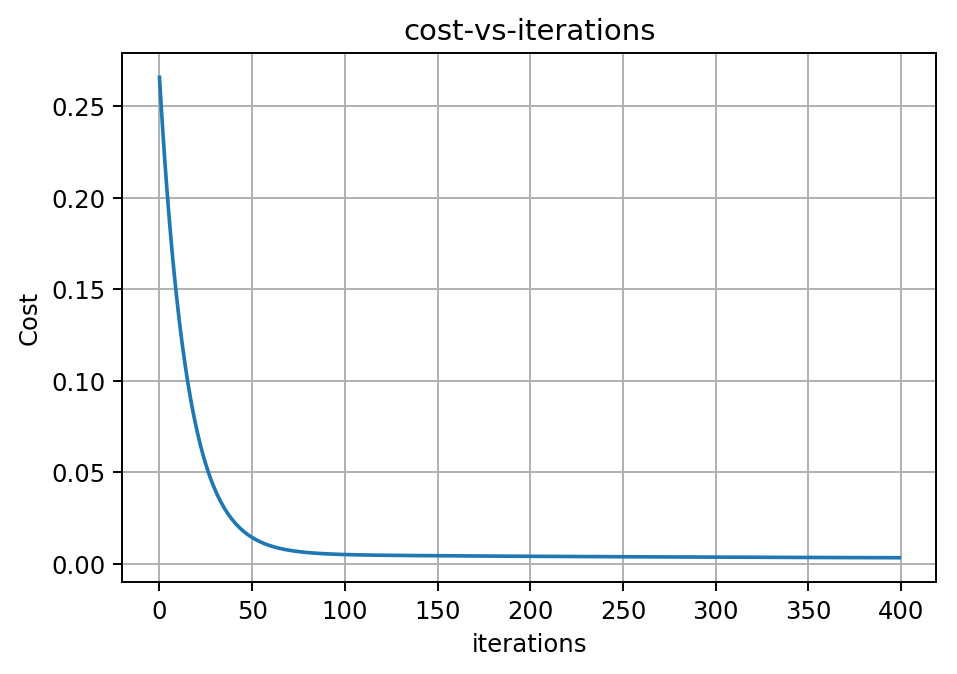

In [19]:
plotter('iterations','Cost','cost-vs-iterations',iteration_list,cost_list)


### Mean Square Error

In [20]:
MSE(predicted , actual)


0.006377879689871769

### Mean Absolute Error

In [21]:
MAE(predicted , actual)


0.06280972887047823

### Mean Absolute Percentage Error

In [22]:
MAPE(predicted , actual)


9.593958472498297

In [23]:
lamda_mse_train = []
lamda_mse_validate = []
lamda_values = np.arange(0, 500, 1)
# print (lamda_values)
for lamda in lamda_values:
    theta, iteration_list, cost_list = modelFitting(x_train, y_train, alpha, iterate, lamda)
    predicted , actual = valdidation(x_train , y_train ,theta)
    lamda_mse_train.append(MSE(predicted , actual))
    predicted , actual = valdidation(x_validate , y_validate ,theta)
    lamda_mse_validate.append(MSE(predicted , actual))
    print("------------")
    

0 0 0.2656838888888889
0 1 0.24885353017528014
0 2 0.23311069237770748
0 3 0.2183850596669354
0 4 0.20461086291901742
0 5 0.19172658571390114
0 6 0.17967468934509345
0 7 0.1684013556110652
0 8 0.1578562462385649
0 9 0.1479922778623653
0 10 0.13876541155550892
0 11 0.13013445596916773
0 12 0.12206088320207226
0 13 0.11450865657637234
0 14 0.10744406955001941
0 15 0.1008355950455449
0 16 0.09465374452167524
0 17 0.08887093615777907
0 18 0.08346137156188022
0 19 0.07840092045107477
0 20 0.0736670127888297
0 21 0.06923853789697684
0 22 0.06509575009139551
0 23 0.06122018041954109
0 24 0.05759455410525403
0 25 0.05420271333179873
0 26 0.05102954501794505
0 27 0.04806091326422667
0 28 0.04528359616738782
0 29 0.042685226720558044
0 30 0.040254237534958826
0 31 0.03797980913603042
0 32 0.03585182160284593
0 33 0.03386080933462556
0 34 0.03199791874214352
0 35 0.03025486867489539
0 36 0.028623913407123606
0 37 0.02709780801723811
0 38 0.0256697760058681
0 39 0.02433347900778902
0 40 0.02308298

[0.4661923]
[0.56]
-----------
[0.80338897]
[0.8]
-----------
[0.61535182]
[0.72]
-----------
[0.80981579]
[0.77]
-----------
[0.51305931]
[0.7]
-----------
[0.59277463]
[0.72]
-----------
[0.46334605]
[0.6]
-----------
[0.98449505]
[0.94]
-----------
[0.94766032]
[0.89]
-----------
[0.58383027]
[0.68]
-----------
[0.68623837]
[0.76]
-----------
[0.81691944]
[0.79]
-----------
[0.97094307]
[0.94]
-----------
[0.57357928]
[0.57]
-----------
[0.67656307]
[0.81]
-----------
[0.92796271]
[0.96]
-----------
[0.86782109]
[0.9]
-----------
[0.71528764]
[0.61]
-----------
[0.65125933]
[0.76]
-----------
[0.98921992]
[0.94]
-----------
[0.77087521]
[0.74]
-----------
[0.77221621]
[0.74]
-----------
[0.81730231]
[0.77]
-----------
[0.5485301]
[0.62]
-----------
[0.93664629]
[0.88]
-----------
[0.64239802]
[0.74]
-----------
[0.79338317]
[0.82]
-----------
[0.48044475]
[0.52]
-----------
[0.80728819]
[0.8]
-----------
[0.84789964]
[0.87]
-----------
[0.70095665]
[0.75]
-----------
[1.03608548]
[0

1 110 0.004846661429262362
1 111 0.00482847047784927
1 112 0.004811001743265716
1 113 0.004794210129505441
1 114 0.004778053448870009
1 115 0.0047624922339517
1 116 0.004747489561776827
1 117 0.004733010889322776
1 118 0.004719023899673071
1 119 0.004705498358122264
1 120 0.004692405977587046
1 121 0.004679720292721573
1 122 0.004667416542173949
1 123 0.004655471558457268
1 124 0.004643863664942631
1 125 0.004632572579513473
1 126 0.004621579324450309
1 127 0.004610866142142875
1 128 0.004600416416252754
1 129 0.00459021459797391
1 130 0.0045802461370614
1 131 0.004570497417319826
1 132 0.004560955696263109
1 133 0.004551609048675746
1 134 0.004542446313823205
1 135 0.00453345704607546
1 136 0.00452463146872291
1 137 0.004515960430778143
1 138 0.004507435366570546
1 139 0.004499048257953027
1 140 0.0044907915989519575
1 141 0.004482658362702336
1 142 0.004474641970520337
1 143 0.0044667362629750625
1 144 0.004458935472830175
1 145 0.004451234199734504
1 146 0.0044436273865485045
1 147 

[0.76]
-----------
[0.88942527]
[0.89]
-----------
[0.89840953]
[0.86]
-----------
[0.69648819]
[0.62]
-----------
[0.66366063]
[0.67]
-----------
[1.0116747]
[0.94]
-----------
[0.7398049]
[0.8]
-----------
[0.79279337]
[0.84]
-----------
[0.90749293]
[0.93]
-----------
[0.35040355]
[0.49]
-----------
[0.69728531]
[0.8]
-----------
[0.6576921]
[0.7]
-----------
[0.92283672]
[0.91]
-----------
[0.85013616]
[0.84]
-----------
[0.58355791]
[0.65]
-----------
[0.80132969]
[0.79]
-----------
[0.62968873]
[0.59]
-----------
[0.57427816]
[0.62]
-----------
[1.01491054]
[0.96]
-----------
[0.44617448]
[0.56]
-----------
[0.49529387]
[0.44]
-----------
[0.47587913]
[0.57]
-----------
[0.88225823]
[0.86]
-----------
[0.67835942]
[0.78]
-----------
[0.92656906]
[0.93]
-----------
[0.96591669]
[0.9]
-----------
[0.79850867]
[0.77]
-----------
[0.94380598]
[0.91]
-----------
[0.81568046]
[0.8]
-----------
[0.52750411]
[0.65]
-----------
[0.95332604]
[0.9]
-----------
[0.61767201]
[0.72]
----------

2 129 0.004723599318621404
2 130 0.004713488031981339
2 131 0.004703596217667855
2 132 0.004693911181435511
2 133 0.004684421043464421
2 134 0.004675114685725507
2 135 0.004665981702750848
2 136 0.0046570123555887315
2 137 0.004648197528737349
2 138 0.0046395286898643475
2 139 0.00463099785213194
2 140 0.004622597538959021
2 141 0.004614320751062503
2 142 0.0046061609356304566
2 143 0.004598111957489058
2 144 0.004590168072134346
2 145 0.004582323900508123
2 146 0.0045745744054051345
2 147 0.004566914869405977
2 148 0.004559340874237004
2 149 0.004551848281464934
2 150 0.004544433214439742
2 151 0.004537092041405127
2 152 0.0045298213597009885
2 153 0.004522617980987254
2 154 0.004515478917422998
2 155 0.004508401368739044
2 156 0.004501382710146226
2 157 0.004494420481025288
2 158 0.004487512374347829
2 159 0.004480656226780997
2 160 0.00447385000943174
2 161 0.0044670918191891855
2 162 0.004460379870626537
2 163 0.004453712488426202
2 164 0.004447088100294407
2 165 0.0044405052303335

[0.44668485]
[0.56]
-----------
[0.49585632]
[0.44]
-----------
[0.47627888]
[0.57]
-----------
[0.8814744]
[0.86]
-----------
[0.67826706]
[0.78]
-----------
[0.92565454]
[0.93]
-----------
[0.96483939]
[0.9]
-----------
[0.79800726]
[0.77]
-----------
[0.94283532]
[0.91]
-----------
[0.81510805]
[0.8]
-----------
[0.52772349]
[0.65]
-----------
[0.95232002]
[0.9]
-----------
[0.61755996]
[0.72]
-----------
[0.80681225]
[0.73]
-----------
[0.5248276]
[0.65]
-----------
[0.5874558]
[0.56]
-----------
[0.87548308]
[0.83]
-----------
[0.48162025]
[0.63]
-----------
[0.85991776]
[0.86]
-----------
[0.60436884]
[0.67]
-----------
[0.81418201]
[0.85]
-----------
[0.56616007]
[0.67]
-----------
[0.94703193]
[0.86]
-----------
[0.62732589]
[0.63]
-----------
[0.5333229]
[0.65]
-----------
[0.46141739]
[0.57]
-----------
[0.96294529]
[0.89]
-----------
[0.89816841]
[0.87]
-----------
[0.82214983]
[0.78]
-----------
[0.80834015]
[0.86]
-----------
[0.58477022]
[0.71]
-----------
[0.63755779]
[0

3 224 0.004220368733245445
3 225 0.004215100718712451
3 226 0.004209850344274014
3 227 0.00420461752315261
3 228 0.004199402170291794
3 229 0.004194204202261901
3 230 0.004189023537171695
3 231 0.0041838600945856095
3 232 0.004178713795446198
3 233 0.004173584562001473
3 234 0.004168472317736826
3 235 0.004163376987311217
3 236 0.004158298496497365
3 237 0.004153236772125699
3 238 0.004148191742031812
3 239 0.004143163335007189
3 240 0.004138151480753019
3 241 0.004133156109836884
3 242 0.004128177153652128
3 243 0.00412321454437976
3 244 0.004118268214952714
3 245 0.004113338099022296
3 246 0.004108424130926741
3 247 0.004103526245661664
3 248 0.004098644378852343
3 249 0.004093778466727697
3 250 0.004088928446095847
3 251 0.004084094254321182
3 252 0.004079275829302781
3 253 0.004074473109454174
3 254 0.004069686033684322
3 255 0.0040649145413797095
3 256 0.004060158572387542
3 257 0.004055418066999936
3 258 0.004050692965939036
3 259 0.004045983210343032
3 260 0.004041288741752985
3

[0.82212214]
[0.69]
-----------
[0.62885739]
[0.49]
-----------
[0.67610833]
[0.45]
-----------
[0.68511184]
[0.65]
-----------
[0.5937879]
[0.66]
-----------
[0.83518087]
[0.85]
-----------
[0.67761151]
[0.73]
-----------
[0.79603923]
[0.79]
-----------
[0.41685916]
[0.58]
-----------
[0.63901628]
[0.62]
-----------
[0.6548086]
[0.71]
-----------
[0.87025792]
[0.89]
-----------
[0.6747268]
[0.7]
-----------
[0.59893331]
[0.62]
-----------
[0.73899731]
[0.68]
-----------
[0.89758897]
[0.9]
-----------
[0.98173662]
[0.97]
-----------
[0.62280336]
[0.72]
-----------
[0.89358127]
[0.91]
-----------
[0.80784894]
[0.79]
-----------
[0.75039067]
[0.71]
-----------
[0.34813845]
[0.46]
-----------
[0.58541416]
[0.62]
-----------
[1.00540733]
[0.92]
-----------
[0.88024432]
[0.91]
-----------
[0.68943612]
[0.79]
-----------
[0.95660793]
[0.95]
-----------
[0.42774227]
[0.56]
-----------
[0.90225167]
[0.87]
-----------
[0.6625053]
[0.61]
-----------
[0.80756539]
[0.81]
-----------
[0.98376522]
[

4 284 0.0040461677540310804
4 285 0.004041743812388804
4 286 0.00403733406578864
4 287 0.004032938462250222
4 288 0.0040285569500247195
4 289 0.004024189477592081
4 290 0.004019835993658417
4 291 0.0040154964471534734
4 292 0.004011170787228231
4 293 0.004006858963252582
4 294 0.004002560924813137
4 295 0.003998276621711071
4 296 0.003994006003960101
4 297 0.003989749021784506
4 298 0.003985505625617241
4 299 0.003981275766098115
4 300 0.003977059394072022
4 301 0.003972856460587269
4 302 0.003968666916893915
4 303 0.003964490714442189
4 304 0.0039603278048809774
4 305 0.00395617814005632
4 306 0.003952041672009991
4 307 0.0039479183529780824
4 308 0.003943808135389673
4 309 0.0039397109718654994
4 310 0.003935626815216691
4 311 0.003931555618443512
4 312 0.003927497334734163
4 313 0.003923451917463594
4 314 0.003919419320192353
4 315 0.003915399496665467
4 316 0.003911392400811347
4 317 0.003907397986740709
4 318 0.003903416208745525
4 319 0.003899447021298007
4 320 0.0038954903790495

[0.80732362]
[0.79]
-----------
[0.75006652]
[0.71]
-----------
[0.34898004]
[0.46]
-----------
[0.58567754]
[0.62]
-----------
[1.00420961]
[0.92]
-----------
[0.87948015]
[0.91]
-----------
[0.68909761]
[0.79]
-----------
[0.9555735]
[0.95]
-----------
[0.42831993]
[0.56]
-----------
[0.90140527]
[0.87]
-----------
[0.66230582]
[0.61]
-----------
[0.80706984]
[0.81]
-----------
[0.98264449]
[0.91]
-----------
[0.59089867]
[0.61]
-----------
[0.66274782]
[0.53]
-----------
[0.62194381]
[0.67]
-----------
[0.95441717]
[0.95]
-----------
[0.53761748]
[0.72]
-----------
[0.64718779]
[0.63]
-----------
[0.94239704]
[0.91]
-----------
[0.48463486]
[0.58]
-----------
[0.66973491]
[0.75]
-----------
[0.60656607]
[0.47]
-----------
[0.63864191]
[0.7]
-----------
[0.90251384]
[0.89]
-----------
[0.88082778]
[0.85]
-----------
[0.47862493]
[0.53]
-----------
[0.62671385]
[0.53]
-----------
[0.82664802]
[0.8]
-----------
[0.84033808]
[0.85]
-----------
[0.99075033]
[0.96]
-----------
[0.64143438

5 342 0.003918572386595804
5 343 0.003914812642959128
5 344 0.0039110646571697055
5 345 0.003907328387033076
5 346 0.0039036037905179387
5 347 0.0038998908257554454
5 348 0.003896189451038483
5 349 0.0038924996248209795
5 350 0.0038888213057171887
5 351 0.0038851544525010137
5 352 0.003881499024105311
5 353 0.0038778549796212054
5 354 0.003874222278297426
5 355 0.0038706008795396218
5 356 0.0038669907429097
5 357 0.003863391828125169
5 358 0.003859804095058472
5 359 0.0038562275037363433
5 360 0.0038526620143391564
5 361 0.003849107587200282
5 362 0.0038455641828054436
5 363 0.003842031761792093
5 364 0.0038385102849487684
5 365 0.0038349997132144783
5 366 0.0038315000076780633
5 367 0.0038280111295775957
5 368 0.0038245330402997477
5 369 0.003821065701379191
5 370 0.0038176090744979773
5 371 0.0038141631214849473
5 372 0.0038107278043151183
5 373 0.0038073030851090896
5 374 0.0038038889261324533
5 375 0.003800485289795193
5 376 0.0037970921386511025
5 377 0.003793709435397203
5 378 0.

-----------
[1.00884183]
[0.96]
-----------
[0.70961876]
[0.56]
-----------
[1.0056836]
[0.94]
-----------
[0.97784618]
[0.95]
-----------
[0.82832207]
[0.8]
-----------
[0.5447238]
[0.72]
-----------
[0.78487344]
[0.83]
-----------
[0.75581064]
[0.73]
-----------
[0.53657549]
[0.64]
-----------
[0.9608439]
[0.94]
-----------
[0.92150225]
[0.93]
-----------
[0.79334956]
[0.82]
-----------
[0.72405853]
[0.73]
-----------
[0.84172335]
[0.87]
-----------
[0.76662663]
[0.78]
-----------
[0.78884228]
[0.74]
-----------
[0.8983434]
[0.78]
-----------
[0.71742051]
[0.74]
-----------
[0.65819313]
[0.7]
-----------
[0.8190877]
[0.73]
-----------
[1.02287931]
[0.96]
-----------
[0.85659846]
[0.8]
-----------
[0.98912056]
[0.94]
-----------
[0.42551589]
[0.49]
-----------
[0.4143458]
[0.49]
-----------
[0.84268494]
[0.81]
-----------
[0.69783641]
[0.79]
-----------
[0.49066899]
[0.42]
-----------
[0.82544707]
[0.78]
-----------
[0.56880491]
[0.54]
-----------
[0.87107393]
[0.81]
-----------
[0.57

6 367 0.003931985613224894
6 368 0.003928431939821911
6 369 0.003924889244916504
6 370 0.003921357489258979
6 371 0.003917836633751024
6 372 0.003914326639445074
6 373 0.003910827467543696
6 374 0.00390733907939897
6 375 0.0039038614365118746
6 376 0.003900394500531677
6 377 0.003896938233255319
6 378 0.003893492596626828
6 379 0.003890057552736692
6 380 0.0038866330638212803
6 381 0.003883219092262239
6 382 0.0038798156005859057
6 383 0.003876422551462714
6 384 0.0038730399077066113
6 385 0.0038696676322744713
6 386 0.0038663056882655184
6 387 0.003862954038920747
6 388 0.003859612647622351
6 389 0.0038562814778931465
6 390 0.003852960493396006
6 391 0.003849649657933293
6 392 0.0038463489354462984
6 393 0.003843058290014673
6 394 0.0038397776858558794
6 395 0.0038365070873246305
6 396 0.0038332464589123376
6 397 0.0038299957652465594
6 398 0.003826754971090455
6 399 0.003823524041342237
[0.62601806]
[0.56]
-----------
[0.99987942]
[0.96]
-----------
[0.93621168]
[0.89]
-----------
[0

7 6 0.17973600540311085
7 7 0.1684822864379782
7 8 0.1579584337330994
7 9 0.1481170613008494
7 10 0.13891385996382166
7 11 0.1303073975692456
7 12 0.12225893217620307
7 13 0.11473223737326581
7 14 0.10769343893887685
7 15 0.10111086210794572
7 16 0.09495488875595283
7 17 0.08919782385657986
7 18 0.08381377061069875
7 19 0.0787785136836539
7 20 0.07406941002433383
7 21 0.06966528677371686
7 22 0.06554634580254425
7 23 0.06169407444766485
7 24 0.05809116204454854
7 25 0.054721421879600364
7 26 0.05156971821034751
7 27 0.048621898024422745
7 28 0.0458647272296366
7 29 0.043285830987411254
7 30 0.04087363792053226
7 31 0.03861732794364438
7 32 0.036506783481253996
7 33 0.03453254385327453
7 34 0.032685762622435534
7 35 0.030958167711230795
7 36 0.02934202410856995
7 37 0.0278300989979749
7 38 0.026415629150082037
7 39 0.02509229043242112
7 40 0.023854169298989137
7 41 0.022695736131064292
7 42 0.021611820309053224
7 43 0.020597586902969978
7 44 0.019648514876443562
7 45 0.01876037670597634

[0.86]
-----------
[0.43383523]
[0.5]
-----------
[1.0172462]
[0.97]
-----------
[0.78532529]
[0.73]
-----------
[0.41501145]
[0.59]
-----------
[0.60417923]
[0.57]
-----------
[0.56741747]
[0.64]
-----------
[0.78128593]
[0.84]
-----------
[0.57474487]
[0.68]
-----------
[0.94698987]
[0.93]
-----------
[0.59815037]
[0.64]
-----------
[0.82685188]
[0.84]
-----------
[0.42745447]
[0.47]
-----------
[0.76404979]
[0.71]
-----------
[0.68996078]
[0.68]
-----------
[0.5484851]
[0.48]
-----------
[0.93518273]
[0.86]
-----------
[0.70963867]
[0.75]
-----------
[0.86721369]
[0.77]
-----------
[0.70364081]
[0.73]
-----------
[0.62616404]
[0.64]
-----------
[0.5512777]
[0.71]
-----------
[0.54165272]
[0.34]
-----------
[0.91791906]
[0.93]
-----------
[0.5914457]
[0.66]
-----------
[0.69473743]
[0.75]
-----------
[0.85554081]
[0.79]
-----------
[0.53208851]
[0.46]
-----------
[1.0094662]
[0.95]
-----------
[0.77345787]
[0.71]
-----------
[0.38999383]
[0.47]
-----------
[0.58948618]
[0.7]
--------

8 123 0.005583813606220743
8 124 0.005571153799283941
8 125 0.005558806692795804
8 126 0.005546753786686568
8 127 0.005534977773433861
8 128 0.005523462460704272
8 129 0.0055121926990176475
8 130 0.005501154314107864
8 131 0.005490334043675087
8 132 0.0054797194782442386
8 133 0.005469299005863044
8 134 0.005459061760390239
8 135 0.005448997573140831
8 136 0.005439096927670311
8 137 0.0054293509174940385
8 138 0.005419751206551146
8 139 0.005410289992234707
8 140 0.005400959970821559
8 141 0.005391754305145912
8 142 0.005382666594371055
8 143 0.005373690845722896
8 144 0.00536482144805795
8 145 0.005356053147146676
8 146 0.005347381022560735
8 147 0.005338800466060049
8 148 0.005330307161382292
8 149 0.005321897065343707
8 150 0.005313566390166155
8 151 0.005305311586950751
8 152 0.0052971293302236456
8 153 0.005289016503484369
8 154 0.005280970185691607
8 155 0.0052729876386255915
8 156 0.005265066295070173
8 157 0.005257203747761365
8 158 0.005249397739052616
8 159 0.0052416461512502

-----------
[0.91282989]
[0.89]
-----------
[0.6173714]
[0.65]
-----------
[0.63430195]
[0.69]
-----------
[0.41142825]
[0.52]
-----------
[0.38773131]
[0.37]
-----------
[0.48040009]
[0.61]
-----------
[0.31990227]
[0.42]
-----------
[0.75880142]
[0.74]
-----------
[0.45423634]
[0.51]
-----------
[0.67671794]
[0.57]
-----------
[0.63170032]
[0.71]
-----------
[0.57854581]
[0.44]
-----------
[0.64653516]
[0.69]
-----------
[0.94420134]
[0.93]
-----------
[0.70363618]
[0.79]
-----------
[0.79266094]
[0.76]
-----------
[0.60091227]
[0.61]
-----------
[0.65441313]
[0.65]
-----------
[0.59627674]
[0.57]
-----------
[0.9315062]
[0.9]
-----------
[0.51208023]
[0.44]
-----------
[0.65132687]
[0.61]
-----------
[0.96687118]
[0.96]
-----------
[0.61328657]
[0.73]
-----------
[0.77106251]
[0.71]
-----------
[0.72788803]
[0.76]
-----------
[0.99481554]
[0.93]
-----------
[0.6424329]
[0.77]
-----------
[0.99890856]
[0.94]
-----------
[0.78318348]
[0.79]
-----------
[0.58657329]
[0.71]
-----------


9 267 0.004683332551707061
9 268 0.004678127641829159
9 269 0.004672939618271777
9 270 0.004667768416802685
9 271 0.004662613973533104
9 272 0.004657476224911168
9 273 0.004652355107715678
9 274 0.004647250559050222
9 275 0.004642162516337568
9 276 0.004637090917314346
9 277 0.004632035700026004
9 278 0.004626996802822001
9 279 0.004621974164351248
9 280 0.004616967723557749
9 281 0.004611977419676462
9 282 0.0046070031922293584
9 283 0.004602044981021643
9 284 0.004597102726138167
9 285 0.004592176367939983
9 286 0.004587265847061068
9 287 0.004582371104405174
9 288 0.004577492081142815
9 289 0.004572628718708385
9 290 0.004567780958797391
9 291 0.004562948743363786
9 292 0.004558132014617426
9 293 0.004553330715021607
9 294 0.004548544787290702
9 295 0.004543774174387893
9 296 0.00453901881952296
9 297 0.0045342786661501785
9 298 0.004529553657966266
9 299 0.004524843738908407
9 300 0.0045201488531523394
9 301 0.004515468945110507
9 302 0.004510803959430257
9 303 0.004506153840992112

[0.71]
-----------
[0.69204413]
[0.71]
-----------
[0.82660513]
[0.66]
-----------
[0.58490235]
[0.73]
-----------
[0.69417698]
[0.46]
-----------
[0.5875204]
[0.68]
-----------
[0.50545875]
[0.62]
-----------
[0.46164133]
[0.52]
-----------
[0.82538813]
[0.81]
-----------
[0.60792497]
[0.48]
-----------
[0.94856608]
[0.93]
-----------
[0.89641478]
[0.88]
-----------
[0.84106788]
[0.76]
-----------
[0.61547294]
[0.64]
-----------
[0.72675126]
[0.73]
-----------
[0.52854734]
[0.64]
-----------
[0.70723203]
[0.74]
-----------
[0.82298997]
[0.82]
-----------
[0.91197341]
[0.89]
-----------
[0.61730733]
[0.65]
-----------
[0.63416377]
[0.69]
-----------
[0.41204629]
[0.52]
-----------
[0.38843742]
[0.37]
-----------
[0.48079467]
[0.61]
-----------
[0.32085054]
[0.42]
-----------
[0.75844273]
[0.74]
-----------
[0.45472472]
[0.51]
-----------
[0.67641657]
[0.57]
-----------
[0.63154886]
[0.71]
-----------
[0.57881305]
[0.44]
-----------
[0.64636191]
[0.69]
-----------
[0.94323807]
[0.93]
--

10 226 0.005026297668624011
10 227 0.005020209628998188
10 228 0.005014142019404107
10 229 0.0050080947438685955
10 230 0.005002067707969933
10 231 0.004996060818758199
10 232 0.004990073984680636
10 233 0.004984107115511696
10 234 0.004978160122287481
10 235 0.004972232917244275
10 236 0.00496632541376092
10 237 0.004960437526304793
10 238 0.004954569170381135
10 239 0.004948720262485537
10 240 0.004942890720059365
10 241 0.004937080461447929
10 242 0.004931289405861268
10 243 0.004925517473337307
10 244 0.004919764584707304
10 245 0.004914030661563395
10 246 0.004908315626228131
10 247 0.004902619401725859
10 248 0.00489694191175585
10 249 0.004891283080667038
10 250 0.004885642833434286
10 251 0.004880021095636083
10 252 0.004874417793433569
10 253 0.00486883285355079
10 254 0.004863266203256173
10 255 0.004857717770345031
10 256 0.004852187483123145
10 257 0.004846675270391279
10 258 0.0048411810614306106
10 259 0.004835704785988992
10 260 0.004830246374268003
10 261 0.004824805756

-----------
[0.46882228]
[0.59]
-----------
[0.5357951]
[0.67]
-----------
[0.80528001]
[0.78]
-----------
[0.89945324]
[0.88]
-----------
[0.56247212]
[0.63]
-----------
[0.62685385]
[0.49]
-----------
[0.83813668]
[0.76]
-----------
[0.76438255]
[0.52]
-----------
[0.59197144]
[0.58]
-----------
[1.00289187]
[0.96]
-----------
[0.7086601]
[0.56]
-----------
[0.99976458]
[0.94]
-----------
[0.97243964]
[0.95]
-----------
[0.82545512]
[0.8]
-----------
[0.54554607]
[0.72]
-----------
[0.78267736]
[0.83]
-----------
[0.75411763]
[0.73]
-----------
[0.53750943]
[0.64]
-----------
[0.95571749]
[0.94]
-----------
[0.91711605]
[0.93]
-----------
[0.79106959]
[0.82]
-----------
[0.72289884]
[0.73]
-----------
[0.83860659]
[0.87]
-----------
[0.7647674]
[0.78]
-----------
[0.78658895]
[0.74]
-----------
[0.89423961]
[0.78]
-----------
[0.71638334]
[0.74]
-----------
[0.657083]
[0.7]
-----------
[0.81635851]
[0.73]
-----------
[1.01667085]
[0.96]
-----------
[0.85322131]
[0.8]
-----------
[0.9

[0.66]
-----------
[0.85727058]
[0.79]
-----------
[0.58771871]
[0.68]
-----------
[0.61179209]
[0.64]
-----------
[0.7072238]
[0.82]
-----------
[0.56310726]
[0.64]
-----------
[0.43911441]
[0.56]
-----------
[0.69911718]
[0.73]
-----------
[0.77740488]
[0.76]
-----------
[0.36536941]
[0.46]
-----------
[0.79419097]
[0.68]
-----------
[0.56904181]
[0.62]
-----------
[0.39566169]
[0.51]
-----------
[0.49880137]
[0.45]
-----------
[0.61782209]
[0.66]
-----------
[0.55211395]
[0.53]
-----------
[0.54655088]
[0.59]
-----------
[0.49705171]
[0.46]
-----------
[0.82701854]
[0.84]
-----------
[0.98224166]
[0.94]
-----------
[0.91024468]
[0.91]
-----------
[0.76743075]
[0.73]
-----------
[0.46483394]
[0.69]
-----------
[0.89714005]
[0.9]
-----------
[0.47112423]
[0.56]
-----------
[0.79782671]
[0.8]
-----------
[0.61428416]
[0.72]
-----------
[0.80393307]
[0.77]
-----------
[0.51606551]
[0.7]
-----------
[0.5928546]
[0.72]
-----------
[0.46795291]
[0.6]
-----------
[0.97244275]
[0.94]
-------

12 86 0.007187963763329124
12 87 0.007126098891909182
12 88 0.007067622351319917
12 89 0.007012315998729399
12 90 0.006959975878721273
12 91 0.006910411299713873
12 92 0.006863443970517214
12 93 0.006818907193111639
12 94 0.006776645107986915
12 95 0.00673651198861909
12 96 0.006698371581885185
12 97 0.006662096491424308
12 98 0.006627567601148532
12 99 0.006594673536288995
12 100 0.006563310159533019
12 101 0.006533380099967123
12 102 0.0065047923126896985
12 103 0.006477461667096194
12 104 0.006451308561969737
12 105 0.0064262585656316715
12 106 0.00640224207952024
12 107 0.0063791940236717845
12 108 0.006357053542678342
12 109 0.006335763730788223
12 110 0.00631527137490314
12 111 0.006295526714306507
12 112 0.006276483216033518
12 113 0.006258097364864459
12 114 0.006240328466989135
12 115 0.0062231384664521985
12 116 0.006206491773547245
12 117 0.006190355104381595
12 118 0.006174697330884501
12 119 0.006159489340578741
12 120 0.0061447039054799545
12 121 0.006130315559529362
12 1

-----------
[0.84307298]
[0.84]
-----------
[0.58627053]
[0.65]
-----------
[0.7958595]
[0.79]
-----------
[0.63111446]
[0.59]
-----------
[0.5750942]
[0.62]
-----------
[1.00144313]
[0.96]
-----------
[0.45172022]
[0.56]
-----------
[0.50133342]
[0.44]
-----------
[0.48023877]
[0.57]
-----------
[0.87384316]
[0.86]
-----------
[0.67737419]
[0.78]
-----------
[0.91674413]
[0.93]
-----------
[0.95435182]
[0.9]
-----------
[0.79312891]
[0.77]
-----------
[0.93337694]
[0.91]
-----------
[0.80954225]
[0.8]
-----------
[0.52992784]
[0.65]
-----------
[0.94251853]
[0.9]
-----------
[0.61654278]
[0.72]
-----------
[0.80185711]
[0.73]
-----------
[0.52713832]
[0.65]
-----------
[0.58969092]
[0.56]
-----------
[0.86809736]
[0.83]
-----------
[0.48566674]
[0.63]
-----------
[0.85313987]
[0.86]
-----------
[0.60385084]
[0.67]
-----------
[0.80884898]
[0.85]
-----------
[0.56723871]
[0.67]
-----------
[0.93730867]
[0.86]
-----------
[0.62597125]
[0.63]
-----------
[0.53540476]
[0.65]
-----------
[

13 147 0.005965423069526701
13 148 0.0059560805757912895
13 149 0.005946823059053635
13 150 0.005937646802379983
13 151 0.005928548322809959
13 152 0.005919524356184063
13 153 0.005910571842958211
13 154 0.0059016879149410145
13 155 0.005892869882893748
13 156 0.005884115224936865
13 157 0.005875421575710488
13 158 0.005866786716239826
13 159 0.005858208564459644
13 160 0.005849685166354822
13 161 0.00584121468767698
13 162 0.005832795406199585
13 163 0.005824425704476555
13 164 0.005816104063071555
13 165 0.005807829054227363
13 166 0.005799599335946643
13 167 0.005791413646457393
13 168 0.0057832707990379765
13 169 0.005775169677178393
13 170 0.005767109230055873
13 171 0.005759088468304345
13 172 0.005751106460058678
13 173 0.005743162327255803
13 174 0.005735255242176001
13 175 0.005727384424208731
13 176 0.005719549136828414
13 177 0.005711748684766498
13 178 0.005703982411367008
13 179 0.005696249696113721
13 180 0.005688549952317734
13 181 0.005680882624955025
13 182 0.005673247

[0.92]
-----------
[0.54259575]
[0.81]
-----------
[0.66824232]
[0.77]
-----------
[0.86134753]
[0.82]
-----------
[0.805741]
[0.69]
-----------
[0.71481186]
[0.76]
-----------
[0.8800925]
[0.89]
-----------
[0.88889063]
[0.86]
-----------
[0.69489614]
[0.62]
-----------
[0.66374523]
[0.67]
-----------
[0.99741848]
[0.94]
-----------
[0.73653449]
[0.8]
-----------
[0.78728626]
[0.84]
-----------
[0.89738733]
[0.93]
-----------
[0.3602697]
[0.49]
-----------
[0.69308259]
[0.8]
-----------
[0.65743274]
[0.7]
-----------
[0.91233751]
[0.91]
-----------
[0.84244906]
[0.84]
-----------
[0.58651023]
[0.65]
-----------
[0.79537694]
[0.79]
-----------
[0.63123922]
[0.59]
-----------
[0.57517312]
[0.62]
-----------
[1.00025456]
[0.96]
-----------
[0.45221697]
[0.56]
-----------
[0.50186678]
[0.44]
-----------
[0.48063097]
[0.57]
-----------
[0.8731003]
[0.86]
-----------
[0.67728792]
[0.78]
-----------
[0.91587608]
[0.93]
-----------
[0.95333097]
[0.9]
-----------
[0.79265437]
[0.77]
----------

14 218 0.005528837817500516
14 219 0.005522026089971923
14 220 0.005515237506875829
14 221 0.005508471948494409
14 222 0.0055017292975195415
14 223 0.005495009438921385
14 224 0.005488312259825296
14 225 0.005481637649396573
14 226 0.005474985498732465
14 227 0.0054683557007610415
14 228 0.005461748150146416
14 229 0.005455162743199979
14 230 0.0054485993777971965
14 231 0.005442057953299642
14 232 0.005435538370481933
14 233 0.0054290405314632185
14 234 0.005422564339642991
14 235 0.005416109699640856
14 236 0.00540967651724009
14 237 0.005403264699334687
14 238 0.0053968741538796905
14 239 0.005390504789844602
14 240 0.0053841565171696614
14 241 0.005377829246724816
14 242 0.0053715228902712076
14 243 0.0053652373604250155
14 244 0.005358972570623518
14 245 0.005352728435093186
14 246 0.005346504868819745
14 247 0.005340301787520031
14 248 0.005334119107615526
14 249 0.005327956746207505
14 250 0.005321814621053647
14 251 0.005315692650546042
14 252 0.005309590753690503
14 253 0.0053

-----------
[0.59889675]
[0.62]
-----------
[0.73401272]
[0.68]
-----------
[0.88892469]
[0.9]
-----------
[0.96965806]
[0.97]
-----------
[0.62396281]
[0.72]
-----------
[0.88481173]
[0.91]
-----------
[0.80221047]
[0.79]
-----------
[0.74691134]
[0.71]
-----------
[0.35724281]
[0.46]
-----------
[0.58823865]
[0.62]
-----------
[0.99254484]
[0.92]
-----------
[0.87203766]
[0.91]
-----------
[0.6858687]
[0.79]
-----------
[0.94550091]
[0.95]
-----------
[0.43400956]
[0.56]
-----------
[0.89316339]
[0.87]
-----------
[0.66041639]
[0.61]
-----------
[0.80223798]
[0.81]
-----------
[0.9717289]
[0.91]
-----------
[0.59278279]
[0.61]
-----------
[0.66267257]
[0.53]
-----------
[0.62090489]
[0.67]
-----------
[0.94436005]
[0.95]
-----------
[0.53952475]
[0.72]
-----------
[0.64517561]
[0.63]
-----------
[0.93286036]
[0.91]
-----------
[0.48818254]
[0.58]
-----------
[0.66942189]
[0.75]
-----------
[0.60628735]
[0.47]
-----------
[0.63914159]
[0.7]
-----------
[0.89421742]
[0.89]
-----------


15 368 0.004813564229815738
15 369 0.004809262359329508
15 370 0.004804973631356834
15 371 0.00480069799806677
15 372 0.004796435411822727
15 373 0.0047921858251816106
15 374 0.004787949190892981
15 375 0.004783725461898188
15 376 0.004779514591329549
15 377 0.004775316532509499
15 378 0.0047711312389497615
15 379 0.004766958664350518
15 380 0.0047627987625995846
15 381 0.004758651487771589
15 382 0.004754516794127164
15 383 0.0047503946361121254
15 384 0.004746284968356672
15 385 0.004742187745674579
15 386 0.004738102923062397
15 387 0.004734030455698664
15 388 0.004729970298943112
15 389 0.004725922408335871
15 390 0.004721886739596702
15 391 0.004717863248624206
15 392 0.004713851891495053
15 393 0.004709852624463206
15 394 0.004705865403959167
15 395 0.004701890186589196
15 396 0.004697926929134561
15 397 0.0046939755885507806
15 398 0.00469003612196687
15 399 0.0046861084866845915
[0.62514236]
[0.56]
-----------
[0.98956504]
[0.96]
-----------
[0.92787069]
[0.89]
-----------
[0.8

16 17 0.08961611532070081
16 18 0.08426457567755843
16 19 0.07926140814588638
16 20 0.0745838767602666
16 21 0.07021072970024321
16 22 0.0661221024042006
16 23 0.06229942700819037
16 24 0.058725347696794765
16 25 0.05538364158007066
16 26 0.05225914473581497
16 27 0.049337683079943684
16 28 0.046606007749790825
16 29 0.04405173470571085
16 30 0.0416632882756013
16 31 0.03942984838494052
16 32 0.037341301231739725
16 33 0.035388193181515586
16 34 0.03356168767207169
16 35 0.03185352493160046
16 36 0.030255984326444073
16 37 0.028761849166843895
16 38 0.02736437381021409
16 39 0.026057252911951486
16 40 0.02483459268358517
16 41 0.023690884027221533
16 42 0.022620977423796144
16 43 0.02162005946063937
16 44 0.02068363089133808
16 45 0.019807486127861262
16 46 0.01898769407144865
16 47 0.01822058019486488
16 48 0.017502709794327533
16 49 0.016830872334750432
16 50 0.016202066816928488
16 51 0.01561348809994985
16 52 0.01506251411647645
16 53 0.014546693922604905
16 54 0.0140637365278251
1

[0.84]
-----------
[0.43263398]
[0.47]
-----------
[0.76091836]
[0.71]
-----------
[0.6889425]
[0.68]
-----------
[0.54987469]
[0.48]
-----------
[0.9268545]
[0.86]
-----------
[0.70794973]
[0.75]
-----------
[0.86087549]
[0.77]
-----------
[0.70221888]
[0.73]
-----------
[0.62506375]
[0.64]
-----------
[0.5525753]
[0.71]
-----------
[0.54327817]
[0.34]
-----------
[0.91007238]
[0.93]
-----------
[0.59146117]
[0.66]
-----------
[0.69363625]
[0.75]
-----------
[0.84960337]
[0.79]
-----------
[0.53392251]
[0.46]
-----------
[0.9986571]
[0.95]
-----------
[0.76803777]
[0.71]
-----------
[0.39632424]
[0.47]
-----------
[0.58969695]
[0.7]
-----------
[0.59448928]
[0.64]
-----------
[0.69233036]
[0.63]
-----------
[0.64046505]
[0.68]
-----------
[0.68956465]
[0.61]
-----------
[0.58012243]
[0.73]
-----------
[0.74356188]
[0.72]
-----------
[0.76308269]
[0.78]
-----------
[0.73238344]
[0.71]
-----------
[0.42526633]
[0.58]
-----------
[0.61084688]
[0.77]
-----------
[0.87389475]
[0.89]
------

17 167 0.006267833032401351
17 168 0.0062589980285155675
17 169 0.006250206907746778
17 170 0.006241458627703518
17 171 0.00623275220631578
17 172 0.006224086717948981
17 173 0.006215461289770797
17 174 0.006206875098354372
17 175 0.006198327366502513
17 176 0.006189817360278457
17 177 0.006181344386229711
17 178 0.006172907788792437
17 179 0.006164506947864563
17 180 0.006156141276536622
17 181 0.00614781021897011
17 182 0.006139513248413634
17 183 0.006131249865347983
17 184 0.006123019595751638
17 185 0.006114821989478937
17 186 0.006106656618743488
17 187 0.006098523076700063
17 188 0.006090420976118452
17 189 0.006082349948143389
17 190 0.00607430964113487
17 191 0.0060662997195836755
17 192 0.006058319863097159
17 193 0.006050369765450782
17 194 0.006042449133701046
17 195 0.006034557687355904
17 196 0.0060266951575988345
17 197 0.006018861286563134
17 198 0.0060110558266531664
17 199 0.006003278539909459
17 200 0.005995529197414864
17 201 0.005987807578739059
17 202 0.0059801134

-----------
[0.58090649]
[0.44]
-----------
[0.64504682]
[0.69]
-----------
[0.93569346]
[0.93]
-----------
[0.70036444]
[0.79]
-----------
[0.78675246]
[0.76]
-----------
[0.60264599]
[0.61]
-----------
[0.65255142]
[0.65]
-----------
[0.59632329]
[0.57]
-----------
[0.92313439]
[0.9]
-----------
[0.51656931]
[0.44]
-----------
[0.65166422]
[0.61]
-----------
[0.95760992]
[0.96]
-----------
[0.6146176]
[0.73]
-----------
[0.76753885]
[0.71]
-----------
[0.72575552]
[0.76]
-----------
[0.98461885]
[0.93]
-----------
[0.64105943]
[0.77]
-----------
[0.98859285]
[0.94]
-----------
[0.77932361]
[0.79]
-----------
[0.58694257]
[0.71]
-----------
[0.45029944]
[0.61]
-----------
[0.69827373]
[0.7]
-----------
[0.78918848]
[0.76]
-----------
[0.69439697]
[0.52]
-----------
[0.64495472]
[0.68]
-----------
[0.67265309]
[0.71]
-----------
[0.69864401]
[0.74]
-----------
[0.68730158]
[0.72]
-----------
[0.77433465]
[0.8]
-----------
[0.90486969]
[0.89]
-----------
[0.55479329]
[0.73]
-----------


18 316 0.005348449624740864
18 317 0.005343065300320955
18 318 0.0053376978839337775
18 319 0.005332347312287553
18 320 0.005327013522360041
18 321 0.005321696451397076
18 322 0.00531639603691112
18 323 0.005311112216679841
18 324 0.005305844928744708
18 325 0.005300594111409601
18 326 0.005295359703239433
18 327 0.005290141643058816
18 328 0.00528493986995071
18 329 0.005279754323255109
18 330 0.005274584942567729
18 331 0.00526943166773872
18 332 0.00526429443887139
18 333 0.005259173196320936
18 334 0.005254067880693197
18 335 0.005248978432843414
18 336 0.005243904793875007
18 337 0.005238846905138349
18 338 0.005233804708229575
18 339 0.0052287781449893815
18 340 0.0052237671575018525
18 341 0.005218771688093276
18 342 0.005213791679330994
18 343 0.005208827074022242
18 344 0.005203877815213014
18 345 0.005198943846186922
18 346 0.005194025110464076
18 347 0.005189121551799971
18 348 0.0051842331141843685
18 349 0.005179359741840213
18 350 0.005174501379222532
18 351 0.00516965797

[0.81212555]
[0.73]
-----------
[1.00704263]
[0.96]
-----------
[0.84798406]
[0.8]
-----------
[0.97476593]
[0.94]
-----------
[0.43278984]
[0.49]
-----------
[0.42235708]
[0.49]
-----------
[0.83441098]
[0.81]
-----------
[0.69332598]
[0.79]
-----------
[0.4953968]
[0.42]
-----------
[0.81840003]
[0.78]
-----------
[0.57029868]
[0.54]
-----------
[0.86171692]
[0.81]
-----------
[0.57259037]
[0.7]
-----------
[0.89902064]
[0.92]
-----------
[0.60173633]
[0.58]
-----------
[0.74694031]
[0.81]
-----------
[0.6399106]
[0.64]
-----------
[0.68346552]
[0.72]
-----------
[0.56247678]
[0.64]
-----------
[0.90721507]
[0.87]
-----------
[0.8778274]
[0.87]
-----------
[0.58740633]
[0.71]
-----------
[0.78559962]
[0.82]
-----------
[0.62962581]
[0.68]
-----------
[0.65459479]
[0.78]
-----------
[0.57815938]
[0.75]
-----------
[0.5841851]
[0.73]
-----------
[0.3884547]
[0.47]
-----------
[0.59497828]
[0.38]
-----------
[0.71038968]
[0.71]
-----------
[0.8194811]
[0.79]
-----------
[0.58497413]
[0.

-----------
[0.59299746]
[0.72]
-----------
[0.47125141]
[0.6]
-----------
[0.96406684]
[0.94]
-----------
[0.92952682]
[0.89]
-----------
[0.58480826]
[0.68]
-----------
[0.68433017]
[0.76]
-----------
[0.80323924]
[0.79]
-----------
[0.95111276]
[0.94]
-----------
[0.57545759]
[0.57]
-----------
[0.67508088]
[0.81]
-----------
[0.91097393]
[0.96]
-----------
[0.85397711]
[0.9]
-----------
[0.70765005]
[0.61]
-----------
[0.64775809]
[0.76]
-----------
[0.96843408]
[0.94]
-----------
[0.76362501]
[0.74]
-----------
[0.76488774]
[0.74]
-----------
[0.80731581]
[0.77]
-----------
[0.55146382]
[0.62]
-----------
[0.91926096]
[0.88]
-----------
[0.63946063]
[0.74]
-----------
[0.78093631]
[0.82]
-----------
[0.49147795]
[0.52]
-----------
[0.79808119]
[0.8]
-----------
[0.83195308]
[0.87]
-----------
[0.69411046]
[0.75]
-----------
[1.01227555]
[0.96]
-----------
[0.59366538]
[0.69]
-----------
[0.70333803]
[0.72]
-----------
[0.6780947]
[0.64]
-----------
[0.56822174]
[0.52]
-----------


20 115 0.007247823436889143
20 116 0.007229727946526221
20 117 0.007212133605332299
20 118 0.007195010121954791
20 119 0.007178329173156656
20 120 0.007162064275223887
20 121 0.0071461906637823825
20 122 0.007130685181474044
20 123 0.007115526172978025
20 124 0.0071006933868966084
20 125 0.00708616788405669
20 126 0.007071931951807185
20 127 0.007057969023920162
20 128 0.007044263605729129
20 129 0.007030801204161929
20 130 0.0070175682623480826
20 131 0.007004552098501344
20 132 0.006991740848797869
20 133 0.006979123413988645
20 134 0.006966689409501909
20 135 0.0069544291188073405
20 136 0.00694233344982866
20 137 0.006930393894205285
20 138 0.006918602489216674
20 139 0.00690695178219527
20 140 0.006895434797265244
20 141 0.006884045004254977
20 142 0.0068727762896410895
20 143 0.006861622929391196
20 144 0.006850579563581211
20 145 0.006839641172671154
20 146 0.006828803055331027
20 147 0.006818060807715385
20 148 0.006807410304091895
20 149 0.006796847678735343
20 150 0.006786369

[0.92985826]
[0.86]
-----------
[0.62502682]
[0.63]
-----------
[0.53708312]
[0.65]
-----------
[0.4691757]
[0.57]
-----------
[0.94493945]
[0.89]
-----------
[0.88420174]
[0.87]
-----------
[0.81247913]
[0.78]
-----------
[0.79521012]
[0.86]
-----------
[0.58514985]
[0.71]
-----------
[0.63882963]
[0.5]
-----------
[0.61211776]
[0.54]
-----------
[0.72438511]
[0.79]
-----------
[0.53633885]
[0.67]
-----------
[0.67003475]
[0.79]
-----------
[0.53993284]
[0.48]
-----------
[0.82534961]
[0.85]
-----------
[0.59235001]
[0.64]
-----------
[0.43579458]
[0.34]
-----------
[0.53523486]
[0.68]
-----------
[0.57102179]
[0.55]
-----------
[0.93909555]
[0.97]
-----------
[0.79104382]
[0.71]
-----------
[0.9036888]
[0.92]
-----------
[0.64177615]
[0.71]
-----------
[0.68891789]
[0.71]
-----------
[0.82044286]
[0.66]
-----------
[0.58528715]
[0.73]
-----------
[0.69283637]
[0.46]
-----------
[0.59033248]
[0.68]
-----------
[0.50880458]
[0.62]
-----------
[0.46650889]
[0.52]
-----------
[0.81947779

21 264 0.005956222624789974
21 265 0.005949462465885531
21 266 0.005942724205957436
21 267 0.00593600775900764
21 268 0.00592931303950616
21 269 0.005922639962383183
21 270 0.005915988443021583
21 271 0.005909358397249776
21 272 0.005902749741334934
21 273 0.005896162391976527
21 274 0.005889596266300137
21 275 0.00588305128185159
21 276 0.005876527356591321
21 277 0.005870024408889007
21 278 0.005863542357518439
21 279 0.005857081121652596
21 280 0.005850640620858943
21 281 0.0058442207750949
21 282 0.005837821504703534
21 283 0.005831442730409379
21 284 0.005825084373314441
21 285 0.005818746354894363
21 286 0.005812428596994704
21 287 0.005806131021827385
21 288 0.005799853551967245
21 289 0.005793596110348711
21 290 0.0057873586202625985
21 291 0.005781141005353009
21 292 0.005774943189614315
21 293 0.005768765097388272
21 294 0.005762606653361184
21 295 0.005756467782561176
21 296 0.00575034841035554
21 297 0.005744248462448149
21 298 0.005738167864876958
21 299 0.0057321065440115

[0.84]
-----------
[0.75912672]
[0.76]
-----------
[0.88804044]
[0.93]
-----------
[0.94058162]
[0.91]
-----------
[0.72581802]
[0.78]
-----------
[0.87203925]
[0.78]
-----------
[0.58308565]
[0.7]
-----------
[0.70397883]
[0.79]
-----------
[0.741637]
[0.75]
-----------
[0.6338135]
[0.54]
-----------
[0.54889401]
[0.66]
-----------
[0.71934793]
[0.73]
-----------
[0.64848265]
[0.72]
-----------
[0.75395969]
[0.8]
-----------
[0.60685016]
[0.62]
-----------
[0.69469166]
[0.76]
-----------
[0.62116615]
[0.69]
-----------
[0.77263388]
[0.76]
-----------
[0.91431391]
[0.91]
-----------
[0.86685987]
[0.86]
-----------
[0.86076256]
[0.87]
-----------
[0.81126065]
[0.85]
-----------
[0.51976724]
[0.42]
-----------
[0.86181598]
[0.84]
-----------
[0.47351844]
[0.59]
-----------
[0.54004106]
[0.67]
-----------
[0.79789445]
[0.78]
-----------
[0.8907931]
[0.88]
-----------
[0.56391845]
[0.63]
-----------
[0.62818094]
[0.49]
-----------
[0.83153983]
[0.76]
-----------
[0.76037464]
[0.52]
-------

-----------
[0.6567014]
[0.76]
-----------
[0.6934125]
[0.78]
-----------
[0.66449051]
[0.67]
-----------
[0.43152994]
[0.53]
-----------
[0.83773085]
[0.81]
-----------
[0.9513315]
[0.92]
-----------
[0.73193192]
[0.8]
-----------
[0.44396418]
[0.54]
-----------
[0.76180044]
[0.72]
-----------
[0.68973902]
[0.65]
-----------
[0.66957531]
[0.7]
-----------
[0.92885668]
[0.88]
-----------
[0.60417416]
[0.65]
-----------
[0.5147866]
[0.52]
-----------
[0.44778537]
[0.54]
-----------
[0.97225871]
[0.93]
-----------
[0.54167468]
[0.62]
-----------
[0.74986589]
[0.73]
-----------
[0.61819666]
[0.66]
-----------
[0.70908876]
[0.72]
-----------
[0.55238866]
[0.69]
-----------
[0.92465224]
[0.92]
-----------
[0.93799897]
[0.86]
-----------
[0.67212111]
[0.66]
-----------
[0.85000306]
[0.79]
-----------
[0.59048337]
[0.68]
-----------
[0.6132411]
[0.64]
-----------
[0.70316223]
[0.82]
-----------
[0.56426298]
[0.64]
-----------
[0.44477397]
[0.56]
-----------
[0.69530384]
[0.73]
-----------
[0.

23 63 0.01178340224424136
23 64 0.011534018466357033
23 65 0.01130008819611572
23 66 0.011080602355442852
23 67 0.01087461797507514
23 68 0.010681253861784916
23 69 0.01049968654961052
23 70 0.010329146516475454
23 71 0.010168914648799527
23 72 0.010018318937845591
23 73 0.009876731392611244
23 74 0.009743565155070548
23 75 0.009618271804501461
23 76 0.009500338838504162
23 77 0.009389287319127934
23 78 0.009284669673283664
23 79 0.009186067637328345
23 80 0.009093090336371063
23 81 0.009005372489469402
23 82 0.008922572732464168
23 83 0.008844372050741187
23 84 0.008770472314714558
23 85 0.008700594911297972
23 86 0.00863447946507217
23 87 0.008571882643269049
23 88 0.008512577039078319
23 89 0.008456350128142841
23 90 0.008403003293445175
23 91 0.008352350914102535
23 92 0.008304219513880986
23 93 0.008258446965514584
23 94 0.008214881747171492
23 95 0.008173382247649059
23 96 0.008133816117103884
23 97 0.008096059660332144
23 98 0.008059997269811296
23 99 0.008025520895896912
23 100

[0.6459002]
[0.67]
-----------
[0.77986672]
[0.82]
-----------
[0.71673115]
[0.64]
-----------
[0.93794304]
[0.92]
-----------
[0.58407254]
[0.71]
-----------
[0.60877479]
[0.58]
-----------
[0.91020298]
[0.92]
-----------
[0.54447583]
[0.81]
-----------
[0.66592994]
[0.77]
-----------
[0.85460858]
[0.82]
-----------
[0.80065065]
[0.69]
-----------
[0.71110657]
[0.76]
-----------
[0.87271581]
[0.89]
-----------
[0.88135728]
[0.86]
-----------
[0.6936401]
[0.62]
-----------
[0.66379716]
[0.67]
-----------
[0.98614963]
[0.94]
-----------
[0.73394963]
[0.8]
-----------
[0.78293849]
[0.84]
-----------
[0.8894025]
[0.93]
-----------
[0.36819478]
[0.49]
-----------
[0.68988987]
[0.8]
-----------
[0.65724253]
[0.7]
-----------
[0.90402938]
[0.91]
-----------
[0.83637054]
[0.84]
-----------
[0.58884743]
[0.65]
-----------
[0.79068123]
[0.79]
-----------
[0.63244566]
[0.59]
-----------
[0.57600192]
[0.62]
-----------
[0.988683]
[0.96]
-----------
[0.4571174]
[0.56]
-----------
[0.50706352]
[0.4

24 212 0.006659456031045686
24 213 0.0066509258516797825
24 214 0.0066424248739533195
24 215 0.0066339529392511745
24 216 0.006625509892318059
24 217 0.0066170955810738235
24 218 0.006608709856440541
24 219 0.006600352572180604
24 220 0.006592023584745156
24 221 0.0065837227531321115
24 222 0.006575449938753235
24 223 0.006567205005309607
24 224 0.006558987818674998
24 225 0.006550798246786586
24 226 0.006542636159542578
24 227 0.006534501428706278
24 228 0.006526393927816162
24 229 0.0065183135321016245
24 230 0.006510260118403961
24 231 0.006502233565102295
24 232 0.006494233752044133
24 233 0.006486260560480206
24 234 0.006478313873003364
24 235 0.006470393573491251
24 236 0.006462499547052489
24 237 0.006454631679976195
24 238 0.00644678985968456
24 239 0.006438973974688351
24 240 0.006431183914545093
24 241 0.006423419569819806
24 242 0.0064156808320480875
24 243 0.006407967593701439
24 244 0.006400279748154649
24 245 0.006392617189655122
24 246 0.006384979813294038
24 247 0.00637

[0.73]
-----------
[0.78228967]
[0.79]
-----------
[0.42897163]
[0.58]
-----------
[0.6357508]
[0.62]
-----------
[0.65068757]
[0.71]
-----------
[0.85570732]
[0.89]
-----------
[0.669816]
[0.7]
-----------
[0.59897862]
[0.62]
-----------
[0.72980337]
[0.68]
-----------
[0.881425]
[0.9]
-----------
[0.95922399]
[0.97]
-----------
[0.62497431]
[0.72]
-----------
[0.87723439]
[0.91]
-----------
[0.79734284]
[0.79]
-----------
[0.74390818]
[0.71]
-----------
[0.36523467]
[0.46]
-----------
[0.59067463]
[0.62]
-----------
[0.98142671]
[0.92]
-----------
[0.86494425]
[0.91]
-----------
[0.68290836]
[0.79]
-----------
[0.93590387]
[0.95]
-----------
[0.43954386]
[0.56]
-----------
[0.88531053]
[0.87]
-----------
[0.65870819]
[0.61]
-----------
[0.79762377]
[0.81]
-----------
[0.96132386]
[0.91]
-----------
[0.59460151]
[0.61]
-----------
[0.66259607]
[0.53]
-----------
[0.62003546]
[0.67]
-----------
[0.93477934]
[0.95]
-----------
[0.54145884]
[0.72]
-----------
[0.64338528]
[0.63]
--------

25 362 0.005731035277551553
25 363 0.005725652431821462
25 364 0.005720285908521002
25 365 0.005714935647668903
25 366 0.005709601589538675
25 367 0.0057042836746574
25 368 0.005698981843804551
25 369 0.005693696038010781
25 370 0.00568842619855675
25 371 0.00568317226697195
25 372 0.005677934185033532
25 373 0.005672711894765151
25 374 0.005667505338435797
25 375 0.005662314458558657
25 376 0.005657139197889963
25 377 0.005651979499427867
25 378 0.005646835306411292
25 379 0.005641706562318827
25 380 0.005636593210867597
25 381 0.0056314951960121555
25 382 0.005626412461943377
25 383 0.005621344953087354
25 384 0.005616292614104313
25 385 0.005611255389887507
25 386 0.005606233225562156
25 387 0.005601226066484357
25 388 0.005596233858240011
25 389 0.005591256546643766
25 390 0.0055862940777379536
25 391 0.005581346397791529
25 392 0.005576413453299032
25 393 0.005571495190979538
25 394 0.005566591557775621
25 395 0.005561702500852323
25 396 0.005556827967596124
25 397 0.0055519679056

26 11 0.13077453511472348
26 12 0.12279363151953858
26 13 0.11533557975370498
26 14 0.10836605198042577
26 15 0.10185297458908761
26 16 0.09576638015847538
26 17 0.09007826914189535
26 18 0.08476248063573927
26 19 0.07979457163495379
26 20 0.07515170421805391
26 21 0.0708125401409246
26 22 0.06675714235285442
26 23 0.06296688298019769
26 24 0.05942435735291805
26 25 0.056113303677160796
26 26 0.05301852798306318
26 27 0.05012583400136388
26 28 0.04742195764512391
26 29 0.04489450579412944
26 30 0.0425318990994078
26 31 0.040323318543846
26 32 0.03825865551223866
26 33 0.036328465140292754
26 34 0.034523922727251945
26 35 0.03283678301094536
26 36 0.03125934211727885
26 37 0.029784402008531878
26 38 0.028405237266357894
26 39 0.027115564056163336
26 40 0.025909511129609313
26 41 0.024781592731388392
26 42 0.023726683285218857
26 43 0.02273999374221194
26 44 0.02181704948244067
26 45 0.02095366966770897
26 46 0.020145947950218148
26 47 0.01939023444808658
26 48 0.018683118904526567
26 49

[0.57]
-----------
[0.56946278]
[0.64]
-----------
[0.77323932]
[0.84]
-----------
[0.57586749]
[0.68]
-----------
[0.92909659]
[0.93]
-----------
[0.59827754]
[0.64]
-----------
[0.8124989]
[0.84]
-----------
[0.43823638]
[0.47]
-----------
[0.75758982]
[0.71]
-----------
[0.68786505]
[0.68]
-----------
[0.55145976]
[0.48]
-----------
[0.91800859]
[0.86]
-----------
[0.70616667]
[0.75]
-----------
[0.85414647]
[0.77]
-----------
[0.70071304]
[0.73]
-----------
[0.62401233]
[0.64]
-----------
[0.55406374]
[0.71]
-----------
[0.54511125]
[0.34]
-----------
[0.90174158]
[0.93]
-----------
[0.59159151]
[0.66]
-----------
[0.69246835]
[0.75]
-----------
[0.84329801]
[0.79]
-----------
[0.5359822]
[0.46]
-----------
[0.98719162]
[0.95]
-----------
[0.76239127]
[0.71]
-----------
[0.40314726]
[0.47]
-----------
[0.59002694]
[0.7]
-----------
[0.59471134]
[0.64]
-----------
[0.68925196]
[0.63]
-----------
[0.64089204]
[0.68]
-----------
[0.68876149]
[0.61]
-----------
[0.58059179]
[0.73]
----

27 160 0.00749194565945149
27 161 0.007480822450224732
27 162 0.007469758299891232
27 163 0.0074587516510933585
27 164 0.0074478010384848355
27 165 0.0074369050827619255
27 166 0.007426062485085377
27 167 0.007415272021867568
27 168 0.007404532539900842
27 169 0.007393842951804669
27 170 0.007383202231770716
27 171 0.007372609411586304
27 172 0.007362063576917976
27 173 0.0073515638638381444
27 174 0.007341109455578827
27 175 0.007330699579497654
27 176 0.0073203335042421784
27 177 0.007310010537099491
27 178 0.007299730021519019
27 179 0.007289491334797149
27 180 0.007279293885913045
27 181 0.007269137113505786
27 182 0.007259020483983533
27 183 0.007248943489756103
27 184 0.007238905647582846
27 185 0.007228906497028277
27 186 0.007218945599018394
27 187 0.007209022534491116
27 188 0.007199136903134647
27 189 0.007189288322208025
27 190 0.007179476425438466
27 191 0.007169700861990495
27 192 0.007159961295502133
27 193 0.007150257403183781
27 194 0.007140588874975694
27 195 0.0071309

-----------
[0.48777386]
[0.61]
-----------
[0.33735393]
[0.42]
-----------
[0.75228549]
[0.74]
-----------
[0.46331484]
[0.51]
-----------
[0.67144315]
[0.57]
-----------
[0.62915928]
[0.71]
-----------
[0.58341712]
[0.44]
-----------
[0.64357099]
[0.69]
-----------
[0.92665333]
[0.93]
-----------
[0.69699816]
[0.79]
-----------
[0.78058283]
[0.76]
-----------
[0.60448939]
[0.61]
-----------
[0.65068565]
[0.65]
-----------
[0.59647578]
[0.57]
-----------
[0.91425261]
[0.9]
-----------
[0.52133314]
[0.44]
-----------
[0.65201672]
[0.61]
-----------
[0.94777375]
[0.96]
-----------
[0.6160347]
[0.73]
-----------
[0.76380463]
[0.71]
-----------
[0.72349452]
[0.76]
-----------
[0.97379401]
[0.93]
-----------
[0.63970642]
[0.77]
-----------
[0.97764144]
[0.94]
-----------
[0.77523174]
[0.79]
-----------
[0.58743606]
[0.71]
-----------
[0.45511307]
[0.61]
-----------
[0.69492061]
[0.7]
-----------
[0.78478712]
[0.76]
-----------
[0.69119773]
[0.52]
-----------
[0.64350358]
[0.68]
-----------

28 310 0.0063022280020495714
28 311 0.00629552868375564
28 312 0.006288850352167431
28 313 0.006282192927570797
28 314 0.00627555633060743
28 315 0.0062689404822728135
28 316 0.006262345303914204
28 317 0.0062557707172286045
28 318 0.006249216644260813
28 319 0.006242683007401471
28 320 0.006236169729385129
28 321 0.006229676733288357
28 322 0.0062232039425278735
28 323 0.006216751280858674
28 324 0.0062103186723722155
28 325 0.006203906041494596
28 326 0.006197513312984763
28 327 0.00619114041193274
28 328 0.006184787263757875
28 329 0.006178453794207095
28 330 0.006172139929353203
28 331 0.0061658455955931534
28 332 0.006159570719646379
28 333 0.006153315228553121
28 334 0.006147079049672762
28 335 0.006140862110682201
28 336 0.006134664339574206
28 337 0.006128485664655827
28 338 0.006122326014546772
28 339 0.0061161853181778345
28 340 0.006110063504789324
28 341 0.006103960503929497
28 342 0.0060978762454530116
28 343 0.006091810659519391
28 344 0.006085763676591504
28 345 0.006079

[0.82798471]
[0.87]
-----------
[0.75843765]
[0.78]
-----------
[0.77892001]
[0.74]
-----------
[0.8802594]
[0.78]
-----------
[0.71285733]
[0.74]
-----------
[0.65353894]
[0.7]
-----------
[0.80705715]
[0.73]
-----------
[0.99551401]
[0.96]
-----------
[0.84171391]
[0.8]
-----------
[0.96431507]
[0.94]
-----------
[0.43822158]
[0.49]
-----------
[0.42831274]
[0.49]
-----------
[0.8284022]
[0.81]
-----------
[0.6901744]
[0.79]
-----------
[0.49895928]
[0.42]
-----------
[0.81325942]
[0.78]
-----------
[0.57149804]
[0.54]
-----------
[0.85491092]
[0.81]
-----------
[0.57359429]
[0.7]
-----------
[0.89123388]
[0.92]
-----------
[0.60172516]
[0.58]
-----------
[0.74397384]
[0.81]
-----------
[0.64062263]
[0.64]
-----------
[0.6806976]
[0.72]
-----------
[0.56549892]
[0.64]
-----------
[0.89907468]
[0.87]
-----------
[0.87080668]
[0.87]
-----------
[0.58768156]
[0.71]
-----------
[0.78130888]
[0.82]
-----------
[0.63042702]
[0.68]
-----------
[0.65244979]
[0.78]
-----------
[0.57897941]
[0

[0.69]
-----------
[0.88346262]
[0.9]
-----------
[0.47892705]
[0.56]
-----------
[0.78935829]
[0.8]
-----------
[0.61298283]
[0.72]
-----------
[0.79498565]
[0.77]
-----------
[0.52095075]
[0.7]
-----------
[0.5932664]
[0.72]
-----------
[0.47531127]
[0.6]
-----------
[0.95403462]
[0.94]
-----------
[0.920622]
[0.89]
-----------
[0.58544068]
[0.68]
-----------
[0.6834006]
[0.76]
-----------
[0.79667236]
[0.79]
-----------
[0.94138492]
[0.94]
-----------
[0.57652135]
[0.57]
-----------
[0.67437103]
[0.81]
-----------
[0.9026369]
[0.96]
-----------
[0.8472107]
[0.9]
-----------
[0.70406738]
[0.61]
-----------
[0.64619905]
[0.76]
-----------
[0.95822871]
[0.94]
-----------
[0.76007344]
[0.74]
-----------
[0.76129848]
[0.74]
-----------
[0.80241243]
[0.77]
-----------
[0.55306819]
[0.62]
-----------
[0.91071966]
[0.88]
-----------
[0.63817892]
[0.74]
-----------
[0.77498443]
[0.82]
-----------
[0.4969059]
[0.52]
-----------
[0.79355607]
[0.8]
-----------
[0.82428788]
[0.87]
-----------
[0

30 109 0.008619196821005029
30 110 0.008595324160303276
30 111 0.008572167153510914
30 112 0.008549681886486464
30 113 0.008527827316906898
30 114 0.008506565085498114
30 115 0.008485859339684071
30 116 0.008465676568837312
30 117 0.008445985450367392
30 118 0.008426756705934057
30 119 0.008407962967118834
30 120 0.008389578649932717
30 121 0.008371579837578389
30 122 0.008353944170923907
30 123 0.008336650746180327
30 124 0.008319680019309297
30 125 0.00830301371671776
30 126 0.0082866347518261
30 127 0.008270527147123211
30 128 0.008254675961347532
30 129 0.008239067221456746
30 130 0.008223687859071052
30 131 0.00820852565109571
30 132 0.008193569164247879
30 133 0.00817880770323087
30 134 0.008164231262315864
30 135 0.008149830480106895
30 136 0.00813559659727973
30 137 0.008121521417098924
30 138 0.008107597268530388
30 139 0.008093816971778633
30 140 0.008080173806089249
30 141 0.008066661479667607
30 142 0.008053274101574548
30 143 0.008040006155469065
30 144 0.00802685247507646

-----------
[0.85567082]
[0.83]
-----------
[0.49273078]
[0.63]
-----------
[0.84172705]
[0.86]
-----------
[0.60328494]
[0.67]
-----------
[0.79988337]
[0.85]
-----------
[0.56931859]
[0.67]
-----------
[0.92093546]
[0.86]
-----------
[0.62400611]
[0.63]
-----------
[0.53919199]
[0.65]
-----------
[0.47337464]
[0.57]
-----------
[0.93557919]
[0.89]
-----------
[0.87693266]
[0.87]
-----------
[0.80745273]
[0.78]
-----------
[0.78856345]
[0.86]
-----------
[0.58551418]
[0.71]
-----------
[0.6394914]
[0.5]
-----------
[0.61183899]
[0.54]
-----------
[0.72218563]
[0.79]
-----------
[0.53846675]
[0.67]
-----------
[0.66951311]
[0.79]
-----------
[0.54188424]
[0.48]
-----------
[0.81961399]
[0.85]
-----------
[0.59259138]
[0.64]
-----------
[0.44132001]
[0.34]
-----------
[0.53729755]
[0.68]
-----------
[0.57180193]
[0.55]
-----------
[0.92996914]
[0.97]
-----------
[0.78693274]
[0.71]
-----------
[0.89572211]
[0.92]
-----------
[0.64038021]
[0.71]
-----------
[0.68631046]
[0.71]
----------

31 258 0.006963367109643748
31 259 0.006954997442030691
31 260 0.006946654960181722
31 261 0.006938339555080263
31 262 0.006930051118336202
31 263 0.006921789542174962
31 264 0.00691355471942708
31 265 0.006905346543518324
31 266 0.0068971649084602505
31 267 0.006889009708841251
31 268 0.006880880839817974
31 269 0.0068727781971071504
31 270 0.006864701676977821
31 271 0.0068566511762438494
31 272 0.006848626592256824
31 273 0.006840627822899216
31 274 0.006832654766577839
31 275 0.006824707322217597
31 276 0.006816785389255463
31 277 0.006808888867634696
31 278 0.006801017657799303
31 279 0.006793171660688689
31 280 0.006785350777732519
31 281 0.006777554910845761
31 282 0.00676978396242391
31 283 0.00676203783533837
31 284 0.0067543164329319965
31 285 0.006746619659014788
31 286 0.006738947417859727
31 287 0.006731299614198711
31 288 0.006723676153218664
31 289 0.006716076940557723
31 290 0.006708501882301548
31 291 0.00670095088497974
31 292 0.006693423855562355
31 293 0.00668592070

[0.73877684]
[0.55]
-----------
[0.75940949]
[0.78]
-----------
[0.97606242]
[0.97]
-----------
[0.75917081]
[0.84]
-----------
[0.95077452]
[0.93]
-----------
[0.73467542]
[0.77]
-----------
[0.78615388]
[0.84]
-----------
[0.75569772]
[0.76]
-----------
[0.88048603]
[0.93]
-----------
[0.93130207]
[0.91]
-----------
[0.72378739]
[0.78]
-----------
[0.86495147]
[0.78]
-----------
[0.58362512]
[0.7]
-----------
[0.70253378]
[0.79]
-----------
[0.73877349]
[0.75]
-----------
[0.63450041]
[0.54]
-----------
[0.55050981]
[0.66]
-----------
[0.71546935]
[0.73]
-----------
[0.64697029]
[0.72]
-----------
[0.75056405]
[0.8]
-----------
[0.60685903]
[0.62]
-----------
[0.69157701]
[0.76]
-----------
[0.6202684]
[0.69]
-----------
[0.76872406]
[0.76]
-----------
[0.90578271]
[0.91]
-----------
[0.85999645]
[0.86]
-----------
[0.85426801]
[0.87]
-----------
[0.80425524]
[0.85]
-----------
[0.5224507]
[0.42]
-----------
[0.85507405]
[0.84]
-----------
[0.47769597]
[0.59]
-----------
[0.54372835]

-----------
[0.69063129]
[0.73]
-----------
[0.59740466]
[0.71]
-----------
[0.50646265]
[0.64]
-----------
[0.43535018]
[0.54]
-----------
[0.7555421]
[0.8]
-----------
[0.45593808]
[0.45]
-----------
[0.65486672]
[0.76]
-----------
[0.69231286]
[0.78]
-----------
[0.66238276]
[0.67]
-----------
[0.43692844]
[0.53]
-----------
[0.83201508]
[0.81]
-----------
[0.94158956]
[0.92]
-----------
[0.72947444]
[0.8]
-----------
[0.44918805]
[0.54]
-----------
[0.75854607]
[0.72]
-----------
[0.68670182]
[0.65]
-----------
[0.66748971]
[0.7]
-----------
[0.92001334]
[0.88]
-----------
[0.6043779]
[0.65]
-----------
[0.51773888]
[0.52]
-----------
[0.45287834]
[0.54]
-----------
[0.96194876]
[0.93]
-----------
[0.54358065]
[0.62]
-----------
[0.74661601]
[0.73]
-----------
[0.61752338]
[0.66]
-----------
[0.70543117]
[0.72]
-----------
[0.55392183]
[0.69]
-----------
[0.9159567]
[0.92]
-----------
[0.92883332]
[0.86]
-----------
[0.66982291]
[0.66]
-----------
[0.8437191]
[0.79]
-----------
[0.

33 57 0.014905171108018573
33 58 0.014542743683815331
33 59 0.01420309440730367
33 60 0.013884726327722845
33 61 0.013586241155155035
33 62 0.013306332755625408
33 63 0.01304378107513375
33 64 0.012797446464332464
33 65 0.012566264377430867
33 66 0.01234924042064813
33 67 0.012145445727164488
33 68 0.011954012637040427
33 69 0.011774130661993516
33 70 0.011605042716248428
33 71 0.011446041595914764
33 72 0.011296466690504143
33 73 0.011155700911278791
33 74 0.011023167822133337
33 75 0.010898328959654414
33 76 0.010780681329883461
33 77 0.010669755070130536
33 78 0.010565111264955669
33 79 0.010466339906151657
33 80 0.01037305798723285
33 81 0.010284907723560489
33 82 0.010201554889820115
33 83 0.010122687267112893
33 84 0.010048013192432887
33 85 0.009977260203779063
33 86 0.009910173774595934
33 87 0.009846516131652626
33 88 0.00978606515085856
33 89 0.009728613325876736
33 90 0.009673966804734502
33 91 0.009621944489948237
33 92 0.009572377197974002
33 93 0.009525106874072365
33 94 

[0.6480404]
[0.72]
-----------
[0.57249762]
[0.68]
-----------
[0.54368748]
[0.64]
-----------
[0.71297994]
[0.57]
-----------
[0.67479578]
[0.79]
-----------
[0.60440689]
[0.57]
-----------
[0.64445751]
[0.67]
-----------
[0.77598317]
[0.82]
-----------
[0.71457775]
[0.64]
-----------
[0.92884972]
[0.92]
-----------
[0.58477173]
[0.71]
-----------
[0.61025545]
[0.58]
-----------
[0.90197499]
[0.92]
-----------
[0.54637709]
[0.81]
-----------
[0.66383229]
[0.77]
-----------
[0.84818336]
[0.82]
-----------
[0.79580842]
[0.69]
-----------
[0.70767106]
[0.76]
-----------
[0.86568336]
[0.89]
-----------
[0.87416747]
[0.86]
-----------
[0.69244641]
[0.62]
-----------
[0.66383628]
[0.67]
-----------
[0.97540499]
[0.94]
-----------
[0.73148685]
[0.8]
-----------
[0.77879875]
[0.84]
-----------
[0.88179239]
[0.93]
-----------
[0.37586108]
[0.49]
-----------
[0.68695593]
[0.8]
-----------
[0.65707567]
[0.7]
-----------
[0.89610075]
[0.91]
-----------
[0.8305739]
[0.84]
-----------
[0.59108146]


34 206 0.007740968375142717
34 207 0.007730448435164974
34 208 0.007719964875135188
34 209 0.007709517487763236
34 210 0.007699106070434071
34 211 0.007688730424947282
34 212 0.007678390357273386
34 213 0.007668085677325756
34 214 0.007657816198747137
34 215 0.00764758173870983
34 216 0.007637382117728631
34 217 0.0076272171594856985
34 218 0.0076170866906665755
34 219 0.007606990540806626
34 220 0.007596928542147221
34 221 0.007586900529501027
34 222 0.007576906340125807
34 223 0.007566945813606191
34 224 0.007557018791742884
34 225 0.0075471251184488185
34 226 0.007537264639651833
34 227 0.007527437203203412
34 228 0.007517642658793143
34 229 0.007507880857868448
34 230 0.00749815165355933
34 231 0.007488454900607747
34 232 0.007478790455301339
34 233 0.007469158175411231
34 234 0.007459557920133624
34 235 0.00744998955003497
34 236 0.007440452927000438
34 237 0.007430947914185541
34 238 0.0074214743759706365
34 239 0.007412032177918173
34 240 0.007402621186732475
34 241 0.0073932412

[0.69]
-----------
[0.6315269]
[0.49]
-----------
[0.66843053]
[0.45]
-----------
[0.6820103]
[0.65]
-----------
[0.59393949]
[0.66]
-----------
[0.81777]
[0.85]
-----------
[0.67579103]
[0.73]
-----------
[0.77637871]
[0.79]
-----------
[0.43450979]
[0.58]
-----------
[0.63448911]
[0.62]
-----------
[0.64903854]
[0.71]
-----------
[0.84927407]
[0.89]
-----------
[0.66779545]
[0.7]
-----------
[0.59915889]
[0.62]
-----------
[0.72587888]
[0.68]
-----------
[0.87426589]
[0.9]
-----------
[0.9492814]
[0.97]
-----------
[0.62594915]
[0.72]
-----------
[0.870013]
[0.91]
-----------
[0.79270838]
[0.79]
-----------
[0.74105013]
[0.71]
-----------
[0.37296587]
[0.46]
-----------
[0.59299492]
[0.62]
-----------
[0.97082613]
[0.92]
-----------
[0.85818203]
[0.91]
-----------
[0.68019611]
[0.79]
-----------
[0.9267571]
[0.95]
-----------
[0.44492683]
[0.56]
-----------
[0.87782638]
[0.87]
-----------
[0.65716725]
[0.61]
-----------
[0.79321739]
[0.81]
-----------
[0.95140237]
[0.91]
-----------


35 350 0.0066096931988418916
35 351 0.006602957544784425
35 352 0.0065962424323006376
35 353 0.006589547785301969
35 354 0.006582873528034602
35 355 0.006576219585077764
35 356 0.006569585881342071
35 357 0.0065629723420678274
35 358 0.006556378892823394
35 359 0.006549805459503524
35 360 0.006543251968327733
35 361 0.006536718345838665
35 362 0.006530204518900488
35 363 0.006523710414697272
35 364 0.006517235960731401
35 365 0.006510781084821981
35 366 0.006504345715103272
35 367 0.006497929780023107
35 368 0.006491533208341344
35 369 0.006485155929128306
35 370 0.006478797871763252
35 371 0.006472458965932837
35 372 0.006466139141629597
35 373 0.0064598383291504325
35 374 0.006453556459095101
35 375 0.0064472934623647305
35 376 0.006441049270160324
35 377 0.006434823813981288
35 378 0.006428617025623957
35 379 0.006422428837180138
35 380 0.006416259181035645
35 381 0.006410107989868878
35 382 0.00640397519664936
35 383 0.006397860734636324
35 384 0.006391764537377297
35 385 0.0063856

36 5 0.19195074310908622
36 6 0.17998917117394536
36 7 0.16881621454090184
36 8 0.15837978635523453
36 9 0.14863124060050306
36 10 0.13952514478782924
36 11 0.13101906766222943
36 12 0.12307338093390094
36 13 0.11565107410790883
36 14 0.10871758154693109
36 15 0.10224062095889065
36 16 0.09619004255469349
36 17 0.09053768817115669
36 18 0.08525725970078148
36 19 0.08032419621351876
36 20 0.07571555919629559
36 21 0.07140992537400745
36 22 0.06738728661111115
36 23 0.06362895642604348
36 24 0.06011748268159336
36 25 0.05683656604321804
36 26 0.05377098382424838
36 27 0.05090651886210266
36 28 0.048229893093139936
36 29 0.04572870551574121
36 30 0.043391374251714625
36 31 0.04120708243527276
36 32 0.03916572767671769
36 33 0.03725787486467445
36 34 0.035474712086315814
36 35 0.03380800945959174
36 36 0.03225008068508595
36 37 0.030793747137830785
36 38 0.029432304331281658
36 39 0.02815949059673775
36 40 0.026969457831848946
36 41 0.025856744181518003
36 42 0.02481624852353749
36 43 0.02

[0.92157444]
[0.91]
-----------
[0.84589053]
[0.86]
-----------
[0.44906783]
[0.5]
-----------
[0.98389171]
[0.97]
-----------
[0.77394019]
[0.73]
-----------
[0.43190804]
[0.59]
-----------
[0.60912358]
[0.57]
-----------
[0.57061736]
[0.64]
-----------
[0.76930748]
[0.84]
-----------
[0.57658684]
[0.68]
-----------
[0.92030472]
[0.93]
-----------
[0.59848883]
[0.64]
-----------
[0.80560624]
[0.84]
-----------
[0.44368245]
[0.47]
-----------
[0.75441349]
[0.71]
-----------
[0.68684298]
[0.68]
-----------
[0.55308074]
[0.48]
-----------
[0.90957039]
[0.86]
-----------
[0.70447792]
[0.75]
-----------
[0.84773117]
[0.77]
-----------
[0.69928258]
[0.73]
-----------
[0.62312576]
[0.64]
-----------
[0.55559359]
[0.71]
-----------
[0.54696643]
[0.34]
-----------
[0.8937984]
[0.93]
-----------
[0.59182921]
[0.66]
-----------
[0.69135762]
[0.75]
-----------
[0.83728495]
[0.79]
-----------
[0.53805855]
[0.46]
-----------
[0.97626919]
[0.95]
-----------
[0.75711383]
[0.71]
-----------
[0.4097561

37 154 0.008676134065917364
37 155 0.008662400118226244
37 156 0.008648743382497012
37 157 0.008635161662180098
37 158 0.008621652892573222
37 159 0.008608215132211655
37 160 0.008594846554825626
37 161 0.00858154544182742
37 162 0.008568310175293265
37 163 0.008555139231407279
37 164 0.008542031174337043
37 165 0.008528984650512331
37 166 0.008515998383280352
37 167 0.008503071167912685
37 168 0.008490201866940732
37 169 0.008477389405797977
37 170 0.00846463276874885
37 171 0.00845193099508526
37 172 0.008439283175573185
37 173 0.008426688449132795
37 174 0.008414145999736715
37 175 0.008401655053512086
37 176 0.008389214876032908
37 177 0.008376824769790209
37 178 0.008364484071828264
37 179 0.008352192151535938
37 180 0.008339948408582923
37 181 0.008327752270991346
37 182 0.008315603193333791
37 183 0.008303500655049416
37 184 0.008291444158870447
37 185 0.008279433229351667
37 186 0.008267467411496218
37 187 0.008255546269471337
37 188 0.008243669385408076
37 189 0.00823183635827

[0.74]
-----------
[0.80806876]
[0.82]
-----------
[0.8895545]
[0.89]
-----------
[0.61604752]
[0.65]
-----------
[0.6309973]
[0.69]
-----------
[0.42867347]
[0.52]
-----------
[0.40735198]
[0.37]
-----------
[0.4915493]
[0.61]
-----------
[0.34607828]
[0.42]
-----------
[0.74909839]
[0.74]
-----------
[0.4679252]
[0.51]
-----------
[0.66902171]
[0.57]
-----------
[0.62808434]
[0.71]
-----------
[0.58581764]
[0.44]
-----------
[0.64226754]
[0.69]
-----------
[0.91802649]
[0.93]
-----------
[0.69389467]
[0.79]
-----------
[0.77480193]
[0.76]
-----------
[0.60625196]
[0.61]
-----------
[0.6490166]
[0.65]
-----------
[0.596724]
[0.57]
-----------
[0.90579035]
[0.9]
-----------
[0.52587617]
[0.44]
-----------
[0.65234929]
[0.61]
-----------
[0.93839144]
[0.96]
-----------
[0.61739193]
[0.73]
-----------
[0.76025189]
[0.71]
-----------
[0.72134311]
[0.76]
-----------
[0.96347319]
[0.93]
-----------
[0.63852091]
[0.77]
-----------
[0.96719968]
[0.94]
-----------
[0.77133721]
[0.79]
---------

38 295 0.0072634832609181615
38 296 0.007255057629934448
38 297 0.007246658696912611
38 298 0.007238286358760819
38 299 0.0072299405128720216
38 300 0.007221621057120673
38 301 0.007213327889859546
38 302 0.007205060909916573
38 303 0.007196820016591768
38 304 0.007188605109654193
38 305 0.007180416089338965
38 306 0.00717225285634434
38 307 0.007164115311828804
38 308 0.0071560033574082395
38 309 0.007147916895153128
38 310 0.007139855827585783
38 311 0.007131820057677631
38 312 0.007123809488846527
38 313 0.007115824024954111
38 314 0.007107863570303186
38 315 0.007099928029635145
38 316 0.007092017308127422
38 317 0.007084131311390971
38 318 0.007076269945467787
38 319 0.0070684331168284365
38 320 0.0070606207323696355
38 321 0.0070528326994118325
38 322 0.007045068925696846
38 323 0.007037329319385503
38 324 0.007029613789055303
38 325 0.007021922243698123
38 326 0.007014254592717924
38 327 0.007006610745928501
38 328 0.006998990613551231
38 329 0.006991394106212861
38 330 0.006983

-----------
[0.74537175]
[0.73]
-----------
[0.54287446]
[0.64]
-----------
[0.92915995]
[0.94]
-----------
[0.89436029]
[0.93]
-----------
[0.77925653]
[0.82]
-----------
[0.71691922]
[0.73]
-----------
[0.82246631]
[0.87]
-----------
[0.75515439]
[0.78]
-----------
[0.77494304]
[0.74]
-----------
[0.8729987]
[0.78]
-----------
[0.71103287]
[0.74]
-----------
[0.65184909]
[0.7]
-----------
[0.80222502]
[0.73]
-----------
[0.98452032]
[0.96]
-----------
[0.83573637]
[0.8]
-----------
[0.95434843]
[0.94]
-----------
[0.44351405]
[0.49]
-----------
[0.43409466]
[0.49]
-----------
[0.8226848]
[0.81]
-----------
[0.68727652]
[0.79]
-----------
[0.50245627]
[0.42]
-----------
[0.80835008]
[0.78]
-----------
[0.57273408]
[0.54]
-----------
[0.84842612]
[0.81]
-----------
[0.57465236]
[0.7]
-----------
[0.88380082]
[0.92]
-----------
[0.60181694]
[0.58]
-----------
[0.7411495]
[0.81]
-----------
[0.64130002]
[0.64]
-----------
[0.67816225]
[0.72]
-----------
[0.56839251]
[0.64]
-----------
[0

[0.59]
-----------
[0.5065128]
[0.46]
-----------
[0.81202758]
[0.84]
-----------
[0.95325862]
[0.94]
-----------
[0.88736504]
[0.91]
-----------
[0.75744082]
[0.73]
-----------
[0.47713909]
[0.69]
-----------
[0.87634027]
[0.9]
-----------
[0.48312081]
[0.56]
-----------
[0.78497104]
[0.8]
-----------
[0.61247095]
[0.72]
-----------
[0.79035441]
[0.77]
-----------
[0.5236388]
[0.7]
-----------
[0.59362605]
[0.72]
-----------
[0.47929936]
[0.6]
-----------
[0.94446493]
[0.94]
-----------
[0.91212832]
[0.89]
-----------
[0.58614249]
[0.68]
-----------
[0.68252094]
[0.76]
-----------
[0.79050453]
[0.79]
-----------
[0.93211241]
[0.94]
-----------
[0.57762793]
[0.57]
-----------
[0.67370758]
[0.81]
-----------
[0.89468849]
[0.96]
-----------
[0.84077736]
[0.9]
-----------
[0.70075739]
[0.61]
-----------
[0.64481512]
[0.76]
-----------
[0.94849535]
[0.94]
-----------
[0.75669291]
[0.74]
-----------
[0.75788242]
[0.74]
-----------
[0.79773701]
[0.77]
-----------
[0.55470458]
[0.62]
--------

40 102 0.010032502590898633
40 103 0.009999953730511605
40 104 0.009968499972197222
40 105 0.009938072849633241
40 106 0.009908608404863833
40 107 0.009880046890148817
40 108 0.009852332489545399
40 109 0.009825413058916084
40 110 0.009799239883142897
40 111 0.009773767449408907
40 112 0.009748953235483282
40 113 0.009724757512016804
40 114 0.009701143157920207
40 115 0.009678075487959438
40 116 0.009655522091758996
40 117 0.009633452683458266
40 118 0.009611838961315603
40 119 0.00959065447660175
40 120 0.009569874511167635
40 121 0.009549475963112404
40 122 0.009529437240015547
40 123 0.00950973815923237
40 124 0.0094903598547854
40 125 0.009471284690415043
40 126 0.009452496178381934
40 127 0.00943397890364023
40 128 0.009415718453026401
40 129 0.009397701349131557
40 130 0.009379914988547396
40 131 0.009362347584196249
40 132 0.009344988111475017
40 133 0.009327826257960532
40 134 0.009310852376440752
40 135 0.00929405744105158
40 136 0.009277433006313944
40 137 0.0092609711688791


-----------
[0.53615859]
[0.65]
-----------
[0.91741213]
[0.9]
-----------
[0.6145808]
[0.72]
-----------
[0.78916389]
[0.73]
-----------
[0.53364211]
[0.65]
-----------
[0.59546343]
[0.56]
-----------
[0.84921799]
[0.83]
-----------
[0.49653458]
[0.63]
-----------
[0.83579637]
[0.86]
-----------
[0.6031499]
[0.67]
-----------
[0.79523236]
[0.85]
-----------
[0.57053759]
[0.67]
-----------
[0.91242515]
[0.86]
-----------
[0.62314834]
[0.63]
-----------
[0.54130787]
[0.65]
-----------
[0.47749288]
[0.57]
-----------
[0.92664821]
[0.89]
-----------
[0.86999192]
[0.87]
-----------
[0.80265856]
[0.78]
-----------
[0.78233918]
[0.86]
-----------
[0.58597345]
[0.71]
-----------
[0.64012586]
[0.5]
-----------
[0.61167163]
[0.54]
-----------
[0.72009295]
[0.79]
-----------
[0.54060067]
[0.67]
-----------
[0.66902684]
[0.79]
-----------
[0.54385231]
[0.48]
-----------
[0.81415809]
[0.85]
-----------
[0.59292709]
[0.64]
-----------
[0.44668993]
[0.34]
-----------
[0.53937369]
[0.68]
-----------


41 252 0.007915636484322686
41 253 0.007905447989154433
41 254 0.00789529287623935
41 255 0.00788517100953487
41 256 0.007875082253820463
41 257 0.007865026474682514
41 258 0.007855003538499992
41 259 0.007845013312430793
41 260 0.007835055664398778
41 261 0.007825130463081401
41 262 0.00781523757789792
41 263 0.00780537687899818
41 264 0.007795548237251882
41 265 0.007785751524238332
41 266 0.007775986612236665
41 267 0.007766253374216466
41 268 0.007756551683828807
41 269 0.007746881415397647
41 270 0.007737242443911587
41 271 0.007727634645015965
41 272 0.00771805789500524
41 273 0.007708512070815688
41 274 0.007698997050018375
41 275 0.007689512710812353
41 276 0.007680058932018162
41 277 0.007670635593071499
41 278 0.007661242574017136
41 279 0.007651879755503045
41 280 0.007642547018774692
41 281 0.007633244245669538
41 282 0.007623971318611692
41 283 0.007614728120606727
41 284 0.007605514535236672
41 285 0.007596330446655106
41 286 0.007587175739582418
41 287 0.0075780502993012

[0.63024424]
[0.53]
-----------
[0.80632052]
[0.8]
-----------
[0.81914246]
[0.85]
-----------
[0.95141112]
[0.96]
-----------
[0.63648996]
[0.61]
-----------
[0.52351323]
[0.42]
-----------
[0.73447829]
[0.55]
-----------
[0.7560583]
[0.78]
-----------
[0.96572302]
[0.97]
-----------
[0.75584773]
[0.84]
-----------
[0.94114057]
[0.93]
-----------
[0.73215088]
[0.77]
-----------
[0.78206885]
[0.84]
-----------
[0.75243623]
[0.76]
-----------
[0.87328326]
[0.93]
-----------
[0.92245174]
[0.91]
-----------
[0.72184425]
[0.78]
-----------
[0.85819625]
[0.78]
-----------
[0.58424665]
[0.7]
-----------
[0.70115748]
[0.79]
-----------
[0.73605216]
[0.75]
-----------
[0.6351664]
[0.54]
-----------
[0.55216095]
[0.66]
-----------
[0.71186999]
[0.73]
-----------
[0.64562875]
[0.72]
-----------
[0.74734298]
[0.8]
-----------
[0.60695926]
[0.62]
-----------
[0.68870935]
[0.76]
-----------
[0.61952825]
[0.69]
-----------
[0.76500623]
[0.76]
-----------
[0.89765397]
[0.91]
-----------
[0.85345233]


[0.96]
-----------
[0.90487049]
[0.89]
-----------
[0.87200486]
[0.89]
-----------
[0.6854751]
[0.74]
-----------
[0.59764761]
[0.67]
-----------
[0.86577125]
[0.9]
-----------
[0.62336469]
[0.64]
-----------
[0.68959482]
[0.73]
-----------
[0.59930272]
[0.71]
-----------
[0.50969944]
[0.64]
-----------
[0.44091711]
[0.54]
-----------
[0.75233867]
[0.8]
-----------
[0.46073704]
[0.45]
-----------
[0.65321958]
[0.76]
-----------
[0.69126627]
[0.78]
-----------
[0.66047585]
[0.67]
-----------
[0.44219182]
[0.53]
-----------
[0.82655552]
[0.81]
-----------
[0.93230545]
[0.92]
-----------
[0.72713706]
[0.8]
-----------
[0.4542725]
[0.54]
-----------
[0.75543738]
[0.72]
-----------
[0.68391286]
[0.65]
-----------
[0.66559375]
[0.7]
-----------
[0.91157648]
[0.88]
-----------
[0.60465869]
[0.65]
-----------
[0.52065182]
[0.52]
-----------
[0.45783824]
[0.54]
-----------
[0.95211523]
[0.93]
-----------
[0.54550523]
[0.62]
-----------
[0.7435332]
[0.73]
-----------
[0.61699039]
[0.66]
--------

43 21 0.07182548131282755
43 22 0.06782549704306466
43 23 0.06408923101382101
43 24 0.06059919868898131
43 25 0.05733907526806739
43 26 0.05429361875484936
43 27 0.05144859812942145
43 28 0.04879072628518215
43 29 0.04630759741461946
43 30 0.0439876285487713
43 31 0.0418200049748103
43 32 0.03979462927448213
43 33 0.03790207374319384
43 34 0.036133535965483646
43 35 0.03448079733748163
43 36 0.0329361843408617
43 37 0.03149253238575428
43 38 0.030143152052198825
43 39 0.028881797571020114
43 40 0.027702637395568674
43 41 0.02660022672562048
43 42 0.02556948185393321
43 43 0.024605656214547102
43 44 0.023704318019939684
43 45 0.022861329381633103
43 46 0.022072826815844694
43 47 0.02133520304229967
43 48 0.02064508999042095
43 49 0.019999342932800847
43 50 0.019395025671173984
43 51 0.018829396705070684
43 52 0.01829989631796269
43 53 0.01780413452003706
43 54 0.017339879790772006
43 55 0.016905048568258182
43 56 0.01649769543572859
43 57 0.01611600395904644
43 58 0.015758278131968704
4

43 384 0.006950914800133553
43 385 0.0069439549629367455
43 386 0.006937016018445689
43 387 0.006930097891329488
43 388 0.006923200506585468
43 389 0.006916323789537511
43 390 0.006909467665834411
43 391 0.006902632061448231
43 392 0.006895816902672676
43 393 0.006889022116121472
43 394 0.006882247628726759
43 395 0.006875493367737482
43 396 0.006868759260717804
43 397 0.0068620452355455195
43 398 0.006855351220410481
43 399 0.006848677143813034
[0.62317968]
[0.56]
-----------
[0.96015656]
[0.96]
-----------
[0.90407323]
[0.89]
-----------
[0.87130243]
[0.89]
-----------
[0.68539376]
[0.74]
-----------
[0.597685]
[0.67]
-----------
[0.86507462]
[0.9]
-----------
[0.62346818]
[0.64]
-----------
[0.68949407]
[0.73]
-----------
[0.59948829]
[0.71]
-----------
[0.51002024]
[0.64]
-----------
[0.44146494]
[0.54]
-----------
[0.75202694]
[0.8]
-----------
[0.46121028]
[0.45]
-----------
[0.6530646]
[0.76]
-----------
[0.69116448]
[0.78]
-----------
[0.66029559]
[0.67]
-----------
[0.44271082

44 33 0.03799367604745628
44 34 0.036227204932138955
44 35 0.034576438466611174
44 36 0.03303370499032324
44 37 0.031591841948119564
44 38 0.03024416209995819
44 39 0.028984421973488106
44 40 0.027806792410608613
44 41 0.026705831069016635
44 42 0.02567645674897465
44 43 0.024713925424145262
44 44 0.023813807863380946
44 45 0.02297196873786531
44 46 0.022184547115012145
44 47 0.021447938247073334
44 48 0.02075877656851621
44 49 0.020113919821936107
44 50 0.019510434237595128
44 51 0.018945580696650945
44 52 0.018416801812781363
44 53 0.0179217098712446
44 54 0.017458075568461885
44 55 0.017023817498986318
44 56 0.016616992340249492
44 57 0.016235785688769946
44 58 0.01587850350458209
44 59 0.015543564123514342
44 60 0.015229490799625146
44 61 0.014934904742607329
44 62 0.014658518617306892
44 63 0.014399130474683518
44 64 0.014155618085575557
44 65 0.013926933650533458
44 66 0.013712098860760172
44 67 0.01351020028685395
44 68 0.01332038507359577
44 69 0.013141856920467947
44 70 0.0129

[0.46]
-----------
[0.96790237]
[0.95]
-----------
[0.75314041]
[0.71]
-----------
[0.41489433]
[0.47]
-----------
[0.59084263]
[0.7]
-----------
[0.59533757]
[0.64]
-----------
[0.68432442]
[0.63]
-----------
[0.64164098]
[0.68]
-----------
[0.68738621]
[0.61]
-----------
[0.5816668]
[0.73]
-----------
[0.73513818]
[0.72]
-----------
[0.75368645]
[0.78]
-----------
[0.72563763]
[0.71]
-----------
[0.44065606]
[0.58]
-----------
[0.60983788]
[0.77]
-----------
[0.85456503]
[0.89]
-----------
[0.9030892]
[0.92]
-----------
[0.78414854]
[0.78]
-----------
[0.56845509]
[0.63]
-----------
[0.63213714]
[0.58]
-----------
[0.65834792]
[0.71]
-----------
[0.73152688]
[0.77]
-----------
[0.70586649]
[0.74]
-----------
[0.53162048]
[0.61]
-----------
[0.6465061]
[0.72]
-----------
[0.57364183]
[0.68]
-----------
[0.54593474]
[0.64]
-----------
[0.71084586]
[0.57]
-----------
[0.67386286]
[0.79]
-----------
[0.60462594]
[0.57]
-----------
[0.6430642]
[0.67]
-----------
[0.7719159]
[0.82]
-------

45 183 0.009104117124501208
45 184 0.009090312537039243
45 185 0.009076559659435176
45 186 0.009062858020482215
45 187 0.009049207167516757
45 188 0.009035606665265037
45 189 0.0090220560947654
45 190 0.009008555052361183
45 191 0.008995103148759613
45 192 0.008981700008152228
45 193 0.00896834526739292
45 194 0.008955038575229632
45 195 0.00894177959158632
45 196 0.008928567986891716
45 197 0.00891540344145193
45 198 0.008902285644863896
45 199 0.008889214295467076
45 200 0.008876189099830758
45 201 0.008863209772274743
45 202 0.008850276034421128
45 203 0.008837387614775183
45 204 0.00882454424833336
45 205 0.008811745676216695
45 206 0.008798991645327917
45 207 0.008786281908030673
45 208 0.008773616221849457
45 209 0.008760994349188854
45 210 0.008748416057070845
45 211 0.008735881116888958
45 212 0.008723389304178214
45 213 0.008710940398399751
45 214 0.008698534182739246
45 215 0.008686170443918166
45 216 0.008673848972017034
45 217 0.008661569560309926
45 218 0.00864933200510945

[0.54166834]
[0.67]
-----------
[0.66879671]
[0.79]
-----------
[0.54484082]
[0.48]
-----------
[0.81153037]
[0.85]
-----------
[0.5931272]
[0.64]
-----------
[0.449318]
[0.34]
-----------
[0.54041505]
[0.68]
-----------
[0.57311592]
[0.55]
-----------
[0.91705575]
[0.97]
-----------
[0.78109895]
[0.71]
-----------
[0.88444678]
[0.92]
-----------
[0.63859984]
[0.71]
-----------
[0.68278206]
[0.71]
-----------
[0.8075812]
[0.66]
-----------
[0.58657578]
[0.73]
-----------
[0.69005345]
[0.46]
-----------
[0.59617316]
[0.68]
-----------
[0.51626751]
[0.62]
-----------
[0.47716707]
[0.52]
-----------
[0.8071007]
[0.81]
-----------
[0.6065974]
[0.48]
-----------
[0.91537471]
[0.93]
-----------
[0.86999896]
[0.88]
-----------
[0.8203286]
[0.76]
-----------
[0.62058964]
[0.64]
-----------
[0.71887769]
[0.73]
-----------
[0.53671022]
[0.64]
-----------
[0.69468008]
[0.74]
-----------
[0.80416369]
[0.82]
-----------
[0.88366903]
[0.89]
-----------
[0.6158562]
[0.65]
-----------
[0.63031601]
[0.

46 176 0.009301332845799676
46 177 0.009286919444252166
46 178 0.009272562507907398
46 179 0.009258261394347407
46 180 0.009244015490263536
46 181 0.009229824209609383
46 182 0.00921568699187536
46 183 0.009201603300476726
46 184 0.009187572621247628
46 185 0.009173594461034105
46 186 0.009159668346379546
46 187 0.009145793822296465
46 188 0.009131970451118857
46 189 0.009118197811429868
46 190 0.009104475497059703
46 191 0.009090803116149276
46 192 0.009077180290275086
46 193 0.009063606653631396
46 194 0.009050081852265883
46 195 0.009036605543365226
46 196 0.009023177394587346
46 197 0.009009797083437205
46 198 0.008996464296683297
46 199 0.008983178729812143
46 200 0.00896994008651829
46 201 0.00895674807822745
46 202 0.008943602423650608
46 203 0.008930502848367085
46 204 0.00891744908443458
46 205 0.00890444087002448
46 206 0.008891477949080745
46 207 0.008878560071000794
46 208 0.008865686990337003
46 209 0.008852858466517387
46 210 0.008840074263584278
46 211 0.0088273341499497

[0.57]
-----------
[0.62725473]
[0.71]
-----------
[0.58789036]
[0.44]
-----------
[0.64123004]
[0.69]
-----------
[0.91059825]
[0.93]
-----------
[0.69131009]
[0.79]
-----------
[0.76990969]
[0.76]
-----------
[0.60777425]
[0.61]
-----------
[0.64766947]
[0.65]
-----------
[0.59702114]
[0.57]
-----------
[0.89851457]
[0.9]
-----------
[0.52978799]
[0.44]
-----------
[0.65263423]
[0.61]
-----------
[0.93031587]
[0.96]
-----------
[0.61856631]
[0.73]
-----------
[0.75720225]
[0.71]
-----------
[0.71949673]
[0.76]
-----------
[0.9545933]
[0.93]
-----------
[0.63758558]
[0.77]
-----------
[0.95821553]
[0.94]
-----------
[0.76799281]
[0.79]
-----------
[0.58858231]
[0.71]
-----------
[0.46395961]
[0.61]
-----------
[0.68926108]
[0.7]
-----------
[0.77699753]
[0.76]
-----------
[0.68581203]
[0.52]
-----------
[0.64120353]
[0.68]
-----------
[0.66723477]
[0.71]
-----------
[0.69509961]
[0.74]
-----------
[0.68458105]
[0.72]
-----------
[0.76352443]
[0.8]
-----------
[0.87740696]
[0.89]
-----

47 310 0.007828458397712233
47 311 0.007819139883230637
47 312 0.007809850822436689
47 313 0.0078005911027924655
47 314 0.007791360612285144
47 315 0.007782159239423877
47 316 0.007772986873236739
47 317 0.00776384340326766
47 318 0.007754728719573427
47 319 0.007745642712720703
47 320 0.007736585273783082
47 321 0.007727556294338174
47 322 0.0077185556664647005
47 323 0.007709583282739658
47 324 0.007700639036235467
47 325 0.007691722820517167
47 326 0.007682834529639651
47 327 0.007673974058144892
47 328 0.007665141301059222
47 329 0.0076563361538906196
47 330 0.007647558512626038
47 331 0.0076388082737287345
47 332 0.007630085334135629
47 333 0.007621389591254702
47 334 0.007612720942962392
47 335 0.007604079287601019
47 336 0.00759546452397623
47 337 0.007586876551354477
47 338 0.007578315269460492
47 339 0.007569780578474794
47 340 0.007561272379031221
47 341 0.007552790572214468
47 342 0.007544335059557641
47 343 0.0075359057430398535
47 344 0.007527502525083805
47 345 0.00751912

-----------
[0.65048181]
[0.7]
-----------
[0.79806854]
[0.73]
-----------
[0.9750599]
[0.96]
-----------
[0.83059455]
[0.8]
-----------
[0.94577142]
[0.94]
-----------
[0.44816055]
[0.49]
-----------
[0.43915433]
[0.49]
-----------
[0.81777554]
[0.81]
-----------
[0.68486959]
[0.79]
-----------
[0.50554717]
[0.42]
-----------
[0.80412053]
[0.78]
-----------
[0.57387307]
[0.54]
-----------
[0.84285068]
[0.81]
-----------
[0.57564484]
[0.7]
-----------
[0.87739889]
[0.92]
-----------
[0.60197913]
[0.58]
-----------
[0.73872379]
[0.81]
-----------
[0.64188331]
[0.64]
-----------
[0.67606472]
[0.72]
-----------
[0.5708938]
[0.64]
-----------
[0.88462117]
[0.87]
-----------
[0.8583199]
[0.87]
-----------
[0.58847209]
[0.71]
-----------
[0.77371675]
[0.82]
-----------
[0.63188166]
[0.68]
-----------
[0.64897435]
[0.78]
-----------
[0.58070369]
[0.75]
-----------
[0.58613194]
[0.73]
-----------
[0.40790967]
[0.47]
-----------
[0.59593609]
[0.38]
-----------
[0.70037488]
[0.71]
-----------
[0

[0.77]
-----------
[0.52603838]
[0.7]
-----------
[0.59401937]
[0.72]
-----------
[0.48282629]
[0.6]
-----------
[0.93622771]
[0.94]
-----------
[0.90481794]
[0.89]
-----------
[0.58682675]
[0.68]
-----------
[0.68177079]
[0.76]
-----------
[0.78527281]
[0.79]
-----------
[0.92413648]
[0.94]
-----------
[0.57865536]
[0.57]
-----------
[0.6731488]
[0.81]
-----------
[0.88785043]
[0.96]
-----------
[0.8352571]
[0.9]
-----------
[0.69799493]
[0.61]
-----------
[0.64370747]
[0.76]
-----------
[0.94011844]
[0.94]
-----------
[0.75378989]
[0.74]
-----------
[0.75494916]
[0.74]
-----------
[0.79371493]
[0.77]
-----------
[0.55619938]
[0.62]
-----------
[0.89555469]
[0.88]
-----------
[0.63618046]
[0.74]
-----------
[0.7646926]
[0.82]
-----------
[0.50656908]
[0.52]
-----------
[0.78552266]
[0.8]
-----------
[0.81096236]
[0.87]
-----------
[0.68554609]
[0.75]
-----------
[0.97985211]
[0.96]
-----------
[0.59411585]
[0.69]
-----------
[0.69876654]
[0.72]
-----------
[0.67118006]
[0.64]
--------

49 113 0.010764764968012791
49 114 0.010738807822836613
49 115 0.010713390212662297
49 116 0.01068848068399398
49 117 0.010664049851850968
49 118 0.010640070262387913
49 119 0.0106165162646524
49 120 0.010593363890871774
49 121 0.010570590744701729
49 122 0.01054817589690686
49 123 0.010526099787978593
49 124 0.010504344137228986
49 125 0.010482891857929402
49 126 0.010461726978091935
49 127 0.01044083456651808
49 128 0.010420200663764268
49 129 0.01039981221769705
49 130 0.01037965702333265
49 131 0.01035972366667582
49 132 0.010340001472291922
49 133 0.010320480454363899
49 134 0.010301151271002312
49 135 0.010282005181591999
49 136 0.010263034006973416
49 137 0.010244230092270053
49 138 0.010225586272185934
49 139 0.010207095838608926
49 140 0.01018875251036644
49 141 0.010170550404990417
49 142 0.010152484012357934
49 143 0.010134548170082726
49 144 0.010116738040541121
49 145 0.01009904908942377
49 146 0.010081477065711645
49 147 0.010064017982981656
49 148 0.010046668101953427
49

-----------
[0.57166642]
[0.67]
-----------
[0.90510089]
[0.86]
-----------
[0.62250374]
[0.63]
-----------
[0.54321406]
[0.65]
-----------
[0.48112984]
[0.57]
-----------
[0.91895908]
[0.89]
-----------
[0.86401263]
[0.87]
-----------
[0.79853308]
[0.78]
-----------
[0.7770745]
[0.86]
-----------
[0.58645941]
[0.71]
-----------
[0.64067616]
[0.5]
-----------
[0.61160764]
[0.54]
-----------
[0.71829715]
[0.79]
-----------
[0.54252231]
[0.67]
-----------
[0.66861874]
[0.79]
-----------
[0.54563317]
[0.48]
-----------
[0.80947468]
[0.85]
-----------
[0.59330169]
[0.64]
-----------
[0.45139365]
[0.34]
-----------
[0.54124913]
[0.68]
-----------
[0.57349198]
[0.55]
-----------
[0.91376168]
[0.97]
-----------
[0.77960798]
[0.71]
-----------
[0.88157011]
[0.92]
-----------
[0.63818348]
[0.71]
-----------
[0.68191325]
[0.71]
-----------
[0.80566115]
[0.66]
-----------
[0.58682762]
[0.73]
-----------
[0.68964094]
[0.46]
-----------
[0.59704379]
[0.68]
-----------
[0.51744108]
[0.62]
----------

50 263 0.008541091008044868
50 264 0.008529731616145482
50 265 0.008518409455890422
50 266 0.00850712437789162
50 267 0.008495876233564998
50 268 0.008484664875120987
50 269 0.008473490155555445
50 270 0.00846235192864089
50 271 0.008451250048918044
50 272 0.008440184371687719
50 273 0.00842915475300293
50 274 0.008418161049661315
50 275 0.008407203119197786
50 276 0.008396280819877427
50 277 0.008385394010688605
50 278 0.008374542551336312
50 279 0.008363726302235669
50 280 0.008352945124505667
50 281 0.00834219887996303
50 282 0.008331487431116296
50 283 0.008320810641160034
50 284 0.008310168373969204
50 285 0.00829956049409367
50 286 0.00828898686675285
50 287 0.008278447357830484
50 288 0.008267941833869539
50 289 0.008257470162067201
50 290 0.008247032210270013
50 291 0.008236627846969085
50 292 0.008226256941295416
50 293 0.00821591936301531
50 294 0.00820561498252589
50 295 0.008195343670850666
50 296 0.00818510529963523
50 297 0.008174899741142974
50 298 0.008164726868250947
5

[0.72998403]
[0.77]
-----------
[0.77855372]
[0.84]
-----------
[0.74963738]
[0.76]
-----------
[0.86708642]
[0.93]
-----------
[0.91483495]
[0.91]
-----------
[0.720168]
[0.78]
-----------
[0.85238666]
[0.78]
-----------
[0.58486846]
[0.7]
-----------
[0.69997579]
[0.79]
-----------
[0.73371892]
[0.75]
-----------
[0.63574984]
[0.54]
-----------
[0.55367148]
[0.66]
-----------
[0.70885278]
[0.73]
-----------
[0.64455588]
[0.72]
-----------
[0.74458573]
[0.8]
-----------
[0.60712025]
[0.62]
-----------
[0.68632446]
[0.76]
-----------
[0.61898513]
[0.69]
-----------
[0.76181635]
[0.76]
-----------
[0.89066455]
[0.91]
-----------
[0.84782217]
[0.86]
-----------
[0.84272393]
[0.87]
-----------
[0.79210385]
[0.85]
-----------
[0.5274925]
[0.42]
-----------
[0.84312168]
[0.84]
-----------
[0.48539303]
[0.59]
-----------
[0.55031822]
[0.67]
-----------
[0.78069632]
[0.78]
-----------
[0.86997478]
[0.88]
-----------
[0.56793921]
[0.63]
-----------
[0.63133999]
[0.49]
-----------
[0.81572247]


[0.8]
-----------
[0.46495315]
[0.45]
-----------
[0.65188511]
[0.76]
-----------
[0.69036861]
[0.78]
-----------
[0.65891829]
[0.67]
-----------
[0.44681539]
[0.53]
-----------
[0.82185097]
[0.81]
-----------
[0.92432098]
[0.92]
-----------
[0.72513167]
[0.8]
-----------
[0.45873217]
[0.54]
-----------
[0.75275908]
[0.72]
-----------
[0.68159955]
[0.65]
-----------
[0.66403752]
[0.7]
-----------
[0.90431356]
[0.88]
-----------
[0.60497088]
[0.65]
-----------
[0.5232383]
[0.52]
-----------
[0.46219094]
[0.54]
-----------
[0.94365172]
[0.93]
-----------
[0.54724851]
[0.62]
-----------
[0.74089439]
[0.73]
-----------
[0.6166201]
[0.66]
-----------
[0.69922594]
[0.72]
-----------
[0.55693034]
[0.69]
-----------
[0.90052005]
[0.92]
-----------
[0.91256549]
[0.86]
-----------
[0.66601257]
[0.66]
-----------
[0.83257058]
[0.79]
-----------
[0.59709242]
[0.68]
-----------
[0.6168074]
[0.64]
-----------
[0.69402095]
[0.82]
-----------
[0.56766153]
[0.64]
-----------
[0.4589934]
[0.56]
--------

52 62 0.015622293794836933
52 63 0.015364866838311826
52 64 0.015123071826876054
52 65 0.014895873096471416
52 66 0.014682303987367579
52 67 0.014481462243566256
52 68 0.014292505718989306
52 69 0.014114648369991602
52 70 0.013947156515103875
52 71 0.013789345344184288
52 72 0.013640575660346002
52 73 0.013500250839137308
52 74 0.013367813990486078
52 75 0.013242745309886707
52 76 0.013124559606209348
52 77 0.01301280399435291
52 78 0.012907055741749036
52 79 0.012806920258457049
52 80 0.01271202922127441
52 81 0.0126220388229256
52 82 0.012536628137988613
52 83 0.01245549759777416
52 84 0.012378367566892217
52 85 0.012304977014724812
52 86 0.01223508227547631
52 87 0.012168455890894476
52 88 0.012104885530149564
52 89 0.012044172981726201
52 90 0.011986133212526085
52 91 0.01193059348969976
52 92 0.011877392561024491
52 93 0.011826379889924299
52 94 0.011777414941488661
52 95 0.011730366516089077
52 96 0.011685112127419855
52 97 0.011641537422000796
52 98 0.011599535637377194
52 99 0.

-----------
[0.60484433]
[0.57]
-----------
[0.64216815]
[0.67]
-----------
[0.76908662]
[0.82]
-----------
[0.71079979]
[0.64]
-----------
[0.91270302]
[0.92]
-----------
[0.58627028]
[0.71]
-----------
[0.61291947]
[0.58]
-----------
[0.88736989]
[0.92]
-----------
[0.55002697]
[0.81]
-----------
[0.66037926]
[0.77]
-----------
[0.83678368]
[0.82]
-----------
[0.78724641]
[0.69]
-----------
[0.70181894]
[0.76]
-----------
[0.85320775]
[0.89]
-----------
[0.86139279]
[0.86]
-----------
[0.69034354]
[0.62]
-----------
[0.6638868]
[0.67]
-----------
[0.95633631]
[0.94]
-----------
[0.72712572]
[0.8]
-----------
[0.77147012]
[0.84]
-----------
[0.86829659]
[0.93]
-----------
[0.38974894]
[0.49]
-----------
[0.68202578]
[0.8]
-----------
[0.65682183]
[0.7]
-----------
[0.88201425]
[0.91]
-----------
[0.82028735]
[0.84]
-----------
[0.59506792]
[0.65]
-----------
[0.77831093]
[0.79]
-----------
[0.63557301]
[0.59]
-----------
[0.5787489]
[0.62]
-----------
[0.95812685]
[0.96]
-----------
[

53 211 0.009450755469677703
53 212 0.009436591445396623
53 213 0.009422476406162233
53 214 0.009408410110284515
53 215 0.009394392319637561
53 216 0.00938042279948975
53 217 0.009366501318344666
53 218 0.009352627647792041
53 219 0.00933880156236808
53 220 0.009325022839424536
53 221 0.00931129125900597
53 222 0.00929760660373468
53 223 0.009283968658702731
53 224 0.009270377211370714
53 225 0.009256832051472711
53 226 0.009243332970927116
53 227 0.009229879763752903
53 228 0.009216472225990978
53 229 0.009203110155630334
53 230 0.00918979335253861
53 231 0.009176521618396867
53 232 0.009163294756638215
53 233 0.009150112572390115
53 234 0.009136974872420075
53 235 0.009123881465084516
53 236 0.00911083216028065
53 237 0.009097826769401119
53 238 0.009084865105291242
53 239 0.009071946982208725
53 240 0.009059072215785625
53 241 0.009046240622992469
53 242 0.00903345202210435
53 243 0.009020706232668934
53 244 0.009008003075476168
53 245 0.00899534237252966
53 246 0.008982723947019593


[0.80829044]
[0.85]
-----------
[0.67481144]
[0.73]
-----------
[0.76615352]
[0.79]
-----------
[0.44463794]
[0.58]
-----------
[0.63254146]
[0.62]
-----------
[0.64638893]
[0.71]
-----------
[0.83785885]
[0.89]
-----------
[0.66445128]
[0.7]
-----------
[0.59973777]
[0.62]
-----------
[0.71913812]
[0.68]
-----------
[0.86154233]
[0.9]
-----------
[0.93165158]
[0.97]
-----------
[0.62771203]
[0.72]
-----------
[0.85720777]
[0.91]
-----------
[0.78450382]
[0.79]
-----------
[0.73599603]
[0.71]
-----------
[0.38697205]
[0.46]
-----------
[0.59711495]
[0.62]
-----------
[0.95201406]
[0.92]
-----------
[0.8461864]
[0.91]
-----------
[0.67565985]
[0.79]
-----------
[0.91053454]
[0.95]
-----------
[0.45475177]
[0.56]
-----------
[0.86455451]
[0.87]
-----------
[0.65465493]
[0.61]
-----------
[0.78538433]
[0.81]
-----------
[0.9337939]
[0.91]
-----------
[0.59954371]
[0.61]
-----------
[0.66238773]
[0.53]
-----------
[0.61833893]
[0.67]
-----------
[0.90946091]
[0.95]
-----------
[0.54716068]

[0.71]
-----------
[0.55034306]
[0.34]
-----------
[0.88041416]
[0.93]
-----------
[0.59249276]
[0.66]
-----------
[0.68949749]
[0.75]
-----------
[0.82715195]
[0.79]
-----------
[0.54181954]
[0.46]
-----------
[0.95788434]
[0.95]
-----------
[0.74846434]
[0.71]
-----------
[0.42113711]
[0.47]
-----------
[0.59140237]
[0.7]
-----------
[0.59579489]
[0.64]
-----------
[0.68189582]
[0.63]
-----------
[0.6420489]
[0.68]
-----------
[0.68666272]
[0.61]
-----------
[0.58237389]
[0.73]
-----------
[0.73242921]
[0.72]
-----------
[0.75063114]
[0.78]
-----------
[0.7234503]
[0.71]
-----------
[0.44588398]
[0.58]
-----------
[0.60970469]
[0.77]
-----------
[0.84826648]
[0.89]
-----------
[0.89521535]
[0.92]
-----------
[0.78014909]
[0.78]
-----------
[0.56967783]
[0.63]
-----------
[0.63296221]
[0.58]
-----------
[0.65824089]
[0.71]
-----------
[0.72756744]
[0.77]
-----------
[0.70434372]
[0.74]
-----------
[0.53401778]
[0.61]
-----------
[0.64527899]
[0.72]
-----------
[0.57473468]
[0.68]
----

55 176 0.010168638356134938
55 177 0.010152066409181655
55 178 0.01013555876475761
55 179 0.010119114764025402
55 180 0.01010273377616907
55 181 0.010086415196625093
55 182 0.010070158445430213
55 183 0.010053962965678346
55 184 0.010037828222079272
55 185 0.010021753699612383
55 186 0.010005738902269138
55 187 0.009989783351878358
55 188 0.009973886587008816
55 189 0.009958048161944042
55 190 0.00994226764572449
55 191 0.009926544621252632
55 192 0.009910878684456774
55 193 0.00989526944350973
55 194 0.009879716518098667
55 195 0.009864219538742773
55 196 0.009848778146155533
55 197 0.009833391990648706
55 198 0.00981806073157516
55 199 0.009802784036808088
55 200 0.00978756158225411
55 201 0.009772393051398055
55 202 0.009757278134877336
55 203 0.009742216530083931
55 204 0.009727207940792144
55 205 0.009712252076810476
55 206 0.009697348653655971
55 207 0.009682497392249568
55 208 0.009667698018631089
55 209 0.009652950263692516
55 210 0.009638253862928416
55 211 0.00962360855620232

-----------
[0.65290773]
[0.61]
-----------
[0.92257253]
[0.96]
-----------
[0.61969939]
[0.73]
-----------
[0.75428626]
[0.71]
-----------
[0.71773213]
[0.76]
-----------
[0.94608165]
[0.93]
-----------
[0.6367652]
[0.77]
-----------
[0.94960372]
[0.94]
-----------
[0.76479361]
[0.79]
-----------
[0.58920731]
[0.71]
-----------
[0.46801497]
[0.61]
-----------
[0.68687529]
[0.7]
-----------
[0.77355341]
[0.76]
-----------
[0.68354799]
[0.52]
-----------
[0.64030153]
[0.68]
-----------
[0.66582878]
[0.71]
-----------
[0.6940983]
[0.74]
-----------
[0.68381965]
[0.72]
-----------
[0.76047138]
[0.8]
-----------
[0.8697701]
[0.89]
-----------
[0.56047061]
[0.73]
-----------
[0.69625506]
[0.62]
-----------
[0.84359124]
[0.81]
-----------
[0.53104629]
[0.39]
-----------
[0.62635586]
[0.64]
-----------
[0.45701317]
[0.43]
-----------
[0.67624883]
[0.71]
-----------
[0.51185425]
[0.47]
-----------
[0.5551948]
[0.65]
-----------
[0.79619816]
[0.69]
-----------
[0.6331746]
[0.49]
-----------
[0.

56 326 0.008293854680531442
56 327 0.008283729105031515
56 328 0.008273635651574011
56 329 0.008263574198933381
56 330 0.008253544626445097
56 331 0.008243546814002469
56 332 0.008233580642053484
56 333 0.008223645991597668
56 334 0.008213742744182984
56 335 0.008203870781902736
56 336 0.008194029987392501
56 337 0.008184220243827122
56 338 0.008174441434917653
56 339 0.008164693444908392
56 340 0.008154976158573905
56 341 0.00814528946121608
56 342 0.008135633238661193
56 343 0.008126007377257018
56 344 0.008116411763869942
56 345 0.008106846285882085
56 346 0.008097310831188479
56 347 0.00808780528819424
56 348 0.008078329545811763
56 349 0.008068883493457949
56 350 0.008059467021051425
56 351 0.008050080019009824
56 352 0.008040722378247041
56 353 0.008031393990170544
56 354 0.008022094746678676
56 355 0.008012824540157984
56 356 0.00800358326348058
56 357 0.00799437081000149
56 358 0.007985187073556062
56 359 0.007976031948457349
56 360 0.007966905329493535
56 361 0.007957807111925

[0.57503323]
[0.54]
-----------
[0.8375105]
[0.81]
-----------
[0.57667035]
[0.7]
-----------
[0.87125695]
[0.92]
-----------
[0.60220965]
[0.58]
-----------
[0.73640348]
[0.81]
-----------
[0.64244428]
[0.64]
-----------
[0.67412941]
[0.72]
-----------
[0.57330347]
[0.64]
-----------
[0.87820863]
[0.87]
-----------
[0.85277142]
[0.87]
-----------
[0.58895248]
[0.71]
-----------
[0.7703607]
[0.82]
-----------
[0.63254364]
[0.68]
-----------
[0.64757428]
[0.78]
-----------
[0.5815845]
[0.75]
-----------
[0.58684303]
[0.73]
-----------
[0.41360569]
[0.47]
-----------
[0.59636381]
[0.38]
-----------
[0.69770301]
[0.71]
-----------
[0.80000144]
[0.79]
-----------
[0.58703429]
[0.7]
-----------
[0.49565475]
[0.38]
-----------
[0.86217581]
[0.87]
-----------
------------
57 0 0.2656838888888889
57 1 0.24886293813659296
57 2 0.23316477723224402
57 3 0.21851431939336458
57 4 0.20484150018240704
57 5 0.1920809415599579
57 6 0.1801716384100696
57 7 0.16905666603449657
57 8 0.1586829072131708
57 

[0.68884204]
[0.46]
-----------
[0.59873703]
[0.68]
-----------
[0.51976983]
[0.62]
-----------
[0.48208384]
[0.52]
-----------
[0.80164271]
[0.81]
-----------
[0.60650622]
[0.48]
-----------
[0.90552264]
[0.93]
-----------
[0.86212408]
[0.88]
-----------
[0.81416954]
[0.76]
-----------
[0.6221164]
[0.64]
-----------
[0.71655403]
[0.73]
-----------
[0.53942694]
[0.64]
-----------
[0.69124755]
[0.74]
-----------
[0.79858082]
[0.82]
-----------
[0.87523955]
[0.89]
-----------
[0.61568954]
[0.65]
-----------
[0.62945515]
[0.69]
-----------
[0.43978126]
[0.52]
-----------
[0.41990327]
[0.37]
-----------
[0.49887974]
[0.61]
-----------
[0.36263799]
[0.42]
-----------
[0.74318654]
[0.74]
-----------
[0.4768087]
[0.51]
-----------
[0.66482158]
[0.57]
-----------
[0.62640264]
[0.71]
-----------
[0.59031855]
[0.44]
-----------
[0.64012208]
[0.69]
-----------
[0.90192951]
[0.93]
-----------
[0.68839967]
[0.79]
-----------
[0.76430296]
[0.76]
-----------
[0.60955864]
[0.61]
-----------
[0.6462062

58 291 0.00880861808780577
58 292 0.008796962443975445
58 293 0.008785344730740741
58 294 0.008773764800261867
58 295 0.008762222505418955
58 296 0.00875071769980712
58 297 0.008739250237731623
58 298 0.008727819974203114
58 299 0.008716426764932917
58 300 0.008705070466328419
58 301 0.008693750935488501
58 302 0.008682468030199062
58 303 0.008671221608928562
58 304 0.00866001153082367
58 305 0.008648837655704953
58 306 0.008637699844062598
58 307 0.008626597957052227
58 308 0.00861553185649072
58 309 0.008604501404852137
58 310 0.008593506465263646
58 311 0.008582546901501521
58 312 0.008571622577987166
58 313 0.008560733359783216
58 314 0.008549879112589625
58 315 0.008539059702739868
58 316 0.00852827499719711
58 317 0.008517524863550464
58 318 0.008506809170011268
58 319 0.008496127785409391
58 320 0.008485480579189594
58 321 0.00847486742140791
58 322 0.008464288182728064
58 323 0.00845374273441792
58 324 0.008443230948345978
58 325 0.008432752696977864
58 326 0.00842230785337291


[0.88]
-----------
[0.56908734]
[0.63]
-----------
[0.63213735]
[0.49]
-----------
[0.81172921]
[0.76]
-----------
[0.74839876]
[0.52]
-----------
[0.59995974]
[0.58]
-----------
[0.95241885]
[0.96]
-----------
[0.70066305]
[0.56]
-----------
[0.94957645]
[0.94]
-----------
[0.92655477]
[0.95]
-----------
[0.80112941]
[0.8]
-----------
[0.55386118]
[0.72]
-----------
[0.76413933]
[0.83]
-----------
[0.73982716]
[0.73]
-----------
[0.54679151]
[0.64]
-----------
[0.91222415]
[0.94]
-----------
[0.8798213]
[0.93]
-----------
[0.77173044]
[0.82]
-----------
[0.71314333]
[0.73]
-----------
[0.81218523]
[0.87]
-----------
[0.74905084]
[0.78]
-----------
[0.76754976]
[0.74]
-----------
[0.85947347]
[0.78]
-----------
[0.70765352]
[0.74]
-----------
[0.64899237]
[0.7]
-----------
[0.79322393]
[0.73]
-----------
[0.964026]
[0.96]
-----------
[0.82460087]
[0.8]
-----------
[0.93576758]
[0.94]
-----------
[0.45369262]
[0.49]
-----------
[0.44515887]
[0.49]
-----------
[0.81206348]
[0.81]
-------

-----------
[0.59902522]
[0.56]
-----------
[0.83777454]
[0.83]
-----------
[0.50352859]
[0.63]
-----------
[0.82527207]
[0.86]
-----------
[0.60319433]
[0.67]
-----------
[0.78699437]
[0.85]
-----------
[0.57295048]
[0.67]
-----------
[0.89731649]
[0.86]
-----------
[0.62191688]
[0.63]
-----------
[0.5453301]
[0.65]
-----------
[0.48509347]
[0.57]
-----------
[0.91078391]
[0.89]
-----------
[0.85765198]
[0.87]
-----------
[0.79414972]
[0.78]
-----------
[0.77157475]
[0.86]
-----------
[0.5870714]
[0.71]
-----------
[0.64126719]
[0.5]
-----------
[0.61162398]
[0.54]
-----------
[0.71639516]
[0.79]
-----------
[0.54465471]
[0.67]
-----------
[0.66819729]
[0.79]
-----------
[0.54761796]
[0.48]
-----------
[0.80451017]
[0.85]
-----------
[0.5937901]
[0.64]
-----------
[0.45648052]
[0.34]
-----------
[0.54333607]
[0.68]
-----------
[0.57447359]
[0.55]
-----------
[0.90578829]
[0.97]
-----------
[0.77599487]
[0.71]
-----------
[0.87460644]
[0.92]
-----------
[0.63724147]
[0.71]
-----------


60 257 0.00937710696034929
60 258 0.009363697136459547
60 259 0.00935033212823672
60 260 0.00933701175373899
60 261 0.009323735832036892
60 262 0.009310504183200565
60 263 0.009297316628287545
60 264 0.009284172989331022
60 265 0.009271073089328502
60 266 0.00925801675223094
60 267 0.009245003802932217
60 268 0.009232034067259011
60 269 0.009219107371961006
60 270 0.009206223544701433
60 271 0.009193382414047907
60 272 0.009180583809463573
60 273 0.009167827561298518
60 274 0.009155113500781424
60 275 0.009142441460011506
60 276 0.00912981127195063
60 277 0.009117222770415703
60 278 0.00910467579007123
60 279 0.00909217016642207
60 280 0.009079705735806408
60 281 0.009067282335388862
60 282 0.009054899803153788
60 283 0.00904255797789872
60 284 0.009030256699227966
60 285 0.009017995807546366
60 286 0.009005775144053148
60 287 0.008993594550735952
60 288 0.008981453870364935
60 289 0.008969352946487022
60 290 0.008957291623420266
60 291 0.008945269746248296
60 292 0.008933287160814884


[0.52905047]
[0.42]
-----------
[0.72709204]
[0.55]
-----------
[0.75013082]
[0.78]
-----------
[0.94737251]
[0.97]
-----------
[0.74996906]
[0.84]
-----------
[0.92405893]
[0.93]
-----------
[0.72768824]
[0.77]
-----------
[0.7748192]
[0.84]
-----------
[0.74667206]
[0.76]
-----------
[0.86050268]
[0.93]
-----------
[0.90673967]
[0.91]
-----------
[0.71838365]
[0.78]
-----------
[0.84621674]
[0.78]
-----------
[0.58562092]
[0.7]
-----------
[0.6987241]
[0.79]
-----------
[0.73124932]
[0.75]
-----------
[0.63638231]
[0.54]
-----------
[0.55537139]
[0.66]
-----------
[0.70573024]
[0.73]
-----------
[0.64350144]
[0.72]
-----------
[0.74167165]
[0.8]
-----------
[0.60737027]
[0.62]
-----------
[0.68387677]
[0.76]
-----------
[0.61850644]
[0.69]
-----------
[0.7584371]
[0.76]
-----------
[0.88324275]
[0.91]
-----------
[0.84184068]
[0.86]
-----------
[0.83704067]
[0.87]
-----------
[0.78626589]
[0.85]
-----------
[0.53011012]
[0.42]
-----------
[0.83725234]
[0.84]
-----------
[0.48931842]


[0.7834637]
[0.69]
-----------
[0.6993282]
[0.76]
-----------
[0.8476775]
[0.89]
-----------
[0.85572159]
[0.86]
-----------
[0.68941993]
[0.62]
-----------
[0.66390414]
[0.67]
-----------
[0.94787876]
[0.94]
-----------
[0.72519762]
[0.8]
-----------
[0.76822902]
[0.84]
-----------
[0.86231578]
[0.93]
-----------
[0.39603208]
[0.49]
-----------
[0.6799574]
[0.8]
-----------
[0.65672975]
[0.7]
-----------
[0.87576073]
[0.91]
-----------
[0.81572661]
[0.84]
-----------
[0.59684857]
[0.65]
-----------
[0.7748189]
[0.79]
-----------
[0.63644802]
[0.59]
-----------
[0.57968477]
[0.62]
-----------
[0.94947424]
[0.96]
-----------
[0.47465842]
[0.56]
-----------
[0.52476807]
[0.44]
-----------
[0.49862176]
[0.57]
-----------
[0.84135183]
[0.86]
-----------
[0.67375034]
[0.78]
-----------
[0.87865368]
[0.93]
-----------
[0.90969584]
[0.9]
-----------
[0.77244642]
[0.77]
-----------
[0.89291902]
[0.91]
-----------
[0.78600728]
[0.8]
-----------
[0.54083443]
[0.65]
-----------
[0.9006216]
[0.9]


62 222 0.010036357784802285
62 223 0.010020828269272499
62 224 0.010005352377586983
62 225 0.009989929869485643
62 226 0.009974560507003523
62 227 0.009959244054389981
62 228 0.00994398027803279
62 229 0.009928768946386692
62 230 0.009913609829906229
62 231 0.009898502700982527
62 232 0.009883447333883747
62 233 0.009868443504699039
62 234 0.009853490991285706
62 235 0.009838589573219389
62 236 0.009823739031747108
62 237 0.009808939149742922
62 238 0.00979418971166609
62 239 0.009779490503521523
62 240 0.009764841312822434
62 241 0.009750241928555005
62 242 0.00973569214114494
62 243 0.009721191742425828
62 244 0.00970674052560913
62 245 0.009692338285255772
62 246 0.009677984817249166
62 247 0.009663679918769614
62 248 0.009649423388269972
62 249 0.009635215025452558
62 250 0.009621054631247144
62 251 0.009606942007790017
62 252 0.009592876958404046
62 253 0.00957885928757965
62 254 0.009564888800956661
62 255 0.009550965305306986
62 256 0.009537088608518037
62 257 0.0095232585195769

[0.97]
-----------
[0.62851075]
[0.72]
-----------
[0.85153365]
[0.91]
-----------
[0.78087494]
[0.79]
-----------
[0.73376405]
[0.71]
-----------
[0.39330901]
[0.46]
-----------
[0.59894666]
[0.62]
-----------
[0.94367075]
[0.92]
-----------
[0.84086924]
[0.91]
-----------
[0.67376642]
[0.79]
-----------
[0.90334406]
[0.95]
-----------
[0.45922779]
[0.56]
-----------
[0.85867323]
[0.87]
-----------
[0.65363655]
[0.61]
-----------
[0.78190633]
[0.81]
-----------
[0.92598392]
[0.91]
-----------
[0.60098688]
[0.61]
-----------
[0.66233189]
[0.53]
-----------
[0.61802693]
[0.67]
-----------
[0.90228696]
[0.95]
-----------
[0.54894357]
[0.72]
-----------
[0.63829761]
[0.63]
-----------
[0.89288225]
[0.91]
-----------
[0.50457918]
[0.58]
-----------
[0.66810256]
[0.75]
-----------
[0.6064353]
[0.47]
-----------
[0.64138741]
[0.7]
-----------
[0.85950918]
[0.89]
-----------
[0.84166914]
[0.85]
-----------
[0.50075708]
[0.53]
-----------
[0.63204022]
[0.53]
-----------
[0.796337]
[0.8]
------

63 372 0.008255397315782662
63 373 0.008245781710896483
63 374 0.008236196299058914
63 375 0.008226640970393289
63 376 0.008217115615510294
63 377 0.00820762012550538
63 378 0.008198154391956128
63 379 0.008188718306919673
63 380 0.008179311762930117
63 381 0.008169934652995977
63 382 0.008160586870597647
63 383 0.008151268309684868
63 384 0.008141978864674214
63 385 0.008132718430446606
63 386 0.008123486902344823
63 387 0.008114284176171055
63 388 0.008105110148184437
63 389 0.008095964715098629
63 390 0.00808684777407939
63 391 0.008077759222742191
63 392 0.008068698959149813
63 393 0.008059666881809978
63 394 0.008050662889672999
63 395 0.00804168688212943
63 396 0.00803273875900774
63 397 0.008023818420571998
63 398 0.008014925767519575
63 399 0.00800606070097886
[0.62237156]
[0.56]
-----------
[0.94139382]
[0.96]
-----------
[0.88888109]
[0.89]
-----------
[0.85793246]
[0.89]
-----------
[0.68385147]
[0.74]
-----------
[0.59858241]
[0.67]
-----------
[0.85183184]
[0.9]
----------

64 21 0.07305936692950878
64 22 0.06912599964592622
64 23 0.06545453478811439
64 24 0.06202739473000512
64 25 0.05882818229513927
64 26 0.0558416014724898
64 27 0.053053383457619493
64 28 0.050450217661474055
64 29 0.04801968735313834
64 30 0.04575020962529532
64 31 0.04363097939203605
64 32 0.04165191714817093
64 33 0.0398036202373859
64 34 0.038077317393558324
64 35 0.03646482633537793
64 36 0.034958514209186144
64 37 0.03355126068872256
64 38 0.032236423553317864
64 39 0.031007806578059523
64 40 0.029859629580638716
64 41 0.028786500480017678
64 42 0.02778338923178721
64 43 0.026845603514160307
64 44 0.025968766047015313
64 45 0.025148793434299977
64 46 0.024381876427475566
64 47 0.023664461514553044
64 48 0.022993233745684544
64 49 0.02236510071225377
64 50 0.02177717760198804
64 51 0.021226773257818434
64 52 0.020711377173069347
64 53 0.02022864736008706
64 54 0.019776399033641267
64 55 0.019352594054373947
64 56 0.018955331081246005
64 57 0.018582836385360756
64 58 0.018233455280

[0.48]
-----------
[0.88793871]
[0.86]
-----------
[0.70021612]
[0.75]
-----------
[0.83130522]
[0.77]
-----------
[0.69565534]
[0.73]
-----------
[0.62140139]
[0.64]
-----------
[0.56003871]
[0.71]
-----------
[0.55223072]
[0.34]
-----------
[0.87345312]
[0.93]
-----------
[0.59297501]
[0.66]
-----------
[0.68853855]
[0.75]
-----------
[0.82188211]
[0.79]
-----------
[0.54391313]
[0.46]
-----------
[0.94833124]
[0.95]
-----------
[0.74409064]
[0.71]
-----------
[0.4271867]
[0.47]
-----------
[0.59202765]
[0.7]
-----------
[0.59631984]
[0.64]
-----------
[0.67966714]
[0.63]
-----------
[0.6424526]
[0.68]
-----------
[0.68596883]
[0.61]
-----------
[0.58314799]
[0.73]
-----------
[0.72986453]
[0.72]
-----------
[0.74772214]
[0.78]
-----------
[0.72137141]
[0.71]
-----------
[0.4509755]
[0.58]
-----------
[0.60967322]
[0.77]
-----------
[0.84226029]
[0.89]
-----------
[0.88770616]
[0.92]
-----------
[0.7763362]
[0.78]
-----------
[0.57093878]
[0.63]
-----------
[0.63375806]
[0.58]
------

65 170 0.011198700002895887
65 171 0.01117913169005453
65 172 0.011159642094045363
65 173 0.011140230327951528
65 174 0.0111208955447203
65 175 0.011101636934616485
65 176 0.01108245372284517
65 177 0.011063345167332433
65 178 0.011044310556653497
65 179 0.011025349208098447
65 180 0.011006460465866303
65 181 0.010987643699378855
65 182 0.010968898301706281
65 183 0.010950223688097045
65 184 0.010931619294605115
65 185 0.010913084576808018
65 186 0.0108946190086096
65 187 0.010876222081121921
65 188 0.01085789330162092
65 189 0.010839632192570968
65 190 0.010821438290713708
65 191 0.010803311146216856
65 192 0.010785250321879025
65 193 0.01076725539238676
65 194 0.010749325943620373
65 195 0.010731461572005262
65 196 0.010713661883905748
65 197 0.010695926495058513
65 198 0.010678255030043111
65 199 0.010660647121786958
65 200 0.010643102411102622
65 201 0.010625620546255186
65 202 0.01060820118255771
65 203 0.010590843981992932
65 204 0.010573548612859463
65 205 0.010556314749440814
6

-----------
[0.7604667]
[0.76]
-----------
[0.61080735]
[0.61]
-----------
[0.64525907]
[0.65]
-----------
[0.59784821]
[0.57]
-----------
[0.88414317]
[0.9]
-----------
[0.53753993]
[0.44]
-----------
[0.65320041]
[0.61]
-----------
[0.91433969]
[0.96]
-----------
[0.62091353]
[0.73]
-----------
[0.75119584]
[0.71]
-----------
[0.71586352]
[0.76]
-----------
[0.937035]
[0.93]
-----------
[0.6359779]
[0.77]
-----------
[0.94045038]
[0.94]
-----------
[0.76140137]
[0.79]
-----------
[0.58995462]
[0.71]
-----------
[0.47242065]
[0.61]
-----------
[0.6844261]
[0.7]
-----------
[0.76990023]
[0.76]
-----------
[0.68122844]
[0.52]
-----------
[0.63942595]
[0.68]
-----------
[0.66440177]
[0.71]
-----------
[0.69303811]
[0.74]
-----------
[0.68301773]
[0.72]
-----------
[0.7572338]
[0.8]
-----------
[0.86172772]
[0.89]
-----------
[0.56203515]
[0.73]
-----------
[0.69507395]
[0.62]
-----------
[0.83778953]
[0.81]
-----------
[0.53352876]
[0.39]
-----------
[0.62577262]
[0.64]
-----------
[0.46

66 320 0.00898124128006936
66 321 0.008969445480347515
66 322 0.008957688026787411
66 323 0.00894596877343776
66 324 0.008934287575031149
66 325 0.00892264428698001
66 326 0.008911038765372633
66 327 0.00889947086696922
66 328 0.008887940449197962
66 329 0.008876447370151147
66 330 0.008864991488581298
66 331 0.008853572663897379
66 332 0.008842190756160955
66 333 0.008830845626082464
66 334 0.008819537135017473
66 335 0.008808265144962978
66 336 0.008797029518553713
66 337 0.008785830119058525
66 338 0.00877466681037674
66 339 0.00876353945703457
66 340 0.008752447924181568
66 341 0.008741392077587057
66 342 0.008730371783636653
66 343 0.008719386909328755
66 344 0.008708437322271102
66 345 0.008697522890677316
66 346 0.008686643483363517
66 347 0.008675798969744915
66 348 0.008664989219832473
66 349 0.008654214104229549
66 350 0.008643473494128582
66 351 0.008632767261307824
66 352 0.008622095278128045
66 353 0.008611457417529306
66 354 0.008600853553027739
66 355 0.00859028355871232

[0.4576165]
[0.49]
-----------
[0.44940547]
[0.49]
-----------
[0.80809858]
[0.81]
-----------
[0.68035583]
[0.79]
-----------
[0.51189619]
[0.42]
-----------
[0.79574487]
[0.78]
-----------
[0.5763429]
[0.54]
-----------
[0.83183964]
[0.81]
-----------
[0.57784317]
[0.7]
-----------
[0.86472338]
[0.92]
-----------
[0.60253828]
[0.58]
-----------
[0.7339437]
[0.81]
-----------
[0.6430442]
[0.64]
-----------
[0.67215592]
[0.72]
-----------
[0.57587979]
[0.64]
-----------
[0.87138987]
[0.87]
-----------
[0.84686587]
[0.87]
-----------
[0.58955504]
[0.71]
-----------
[0.76680151]
[0.82]
-----------
[0.6332613]
[0.68]
-----------
[0.64618503]
[0.78]
-----------
[0.58260342]
[0.75]
-----------
[0.58768135]
[0.73]
-----------
[0.41975467]
[0.47]
-----------
[0.5968994]
[0.38]
-----------
[0.69494863]
[0.71]
-----------
[0.79545225]
[0.79]
-----------
[0.58775107]
[0.7]
-----------
[0.49928774]
[0.38]
-----------
[0.85584588]
[0.87]
-----------
------------
67 0 0.2656838888888889
67 1 0.2488

[0.89]
-----------
[0.58841072]
[0.68]
-----------
[0.68031156]
[0.76]
-----------
[0.77513997]
[0.79]
-----------
[0.90837171]
[0.94]
-----------
[0.5809039]
[0.57]
-----------
[0.6720829]
[0.81]
-----------
[0.87433249]
[0.96]
-----------
[0.82438542]
[0.9]
-----------
[0.69277521]
[0.61]
-----------
[0.64175448]
[0.76]
-----------
[0.92354808]
[0.94]
-----------
[0.74806911]
[0.74]
-----------
[0.74916942]
[0.74]
-----------
[0.78576684]
[0.77]
-----------
[0.55940447]
[0.62]
-----------
[0.88167201]
[0.88]
-----------
[0.63468003]
[0.74]
-----------
[0.75559281]
[0.82]
-----------
[0.51546136]
[0.52]
-----------
[0.77817414]
[0.8]
-----------
[0.79909281]
[0.87]
-----------
[0.68097263]
[0.75]
-----------
[0.96088187]
[0.96]
-----------
[0.59484147]
[0.69]
-----------
[0.69615401]
[0.72]
-----------
[0.66755627]
[0.64]
-----------
[0.57440505]
[0.52]
-----------
[0.60806313]
[0.6]
-----------
[0.66721502]
[0.72]
-----------
[0.62514283]
[0.69]
-----------
[0.79361336]
[0.82]
------

68 119 0.012668347815732369
68 120 0.01263958859141235
68 121 0.012611208713359079
68 122 0.01258318856913647
68 123 0.012555509834465161
68 124 0.0125281553868609
68 125 0.012501109225078617
68 126 0.012474356393971608
68 127 0.012447882914401454
68 128 0.012421675717858951
68 129 0.012395722585479083
68 130 0.01237001209115448
68 131 0.012344533548471608
68 132 0.012319276961212629
68 133 0.012294232977182965
68 134 0.012269392845141027
68 135 0.012244748374621304
68 136 0.012220291898456298
68 137 0.012196016237815795
68 138 0.012171914669594115
68 139 0.012147980895987507
68 140 0.012124209016114341
68 141 0.012100593499540804
68 142 0.012077129161583914
68 143 0.012053811140272343
68 144 0.01203063487485364
68 145 0.012007596085743847
68 146 0.01198469075582252
68 147 0.011961915112982778
68 148 0.011939265613851927
68 149 0.011916738928604039
68 150 0.011894331926791084
68 151 0.011872041664124132
68 152 0.011849865370140796
68 153 0.011827800436699329
68 154 0.011805844407243906

-----------
[0.90374193]
[0.89]
-----------
[0.85217044]
[0.87]
-----------
[0.790377]
[0.78]
-----------
[0.76691989]
[0.86]
-----------
[0.58768012]
[0.71]
-----------
[0.64178277]
[0.5]
-----------
[0.61171037]
[0.54]
-----------
[0.71476401]
[0.79]
-----------
[0.54656831]
[0.67]
-----------
[0.66784601]
[0.79]
-----------
[0.5494061]
[0.48]
-----------
[0.80024689]
[0.85]
-----------
[0.59428802]
[0.64]
-----------
[0.46093664]
[0.34]
-----------
[0.5452136]
[0.68]
-----------
[0.57540256]
[0.55]
-----------
[0.89891949]
[0.97]
-----------
[0.77287812]
[0.71]
-----------
[0.86860696]
[0.92]
-----------
[0.63650665]
[0.71]
-----------
[0.6781635]
[0.71]
-----------
[0.79701998]
[0.66]
-----------
[0.58816557]
[0.73]
-----------
[0.68779896]
[0.46]
-----------
[0.60096654]
[0.68]
-----------
[0.5229302]
[0.62]
-----------
[0.48647834]
[0.52]
-----------
[0.7968947]
[0.81]
-----------
[0.60654877]
[0.48]
-----------
[0.89696942]
[0.93]
-----------
[0.85527517]
[0.88]
-----------
[0.8

69 268 0.009853201948451261
69 269 0.009838644024704659
69 270 0.00982413524166723
69 271 0.009809675402055814
69 272 0.00979526430961619
69 273 0.009780901769113719
69 274 0.009766587586324241
69 275 0.009752321568025232
69 276 0.00973810352198718
69 277 0.009723933256965162
69 278 0.009709810582690635
69 279 0.009695735309863453
69 280 0.009681707250143999
69 281 0.009667726216145558
69 282 0.009653792021426818
69 283 0.009639904480484551
69 284 0.009626063408746418
69 285 0.00961226862256395
69 286 0.009598519939205638
69 287 0.009584817176850162
69 288 0.009571160154579756
69 289 0.009557548692373668
69 290 0.009543982611101754
69 291 0.009530461732518172
69 292 0.009516985879255176
69 293 0.009503554874817017
69 294 0.009490168543573934
69 295 0.009476826710756241
69 296 0.00946352920244848
69 297 0.009450275845583712
69 298 0.009437066467937814
69 299 0.00942390089812392
69 300 0.009410778965586897
69 301 0.009397700500597912
69 302 0.00938466533424906
69 303 0.009371673298448062

[0.71684591]
[0.78]
-----------
[0.84090817]
[0.78]
-----------
[0.58634732]
[0.7]
-----------
[0.69765101]
[0.79]
-----------
[0.72913233]
[0.75]
-----------
[0.63693878]
[0.54]
-----------
[0.55691621]
[0.66]
-----------
[0.70311315]
[0.73]
-----------
[0.64266684]
[0.72]
-----------
[0.73917702]
[0.8]
-----------
[0.60765335]
[0.62]
-----------
[0.68184325]
[0.76]
-----------
[0.61817837]
[0.69]
-----------
[0.75553734]
[0.76]
-----------
[0.87685771]
[0.91]
-----------
[0.83669247]
[0.86]
-----------
[0.83214309]
[0.87]
-----------
[0.78131296]
[0.85]
-----------
[0.53244182]
[0.42]
-----------
[0.8322024]
[0.84]
-----------
[0.49277786]
[0.59]
-----------
[0.55641497]
[0.67]
-----------
[0.77099268]
[0.78]
-----------
[0.85776768]
[0.88]
-----------
[0.57068501]
[0.63]
-----------
[0.63318898]
[0.49]
-----------
[0.80647923]
[0.76]
-----------
[0.74524425]
[0.52]
-----------
[0.60163727]
[0.58]
-----------
[0.94236375]
[0.96]
-----------
[0.69910996]
[0.56]
-----------
[0.9395832]

-----------
[0.81253111]
[0.81]
-----------
[0.90854317]
[0.92]
-----------
[0.72118654]
[0.8]
-----------
[0.46779677]
[0.54]
-----------
[0.74745714]
[0.72]
-----------
[0.67727069]
[0.65]
-----------
[0.66117476]
[0.7]
-----------
[0.88994235]
[0.88]
-----------
[0.60579146]
[0.65]
-----------
[0.52858429]
[0.52]
-----------
[0.47104448]
[0.54]
-----------
[0.92690876]
[0.93]
-----------
[0.55094662]
[0.62]
-----------
[0.73571846]
[0.73]
-----------
[0.61614009]
[0.66]
-----------
[0.69388489]
[0.72]
-----------
[0.56002737]
[0.69]
-----------
[0.88639065]
[0.92]
-----------
[0.89767868]
[0.86]
-----------
[0.66284394]
[0.66]
-----------
[0.822377]
[0.79]
-----------
[0.600963]
[0.68]
-----------
[0.61897282]
[0.64]
-----------
[0.68909221]
[0.82]
-----------
[0.57009361]
[0.64]
-----------
[0.46777447]
[0.56]
-----------
[0.68219479]
[0.73]
-----------
[0.74840203]
[0.76]
-----------
[0.4074979]
[0.46]
-----------
[0.76974784]
[0.68]
-----------
[0.575874]
[0.62]
-----------
[0.43

71 67 0.016718635384358
71 68 0.016530709062846514
71 69 0.01635344998919489
71 70 0.01618614756424281
71 71 0.016028139038207514
71 72 0.015878806285035272
71 73 0.015737572794264205
71 74 0.01560390086572947
71 75 0.015477288993431013
71 76 0.015357269425806924
71 77 0.01524340589051565
71 78 0.01513529147263274
71 79 0.015032546635916116
71 80 0.014934817377491472
71 81 0.014841773506960317
71 82 0.01475310704153988
71 83 0.014668530709410007
71 84 0.014587776553969952
71 85 0.01451059463220007
71 86 0.01443675180078241
71 87 0.014366030584062115
71 88 0.014298228118330725
71 89 0.014233155167284694
71 90 0.01417063520385951
71 91 0.014110503553963441
71 92 0.014052606597936916
71 93 0.013996801025844968
71 94 0.013942953142972676
71 95 0.013890938222138365
71 96 0.013840639899667703
71 97 0.013791949612084572
71 98 0.013744766070773268
71 99 0.013698994772051738
71 100 0.013654547540268064
71 101 0.01361134210169371
71 102 0.01356930168713684
71 103 0.013528354661339437
71 104 0.01

[0.58795022]
[0.71]
-----------
[0.61541037]
[0.58]
-----------
[0.87400387]
[0.92]
-----------
[0.5536974]
[0.81]
-----------
[0.65753935]
[0.77]
-----------
[0.82635954]
[0.82]
-----------
[0.77945317]
[0.69]
-----------
[0.69675388]
[0.76]
-----------
[0.84180042]
[0.89]
-----------
[0.84968889]
[0.86]
-----------
[0.68844601]
[0.62]
-----------
[0.66392114]
[0.67]
-----------
[0.93888646]
[0.94]
-----------
[0.72315345]
[0.8]
-----------
[0.76479069]
[0.84]
-----------
[0.85596086]
[0.93]
-----------
[0.4028013]
[0.49]
-----------
[0.67784149]
[0.8]
-----------
[0.65664801]
[0.7]
-----------
[0.86910842]
[0.91]
-----------
[0.81087958]
[0.84]
-----------
[0.59875292]
[0.65]
-----------
[0.77111618]
[0.79]
-----------
[0.63737514]
[0.59]
-----------
[0.58076105]
[0.62]
-----------
[0.94028231]
[0.96]
-----------
[0.47900067]
[0.56]
-----------
[0.5289525]
[0.44]
-----------
[0.50216119]
[0.57]
-----------
[0.83560619]
[0.86]
-----------
[0.67315125]
[0.78]
-----------
[0.8718888]
[0

72 216 0.010912081127281544
72 217 0.010893984478633647
72 218 0.010875951827439119
72 219 0.010857982879925166
72 220 0.01084007734534409
72 221 0.010822234935860296
72 222 0.010804455366444159
72 223 0.010786738354772334
72 224 0.010769083621134054
72 225 0.010751490888343056
72 226 0.010733959881654695
72 227 0.010716490328688042
72 228 0.01069908195935247
72 229 0.010681734505778574
72 230 0.01066444770225309
72 231 0.010647221285157514
72 232 0.010630054992910268
72 233 0.010612948565912099
72 234 0.010595901746494555
72 235 0.010578914278871315
72 236 0.010561985909092193
72 237 0.010545116384999659
72 238 0.010528305456187692
72 239 0.010511552873962807
72 240 0.010494858391307186
72 241 0.010478221762843676
72 242 0.01046164274480262
72 243 0.010445121094990354
72 244 0.010428656572759296
72 245 0.010412248938979499
72 246 0.010395897956011601
72 247 0.010379603387681081
72 248 0.010363364999253699
72 249 0.010347182557412106
72 250 0.010331055830233521
72 251 0.010314984587168

[0.71]
-----------
[0.82741885]
[0.89]
-----------
[0.6616787]
[0.7]
-----------
[0.60057721]
[0.62]
-----------
[0.71323542]
[0.68]
-----------
[0.84988121]
[0.9]
-----------
[0.91553682]
[0.97]
-----------
[0.62937379]
[0.72]
-----------
[0.84550516]
[0.91]
-----------
[0.77702472]
[0.79]
-----------
[0.7313991]
[0.71]
-----------
[0.40013641]
[0.46]
-----------
[0.60089966]
[0.62]
-----------
[0.93480023]
[0.92]
-----------
[0.83521889]
[0.91]
-----------
[0.67183674]
[0.79]
-----------
[0.8957025]
[0.95]
-----------
[0.46407171]
[0.56]
-----------
[0.85242428]
[0.87]
-----------
[0.65262186]
[0.61]
-----------
[0.77820699]
[0.81]
-----------
[0.91768023]
[0.91]
-----------
[0.60254483]
[0.61]
-----------
[0.66227674]
[0.53]
-----------
[0.61778238]
[0.67]
-----------
[0.89466401]
[0.95]
-----------
[0.55092502]
[0.72]
-----------
[0.63734018]
[0.63]
-----------
[0.88562466]
[0.91]
-----------
[0.50784756]
[0.58]
-----------
[0.66787259]
[0.75]
-----------
[0.60671192]
[0.47]
------

73 360 0.008901782027035263
73 361 0.00889051843078743
73 362 0.008879291363794863
73 363 0.008868100691036331
73 364 0.00885694627809636
73 365 0.008845827991161858
73 366 0.008834745697018802
73 367 0.00882369926304891
73 368 0.008812688557226365
73 369 0.008801713448114553
73 370 0.008790773804862805
73 371 0.008779869497203186
73 372 0.008769000395447287
73 373 0.008758166370483069
73 374 0.008747367293771664
73 375 0.008736603037344276
73 376 0.008725873473799052
73 377 0.008715178476297974
73 378 0.008704517918563796
73 379 0.008693891674876997
73 380 0.00868329962007273
73 381 0.00867274162953781
73 382 0.00866221757920773
73 383 0.008651727345563671
73 384 0.008641270805629545
73 385 0.008630847836969078
73 386 0.008620458317682874
73 387 0.008610102126405514
73 388 0.008599779142302682
73 389 0.008589489245068306
73 390 0.00857923231492171
73 391 0.008569008232604787
73 392 0.008558816879379198
73 393 0.00854865813702357
73 394 0.008538531887830752
73 395 0.008528438014605027


74 15 0.10369542403738162
74 16 0.09777862609487759
74 17 0.09225885089930605
74 18 0.087109290685336
74 19 0.0823049487166506
74 20 0.07782251692706667
74 21 0.07364026182897189
74 22 0.0697379181304767
74 23 0.06609658954042096
74 24 0.06269865627557036
74 25 0.05952768881715208
74 26 0.05656836749447798
74 27 0.05380640750193498
74 28 0.051228488982224055
74 29 0.0488221918335363
74 30 0.04657593492148255
74 31 0.044478919398160725
74 32 0.04252107585085389
74 33 0.04069301502160275
74 34 0.03898598185637983
74 35 0.037391812658895365
74 36 0.035902895139265055
74 37 0.034512131161944064
74 38 0.033212902010547336
74 39 0.03199903599949938
74 40 0.03086477827394726
74 41 0.029804762650083926
74 42 0.02881398535801979
74 43 0.027887780558655016
74 44 0.027021797514690565
74 45 0.026211979304015306
74 46 0.025454542971257425
74 47 0.024745961020330057
74 48 0.02408294415736646
74 49 0.023462425199561956
74 50 0.022881544071148136
74 51 0.02233763381304743
74 52 0.021828207537718844
74

-----------
[0.92924467]
[0.93]
-----------
[0.63537233]
[0.77]
-----------
[0.93256794]
[0.94]
-----------
[0.75848781]
[0.79]
-----------
[0.59066943]
[0.71]
-----------
[0.47629676]
[0.61]
-----------
[0.68239081]
[0.7]
-----------
[0.7667614]
[0.76]
-----------
[0.67930498]
[0.52]
-----------
[0.63874308]
[0.68]
-----------
[0.66323075]
[0.71]
-----------
[0.69212975]
[0.74]
-----------
[0.68233453]
[0.72]
-----------
[0.75445288]
[0.8]
-----------
[0.85486498]
[0.89]
-----------
[0.56345901]
[0.73]
-----------
[0.69406314]
[0.62]
-----------
[0.83279544]
[0.81]
-----------
[0.53574441]
[0.39]
-----------
[0.62534857]
[0.64]
-----------
[0.46632038]
[0.43]
-----------
[0.672291]
[0.71]
-----------
[0.51762278]
[0.47]
-----------
[0.55843543]
[0.65]
-----------
[0.78820886]
[0.69]
-----------
[0.63457806]
[0.49]
-----------
[0.66136462]
[0.45]
-----------
[0.67878714]
[0.65]
-----------
[0.5955159]
[0.66]
-----------
[0.79874908]
[0.85]
-----------
[0.67384902]
[0.73]
-----------
[0

75 331 0.009351697295607591
75 332 0.009339025506019224
75 333 0.009326395606849301
75 334 0.009313807439289315
75 335 0.0093012608452665
75 336 0.009288755667439546
75 337 0.009276291749194372
75 338 0.009263868934639928
75 339 0.009251487068604004
75 340 0.009239145996629106
75 341 0.009226845564968344
75 342 0.009214585620581335
75 343 0.009202366011130189
75 344 0.00919018658497546
75 345 0.009178047191172167
75 346 0.00916594767946584
75 347 0.009153887900288584
75 348 0.00914186770475518
75 349 0.009129886944659198
75 350 0.00911794547246918
75 351 0.009106043141324786
75 352 0.009094179805033022
75 353 0.009082355318064483
75 354 0.009070569535549597
75 355 0.009058822313274918
75 356 0.00904711350767945
75 357 0.00903544297585098
75 358 0.009023810575522444
75 359 0.009012216165068317
75 360 0.009000659603501033
75 361 0.008989140750467424
75 362 0.008977659466245179
75 363 0.008966215611739346
75 364 0.008954809048478838
75 365 0.008943439638612966
75 366 0.008932107244908009


[0.73183183]
[0.81]
-----------
[0.64356532]
[0.64]
-----------
[0.67052773]
[0.72]
-----------
[0.57811283]
[0.64]
-----------
[0.86551571]
[0.87]
-----------
[0.8417739]
[0.87]
-----------
[0.59015269]
[0.71]
-----------
[0.76374395]
[0.82]
-----------
[0.63389256]
[0.68]
-----------
[0.64507293]
[0.78]
-----------
[0.58355192]
[0.75]
-----------
[0.58847414]
[0.73]
-----------
[0.42513183]
[0.47]
-----------
[0.59743018]
[0.38]
-----------
[0.69264953]
[0.71]
-----------
[0.79154363]
[0.79]
-----------
[0.58844506]
[0.7]
-----------
[0.50249308]
[0.38]
-----------
[0.85039367]
[0.87]
-----------
------------
76 0 0.2656838888888889
76 1 0.24886607412369724
76 2 0.23318277965966397
76 3 0.21855728256216966
76 4 0.2049180495465814
76 5 0.19219838592228833
76 6 0.18033610828469224
76 7 0.16927323934864638
76 8 0.15895572342551617
76 9 0.14933316114736161
76 10 0.14035856213621045
76 11 0.1319881144044733
76 12 0.1241809693546738
76 13 0.11689904132323216
76 14 0.11010682068442856
76 15

-----------
[0.74554106]
[0.74]
-----------
[0.74661555]
[0.74]
-----------
[0.7822439]
[0.77]
-----------
[0.56093829]
[0.62]
-----------
[0.87550846]
[0.88]
-----------
[0.63412062]
[0.74]
-----------
[0.75165542]
[0.82]
-----------
[0.5194292]
[0.52]
-----------
[0.77491487]
[0.8]
-----------
[0.79392734]
[0.87]
-----------
[0.67905322]
[0.75]
-----------
[0.95246231]
[0.96]
-----------
[0.5952811]
[0.69]
-----------
[0.69501313]
[0.72]
-----------
[0.66605477]
[0.64]
-----------
[0.57562882]
[0.52]
-----------
[0.60807923]
[0.6]
-----------
[0.66561412]
[0.72]
-----------
[0.62594475]
[0.69]
-----------
[0.78971404]
[0.82]
-----------
[0.90673516]
[0.93]
-----------
[0.78015813]
[0.74]
-----------
[0.62242182]
[0.54]
-----------
[0.76647401]
[0.78]
-----------
[0.88962589]
[0.91]
-----------
[0.82358507]
[0.86]
-----------
[0.46830354]
[0.5]
-----------
[0.9447585]
[0.97]
-----------
[0.76053878]
[0.73]
-----------
[0.45311686]
[0.59]
-----------
[0.61501473]
[0.57]
-----------
[0.

77 130 0.013258886917628552
77 131 0.013230553042436198
77 132 0.013202448146328837
77 133 0.013174563150778838
77 134 0.013146889558769212
77 135 0.013119419415752981
77 136 0.013092145273248207
77 137 0.013065060154890623
77 138 0.013038157524777591
77 139 0.013011431257948606
77 140 0.01298487561285786
77 141 0.012958485205704223
77 142 0.012932254986493117
77 143 0.012906180216713229
77 144 0.012880256448518883
77 145 0.012854479505316391
77 146 0.012828845463659458
77 147 0.012803350636365174
77 148 0.012777991556768203
77 149 0.012752764964036135
77 150 0.01272766778947446
77 151 0.012702697143754197
77 152 0.012677850304999893
77 153 0.01265312470767989
77 154 0.012628517932244655
77 155 0.012604027695462698
77 156 0.012579651841406865
77 157 0.01255538833304722
77 158 0.012531235244409484
77 159 0.012507190753260863
77 160 0.012483253134287666
77 161 0.012459420752731532
77 162 0.012435692058453286
77 163 0.012412065580395584
77 164 0.012388539921417453
77 165 0.012365113753475

[0.79616812]
[0.85]
-----------
[0.59483546]
[0.64]
-----------
[0.46528037]
[0.34]
-----------
[0.54708743]
[0.68]
-----------
[0.57636918]
[0.55]
-----------
[0.89232801]
[0.97]
-----------
[0.76988419]
[0.71]
-----------
[0.8628494]
[0.92]
-----------
[0.63587049]
[0.71]
-----------
[0.67658811]
[0.71]
-----------
[0.79318874]
[0.66]
-----------
[0.58887087]
[0.73]
-----------
[0.68699179]
[0.46]
-----------
[0.60271142]
[0.68]
-----------
[0.52547865]
[0.62]
-----------
[0.4899945]
[0.52]
-----------
[0.79318258]
[0.81]
-----------
[0.606664]
[0.48]
-----------
[0.89029237]
[0.93]
-----------
[0.84992084]
[0.88]
-----------
[0.80464994]
[0.76]
-----------
[0.62449807]
[0.64]
-----------
[0.71298373]
[0.73]
-----------
[0.54392008]
[0.64]
-----------
[0.68622669]
[0.74]
-----------
[0.78996051]
[0.82]
-----------
[0.86218381]
[0.89]
-----------
[0.61569388]
[0.65]
-----------
[0.62840177]
[0.69]
-----------
[0.45028614]
[0.52]
-----------
[0.43171419]
[0.37]
-----------
[0.50591622]

78 279 0.010253685546540455
78 280 0.010238062321883172
78 281 0.010222492583470886
78 282 0.010206976118036618
78 283 0.010191512713386999
78 284 0.01017610215839425
78 285 0.010160744242988306
78 286 0.010145438758149033
78 287 0.010130185495898641
78 288 0.010114984249294181
78 289 0.010099834812420171
78 290 0.010084736980381351
78 291 0.010069690549295535
78 292 0.0100546953162866
78 293 0.010039751079477533
78 294 0.010024857637983614
78 295 0.010010014791905674
78 296 0.009995222342323468
78 297 0.009980480091289103
78 298 0.009965787841820591
78 299 0.009951145397895449
78 300 0.009936552564444397
78 301 0.009922009147345144
78 302 0.009907514953416217
78 303 0.009893069790410889
78 304 0.009878673467011176
78 305 0.00986432579282188
78 306 0.009850026578364727
78 307 0.009835775635072548
78 308 0.009821572775283529
78 309 0.009807417812235526
78 310 0.009793310560060426
78 311 0.009779250833778595
78 312 0.00976523844929333
78 313 0.009751273223385426
78 314 0.0097373549737077

[0.76]
-----------
[0.61793932]
[0.69]
-----------
[0.75276541]
[0.76]
-----------
[0.87073813]
[0.91]
-----------
[0.83175652]
[0.86]
-----------
[0.82744215]
[0.87]
-----------
[0.77662783]
[0.85]
-----------
[0.53474893]
[0.42]
-----------
[0.82736223]
[0.84]
-----------
[0.49616838]
[0.59]
-----------
[0.55914666]
[0.67]
-----------
[0.76677597]
[0.78]
-----------
[0.85234461]
[0.88]
-----------
[0.57200488]
[0.63]
-----------
[0.63401414]
[0.49]
-----------
[0.80238154]
[0.76]
-----------
[0.74278904]
[0.52]
-----------
[0.60297262]
[0.58]
-----------
[0.93450747]
[0.96]
-----------
[0.69790899]
[0.56]
-----------
[0.93177652]
[0.94]
-----------
[0.91026444]
[0.95]
-----------
[0.79250869]
[0.8]
-----------
[0.55744787]
[0.72]
-----------
[0.75761876]
[0.83]
-----------
[0.73480753]
[0.73]
-----------
[0.55073097]
[0.64]
-----------
[0.89679059]
[0.94]
-----------
[0.86655458]
[0.93]
-----------
[0.76488536]
[0.82]
-----------
[0.70974035]
[0.73]
-----------
[0.80283025]
[0.87]
--

-----------
[0.91947673]
[0.93]
-----------
[0.5527]
[0.62]
-----------
[0.73344194]
[0.73]
-----------
[0.61603953]
[0.66]
-----------
[0.69162269]
[0.72]
-----------
[0.56151454]
[0.69]
-----------
[0.88011802]
[0.92]
-----------
[0.89107071]
[0.86]
-----------
[0.66154045]
[0.66]
-----------
[0.81785597]
[0.79]
-----------
[0.60268657]
[0.68]
-----------
[0.6199576]
[0.64]
-----------
[0.68701065]
[0.82]
-----------
[0.57128646]
[0.64]
-----------
[0.47179095]
[0.56]
-----------
[0.68027365]
[0.73]
-----------
[0.74486305]
[0.76]
-----------
[0.41325211]
[0.46]
-----------
[0.76660571]
[0.68]
-----------
[0.57702142]
[0.62]
-----------
[0.4375592]
[0.51]
-----------
[0.52179024]
[0.45]
-----------
[0.61495296]
[0.66]
-----------
[0.56223098]
[0.53]
-----------
[0.55933709]
[0.59]
-----------
[0.51925437]
[0.46]
-----------
[0.79376786]
[0.84]
-----------
[0.91793851]
[0.94]
-----------
[0.8595923]
[0.91]
-----------
[0.7453669]
[0.73]
-----------
[0.49336991]
[0.69]
-----------
[0.8

80 78 0.016152847249731747
80 79 0.016048470345238073
80 80 0.01594900630494941
80 81 0.015854131258801224
80 82 0.015763543226428815
80 83 0.015676960634216686
80 84 0.01559412093286278
80 85 0.015514779308643182
80 86 0.01543870748202514
80 87 0.015365692587706661
80 88 0.015295536130562604
80 89 0.015228053012351481
80 90 0.015163070624385893
80 91 0.015100428001694954
80 92 0.01503997503451009
80 93 0.014981571733188348
80 94 0.014925087542950704
80 95 0.0148704007050585
80 96 0.014817397661280103
80 97 0.014765972498713283
80 98 0.01471602643222774
80 99 0.014667467321977719
80 100 0.014620209223607458
80 101 0.01457417196893353
80 102 0.014529280775038123
80 103 0.014485465879847675
80 104 0.014442662202401566
80 105 0.014400809026137384
80 106 0.014359849703632774
80 107 0.014319731381349555
80 108 0.014280404743024413
80 109 0.014241823770442405
80 110 0.014203945520415153
80 111 0.014166729916865472
80 112 0.014130139556994667
80 113 0.01409413953057806
80 114 0.01405869725149

[0.66393589]
[0.67]
-----------
[0.93114021]
[0.94]
-----------
[0.72139844]
[0.8]
-----------
[0.76183607]
[0.84]
-----------
[0.8504903]
[0.93]
-----------
[0.40870949]
[0.49]
-----------
[0.67608979]
[0.8]
-----------
[0.65659247]
[0.7]
-----------
[0.8633754]
[0.91]
-----------
[0.80670655]
[0.84]
-----------
[0.60040432]
[0.65]
-----------
[0.76793579]
[0.79]
-----------
[0.63817252]
[0.59]
-----------
[0.58175799]
[0.62]
-----------
[0.93237058]
[0.96]
-----------
[0.48281504]
[0.56]
-----------
[0.53256871]
[0.44]
-----------
[0.50528503]
[0.57]
-----------
[0.83066229]
[0.86]
-----------
[0.67264912]
[0.78]
-----------
[0.86605996]
[0.93]
-----------
[0.89499242]
[0.9]
-----------
[0.76568475]
[0.77]
-----------
[0.87953165]
[0.91]
-----------
[0.77833239]
[0.8]
-----------
[0.54503071]
[0.65]
-----------
[0.88676749]
[0.9]
-----------
[0.61355436]
[0.72]
-----------
[0.77369882]
[0.73]
-----------
[0.54284903]
[0.65]
-----------
[0.60267713]
[0.56]
-----------
[0.82626833]
[0.

81 227 0.011353172816752294
81 228 0.011333775930431406
81 229 0.011314448221199624
81 230 0.011295189387443363
81 231 0.01127599912980596
81 232 0.011256877151131047
81 233 0.011237823156408967
81 234 0.011218836852726125
81 235 0.011199917949217061
81 236 0.011181066157019071
81 237 0.011162281189229227
81 238 0.011143562760863578
81 239 0.011124910588818513
81 240 0.011106324391834017
81 241 0.011087803890458794
81 242 0.011069348807017088
81 243 0.01105095886557712
81 244 0.011032633791921041
81 245 0.011014373313516262
81 246 0.010996177159488146
81 247 0.010978045060593924
81 248 0.010959976749197764
81 249 0.01094197195924696
81 250 0.010924030426249119
81 251 0.010906151887250321
81 252 0.010888336080814187
81 253 0.010870582747001777
81 254 0.010852891627352323
81 255 0.01083526246486466
81 256 0.010817695003979408
81 257 0.010800188990561777
81 258 0.010782744171885041
81 259 0.010765360296614549
81 260 0.010748037114792323
81 261 0.010730774377822177
81 262 0.010713571838455

[0.46]
-----------
[0.60258821]
[0.62]
-----------
[0.92715916]
[0.92]
-----------
[0.83035448]
[0.91]
-----------
[0.67024567]
[0.79]
-----------
[0.88912298]
[0.95]
-----------
[0.46831778]
[0.56]
-----------
[0.84704516]
[0.87]
-----------
[0.65180622]
[0.61]
-----------
[0.77501981]
[0.81]
-----------
[0.91052735]
[0.91]
-----------
[0.60390817]
[0.61]
-----------
[0.66223408]
[0.53]
-----------
[0.61764629]
[0.67]
-----------
[0.8881014]
[0.95]
-----------
[0.55270568]
[0.72]
-----------
[0.63659314]
[0.63]
-----------
[0.87937312]
[0.91]
-----------
[0.51074246]
[0.58]
-----------
[0.66767996]
[0.75]
-----------
[0.60701778]
[0.47]
-----------
[0.64223234]
[0.7]
-----------
[0.84781131]
[0.89]
-----------
[0.83102072]
[0.85]
-----------
[0.50744355]
[0.53]
-----------
[0.6335645]
[0.53]
-----------
[0.78814897]
[0.8]
-----------
[0.80004066]
[0.85]
-----------
[0.91601773]
[0.96]
-----------
[0.6334336]
[0.61]
-----------
[0.53494517]
[0.42]
-----------
[0.71998597]
[0.55]
------

82 377 0.00912447526590443
82 378 0.009112747961354814
82 379 0.009101059443408934
82 380 0.009089409569247479
82 381 0.009077798196679301
82 382 0.00906622518413799
82 383 0.009054690390678462
82 384 0.009043193675973584
82 385 0.009031734900310796
82 386 0.00902031392458878
82 387 0.009008930610314153
82 388 0.00899758481959814
82 389 0.008986276415153333
82 390 0.008975005260290417
82 391 0.008963771218914948
82 392 0.008952574155524138
82 393 0.00894141393520367
82 394 0.008930290423624527
82 395 0.008919203487039847
82 396 0.008908152992281792
82 397 0.008897138806758452
82 398 0.008886160798450742
82 399 0.008875218835909353
[0.62197581]
[0.56]
-----------
[0.92510553]
[0.96]
-----------
[0.87568906]
[0.89]
-----------
[0.84634753]
[0.89]
-----------
[0.68253146]
[0.74]
-----------
[0.59966195]
[0.67]
-----------
[0.84038366]
[0.9]
-----------
[0.62725321]
[0.64]
-----------
[0.68595715]
[0.73]
-----------
[0.60619246]
[0.71]
-----------
[0.52210928]
[0.64]
-----------
[0.4616362

83 26 0.05721681459396207
83 27 0.05447805971613947
83 28 0.05192243035551019
83 29 0.04953750437894067
83 30 0.04731170320059626
83 31 0.04523423448884395
83 32 0.0432950387647321
83 33 0.041484739627706144
83 34 0.039794597362175735
83 35 0.0382164656952848
83 36 0.03674275149183563
83 37 0.0353663771868579
83 38 0.03408074576986546
83 39 0.0328797081474757
83 40 0.03175753272283944
83 41 0.030708877041303262
83 42 0.02972876136195464
83 43 0.028812544024233454
83 44 0.027955898487679893
83 45 0.02715479193117067
83 46 0.02640546530571549
83 47 0.025704414742081117
83 48 0.025048374221216637
83 49 0.024434299421704993
83 50 0.023859352664292042
83 51 0.02332088887897498
83 52 0.022816442525193853
83 53 0.022343715400387782
83 54 0.021900565276574913
83 55 0.021484995308713832
83 56 0.021095144162424497
83 57 0.02072927681220773
83 58 0.020385775964620833
83 59 0.020063134063960906
83 60 0.019759945840890338
83 61 0.01947490136712674
83 62 0.01920677958182438
83 63 0.01895444225760902

[0.64]
-----------
[0.56314156]
[0.71]
-----------
[0.55582189]
[0.34]
-----------
[0.86108748]
[0.93]
-----------
[0.59407791]
[0.66]
-----------
[0.68685582]
[0.75]
-----------
[0.81252291]
[0.79]
-----------
[0.5478807]
[0.46]
-----------
[0.93137361]
[0.95]
-----------
[0.73654123]
[0.71]
-----------
[0.43817341]
[0.47]
-----------
[0.59337004]
[0.7]
-----------
[0.59747755]
[0.64]
-----------
[0.67593117]
[0.63]
-----------
[0.64321159]
[0.68]
-----------
[0.68473269]
[0.61]
-----------
[0.58477511]
[0.73]
-----------
[0.72536199]
[0.72]
-----------
[0.74257349]
[0.78]
-----------
[0.71770286]
[0.71]
-----------
[0.46028479]
[0.58]
-----------
[0.60985931]
[0.77]
-----------
[0.83160105]
[0.89]
-----------
[0.87437605]
[0.92]
-----------
[0.76957381]
[0.78]
-----------
[0.57341844]
[0.63]
-----------
[0.6351995]
[0.58]
-----------
[0.65803657]
[0.71]
-----------
[0.71753671]
[0.77]
-----------
[0.70034695]
[0.74]
-----------
[0.54088096]
[0.61]
-----------
[0.64250563]
[0.72]
----

84 175 0.01270837859882491
84 176 0.01268402561952816
84 177 0.012659768411567487
84 178 0.012635606202938847
84 179 0.01261153824835548
84 180 0.012587563827598286
84 181 0.012563682243976316
84 182 0.01253989282288984
84 183 0.012516194910489222
84 184 0.012492587872422986
84 185 0.01246907109266916
84 186 0.01244564397244424
84 187 0.012422305929184509
84 188 0.012399056395594915
84 189 0.012375894818760867
84 190 0.012352820659318775
84 191 0.012329833390681331
84 192 0.012306932498313881
84 193 0.012284117479058436
84 194 0.01226138784050208
84 195 0.012238743100386893
84 196 0.012216182786058464
84 197 0.012193706433950506
84 198 0.012171313589103101
84 199 0.012149003804712306
84 200 0.012126776641709072
84 201 0.012104631668365437
84 202 0.012082568459926248
84 203 0.012060586598264584
84 204 0.012038685671559449
84 205 0.01201686527399409
84 206 0.01199512500547367
84 207 0.011973464471360959
84 208 0.01195188328222882
84 209 0.011930381053628454
84 210 0.011908957405872186
84

-----------
[0.54467068]
[0.44]
-----------
[0.65373147]
[0.61]
-----------
[0.89970387]
[0.96]
-----------
[0.62310288]
[0.73]
-----------
[0.7457312]
[0.71]
-----------
[0.71256554]
[0.76]
-----------
[0.92095987]
[0.93]
-----------
[0.63480459]
[0.77]
-----------
[0.92418493]
[0.94]
-----------
[0.75539807]
[0.79]
-----------
[0.59150498]
[0.71]
-----------
[0.48050615]
[0.61]
-----------
[0.68030376]
[0.7]
-----------
[0.76343146]
[0.76]
-----------
[0.67733708]
[0.52]
-----------
[0.63809179]
[0.68]
-----------
[0.66204651]
[0.71]
-----------
[0.69116976]
[0.74]
-----------
[0.68161694]
[0.72]
-----------
[0.75150367]
[0.8]
-----------
[0.84763179]
[0.89]
-----------
[0.56505422]
[0.73]
-----------
[0.69299595]
[0.62]
-----------
[0.82748688]
[0.81]
-----------
[0.53818317]
[0.39]
-----------
[0.62497988]
[0.64]
-----------
[0.47101959]
[0.43]
-----------
[0.67046801]
[0.71]
-----------
[0.52058932]
[0.47]
-----------
[0.56015761]
[0.65]
-----------
[0.78428205]
[0.69]
-----------

85 325 0.009939314132604911
85 326 0.009924914560690704
85 327 0.00991056407101648
85 328 0.009896262474816139
85 329 0.009882009584204618
85 330 0.00986780521217266
85 331 0.009853649172581651
85 332 0.009839541280158468
85 333 0.009825481350490396
85 334 0.009811469200020061
85 335 0.009797504646040425
85 336 0.009783587506689785
85 337 0.009769717600946875
85 338 0.009755894748625912
85 339 0.00974211877037179
85 340 0.009728389487655208
85 341 0.009714706722767903
85 342 0.009701070298817895
85 343 0.009687480039724765
85 344 0.009673935770214971
85 345 0.009660437315817212
85 346 0.009646984502857807
85 347 0.00963357715845611
85 348 0.009620215110519978
85 349 0.009606898187741254
85 350 0.009593626219591284
85 351 0.009580399036316474
85 352 0.00956721646893388
85 353 0.009554078349226818
85 354 0.009540984509740521
85 355 0.009527934783777808
85 356 0.009514929005394817
85 357 0.009501967009396714
85 358 0.0094890486313335
85 359 0.009476173707495785
85 360 0.009463342074910643

[0.78806647]
[0.78]
-----------
[0.57887612]
[0.54]
-----------
[0.82177805]
[0.81]
-----------
[0.58014931]
[0.7]
-----------
[0.85310075]
[0.92]
-----------
[0.60334596]
[0.58]
-----------
[0.7295935]
[0.81]
-----------
[0.64412575]
[0.64]
-----------
[0.66887107]
[0.72]
-----------
[0.58050447]
[0.64]
-----------
[0.85926666]
[0.87]
-----------
[0.83635251]
[0.87]
-----------
[0.59087133]
[0.71]
-----------
[0.7605008]
[0.82]
-----------
[0.63457916]
[0.68]
-----------
[0.6439786]
[0.78]
-----------
[0.58463578]
[0.75]
-----------
[0.58939221]
[0.73]
-----------
[0.43093767]
[0.47]
-----------
[0.59806822]
[0.38]
-----------
[0.69028083]
[0.71]
-----------
[0.78739674]
[0.79]
-----------
[0.58926409]
[0.7]
-----------
[0.50598346]
[0.38]
-----------
[0.84459447]
[0.87]
-----------
------------
86 0 0.2656838888888889
86 1 0.2488677246432258
86 2 0.23319224943166691
86 3 0.21857987001776508
86 4 0.20495827266866287
86 5 0.19226006391052078
86 6 0.18042243572949895
86 7 0.169386853554

[0.57]
-----------
[0.67116209]
[0.81]
-----------
[0.86196189]
[0.96]
-----------
[0.81448756]
[0.9]
-----------
[0.68829392]
[0.61]
-----------
[0.64025946]
[0.76]
-----------
[0.90836982]
[0.94]
-----------
[0.74286085]
[0.74]
-----------
[0.74390811]
[0.74]
-----------
[0.77850081]
[0.77]
-----------
[0.56264903]
[0.62]
-----------
[0.86895131]
[0.88]
-----------
[0.63360098]
[0.74]
-----------
[0.74753824]
[0.82]
-----------
[0.52366728]
[0.52]
-----------
[0.77145062]
[0.8]
-----------
[0.78850436]
[0.87]
-----------
[0.67708931]
[0.75]
-----------
[0.94350623]
[0.96]
-----------
[0.59583201]
[0.69]
-----------
[0.69381405]
[0.72]
-----------
[0.66453302]
[0.64]
-----------
[0.57700253]
[0.52]
-----------
[0.60818191]
[0.6]
-----------
[0.66399329]
[0.72]
-----------
[0.62681672]
[0.69]
-----------
[0.78557934]
[0.82]
-----------
[0.89921919]
[0.93]
-----------
[0.77652674]
[0.74]
-----------
[0.62233968]
[0.54]
-----------
[0.76310437]
[0.78]
-----------
[0.88253331]
[0.91]
----

87 124 0.014403591942941269
87 125 0.014370284836571897
87 126 0.014337282991568652
87 127 0.01430457328693642
87 128 0.014272143454501911
87 129 0.014239982021260809
87 130 0.014208078255641297
87 131 0.01417642211741743
87 132 0.014145004211024275
87 133 0.014113815742043406
87 134 0.014082848476643097
87 135 0.014052094703772425
87 136 0.014021547199921885
87 137 0.013991199196276085
87 138 0.013961044348095851
87 139 0.013931076706178156
87 140 0.013901290690252645
87 141 0.013871681064183058
87 142 0.013842242912850891
87 143 0.013812971620606929
87 144 0.013783862851184095
87 145 0.013754912528972282
87 146 0.013726116821562613
87 147 0.01369747212347486
87 148 0.013668975040987602
87 149 0.013640622377996294
87 150 0.013612411122829205
87 151 0.013584338435956375
87 152 0.01355640163853079
87 153 0.013528598201705272
87 154 0.013500925736672435
87 155 0.013473381985378535
87 156 0.013445964811865503
87 157 0.013418672194198518
87 158 0.01339150221693928
87 159 0.0133644530641280

-----------
[0.64282762]
[0.5]
-----------
[0.61208891]
[0.54]
-----------
[0.71155763]
[0.79]
-----------
[0.55057952]
[0.67]
-----------
[0.66718812]
[0.79]
-----------
[0.55317356]
[0.48]
-----------
[0.791842]
[0.85]
-----------
[0.59549563]
[0.64]
-----------
[0.46997863]
[0.34]
-----------
[0.54916199]
[0.68]
-----------
[0.57748152]
[0.55]
-----------
[0.88531408]
[0.97]
-----------
[0.76669588]
[0.71]
-----------
[0.85672273]
[0.92]
-----------
[0.63527026]
[0.71]
-----------
[0.67497534]
[0.71]
-----------
[0.78911715]
[0.66]
-----------
[0.58970024]
[0.73]
-----------
[0.68614204]
[0.46]
-----------
[0.60457244]
[0.68]
-----------
[0.52826953]
[0.62]
-----------
[0.49381848]
[0.52]
-----------
[0.78923179]
[0.81]
-----------
[0.60686855]
[0.48]
-----------
[0.88319468]
[0.93]
-----------
[0.84422194]
[0.88]
-----------
[0.80021556]
[0.76]
-----------
[0.62562097]
[0.64]
-----------
[0.71133175]
[0.73]
-----------
[0.54614362]
[0.64]
-----------
[0.68401108]
[0.74]
-----------

88 273 0.0109299119532868
88 274 0.01091212174002083
88 275 0.010894394213567131
88 276 0.010876729120238684
88 277 0.010859126207644258
88 278 0.010841585224678308
88 279 0.010824105921511017
88 280 0.01080668804957857
88 281 0.010789331361573583
88 282 0.010772035611435695
88 283 0.010754800554342359
88 284 0.01073762594669974
88 285 0.010720511546133809
88 286 0.010703457111481544
88 287 0.010686462402782296
88 288 0.010669527181269262
88 289 0.010652651209361107
88 290 0.010635834250653706
88 291 0.010619076069911975
88 292 0.010602376433061854
88 293 0.010585735107182378
88 294 0.010569151860497863
88 295 0.01055262646237016
88 296 0.010536158683291084
88 297 0.01051974829487484
88 298 0.01050339506985062
88 299 0.01048709878205525
88 300 0.010470859206425927
88 301 0.010454676118993058
88 302 0.010438549296873156
88 303 0.010422478518261833
88 304 0.010406463562426858
88 305 0.010390504209701295
88 306 0.01037460024147672
88 307 0.010358751440196491
88 308 0.010342957589349116
88

[0.63807917]
[0.54]
-----------
[0.56020727]
[0.66]
-----------
[0.69813633]
[0.73]
-----------
[0.64122444]
[0.72]
-----------
[0.73428302]
[0.8]
-----------
[0.60840883]
[0.62]
-----------
[0.67802896]
[0.76]
-----------
[0.61776911]
[0.69]
-----------
[0.74982836]
[0.76]
-----------
[0.86423481]
[0.91]
-----------
[0.82650941]
[0.86]
-----------
[0.82243912]
[0.87]
-----------
[0.77171701]
[0.85]
-----------
[0.53728181]
[0.42]
-----------
[0.82221866]
[0.84]
-----------
[0.49985565]
[0.59]
-----------
[0.56207271]
[0.67]
-----------
[0.76235377]
[0.78]
-----------
[0.84657307]
[0.88]
-----------
[0.57348103]
[0.63]
-----------
[0.63489707]
[0.49]
-----------
[0.79802696]
[0.76]
-----------
[0.7401873]
[0.52]
-----------
[0.60441917]
[0.58]
-----------
[0.92614936]
[0.96]
-----------
[0.6966448]
[0.56]
-----------
[0.92347242]
[0.94]
-----------
[0.90266199]
[0.95]
-----------
[0.78849136]
[0.8]
-----------
[0.55924878]
[0.72]
-----------
[0.75459078]
[0.83]
-----------
[0.73247931]

[0.79]
-----------
[0.63893789]
[0.59]
-----------
[0.58277783]
[0.62]
-----------
[0.92478398]
[0.96]
-----------
[0.48654254]
[0.56]
-----------
[0.53605094]
[0.44]
-----------
[0.50835071]
[0.57]
-----------
[0.82592335]
[0.86]
-----------
[0.67218071]
[0.78]
-----------
[0.86046551]
[0.93]
-----------
[0.88847012]
[0.9]
-----------
[0.76269614]
[0.77]
-----------
[0.87358254]
[0.91]
-----------
[0.77494269]
[0.8]
-----------
[0.54700028]
[0.65]
-----------
[0.88061231]
[0.9]
-----------
[0.61354689]
[0.72]
-----------
[0.77060098]
[0.73]
-----------
[0.5448861]
[0.65]
-----------
[0.60416027]
[0.56]
-----------
[0.82167409]
[0.83]
-----------
[0.51396691]
[0.63]
-----------
[0.81045121]
[0.86]
-----------
[0.60392113]
[0.67]
-----------
[0.77543291]
[0.85]
-----------
[0.57694066]
[0.67]
-----------
[0.87601486]
[0.86]
-----------
[0.62085896]
[0.63]
-----------
[0.55162976]
[0.65]
-----------
[0.49649637]
[0.57]
-----------
[0.88839604]
[0.89]
-----------
[0.84021817]
[0.87]
-----

90 238 0.011718567812998175
90 239 0.011697980120274294
90 240 0.011677466831112085
90 241 0.01165702762882743
90 242 0.011636662198696619
90 243 0.011616370227924541
90 244 0.011596151405614265
90 245 0.011576005422738027
90 246 0.011555931972109449
90 247 0.011535930748356946
90 248 0.011516001447898274
90 249 0.011496143768916105
90 250 0.011476357411334594
90 251 0.011456642076796864
90 252 0.011436997468643363
90 253 0.011417423291891056
90 254 0.011397919253213349
90 255 0.011378485060920764
90 256 0.011359120424942306
90 257 0.01133982505680741
90 258 0.011320598669628592
90 259 0.011301440978084547
90 260 0.01128235169840391
90 261 0.011263330548349416
90 262 0.01124437724720262
90 263 0.011225491515748991
90 264 0.01120667307626352
90 265 0.011187921652496643
90 266 0.011169236969660629
90 267 0.011150618754416263
90 268 0.01113206673485989
90 269 0.0111135806405108
90 270 0.011095160202298919
90 271 0.011076805152552768
90 272 0.011058515224987717
90 273 0.011040290154694495


-----------
[0.66219862]
[0.53]
-----------
[0.6175829]
[0.67]
-----------
[0.88180747]
[0.95]
-----------
[0.55448123]
[0.72]
-----------
[0.63594614]
[0.63]
-----------
[0.87337451]
[0.91]
-----------
[0.51359243]
[0.58]
-----------
[0.66750111]
[0.75]
-----------
[0.60737237]
[0.47]
-----------
[0.64262742]
[0.7]
-----------
[0.84262282]
[0.89]
-----------
[0.82629868]
[0.85]
-----------
[0.51051541]
[0.53]
-----------
[0.6342579]
[0.53]
-----------
[0.78452722]
[0.8]
-----------
[0.79621425]
[0.85]
-----------
[0.90892652]
[0.96]
-----------
[0.63299926]
[0.61]
-----------
[0.53739908]
[0.42]
-----------
[0.71724307]
[0.55]
-----------
[0.74183701]
[0.78]
-----------
[0.92150719]
[0.97]
-----------
[0.74174143]
[0.84]
-----------
[0.90002164]
[0.93]
-----------
[0.72145579]
[0.77]
-----------
[0.76461555]
[0.84]
-----------
[0.73861785]
[0.76]
-----------
[0.84250177]
[0.93]
-----------
[0.88458683]
[0.91]
-----------
[0.71349755]
[0.78]
-----------
[0.82936134]
[0.78]
-----------


91 388 0.009354907854720684
91 389 0.00934260052315989
91 390 0.00933033493199857
91 391 0.009318110926707798
91 392 0.009305928353429393
91 393 0.009293787058972288
91 394 0.009281686890808941
91 395 0.009269627697071785
91 396 0.009257609326549657
91 397 0.009245631628684296
91 398 0.009233694453566851
91 399 0.009221797651934384
[0.62189701]
[0.56]
-----------
[0.91786999]
[0.96]
-----------
[0.8698285]
[0.89]
-----------
[0.84120888]
[0.89]
-----------
[0.68195375]
[0.74]
-----------
[0.60023713]
[0.67]
-----------
[0.83531385]
[0.9]
-----------
[0.62806596]
[0.64]
-----------
[0.68524411]
[0.73]
-----------
[0.60760768]
[0.71]
-----------
[0.52477993]
[0.64]
-----------
[0.46597708]
[0.54]
-----------
[0.73873944]
[0.8]
-----------
[0.48255924]
[0.45]
-----------
[0.64739846]
[0.76]
-----------
[0.68685915]
[0.78]
-----------
[0.65354941]
[0.67]
-----------
[0.46611449]
[0.53]
-----------
[0.80312359]
[0.81]
-----------
[0.89266416]
[0.92]
-----------
[0.71724851]
[0.8]
----------

92 37 0.036210774463311016
92 38 0.03493832437463774
92 39 0.0337497008596069
92 40 0.03263919600777948
92 41 0.03160149148259159
92 42 0.030631631923433728
92 43 0.029725000163892932
92 44 0.028877294142139544
92 45 0.028084505387909336
92 46 0.027342898978422046
92 47 0.026648994862929484
92 48 0.025999550462435975
92 49 0.02539154445751567
92 50 0.02482216168309786
92 51 0.024288779054630952
92 52 0.023788952455198048
92 53 0.023320404517966055
92 54 0.022881013242831115
92 55 0.02246880139029824
92 56 0.022081926599522524
92 57 0.021718672181063648
92 58 0.02137743853828195
92 59 0.02105673517445057
92 60 0.02075517324558908
92 61 0.020471458621755482
92 62 0.020204385422077788
92 63 0.019952829991177094
92 64 0.019715745286843403
92 65 0.01949215565088289
92 66 0.01928115193697349
92 67 0.019081886971151683
92 68 0.01889357132221836
92 69 0.01871546936090234
92 70 0.018546895588065125
92 71 0.018387211213576973
92 72 0.018235820968748484
92 73 0.01809217013637088
92 74 0.017955741

[0.7]
-----------
[0.59808886]
[0.64]
-----------
[0.6743683]
[0.63]
-----------
[0.64356871]
[0.68]
-----------
[0.68418472]
[0.61]
-----------
[0.58560612]
[0.73]
-----------
[0.72338726]
[0.72]
-----------
[0.74029739]
[0.78]
-----------
[0.71608636]
[0.71]
-----------
[0.46453275]
[0.58]
-----------
[0.61004616]
[0.77]
-----------
[0.82687406]
[0.89]
-----------
[0.86846252]
[0.92]
-----------
[0.76657767]
[0.78]
-----------
[0.57462291]
[0.63]
-----------
[0.63585375]
[0.58]
-----------
[0.65800433]
[0.71]
-----------
[0.71481532]
[0.77]
-----------
[0.6992254]
[0.74]
-----------
[0.54297593]
[0.61]
-----------
[0.6418521]
[0.72]
-----------
[0.57922746]
[0.68]
-----------
[0.55567768]
[0.64]
-----------
[0.702917]
[0.57]
-----------
[0.67063431]
[0.79]
-----------
[0.60654362]
[0.57]
-----------
[0.63894286]
[0.67]
-----------
[0.75642534]
[0.82]
-----------
[0.70404351]
[0.64]
-----------
[0.88300851]
[0.92]
-----------
[0.58996773]
[0.71]
-----------
[0.61798917]
[0.58]
-------

93 187 0.013096025966454157
93 188 0.013070337552776085
93 189 0.013044747863276147
93 190 0.013019256315378779
93 191 0.012993862339057662
93 192 0.01296856537614325
93 193 0.012943364879675833
93 194 0.012918260313301162
93 195 0.012893251150705649
93 196 0.012868336875088583
93 197 0.012843516978668802
93 198 0.012818790962223476
93 199 0.012794158334656918
93 200 0.012769618612597337
93 201 0.01274517132001965
93 202 0.01272081598789267
93 203 0.01269655215384893
93 204 0.01267237936187572
93 205 0.01264829716202582
93 206 0.012624305110146707
93 207 0.012600402767626924
93 208 0.01257658970115848
93 209 0.0125528654825142
93 210 0.012529229688339099
93 211 0.01250568189995472
93 212 0.012482221703175646
93 213 0.012458848688137398
93 214 0.01243556244913489
93 215 0.012412362584470784
93 216 0.012389248696313084
93 217 0.012366220390561343
93 218 0.01234327727672092
93 219 0.01232041896778476
93 220 0.012297645080122165
93 221 0.012274955233374178
93 222 0.01225234905035501
93 223

-----------
[0.48420834]
[0.61]
-----------
[0.67857159]
[0.7]
-----------
[0.76056984]
[0.76]
-----------
[0.67570773]
[0.52]
-----------
[0.63759479]
[0.68]
-----------
[0.66107865]
[0.71]
-----------
[0.69034876]
[0.74]
-----------
[0.68100729]
[0.72]
-----------
[0.74897024]
[0.8]
-----------
[0.84145445]
[0.89]
-----------
[0.56649829]
[0.73]
-----------
[0.69208404]
[0.62]
-----------
[0.82291544]
[0.81]
-----------
[0.54035546]
[0.39]
-----------
[0.6247326]
[0.64]
-----------
[0.47513594]
[0.43]
-----------
[0.66896605]
[0.71]
-----------
[0.52321708]
[0.47]
-----------
[0.56171265]
[0.65]
-----------
[0.78090187]
[0.69]
-----------
[0.6359133]
[0.49]
-----------
[0.65888772]
[0.45]
-----------
[0.67752929]
[0.65]
-----------
[0.59665292]
[0.66]
-----------
[0.79088452]
[0.85]
-----------
[0.67308455]
[0.73]
-----------
[0.74830703]
[0.79]
-----------
[0.46435743]
[0.58]
-----------
[0.6300162]
[0.62]
-----------
[0.64252161]
[0.71]
-----------
[0.8169058]
[0.89]
-----------
[0

94 336 0.010186585897008021
94 337 0.010171460038739154
94 338 0.010156386897905137
94 339 0.010141366271243017
94 340 0.010126397956425282
94 341 0.010111481752054447
94 342 0.010096617457657647
94 343 0.010081804873681276
94 344 0.010067043801485662
94 345 0.010052334043339791
94 346 0.010037675402416056
94 347 0.010023067682785072
94 348 0.010008510689410504
94 349 0.009994004228143928
94 350 0.009979548105719774
94 351 0.009965142129750255
94 352 0.009950786108720354
94 353 0.009936479851982852
94 354 0.009922223169753391
94 355 0.009908015873105571
94 356 0.009893857773966074
94 357 0.00987974868510983
94 358 0.009865688420155233
94 359 0.009851676793559349
94 360 0.009837713620613218
94 361 0.009823798717437137
94 362 0.009809931900976003
94 363 0.009796112988994677
94 364 0.009782341800073398
94 365 0.009768618153603208
94 366 0.009754941869781432
94 367 0.009741312769607161
94 368 0.009727730674876792
94 369 0.009714195408179593
94 370 0.00970070679289329
94 371 0.0096872646531

[0.83167646]
[0.87]
-----------
[0.59156174]
[0.71]
-----------
[0.75771427]
[0.82]
-----------
[0.63518492]
[0.68]
-----------
[0.64311108]
[0.78]
-----------
[0.58563431]
[0.75]
-----------
[0.59024769]
[0.73]
-----------
[0.43601576]
[0.47]
-----------
[0.59868123]
[0.38]
-----------
[0.68830498]
[0.71]
-----------
[0.78383252]
[0.79]
-----------
[0.59003927]
[0.7]
-----------
[0.50906126]
[0.38]
-----------
[0.8395973]
[0.87]
-----------
------------
95 0 0.2656838888888889
95 1 0.24886921011080151
95 2 0.23320076916710647
95 3 0.2186001841524187
95 4 0.20499443460375388
95 5 0.19231549474415358
95 6 0.18049999181552967
95 7 0.1694888877843871
95 8 0.15922718282149825
95 9 0.14966363906598704
95 10 0.14075052328617738
95 11 0.13244336714449262
95 12 0.12470074386212487
95 13 0.11748406016157864
95 14 0.11075736244194283
95 15 0.1044871562132417
95 16 0.0986422378828246
95 17 0.09319353804880333
95 18 0.08811397551335208
95 19 0.0833783212825367
95 20 0.07896307186950609
95 21 0.074

-----------
[0.63321774]
[0.74]
-----------
[0.74405042]
[0.82]
-----------
[0.52733621]
[0.52]
-----------
[0.768468]
[0.8]
-----------
[0.7838914]
[0.87]
-----------
[0.67546315]
[0.75]
-----------
[0.93578753]
[0.96]
-----------
[0.59637814]
[0.69]
-----------
[0.69279388]
[0.72]
-----------
[0.66328602]
[0.64]
-----------
[0.5782484]
[0.52]
-----------
[0.60834362]
[0.6]
-----------
[0.66266646]
[0.72]
-----------
[0.62758547]
[0.69]
-----------
[0.78202754]
[0.82]
-----------
[0.89274098]
[0.93]
-----------
[0.7733996]
[0.74]
-----------
[0.62232972]
[0.54]
-----------
[0.76020993]
[0.78]
-----------
[0.87642508]
[0.91]
-----------
[0.81435477]
[0.86]
-----------
[0.47676338]
[0.5]
-----------
[0.92855298]
[0.97]
-----------
[0.75499107]
[0.73]
-----------
[0.46240203]
[0.59]
-----------
[0.61751377]
[0.57]
-----------
[0.57812832]
[0.64]
-----------
[0.74976484]
[0.84]
-----------
[0.58209106]
[0.68]
-----------
[0.87597868]
[0.93]
-----------
[0.60122616]
[0.64]
-----------
[0.7

96 135 0.014857694871349381
96 136 0.014824086765257753
96 137 0.014790688804205226
96 138 0.014757494800306246
96 139 0.01472449894783357
96 140 0.014691695797425646
96 141 0.014659080232052448
96 142 0.014626647444619651
96 143 0.014594392917099124
96 144 0.01456231240108158
96 145 0.01453040189965412
96 146 0.014498657650512229
96 147 0.014467076110221905
96 148 0.014435653939553353
96 149 0.014404387989813028
96 150 0.014373275290105934
96 151 0.014342313035464602
96 152 0.01431149857578554
96 153 0.014280829405518154
96 154 0.014250303154054606
96 155 0.014219917576772927
96 156 0.014189670546688658
96 157 0.014159560046673623
96 158 0.014129584162203019
96 159 0.014099741074594883
96 160 0.014070029054708227
96 161 0.01404044645706869
96 162 0.01401099171439246
96 163 0.013981663332481293
96 164 0.013952459885463429
96 165 0.013923380011356689
96 166 0.013894422407931945
96 167 0.01386558582885632
96 168 0.013836869080097196
96 169 0.013808271016569227
96 170 0.013779790539007733

[0.87926741]
[0.97]
-----------
[0.7639458]
[0.71]
-----------
[0.85144104]
[0.92]
-----------
[0.63481844]
[0.71]
-----------
[0.67363944]
[0.71]
-----------
[0.78561194]
[0.66]
-----------
[0.59048291]
[0.73]
-----------
[0.68541825]
[0.46]
-----------
[0.60618197]
[0.68]
-----------
[0.53074375]
[0.62]
-----------
[0.49718633]
[0.52]
-----------
[0.78582573]
[0.81]
-----------
[0.60711504]
[0.48]
-----------
[0.87708192]
[0.93]
-----------
[0.839308]
[0.88]
-----------
[0.7963982]
[0.76]
-----------
[0.62659681]
[0.64]
-----------
[0.70991649]
[0.73]
-----------
[0.54812868]
[0.64]
-----------
[0.68216912]
[0.74]
-----------
[0.78249802]
[0.82]
-----------
[0.85083585]
[0.89]
-----------
[0.61597433]
[0.65]
-----------
[0.62777986]
[0.69]
-----------
[0.45973713]
[0.52]
-----------
[0.44229316]
[0.37]
-----------
[0.51233097]
[0.61]
-----------
[0.39183281]
[0.42]
-----------
[0.73324166]
[0.74]
-----------
[0.49289655]
[0.51]
-----------
[0.65868428]
[0.57]
-----------
[0.62458416]

97 284 0.01120168912895822
97 285 0.011182987478609777
97 286 0.011164353001675285
97 287 0.011145785426658936
97 288 0.011127284483414813
97 289 0.011108849903137475
97 290 0.011090481418352751
97 291 0.01107217876290858
97 292 0.011053941671966005
97 293 0.011035769881990306
97 294 0.011017663130742185
97 295 0.010999621157269115
97 296 0.010981643701896764
97 297 0.01096373050622053
97 298 0.010945881313097162
97 299 0.010928095866636508
97 300 0.010910373912193306
97 301 0.010892715196359124
97 302 0.01087511946695433
97 303 0.010857586473020195
97 304 0.010840115964811057
97 305 0.010822707693786555
97 306 0.010805361412603978
97 307 0.010788076875110648
97 308 0.010770853836336415
97 309 0.010753692052486209
97 310 0.010736591280932663
97 311 0.010719551280208815
97 312 0.010702571810000863
97 313 0.010685652631141018
97 314 0.010668793505600382
97 315 0.010651994196481945
97 316 0.010635254468013576
97 317 0.010618574085541146
97 318 0.010601952815521664
97 319 0.010585390425516

[0.87]
-----------
[0.76754653]
[0.85]
-----------
[0.53953255]
[0.42]
-----------
[0.81779045]
[0.84]
-----------
[0.50310311]
[0.59]
-----------
[0.56461316]
[0.67]
-----------
[0.75859637]
[0.78]
-----------
[0.84159689]
[0.88]
-----------
[0.57481539]
[0.63]
-----------
[0.6356637]
[0.49]
-----------
[0.79427819]
[0.76]
-----------
[0.73795422]
[0.52]
-----------
[0.6056892]
[0.58]
-----------
[0.91894504]
[0.96]
-----------
[0.6955675]
[0.56]
-----------
[0.91631573]
[0.94]
-----------
[0.89610879]
[0.95]
-----------
[0.78503229]
[0.8]
-----------
[0.56086964]
[0.72]
-----------
[0.75198955]
[0.83]
-----------
[0.73048108]
[0.73]
-----------
[0.55446408]
[0.64]
-----------
[0.88338371]
[0.94]
-----------
[0.85501764]
[0.93]
-----------
[0.75895613]
[0.82]
-----------
[0.70682329]
[0.73]
-----------
[0.79471944]
[0.87]
-----------
[0.73873968]
[0.78]
-----------
[0.75505085]
[0.74]
-----------
[0.83648929]
[0.78]
-----------
[0.7020013]
[0.74]
-----------
[0.64508114]
[0.7]
-------

[0.77]
-----------
[0.86787017]
[0.91]
-----------
[0.77170084]
[0.8]
-----------
[0.54895546]
[0.65]
-----------
[0.8747028]
[0.9]
-----------
[0.61360681]
[0.72]
-----------
[0.76763074]
[0.73]
-----------
[0.54690619]
[0.65]
-----------
[0.60559827]
[0.56]
-----------
[0.81726882]
[0.83]
-----------
[0.51695854]
[0.63]
-----------
[0.80639355]
[0.86]
-----------
[0.6042665]
[0.67]
-----------
[0.77227712]
[0.85]
-----------
[0.57816539]
[0.67]
-----------
[0.87017542]
[0.86]
-----------
[0.62071762]
[0.63]
-----------
[0.55349664]
[0.65]
-----------
[0.49977571]
[0.57]
-----------
[0.88225416]
[0.89]
-----------
[0.83543239]
[0.87]
-----------
[0.77888962]
[0.78]
-----------
[0.75320711]
[0.86]
-----------
[0.59003358]
[0.71]
-----------
[0.64340949]
[0.5]
-----------
[0.61241446]
[0.54]
-----------
[0.70984005]
[0.79]
-----------
[0.55287792]
[0.67]
-----------
[0.66685687]
[0.79]
-----------
[0.55534278]
[0.48]
-----------
[0.78732057]
[0.85]
-----------
[0.59627757]
[0.64]
------

99 250 0.01199068734865596
99 251 0.011969116452232947
99 252 0.011947624769605496
99 253 0.011926211967638552
99 254 0.01190487771504762
99 255 0.011883621682378507
99 256 0.011862443541987745
99 257 0.011841342968023581
99 258 0.011820319636407615
99 259 0.011799373224816964
99 260 0.011778503412666957
99 261 0.011757709881094307
99 262 0.011736992312940784
99 263 0.011716350392737301
99 264 0.011695783806688436
99 265 0.011675292242657332
99 266 0.011654875390151012
99 267 0.011634532940306011
99 268 0.01161426458587435
99 269 0.011594070021209865
99 270 0.011573948942254806
99 271 0.011553901046526743
99 272 0.011533926033105749
99 273 0.011514023602621827
99 274 0.011494193457242638
99 275 0.011474435300661397
99 276 0.011454748838085066
99 277 0.011435133776222708
99 278 0.011415589823274081
99 279 0.011396116688918462
99 280 0.01137671408430357
99 281 0.011357381722034774
99 282 0.011338119316164406
99 283 0.011318926582181282
99 284 0.011299803237000368
99 285 0.011280748998952

-----------
[0.82177072]
[0.85]
-----------
[0.51352675]
[0.53]
-----------
[0.63493482]
[0.53]
-----------
[0.78106013]
[0.8]
-----------
[0.79254481]
[0.85]
-----------
[0.90212376]
[0.96]
-----------
[0.63264299]
[0.61]
-----------
[0.53980977]
[0.42]
-----------
[0.7146657]
[0.55]
-----------
[0.7395799]
[0.78]
-----------
[0.914417]
[0.97]
-----------
[0.7395019]
[0.84]
-----------
[0.89344129]
[0.93]
-----------
[0.71976346]
[0.77]
-----------
[0.76182475]
[0.84]
-----------
[0.73642848]
[0.76]
-----------
[0.83757175]
[0.93]
-----------
[0.87851372]
[0.91]
-----------
[0.71216055]
[0.78]
-----------
[0.82474906]
[0.78]
-----------
[0.58904052]
[0.7]
-----------
[0.69441848]
[0.79]
-----------
[0.72274308]
[0.75]
-----------
[0.63872093]
[0.54]
-----------
[0.56212186]
[0.66]
-----------
[0.69556437]
[0.73]
-----------
[0.64056667]
[0.72]
-----------
[0.73166524]
[0.8]
-----------
[0.60893115]
[0.62]
-----------
[0.67608966]
[0.76]
-----------
[0.61768715]
[0.69]
-----------
[0.7

[0.87769201]
[0.92]
-----------
[0.59077108]
[0.71]
-----------
[0.61892859]
[0.58]
-----------
[0.85573106]
[0.92]
-----------
[0.55927757]
[0.81]
-----------
[0.65419185]
[0.77]
-----------
[0.81212722]
[0.82]
-----------
[0.76887688]
[0.69]
-----------
[0.69031307]
[0.76]
-----------
[0.82622455]
[0.89]
-----------
[0.83367037]
[0.86]
-----------
[0.68591543]
[0.62]
-----------
[0.66397258]
[0.67]
-----------
[0.91502492]
[0.94]
-----------
[0.71776955]
[0.8]
-----------
[0.75571478]
[0.84]
-----------
[0.83912243]
[0.93]
-----------
[0.42124453]
[0.49]
-----------
[0.67266556]
[0.8]
-----------
[0.65652759]
[0.7]
-----------
[0.85144233]
[0.91]
-----------
[0.79803471]
[0.84]
-----------
[0.60387986]
[0.65]
-----------
[0.76135068]
[0.79]
-----------
[0.63983377]
[0.59]
-----------
[0.58405043]
[0.62]
-----------
[0.91593062]
[0.96]
-----------
[0.49098303]
[0.56]
-----------
[0.54013537]
[0.44]
-----------
[0.51201918]
[0.57]
-----------
[0.82039599]
[0.86]
-----------
[0.67165208

101 215 0.01292349013124836
101 216 0.012898432221813543
101 217 0.01287346888661789
101 218 0.012848599694128602
101 219 0.012823824216466105
101 220 0.012799142029295682
101 221 0.012774552711725364
101 222 0.012750055846209689
101 223 0.012725651018458937
101 224 0.012701337817353485
101 225 0.012677115834862945
101 226 0.012652984665969773
101 227 0.012628943908597041
101 228 0.012604993163540159
101 229 0.012581132034402183
101 230 0.012557360127532573
101 231 0.01253367705196919
101 232 0.012510082419383197
101 233 0.012486575844026805
101 234 0.012463156942683644
101 235 0.012439825334621558
101 236 0.012416580641547709
101 237 0.01239342248756585
101 238 0.012370350499135539
101 239 0.012347364305033344
101 240 0.012324463536315718
101 241 0.012301647826283605
101 242 0.012278916810448548
101 243 0.012256270126500287
101 244 0.012233707414275714
101 245 0.012211228315729104
101 246 0.012188832474903573
101 247 0.012166519537903644
101 248 0.012144289152868897
101 249 0.01212214

[0.62]
-----------
[0.64197801]
[0.71]
-----------
[0.81316188]
[0.89]
-----------
[0.65837127]
[0.7]
-----------
[0.6022495]
[0.62]
-----------
[0.70560893]
[0.68]
-----------
[0.83391465]
[0.9]
-----------
[0.89353197]
[0.97]
-----------
[0.63174973]
[0.72]
-----------
[0.82953525]
[0.91]
-----------
[0.76685728]
[0.79]
-----------
[0.72517541]
[0.71]
-----------
[0.41873907]
[0.46]
-----------
[0.60612667]
[0.62]
-----------
[0.91126363]
[0.92]
-----------
[0.82024569]
[0.91]
-----------
[0.66715638]
[0.79]
-----------
[0.87544539]
[0.95]
-----------
[0.47738285]
[0.56]
-----------
[0.83586804]
[0.87]
-----------
[0.65029202]
[0.61]
-----------
[0.7683911]
[0.81]
-----------
[0.89564747]
[0.91]
-----------
[0.60681553]
[0.61]
-----------
[0.66216572]
[0.53]
-----------
[0.61759525]
[0.67]
-----------
[0.87446161]
[0.95]
-----------
[0.55664114]
[0.72]
-----------
[0.63528013]
[0.63]
-----------
[0.86636962]
[0.91]
-----------
[0.51701392]
[0.58]
-----------
[0.66730132]
[0.75]
-----

[0.66]
-----------
[0.6853457]
[0.75]
-----------
[0.80395366]
[0.79]
-----------
[0.55181471]
[0.46]
-----------
[0.91585017]
[0.95]
-----------
[0.72988378]
[0.71]
-----------
[0.44853281]
[0.47]
-----------
[0.59487775]
[0.7]
-----------
[0.59880851]
[0.64]
-----------
[0.67277319]
[0.63]
-----------
[0.64396446]
[0.68]
-----------
[0.68360394]
[0.61]
-----------
[0.58656738]
[0.73]
-----------
[0.72130431]
[0.72]
-----------
[0.73788371]
[0.78]
-----------
[0.71437634]
[0.71]
-----------
[0.46913461]
[0.58]
-----------
[0.61031888]
[0.77]
-----------
[0.82184919]
[0.89]
-----------
[0.86217444]
[0.92]
-----------
[0.76339527]
[0.78]
-----------
[0.57597814]
[0.63]
-----------
[0.63656167]
[0.58]
-----------
[0.65798514]
[0.71]
-----------
[0.71198553]
[0.77]
-----------
[0.69804096]
[0.74]
-----------
[0.54528059]
[0.61]
-----------
[0.64122615]
[0.72]
-----------
[0.58047364]
[0.68]
-----------
[0.55767352]
[0.64]
-----------
[0.70151783]
[0.57]
-----------
[0.67011352]
[0.79]
---

103 168 0.014366480905716048
103 169 0.014335757192265479
103 170 0.014305160786593366
103 171 0.014274690603773019
103 172 0.014244345598037849
103 173 0.014214124760325821
103 174 0.01418402711598969
103 175 0.014154051722661634
103 176 0.014124197668261918
103 177 0.014094464069141497
103 178 0.0140648500683497
103 179 0.014035354834018245
103 180 0.014005977557853712
103 181 0.01397671745373119
103 182 0.013947573756381991
103 183 0.013918545720169243
103 184 0.013889632617945185
103 185 0.013860833739984747
103 186 0.013832148392990132
103 187 0.013803575899161613
103 188 0.013775115595330003
103 189 0.013746766832146661
103 190 0.013718528973327074
103 191 0.01369040139494439
103 192 0.013662383484769522
103 193 0.013634474641654654
103 194 0.013606674274957199
103 195 0.01357898180400149
103 196 0.013551396657575607
103 197 0.013523918273461015
103 198 0.013496546097992713
103 199 0.013469279585647939
103 200 0.013442118198661415
103 201 0.013415061406665355
103 202 0.0133881086

-----------
[0.70957533]
[0.76]
-----------
[0.90622559]
[0.93]
-----------
[0.63399856]
[0.77]
-----------
[0.90927528]
[0.94]
-----------
[0.74992908]
[0.79]
-----------
[0.59319323]
[0.71]
-----------
[0.48822772]
[0.61]
-----------
[0.67679786]
[0.7]
-----------
[0.75753345]
[0.76]
-----------
[0.67404359]
[0.52]
-----------
[0.63713363]
[0.68]
-----------
[0.66010435]
[0.71]
-----------
[0.6894827]
[0.74]
-----------
[0.68036877]
[0.72]
-----------
[0.74628326]
[0.8]
-----------
[0.83493834]
[0.89]
-----------
[0.56810855]
[0.73]
-----------
[0.69112274]
[0.62]
-----------
[0.81805418]
[0.81]
-----------
[0.54274217]
[0.39]
-----------
[0.62454364]
[0.64]
-----------
[0.47958797]
[0.43]
-----------
[0.66744011]
[0.71]
-----------
[0.5260893]
[0.47]
-----------
[0.56344263]
[0.65]
-----------
[0.77730918]
[0.69]
-----------
[0.63659253]
[0.49]
-----------
[0.65777255]
[0.45]
-----------
[0.67693131]
[0.65]
-----------
[0.59732725]
[0.66]
-----------
[0.78701504]
[0.85]
-----------


104 330 0.010691781290154584
104 331 0.010674919285743021
104 332 0.010658118012575064
104 333 0.01064137723184213
104 334 0.010624696705843184
104 335 0.010608076197978211
104 336 0.01059151547274176
104 337 0.010575014295716518
104 338 0.010558572433566941
104 339 0.01054218965403295
104 340 0.010525865725923643
104 341 0.010509600419111089
104 342 0.010493393504524154
104 343 0.010477244754142367
104 344 0.01046115394098985
104 345 0.010445120839129268
104 346 0.010429145223655869
104 347 0.010413226870691515
104 348 0.010397365557378796
104 349 0.010381561061875178
104 350 0.010365813163347174
104 351 0.010350121641964612
104 352 0.010334486278894866
104 353 0.010318906856297208
104 354 0.010303383157317153
104 355 0.010287914966080858
104 356 0.01027250206768957
104 357 0.0102571442482141
104 358 0.010241841294689354
104 359 0.01022659299510888
104 360 0.01021139913841949
104 361 0.010196259514515884
104 362 0.01018117391423533
104 363 0.010166142129352383
104 364 0.01015116395257

[0.60435454]
[0.58]
-----------
[0.72563624]
[0.81]
-----------
[0.64514413]
[0.64]
-----------
[0.66612417]
[0.72]
-----------
[0.58480853]
[0.64]
-----------
[0.84814886]
[0.87]
-----------
[0.82669624]
[0.87]
-----------
[0.59237158]
[0.71]
-----------
[0.75475811]
[0.82]
-----------
[0.63584561]
[0.68]
-----------
[0.64226716]
[0.78]
-----------
[0.58676525]
[0.75]
-----------
[0.59122622]
[0.73]
-----------
[0.44149984]
[0.47]
-----------
[0.59940049]
[0.38]
-----------
[0.68627088]
[0.71]
-----------
[0.78004973]
[0.79]
-----------
[0.59093754]
[0.7]
-----------
[0.51241108]
[0.38]
-----------
[0.83427988]
[0.87]
-----------
------------
105 0 0.2656838888888889
105 1 0.24887086063033007
105 2 0.23321023214122644
105 3 0.21862273922828435
105 4 0.20503457138186348
105 5 0.1923769965130459
105 6 0.18058601151306017
105 7 0.16960201685815818
105 8 0.15936951360531826
105 9 0.14983682123800468
105 10 0.140955814927243
105 11 0.13268168087199658
105 12 0.12497268847476643
105 13 0.11

-----------
[0.8944514]
[0.94]
-----------
[0.73811923]
[0.74]
-----------
[0.73911858]
[0.74]
-----------
[0.77185566]
[0.77]
-----------
[0.56590517]
[0.62]
-----------
[0.85728447]
[0.88]
-----------
[0.632878]
[0.74]
-----------
[0.74040152]
[0.82]
-----------
[0.53126015]
[0.52]
-----------
[0.76529737]
[0.8]
-----------
[0.77904501]
[0.87]
-----------
[0.67380213]
[0.75]
-----------
[0.9275721]
[0.96]
-----------
[0.59703467]
[0.69]
-----------
[0.69172289]
[0.72]
-----------
[0.66202664]
[0.64]
-----------
[0.57964013]
[0.52]
-----------
[0.60859287]
[0.6]
-----------
[0.66132784]
[0.72]
-----------
[0.62842299]
[0.69]
-----------
[0.77825995]
[0.82]
-----------
[0.88584539]
[0.93]
-----------
[0.77007463]
[0.74]
-----------
[0.62238344]
[0.54]
-----------
[0.75714006]
[0.78]
-----------
[0.86992864]
[0.91]
-----------
[0.80981064]
[0.86]
-----------
[0.48104999]
[0.5]
-----------
[0.92056861]
[0.97]
-----------
[0.75226139]
[0.73]
-----------
[0.46709739]
[0.59]
-----------
[0.

106 129 0.015944651266663317
106 130 0.015906039159667568
106 131 0.015867695917830212
106 132 0.015829612667716188
106 133 0.015791781096816136
106 134 0.0157541934153881
106 135 0.01571684232091728
106 136 0.015679720965013907
106 137 0.0156428229225815
106 138 0.01560614216309958
106 139 0.01556967302387541
106 140 0.015533410185129572
106 141 0.015497348646789188
106 142 0.015461483706871566
106 143 0.015425810941348954
106 144 0.015390326185392602
106 145 0.015355025515901427
106 146 0.01531990523522699
106 147 0.015284961856012642
106 148 0.0152501920870703
106 149 0.015215592820223533
106 150 0.015181161118050762
106 151 0.015146894202466541
106 152 0.015112789444083553
106 153 0.0150788443523017
106 154 0.01504505656607425
106 155 0.015011423845304734
106 156 0.014977944062831212
106 157 0.014944615196957643
106 158 0.014911435324494734
106 159 0.01487840261427547
106 160 0.014845515321112652
106 161 0.014812771780168123
106 162 0.014780170401705494
106 163 0.014747709666200134

[0.55691206]
[0.48]
-----------
[0.78418059]
[0.85]
-----------
[0.59687866]
[0.64]
-----------
[0.47854803]
[0.34]
-----------
[0.55307133]
[0.68]
-----------
[0.57968567]
[0.55]
-----------
[0.87283003]
[0.97]
-----------
[0.76101727]
[0.71]
-----------
[0.84581833]
[0.92]
-----------
[0.63440659]
[0.71]
-----------
[0.67227463]
[0.71]
-----------
[0.78188588]
[0.66]
-----------
[0.59138768]
[0.73]
-----------
[0.68465794]
[0.46]
-----------
[0.60790251]
[0.68]
-----------
[0.5334503]
[0.62]
-----------
[0.50084756]
[0.52]
-----------
[0.78220009]
[0.81]
-----------
[0.60745145]
[0.48]
-----------
[0.87058049]
[0.93]
-----------
[0.83407583]
[0.88]
-----------
[0.79234037]
[0.76]
-----------
[0.62764528]
[0.64]
-----------
[0.70842003]
[0.73]
-----------
[0.55031427]
[0.64]
-----------
[0.68027956]
[0.74]
-----------
[0.77883206]
[0.82]
-----------
[0.8452432]
[0.89]
-----------
[0.61621353]
[0.65]
-----------
[0.62758006]
[0.69]
-----------
[0.46451393]
[0.52]
-----------
[0.4476236

107 299 0.011375856297688385
107 300 0.011356497430810854
107 301 0.011337209694109136
107 302 0.011317992799916318
107 303 0.011298846461958462
107 304 0.011279770395345699
107 305 0.011260764316563436
107 306 0.01124182794346361
107 307 0.011222960995256064
107 308 0.011204163192499984
107 309 0.011185434257095443
107 310 0.011166773912274981
107 311 0.01114818188259532
107 312 0.011129657893929109
107 313 0.011111201673456765
107 314 0.011092812949658405
107 315 0.011074491452305801
107 316 0.011056236912454461
107 317 0.011038049062435763
107 318 0.011019927635849129
107 319 0.011001872367554306
107 320 0.0109838829936637
107 321 0.01096595925153476
107 322 0.010948100879762467
107 323 0.010930307618171839
107 324 0.01091257920781052
107 325 0.01089491539094145
107 326 0.010877315911035558
107 327 0.010859780512764558
107 328 0.010842308941993747
107 329 0.010824900945774929
107 330 0.010807556272339345
107 331 0.010790274671090679
107 332 0.010773055892598127
107 333 0.01075589968

[0.62]
-----------
[0.67479172]
[0.76]
-----------
[0.61769053]
[0.69]
-----------
[0.74463628]
[0.76]
-----------
[0.85268193]
[0.91]
-----------
[0.81718486]
[0.86]
-----------
[0.81353368]
[0.87]
-----------
[0.7631723]
[0.85]
-----------
[0.54200004]
[0.42]
-----------
[0.8130827]
[0.84]
-----------
[0.50663351]
[0.59]
-----------
[0.56733815]
[0.67]
-----------
[0.75465357]
[0.78]
-----------
[0.83629884]
[0.88]
-----------
[0.57630153]
[0.63]
-----------
[0.63648702]
[0.49]
-----------
[0.79029316]
[0.76]
-----------
[0.73558787]
[0.52]
-----------
[0.60706664]
[0.58]
-----------
[0.91127617]
[0.96]
-----------
[0.69443463]
[0.56]
-----------
[0.90869866]
[0.94]
-----------
[0.88913288]
[0.95]
-----------
[0.78135469]
[0.8]
-----------
[0.56266759]
[0.72]
-----------
[0.74923046]
[0.83]
-----------
[0.72836383]
[0.73]
-----------
[0.55641725]
[0.64]
-----------
[0.87677848]
[0.94]
-----------
[0.8493298]
[0.93]
-----------
[0.75604285]
[0.82]
-----------
[0.70540253]
[0.73]
-----

-----------
[0.4874599]
[0.54]
-----------
[0.89750372]
[0.93]
-----------
[0.55831915]
[0.62]
-----------
[0.72679987]
[0.73]
-----------
[0.61617622]
[0.66]
-----------
[0.68534971]
[0.72]
-----------
[0.56634836]
[0.69]
-----------
[0.86157248]
[0.92]
-----------
[0.87153628]
[0.86]
-----------
[0.65808299]
[0.66]
-----------
[0.80450945]
[0.79]
-----------
[0.60782135]
[0.68]
-----------
[0.62297393]
[0.64]
-----------
[0.68126309]
[0.82]
-----------
[0.5752526]
[0.64]
-----------
[0.48413101]
[0.56]
-----------
[0.67500623]
[0.73]
-----------
[0.73473529]
[0.76]
-----------
[0.4307218]
[0.46]
-----------
[0.75737312]
[0.68]
-----------
[0.58081701]
[0.62]
-----------
[0.45298776]
[0.51]
-----------
[0.53059419]
[0.45]
-----------
[0.61517303]
[0.66]
-----------
[0.56688162]
[0.53]
-----------
[0.56473271]
[0.59]
-----------
[0.52790577]
[0.46]
-----------
[0.78250656]
[0.84]
-----------
[0.89610088]
[0.94]
-----------
[0.8424942]
[0.91]
-----------
[0.73799144]
[0.73]
-----------


109 171 0.01470762901377658
109 172 0.014675460874076866
109 173 0.01464342554344557
109 174 0.014611522017346319
109 175 0.014579749322880886
109 176 0.014548106516852554
109 177 0.014516592683960071
109 178 0.01448520693511329
109 179 0.01445394840586215
109 180 0.014422816254931255
109 181 0.014391809662852811
109 182 0.014360927830691218
109 183 0.01433016997885304
109 184 0.014299535345976536
109 185 0.0142690231878953
109 186 0.014238632776670965
109 187 0.014208363399690237
109 188 0.014178214358821927
109 189 0.01414818496962982
109 190 0.014118274560637618
109 191 0.014088482472642423
109 192 0.01405880805807338
109 193 0.014029250680392548
109 194 0.013999809713534955
109 195 0.013970484541385329
109 196 0.013941274557288922
109 197 0.013912179163594112
109 198 0.013883197771224716
109 199 0.013854329799279872
109 200 0.013825574674659748
109 201 0.01379693183171523
109 202 0.013768400711920035
109 203 0.01373998076356369
109 204 0.013711671441464002
109 205 0.013683472206697

-----------
[0.86149028]
[0.91]
-----------
[0.51945921]
[0.58]
-----------
[0.66716901]
[0.75]
-----------
[0.60826071]
[0.47]
-----------
[0.64345367]
[0.7]
-----------
[0.83235529]
[0.89]
-----------
[0.81695657]
[0.85]
-----------
[0.51680255]
[0.53]
-----------
[0.63566915]
[0.53]
-----------
[0.77738057]
[0.8]
-----------
[0.78864336]
[0.85]
-----------
[0.89488708]
[0.96]
-----------
[0.63233133]
[0.61]
-----------
[0.54243795]
[0.42]
-----------
[0.71198383]
[0.55]
-----------
[0.73718725]
[0.78]
-----------
[0.90687119]
[0.97]
-----------
[0.73712766]
[0.84]
-----------
[0.88644252]
[0.93]
-----------
[0.71797191]
[0.77]
-----------
[0.758859]
[0.84]
-----------
[0.73410893]
[0.76]
-----------
[0.83232773]
[0.93]
-----------
[0.8720504]
[0.91]
-----------
[0.71074058]
[0.78]
-----------
[0.81984513]
[0.78]
-----------
[0.59001197]
[0.7]
-----------
[0.69345162]
[0.79]
-----------
[0.7208238]
[0.75]
-----------
[0.63929417]
[0.54]
-----------
[0.56386303]
[0.66]
-----------
[0.

[0.70045456]
[0.57]
-----------
[0.66973011]
[0.79]
-----------
[0.6075672]
[0.57]
-----------
[0.63805647]
[0.67]
-----------
[0.7514564]
[0.82]
-----------
[0.70146797]
[0.64]
-----------
[0.87131013]
[0.92]
-----------
[0.59179698]
[0.71]
-----------
[0.62007233]
[0.58]
-----------
[0.84996951]
[0.92]
-----------
[0.56118372]
[0.81]
-----------
[0.65327368]
[0.77]
-----------
[0.80764547]
[0.82]
-----------
[0.76556368]
[0.69]
-----------
[0.68840597]
[0.76]
-----------
[0.82131889]
[0.89]
-----------
[0.82861583]
[0.86]
-----------
[0.68513796]
[0.62]
-----------
[0.66399537]
[0.67]
-----------
[0.90749808]
[0.94]
-----------
[0.7160873]
[0.8]
-----------
[0.75286952]
[0.84]
-----------
[0.83381992]
[0.93]
-----------
[0.42721953]
[0.49]
-----------
[0.67117266]
[0.8]
-----------
[0.65652404]
[0.7]
-----------
[0.8458667]
[0.91]
-----------
[0.79399032]
[0.84]
-----------
[0.60552547]
[0.65]
-----------
[0.7582915]
[0.79]
-----------
[0.64061388]
[0.59]
-----------
[0.58522783]
[0.

111 351 0.010595203982647858
111 352 0.010578692541349221
111 353 0.01056224150955126
111 354 0.010545850650034426
111 355 0.010529519726653317
111 356 0.010513248504330603
111 357 0.010497036749050972
111 358 0.01048088422785517
111 359 0.010464790708834057
111 360 0.010448755961122698
111 361 0.01043277975489452
111 362 0.010416861861355478
111 363 0.010401002052738322
111 364 0.01038520010229682
111 365 0.0103694557843001
111 366 0.010353768874027013
111 367 0.010338139147760482
111 368 0.010322566382781978
111 369 0.010307050357365968
111 370 0.010291590850774433
111 371 0.010276187643251425
111 372 0.010260840516017642
111 373 0.010245549251265067
111 374 0.010230313632151631
111 375 0.010215133442795905
111 376 0.010200008468271847
111 377 0.010184938494603588
111 378 0.010169923308760225
111 379 0.01015496269865069
111 380 0.01014005645311861
111 381 0.01012520436193726
111 382 0.01011040621580449
111 383 0.01009566180633772
111 384 0.010080970926068977
111 385 0.010066333368439

112 25 0.06213062726716282
112 26 0.05927047923661541
112 27 0.056603812779191236
112 28 0.054117283966280974
112 29 0.05179847051536463
112 30 0.04963580811822884
112 31 0.04761853116831783
112 32 0.04573661758326582
112 33 0.043980737439659696
112 34 0.0423422051566319
112 35 0.0408129349830828
112 36 0.03938539956027407
112 37 0.0380525913473063
112 38 0.03680798671167546
112 39 0.035645512500770575
112 40 0.03455951492289743
112 41 0.03354473057825776
112 42 0.032596259491337945
112 43 0.03170954000642557
112 44 0.030880325417526593
112 45 0.030104662212850068
112 46 0.029378869822307106
112 47 0.028699521764178736
112 48 0.028063428094282056
112 49 0.02746761906764372
112 50 0.02690932992890746
112 51 0.026385986753490638
112 52 0.025895193266892935
112 53 0.02543471857457664
112 54 0.025002485739506853
112 55 0.02459656114878711
112 56 0.024215144614872144
112 57 0.023856560160606388
112 58 0.02351924744084339
112 59 0.023201753756665475
112 60 0.022902726621262037
112 61 0.02262

[0.4507465]
[0.37]
-----------
[0.51753208]
[0.61]
-----------
[0.40274339]
[0.42]
-----------
[0.72969598]
[0.74]
-----------
[0.49904972]
[0.51]
-----------
[0.65680747]
[0.57]
-----------
[0.62428093]
[0.71]
-----------
[0.60099284]
[0.44]
-----------
[0.63672488]
[0.69]
-----------
[0.86454967]
[0.93]
-----------
[0.67725494]
[0.79]
-----------
[0.74146963]
[0.76]
-----------
[0.61743211]
[0.61]
-----------
[0.64135308]
[0.65]
-----------
[0.60077696]
[0.57]
-----------
[0.85364548]
[0.9]
-----------
[0.55419293]
[0.44]
-----------
[0.65447539]
[0.61]
-----------
[0.88031439]
[0.96]
-----------
[0.62608666]
[0.73]
-----------
[0.73856262]
[0.71]
-----------
[0.70825887]
[0.76]
-----------
[0.89967705]
[0.93]
-----------
[0.63372814]
[0.77]
-----------
[0.90264846]
[0.94]
-----------
[0.74751076]
[0.79]
-----------
[0.5940312]
[0.71]
-----------
[0.49176193]
[0.61]
-----------
[0.67532803]
[0.7]
-----------
[0.75492361]
[0.76]
-----------
[0.67266838]
[0.52]
-----------
[0.6367941]


113 341 0.010832797020462024
113 342 0.010815407910765438
113 343 0.010798083001521363
113 344 0.010780822038105408
113 345 0.010763624767060114
113 346 0.010746490936088258
113 347 0.010729420294046176
113 348 0.010712412590937173
113 349 0.010695467577904943
113 350 0.010678585007227095
113 351 0.010661764632308647
113 352 0.010645006207675656
113 353 0.010628309488968821
113 354 0.010611674232937183
113 355 0.010595100197431845
113 356 0.010578587141399746
113 357 0.010562134824877487
113 358 0.010545743008985194
113 359 0.010529411455920425
113 360 0.010513139928952121
113 361 0.01049692819241462
113 362 0.010480776011701672
113 363 0.010464683153260556
113 364 0.010448649384586171
113 365 0.010432674474215243
113 366 0.0104167581917205
113 367 0.010400900307704953
113 368 0.010385100593796175
113 369 0.010369358822640631
113 370 0.010353674767898075
113 371 0.01033804820423593
113 372 0.010322478907323771
113 373 0.010306966653827816
113 374 0.010291511221405423
113 375 0.01027611

[0.75]
-----------
[0.59212854]
[0.73]
-----------
[0.44629754]
[0.47]
-----------
[0.60007822]
[0.38]
-----------
[0.68457561]
[0.71]
-----------
[0.77679732]
[0.79]
-----------
[0.591775]
[0.7]
-----------
[0.51536363]
[0.38]
-----------
[0.82969594]
[0.87]
-----------
------------
114 0 0.2656838888888889
114 1 0.24887234609790576
114 2 0.23321874575981263
114 3 0.21864302423888213
114 4 0.2050706556859475
114 5 0.19243226897348717
114 6 0.18066329112937043
114 7 0.16970361543617546
114 8 0.1594972924897987
114 9 0.1499922426291126
114 10 0.14113998825829693
114 11 0.13289540468573915
114 12 0.12521648819859574
114 13 0.1180641401807142
114 14 0.11140196616409648
114 15 0.10519608878085827
114 16 0.09941497365410172
114 17 0.09402926733263851
114 18 0.08901164643641843
114 19 0.0843366772371519
114 20 0.07998068495226417
114 21 0.07592163208025303
114 22 0.07213900515200566
114 23 0.06861370931589507
114 24 0.0653279702147506
114 25 0.062265242650284235
114 26 0.05941012556544761
11

-----------
[0.62747667]
[0.69]
-----------
[0.46824082]
[0.52]
-----------
[0.45177512]
[0.37]
-----------
[0.51816949]
[0.61]
-----------
[0.4040669]
[0.42]
-----------
[0.72927261]
[0.74]
-----------
[0.49980139]
[0.51]
-----------
[0.65659527]
[0.57]
-----------
[0.6242581]
[0.71]
-----------
[0.60134139]
[0.44]
-----------
[0.63665653]
[0.69]
-----------
[0.86335711]
[0.93]
-----------
[0.67693972]
[0.79]
-----------
[0.74077922]
[0.76]
-----------
[0.61769046]
[0.61]
-----------
[0.64124034]
[0.65]
-----------
[0.6009227]
[0.57]
-----------
[0.85248913]
[0.9]
-----------
[0.55483245]
[0.44]
-----------
[0.65452742]
[0.61]
-----------
[0.87902068]
[0.96]
-----------
[0.62629001]
[0.73]
-----------
[0.73808771]
[0.71]
-----------
[0.70797466]
[0.76]
-----------
[0.8982575]
[0.93]
-----------
[0.63367693]
[0.77]
-----------
[0.90121191]
[0.94]
-----------
[0.74698765]
[0.79]
-----------
[0.59422027]
[0.71]
-----------
[0.49253675]
[0.61]
-----------
[0.67501684]
[0.7]
-----------
[0

115 367 0.010462203966937962
115 368 0.010446178985007305
115 369 0.010430213155647168
115 370 0.01041430624682966
115 371 0.010398458027560724
115 372 0.010382668267874444
115 373 0.010366936738827406
115 374 0.010351263212493094
115 375 0.010335647461956326
115 376 0.010320089261307728
115 377 0.010304588385638245
115 378 0.0102891446110337
115 379 0.01027375771456937
115 380 0.01025842747430464
115 381 0.010243153669277631
115 382 0.010227936079499936
115 383 0.010212774485951339
115 384 0.010197668670574596
115 385 0.010182618416270245
115 386 0.010167623506891451
115 387 0.0101526837272389
115 388 0.010137798863055698
115 389 0.01012296870102233
115 390 0.01010819302875166
115 391 0.010093471634783928
115 392 0.010078804308581825
115 393 0.010064190840525568
115 394 0.010049631021908034
115 395 0.0100351246449299
115 396 0.01002067150269485
115 397 0.010006271389204771
115 398 0.009991924099355027
115 399 0.009977629428929734
[0.62197643]
[0.56]
-----------
[0.89995334]
[0.96]
---

116 120 0.01718481632183745
116 121 0.017139463282530246
116 122 0.017094502122116172
116 123 0.01704991715474514
116 124 0.017005693718870472
116 125 0.01696181810693156
116 126 0.01691827749989305
116 127 0.0168750599063047
116 128 0.01683215410556926
116 129 0.016789549595127223
116 130 0.016747236541287625
116 131 0.01670520573345276
116 132 0.0166634485415021
116 133 0.016621956876116926
116 134 0.016580723151842367
116 135 0.016539740252697596
116 136 0.016499001500157994
116 137 0.016458500623345276
116 138 0.016418231731273013
116 139 0.016378189287005407
116 140 0.016338368083597125
116 141 0.016298763221691083
116 142 0.016259370088659603
116 143 0.0162201843391823
116 144 0.016181201877161402
116 145 0.01614241883888218
116 146 0.016103831577332302
116 147 0.016065436647600274
116 148 0.016027230793278273
116 149 0.015989210933800055
116 150 0.015951374152649387
116 151 0.01591371768637887
116 152 0.0158762389143832
116 153 0.015838935349374774
116 154 0.01580180462851325
11

[0.59163239]
[0.71]
-----------
[0.64433159]
[0.5]
-----------
[0.61308914]
[0.54]
-----------
[0.7072335]
[0.79]
-----------
[0.55659124]
[0.67]
-----------
[0.66638878]
[0.79]
-----------
[0.55886161]
[0.48]
-----------
[0.7804225]
[0.85]
-----------
[0.59766377]
[0.64]
-----------
[0.48287765]
[0.34]
-----------
[0.55510693]
[0.68]
-----------
[0.58088367]
[0.55]
-----------
[0.86667437]
[0.97]
-----------
[0.7582169]
[0.71]
-----------
[0.84044214]
[0.92]
-----------
[0.63408185]
[0.71]
-----------
[0.67102693]
[0.71]
-----------
[0.77832898]
[0.66]
-----------
[0.59232453]
[0.73]
-----------
[0.68394212]
[0.46]
-----------
[0.60955632]
[0.68]
-----------
[0.53611134]
[0.62]
-----------
[0.50442494]
[0.52]
-----------
[0.7787342]
[0.81]
-----------
[0.60784711]
[0.48]
-----------
[0.86436976]
[0.93]
-----------
[0.82907222]
[0.88]
-----------
[0.7884667]
[0.76]
-----------
[0.62865881]
[0.64]
-----------
[0.70700011]
[0.73]
-----------
[0.55247687]
[0.64]
-----------
[0.67854367]
[

117 353 0.010756034008045971
117 354 0.010738914737404225
117 355 0.010721859279365255
117 356 0.010704867380646344
117 357 0.01068793878911133
117 358 0.010671073253764174
117 359 0.010654270524742564
117 360 0.010637530353311572
117 361 0.010620852491857338
117 362 0.010604236693880827
117 363 0.010587682713991612
117 364 0.010571190307901709
117 365 0.010554759232419442
117 366 0.010538389245443388
117 367 0.010522080105956328
117 368 0.010505831574019256
117 369 0.010489643410765427
117 370 0.010473515378394456
117 371 0.01045744724016646
117 372 0.010441438760396214
117 373 0.010425489704447389
117 374 0.010409599838726802
117 375 0.010393768930678709
117 376 0.010377996748779166
117 377 0.010362283062530373
117 378 0.01034662764245513
117 379 0.010331030260091268
117 380 0.010315490687986149
117 381 0.01030000869969121
117 382 0.01028458406975653
117 383 0.010269216573725428
117 384 0.010253905988129128
117 385 0.01023865209048144
117 386 0.010223454659273453
117 387 0.0102083134

118 88 0.019231161283521977
118 89 0.019151406702821165
118 90 0.019073963968695123
118 91 0.018998686999208467
118 92 0.018925439746732664
118 93 0.018854095503609867
118 94 0.018784536255921053
118 95 0.01871665208202444
118 96 0.01865034059276101
118 97 0.01858550641043937
118 98 0.018522060683912316
118 99 0.018459920637243533
118 100 0.018399009149636696
118 101 0.01833925436446025
118 102 0.01828058932535147
118 103 0.018222951637523247
118 104 0.018166283152527028
118 105 0.018110529674846387
118 106 0.018055640688808574
118 107 0.018001569104405965
118 108 0.01794827102071719
118 109 0.017895705505708296
118 110 0.01784383439127916
118 111 0.017792622082498644
118 112 0.017742035380045505
118 113 0.0176920433149401
118 114 0.017642616994715317
118 115 0.017593729460234252
118 116 0.017545355552417
118 117 0.017497471788190104
118 118 0.017450056245019847
118 119 0.017403088453434624
118 120 0.01735654929698315
118 121 0.017310420919113327
118 122 0.017264686636492506
118 123 0.

[0.96]
-----------
[0.63212052]
[0.61]
-----------
[0.54475833]
[0.42]
-----------
[0.70972353]
[0.55]
-----------
[0.73513288]
[0.78]
-----------
[0.90036469]
[0.97]
-----------
[0.73508893]
[0.84]
-----------
[0.88041151]
[0.93]
-----------
[0.71643599]
[0.77]
-----------
[0.75630606]
[0.84]
-----------
[0.73211848]
[0.76]
-----------
[0.82780866]
[0.93]
-----------
[0.86647752]
[0.91]
-----------
[0.70951956]
[0.78]
-----------
[0.81562101]
[0.78]
-----------
[0.59091065]
[0.7]
-----------
[0.69262578]
[0.79]
-----------
[0.71917935]
[0.75]
-----------
[0.6398026]
[0.54]
-----------
[0.56542785]
[0.66]
-----------
[0.69159669]
[0.73]
-----------
[0.63969654]
[0.72]
-----------
[0.72748506]
[0.8]
-----------
[0.60995524]
[0.62]
-----------
[0.67315042]
[0.76]
-----------
[0.61777358]
[0.69]
-----------
[0.74184753]
[0.76]
-----------
[0.84644199]
[0.91]
-----------
[0.8121473]
[0.86]
-----------
[0.80871468]
[0.87]
-----------
[0.75865604]
[0.85]
-----------
[0.54467241]
[0.42]
-----

[0.77]
-----------
[0.803784]
[0.82]
-----------
[0.76271638]
[0.69]
-----------
[0.68681204]
[0.76]
-----------
[0.81709168]
[0.89]
-----------
[0.82425653]
[0.86]
-----------
[0.68447735]
[0.62]
-----------
[0.66401951]
[0.67]
-----------
[0.90100659]
[0.94]
-----------
[0.71464424]
[0.8]
-----------
[0.75042376]
[0.84]
-----------
[0.8292509]
[0.93]
-----------
[0.43243837]
[0.49]
-----------
[0.66994203]
[0.8]
-----------
[0.65653647]
[0.7]
-----------
[0.84105729]
[0.91]
-----------
[0.79050603]
[0.84]
-----------
[0.60695824]
[0.65]
-----------
[0.75566265]
[0.79]
-----------
[0.64129057]
[0.59]
-----------
[0.58630089]
[0.62]
-----------
[0.90165178]
[0.96]
-----------
[0.49836337]
[0.56]
-----------
[0.54677852]
[0.44]
-----------
[0.5181547]
[0.57]
-----------
[0.81149]
[0.86]
-----------
[0.67084612]
[0.78]
-----------
[0.84337901]
[0.93]
-----------
[0.86858383]
[0.9]
-----------
[0.75363497]
[0.77]
-----------
[0.85540359]
[0.91]
-----------
[0.76467325]
[0.8]
-----------
[

120 352 0.010865625753974458
120 353 0.01084808177275203
120 354 0.01083060383114483
120 355 0.010813191665258752
120 356 0.010795845012397165
120 357 0.01077856361105416
120 358 0.010761347200907864
120 359 0.010744195522813835
120 360 0.010727108318798454
120 361 0.010710085332052404
120 362 0.010693126306924186
120 363 0.01067623098891367
120 364 0.010659399124665712
120 365 0.010642630461963789
120 366 0.010625924749723722
120 367 0.010609281737987404
120 368 0.010592701177916577
120 369 0.010576182821786694
120 370 0.010559726422980776
120 371 0.010543331735983319
120 372 0.010526998516374295
120 373 0.010510726520823117
120 374 0.010494515507082714
120 375 0.01047836523398361
120 376 0.010462275461428049
120 377 0.010446245950384181
120 378 0.010430276462880266
120 379 0.010414366761998929
120 380 0.010398516611871458
120 381 0.010382725777672132
120 382 0.010366994025612593
120 383 0.01035132112293626
120 384 0.01033570683791278
120 385 0.010320150939832516
120 386 0.01030465319

121 37 0.038866111864455384
121 38 0.03763340630460907
121 39 0.03648207235862062
121 40 0.035406481231899996
121 41 0.03440139482636575
121 42 0.03346193860968273
121 43 0.03258357636878831
121 44 0.031762086716829854
121 45 0.03099354123172787
121 46 0.030274284113037363
121 47 0.029600913251652452
121 48 0.028970262614223388
121 49 0.028379385850971835
121 50 0.027825541041932043
121 51 0.027306176502548535
121 52 0.026818917575052243
121 53 0.02636155433714795
121 54 0.025932030164301567
121 55 0.025528431086340862
121 56 0.025148975883201342
121 57 0.024792006868480772
121 58 0.024455981313031547
121 59 0.024139463464138255
121 60 0.02384111711891516
121 61 0.02355969871343166
121 62 0.023294050891747197
121 63 0.02304309652152492
121 64 0.02280583312520855
121 65 0.022581327697901
121 66 0.022368711885088027
121 67 0.022167177495215476
121 68 0.021975972323864564
121 69 0.021794396267884743
121 70 0.02162179770934691
121 71 0.021457570150578267
121 72 0.021301149082841548
121 73 

-----------
[0.53113175]
[0.47]
-----------
[0.56655204]
[0.65]
-----------
[0.77124936]
[0.69]
-----------
[0.63777965]
[0.49]
-----------
[0.65605409]
[0.45]
-----------
[0.67595877]
[0.65]
-----------
[0.59864928]
[0.66]
-----------
[0.78048388]
[0.85]
-----------
[0.67213371]
[0.73]
-----------
[0.73825068]
[0.79]
-----------
[0.47695715]
[0.58]
-----------
[0.62922857]
[0.62]
-----------
[0.64089437]
[0.71]
-----------
[0.80438212]
[0.89]
-----------
[0.6566343]
[0.7]
-----------
[0.60361289]
[0.62]
-----------
[0.70118127]
[0.68]
-----------
[0.82405523]
[0.9]
-----------
[0.87997355]
[0.97]
-----------
[0.63329458]
[0.72]
-----------
[0.81970571]
[0.91]
-----------
[0.76062796]
[0.79]
-----------
[0.72138369]
[0.71]
-----------
[0.43060605]
[0.46]
-----------
[0.60940151]
[0.62]
-----------
[0.89674202]
[0.92]
-----------
[0.81102658]
[0.91]
-----------
[0.66460952]
[0.79]
-----------
[0.86296285]
[0.95]
-----------
[0.48596057]
[0.56]
-----------
[0.82567535]
[0.87]
-----------

122 353 0.010907716261328151
122 354 0.010890001342252851
122 355 0.010872353516099222
122 356 0.010854772513780567
122 357 0.010837258067431084
122 358 0.010819809910399004
122 359 0.01080242777723983
122 360 0.010785111403709566
122 361 0.010767860526758046
122 362 0.010750674884522289
122 363 0.010733554216319883
122 364 0.010716498262642463
122 365 0.010699506765149205
122 366 0.010682579466660352
122 367 0.010665716111150834
122 368 0.010648916443743882
122 369 0.010632180210704735
122 370 0.010615507159434347
122 371 0.010598897038463175
122 372 0.010582349597444985
122 373 0.010565864587150722
122 374 0.010549441759462406
122 375 0.010533080867367085
122 376 0.01051678166495082
122 377 0.010500543907392725
122 378 0.010484367350959017
122 379 0.010468251752997173
122 380 0.010452196871930037
122 381 0.010436202467250058
122 382 0.010420268299513494
122 383 0.010404394130334707
122 384 0.010388579722380484
122 385 0.01037282483936437
122 386 0.010357129246041085
122 387 0.0103414

123 2 0.2332272564818085
123 3 0.21866329546622482
123 4 0.20510670327223954
123 5 0.19248746657132879
123 6 0.18074044013664287
123 7 0.16980500832669895
123 8 0.15962477010964835
123 9 0.1501472459910634
123 10 0.14132360532203259
123 11 0.13310841257028155
123 12 0.1254593912355983
123 13 0.1183372041825496
123 14 0.11170524924880311
123 15 0.10552946906676736
123 16 0.0997781741101349
123 17 0.09442187804565025
123 18 0.08943314453438216
123 19 0.08478644468628693
123 20 0.08045802442722164
123 21 0.07642578108908461
123 22 0.07266914858169801
123 23 0.06916899054965087
123 24 0.06590750095882206
123 25 0.06286811159591799
123 26 0.06003540600029038
123 27 0.05739503938072943
123 28 0.054933664101035944
123 29 0.052638860347117004
123 30 0.050499071615281874
123 31 0.04850354468647143
123 32 0.04664227377446968
123 33 0.044905948557839526
123 34 0.04328590582550984
123 35 0.04177408448472229
123 36 0.04036298369752144
123 37 0.03904562392823156
123 38 0.037815510699492724
123 39 0.

[0.74]
-----------
[0.62263271]
[0.54]
-----------
[0.75197834]
[0.78]
-----------
[0.85895753]
[0.91]
-----------
[0.80213558]
[0.86]
-----------
[0.48848856]
[0.5]
-----------
[0.90706917]
[0.97]
-----------
[0.74765533]
[0.73]
-----------
[0.47523057]
[0.59]
-----------
[0.62091345]
[0.57]
-----------
[0.5819147]
[0.64]
-----------
[0.74233835]
[0.84]
-----------
[0.58518512]
[0.68]
-----------
[0.85876514]
[0.93]
-----------
[0.60314482]
[0.64]
-----------
[0.76056558]
[0.84]
-----------
[0.485106]
[0.47]
-----------
[0.73228285]
[0.71]
-----------
[0.68004237]
[0.68]
-----------
[0.56784811]
[0.48]
-----------
[0.85052228]
[0.86]
-----------
[0.69317637]
[0.75]
-----------
[0.80299258]
[0.77]
-----------
[0.68961933]
[0.73]
-----------
[0.62049917]
[0.64]
-----------
[0.56974951]
[0.71]
-----------
[0.56331115]
[0.34]
-----------
[0.83832947]
[0.93]
-----------
[0.59700894]
[0.66]
-----------
[0.68386327]
[0.75]
-----------
[0.79531483]
[0.79]
-----------
[0.55610059]
[0.46]
-----

124 152 0.016460976953591853
124 153 0.01642093617611682
124 154 0.016381081486359778
124 155 0.016341410624354933
124 156 0.016301921435255096
124 157 0.016262611862397476
124 158 0.0162234799408463
124 159 0.01618452379137946
124 160 0.01614574161488828
124 161 0.016107131687161866
124 162 0.016068692354029364
124 163 0.016030422026835436
124 164 0.015992319178225738
124 165 0.015954382338221128
124 166 0.015916610090560494
124 167 0.015879001069293665
124 168 0.015841553955607157
124 169 0.015804267474866556
124 170 0.01576714039386066
124 171 0.015730171518233402
124 172 0.015693359690090572
124 173 0.015656703785769263
124 174 0.01562020271375884
124 175 0.015583855412762953
124 176 0.015547660849892831
124 177 0.015511618018982867
124 178 0.015475725939020012
124 179 0.01543998365267916
124 180 0.015404390224957185
124 181 0.015368944741898902
124 182 0.015333646309408557
124 183 0.015298494052140975
124 184 0.015263487112466933
124 185 0.01522862464950761
124 186 0.0151939058382

[0.8]
-----------
[0.88528997]
[0.94]
-----------
[0.48370934]
[0.49]
-----------
[0.47740237]
[0.49]
-----------
[0.78352267]
[0.81]
-----------
[0.67042194]
[0.79]
-----------
[0.52981229]
[0.42]
-----------
[0.77424051]
[0.78]
-----------
[0.58417031]
[0.54]
-----------
[0.80373069]
[0.81]
-----------
[0.58508753]
[0.7]
-----------
[0.83214567]
[0.92]
-----------
[0.60558925]
[0.58]
-----------
[0.72185781]
[0.81]
-----------
[0.64616185]
[0.64]
-----------
[0.66373272]
[0.72]
-----------
[0.58903102]
[0.64]
-----------
[0.83743055]
[0.87]
-----------
[0.81737446]
[0.87]
-----------
[0.59410431]
[0.71]
-----------
[0.74925979]
[0.82]
-----------
[0.63713204]
[0.68]
-----------
[0.64091824]
[0.78]
-----------
[0.58907945]
[0.75]
-----------
[0.59325481]
[0.73]
-----------
[0.45198985]
[0.47]
-----------
[0.60094073]
[0.38]
-----------
[0.68266543]
[0.71]
-----------
[0.77300794]
[0.79]
-----------
[0.5928306]
[0.7]
-----------
[0.51889318]
[0.38]
-----------
[0.82434016]
[0.87]
-----

[0.87809617]
[0.94]
-----------
[0.85326181]
[0.89]
-----------
[0.59404567]
[0.68]
-----------
[0.6768046]
[0.76]
-----------
[0.75055907]
[0.79]
-----------
[0.86800528]
[0.94]
-----------
[0.58815683]
[0.57]
-----------
[0.66967982]
[0.81]
-----------
[0.83971668]
[0.96]
-----------
[0.79682546]
[0.9]
-----------
[0.68100766]
[0.61]
-----------
[0.63834532]
[0.76]
-----------
[0.88103137]
[0.94]
-----------
[0.73358626]
[0.74]
-----------
[0.73454]
[0.74]
-----------
[0.76547047]
[0.77]
-----------
[0.56932061]
[0.62]
-----------
[0.84603529]
[0.88]
-----------
[0.63244056]
[0.74]
-----------
[0.73375933]
[0.82]
-----------
[0.53866035]
[0.52]
-----------
[0.75938149]
[0.8]
-----------
[0.77016239]
[0.87]
-----------
[0.67089727]
[0.75]
-----------
[0.91220643]
[0.96]
-----------
[0.59848129]
[0.69]
-----------
[0.68976625]
[0.72]
-----------
[0.65986786]
[0.64]
-----------
[0.58243527]
[0.52]
-----------
[0.60928279]
[0.6]
-----------
[0.65903693]
[0.72]
-----------
[0.63004972]
[0

126 117 0.01818085440608725
126 118 0.018130268120414263
126 119 0.018080137850931294
126 120 0.018030444941468562
126 121 0.01798117196325401
126 122 0.017932302630144357
126 123 0.01788382171974549
126 124 0.01783571500001239
126 125 0.017787969160947412
126 126 0.017740571751042152
126 127 0.01769351111813297
126 128 0.01764677635436311
126 129 0.017600357244965743
126 130 0.017554244220602207
126 131 0.017508428313008115
126 132 0.017462901113717344
126 133 0.017417654735649803
126 134 0.01737268177736382
126 135 0.01732797528978799
126 136 0.017283528745259846
126 137 0.01723933600871127
126 138 0.017195391310851123
126 139 0.017151689223206482
126 140 0.01710822463489313
126 141 0.01706499273099519
126 142 0.017021988972442084
126 143 0.016979209077278727
126 144 0.016936649003232145
126 145 0.016894304931484458
126 146 0.016852173251568466
126 147 0.016810250547307743
126 148 0.016768533583728835
126 149 0.016727019294877923
126 150 0.016685704772479226
126 151 0.016644587255376

[0.65]
-----------
[0.509569]
[0.57]
-----------
[0.8646578]
[0.89]
-----------
[0.82171726]
[0.87]
-----------
[0.76952249]
[0.78]
-----------
[0.74255883]
[0.86]
-----------
[0.5925663]
[0.71]
-----------
[0.64483005]
[0.5]
-----------
[0.61353006]
[0.54]
-----------
[0.70588848]
[0.79]
-----------
[0.55862509]
[0.67]
-----------
[0.66616637]
[0.79]
-----------
[0.56079571]
[0.48]
-----------
[0.77684096]
[0.85]
-----------
[0.59848188]
[0.64]
-----------
[0.4870877]
[0.34]
-----------
[0.55712449]
[0.68]
-----------
[0.58210188]
[0.55]
-----------
[0.86078649]
[0.97]
-----------
[0.75553907]
[0.71]
-----------
[0.83530045]
[0.92]
-----------
[0.63383678]
[0.71]
-----------
[0.66988799]
[0.71]
-----------
[0.77493307]
[0.66]
-----------
[0.59328882]
[0.73]
-----------
[0.68326906]
[0.46]
-----------
[0.61114782]
[0.68]
-----------
[0.53872637]
[0.62]
-----------
[0.50791983]
[0.52]
-----------
[0.77542069]
[0.81]
-----------
[0.60829579]
[0.48]
-----------
[0.85843493]
[0.93]
-------

127 275 0.012721093481216325
127 276 0.012696301641530017
127 277 0.012671607185738695
127 278 0.012647009699106837
127 279 0.012622508768998234
127 280 0.012598103984861124
127 281 0.01257379493821358
127 282 0.012549581222629053
127 283 0.012525462433722148
127 284 0.01250143816913454
127 285 0.012477508028521099
127 286 0.012453671613536171
127 287 0.012429928527820036
127 288 0.012406278376985528
127 289 0.012382720768604798
127 290 0.012359255312196253
127 291 0.012335881619211625
127 292 0.012312599303023199
127 293 0.012289407978911187
127 294 0.012266307264051196
127 295 0.0122432967775019
127 296 0.012220376140192802
127 297 0.012197544974912105
127 298 0.012174802906294765
127 299 0.012152149560810606
127 300 0.012129584566752616
127 301 0.012107107554225284
127 302 0.012084718155133152
127 303 0.012062416003169362
127 304 0.012040200733804414
127 305 0.012018071984274981
127 306 0.011996029393572824
127 307 0.01197407260243386
127 308 0.01195220125332727
127 309 0.0119304149

-----------
[0.86112506]
[0.91]
-----------
[0.70835057]
[0.78]
-----------
[0.81156793]
[0.78]
-----------
[0.59182908]
[0.7]
-----------
[0.69184036]
[0.79]
-----------
[0.71760989]
[0.75]
-----------
[0.64030455]
[0.54]
-----------
[0.56698834]
[0.66]
-----------
[0.6899084]
[0.73]
-----------
[0.63938943]
[0.72]
-----------
[0.72564587]
[0.8]
-----------
[0.61048657]
[0.62]
-----------
[0.6719226]
[0.76]
-----------
[0.61790303]
[0.69]
-----------
[0.73967663]
[0.76]
-----------
[0.84156511]
[0.91]
-----------
[0.80820985]
[0.86]
-----------
[0.80494421]
[0.87]
-----------
[0.75517642]
[0.85]
-----------
[0.54682542]
[0.42]
-----------
[0.80429514]
[0.84]
-----------
[0.5134534]
[0.59]
-----------
[0.57250128]
[0.67]
-----------
[0.74744165]
[0.78]
-----------
[0.82638685]
[0.88]
-----------
[0.57927398]
[0.63]
-----------
[0.63805337]
[0.49]
-----------
[0.78285654]
[0.76]
-----------
[0.73119516]
[0.52]
-----------
[0.60972158]
[0.58]
-----------
[0.89693037]
[0.96]
-----------
[

[0.65037812]
[0.67]
-----------
[0.48226211]
[0.53]
-----------
[0.78856714]
[0.81]
-----------
[0.86816551]
[0.92]
-----------
[0.71126715]
[0.8]
-----------
[0.49274506]
[0.54]
-----------
[0.73388573]
[0.72]
-----------
[0.66781007]
[0.65]
-----------
[0.65528234]
[0.7]
-----------
[0.85305067]
[0.88]
-----------
[0.60928934]
[0.65]
-----------
[0.54388795]
[0.52]
-----------
[0.49545358]
[0.54]
-----------
[0.88393849]
[0.93]
-----------
[0.56214011]
[0.62]
-----------
[0.72277622]
[0.73]
-----------
[0.61660843]
[0.66]
-----------
[0.68180685]
[0.72]
-----------
[0.56968537]
[0.69]
-----------
[0.85012491]
[0.92]
-----------
[0.85947965]
[0.86]
-----------
[0.65626529]
[0.66]
-----------
[0.79629026]
[0.79]
-----------
[0.61103699]
[0.68]
-----------
[0.62493114]
[0.64]
-----------
[0.67803812]
[0.82]
-----------
[0.57805537]
[0.64]
-----------
[0.49212818]
[0.56]
-----------
[0.67208259]
[0.73]
-----------
[0.72874883]
[0.76]
-----------
[0.44188262]
[0.46]
-----------
[0.7517246

129 65 0.02339975183325311
129 66 0.023186238842375678
129 67 0.022983634847554748
129 68 0.022791197749982964
129 69 0.022608237079289696
129 70 0.022434110393727596
129 71 0.022268219931479302
129 72 0.022110009495562855
129 73 0.02195896155603711
129 74 0.0218145945543457
129 75 0.021676460395695967
129 76 0.021544142116353734
129 77 0.0214172517136497
129 78 0.021295428127345372
129 79 0.021178335361798264
129 80 0.021065660739102973
129 81 0.020957113274070394
129 82 0.02085242216254461
129 83 0.020751335375150604
129 84 0.020653618349117032
129 85 0.0205590527713322
129 86 0.020467435446268244
129 87 0.020378577242852993
129 88 0.02029230211478191
129 89 0.020208446189146842
129 90 0.02012685691861579
129 91 0.02004739229273043
129 92 0.019969920104197486
129 93 0.019894317266337596
129 94 0.019820469178123294
129 95 0.019748269133486436
129 96 0.019677617771807085
129 97 0.019608422566711414
129 98 0.01954059735050649
129 99 0.019474061871766236
129 100 0.019408741383756326
129 

[0.64]
-----------
[0.85994292]
[0.92]
-----------
[0.59379947]
[0.71]
-----------
[0.6221591]
[0.58]
-----------
[0.83971268]
[0.92]
-----------
[0.56476676]
[0.81]
-----------
[0.65181394]
[0.77]
-----------
[0.79967562]
[0.82]
-----------
[0.75969494]
[0.69]
-----------
[0.68516793]
[0.76]
-----------
[0.81259353]
[0.89]
-----------
[0.81961385]
[0.86]
-----------
[0.68378509]
[0.62]
-----------
[0.66405108]
[0.67]
-----------
[0.89409258]
[0.94]
-----------
[0.71311625]
[0.8]
-----------
[0.74782797]
[0.84]
-----------
[0.82438909]
[0.93]
-----------
[0.43806711]
[0.49]
-----------
[0.66869122]
[0.8]
-----------
[0.65656696]
[0.7]
-----------
[0.83593442]
[0.91]
-----------
[0.78679942]
[0.84]
-----------
[0.60849974]
[0.65]
-----------
[0.75287324]
[0.79]
-----------
[0.64201665]
[0.59]
-----------
[0.58750489]
[0.62]
-----------
[0.89461694]
[0.96]
-----------
[0.50210522]
[0.56]
-----------
[0.5500811]
[0.44]
-----------
[0.52128322]
[0.57]
-----------
[0.80710721]
[0.86]
------

130 215 0.014558297900394236
130 216 0.014526066873462602
130 217 0.014493966778640927
130 218 0.014461997008692681
130 219 0.014430156960811506
130 220 0.014398446036520192
130 221 0.014366863641575134
130 222 0.014335409185875718
130 223 0.014304082083378505
130 224 0.014272881752015756
130 225 0.014241807613618093
130 226 0.014210859093840992
130 227 0.014180035622094881
130 228 0.014149336631478614
130 229 0.014118761558716088
130 230 0.014088309844095804
130 231 0.0140579809314132
130 232 0.014027774267915571
130 233 0.013997689304249418
130 234 0.013967725494410065
130 235 0.013937882295693411
130 236 0.01390815916864969
130 237 0.013878555577039075
130 238 0.013849070987789107
130 239 0.01381970487095372
130 240 0.013790456699673836
130 241 0.01376132595013943
130 242 0.013732312101552993
130 243 0.013703414636094221
130 244 0.013674633038885983
130 245 0.013645966797961413
130 246 0.013617415404232067
130 247 0.013588978351457127
130 248 0.01356065513621354
130 249 0.0135324452

-----------
[0.62911022]
[0.62]
-----------
[0.64052215]
[0.71]
-----------
[0.80068528]
[0.89]
-----------
[0.65597674]
[0.7]
-----------
[0.60426997]
[0.62]
-----------
[0.69938251]
[0.68]
-----------
[0.81989705]
[0.9]
-----------
[0.87426104]
[0.97]
-----------
[0.63396828]
[0.72]
-----------
[0.81556768]
[0.91]
-----------
[0.75801355]
[0.79]
-----------
[0.71979871]
[0.71]
-----------
[0.43570808]
[0.46]
-----------
[0.61079821]
[0.62]
-----------
[0.89061891]
[0.92]
-----------
[0.80714499]
[0.91]
-----------
[0.66361908]
[0.79]
-----------
[0.85770368]
[0.95]
-----------
[0.48966911]
[0.56]
-----------
[0.82138378]
[0.87]
-----------
[0.64872323]
[0.61]
-----------
[0.7597955]
[0.81]
-----------
[0.87632317]
[0.91]
-----------
[0.6107612]
[0.61]
-----------
[0.66213771]
[0.53]
-----------
[0.61803142]
[0.67]
-----------
[0.85677447]
[0.95]
-----------
[0.56225752]
[0.72]
-----------
[0.63409453]
[0.63]
-----------
[0.8494873]
[0.91]
-----------
[0.52570445]
[0.58]
-----------
[

131 364 0.010957335994060123
131 365 0.010939364588946392
131 366 0.010921463063796943
131 367 0.010903631134251971
131 368 0.010885868517234961
131 369 0.010868174930945673
131 370 0.010850550094853173
131 371 0.010832993729688913
131 372 0.01081550555743985
131 373 0.010798085301341647
131 374 0.010780732685871867
131 375 0.010763447436743272
131 376 0.01074622928089713
131 377 0.010729077946496584
131 378 0.010711993162920055
131 379 0.010694974660754725
131 380 0.010678022171790017
131 381 0.010661135429011157
131 382 0.010644314166592768
131 383 0.01062755811989249
131 384 0.010610867025444694
131 385 0.010594240620954178
131 386 0.010577678645289947
131 387 0.010561180838479031
131 388 0.010544746941700326
131 389 0.010528376697278491
131 390 0.01051206984867789
131 391 0.010495826140496569
131 392 0.01047964531846028
131 393 0.010463527129416514
131 394 0.010447471321328646
131 395 0.010431477643270032
131 396 0.010415545845418206
131 397 0.010399675679049094
131 398 0.010383866

132 13 0.1186091749810076
132 14 0.1120072194831962
132 15 0.10586129819516252
132 16 0.10013956745010094
132 17 0.09481240912211547
132 18 0.0898522750587116
132 19 0.08523354238830277
132 20 0.08093237894248502
132 21 0.07692661808598056
132 22 0.07319564229658373
132 23 0.06972027488341954
132 24 0.06648267927458734
132 25 0.06346626534503505
132 26 0.060655602292502074
132 27 0.05803633760377488
132 28 0.05559512168550103
132 29 0.05331953776357031
132 30 0.051198036682755514
132 31 0.049219876264052685
132 32 0.047375064901108696
132 33 0.04565430909939735
132 34 0.04404896468252204
132 35 0.04255099140929071
132 36 0.04115291076313062
132 37 0.039847766692078124
132 38 0.03862908909308233
132 39 0.03749085984878017
132 40 0.03642748123831236
132 41 0.03543374655622246
132 42 0.03450481278508397
132 43 0.033636175178289915
132 44 0.03282364361947642
132 45 0.03206332063438604
132 46 0.03135158093965859
132 47 0.030685052421112496
132 48 0.030060598441590165
132 49 0.02947530138542

[0.89207742]
[0.94]
-----------
[0.71267281]
[0.8]
-----------
[0.74707331]
[0.84]
-----------
[0.82297302]
[0.93]
-----------
[0.4397218]
[0.49]
-----------
[0.66833859]
[0.8]
-----------
[0.65657942]
[0.7]
-----------
[0.83444128]
[0.91]
-----------
[0.78572006]
[0.84]
-----------
[0.60895228]
[0.65]
-----------
[0.75206242]
[0.79]
-----------
[0.64222952]
[0.59]
-----------
[0.58786804]
[0.62]
-----------
[0.89256753]
[0.96]
-----------
[0.50320912]
[0.56]
-----------
[0.55104736]
[0.44]
-----------
[0.52220842]
[0.57]
-----------
[0.80583114]
[0.86]
-----------
[0.67036778]
[0.78]
-----------
[0.83665849]
[0.93]
-----------
[0.86077552]
[0.9]
-----------
[0.75010223]
[0.77]
-----------
[0.84824908]
[0.91]
-----------
[0.7606719]
[0.8]
-----------
[0.55618492]
[0.65]
-----------
[0.85440945]
[0.9]
-----------
[0.6143445]
[0.72]
-----------
[0.75746953]
[0.73]
-----------
[0.55435935]
[0.65]
-----------
[0.61066453]
[0.56]
-----------
[0.80218826]
[0.83]
-----------
[0.52770376]
[0.6

133 316 0.011969988104567742
133 317 0.011948018968080528
133 318 0.011926136649597517
133 319 0.01190434078553677
133 320 0.011882631014047426
133 321 0.011861006974999326
133 322 0.011839468309972744
133 323 0.011818014662248157
133 324 0.011796645676796154
133 325 0.0117753610002674
133 326 0.011754160280982664
133 327 0.011733043168922975
133 328 0.011712009315719824
133 329 0.011691058374645433
133 330 0.011670190000603155
133 331 0.011649403850117887
133 332 0.011628699581326611
133 333 0.011608076853968982
133 334 0.011587535329377986
133 335 0.011567074670470702
133 336 0.011546694541739096
133 337 0.011526394609240929
133 338 0.011506174540590698
133 339 0.011486034004950657
133 340 0.011465972673021945
133 341 0.011445990217035708
133 342 0.011426086310744371
133 343 0.011406260629412914
133 344 0.01138651284981023
133 345 0.011366842650200592
133 346 0.011347249710335107
133 347 0.011327733711443303
133 348 0.011308294336224746
133 349 0.011288931268840719
133 350 0.01126964

-----------
[0.60619233]
[0.58]
-----------
[0.72027745]
[0.81]
-----------
[0.6466048]
[0.64]
-----------
[0.66280422]
[0.72]
-----------
[0.59083731]
[0.64]
-----------
[0.83291115]
[0.87]
-----------
[0.81344048]
[0.87]
-----------
[0.59492476]
[0.71]
-----------
[0.7469542]
[0.82]
-----------
[0.63769729]
[0.68]
-----------
[0.64044293]
[0.78]
-----------
[0.59013761]
[0.75]
-----------
[0.59419228]
[0.73]
-----------
[0.45651138]
[0.47]
-----------
[0.60167079]
[0.38]
-----------
[0.68122582]
[0.71]
-----------
[0.77005211]
[0.79]
-----------
[0.59371667]
[0.7]
-----------
[0.52171712]
[0.38]
-----------
[0.82015054]
[0.87]
-----------
------------
134 0 0.2656838888888889
134 1 0.24887564713696292
134 2 0.23323765454253034
134 3 0.21868805270432773
134 4 0.2051507116209109
134 5 0.19255482878305052
134 6 0.18083455632516304
134 7 0.16992865427191747
134 8 0.15978016805361425
134 9 0.15033612859175974
134 10 0.14154727337514966
134 11 0.13336778705733468
134 12 0.12575506020916885

[0.63808514]
[0.76]
-----------
[0.87537153]
[0.94]
-----------
[0.73168803]
[0.74]
-----------
[0.73262269]
[0.74]
-----------
[0.76278563]
[0.77]
-----------
[0.57084794]
[0.62]
-----------
[0.84129143]
[0.88]
-----------
[0.63233731]
[0.74]
-----------
[0.73103179]
[0.82]
-----------
[0.54180942]
[0.52]
-----------
[0.75689314]
[0.8]
-----------
[0.76648917]
[0.87]
-----------
[0.66975439]
[0.75]
-----------
[0.90572499]
[0.96]
-----------
[0.59918126]
[0.69]
-----------
[0.68896136]
[0.72]
-----------
[0.65903775]
[0.64]
-----------
[0.58369367]
[0.52]
-----------
[0.60966549]
[0.6]
-----------
[0.65815746]
[0.72]
-----------
[0.63076235]
[0.69]
-----------
[0.76831295]
[0.82]
-----------
[0.86750765]
[0.93]
-----------
[0.76125724]
[0.74]
-----------
[0.62287003]
[0.54]
-----------
[0.74903956]
[0.78]
-----------
[0.85268033]
[0.91]
-----------
[0.79774445]
[0.86]
-----------
[0.49286459]
[0.5]
-----------
[0.89933577]
[0.97]
-----------
[0.74502368]
[0.73]
-----------
[0.48000669

135 128 0.018352052098480495
135 129 0.018302124573013036
135 130 0.01825251756722367
135 131 0.018203222311861472
135 132 0.018154230579486445
135 133 0.01810553464716768
135 134 0.01805712726178161
135 135 0.018009001607728725
135 136 0.01796115127689974
135 137 0.01791357024073396
135 138 0.017866252824223685
135 139 0.017819193681728775
135 140 0.017772387774474697
135 141 0.017725830349616722
135 142 0.017679516920760665
135 143 0.01763344324983855
135 144 0.017587605330244543
135 145 0.017541999371143174
135 146 0.017496621782867955
135 147 0.017451469163334333
135 148 0.017406538285396112
135 149 0.017361826085079555
135 150 0.017317329650633855
135 151 0.017273046212341072
135 152 0.017228973133032493
135 153 0.017185107899262184
135 154 0.01714144811309188
135 155 0.017097991484444568
135 156 0.017054735823987133
135 157 0.017011679036505176
135 158 0.016968819114735693
135 159 0.016926154133625734
135 160 0.016883682244987312
135 161 0.01684140167252102
135 162 0.016799310707

[0.79]
-----------
[0.56252157]
[0.48]
-----------
[0.77376105]
[0.85]
-----------
[0.5992427]
[0.64]
-----------
[0.49077759]
[0.34]
-----------
[0.55892333]
[0.68]
-----------
[0.58321217]
[0.55]
-----------
[0.85570544]
[0.97]
-----------
[0.75322935]
[0.71]
-----------
[0.83086398]
[0.92]
-----------
[0.63367866]
[0.71]
-----------
[0.66894951]
[0.71]
-----------
[0.77200796]
[0.66]
-----------
[0.59417667]
[0.73]
-----------
[0.68269842]
[0.46]
-----------
[0.61253027]
[0.68]
-----------
[0.54104028]
[0.62]
-----------
[0.51099589]
[0.52]
-----------
[0.77256299]
[0.81]
-----------
[0.60874022]
[0.48]
-----------
[0.85331794]
[0.93]
-----------
[0.82015604]
[0.88]
-----------
[0.78158211]
[0.76]
-----------
[0.63049727]
[0.64]
-----------
[0.70450078]
[0.73]
-----------
[0.55651653]
[0.64]
-----------
[0.67562954]
[0.74]
-----------
[0.76912648]
[0.82]
-----------
[0.83036965]
[0.89]
-----------
[0.61719992]
[0.65]
-----------
[0.62741687]
[0.69]
-----------
[0.47763911]
[0.52]
--

136 278 0.012981343414719302
136 279 0.012955264228023388
136 280 0.012929290057468427
136 281 0.012903420449710596
136 282 0.012877654953691432
136 283 0.012851993120622218
136 284 0.012826434503968528
136 285 0.012800978659434971
136 286 0.012775625144950137
136 287 0.012750373520651658
136 288 0.01272522334887153
136 289 0.012700174194121512
136 290 0.01267522562307877
136 291 0.012650377204571604
136 292 0.012625628509565391
136 293 0.012600979111148642
136 294 0.012576428584519227
136 295 0.012551976506970708
136 296 0.012527622457878885
136 297 0.012503366018688402
136 298 0.012479206772899524
136 299 0.012455144306055052
136 300 0.012431178205727348
136 301 0.012407308061505503
136 302 0.012383533464982617
136 303 0.012359854009743206
136 304 0.012336269291350725
136 305 0.012312778907335224
136 306 0.01228938245718108
136 307 0.01226607954231489
136 308 0.012242869766093437
136 309 0.012219752733791802
136 310 0.01219672805259152
136 311 0.012173795331568937
136 312 0.012150954

-----------
[0.61104342]
[0.62]
-----------
[0.67079105]
[0.76]
-----------
[0.61808262]
[0.69]
-----------
[0.73760062]
[0.76]
-----------
[0.8368838]
[0.91]
-----------
[0.80443028]
[0.86]
-----------
[0.8013217]
[0.87]
-----------
[0.75187882]
[0.85]
-----------
[0.54894772]
[0.42]
-----------
[0.80059635]
[0.84]
-----------
[0.51641991]
[0.59]
-----------
[0.57470857]
[0.67]
-----------
[0.74446569]
[0.78]
-----------
[0.82220548]
[0.88]
-----------
[0.58060748]
[0.63]
-----------
[0.63872702]
[0.49]
-----------
[0.77972748]
[0.76]
-----------
[0.72935704]
[0.52]
-----------
[0.61087538]
[0.58]
-----------
[0.8908783]
[0.96]
-----------
[0.69150286]
[0.56]
-----------
[0.88844443]
[0.94]
-----------
[0.8705786]
[0.95]
-----------
[0.77160218]
[0.8]
-----------
[0.56783832]
[0.72]
-----------
[0.74194995]
[0.83]
-----------
[0.72279129]
[0.73]
-----------
[0.56200723]
[0.64]
-----------
[0.85921636]
[0.94]
-----------
[0.83419596]
[0.93]
-----------
[0.74833105]
[0.82]
-----------
[

[0.52]
-----------
[0.49891412]
[0.54]
-----------
[0.87821672]
[0.93]
-----------
[0.56383926]
[0.62]
-----------
[0.72109945]
[0.73]
-----------
[0.61687645]
[0.66]
-----------
[0.68039302]
[0.72]
-----------
[0.5711805]
[0.69]
-----------
[0.84529725]
[0.92]
-----------
[0.85439531]
[0.86]
-----------
[0.65557643]
[0.66]
-----------
[0.79282952]
[0.79]
-----------
[0.61240809]
[0.68]
-----------
[0.62578281]
[0.64]
-----------
[0.6767569]
[0.82]
-----------
[0.57932535]
[0.64]
-----------
[0.49559622]
[0.56]
-----------
[0.67092973]
[0.73]
-----------
[0.72628864]
[0.76]
-----------
[0.4466851]
[0.46]
-----------
[0.74935607]
[0.68]
-----------
[0.58469366]
[0.62]
-----------
[0.46715112]
[0.51]
-----------
[0.53883798]
[0.45]
-----------
[0.61595213]
[0.66]
-----------
[0.57156856]
[0.53]
-----------
[0.57000296]
[0.59]
-----------
[0.53606671]
[0.46]
-----------
[0.77265785]
[0.84]
-----------
[0.87693256]
[0.94]
-----------
[0.82754195]
[0.91]
-----------
[0.7316006]
[0.73]
-----

138 76 0.02242585487734638
138 77 0.022296193986272417
138 78 0.02217150832029526
138 79 0.02205146829823183
138 80 0.02193576731743211
138 81 0.021824120144155985
138 82 0.021716261416800307
138 83 0.021611944254061606
138 84 0.021510938960675248
138 85 0.02141303182388797
138 86 0.021318023994300703
138 87 0.021225730445164827
138 88 0.021135979004630316
138 89 0.02104860945582963
138 90 0.020963472700040554
138 91 0.020880429978504457
138 92 0.02079935214878696
138 93 0.020720119011856244
138 94 0.02064261868632274
138 95 0.02056674702653316
138 96 0.020492407081443925
138 97 0.02041950859141456
138 98 0.020347967520262373
138 99 0.020277705620105963
138 100 0.02020865002669871
138 101 0.020140732883114538
138 102 0.020073890989798126
138 103 0.0200080654791312
138 104 0.019943201512796216
138 105 0.01987924800033919
138 106 0.01981615733744548
138 107 0.01975388516254674
138 108 0.019692390130473914
138 109 0.01963163370196152
138 110 0.019571579947891913
138 111 0.0195121953672466

[0.63]
-----------
[0.84520282]
[0.91]
-----------
[0.52801738]
[0.58]
-----------
[0.66677987]
[0.75]
-----------
[0.60991179]
[0.47]
-----------
[0.64470106]
[0.7]
-----------
[0.81831191]
[0.89]
-----------
[0.8041857]
[0.85]
-----------
[0.52589467]
[0.53]
-----------
[0.63770563]
[0.53]
-----------
[0.76765653]
[0.8]
-----------
[0.77829542]
[0.85]
-----------
[0.8756637]
[0.96]
-----------
[0.63186226]
[0.61]
-----------
[0.54976413]
[0.42]
-----------
[0.70517631]
[0.55]
-----------
[0.73088254]
[0.78]
-----------
[0.88680876]
[0.97]
-----------
[0.73087038]
[0.84]
-----------
[0.86785818]
[0.93]
-----------
[0.71326657]
[0.77]
-----------
[0.75100325]
[0.84]
-----------
[0.728004]
[0.76]
-----------
[0.81840302]
[0.93]
-----------
[0.8548681]
[0.91]
-----------
[0.70698977]
[0.78]
-----------
[0.80683525]
[0.78]
-----------
[0.59297416]
[0.7]
-----------
[0.69093314]
[0.79]
-----------
[0.71578869]
[0.75]
-----------
[0.64091001]
[0.54]
-----------
[0.56888703]
[0.66]
---------

139 392 0.01065135874975555
139 393 0.010634535914965371
139 394 0.010617779883490807
139 395 0.010601090381235793
139 396 0.010584467135320982
139 397 0.010567909874077424
139 398 0.010551418327040242
139 399 0.010534992224942395
[0.62240649]
[0.56]
-----------
[0.88385489]
[0.96]
-----------
[0.84228223]
[0.89]
-----------
[0.81712948]
[0.89]
-----------
[0.67935267]
[0.74]
-----------
[0.60381272]
[0.67]
-----------
[0.81162759]
[0.9]
-----------
[0.63210116]
[0.64]
-----------
[0.68202531]
[0.73]
-----------
[0.6144786]
[0.71]
-----------
[0.53826177]
[0.64]
-----------
[0.48733227]
[0.54]
-----------
[0.72826217]
[0.8]
-----------
[0.50142263]
[0.45]
-----------
[0.64440801]
[0.76]
-----------
[0.68357864]
[0.78]
-----------
[0.64969577]
[0.67]
-----------
[0.48676882]
[0.53]
-----------
[0.78468407]
[0.81]
-----------
[0.86164007]
[0.92]
-----------
[0.70969988]
[0.8]
-----------
[0.49705061]
[0.54]
-----------
[0.73170148]
[0.72]
-----------
[0.66652397]
[0.65]
-----------
[0.65

140 42 0.035252938373150036
140 43 0.03439104362954966
140 44 0.033584701929886815
140 45 0.03283003849331177
140 46 0.032123450389528053
140 47 0.03146158745243055
140 48 0.030841334534051974
140 49 0.030259795004687954
140 50 0.029714275411682155
140 51 0.029202271215499363
140 52 0.02872145352742967
140 53 0.028269656778580243
140 54 0.027844867254751816
140 55 0.02744521243639036
140 56 0.027068951087075167
140 57 0.026714464037975408
140 58 0.02638024561939923
140 59 0.026064895693992233
140 60 0.025767112249333257
140 61 0.02548568451064357
140 62 0.025219486537083727
140 63 0.024967471267678152
140 64 0.024728664985292415
140 65 0.02450216216930549
140 66 0.024287120709681365
140 67 0.024082757457061194
140 68 0.023888344085279643
140 69 0.023703203244366023
140 70 0.02352670498363192
140 71 0.023358263425879384
140 72 0.02319733367509557
140 73 0.023043408941238536
140 74 0.022896017866869973
140 75 0.02275472204146124
140 76 0.02261911369019469
140 77 0.022488813525007513
140 

[0.58]
-----------
[0.83416082]
[0.92]
-----------
[0.56681369]
[0.81]
-----------
[0.65112184]
[0.77]
-----------
[0.79536702]
[0.82]
-----------
[0.75653557]
[0.69]
-----------
[0.68350309]
[0.76]
-----------
[0.80787529]
[0.89]
-----------
[0.81473951]
[0.86]
-----------
[0.68307227]
[0.62]
-----------
[0.6640923]
[0.67]
-----------
[0.88683221]
[0.94]
-----------
[0.71152297]
[0.8]
-----------
[0.74511335]
[0.84]
-----------
[0.81928933]
[0.93]
-----------
[0.44405973]
[0.49]
-----------
[0.66744661]
[0.8]
-----------
[0.65661987]
[0.7]
-----------
[0.83055482]
[0.91]
-----------
[0.78291284]
[0.84]
-----------
[0.61013766]
[0.65]
-----------
[0.74995686]
[0.79]
-----------
[0.64278673]
[0.59]
-----------
[0.58883991]
[0.62]
-----------
[0.88723523]
[0.96]
-----------
[0.50611153]
[0.56]
-----------
[0.55357091]
[0.44]
-----------
[0.52464576]
[0.57]
-----------
[0.80251268]
[0.86]
-----------
[0.6701011]
[0.78]
-----------
[0.83271127]
[0.93]
-----------
[0.85619275]
[0.9]
-------

141 304 0.012489562766743347
141 305 0.012465329775859183
141 306 0.01244119512103399
141 307 0.012417158380799348
141 308 0.012393219135733418
141 309 0.012369376968448321
141 310 0.012345631463577695
141 311 0.012321982207764329
141 312 0.012298428789647894
141 313 0.01227497079985284
141 314 0.012251607830976318
141 315 0.012228339477576266
141 316 0.012205165336159587
141 317 0.01218208500517038
141 318 0.012159098084978358
141 319 0.012136204177867269
141 320 0.012113402888023492
141 321 0.012090693821524676
141 322 0.012068076586328498
141 323 0.012045550792261514
141 324 0.012023116051008084
141 325 0.012000771976099396
141 326 0.011978518182902608
141 327 0.011956354288610018
141 328 0.011934279912228368
141 329 0.01191229467456823
141 330 0.011890398198233454
141 331 0.011868590107610717
141 332 0.011846870028859145
141 333 0.011825237589900037
141 334 0.01180369242040664
141 335 0.011782234151794023
141 336 0.011760862417209032
141 337 0.011739576851520304
141 338 0.011718377

142 7 0.17001838645955114
142 8 0.15989290354905467
142 9 0.15047310789203505
142 10 0.14170942267537917
142 11 0.13355575641742692
142 12 0.12596925791038935
142 13 0.1189100883939787
142 14 0.11234120974860552
142 15 0.10622818758169758
142 16 0.10053900815990552
142 17 0.09524390821359836
142 18 0.0903152167085141
142 19 0.08572720774307724
142 20 0.08145596378906658
142 21 0.07747924854832722
142 22 0.07377638874936358
142 23 0.07032816425519572
142 24 0.06711670589806455
142 25 0.06412540049766585
142 26 0.061338802557797806
142 27 0.05874255217182513
142 28 0.05632329870038401
142 29 0.05406862981544998
142 30 0.051967005533432024
142 31 0.05000769688648861
142 32 0.048180728905929344
142 33 0.04647682761449864
142 34 0.0448873707456579
142 35 0.043404341927804464
142 36 0.04202028808979199
142 37 0.04072827986124945
142 38 0.039521874757121996
142 39 0.038395082950664676
142 40 0.03734233545288507
142 41 0.03635845452922916
142 42 0.035438626196202666
142 43 0.03457837465168083


-----------
[0.89394228]
[0.97]
-----------
[0.74319215]
[0.73]
-----------
[0.48339102]
[0.59]
-----------
[0.62305542]
[0.57]
-----------
[0.5845071]
[0.64]
-----------
[0.73786033]
[0.84]
-----------
[0.58737938]
[0.68]
-----------
[0.84825015]
[0.93]
-----------
[0.60459024]
[0.64]
-----------
[0.75348448]
[0.84]
-----------
[0.49288662]
[0.47]
-----------
[0.72855245]
[0.71]
-----------
[0.67899069]
[0.68]
-----------
[0.57107473]
[0.48]
-----------
[0.84043807]
[0.86]
-----------
[0.69138179]
[0.75]
-----------
[0.79539296]
[0.77]
-----------
[0.68807502]
[0.73]
-----------
[0.62076952]
[0.64]
-----------
[0.57287583]
[0.71]
-----------
[0.56679741]
[0.34]
-----------
[0.82888036]
[0.93]
-----------
[0.59860725]
[0.66]
-----------
[0.68267828]
[0.75]
-----------
[0.7881813]
[0.79]
-----------
[0.5599058]
[0.46]
-----------
[0.88725407]
[0.95]
-----------
[0.71831057]
[0.71]
-----------
[0.46847588]
[0.47]
-----------
[0.59843235]
[0.7]
-----------
[0.60201698]
[0.64]
-----------


143 193 0.01601094265608864
143 194 0.01597201429174611
143 195 0.01593325183901863
143 196 0.01589465444878214
143 197 0.015856221281340465
143 198 0.01581795150605644
143 199 0.015779844301006256
143 200 0.015741898852655485
143 201 0.01570411435555526
143 202 0.015666490012057308
143 203 0.015629025032046467
143 204 0.015591718632689568
143 205 0.015554570038199525
143 206 0.01551757847961363
143 207 0.015480743194585074
143 208 0.015444063427186787
143 209 0.015407538427726837
143 210 0.015371167452574509
143 211 0.015334949763996424
143 212 0.015298884630001976
143 213 0.015262971324197514
143 214 0.015227209125648648
143 215 0.01519159731875012
143 216 0.015156135193102787
143 217 0.015120822043397241
143 218 0.015085657169303587
143 219 0.015050639875366997
143 220 0.015015769470908652
143 221 0.014981045269931754
143 222 0.014946466591032263
143 223 0.01491203275731396
143 224 0.014877743096307737
143 225 0.014843596939894694
143 226 0.014809593624232825
143 227 0.0147757324896

-----------
[0.53521473]
[0.42]
-----------
[0.76833899]
[0.78]
-----------
[0.58675607]
[0.54]
-----------
[0.79605034]
[0.81]
-----------
[0.58754218]
[0.7]
-----------
[0.8231806]
[0.92]
-----------
[0.60689158]
[0.58]
-----------
[0.71860348]
[0.81]
-----------
[0.64708753]
[0.64]
-----------
[0.66186967]
[0.72]
-----------
[0.59278091]
[0.64]
-----------
[0.82809677]
[0.87]
-----------
[0.80924765]
[0.87]
-----------
[0.59586053]
[0.71]
-----------
[0.74450737]
[0.82]
-----------
[0.63831635]
[0.68]
-----------
[0.64000033]
[0.78]
-----------
[0.59132172]
[0.75]
-----------
[0.5952476]
[0.73]
-----------
[0.46139678]
[0.47]
-----------
[0.60250415]
[0.38]
-----------
[0.67974714]
[0.71]
-----------
[0.7669128]
[0.79]
-----------
[0.59472105]
[0.7]
-----------
[0.52478846]
[0.38]
-----------
[0.81568857]
[0.87]
-----------
------------
144 0 0.2656838888888889
144 1 0.24887729765649144
144 2 0.23324710357174336
144 3 0.21871054143970994
144 4 0.2051906717130851
144 5 0.192615970397

-----------
[0.76920155]
[0.66]
-----------
[0.59508056]
[0.73]
-----------
[0.68215979]
[0.46]
-----------
[0.61386827]
[0.68]
-----------
[0.54331652]
[0.62]
-----------
[0.51400739]
[0.52]
-----------
[0.76981811]
[0.81]
-----------
[0.60921918]
[0.48]
-----------
[0.84840349]
[0.93]
-----------
[0.81618644]
[0.88]
-----------
[0.77852504]
[0.76]
-----------
[0.63133176]
[0.64]
-----------
[0.70340244]
[0.73]
-----------
[0.55839619]
[0.64]
-----------
[0.67440886]
[0.74]
-----------
[0.76637263]
[0.82]
-----------
[0.82612923]
[0.89]
-----------
[0.61758062]
[0.65]
-----------
[0.62747448]
[0.69]
-----------
[0.4815027]
[0.52]
-----------
[0.46649619]
[0.37]
-----------
[0.52739844]
[0.61]
-----------
[0.42291224]
[0.42]
-----------
[0.72341073]
[0.74]
-----------
[0.51062823]
[0.51]
-----------
[0.65393798]
[0.57]
-----------
[0.62426112]
[0.71]
-----------
[0.60629263]
[0.44]
-----------
[0.63598948]
[0.69]
-----------
[0.84667898]
[0.93]
-----------
[0.67281874]
[0.79]
---------

[0.8720638]
[0.94]
-----------
[0.82375353]
[0.91]
-----------
[0.72999282]
[0.73]
-----------
[0.5169402]
[0.69]
-----------
[0.81770648]
[0.9]
-----------
[0.52184135]
[0.56]
-----------
[0.74961273]
[0.8]
-----------
[0.61319879]
[0.72]
-----------
[0.75312618]
[0.77]
-----------
[0.55026627]
[0.7]
-----------
[0.60100231]
[0.72]
-----------
[0.51703316]
[0.6]
-----------
[0.86600952]
[0.94]
-----------
[0.84255527]
[0.89]
-----------
[0.5961545]
[0.68]
-----------
[0.67588777]
[0.76]
-----------
[0.74387645]
[0.79]
-----------
[0.8563724]
[0.94]
-----------
[0.59070952]
[0.57]
-----------
[0.66910875]
[0.81]
-----------
[0.82974452]
[0.96]
-----------
[0.78897143]
[0.9]
-----------
[0.678093]
[0.61]
-----------
[0.63784474]
[0.76]
-----------
[0.86875243]
[0.94]
-----------
[0.72947969]
[0.74]
-----------
[0.73039213]
[0.74]
-----------
[0.75965292]
[0.77]
-----------
[0.57270329]
[0.62]
-----------
[0.8357442]
[0.88]
-----------
[0.63228089]
[0.74]
-----------
[0.72789975]
[0.82]


146 238 0.014534620136511477
146 239 0.01450176480150815
146 240 0.01446904723583611
146 241 0.014436466812660479
146 242 0.014404022908700775
146 243 0.014371714904193257
146 244 0.014339542182854418
146 245 0.014307504131845563
146 246 0.014275600141738412
146 247 0.01424382960648168
146 248 0.014212191923368603
146 249 0.014180686493005279
146 250 0.014149312719279885
146 251 0.014118070009332653
146 252 0.014086957773526573
146 253 0.014055975425418825
146 254 0.01402512238173287
146 255 0.01399439806233116
146 256 0.013963801890188456
146 257 0.013933333291365736
146 258 0.013902991694984638
146 259 0.013872776533202418
146 260 0.0138426872411874
146 261 0.013812723257094922
146 262 0.013782884022043721
146 263 0.01375316898009274
146 264 0.013723577578218373
146 265 0.013694109266292094
146 266 0.013664763497058467
146 267 0.013635539726113505
146 268 0.013606437411883417
146 269 0.013577456015603673
146 270 0.013548595001298366
146 271 0.013519853835759927
146 272 0.013491231988

[0.71452818]
[0.75]
-----------
[0.64134522]
[0.54]
-----------
[0.57026033]
[0.66]
-----------
[0.68670498]
[0.73]
-----------
[0.63893449]
[0.72]
-----------
[0.72203695]
[0.8]
-----------
[0.61168873]
[0.62]
-----------
[0.66963905]
[0.76]
-----------
[0.61833561]
[0.69]
-----------
[0.73540008]
[0.76]
-----------
[0.83190092]
[0.91]
-----------
[0.8004074]
[0.86]
-----------
[0.79746253]
[0.87]
-----------
[0.74841573]
[0.85]
-----------
[0.55126931]
[0.42]
-----------
[0.79666072]
[0.84]
-----------
[0.51964325]
[0.59]
-----------
[0.57708235]
[0.67]
-----------
[0.7413394]
[0.78]
-----------
[0.81774996]
[0.88]
-----------
[0.58208353]
[0.63]
-----------
[0.63945518]
[0.49]
-----------
[0.77639903]
[0.76]
-----------
[0.72740921]
[0.52]
-----------
[0.61212929]
[0.58]
-----------
[0.88442855]
[0.96]
-----------
[0.69060445]
[0.56]
-----------
[0.88204197]
[0.94]
-----------
[0.86471229]
[0.95]
-----------
[0.76852959]
[0.8]
-----------
[0.56959891]
[0.72]
-----------
[0.73966839]

[0.61115022]
[0.65]
-----------
[0.74818002]
[0.79]
-----------
[0.64326244]
[0.59]
-----------
[0.58969359]
[0.62]
-----------
[0.88272302]
[0.96]
-----------
[0.50860258]
[0.56]
-----------
[0.55571768]
[0.44]
-----------
[0.52674316]
[0.57]
-----------
[0.79970669]
[0.86]
-----------
[0.66988428]
[0.78]
-----------
[0.82936989]
[0.93]
-----------
[0.85231524]
[0.9]
-----------
[0.74629378]
[0.77]
-----------
[0.8404867]
[0.91]
-----------
[0.75635922]
[0.8]
-----------
[0.55928369]
[0.65]
-----------
[0.84638288]
[0.9]
-----------
[0.61488015]
[0.72]
-----------
[0.75347197]
[0.73]
-----------
[0.55754701]
[0.65]
-----------
[0.61273565]
[0.56]
-----------
[0.79624658]
[0.83]
-----------
[0.53217551]
[0.63]
-----------
[0.78701829]
[0.86]
-----------
[0.60689315]
[0.67]
-----------
[0.7572791]
[0.85]
-----------
[0.58491412]
[0.67]
-----------
[0.84222311]
[0.86]
-----------
[0.62102571]
[0.63]
-----------
[0.56338062]
[0.65]
-----------
[0.51651776]
[0.57]
-----------
[0.85282228]


148 345 0.011737227653331933
148 346 0.011715910384407982
148 347 0.011694680741507302
148 348 0.011673538350800976
148 349 0.011652482840204599
148 350 0.011631513839368552
148 351 0.011610630979668291
148 352 0.011589833894194726
148 353 0.011569122217744662
148 354 0.011548495586811341
148 355 0.011527953639575012
148 356 0.011507496015893598
148 357 0.011487122357293406
148 358 0.011466832306959936
148 359 0.01144662550972873
148 360 0.011426501612076301
148 361 0.011406460262111107
148 362 0.011386501109564628
148 363 0.011366623805782466
148 364 0.011346828003715536
148 365 0.011327113357911298
148 366 0.011307479524505072
148 367 0.011287926161211406
148 368 0.011268452927315485
148 369 0.01124905948366465
148 370 0.011229745492659923
148 371 0.011210510618247616
148 372 0.011191354525911008
148 373 0.011172276882662056
148 374 0.011153277357033182
148 375 0.011134355619069117
148 376 0.011115511340318775
148 377 0.011096744193827234
148 378 0.011078053854127717
148 379 0.011059

149 53 0.029151064429622103
149 54 0.028728073066084835
149 55 0.028329850879889294
149 56 0.027954675533141397
149 57 0.027600946044038985
149 58 0.027267174223974688
149 59 0.026951976719045936
149 60 0.026654067613304036
149 61 0.026372251554086824
149 62 0.02610541736257867
149 63 0.025852532095344275
149 64 0.025612635525000146
149 65 0.025384835010436105
149 66 0.02516830072908748
149 67 0.024962261245700102
149 68 0.024765999393834892
149 69 0.024578848448035453
149 70 0.024400188566140655
149 71 0.02422944348267298
149 72 0.024066077435579297
149 73 0.023909592309852238
149 74 0.02375952498272296
149 75 0.023615444856197095
149 76 0.023476951563709856
149 77 0.02334367283861019
149 78 0.023215262533051083
149 79 0.023091398776669877
149 80 0.022971782265191646
149 81 0.022856134669785474
149 82 0.022744197158650455
149 83 0.022635729022910382
149 84 0.022530506399454902
149 85 0.02242832108388475
149 86 0.022328979427201745
149 87 0.022232301310333064
149 88 0.02213811919099654

[0.68]
-----------
[0.81164344]
[0.9]
-----------
[0.8629305]
[0.97]
-----------
[0.63535142]
[0.72]
-----------
[0.80736768]
[0.91]
-----------
[0.75284912]
[0.79]
-----------
[0.71668137]
[0.71]
-----------
[0.44602208]
[0.46]
-----------
[0.61360543]
[0.62]
-----------
[0.87846507]
[0.92]
-----------
[0.79945244]
[0.91]
-----------
[0.6618082]
[0.79]
-----------
[0.84727284]
[0.95]
-----------
[0.4972041]
[0.56]
-----------
[0.81287813]
[0.87]
-----------
[0.64803026]
[0.61]
-----------
[0.75474984]
[0.81]
-----------
[0.86494817]
[0.91]
-----------
[0.61319194]
[0.61]
-----------
[0.66216726]
[0.53]
-----------
[0.61857734]
[0.67]
-----------
[0.84637876]
[0.95]
-----------
[0.56585761]
[0.72]
-----------
[0.63369415]
[0.63]
-----------
[0.83955419]
[0.91]
-----------
[0.53113821]
[0.58]
-----------
[0.66666845]
[0.75]
-----------
[0.61061157]
[0.47]
-----------
[0.6451714]
[0.7]
-----------
[0.81345017]
[0.89]
-----------
[0.79976686]
[0.85]
-----------
[0.52918911]
[0.53]
-------

[0.47]
-----------
[0.59918697]
[0.7]
-----------
[0.60270654]
[0.64]
-----------
[0.66687077]
[0.63]
-----------
[0.64586115]
[0.68]
-----------
[0.68121382]
[0.61]
-----------
[0.5915786]
[0.73]
-----------
[0.71275232]
[0.72]
-----------
[0.72781543]
[0.78]
-----------
[0.70730388]
[0.71]
-----------
[0.48959084]
[0.58]
-----------
[0.6123829]
[0.77]
-----------
[0.80070464]
[0.89]
-----------
[0.83568232]
[0.92]
-----------
[0.75004767]
[0.78]
-----------
[0.58261463]
[0.63]
-----------
[0.63973077]
[0.58]
-----------
[0.65812008]
[0.71]
-----------
[0.70084209]
[0.77]
-----------
[0.69317797]
[0.74]
-----------
[0.55595233]
[0.61]
-----------
[0.63943896]
[0.72]
-----------
[0.58663723]
[0.68]
-----------
[0.56698385]
[0.64]
-----------
[0.69581661]
[0.57]
-----------
[0.66820988]
[0.79]
-----------
[0.61023094]
[0.57]
-----------
[0.63703052]
[0.67]
-----------
[0.74180223]
[0.82]
-----------
[0.69661775]
[0.64]
-----------
[0.8484421]
[0.92]
-----------
[0.59607027]
[0.71]
-----

151 186 0.01671320034917246
151 187 0.01667074103990512
151 188 0.016628467381549245
151 189 0.016586378377675497
151 190 0.016544473044757778
151 191 0.0165027504116059
151 192 0.01646120951883508
151 193 0.016419849418369693
151 194 0.01637866917297887
151 195 0.016337667855841786
151 196 0.01629684455014065
151 197 0.01625619834867937
151 198 0.016215728353526217
151 199 0.01617543367567885
151 200 0.016135313434750092
151 201 0.016095366758673114
151 202 0.016055592783424683
151 203 0.016015990652765218
151 204 0.01597655951799451
151 205 0.015937298537722102
151 206 0.01589820687765125
151 207 0.015859283710375583
151 208 0.01582052821518765
151 209 0.015781939577898467
151 210 0.01574351699066736
151 211 0.01570525965184145
151 212 0.015667166765804093
151 213 0.015629237542831652
151 214 0.015591471198958132
151 215 0.015553866955847082
151 216 0.015516424040670267
151 217 0.015479141685992766
151 218 0.015442019129663948
151 219 0.015405055614714043
151 220 0.015368250389255862

-----------
[0.59786158]
[0.71]
-----------
[0.50620149]
[0.61]
-----------
[0.6701589]
[0.7]
-----------
[0.7448363]
[0.76]
-----------
[0.6678693]
[0.52]
-----------
[0.6360222]
[0.68]
-----------
[0.65668167]
[0.71]
-----------
[0.68594825]
[0.74]
-----------
[0.67782737]
[0.72]
-----------
[0.73506578]
[0.8]
-----------
[0.80810557]
[0.89]
-----------
[0.57582406]
[0.73]
-----------
[0.68720365]
[0.62]
-----------
[0.79757859]
[0.81]
-----------
[0.55375842]
[0.39]
-----------
[0.62465911]
[0.64]
-----------
[0.49929584]
[0.43]
-----------
[0.66188175]
[0.71]
-----------
[0.53916862]
[0.47]
-----------
[0.57168339]
[0.65]
-----------
[0.76220771]
[0.69]
-----------
[0.63967167]
[0.49]
-----------
[0.65389825]
[0.45]
-----------
[0.67460933]
[0.65]
-----------
[0.60109235]
[0.66]
-----------
[0.7707267]
[0.85]
-----------
[0.67133161]
[0.73]
-----------
[0.72926023]
[0.79]
-----------
[0.48944787]
[0.58]
-----------
[0.62904692]
[0.62]
-----------
[0.63989486]
[0.71]
-----------
[0.

152 335 0.012048205786234462
152 336 0.012025520526726518
152 337 0.012002929777690236
152 338 0.01198043313055428
152 339 0.011958030178680006
152 340 0.011935720517350451
152 341 0.011913503743759428
152 342 0.011891379457000684
152 343 0.01186934725805716
152 344 0.011847406749790327
152 345 0.01182555753692957
152 346 0.01180379922606171
152 347 0.01178213142562055
152 348 0.011760553745876538
152 349 0.011739065798926468
152 350 0.011717667198683297
152 351 0.011696357560865995
152 352 0.011675136502989528
152 353 0.011654003644354836
152 354 0.011632958606038961
152 355 0.011612001010885192
152 356 0.011591130483493308
152 357 0.011570346650209876
152 358 0.011549649139118642
152 359 0.011529037580030977
152 360 0.011508511604476373
152 361 0.011488070845693043
152 362 0.011467714938618563
152 363 0.011447443519880585
152 364 0.011427256227787631
152 365 0.011407152702319933
152 366 0.011387132585120334
152 367 0.011367195519485278
152 368 0.01134734115035585
152 369 0.0113275691

[0.82394183]
[0.87]
-----------
[0.80562747]
[0.87]
-----------
[0.59672134]
[0.71]
-----------
[0.74240394]
[0.82]
-----------
[0.63886594]
[0.68]
-----------
[0.63967294]
[0.78]
-----------
[0.59239277]
[0.75]
-----------
[0.59620731]
[0.73]
-----------
[0.46567288]
[0.47]
-----------
[0.6032714]
[0.38]
-----------
[0.67851792]
[0.71]
-----------
[0.76421174]
[0.79]
-----------
[0.59563998]
[0.7]
-----------
[0.52749384]
[0.38]
-----------
[0.81183875]
[0.87]
-----------
------------
153 0 0.2656838888888889
153 1 0.24887878312406717
153 2 0.23325560464246126
153 3 0.21873076678015846
153 4 0.2052265971606728
153 5 0.19267091917664594
153 6 0.1809966630888826
153 7 0.17014150464673772
153 8 0.16004752928220636
153 9 0.15066092006790133
153 10 0.1419316677571827
153 11 0.1338133013437193
153 12 0.12626263768835547
153 13 0.11923954886392145
153 14 0.11270674596412084
153 15 0.1066295782113624
153 16 0.10097584628085975
153 17 0.09571562883494254
153 18 0.09082112133272088
153 19 0.086

-----------
[0.83187526]
[0.88]
-----------
[0.63228409]
[0.74]
-----------
[0.7257529]
[0.82]
-----------
[0.54811953]
[0.52]
-----------
[0.75196788]
[0.8]
-----------
[0.75933055]
[0.87]
-----------
[0.66763809]
[0.75]
-----------
[0.89285504]
[0.96]
-----------
[0.6007389]
[0.69]
-----------
[0.68740434]
[0.72]
-----------
[0.65753932]
[0.64]
-----------
[0.58634188]
[0.52]
-----------
[0.61059635]
[0.6]
-----------
[0.65657243]
[0.72]
-----------
[0.63223065]
[0.69]
-----------
[0.76250952]
[0.82]
-----------
[0.85670643]
[0.93]
-----------
[0.75608658]
[0.74]
-----------
[0.62340921]
[0.54]
-----------
[0.74431857]
[0.78]
-----------
[0.84254102]
[0.91]
-----------
[0.79065355]
[0.86]
-----------
[0.50013239]
[0.5]
-----------
[0.8868278]
[0.97]
-----------
[0.7407819]
[0.73]
-----------
[0.48792535]
[0.59]
-----------
[0.6242419]
[0.57]
-----------
[0.586008]
[0.64]
-----------
[0.7354553]
[0.84]
-----------
[0.58867253]
[0.68]
-----------
[0.84255295]
[0.93]
-----------
[0.6054

154 134 0.019418749781661308
154 135 0.019363233573778095
154 136 0.019308028664530994
154 137 0.019253129201456703
154 138 0.01919852966130002
154 139 0.019144224827396868
154 140 0.01909020976864713
154 141 0.019036479819965042
154 142 0.01898303056410288
154 143 0.018929857814750956
154 144 0.0188769576008239
154 145 0.0188243261518495
154 146 0.01877195988438226
154 147 0.018719855389369523
154 148 0.018668009420402764
154 149 0.018616418882791835
154 150 0.018565080823403992
154 151 0.018513992421213838
154 152 0.018463150978514063
154 153 0.01841255391274044
154 154 0.018362198748867714
154 155 0.018312083112336265
154 156 0.018262204722472065
154 157 0.01821256138636528
154 158 0.01816315099317513
154 159 0.018113971508831116
154 160 0.0180650209711026
154 161 0.018016297485010893
154 162 0.017967799218559795
154 163 0.01791952439876208
154 164 0.017871471307941207
154 165 0.01782363828028894
154 166 0.017776023698660784
154 167 0.017728625991592653
154 168 0.017681443630523156


[0.58558735]
[0.55]
-----------
[0.84561552]
[0.97]
-----------
[0.74864814]
[0.71]
-----------
[0.82205642]
[0.92]
-----------
[0.63351823]
[0.71]
-----------
[0.66721369]
[0.71]
-----------
[0.76621629]
[0.66]
-----------
[0.59610059]
[0.73]
-----------
[0.68159737]
[0.46]
-----------
[0.61530585]
[0.68]
-----------
[0.54580145]
[0.62]
-----------
[0.51727913]
[0.52]
-----------
[0.76689486]
[0.81]
-----------
[0.60978761]
[0.48]
-----------
[0.84316942]
[0.93]
-----------
[0.81195562]
[0.88]
-----------
[0.77527269]
[0.76]
-----------
[0.63223393]
[0.64]
-----------
[0.70224279]
[0.73]
-----------
[0.56045784]
[0.64]
-----------
[0.673162]
[0.74]
-----------
[0.7634451]
[0.82]
-----------
[0.82161023]
[0.89]
-----------
[0.61803824]
[0.65]
-----------
[0.62758999]
[0.69]
-----------
[0.48568457]
[0.52]
-----------
[0.47112195]
[0.37]
-----------
[0.53033933]
[0.61]
-----------
[0.42879731]
[0.42]
-----------
[0.7216466]
[0.74]
-----------
[0.51405699]
[0.51]
-----------
[0.65324793]

155 309 0.012749415122213505
155 310 0.012723710346870448
155 311 0.012698114074009932
155 312 0.012672625825987676
155 313 0.012647245127487827
155 314 0.012621971505508941
155 315 0.012596804489350131
155 316 0.012571743610597295
155 317 0.012546788403109509
155 318 0.012521938403005453
155 319 0.012497193148650039
155 320 0.012472552180641085
155 321 0.012448015041796129
155 322 0.01242358127713933
155 323 0.012399250433888502
155 324 0.012375022061442234
155 325 0.012350895711367101
155 326 0.012326870937385012
155 327 0.012302947295360644
155 328 0.012279124343288947
155 329 0.01225540164128281
155 330 0.01223177875156074
155 331 0.012208255238434733
155 332 0.012184830668298148
155 333 0.01216150460961376
155 334 0.012138276632901821
155 335 0.0121151463107283
155 336 0.012092113217693141
155 337 0.012069176930418635
155 338 0.012046337027537914
155 339 0.012023593089683482
155 340 0.012000944699475855
155 341 0.01197839144151231
155 342 0.011955932902355654
155 343 0.01193356867

[0.86]
-----------
[0.79413194]
[0.87]
-----------
[0.74546917]
[0.85]
-----------
[0.55332553]
[0.42]
-----------
[0.79326816]
[0.84]
-----------
[0.52247995]
[0.59]
-----------
[0.57915128]
[0.67]
-----------
[0.73867867]
[0.78]
-----------
[0.81390373]
[0.88]
-----------
[0.58340546]
[0.63]
-----------
[0.64009355]
[0.49]
-----------
[0.77353083]
[0.76]
-----------
[0.72573736]
[0.52]
-----------
[0.61323351]
[0.58]
-----------
[0.87885964]
[0.96]
-----------
[0.68984144]
[0.56]
-----------
[0.87651464]
[0.94]
-----------
[0.85964748]
[0.95]
-----------
[0.76588186]
[0.8]
-----------
[0.57117097]
[0.72]
-----------
[0.73770756]
[0.83]
-----------
[0.7195568]
[0.73]
-----------
[0.56559173]
[0.64]
-----------
[0.8488747]
[0.94]
-----------
[0.82527799]
[0.93]
-----------
[0.74381964]
[0.82]
-----------
[0.69955842]
[0.73]
-----------
[0.77394765]
[0.87]
-----------
[0.72663224]
[0.78]
-----------
[0.74033047]
[0.74]
-----------
[0.80909967]
[0.78]
-----------
[0.69552567]
[0.74]
----

[0.74468142]
[0.68]
-----------
[0.58724317]
[0.62]
-----------
[0.47580172]
[0.51]
-----------
[0.54394992]
[0.45]
-----------
[0.61669337]
[0.66]
-----------
[0.57462317]
[0.53]
-----------
[0.5733695]
[0.59]
-----------
[0.54115304]
[0.46]
-----------
[0.76687988]
[0.84]
-----------
[0.86564185]
[0.94]
-----------
[0.81876296]
[0.91]
-----------
[0.72788331]
[0.73]
-----------
[0.52051047]
[0.69]
-----------
[0.81305415]
[0.9]
-----------
[0.52531062]
[0.56]
-----------
[0.74688176]
[0.8]
-----------
[0.61369325]
[0.72]
-----------
[0.75025707]
[0.77]
-----------
[0.55279395]
[0.7]
-----------
[0.60198526]
[0.72]
-----------
[0.52048127]
[0.6]
-----------
[0.85980001]
[0.94]
-----------
[0.83705745]
[0.89]
-----------
[0.59733317]
[0.68]
-----------
[0.67543989]
[0.76]
-----------
[0.74052301]
[0.79]
-----------
[0.85040164]
[0.94]
-----------
[0.59211213]
[0.57]
-----------
[0.66884346]
[0.81]
-----------
[0.82462758]
[0.96]
-----------
[0.78495828]
[0.9]
-----------
[0.67668916]
[

157 221 0.015581615741347976
157 222 0.015543698563237972
157 223 0.015505946073239359
157 224 0.01546835749173598
157 225 0.01543093204401609
157 226 0.015393668960198505
157 227 0.015356567475162002
157 228 0.015319626828477675
157 229 0.015282846264344048
157 230 0.015246225031524806
157 231 0.015209762383289001
157 232 0.015173457577353543
157 233 0.015137309875827825
157 234 0.015101318545160428
157 235 0.015065482856087704
157 236 0.015029802083584147
157 237 0.014994275506814472
157 238 0.014958902409087278
157 239 0.014923682077810198
157 240 0.014888613804446477
157 241 0.014853696884472863
157 242 0.014818930617338778
157 243 0.014784314306426655
157 244 0.014749847259013403
157 245 0.014715528786232923
157 246 0.014681358203039658
157 247 0.014647334828173037
157 248 0.01461345798412288
157 249 0.014579726997095602
157 250 0.014546141196981253
157 251 0.014512699917321356
157 252 0.01447940249527738
157 253 0.014446248271600027
157 254 0.01441323659059908
157 255 0.014380366

-----------
[0.81006235]
[0.89]
-----------
[0.79668853]
[0.85]
-----------
[0.53153328]
[0.53]
-----------
[0.63897522]
[0.53]
-----------
[0.76197653]
[0.8]
-----------
[0.77222384]
[0.85]
-----------
[0.86435498]
[0.96]
-----------
[0.63184902]
[0.61]
-----------
[0.55433096]
[0.42]
-----------
[0.70140115]
[0.55]
-----------
[0.72721642]
[0.78]
-----------
[0.87499342]
[0.97]
-----------
[0.72723107]
[0.84]
-----------
[0.85693074]
[0.93]
-----------
[0.71054403]
[0.77]
-----------
[0.74640371]
[0.84]
-----------
[0.72445944]
[0.76]
-----------
[0.81021798]
[0.93]
-----------
[0.84475196]
[0.91]
-----------
[0.70480638]
[0.78]
-----------
[0.79919696]
[0.78]
-----------
[0.59499723]
[0.7]
-----------
[0.68949539]
[0.79]
-----------
[0.71287868]
[0.75]
-----------
[0.64193714]
[0.54]
-----------
[0.57213612]
[0.66]
-----------
[0.68505438]
[0.73]
-----------
[0.63877812]
[0.72]
-----------
[0.72010616]
[0.8]
-----------
[0.6124269]
[0.62]
-----------
[0.66849057]
[0.76]
-----------


[0.69577662]
[0.64]
-----------
[0.84433161]
[0.92]
-----------
[0.5969458]
[0.71]
-----------
[0.62515019]
[0.58]
-----------
[0.8256397]
[0.92]
-----------
[0.57011308]
[0.81]
-----------
[0.65020173]
[0.77]
-----------
[0.78876265]
[0.82]
-----------
[0.75171285]
[0.69]
-----------
[0.68107488]
[0.76]
-----------
[0.80064089]
[0.89]
-----------
[0.80725646]
[0.86]
-----------
[0.68200976]
[0.62]
-----------
[0.664176]
[0.67]
-----------
[0.87568144]
[0.94]
-----------
[0.70910191]
[0.8]
-----------
[0.74096937]
[0.84]
-----------
[0.81146947]
[0.93]
-----------
[0.45343752]
[0.49]
-----------
[0.66567869]
[0.8]
-----------
[0.65674762]
[0.7]
-----------
[0.82229344]
[0.91]
-----------
[0.77695712]
[0.84]
-----------
[0.61269719]
[0.65]
-----------
[0.74550609]
[0.79]
-----------
[0.64398932]
[0.59]
-----------
[0.5910391]
[0.62]
-----------
[0.87590927]
[0.96]
-----------
[0.51242762]
[0.56]
-----------
[0.55898089]
[0.44]
-----------
[0.52997344]
[0.57]
-----------
[0.79547354]
[0.

159 381 0.011217384837798753
159 382 0.011198065209982665
159 383 0.011178827274399943
159 384 0.011159670677437084
159 385 0.011140595067105944
159 386 0.01112160009303521
159 387 0.01110268540646191
159 388 0.011083850660222948
159 389 0.011065095508746715
159 390 0.011046419608044786
159 391 0.01102782261570361
159 392 0.01100930419087632
159 393 0.010990863994274552
159 394 0.010972501688160326
159 395 0.010954216936338
159 396 0.010936009404146246
159 397 0.010917878758450109
159 398 0.010899824667633102
159 399 0.010881846801589351
[0.6229782]
[0.56]
-----------
[0.87167622]
[0.96]
-----------
[0.83242569]
[0.89]
-----------
[0.80854665]
[0.89]
-----------
[0.67848799]
[0.74]
-----------
[0.60548037]
[0.67]
-----------
[0.80321467]
[0.9]
-----------
[0.63365824]
[0.64]
-----------
[0.68094693]
[0.73]
-----------
[0.61705386]
[0.71]
-----------
[0.54350525]
[0.64]
-----------
[0.49540836]
[0.54]
-----------
[0.72458092]
[0.8]
-----------
[0.50861674]
[0.45]
-----------
[0.64372924

160 168 0.01801531078085235
160 169 0.017966383518574672
160 170 0.01791768020265385
160 171 0.017869199365096754
160 172 0.01782093957104157
160 173 0.01777289941686291
160 174 0.01772507752840646
160 175 0.017677472559343977
160 176 0.01763008318964024
160 177 0.01758290812412417
160 178 0.017535946091156673
160 179 0.01748919584138854
160 180 0.017442656146602082
160 181 0.017396325798630593
160 182 0.017350203608350257
160 183 0.017304288404739424
160 184 0.017258579034000486
160 185 0.01721307435874012
160 186 0.01716777325720365
160 187 0.017122674622559977
160 188 0.017077777362233298
160 189 0.017033080397278653
160 190 0.01698858266179796
160 191 0.016944283102393966
160 192 0.016900180677659374
160 193 0.016856274357698684
160 194 0.016812563123680603
160 195 0.016769045967418746
160 196 0.016725721890978863
160 197 0.01668258990631062
160 198 0.01663964903490228
160 199 0.01659689830745676
160 200 0.016554336763587568
160 201 0.0165119634515332
160 202 0.01646977742788886
16

[0.57725369]
[0.73]
-----------
[0.68658528]
[0.62]
-----------
[0.79421003]
[0.81]
-----------
[0.55573701]
[0.39]
-----------
[0.62483243]
[0.64]
-----------
[0.502706]
[0.43]
-----------
[0.66111299]
[0.71]
-----------
[0.54149033]
[0.47]
-----------
[0.57320296]
[0.65]
-----------
[0.75973003]
[0.69]
-----------
[0.64022107]
[0.49]
-----------
[0.65339959]
[0.45]
-----------
[0.67426493]
[0.65]
-----------
[0.60186945]
[0.66]
-----------
[0.76804997]
[0.85]
-----------
[0.67113162]
[0.73]
-----------
[0.72687302]
[0.79]
-----------
[0.49300379]
[0.58]
-----------
[0.62910048]
[0.62]
-----------
[0.63971832]
[0.71]
-----------
[0.78939483]
[0.89]
-----------
[0.65426127]
[0.7]
-----------
[0.60660937]
[0.62]
-----------
[0.69414661]
[0.68]
-----------
[0.80717049]
[0.9]
-----------
[0.85679378]
[0.97]
-----------
[0.6361299]
[0.72]
-----------
[0.80293152]
[0.91]
-----------
[0.75006536]
[0.79]
-----------
[0.71500977]
[0.71]
-----------
[0.45172336]
[0.46]
-----------
[0.61514985]


[0.84]
-----------
[0.58962039]
[0.68]
-----------
[0.83857826]
[0.93]
-----------
[0.60612042]
[0.64]
-----------
[0.74714784]
[0.84]
-----------
[0.50026908]
[0.47]
-----------
[0.72514655]
[0.71]
-----------
[0.67806963]
[0.68]
-----------
[0.57426097]
[0.48]
-----------
[0.83116458]
[0.86]
-----------
[0.68978299]
[0.75]
-----------
[0.78841992]
[0.77]
-----------
[0.68669888]
[0.73]
-----------
[0.62123608]
[0.64]
-----------
[0.57597069]
[0.71]
-----------
[0.5702203]
[0.34]
-----------
[0.82019835]
[0.93]
-----------
[0.60029575]
[0.66]
-----------
[0.68163008]
[0.75]
-----------
[0.7816357]
[0.79]
-----------
[0.56363051]
[0.46]
-----------
[0.87536312]
[0.95]
-----------
[0.71378557]
[0.71]
-----------
[0.47714211]
[0.47]
-----------
[0.60024116]
[0.7]
-----------
[0.6036735]
[0.64]
-----------
[0.66586144]
[0.63]
-----------
[0.64629689]
[0.68]
-----------
[0.68075435]
[0.61]
-----------
[0.59278818]
[0.73]
-----------
[0.71109018]
[0.72]
-----------
[0.72582417]
[0.78]
-----

162 162 0.018426596826902786
162 163 0.018375615391031077
162 164 0.018324871548835095
162 165 0.018274363567948874
162 166 0.01822408976356189
162 167 0.018174048495539125
162 168 0.018124238165740034
162 169 0.018074657215522386
162 170 0.018025304123417966
162 171 0.017976177402968013
162 172 0.01792727560070717
162 173 0.01787859729428551
162 174 0.017830141090718923
162 175 0.017781905624758804
162 176 0.017733889557372776
162 177 0.017686091574328478
162 178 0.017638510384873386
162 179 0.01759114472050374
162 180 0.01754399333381653
162 181 0.0174970549974385
162 182 0.01745032850302705
162 183 0.017403812660337716
162 184 0.017357506296353832
162 185 0.01731140825447385
162 186 0.017265517393752428
162 187 0.01721983258819141
162 188 0.017174352726077376
162 189 0.017129076709362333
162 190 0.01708400345308476
162 191 0.01703913188482802
162 192 0.01699446094421366
162 193 0.01694998958242715
162 194 0.016905716761773784
162 195 0.016861641455262713
162 196 0.01681776264621717


-----------
[0.72029831]
[0.74]
-----------
[0.51673778]
[0.51]
-----------
[0.65275768]
[0.57]
-----------
[0.62452789]
[0.71]
-----------
[0.60903741]
[0.44]
-----------
[0.63586757]
[0.69]
-----------
[0.83767482]
[0.93]
-----------
[0.67082927]
[0.79]
-----------
[0.72653754]
[0.76]
-----------
[0.62342626]
[0.61]
-----------
[0.63952674]
[0.65]
-----------
[0.60475651]
[0.57]
-----------
[0.82766193]
[0.9]
-----------
[0.56878514]
[0.44]
-----------
[0.65576072]
[0.61]
-----------
[0.85117117]
[0.96]
-----------
[0.63084365]
[0.73]
-----------
[0.72799482]
[0.71]
-----------
[0.70198363]
[0.76]
-----------
[0.86771175]
[0.93]
-----------
[0.63326257]
[0.77]
-----------
[0.87029743]
[0.94]
-----------
[0.73584763]
[0.79]
-----------
[0.59898223]
[0.71]
-----------
[0.51002798]
[0.61]
-----------
[0.6690051]
[0.7]
-----------
[0.74231641]
[0.76]
-----------
[0.6668092]
[0.52]
-----------
[0.63597695]
[0.68]
-----------
[0.65614252]
[0.71]
-----------
[0.68527077]
[0.74]
-----------


163 312 0.012862798354416588
163 313 0.012836360833036325
163 314 0.012810037401169984
163 315 0.012783827548451566
163 316 0.012757730767013224
163 317 0.012731746551470463
163 318 0.012705874398907406
163 319 0.012680113808862225
163 320 0.012654464283312655
163 321 0.012628925326661657
163 322 0.012603496445723164
163 323 0.01257817714970798
163 324 0.012552966950209741
163 325 0.012527865361191045
163 326 0.012502871898969658
163 327 0.012477986082204816
163 328 0.012453207431883676
163 329 0.012428535471307837
163 330 0.012403969726079997
163 331 0.012379509724090673
163 332 0.01235515499550506
163 333 0.012330905072749983
163 334 0.012306759490500934
163 335 0.012282717785669233
163 336 0.012258779497389249
163 337 0.012234944167005778
163 338 0.012211211338061433
163 339 0.012187580556284234
163 340 0.012164051369575176
163 341 0.012140623327995996
163 342 0.012117295983756953
163 343 0.012094068891204741
163 344 0.012070941606810489
163 345 0.012047913689157818
163 346 0.012024

[0.73860406]
[0.74]
-----------
[0.80585346]
[0.78]
-----------
[0.69478632]
[0.74]
-----------
[0.64201653]
[0.7]
-----------
[0.75766]
[0.73]
-----------
[0.88238536]
[0.96]
-----------
[0.78050924]
[0.8]
-----------
[0.86176748]
[0.94]
-----------
[0.49912686]
[0.49]
-----------
[0.49376685]
[0.49]
-----------
[0.77043262]
[0.81]
-----------
[0.66617375]
[0.79]
-----------
[0.54066329]
[0.42]
-----------
[0.76264811]
[0.78]
-----------
[0.58946086]
[0.54]
-----------
[0.78865423]
[0.81]
-----------
[0.59013245]
[0.7]
-----------
[0.81451707]
[0.92]
-----------
[0.60836726]
[0.58]
-----------
[0.71549875]
[0.81]
-----------
[0.64802718]
[0.64]
-----------
[0.66027806]
[0.72]
-----------
[0.59648166]
[0.64]
-----------
[0.81908147]
[0.87]
-----------
[0.80139088]
[0.87]
-----------
[0.59779344]
[0.71]
-----------
[0.73995384]
[0.82]
-----------
[0.63952854]
[0.68]
-----------
[0.63935639]
[0.78]
-----------
[0.59370598]
[0.75]
-----------
[0.59739004]
[0.73]
-----------
[0.47074908]
[

[0.56]
-----------
[0.74498432]
[0.8]
-----------
[0.61408308]
[0.72]
-----------
[0.74826407]
[0.77]
-----------
[0.55460222]
[0.7]
-----------
[0.60271274]
[0.72]
-----------
[0.52293624]
[0.6]
-----------
[0.85546687]
[0.94]
-----------
[0.83322219]
[0.89]
-----------
[0.59819613]
[0.68]
-----------
[0.67513789]
[0.76]
-----------
[0.73821621]
[0.79]
-----------
[0.84623747]
[0.94]
-----------
[0.59312972]
[0.57]
-----------
[0.66867092]
[0.81]
-----------
[0.82105963]
[0.96]
-----------
[0.78216717]
[0.9]
-----------
[0.67574881]
[0.61]
-----------
[0.63760891]
[0.76]
-----------
[0.85804373]
[0.94]
-----------
[0.72593673]
[0.74]
-----------
[0.72681342]
[0.74]
-----------
[0.75460361]
[0.77]
-----------
[0.57587165]
[0.62]
-----------
[0.82677185]
[0.88]
-----------
[0.63234389]
[0.74]
-----------
[0.72296969]
[0.82]
-----------
[0.55157727]
[0.52]
-----------
[0.7493075]
[0.8]
-----------
[0.75552652]
[0.87]
-----------
[0.66657948]
[0.75]
-----------
[0.88587607]
[0.96]
-------

165 111 0.021648301592523258
165 112 0.02157790620871949
165 113 0.021508151124410516
165 114 0.021439011202077266
165 115 0.021370462977348584
165 116 0.021302484540966088
165 117 0.021235055429134828
165 118 0.021168156521663033
165 119 0.02110176994733661
165 120 0.021035878996013637
165 121 0.020970468036960652
165 122 0.020905522442986692
165 123 0.02084102851996254
165 124 0.020776973441342137
165 125 0.02071334518733026
165 126 0.020650132488366047
165 127 0.020587324772615316
165 128 0.02052491211718665
165 129 0.020462885202806383
165 130 0.020401235271706522
165 131 0.020339954088497217
165 132 0.02027903390381147
165 133 0.020218467420525136
165 134 0.020158247762369044
165 135 0.020098368444763277
165 136 0.020038823347715642
165 137 0.01997960669063766
165 138 0.019920713008941823
165 139 0.019862137132293622
165 140 0.01980387416440061
165 141 0.01974591946422959
165 142 0.019688268628550252
165 143 0.019630917475711256
165 144 0.019573862030561138
165 145 0.0195170985104

[0.8]
-----------
[0.61298006]
[0.62]
-----------
[0.66772798]
[0.76]
-----------
[0.61895208]
[0.69]
-----------
[0.73150763]
[0.76]
-----------
[0.82302756]
[0.91]
-----------
[0.79324481]
[0.86]
-----------
[0.79058255]
[0.87]
-----------
[0.74237296]
[0.85]
-----------
[0.55557306]
[0.42]
-----------
[0.78965688]
[0.84]
-----------
[0.52556179]
[0.59]
-----------
[0.58137878]
[0.67]
-----------
[0.73588214]
[0.78]
-----------
[0.80980368]
[0.88]
-----------
[0.5848655]
[0.63]
-----------
[0.64078537]
[0.49]
-----------
[0.77047888]
[0.76]
-----------
[0.72396571]
[0.52]
-----------
[0.61443449]
[0.58]
-----------
[0.87292155]
[0.96]
-----------
[0.68904189]
[0.56]
-----------
[0.87062168]
[0.94]
-----------
[0.85424736]
[0.95]
-----------
[0.76306457]
[0.8]
-----------
[0.57290235]
[0.72]
-----------
[0.73562686]
[0.83]
-----------
[0.7179748]
[0.73]
-----------
[0.56744901]
[0.64]
-----------
[0.84376732]
[0.94]
-----------
[0.8208724]
[0.93]
-----------
[0.74160182]
[0.82]
------

-----------
[0.56127339]
[0.44]
-----------
[0.53227309]
[0.57]
-----------
[0.79252441]
[0.86]
-----------
[0.66936922]
[0.78]
-----------
[0.82080059]
[0.93]
-----------
[0.84237845]
[0.9]
-----------
[0.7418501]
[0.77]
-----------
[0.83135577]
[0.91]
-----------
[0.7513277]
[0.8]
-----------
[0.56312013]
[0.65]
-----------
[0.83694215]
[0.9]
-----------
[0.61570265]
[0.72]
-----------
[0.74879047]
[0.73]
-----------
[0.56148834]
[0.65]
-----------
[0.61523253]
[0.56]
-----------
[0.78927759]
[0.83]
-----------
[0.53761501]
[0.63]
-----------
[0.78059211]
[0.86]
-----------
[0.60816214]
[0.67]
-----------
[0.75233605]
[0.85]
-----------
[0.58752489]
[0.67]
-----------
[0.83291751]
[0.86]
-----------
[0.62152549]
[0.63]
-----------
[0.56706047]
[0.65]
-----------
[0.52252237]
[0.57]
-----------
[0.84301094]
[0.89]
-----------
[0.80484542]
[0.87]
-----------
[0.75807447]
[0.78]
-----------
[0.73023781]
[0.86]
-----------
[0.59653031]
[0.71]
-----------
[0.64674718]
[0.5]
-----------
[0

-----------
[0.54554243]
[0.64]
-----------
[0.49851423]
[0.54]
-----------
[0.72320768]
[0.8]
-----------
[0.51139193]
[0.45]
-----------
[0.64353266]
[0.76]
-----------
[0.68207065]
[0.78]
-----------
[0.64839583]
[0.67]
-----------
[0.49767136]
[0.53]
-----------
[0.77561385]
[0.81]
-----------
[0.84640367]
[0.92]
-----------
[0.70609651]
[0.8]
-----------
[0.50745256]
[0.54]
-----------
[0.72662505]
[0.72]
-----------
[0.66381772]
[0.65]
-----------
[0.65310221]
[0.7]
-----------
[0.83310324]
[0.88]
-----------
[0.6121665]
[0.65]
-----------
[0.55329643]
[0.52]
-----------
[0.50986997]
[0.54]
-----------
[0.86069633]
[0.93]
-----------
[0.56939251]
[0.62]
-----------
[0.71605175]
[0.73]
-----------
[0.6180375]
[0.66]
-----------
[0.67638078]
[0.72]
-----------
[0.57610894]
[0.69]
-----------
[0.83052007]
[0.92]
-----------
[0.83883235]
[0.86]
-----------
[0.65377543]
[0.66]
-----------
[0.78226076]
[0.79]
-----------
[0.61667864]
[0.68]
-----------
[0.62850494]
[0.64]
-----------
[

168 226 0.01581203069208047
168 227 0.01577241693008603
168 228 0.01573297980329413
168 229 0.01569371846698508
168 230 0.015654632081485802
168 231 0.015615719812108495
168 232 0.015576980829091487
168 233 0.015538414307542088
168 234 0.01550001942738151
168 235 0.015461795373291492
168 236 0.015423741334662773
168 237 0.015385856505545102
168 238 0.015348140084598836
168 239 0.015310591275047957
168 240 0.015273209284634473
168 241 0.015235993325574109
168 242 0.015198942614513187
168 243 0.015162056372486729
168 244 0.015125333824877572
168 245 0.015088774201376583
168 246 0.015052376735943816
168 247 0.015016140666770617
168 248 0.014980065236242604
168 249 0.0149441496909035
168 250 0.014908393281419748
168 251 0.014872795262545879
168 252 0.014837354893090663
168 253 0.014802071435883832
168 254 0.01476694415774361
168 255 0.014731972329444721
168 256 0.014697155225687123
168 257 0.014662492125065232
168 258 0.014627982310037726
168 259 0.014593625066897863
168 260 0.014559419685

169 42 0.03789385263993739
169 43 0.037054176742290015
169 44 0.03626808244035171
169 45 0.035531778416959654
169 46 0.034841743783709404
169 47 0.03419470877352043
169 48 0.0335876368120155
169 49 0.03301770786923703
169 50 0.03248230300025691
169 51 0.031978989989767996
169 52 0.031505510021810026
169 53 0.031059765301414688
169 54 0.030639807560183828
169 55 0.030243827382670622
169 56 0.02987014429494277
169 57 0.029517197560893438
169 58 0.02918353763575404
169 59 0.028867818229872652
169 60 0.02856878893917455
169 61 0.028285288401834148
169 62 0.028016237943578125
169 63 0.027760635676723707
169 64 0.027517551020548276
169 65 0.02728611961290115
169 66 0.027065538585117004
169 67 0.02685506217428631
169 68 0.026653997648791013
169 69 0.026461701524734385
169 70 0.026277576052491616
169 71 0.02610106595409171
169 72 0.025931655393518414
169 73 0.025768865163297634
169 74 0.025612250071926478
169 75 0.025461396517802055
169 76 0.02531592023633267
169 77 0.02517546420786494
169 78 

-----------
[0.67394632]
[0.65]
-----------
[0.60266223]
[0.66]
-----------
[0.76548006]
[0.85]
-----------
[0.67094931]
[0.73]
-----------
[0.72461447]
[0.79]
-----------
[0.49647536]
[0.58]
-----------
[0.62919675]
[0.62]
-----------
[0.63959115]
[0.71]
-----------
[0.78629369]
[0.89]
-----------
[0.65387251]
[0.7]
-----------
[0.60734634]
[0.62]
-----------
[0.69278046]
[0.68]
-----------
[0.80366714]
[0.9]
-----------
[0.85198869]
[0.97]
-----------
[0.63675563]
[0.72]
-----------
[0.79946087]
[0.91]
-----------
[0.74789305]
[0.79]
-----------
[0.71371025]
[0.71]
-----------
[0.45624777]
[0.46]
-----------
[0.6163728]
[0.62]
-----------
[0.86671627]
[0.92]
-----------
[0.7920344]
[0.91]
-----------
[0.66026487]
[0.79]
-----------
[0.83720113]
[0.95]
-----------
[0.50472487]
[0.56]
-----------
[0.80467452]
[0.87]
-----------
[0.64753866]
[0.61]
-----------
[0.74988873]
[0.81]
-----------
[0.85395396]
[0.91]
-----------
[0.61563213]
[0.61]
-----------
[0.66223943]
[0.53]
-----------


-----------
[0.68610162]
[0.73]
-----------
[0.62151528]
[0.64]
-----------
[0.57742195]
[0.71]
-----------
[0.57181687]
[0.34]
-----------
[0.8163332]
[0.93]
-----------
[0.6011198]
[0.66]
-----------
[0.6811782]
[0.75]
-----------
[0.77872499]
[0.79]
-----------
[0.56536427]
[0.46]
-----------
[0.87006822]
[0.95]
-----------
[0.71182936]
[0.71]
-----------
[0.48108017]
[0.47]
-----------
[0.60111548]
[0.7]
-----------
[0.60447832]
[0.64]
-----------
[0.66511544]
[0.63]
-----------
[0.64665394]
[0.68]
-----------
[0.68040146]
[0.61]
-----------
[0.59378776]
[0.73]
-----------
[0.70980314]
[0.72]
-----------
[0.72427325]
[0.78]
-----------
[0.70484671]
[0.71]
-----------
[0.49737111]
[0.58]
-----------
[0.6135183]
[0.77]
-----------
[0.79316791]
[0.89]
-----------
[0.82622129]
[0.92]
-----------
[0.74531534]
[0.78]
-----------
[0.5853914]
[0.63]
-----------
[0.64096142]
[0.58]
-----------
[0.65827658]
[0.71]
-----------
[0.69719538]
[0.77]
-----------
[0.69150971]
[0.74]
-----------
[0

171 341 0.01228807022905757
171 342 0.012263907277304467
171 343 0.01223985054601196
171 344 0.012215899556376883
171 345 0.012192053831900177
171 346 0.012168312898374022
171 347 0.01214467628386903
171 348 0.012121143518721586
171 349 0.012097714135521229
171 350 0.012074387669098154
171 351 0.012051163656510797
171 352 0.012028041637033497
171 353 0.012005021152144283
171 354 0.011982101745512673
171 355 0.011959282962987669
171 356 0.011936564352585737
171 357 0.011913945464478916
171 358 0.011891425850983023
171 359 0.0118690050665459
171 360 0.011846682667735803
171 361 0.011824458213229803
171 362 0.011802331263802333
171 363 0.011780301382313754
171 364 0.011758368133699055
171 365 0.01173653108495659
171 366 0.011714789805136938
171 367 0.01169314386533177
171 368 0.011671592838662866
171 369 0.011650136300271171
171 370 0.011628773827305917
171 371 0.011607504998913843
171 372 0.011586329396228482
171 373 0.011565246602359493
171 374 0.011544256202382138
171 375 0.01152335778

172 157 0.019249939766940147
172 158 0.01919424451841197
172 159 0.019138817392170944
172 160 0.019083656283450365
172 161 0.019028759150983076
172 162 0.018974124013050268
172 163 0.01891974894380567
172 164 0.018865632069855632
172 165 0.01881177156707698
172 166 0.01875816565765569
172 167 0.018704812607330874
172 168 0.01865171072282942
172 169 0.018598858349477863
172 170 0.018546253868978888
172 171 0.018493895697340883
172 172 0.018441782282949657
172 173 0.018389912104772307
172 174 0.01833828367068393
172 175 0.018286895515908456
172 176 0.01823574620156558
172 177 0.01818483431331634
172 178 0.018134158460100275
172 179 0.018083717272957926
172 180 0.01803350940393245
172 181 0.017983533525044917
172 182 0.0179337883273381
172 183 0.017884272519983927
172 184 0.01783498482945008
172 185 0.017785923998721753
172 186 0.017737088786574526
172 187 0.017688477966894888
172 188 0.017640090328045054
172 189 0.017591924672268968
172 190 0.01754397981513667
172 191 0.01749625458502430

-----------
[0.54303752]
[0.42]
-----------
[0.76024883]
[0.78]
-----------
[0.59066885]
[0.54]
-----------
[0.78553838]
[0.81]
-----------
[0.59129567]
[0.7]
-----------
[0.81085768]
[0.92]
-----------
[0.6090591]
[0.58]
-----------
[0.71420096]
[0.81]
-----------
[0.64844025]
[0.64]
-----------
[0.65967098]
[0.72]
-----------
[0.59807139]
[0.64]
-----------
[0.81527479]
[0.87]
-----------
[0.79807148]
[0.87]
-----------
[0.59868414]
[0.71]
-----------
[0.73804336]
[0.82]
-----------
[0.64006365]
[0.68]
-----------
[0.63916019]
[0.78]
-----------
[0.59478189]
[0.75]
-----------
[0.59836355]
[0.73]
-----------
[0.47478348]
[0.47]
-----------
[0.60502331]
[0.38]
-----------
[0.67609984]
[0.71]
-----------
[0.75860401]
[0.79]
-----------
[0.59772075]
[0.7]
-----------
[0.5333108]
[0.38]
-----------
[0.80381156]
[0.87]
-----------
------------
173 0 0.2656838888888889
173 1 0.24888208416312432
173 2 0.23327448554966948
173 3 0.21877566276827345
173 4 0.20530630062611163
173 5 0.1927927612

-----------
[0.76090671]
[0.66]
-----------
[0.59807339]
[0.73]
-----------
[0.68062772]
[0.46]
-----------
[0.61790583]
[0.68]
-----------
[0.55039485]
[0.62]
-----------
[0.52328528]
[0.52]
-----------
[0.76168665]
[0.81]
-----------
[0.61095769]
[0.48]
-----------
[0.83384042]
[0.93]
-----------
[0.80440757]
[0.88]
-----------
[0.76948656]
[0.76]
-----------
[0.63388141]
[0.64]
-----------
[0.70020528]
[0.73]
-----------
[0.5642941]
[0.64]
-----------
[0.67108188]
[0.74]
-----------
[0.75824303]
[0.82]
-----------
[0.81354893]
[0.89]
-----------
[0.61899463]
[0.65]
-----------
[0.6279416]
[0.69]
-----------
[0.49332039]
[0.52]
-----------
[0.47954884]
[0.37]
-----------
[0.53574666]
[0.61]
-----------
[0.43947401]
[0.42]
-----------
[0.71853157]
[0.74]
-----------
[0.52033587]
[0.51]
-----------
[0.6521665]
[0.57]
-----------
[0.62477117]
[0.71]
-----------
[0.61064034]
[0.44]
-----------
[0.63587889]
[0.69]
-----------
[0.83250781]
[0.93]
-----------
[0.66976726]
[0.79]
-----------

[0.85577316]
[0.94]
-----------
[0.81110909]
[0.91]
-----------
[0.72466915]
[0.73]
-----------
[0.52614788]
[0.69]
-----------
[0.80590375]
[0.9]
-----------
[0.53078775]
[0.56]
-----------
[0.74271256]
[0.8]
-----------
[0.61460232]
[0.72]
-----------
[0.74587831]
[0.77]
-----------
[0.55682684]
[0.7]
-----------
[0.60363448]
[0.72]
-----------
[0.52594347]
[0.6]
-----------
[0.8502568]
[0.94]
-----------
[0.8286122]
[0.89]
-----------
[0.59927958]
[0.68]
-----------
[0.67478726]
[0.76]
-----------
[0.73547983]
[0.79]
-----------
[0.84123319]
[0.94]
-----------
[0.59439732]
[0.57]
-----------
[0.66847822]
[0.81]
-----------
[0.81677279]
[0.96]
-----------
[0.77882184]
[0.9]
-----------
[0.67466233]
[0.61]
-----------
[0.63756586]
[0.76]
-----------
[0.85275214]
[0.94]
-----------
[0.72420131]
[0.74]
-----------
[0.72506041]
[0.74]
-----------
[0.75211849]
[0.77]
-----------
[0.57751768]
[0.62]
-----------
[0.82233967]
[0.88]
-----------
[0.63244909]
[0.74]
-----------
[0.72059868]
[0

175 272 0.01434663687133663
175 273 0.01431318031140059
175 274 0.014279873939724179
175 275 0.014246717054130923
175 276 0.014213708956095496
175 277 0.014180848950719247
175 278 0.01414813634670601
175 279 0.014115570456338208
175 280 0.014083150595453188
175 281 0.014050876083419829
175 282 0.014018746243115441
175 283 0.013986760400902826
175 284 0.013954917886607661
175 285 0.013923218033496096
175 286 0.013891660178252553
175 287 0.01386024366095779
175 288 0.01382896782506714
175 289 0.01379783201738905
175 290 0.013766835588063698
175 291 0.013735977890541963
175 292 0.013705258281564506
175 293 0.013674676121141066
175 294 0.013644230772529986
175 295 0.0136139216022179
175 296 0.013583747979899592
175 297 0.013553709278458134
175 298 0.013523804873945052
175 299 0.013494034145560812
175 300 0.013464396475635429
175 301 0.013434891249609213
175 302 0.013405517856013774
175 303 0.01337627568645309
175 304 0.013347164135584825
175 305 0.013318182601101776
175 306 0.0132893304837

176 88 0.024469038300022814
176 89 0.02436548704046373
176 90 0.024264055694468094
176 91 0.024164618443003046
176 92 0.024067058317982247
176 93 0.023971266569778306
176 94 0.023877142080036103
176 95 0.023784590816540125
176 96 0.023693525327121764
176 97 0.02360386426980856
176 98 0.02351553197661808
176 99 0.02342845804858522
176 100 0.02334257697978463
176 101 0.02325782780827053
176 102 0.023174153792004833
176 103 0.023091502107983185
176 104 0.02300982357289657
176 105 0.022929072383785443
176 106 0.022849205877253913
176 107 0.022770184305914192
176 108 0.02269197063082691
176 109 0.022614530328791283
176 110 0.022537831213421244
176 111 0.022461843269020124
176 112 0.02238653849633697
176 113 0.022311890769353464
176 114 0.0222378757023113
176 115 0.022164470526246777
176 116 0.0220916539743514
176 117 0.022019406175526727
176 118 0.021947708555546435
176 119 0.021876543745281005
176 120 0.021805895495479254
176 121 0.02173574859763734
176 122 0.021666088810519277
176 123 0.0

-----------
[0.85395322]
[0.96]
-----------
[0.63202465]
[0.61]
-----------
[0.55871893]
[0.42]
-----------
[0.69809109]
[0.55]
-----------
[0.72387928]
[0.78]
-----------
[0.86411643]
[0.97]
-----------
[0.72391781]
[0.84]
-----------
[0.84688365]
[0.93]
-----------
[0.7080774]
[0.77]
-----------
[0.742193]
[0.84]
-----------
[0.72123697]
[0.76]
-----------
[0.80269619]
[0.93]
-----------
[0.83544258]
[0.91]
-----------
[0.70282079]
[0.78]
-----------
[0.7921844]
[0.78]
-----------
[0.59705936]
[0.7]
-----------
[0.68821019]
[0.79]
-----------
[0.71024386]
[0.75]
-----------
[0.6429434]
[0.54]
-----------
[0.57533578]
[0.66]
-----------
[0.68251726]
[0.73]
-----------
[0.63866793]
[0.72]
-----------
[0.71702256]
[0.8]
-----------
[0.61376005]
[0.62]
-----------
[0.66677211]
[0.76]
-----------
[0.61937947]
[0.69]
-----------
[0.72941562]
[0.76]
-----------
[0.81822277]
[0.91]
-----------
[0.78936754]
[0.86]
-----------
[0.78685348]
[0.87]
-----------
[0.73916987]
[0.85]
-----------
[0.

[0.64948159]
[0.77]
-----------
[0.78234635]
[0.82]
-----------
[0.74705309]
[0.69]
-----------
[0.67886793]
[0.76]
-----------
[0.79360932]
[0.89]
-----------
[0.79997193]
[0.86]
-----------
[0.68101862]
[0.62]
-----------
[0.66428795]
[0.67]
-----------
[0.86481786]
[0.94]
-----------
[0.70677885]
[0.8]
-----------
[0.73696598]
[0.84]
-----------
[0.80386781]
[0.93]
-----------
[0.46279285]
[0.49]
-----------
[0.66413303]
[0.8]
-----------
[0.65693363]
[0.7]
-----------
[0.81424741]
[0.91]
-----------
[0.77117363]
[0.84]
-----------
[0.61525063]
[0.65]
-----------
[0.74120735]
[0.79]
-----------
[0.6451913]
[0.59]
-----------
[0.59336681]
[0.62]
-----------
[0.86488831]
[0.96]
-----------
[0.51878529]
[0.56]
-----------
[0.56432032]
[0.44]
-----------
[0.53536806]
[0.57]
-----------
[0.78863867]
[0.86]
-----------
[0.66911711]
[0.78]
-----------
[0.81615381]
[0.93]
-----------
[0.83699441]
[0.9]
-----------
[0.73945746]
[0.77]
-----------
[0.82640216]
[0.91]
-----------
[0.74861842]


178 387 0.011369944563495266
178 388 0.011349711691138223
178 389 0.011329569152224177
178 390 0.011309516537264306
178 391 0.01128955343870411
178 392 0.011269679450913301
178 393 0.01124989417017575
178 394 0.011230197194679485
178 395 0.01121058812450678
178 396 0.011191066561624287
178 397 0.011171632109873233
178 398 0.01115228437495968
178 399 0.011133022964444867
[0.6236657]
[0.56]
-----------
[0.86104289]
[0.96]
-----------
[0.82382482]
[0.89]
-----------
[0.80107363]
[0.89]
-----------
[0.67777366]
[0.74]
-----------
[0.60712483]
[0.67]
-----------
[0.79590325]
[0.9]
-----------
[0.6350814]
[0.64]
-----------
[0.68004928]
[0.73]
-----------
[0.61936812]
[0.71]
-----------
[0.54828829]
[0.64]
-----------
[0.50267341]
[0.54]
-----------
[0.72140632]
[0.8]
-----------
[0.51511556]
[0.45]
-----------
[0.64332487]
[0.76]
-----------
[0.68155072]
[0.78]
-----------
[0.64803475]
[0.67]
-----------
[0.50174077]
[0.53]
-----------
[0.77234589]
[0.81]
-----------
[0.84091353]
[0.92]
---

179 203 0.017221006871557185
179 204 0.01717420773318214
179 205 0.017127624856309216
179 206 0.01708125714787279
179 207 0.017035103522901596
179 208 0.016989162904339584
179 209 0.016943434222876346
179 210 0.016897916416786535
179 211 0.0168526084317776
179 212 0.016807509220845354
179 213 0.016762617744136774
179 214 0.016717932968819647
179 215 0.016673453868958577
179 216 0.016629179425396858
179 217 0.01658510862564398
179 218 0.016541240463768297
179 219 0.01649757394029452
179 220 0.016454108062105805
179 221 0.01641084184235005
179 222 0.01636777430035019
179 223 0.016324904461518255
179 224 0.01628223135727287
179 225 0.016239754024960067
179 226 0.0161974715077772
179 227 0.01615538285469966
179 228 0.016113487120410393
179 229 0.016071783365231924
179 230 0.01603027065506076
179 231 0.015988948061304083
179 232 0.015947814660818523
179 233 0.015906869535850944
179 234 0.015866111773981117
179 235 0.015825540468066113
179 236 0.015785154716186443
179 237 0.0157449536215937


180 19 0.08757369269500431
180 20 0.08341270429728881
180 21 0.07954280139840965
180 22 0.07594311233460906
180 23 0.0725942650368436
180 24 0.06947827925385099
180 25 0.06657846652204782
180 26 0.06387933732539997
180 27 0.06136651492843622
180 28 0.059026655402728195
180 29 0.05684737340163969
180 30 0.05481717327015176
180 31 0.052925385106271504
180 32 0.0511621054180992
180 33 0.04951814204621371
180 34 0.04798496304478209
180 35 0.04655464923683823
180 36 0.04521985017963017
180 37 0.04397374329491984
180 38 0.04280999593673936
180 39 0.04172273018545995
180 40 0.04070649017220826
180 41 0.03975621175175059
180 42 0.0388671943550399
180 43 0.03803507486475438
180 44 0.03725580336841822
180 45 0.036525620654147745
180 46 0.03584103732376676
180 47 0.035198814407038835
180 48 0.03459594536912029
180 49 0.03402963941109405
180 50 0.03349730597064171
180 51 0.03299654033659307
180 52 0.03252511029729195
180 53 0.032080943748472576
180 54 0.03166211719168166
180 55 0.03126684505923857

[0.60083778]
[0.71]
-----------
[0.51606802]
[0.61]
-----------
[0.6673601]
[0.7]
-----------
[0.73846819]
[0.76]
-----------
[0.66530843]
[0.52]
-----------
[0.63603574]
[0.68]
-----------
[0.65542166]
[0.71]
-----------
[0.68425782]
[0.74]
-----------
[0.6766652]
[0.72]
-----------
[0.729456]
[0.8]
-----------
[0.79488509]
[0.89]
-----------
[0.58039691]
[0.73]
-----------
[0.68532853]
[0.62]
-----------
[0.78719163]
[0.81]
-----------
[0.56003095]
[0.39]
-----------
[0.62534951]
[0.64]
-----------
[0.50998754]
[0.43]
-----------
[0.65965685]
[0.71]
-----------
[0.54650363]
[0.47]
-----------
[0.57653714]
[0.65]
-----------
[0.75457634]
[0.69]
-----------
[0.6414157]
[0.49]
-----------
[0.6525001]
[0.45]
-----------
[0.67359026]
[0.65]
-----------
[0.60364911]
[0.66]
-----------
[0.76247746]
[0.85]
-----------
[0.67074962]
[0.73]
-----------
[0.72201813]
[0.79]
-----------
[0.50060696]
[0.58]
-----------
[0.62936723]
[0.62]
-----------
[0.63949727]
[0.71]
-----------
[0.78266835]
[0.

[0.74924096]
[0.74]
-----------
[0.6244487]
[0.54]
-----------
[0.73810499]
[0.78]
-----------
[0.82907055]
[0.91]
-----------
[0.78124083]
[0.86]
-----------
[0.51020567]
[0.5]
-----------
[0.87017468]
[0.97]
-----------
[0.73517207]
[0.73]
-----------
[0.49887328]
[0.59]
-----------
[0.62710454]
[0.57]
-----------
[0.58980643]
[0.64]
-----------
[0.7298951]
[0.84]
-----------
[0.5920072]
[0.68]
-----------
[0.82922445]
[0.93]
-----------
[0.60779845]
[0.64]
-----------
[0.74118875]
[0.84]
-----------
[0.50763523]
[0.47]
-----------
[0.7218817]
[0.71]
-----------
[0.6772296]
[0.68]
-----------
[0.57755857]
[0.48]
-----------
[0.82219844]
[0.86]
-----------
[0.68829201]
[0.75]
-----------
[0.78169464]
[0.77]
-----------
[0.68541646]
[0.73]
-----------
[0.6219008]
[0.64]
-----------
[0.57918062]
[0.71]
-----------
[0.57374501]
[0.34]
-----------
[0.81181148]
[0.93]
-----------
[0.6021436]
[0.66]
-----------
[0.68066267]
[0.75]
-----------
[0.77532288]
[0.79]
-----------
[0.56745523]
[0.

182 302 0.013548906834426253
182 303 0.01351874442019174
182 304 0.013488719271056042
182 305 0.013458830744365883
182 306 0.01342907820071218
182 307 0.013399461003910476
182 308 0.013369978520981598
182 309 0.013340630122132399
182 310 0.013311415180736717
182 311 0.01328233307331651
182 312 0.013253383179523053
182 313 0.013224564882118397
182 314 0.013195877566956907
182 315 0.013167320622966975
182 316 0.013138893442132907
182 317 0.01311059541947689
182 318 0.013082425953041174
182 319 0.013054384443870321
182 320 0.013026470295993705
182 321 0.012998682916408013
182 322 0.012971021715059998
182 323 0.012943486104829306
182 324 0.012916075501511437
182 325 0.012888789323800888
182 326 0.01286162699327437
182 327 0.012834587934374175
182 328 0.012807671574391678
182 329 0.012780877343450955
182 330 0.01275420467449255
182 331 0.012727653003257296
182 332 0.012701221768270354
182 333 0.012674910410825304
182 334 0.01264871837496838
182 335 0.012622645107482807
182 336 0.01259669005

[0.774555]
[0.8]
-----------
[0.85167582]
[0.94]
-----------
[0.50608072]
[0.49]
-----------
[0.50110921]
[0.49]
-----------
[0.76487093]
[0.81]
-----------
[0.66462793]
[0.79]
-----------
[0.54562036]
[0.42]
-----------
[0.75769354]
[0.78]
-----------
[0.59200265]
[0.54]
-----------
[0.78222113]
[0.81]
-----------
[0.59258409]
[0.7]
-----------
[0.80695509]
[0.92]
-----------
[0.60984428]
[0.58]
-----------
[0.71282684]
[0.81]
-----------
[0.64889299]
[0.64]
-----------
[0.65906824]
[0.72]
-----------
[0.59978635]
[0.64]
-----------
[0.81121596]
[0.87]
-----------
[0.7945311]
[0.87]
-----------
[0.5996853]
[0.71]
-----------
[0.73601512]
[0.82]
-----------
[0.6406512]
[0.68]
-----------
[0.63900285]
[0.78]
-----------
[0.59597699]
[0.75]
-----------
[0.59944924]
[0.73]
-----------
[0.47914491]
[0.47]
-----------
[0.60591823]
[0.38]
-----------
[0.67503831]
[0.71]
-----------
[0.75599119]
[0.79]
-----------
[0.59877561]
[0.7]
-----------
[0.53612087]
[0.38]
-----------
[0.8000541]
[0.8

-----------
[0.84575519]
[0.94]
-----------
[0.82463048]
[0.89]
-----------
[0.60025754]
[0.68]
-----------
[0.6744962]
[0.76]
-----------
[0.73314917]
[0.79]
-----------
[0.83691177]
[0.94]
-----------
[0.59553285]
[0.57]
-----------
[0.66832564]
[0.81]
-----------
[0.81307185]
[0.96]
-----------
[0.77594116]
[0.9]
-----------
[0.6737636]
[0.61]
-----------
[0.63756975]
[0.76]
-----------
[0.84818038]
[0.94]
-----------
[0.72271102]
[0.74]
-----------
[0.72355495]
[0.74]
-----------
[0.74997742]
[0.77]
-----------
[0.57898499]
[0.62]
-----------
[0.81851137]
[0.88]
-----------
[0.63258141]
[0.74]
-----------
[0.71858627]
[0.82]
-----------
[0.55723986]
[0.52]
-----------
[0.7450174]
[0.8]
-----------
[0.74948662]
[0.87]
-----------
[0.66500522]
[0.75]
-----------
[0.87457227]
[0.96]
-----------
[0.60336379]
[0.69]
-----------
[0.68530252]
[0.72]
-----------
[0.65577747]
[0.64]
-----------
[0.59047435]
[0.52]
-----------
[0.61233777]
[0.6]
-----------
[0.65471413]
[0.72]
-----------
[0

184 177 0.018747150370051143
184 178 0.018692770514357897
184 179 0.018638649198859318
184 180 0.018584784944739086
184 181 0.0185311762932159
184 182 0.01847782180463523
184 183 0.01842472005762125
184 184 0.018371869648284727
184 185 0.01831926918948296
184 186 0.018266917310127924
184 187 0.018214812654539524
184 188 0.018162953881840558
184 189 0.01811133966539055
184 190 0.018059968692255807
184 191 0.01800883966271303
184 192 0.017957951289784238
184 193 0.01790730229880083
184 194 0.01785689142699466
184 195 0.017806717423114377
184 196 0.017756779047065182
184 197 0.017707075069570453
184 198 0.017657604271853655
184 199 0.0176083654453392
184 200 0.017559357391370947
184 201 0.01751057892094708
184 202 0.0174620288544703
184 203 0.017413706021512276
184 204 0.01736560926059135
184 205 0.01731773741896264
184 206 0.017270089352419644
184 207 0.01722266392510668
184 208 0.017175460009341257
184 209 0.017128476485445892
184 210 0.017081712241588623
184 211 0.01703516617363168
184

-----------
[0.78425151]
[0.87]
-----------
[0.73696581]
[0.85]
-----------
[0.5597351]
[0.42]
-----------
[0.78322622]
[0.84]
-----------
[0.53121958]
[0.59]
-----------
[0.58541714]
[0.67]
-----------
[0.73099695]
[0.78]
-----------
[0.80248683]
[0.88]
-----------
[0.58760921]
[0.63]
-----------
[0.64205382]
[0.49]
-----------
[0.76504785]
[0.76]
-----------
[0.7208337]
[0.52]
-----------
[0.61664483]
[0.58]
-----------
[0.86231858]
[0.96]
-----------
[0.68765407]
[0.56]
-----------
[0.86010142]
[0.94]
-----------
[0.84460651]
[0.95]
-----------
[0.75805157]
[0.8]
-----------
[0.5761428]
[0.72]
-----------
[0.73194036]
[0.83]
-----------
[0.71518044]
[0.73]
-----------
[0.57091687]
[0.64]
-----------
[0.83465196]
[0.94]
-----------
[0.81300793]
[0.93]
-----------
[0.73766333]
[0.82]
-----------
[0.69670927]
[0.73]
-----------
[0.76545213]
[0.87]
-----------
[0.72175643]
[0.78]
-----------
[0.73437501]
[0.74]
-----------
[0.79786075]
[0.78]
-----------
[0.69299986]
[0.74]
-----------


-----------
[0.7377951]
[0.77]
-----------
[0.82294352]
[0.91]
-----------
[0.74673587]
[0.8]
-----------
[0.56685226]
[0.65]
-----------
[0.82824516]
[0.9]
-----------
[0.61665695]
[0.72]
-----------
[0.74450119]
[0.73]
-----------
[0.56531748]
[0.65]
-----------
[0.61760077]
[0.56]
-----------
[0.78287856]
[0.83]
-----------
[0.54281343]
[0.63]
-----------
[0.77469081]
[0.86]
-----------
[0.60952618]
[0.67]
-----------
[0.74781377]
[0.85]
-----------
[0.59011163]
[0.67]
-----------
[0.82435108]
[0.86]
-----------
[0.62218168]
[0.63]
-----------
[0.57064417]
[0.65]
-----------
[0.52826812]
[0.57]
-----------
[0.83397227]
[0.89]
-----------
[0.79780443]
[0.87]
-----------
[0.75332795]
[0.78]
-----------
[0.72536708]
[0.86]
-----------
[0.59849609]
[0.71]
-----------
[0.64762393]
[0.5]
-----------
[0.61682785]
[0.54]
-----------
[0.6992635]
[0.79]
-----------
[0.57012158]
[0.67]
-----------
[0.66533728]
[0.79]
-----------
[0.57180344]
[0.48]
-----------
[0.75885092]
[0.85]
-----------
[

186 249 0.015472697497858607
186 250 0.015433492994973349
186 251 0.015394470329002511
186 252 0.015355628619654126
186 253 0.015316966991447816
186 254 0.015278484573677718
186 255 0.015240180500376016
186 256 0.015202053910277104
186 257 0.015164103946782331
186 258 0.015126329757925274
186 259 0.015088730496337603
186 260 0.01505130531921541
186 261 0.015014053388286082
186 262 0.01497697386977563
186 263 0.01494006593437647
186 264 0.014903328757215714
186 265 0.014866761517823814
186 266 0.014830363400103666
186 267 0.01479413359230013
186 268 0.01475807128696992
186 269 0.014722175680951891
186 270 0.014686445975337683
186 271 0.014650881375442716
186 272 0.014615481090777581
186 273 0.014580244335019692
186 274 0.014545170325985346
186 275 0.014510258285602045
186 276 0.01447550743988115
186 277 0.014440917018890876
186 278 0.014406486256729498
186 279 0.014372214391498961
186 280 0.014338100665278637
186 281 0.014304144324099497
186 282 0.01427034461791844
186 283 0.01423670080

[0.79874572]
[0.89]
-----------
[0.78641186]
[0.85]
-----------
[0.53967668]
[0.53]
-----------
[0.64083065]
[0.53]
-----------
[0.75423128]
[0.8]
-----------
[0.76390884]
[0.85]
-----------
[0.84881432]
[0.96]
-----------
[0.63218219]
[0.61]
-----------
[0.56095834]
[0.42]
-----------
[0.6965165]
[0.55]
-----------
[0.7222449]
[0.78]
-----------
[0.85873928]
[0.97]
-----------
[0.72229494]
[0.84]
-----------
[0.8419215]
[0.93]
-----------
[0.70687423]
[0.77]
-----------
[0.74012139]
[0.84]
-----------
[0.71966031]
[0.76]
-----------
[0.79898323]
[0.93]
-----------
[0.83084198]
[0.91]
-----------
[0.70184998]
[0.78]
-----------
[0.78872546]
[0.78]
-----------
[0.59815422]
[0.7]
-----------
[0.68759083]
[0.79]
-----------
[0.70895911]
[0.75]
-----------
[0.64346547]
[0.54]
-----------
[0.57699645]
[0.66]
-----------
[0.68132733]
[0.73]
-----------
[0.6386821]
[0.72]
-----------
[0.71551886]
[0.8]
-----------
[0.61448595]
[0.62]
-----------
[0.66598979]
[0.76]
-----------
[0.61980669]
[0

[0.64]
-----------
[0.83056891]
[0.92]
-----------
[0.60014308]
[0.71]
-----------
[0.6279386]
[0.58]
-----------
[0.81324886]
[0.92]
-----------
[0.57528199]
[0.81]
-----------
[0.64919357]
[0.77]
-----------
[0.77918116]
[0.82]
-----------
[0.74476463]
[0.69]
-----------
[0.67783783]
[0.76]
-----------
[0.79013922]
[0.89]
-----------
[0.79637271]
[0.86]
-----------
[0.68054705]
[0.62]
-----------
[0.664357]
[0.67]
-----------
[0.85944586]
[0.94]
-----------
[0.70564521]
[0.8]
-----------
[0.73500039]
[0.84]
-----------
[0.80011575]
[0.93]
-----------
[0.46750523]
[0.49]
-----------
[0.66343678]
[0.8]
-----------
[0.65705094]
[0.7]
-----------
[0.81027025]
[0.91]
-----------
[0.76832183]
[0.84]
-----------
[0.61653849]
[0.65]
-----------
[0.73909699]
[0.79]
-----------
[0.64579958]
[0.59]
-----------
[0.59458992]
[0.62]
-----------
[0.8594434]
[0.96]
-----------
[0.52200916]
[0.56]
-----------
[0.56698977]
[0.44]
-----------
[0.53811549]
[0.57]
-----------
[0.78526829]
[0.86]
--------

188 381 0.011611604998009794
188 382 0.011590125296289071
188 383 0.011568744206118644
188 384 0.011547461268831194
188 385 0.011526276027971304
188 386 0.011505188029283768
188 387 0.01148419682070196
188 388 0.011463301952336287
188 389 0.011442502976462706
188 390 0.011421799447511344
188 391 0.011401190922055129
188 392 0.011380676958798571
188 393 0.01136025711856655
188 394 0.011339930964293189
188 395 0.011319698061010863
188 396 0.011299557975839153
188 397 0.01127951027797399
188 398 0.011259554538676794
188 399 0.01123969033126371
[0.62407489]
[0.56]
-----------
[0.85578404]
[0.96]
-----------
[0.81957338]
[0.89]
-----------
[0.7973858]
[0.89]
-----------
[0.67743693]
[0.74]
-----------
[0.60800751]
[0.67]
-----------
[0.79230003]
[0.9]
-----------
[0.63581043]
[0.64]
-----------
[0.67962303]
[0.73]
-----------
[0.62053878]
[0.71]
-----------
[0.55072972]
[0.64]
-----------
[0.50634601]
[0.54]
-----------
[0.71985192]
[0.8]
-----------
[0.51841043]
[0.45]
-----------
[0.64319

189 76 0.02706610327517074
189 77 0.02691777847617384
189 78 0.02677398044390151
189 79 0.026634414127766386
189 80 0.026498805566267897
189 81 0.026366900366632928
189 82 0.026238462294215885
189 83 0.02611327196373062
189 84 0.02599112562495927
189 85 0.025871834036114465
189 86 0.02575522141852449
189 87 0.025641124486767856
189 88 0.025529391548808622
189 89 0.025419881671076786
189 90 0.025312463903803872
189 91 0.02520701656226221
189 92 0.0251034265598709
189 93 0.025001588789423042
189 94 0.024901405548959525
189 95 0.024802786009065218
189 96 0.024705645718596934
189 97 0.024609906146067957
189 98 0.024515494254114756
189 99 0.024422342104657317
189 100 0.024330386492537107
189 101 0.024239568605576595
189 102 0.024149833709153027
189 103 0.0240611308535166
189 104 0.02397341260221126
189 105 0.02388663478007473
189 106 0.023800756239404624
189 107 0.023715738642979226
189 108 0.023631546262716588
189 109 0.023548145792843183
189 110 0.023465506176524965
189 111 0.023383598444

-----------
[0.6803121]
[0.75]
-----------
[0.7729512]
[0.79]
-----------
[0.56895596]
[0.46]
-----------
[0.85954804]
[0.95]
-----------
[0.70805578]
[0.71]
-----------
[0.48906048]
[0.47]
-----------
[0.60298699]
[0.7]
-----------
[0.60620859]
[0.64]
-----------
[0.66375441]
[0.63]
-----------
[0.64740931]
[0.68]
-----------
[0.67972193]
[0.61]
-----------
[0.5959178]
[0.73]
-----------
[0.70728704]
[0.72]
-----------
[0.72121622]
[0.78]
-----------
[0.70274374]
[0.71]
-----------
[0.50438938]
[0.58]
-----------
[0.61470136]
[0.77]
-----------
[0.78660632]
[0.89]
-----------
[0.81797331]
[0.92]
-----------
[0.74121084]
[0.78]
-----------
[0.5880112]
[0.63]
-----------
[0.64209153]
[0.58]
-----------
[0.65847315]
[0.71]
-----------
[0.6941746]
[0.77]
-----------
[0.69009543]
[0.74]
-----------
[0.56408817]
[0.61]
-----------
[0.63911293]
[0.72]
-----------
[0.59170327]
[0.68]
-----------
[0.57414945]
[0.64]
-----------
[0.69223487]
[0.57]
-----------
[0.66726635]
[0.79]
-----------
[0

190 252 0.015460313929018104
190 253 0.015420921032433907
190 254 0.015381712566338414
190 255 0.015342687632628473
190 256 0.015303845338090271
190 257 0.015265184794362938
190 258 0.015226705117902774
190 259 0.015188405429947998
190 260 0.015150284856483995
190 261 0.015112342528209099
190 262 0.015074577580500846
190 263 0.015036989153382713
190 264 0.01499957639149128
190 265 0.014962338444043852
190 266 0.014925274464806515
190 267 0.01488838361206258
190 268 0.014851665048581429
190 269 0.014815117941587793
190 270 0.014778741462731289
190 271 0.014742534788056493
190 272 0.014706497097973198
190 273 0.014670627577227145
190 274 0.014634925414871002
190 275 0.014599389804235727
190 276 0.01456401994290222
190 277 0.01452881503267329
190 278 0.01449377427954593
190 279 0.014458896893683884
190 280 0.014424182089390534
190 281 0.014389629085081977
190 282 0.014355237103260518
190 283 0.014321005370488298
190 284 0.014286933117361272
190 285 0.01425301957848341
190 286 0.0142192639

-----------
[0.59962415]
[0.7]
-----------
[0.53832286]
[0.38]
-----------
[0.79716365]
[0.87]
-----------
------------
191 0 0.2656838888888889
191 1 0.24888505509827571
191 2 0.23329146615135327
191 3 0.21881601117851252
191 4 0.20537787967495333
191 5 0.19290210575985267
191 6 0.18131914540362604
191 7 0.1705644842383182
191 8 0.16057827373869557
191 9 0.15130499372166412
191 10 0.14269313926010987
191 11 0.13469493024499515
191 12 0.12726604195730867
191 13 0.1203653551299968
191 14 0.1139547240899522
191 15 0.10799876167213426
191 16 0.10246463969251352
191 17 0.0973219038543061
191 18 0.09254230204338675
191 19 0.08809962504430292
191 20 0.0839695587783813
191 21 0.08012954723041713
191 22 0.07655866529073509
191 23 0.07323750079534566
191 24 0.0701480450988099
191 25 0.06727359156256024
191 26 0.06459864138607921
191 27 0.062108816249758635
191 28 0.059790777276689834
191 29 0.05763214985628006
191 30 0.0556214539056588
191 31 0.05374803917551218
191 32 0.052002025235440494
191 

[0.52]
-----------
[0.61284641]
[0.6]
-----------
[0.65433292]
[0.72]
-----------
[0.63503505]
[0.69]
-----------
[0.7523636]
[0.82]
-----------
[0.83759995]
[0.93]
-----------
[0.74700012]
[0.74]
-----------
[0.62487751]
[0.54]
-----------
[0.73608086]
[0.78]
-----------
[0.82464554]
[0.91]
-----------
[0.77815184]
[0.86]
-----------
[0.51362876]
[0.5]
-----------
[0.86469407]
[0.97]
-----------
[0.73333791]
[0.73]
-----------
[0.50258649]
[0.59]
-----------
[0.62807712]
[0.57]
-----------
[0.59115001]
[0.64]
-----------
[0.72808902]
[0.84]
-----------
[0.59320516]
[0.68]
-----------
[0.8248409]
[0.93]
-----------
[0.60865667]
[0.64]
-----------
[0.73845582]
[0.84]
-----------
[0.51117043]
[0.47]
-----------
[0.72036334]
[0.71]
-----------
[0.67685578]
[0.68]
-----------
[0.57918242]
[0.48]
-----------
[0.81799749]
[0.86]
-----------
[0.68761447]
[0.75]
-----------
[0.77855002]
[0.77]
-----------
[0.6848344]
[0.73]
-----------
[0.62228921]
[0.64]
-----------
[0.58076359]
[0.71]
------

192 166 0.019745111332043593
192 167 0.019685137589151913
192 168 0.019625457765464056
192 169 0.01956606998742786
192 170 0.019506972416664593
192 171 0.019448163248072588
192 172 0.019389640708061037
192 173 0.019331403052904844
192 174 0.01927344856721184
192 175 0.019215775562494382
192 176 0.01915838237583791
192 177 0.019101267368659552
192 178 0.019044428925550434
192 179 0.01898786545319565
192 180 0.018931575379366523
192 181 0.01887555715197995
192 182 0.01881980923822008
192 183 0.018764330123717952
192 184 0.018709118311784997
192 185 0.018654172322696637
192 186 0.018599490693022292
192 187 0.01854507197499881
192 188 0.01849091473594399
192 189 0.018437017557707543
192 190 0.01838337903615687
192 191 0.01832999778069508
192 192 0.01827687241380923
192 193 0.018224001570646423
192 194 0.018171383898616
192 195 0.018119018057016007
192 196 0.018066902716682088
192 197 0.018015036559657523
192 198 0.01796341827888263
192 199 0.017912046577902525
192 200 0.01786092017059169
1

-----------
[0.75689897]
[0.81]
-----------
[0.61222388]
[0.48]
-----------
[0.82525571]
[0.93]
-----------
[0.79745452]
[0.88]
-----------
[0.76417676]
[0.76]
-----------
[0.63545017]
[0.64]
-----------
[0.69836906]
[0.73]
-----------
[0.56802083]
[0.64]
-----------
[0.66933808]
[0.74]
-----------
[0.75347699]
[0.82]
-----------
[0.80612366]
[0.89]
-----------
[0.62004518]
[0.65]
-----------
[0.62844108]
[0.69]
-----------
[0.50056979]
[0.52]
-----------
[0.48752657]
[0.37]
-----------
[0.54092472]
[0.61]
-----------
[0.44952954]
[0.42]
-----------
[0.71570302]
[0.74]
-----------
[0.52631877]
[0.51]
-----------
[0.65134957]
[0.57]
-----------
[0.62531322]
[0.71]
-----------
[0.6132872]
[0.44]
-----------
[0.63603081]
[0.69]
-----------
[0.82413719]
[0.93]
-----------
[0.66817683]
[0.79]
-----------
[0.7195481]
[0.76]
-----------
[0.62662578]
[0.61]
-----------
[0.63922697]
[0.65]
-----------
[0.607372]
[0.57]
-----------
[0.81463656]
[0.9]
-----------
[0.57633302]
[0.44]
-----------
[

-----------
[0.73868401]
[0.8]
-----------
[0.61567329]
[0.72]
-----------
[0.7416486]
[0.77]
-----------
[0.56094425]
[0.7]
-----------
[0.60541491]
[0.72]
-----------
[0.53147297]
[0.6]
-----------
[0.84095196]
[0.94]
-----------
[0.82038353]
[0.89]
-----------
[0.60134558]
[0.68]
-----------
[0.67419881]
[0.76]
-----------
[0.73069774]
[0.79]
-----------
[0.83230331]
[0.94]
-----------
[0.59678743]
[0.57]
-----------
[0.66817812]
[0.81]
-----------
[0.80912619]
[0.96]
-----------
[0.77287791]
[0.9]
-----------
[0.67284692]
[0.61]
-----------
[0.63761745]
[0.76]
-----------
[0.84330259]
[0.94]
-----------
[0.72113097]
[0.74]
-----------
[0.72195873]
[0.74]
-----------
[0.74769974]
[0.77]
-----------
[0.58059861]
[0.62]
-----------
[0.81442794]
[0.88]
-----------
[0.63276652]
[0.74]
-----------
[0.7164771]
[0.82]
-----------
[0.56007295]
[0.52]
-----------
[0.74290505]
[0.8]
-----------
[0.74655624]
[0.87]
-----------
[0.6642936]
[0.75]
-----------
[0.86898022]
[0.96]
-----------
[0.6

194 222 0.016857963715332953
194 223 0.01681169671451719
194 224 0.016765649902869745
194 225 0.016719822175436255
194 226 0.016674212433922288
194 227 0.01662881958661729
194 228 0.01658364254832111
194 229 0.01653868024027291
194 230 0.01649393159008234
194 231 0.016449395531662914
194 232 0.016405071005167294
194 233 0.016360956956924612
194 234 0.01631705233937945
194 235 0.01627335611103263
194 236 0.016229867236383536
194 237 0.016186584685874004
194 238 0.016143507435833572
194 239 0.016100634468426186
194 240 0.016057964771598134
194 241 0.016015497339027192
194 242 0.01597323117007301
194 243 0.015931165269728476
194 244 0.015889298648572244
194 245 0.015847630322722232
194 246 0.015806159313789998
194 247 0.015764884648836158
194 248 0.01572380536032652
194 249 0.015682920486089155
194 250 0.015642229069272227
194 251 0.01560173015830255
194 252 0.0155614228068449
194 253 0.015521306073762016
194 254 0.01548137902307526
194 255 0.015441640723925908
194 256 0.01540209025053707

-----------
[0.61507649]
[0.62]
-----------
[0.66541921]
[0.76]
-----------
[0.62017223]
[0.69]
-----------
[0.7262279]
[0.76]
-----------
[0.8108453]
[0.91]
-----------
[0.78341665]
[0.86]
-----------
[0.7811235]
[0.87]
-----------
[0.73435052]
[0.85]
-----------
[0.56186865]
[0.42]
-----------
[0.78005418]
[0.84]
-----------
[0.53409627]
[0.59]
-----------
[0.58744693]
[0.67]
-----------
[0.72863362]
[0.78]
-----------
[0.79886974]
[0.88]
-----------
[0.58903499]
[0.63]
-----------
[0.6426994]
[0.49]
-----------
[0.76237094]
[0.76]
-----------
[0.71930074]
[0.52]
-----------
[0.61777236]
[0.58]
-----------
[0.85707325]
[0.96]
-----------
[0.68698836]
[0.56]
-----------
[0.85489805]
[0.94]
-----------
[0.83983806]
[0.95]
-----------
[0.75558105]
[0.8]
-----------
[0.57782028]
[0.72]
-----------
[0.73013171]
[0.83]
-----------
[0.71381411]
[0.73]
-----------
[0.57270817]
[0.64]
-----------
[0.83014489]
[0.94]
-----------
[0.80911883]
[0.93]
-----------
[0.73572656]
[0.82]
-----------
[

[0.52]
-----------
[0.51934143]
[0.54]
-----------
[0.84627114]
[0.93]
-----------
[0.57439952]
[0.62]
-----------
[0.71200988]
[0.73]
-----------
[0.61941206]
[0.66]
-----------
[0.67346343]
[0.72]
-----------
[0.58060082]
[0.69]
-----------
[0.81836256]
[0.92]
-----------
[0.8260274]
[0.86]
-----------
[0.65267068]
[0.66]
-----------
[0.77359929]
[0.79]
-----------
[0.62030164]
[0.68]
-----------
[0.63090069]
[0.64]
-----------
[0.67055147]
[0.82]
-----------
[0.58748867]
[0.64]
-----------
[0.51613422]
[0.56]
-----------
[0.66545735]
[0.73]
-----------
[0.71332822]
[0.76]
-----------
[0.47468731]
[0.46]
-----------
[0.73632435]
[0.68]
-----------
[0.59243027]
[0.62]
-----------
[0.49214407]
[0.51]
-----------
[0.55376811]
[0.45]
-----------
[0.61863048]
[0.66]
-----------
[0.58078176]
[0.53]
-----------
[0.58003204]
[0.59]
-----------
[0.55097047]
[0.46]
-----------
[0.75647251]
[0.84]
-----------
[0.84518381]
[0.94]
-----------
[0.80291872]
[0.91]
-----------
[0.72126288]
[0.73]
--

196 76 0.02765858142174894
196 77 0.02750735584652243
196 78 0.027360604612632202
196 79 0.02721803716345304
196 80 0.027079383777086054
196 81 0.026944394058470936
196 82 0.02681283554079206
196 83 0.026684492388252896
196 84 0.026559164192867864
196 85 0.026436664858453935
196 86 0.026316821565499075
196 87 0.026199473811042765
196 88 0.026084472518129696
196 89 0.02597167920979187
196 90 0.025860965242880323
196 91 0.02575221109740729
196 92 0.025645305717373723
196 93 0.025540145899349866
196 94 0.025436635725346345
196 95 0.025334686036765204
196 96 0.02523421394645245
196 97 0.025135142386090215
196 98 0.02503739968636661
196 99 0.024940919187547282
196 100 0.024845638878244886
196 101 0.024751501060342677
196 102 0.02465845203817643
196 103 0.02456644183021654
196 104 0.024475423901619456
196 105 0.02438535491613616
196 106 0.02429619450597466
196 107 0.024207905058315573
196 108 0.024120451517274006
196 109 0.024033801200188443
196 110 0.023947923627198532
196 111 0.02386279036

-----------
[0.68015046]
[0.62]
-----------
[0.6644252]
[0.67]
-----------
[0.85480238]
[0.94]
-----------
[0.70467434]
[0.8]
-----------
[0.73330967]
[0.84]
-----------
[0.79687662]
[0.93]
-----------
[0.47162739]
[0.49]
-----------
[0.66287289]
[0.8]
-----------
[0.65716717]
[0.7]
-----------
[0.80683358]
[0.91]
-----------
[0.76586167]
[0.84]
-----------
[0.61766669]
[0.65]
-----------
[0.7372818]
[0.79]
-----------
[0.64633408]
[0.59]
-----------
[0.59568767]
[0.62]
-----------
[0.85473957]
[0.96]
-----------
[0.52484104]
[0.56]
-----------
[0.56931459]
[0.44]
-----------
[0.54053534]
[0.57]
-----------
[0.78236052]
[0.86]
-----------
[0.66875475]
[0.78]
-----------
[0.8086288]
[0.93]
-----------
[0.82828124]
[0.9]
-----------
[0.73561099]
[0.77]
-----------
[0.81837646]
[0.91]
-----------
[0.74426208]
[0.8]
-----------
[0.56896376]
[0.65]
-----------
[0.82352368]
[0.9]
-----------
[0.61725902]
[0.72]
-----------
[0.74218359]
[0.73]
-----------
[0.5674818]
[0.65]
-----------
[0.618

197 226 0.016763219958389326
197 227 0.01671717700663907
197 228 0.016671354526349207
197 229 0.01662575140963464
197 230 0.016580366555151157
197 231 0.01653519886802795
197 232 0.01649024725980223
197 233 0.016445510648355664
197 234 0.016400987957852598
197 235 0.016356678118679996
197 236 0.01631258006738895
197 237 0.016268692746637666
197 238 0.01622501510513598
197 239 0.01618154609759106
197 240 0.016138284684654572
197 241 0.016095229832870935
197 242 0.016052380514626756
197 243 0.01600973570810143
197 244 0.015967294397218706
197 245 0.01592505557159929
197 246 0.015883018226514393
197 247 0.015841181362840184
197 248 0.015799543987013095
197 249 0.01575810511098598
197 250 0.015716863752185024
197 251 0.015675818933467464
197 252 0.01563496968307998
197 253 0.015594315034617818
197 254 0.01555385402698455
197 255 0.01551358570435252
197 256 0.015473509116123853
197 257 0.015433623316892086
197 258 0.01539392736640439
197 259 0.015354420329524278
197 260 0.015315101276194922

[0.71003015]
[0.71]
-----------
[0.4695626]
[0.46]
-----------
[0.61996431]
[0.62]
-----------
[0.85187731]
[0.92]
-----------
[0.78269696]
[0.91]
-----------
[0.6586303]
[0.79]
-----------
[0.82449909]
[0.95]
-----------
[0.51459289]
[0.56]
-----------
[0.79434465]
[0.87]
-----------
[0.64719187]
[0.61]
-----------
[0.74378141]
[0.81]
-----------
[0.84007147]
[0.91]
-----------
[0.6188633]
[0.61]
-----------
[0.66240901]
[0.53]
-----------
[0.62061313]
[0.67]
-----------
[0.82368998]
[0.95]
-----------
[0.57459948]
[0.72]
-----------
[0.63367871]
[0.63]
-----------
[0.81784943]
[0.91]
-----------
[0.54396375]
[0.58]
-----------
[0.66639912]
[0.75]
-----------
[0.61398854]
[0.47]
-----------
[0.64721284]
[0.7]
-----------
[0.7948182]
[0.89]
-----------
[0.78284784]
[0.85]
-----------
[0.54262504]
[0.53]
-----------
[0.64151141]
[0.53]
-----------
[0.75155761]
[0.8]
-----------
[0.76102809]
[0.85]
-----------
[0.8434115]
[0.96]
-----------
[0.63240104]
[0.61]
-----------
[0.56336717]
[0

[0.59693238]
[0.73]
-----------
[0.70618431]
[0.72]
-----------
[0.71986498]
[0.78]
-----------
[0.70182032]
[0.71]
-----------
[0.50759271]
[0.58]
-----------
[0.61529044]
[0.77]
-----------
[0.783686]
[0.89]
-----------
[0.81429849]
[0.92]
-----------
[0.7393896]
[0.78]
-----------
[0.58924255]
[0.63]
-----------
[0.64261494]
[0.58]
-----------
[0.65858127]
[0.71]
-----------
[0.69287897]
[0.77]
-----------
[0.68947932]
[0.74]
-----------
[0.56589339]
[0.61]
-----------
[0.63914481]
[0.72]
-----------
[0.59286431]
[0.68]
-----------
[0.57574661]
[0.64]
-----------
[0.69152142]
[0.57]
-----------
[0.66711185]
[0.79]
-----------
[0.61387176]
[0.57]
-----------
[0.63706281]
[0.67]
-----------
[0.73235889]
[0.82]
-----------
[0.69212423]
[0.64]
-----------
[0.82577977]
[0.92]
-----------
[0.6013584]
[0.71]
-----------
[0.62894932]
[0.58]
-----------
[0.8089412]
[0.92]
-----------
[0.57719137]
[0.81]
-----------
[0.64894163]
[0.77]
-----------
[0.77585744]
[0.82]
-----------
[0.74236944]


199 191 0.018598201827354863
199 192 0.01854313285210711
199 193 0.018488331914564008
199 194 0.01843379758007246
199 195 0.018379528426227466
199 196 0.01832552304252851
199 197 0.018271780030056157
199 198 0.018218298001167563
199 199 0.018165075579209582
199 200 0.018112111398248185
199 201 0.01805940410281316
199 202 0.018006952347657007
199 203 0.01795475479752711
199 204 0.017902810126950133
199 205 0.01785111702002806
199 206 0.017799674170244837
199 207 0.017748480280283103
199 208 0.017697534061850206
199 209 0.017646834235512922
199 210 0.017596379530540364
199 211 0.017546168684754403
199 212 0.017496200444387256
199 213 0.017446473563945637
199 214 0.017396986806081146
199 215 0.01734773894146645
199 216 0.017298728748676835
199 217 0.017249955014076897
199 218 0.017201416531711925
199 219 0.01715311210320378
199 220 0.01710504053765085
199 221 0.01705720065153206
199 222 0.01700959126861438
199 223 0.016962211219863892
199 224 0.01691505934336001
199 225 0.0168681344842127

[0.68]
-----------
[0.654853]
[0.71]
-----------
[0.68330877]
[0.74]
-----------
[0.67603619]
[0.72]
-----------
[0.72618649]
[0.8]
-----------
[0.78722898]
[0.89]
-----------
[0.5833315]
[0.73]
-----------
[0.6842741]
[0.62]
-----------
[0.78107587]
[0.81]
-----------
[0.56397705]
[0.39]
-----------
[0.62598371]
[0.64]
-----------
[0.5165451]
[0.43]
-----------
[0.65855826]
[0.71]
-----------
[0.55108234]
[0.47]
-----------
[0.57964229]
[0.65]
-----------
[0.75009674]
[0.69]
-----------
[0.6425201]
[0.49]
-----------
[0.65188007]
[0.45]
-----------
[0.67305622]
[0.65]
-----------
[0.60538978]
[0.66]
-----------
[0.7576279]
[0.85]
-----------
[0.67046158]
[0.73]
-----------
[0.71792473]
[0.79]
-----------
[0.50746535]
[0.58]
-----------
[0.62978224]
[0.62]
-----------
[0.63947726]
[0.71]
-----------
[0.77680737]
[0.89]
-----------
[0.65292591]
[0.7]
-----------
[0.60988172]
[0.62]
-----------
[0.68881108]
[0.68]
-----------
[0.79292727]
[0.9]
-----------
[0.83726224]
[0.97]
-----------

200 363 0.01215160609041342
200 364 0.012127369885599988
200 365 0.012103248644082458
200 366 0.012079241813899322
200 367 0.012055348845831322
200 368 0.012031569193386564
200 369 0.01200790231278572
200 370 0.011984347662947299
200 371 0.011960904705473065
200 372 0.011937572904633487
200 373 0.011914351727353346
200 374 0.011891240643197394
200 375 0.011868239124356136
200 376 0.011845346645631657
200 377 0.011822562684423638
200 378 0.01179988672071532
200 379 0.011777318237059705
200 380 0.011754856718565729
200 381 0.011732501652884617
200 382 0.011710252530196237
200 383 0.011688108843195624
200 384 0.01166607008707954
200 385 0.011644135759533119
200 386 0.011622305360716633
200 387 0.0116005783932523
200 388 0.011578954362211208
200 389 0.011557432775100311
200 390 0.011536013141849481
200 391 0.011514694974798702
200 392 0.011493477788685275
200 393 0.01147236110063115
200 394 0.011451344430130335
200 395 0.011430427299036336
200 396 0.01140960923154976
200 397 0.011388889754

201 128 0.02280670279841891
201 129 0.022729626358471214
201 130 0.022653010384834162
201 131 0.022576847024616226
201 132 0.022501128852158544
201 133 0.022425848839124057
201 134 0.022351000326743833
201 135 0.02227657700006395
201 136 0.022202572864048153
201 137 0.022128982221401545
201 138 0.022055799651990733
201 139 0.021983019993744714
201 140 0.021910638324929115
201 141 0.021838649947694497
201 142 0.021767050372806237
201 143 0.02169583530547062
201 144 0.02162500063217761
201 145 0.02155454240848685
201 146 0.021484456847688547
201 147 0.021414740310275935
201 148 0.02134538929417072
201 149 0.021276400425646887
201 150 0.02120777045090254
201 151 0.021139496228232798
201 152 0.021071574720760468
201 153 0.021004002989684016
201 154 0.020936778188005642
201 155 0.020869897554704704
201 156 0.02080335840932442
201 157 0.020737158146941912
201 158 0.020671294233494116
201 159 0.020605764201433747
201 160 0.020540565645691622
201 161 0.020475696219923258
201 162 0.020411153633

[0.62056974]
[0.65]
-----------
[0.62872164]
[0.69]
-----------
[0.50387523]
[0.52]
-----------
[0.49115694]
[0.37]
-----------
[0.54329993]
[0.61]
-----------
[0.45408885]
[0.42]
-----------
[0.7144556]
[0.74]
-----------
[0.52905379]
[0.51]
-----------
[0.65104381]
[0.57]
-----------
[0.62561701]
[0.71]
-----------
[0.6144907]
[0.44]
-----------
[0.63615461]
[0.69]
-----------
[0.8204021]
[0.93]
-----------
[0.66752141]
[0.79]
-----------
[0.71768808]
[0.76]
-----------
[0.62753691]
[0.61]
-----------
[0.63922601]
[0.65]
-----------
[0.60817527]
[0.57]
-----------
[0.81105082]
[0.9]
-----------
[0.57844768]
[0.44]
-----------
[0.65676836]
[0.61]
-----------
[0.83244932]
[0.96]
-----------
[0.63415978]
[0.73]
-----------
[0.72138814]
[0.71]
-----------
[0.69813756]
[0.76]
-----------
[0.84718691]
[0.93]
-----------
[0.63380818]
[0.77]
-----------
[0.84952085]
[0.94]
-----------
[0.72852393]
[0.79]
-----------
[0.60302157]
[0.71]
-----------
[0.52278116]
[0.61]
-----------
[0.66577783]

202 306 0.013773527749538468
202 307 0.013741497319436127
202 308 0.013709620254907219
202 309 0.013677895806992753
202 310 0.013646323230598953
202 311 0.0136149017844743
202 312 0.013583630731186734
202 313 0.013552509337101067
202 314 0.013521536872356575
202 315 0.01349071261084472
202 316 0.01346003583018712
202 317 0.013429505811713632
202 318 0.013399121840440613
202 319 0.0133688832050494
202 320 0.013338789197864846
202 321 0.013308839114834181
202 322 0.013279032255505863
202 323 0.013249367923008711
202 324 0.013219845424031137
202 325 0.01319046406880058
202 326 0.013161223171063021
202 327 0.013132122048062737
202 328 0.013103160020522158
202 329 0.013074336412621854
202 330 0.013045650551980727
202 331 0.013017101769636314
202 332 0.012988689400025224
202 333 0.012960412780963756
202 334 0.012932271253628613
202 335 0.012904264162537801
202 336 0.012876390855531633
202 337 0.01284865068375388
202 338 0.012821043001633075
202 339 0.012793567166863916
202 340 0.012766222540

203 17 0.09782173732553227
203 18 0.09307741581675906
203 19 0.08866904264086967
203 20 0.08457221215467317
203 21 0.08076429555207261
203 22 0.07722431145987403
203 23 0.07393280595894619
203 24 0.07087174134418459
203 25 0.06802439298674272
203 26 0.06537525370836063
203 27 0.0629099451206103
203 28 0.0606151354217345
203 29 0.05847846318071176
203 30 0.05648846667244073
203 31 0.05463451835970558
203 32 0.05290676414703604
203 33 0.05129606705888347
203 34 0.049793955019851815
203 35 0.04839257243819757
203 36 0.047084635315575094
203 37 0.045863389626184234
203 38 0.04472257272718428
203 39 0.04365637757958551
203 40 0.04265941957491136
203 41 0.041726705777835556
203 42 0.04085360640882303
203 43 0.040035828403621805
203 44 0.03926939089833637
203 45 0.03855060249983226
203 46 0.03787604021143682
203 47 0.037242529893373115
203 48 0.03664712814614568
203 49 0.03608710551323875
203 50 0.035559930907036616
203 51 0.03506325716887512
203 52 0.03459490768062215
203 53 0.03415286395120

[0.86]
-----------
[0.6003836]
[0.71]
-----------
[0.64843875]
[0.5]
-----------
[0.61799964]
[0.54]
-----------
[0.69763118]
[0.79]
-----------
[0.57344027]
[0.67]
-----------
[0.6652278]
[0.79]
-----------
[0.57500116]
[0.48]
-----------
[0.75428354]
[0.85]
-----------
[0.60547282]
[0.64]
-----------
[0.5158831]
[0.34]
-----------
[0.57189434]
[0.68]
-----------
[0.59178566]
[0.55]
-----------
[0.82311224]
[0.97]
-----------
[0.73848055]
[0.71]
-----------
[0.80243092]
[0.92]
-----------
[0.63396772]
[0.71]
-----------
[0.66401524]
[0.71]
-----------
[0.75340209]
[0.66]
-----------
[0.60124305]
[0.73]
-----------
[0.67933845]
[0.46]
-----------
[0.62169958]
[0.68]
-----------
[0.55730991]
[0.62]
-----------
[0.53223124]
[0.52]
-----------
[0.75430512]
[0.81]
-----------
[0.61299193]
[0.48]
-----------
[0.82059896]
[0.93]
-----------
[0.79368038]
[0.88]
-----------
[0.76130352]
[0.76]
-----------
[0.63632591]
[0.64]
-----------
[0.69739097]
[0.73]
-----------
[0.57012721]
[0.64]
-----

204 373 0.011951995787338607
204 374 0.011928625328563393
204 375 0.01190536680672018
204 376 0.011882219680163657
204 377 0.011859183409947007
204 378 0.011836257459807402
204 379 0.011813441296151509
204 380 0.011790734388041195
204 381 0.011768136207179234
204 382 0.011745646227895144
204 383 0.011723263927131102
204 384 0.011700988784427983
204 385 0.011678820281911442
204 386 0.011656757904278085
204 387 0.011634801138781794
204 388 0.011612949475220041
204 389 0.011591202405920365
204 390 0.011569559425726895
204 391 0.011548020031986983
204 392 0.011526583724537876
204 393 0.011505250005693544
204 394 0.01148401838023151
204 395 0.011462888355379817
204 396 0.011441859440804062
204 397 0.011420931148594497
204 398 0.01140010299325323
204 399 0.011379374491681481
[0.62478702]
[0.56]
-----------
[0.84781954]
[0.96]
-----------
[0.81313806]
[0.89]
-----------
[0.79181182]
[0.89]
-----------
[0.67695103]
[0.74]
-----------
[0.60943725]
[0.67]
-----------
[0.7868603]
[0.9]
----------

205 88 0.02678229891718006
205 89 0.0266652136732732
205 90 0.026550193572806143
205 91 0.026437121816108862
205 92 0.02632588989705711
205 93 0.02621639700107103
205 94 0.026108549446943987
205 95 0.02600226016930772
205 96 0.025897448238772755
205 97 0.025794038416998708
205 98 0.025691960744149513
205 99 0.02559115015637383
205 100 0.025491546131123123
205 101 0.02539309235827925
205 102 0.025295736435211234
205 103 0.02519942958401792
205 104 0.025104126389340533
205 105 0.025009784555246408
205 106 0.024916364679795005
205 107 0.024823830045998124
205 108 0.024732146427980314
205 109 0.02464128191123242
205 110 0.024551206725931814
205 111 0.024461893092377975
205 112 0.0243733150776609
205 113 0.024285448462744642
205 114 0.02419827061920757
205 115 0.024111760394936264
205 116 0.02402589800812119
205 117 0.023940664948949912
205 118 0.02385604388843739
205 119 0.023772018593873994
205 120 0.02368857385040952
205 121 0.023605695388326728
205 122 0.023523369815590278
205 123 0.023

-----------
[0.83963888]
[0.96]
-----------
[0.63258745]
[0.61]
-----------
[0.56508379]
[0.42]
-----------
[0.69381065]
[0.55]
-----------
[0.71935372]
[0.78]
-----------
[0.84913238]
[0.97]
-----------
[0.71942377]
[0.84]
-----------
[0.83306438]
[0.93]
-----------
[0.70475527]
[0.77]
-----------
[0.73643961]
[0.84]
-----------
[0.71687404]
[0.76]
-----------
[0.79236015]
[0.93]
-----------
[0.82262579]
[0.91]
-----------
[0.70013709]
[0.78]
-----------
[0.78256028]
[0.78]
-----------
[0.60024271]
[0.7]
-----------
[0.68651483]
[0.79]
-----------
[0.70669695]
[0.75]
-----------
[0.64444429]
[0.54]
-----------
[0.58010212]
[0.66]
-----------
[0.67931337]
[0.73]
-----------
[0.63882754]
[0.72]
-----------
[0.71287022]
[0.8]
-----------
[0.61590053]
[0.62]
-----------
[0.6647093]
[0.76]
-----------
[0.62070568]
[0.69]
-----------
[0.7244144]
[0.76]
-----------
[0.80661399]
[0.91]
-----------
[0.78000533]
[0.86]
-----------
[0.77783522]
[0.87]
-----------
[0.73164254]
[0.85]
-----------


[0.67689468]
[0.74]
-----------
[0.60961713]
[0.67]
-----------
[0.78620719]
[0.9]
-----------
[0.63709063]
[0.64]
-----------
[0.67893058]
[0.73]
-----------
[0.62257]
[0.71]
-----------
[0.55499537]
[0.64]
-----------
[0.51270717]
[0.54]
-----------
[0.71724131]
[0.8]
-----------
[0.52413231]
[0.45]
-----------
[0.64308179]
[0.76]
-----------
[0.68039466]
[0.78]
-----------
[0.64743203]
[0.67]
-----------
[0.51158777]
[0.53]
-----------
[0.76470351]
[0.81]
-----------
[0.82806527]
[0.92]
-----------
[0.70189282]
[0.8]
-----------
[0.52070527]
[0.54]
-----------
[0.72058262]
[0.72]
-----------
[0.66116516]
[0.65]
-----------
[0.65191641]
[0.7]
-----------
[0.81626237]
[0.88]
-----------
[0.61525556]
[0.65]
-----------
[0.5620089]
[0.52]
-----------
[0.5228762]
[0.54]
-----------
[0.84105772]
[0.93]
-----------
[0.57631561]
[0.62]
-----------
[0.71057864]
[0.73]
-----------
[0.62001045]
[0.66]
-----------
[0.67250185]
[0.72]
-----------
[0.58233042]
[0.69]
-----------
[0.81397151]
[0.9

207 53 0.03450467932838877
207 54 0.034087130227998454
207 55 0.03369213405038916
207 56 0.03331808916729542
207 57 0.032963510483416954
207 58 0.032627020936315095
207 59 0.03230734361665035
207 60 0.03200329446347852
207 61 0.03171377549262899
207 62 0.031437768519253104
207 63 0.031174329338471037
207 64 0.030922582330679255
207 65 0.03068171546052137
207 66 0.030450975640788174
207 67 0.03022966443461036
207 68 0.03001713407125174
207 69 0.02981278375261346
207 70 0.029616056229230657
207 71 0.02942643462609177
207 72 0.029243439500046896
207 73 0.029066626111902288
207 74 0.028895581897532226
207 75 0.02872992412348317
207 76 0.02856929771360539
207 77 0.02841337323423019
207 78 0.028261845026321977
207 79 0.02811442947387888
207 80 0.027970863398639082
207 81 0.027830902571874934
207 82 0.027694320334730745
207 83 0.02756090631918311
207 84 0.027430465262281063
207 85 0.02730281590685932
207 86 0.02717778998241471
207 87 0.02705523126029631
207 88 0.02693499467778697
207 89 0.026

[0.71]
-----------
[0.69166333]
[0.77]
-----------
[0.68889583]
[0.74]
-----------
[0.56767114]
[0.61]
-----------
[0.63921038]
[0.72]
-----------
[0.59401981]
[0.68]
-----------
[0.57732191]
[0.64]
-----------
[0.69084635]
[0.57]
-----------
[0.66697843]
[0.79]
-----------
[0.61458585]
[0.57]
-----------
[0.63718244]
[0.67]
-----------
[0.73081096]
[0.82]
-----------
[0.6914175]
[0.64]
-----------
[0.82202411]
[0.92]
-----------
[0.60235127]
[0.71]
-----------
[0.62975854]
[0.58]
-----------
[0.80556478]
[0.92]
-----------
[0.57873166]
[0.81]
-----------
[0.64878203]
[0.77]
-----------
[0.77325526]
[0.82]
-----------
[0.7405002]
[0.69]
-----------
[0.6760201]
[0.76]
-----------
[0.78363941]
[0.89]
-----------
[0.78962302]
[0.86]
-----------
[0.67969991]
[0.62]
-----------
[0.66451634]
[0.67]
-----------
[0.84936131]
[0.94]
-----------
[0.70354832]
[0.8]
-----------
[0.73133913]
[0.84]
-----------
[0.79308632]
[0.93]
-----------
[0.47651802]
[0.49]
-----------
[0.66225849]
[0.8]
------

208 265 0.015350886624239604
208 266 0.015310924263033675
208 267 0.015271156970818675
208 268 0.015231583769606948
208 269 0.015192203686707302
208 270 0.01515301575468953
208 271 0.015114019011349402
208 272 0.015075212499673946
208 273 0.015036595267807167
208 274 0.014998166369016117
208 275 0.01495992486165731
208 276 0.014921869809143493
208 277 0.014884000279910782
208 278 0.014846315347386094
208 279 0.01480881408995493
208 280 0.014771495590929476
208 281 0.014734358938516988
208 282 0.014697403225788566
208 283 0.014660627550648118
208 284 0.014624031015801703
208 285 0.014587612728727125
208 286 0.014551371801643833
208 287 0.014515307351483073
208 288 0.014479418499858355
208 289 0.014443704373036135
208 290 0.014408164101906812
208 291 0.014372796821955965
208 292 0.014337601673235839
208 293 0.01430257780033708
208 294 0.01426772435236076
208 295 0.014233040482890575
208 296 0.014198525349965352
208 297 0.01416417811605174
208 298 0.014129997948017175
208 299 0.0140959840

209 19 0.08895207026347085
209 20 0.08487166511383207
209 21 0.0810795972320495
209 22 0.0775548579116951
209 23 0.07427797313143635
209 24 0.07123089140368752
209 25 0.0683968798200521
209 26 0.06576042769444282
209 27 0.063307157248557
209 28 0.06102374082497598
209 29 0.058897824150779717
209 30 0.0569179552094421
209 31 0.05507351831109592
209 32 0.053354672981218994
209 33 0.051752297315563446
209 34 0.05025793547489279
209 35 0.04886374901695042
209 36 0.04756247178520039
209 37 0.046347368094379775
209 38 0.04521219397190321
209 39 0.044151161231773144
209 40 0.043158904173973174
209 41 0.04223044871745398
209 42 0.04136118378884709
209 43 0.04054683480204178
209 44 0.03978343907581071
209 45 0.039067323047839456
209 46 0.0383950811538676
209 47 0.03776355625024574
209 48 0.0371698214671075
209 49 0.036611163387599975
209 50 0.036085066456258356
209 51 0.0355891985266941
209 52 0.035121397465331126
209 53 0.03467965873401105
209 54 0.03426212387992885
209 55 0.033867069866589376

[0.71780804]
[0.71]
-----------
[0.67625491]
[0.68]
-----------
[0.58205925]
[0.48]
-----------
[0.81087397]
[0.86]
-----------
[0.68650012]
[0.75]
-----------
[0.77322822]
[0.77]
-----------
[0.68387873]
[0.73]
-----------
[0.62306722]
[0.64]
-----------
[0.58357133]
[0.71]
-----------
[0.57853052]
[0.34]
-----------
[0.80123012]
[0.93]
-----------
[0.60480855]
[0.66]
-----------
[0.67952023]
[0.75]
-----------
[0.76737676]
[0.79]
-----------
[0.57263201]
[0.46]
-----------
[0.84936411]
[0.95]
-----------
[0.704554]
[0.71]
-----------
[0.49699904]
[0.47]
-----------
[0.60498054]
[0.7]
-----------
[0.60806119]
[0.64]
-----------
[0.66259979]
[0.63]
-----------
[0.64820654]
[0.68]
-----------
[0.67909761]
[0.61]
-----------
[0.59817426]
[0.73]
-----------
[0.70490906]
[0.72]
-----------
[0.71829274]
[0.78]
-----------
[0.70075122]
[0.71]
-----------
[0.5114061]
[0.58]
-----------
[0.61603122]
[0.77]
-----------
[0.78027039]
[0.89]
-----------
[0.80999693]
[0.92]
-----------
[0.73726441]

210 168 0.02041664739222076
210 169 0.020351419685235763
210 170 0.02028652259398421
210 171 0.020221954084818666
210 172 0.02015771215523558
210 173 0.020093794832352112
210 174 0.020030200171486726
210 175 0.019966926254835933
210 176 0.01990397119024049
210 177 0.01984133311003452
210 178 0.019779010169971675
210 179 0.01971700054822286
210 180 0.019655302444440362
210 181 0.019593914078883695
210 182 0.019532833691602736
210 183 0.019472059541674136
210 184 0.01941158990648714
210 185 0.0193514230810754
210 186 0.01929155737749145
210 187 0.0192319911242209
210 188 0.019172722665633482
210 189 0.019113750361468403
210 190 0.019055072586351543
210 191 0.01899668772934234
210 192 0.018938594193508174
210 193 0.018880790395524427
210 194 0.0188232747652984
210 195 0.01876604574561536
210 196 0.018709101791805304
210 197 0.0186524413714289
210 198 0.018596062963981325
210 199 0.018539965060612777
210 200 0.01848414616386445
210 201 0.018428604787419058
210 202 0.01837333945586471
210 2

[0.69]
-----------
[0.81680621]
[0.93]
-----------
[0.66692342]
[0.79]
-----------
[0.71592665]
[0.76]
-----------
[0.6284274]
[0.61]
-----------
[0.63926056]
[0.65]
-----------
[0.60898427]
[0.57]
-----------
[0.80760212]
[0.9]
-----------
[0.58049886]
[0.44]
-----------
[0.65700383]
[0.61]
-----------
[0.82855211]
[0.96]
-----------
[0.63488466]
[0.73]
-----------
[0.720036]
[0.71]
-----------
[0.69736129]
[0.76]
-----------
[0.84291481]
[0.93]
-----------
[0.63401621]
[0.77]
-----------
[0.84519586]
[0.94]
-----------
[0.72702082]
[0.79]
-----------
[0.60395961]
[0.71]
-----------
[0.52555264]
[0.61]
-----------
[0.66519822]
[0.7]
-----------
[0.7327434]
[0.76]
-----------
[0.66336411]
[0.52]
-----------
[0.63643996]
[0.68]
-----------
[0.65460348]
[0.71]
-----------
[0.68281183]
[0.74]
-----------
[0.67571577]
[0.72]
-----------
[0.72442673]
[0.8]
-----------
[0.78312037]
[0.89]
-----------
[0.58500435]
[0.73]
-----------
[0.68372111]
[0.62]
-----------
[0.77776147]
[0.81]
--------

[0.62]
-----------
[0.80750311]
[0.88]
-----------
[0.63318935]
[0.74]
-----------
[0.71299168]
[0.82]
-----------
[0.56493604]
[0.52]
-----------
[0.73933756]
[0.8]
-----------
[0.74167375]
[0.87]
-----------
[0.66319318]
[0.75]
-----------
[0.85948908]
[0.96]
-----------
[0.60593025]
[0.69]
-----------
[0.68368642]
[0.72]
-----------
[0.65467886]
[0.64]
-----------
[0.59424805]
[0.52]
-----------
[0.61418082]
[0.6]
-----------
[0.65356004]
[0.72]
-----------
[0.63644756]
[0.69]
-----------
[0.74770936]
[0.82]
-----------
[0.82872108]
[0.93]
-----------
[0.742812]
[0.74]
-----------
[0.6258081]
[0.54]
-----------
[0.73231187]
[0.78]
-----------
[0.81634838]
[0.91]
-----------
[0.77236565]
[0.86]
-----------
[0.52021404]
[0.5]
-----------
[0.85440242]
[0.97]
-----------
[0.72991379]
[0.73]
-----------
[0.50971999]
[0.59]
-----------
[0.62995168]
[0.57]
-----------
[0.59380852]
[0.64]
-----------
[0.72473377]
[0.84]
-----------
[0.59559977]
[0.68]
-----------
[0.81661446]
[0.93]
-------

212 168 0.020499911700559082
212 169 0.020434038982396138
212 170 0.020368501494359655
212 171 0.020303297175695657
212 172 0.020238423996777236
212 173 0.020173879957594204
212 174 0.02010966308634548
212 175 0.020045771438126848
212 176 0.01998220309370734
212 177 0.019918956158387787
212 178 0.019856028760935684
212 179 0.01979341905259099
212 180 0.019731125206137703
212 181 0.019669145415036587
212 182 0.01960747789261464
212 183 0.019546120871307356
212 184 0.019485072601949927
212 185 0.019424331353113954
212 186 0.01936389541048654
212 187 0.019303763076288546
212 188 0.01924393266872954
212 189 0.019184402521496526
212 190 0.019125170983274424
212 191 0.019066236417295736
212 192 0.019007597200917627
212 193 0.018949251725224336
212 194 0.018891198394653204
212 195 0.018833435626642716
212 196 0.018775961851300937
212 197 0.018718775511093005
212 198 0.018661875060546382
212 199 0.01860525896597252
212 200 0.018548925705203938
212 201 0.01849287376734567
212 202 0.018437101652

[0.95]
-----------
[0.75140455]
[0.8]
-----------
[0.58078751]
[0.72]
-----------
[0.72708771]
[0.83]
-----------
[0.71152266]
[0.73]
-----------
[0.57587075]
[0.64]
-----------
[0.82249952]
[0.94]
-----------
[0.8025214]
[0.93]
-----------
[0.73245971]
[0.82]
-----------
[0.69436876]
[0.73]
-----------
[0.75823692]
[0.87]
-----------
[0.71766495]
[0.78]
-----------
[0.7293575]
[0.74]
-----------
[0.7882881]
[0.78]
-----------
[0.69093539]
[0.74]
-----------
[0.6416112]
[0.7]
-----------
[0.74612694]
[0.73]
-----------
[0.85537995]
[0.96]
-----------
[0.76612369]
[0.8]
-----------
[0.83731692]
[0.94]
-----------
[0.51637688]
[0.49]
-----------
[0.51193985]
[0.49]
-----------
[0.75702489]
[0.81]
-----------
[0.66274593]
[0.79]
-----------
[0.55303105]
[0.42]
-----------
[0.75067462]
[0.78]
-----------
[0.59593994]
[0.54]
-----------
[0.77311296]
[0.81]
-----------
[0.59640897]
[0.7]
-----------
[0.79620152]
[0.92]
-----------
[0.61227844]
[0.58]
-----------
[0.70910064]
[0.81]
---------

-----------
[0.57574181]
[0.65]
-----------
[0.53628405]
[0.57]
-----------
[0.82191652]
[0.89]
-----------
[0.78842076]
[0.87]
-----------
[0.74703751]
[0.78]
-----------
[0.71914183]
[0.86]
-----------
[0.60143788]
[0.71]
-----------
[0.64888555]
[0.5]
-----------
[0.61867253]
[0.54]
-----------
[0.69679246]
[0.79]
-----------
[0.57524379]
[0.67]
-----------
[0.66519196]
[0.79]
-----------
[0.57674217]
[0.48]
-----------
[0.75190603]
[0.85]
-----------
[0.60642891]
[0.64]
-----------
[0.51919831]
[0.34]
-----------
[0.57369947]
[0.68]
-----------
[0.5930461]
[0.55]
-----------
[0.81906777]
[0.97]
-----------
[0.7366646]
[0.71]
-----------
[0.79890739]
[0.92]
-----------
[0.63417893]
[0.71]
-----------
[0.66354925]
[0.71]
-----------
[0.75111779]
[0.66]
-----------
[0.60230583]
[0.73]
-----------
[0.67896874]
[0.46]
-----------
[0.62288864]
[0.68]
-----------
[0.55952461]
[0.62]
-----------
[0.53507338]
[0.52]
-----------
[0.75205343]
[0.81]
-----------
[0.6137084]
[0.48]
-----------


214 387 0.01171125756588948
214 388 0.011688869591750375
214 389 0.011666591505883641
214 390 0.011644422764950793
214 391 0.011622362828357888
214 392 0.011600411158240807
214 393 0.01157856721945064
214 394 0.011556830479539149
214 395 0.011535200408744327
214 396 0.01151367647997606
214 397 0.011492258168801837
214 398 0.011470944953432595
214 399 0.011449736314708626
[0.62526335]
[0.56]
-----------
[0.8431067]
[0.96]
-----------
[0.80933235]
[0.89]
-----------
[0.78852042]
[0.89]
-----------
[0.67667869]
[0.74]
-----------
[0.61033861]
[0.67]
-----------
[0.78365186]
[0.9]
-----------
[0.63764712]
[0.64]
-----------
[0.67865204]
[0.73]
-----------
[0.62344323]
[0.71]
-----------
[0.55683904]
[0.64]
-----------
[0.51543532]
[0.54]
-----------
[0.71615391]
[0.8]
-----------
[0.52659204]
[0.45]
-----------
[0.6430781]
[0.76]
-----------
[0.6801055]
[0.78]
-----------
[0.647333]
[0.67]
-----------
[0.51427214]
[0.53]
-----------
[0.76268553]
[0.81]
-----------
[0.82466905]
[0.92]
-----

215 82 0.02831960562903075
215 83 0.028182420593549785
215 84 0.02804818071117014
215 85 0.027916708164208152
215 86 0.027787837913055766
215 87 0.0276614167624961
215 88 0.027537302496407238
215 89 0.02741536307584138
215 90 0.027295475895834295
215 91 0.027177527096640466
215 92 0.027061410925404896
215 93 0.02694702914457508
215 94 0.02683429048362773
215 95 0.026723110130935694
215 96 0.02661340926283376
215 97 0.02650511460715703
215 98 0.026398158038726135
215 99 0.026292476204438014
215 100 0.0261880101757932
215 101 0.02608470512684927
215 102 0.025982510035737504
215 103 0.02588137740801647
215 104 0.025781263020262738
215 105 0.025682125682416203
215 106 0.02558392701750606
215 107 0.025486631257484443
215 108 0.025390205053987862
215 109 0.02529461730293291
215 110 0.025199838981933252
215 111 0.025105842999598876
215 112 0.025012604055847314
215 113 0.024920098512420687
215 114 0.024828304272861177
215 115 0.024737200671252336
215 116 0.024646768369084745
215 117 0.02455698

[0.79044101]
[0.93]
-----------
[0.47997631]
[0.49]
-----------
[0.66185979]
[0.8]
-----------
[0.65744332]
[0.7]
-----------
[0.79999633]
[0.91]
-----------
[0.76097952]
[0.84]
-----------
[0.61995845]
[0.65]
-----------
[0.73369544]
[0.79]
-----------
[0.64742598]
[0.59]
-----------
[0.59799065]
[0.62]
-----------
[0.84538329]
[0.96]
-----------
[0.53061037]
[0.56]
-----------
[0.57399593]
[0.44]
-----------
[0.54548367]
[0.57]
-----------
[0.77658882]
[0.86]
-----------
[0.6684773]
[0.78]
-----------
[0.8016903]
[0.93]
-----------
[0.82025288]
[0.9]
-----------
[0.7320986]
[0.77]
-----------
[0.81097173]
[0.91]
-----------
[0.74028241]
[0.8]
-----------
[0.57252424]
[0.65]
-----------
[0.81586864]
[0.9]
-----------
[0.61836874]
[0.72]
-----------
[0.73844507]
[0.73]
-----------
[0.57112821]
[0.65]
-----------
[0.62110653]
[0.56]
-----------
[0.77381213]
[0.83]
-----------
[0.55055665]
[0.63]
-----------
[0.76632951]
[0.86]
-----------
[0.61181911]
[0.67]
-----------
[0.74143899]
[0.

216 231 0.017033858263858923
216 232 0.016985028453651952
216 233 0.01693644276299061
216 234 0.01688809992751549
216 235 0.016839998690228473
216 236 0.016792137801428273
216 237 0.01674451601864747
216 238 0.016697132106590823
216 239 0.016649984837075034
216 240 0.016603072988969646
216 241 0.016556395348139193
216 242 0.0165099507073865
216 243 0.01646373786639699
216 244 0.016417755631684145
216 245 0.01637200281653582
216 246 0.01632647824096163
216 247 0.016281180731641153
216 248 0.016236109121873066
216 249 0.016191262251525045
216 250 0.016146638966984563
216 251 0.01610223812111035
216 252 0.01605805857318467
216 253 0.016014099188866274
216 254 0.015970358840144066
216 255 0.015926836405291377
216 256 0.015883530768820965
216 257 0.015840440821440538
216 258 0.015797565460008933
216 259 0.01575490358749285
216 260 0.01571245411292417
216 261 0.015670215951357754
216 262 0.01562818802382984
216 263 0.015586369257316894
216 264 0.015544758584694986
216 265 0.01550335494469963

[0.79]
-----------
[0.8167109]
[0.95]
-----------
[0.52087913]
[0.56]
-----------
[0.78802195]
[0.87]
-----------
[0.64714495]
[0.61]
-----------
[0.74005473]
[0.81]
-----------
[0.83154897]
[0.91]
-----------
[0.62094365]
[0.61]
-----------
[0.66256721]
[0.53]
-----------
[0.62160705]
[0.67]
-----------
[0.81593359]
[0.95]
-----------
[0.57790399]
[0.72]
-----------
[0.63397456]
[0.63]
-----------
[0.81042187]
[0.91]
-----------
[0.54869417]
[0.58]
-----------
[0.66638212]
[0.75]
-----------
[0.61542389]
[0.47]
-----------
[0.64801679]
[0.7]
-----------
[0.78846296]
[0.89]
-----------
[0.77708418]
[0.85]
-----------
[0.54754329]
[0.53]
-----------
[0.64266053]
[0.53]
-----------
[0.74724916]
[0.8]
-----------
[0.75637368]
[0.85]
-----------
[0.83465655]
[0.96]
-----------
[0.6328777]
[0.61]
-----------
[0.56739657]
[0.42]
-----------
[0.69240075]
[0.55]
-----------
[0.71779993]
[0.78]
-----------
[0.84391234]
[0.97]
-----------
[0.71788056]
[0.84]
-----------
[0.82825647]
[0.93]
-----

-----------
[0.77788771]
[0.89]
-----------
[0.80699378]
[0.92]
-----------
[0.73578535]
[0.78]
-----------
[0.59181599]
[0.63]
-----------
[0.64369711]
[0.58]
-----------
[0.65883865]
[0.71]
-----------
[0.69040077]
[0.77]
-----------
[0.6882841]
[0.74]
-----------
[0.56961414]
[0.61]
-----------
[0.63931951]
[0.72]
-----------
[0.59529602]
[0.68]
-----------
[0.57904636]
[0.64]
-----------
[0.69013914]
[0.57]
-----------
[0.66685355]
[0.79]
-----------
[0.61538648]
[0.57]
-----------
[0.63734929]
[0.67]
-----------
[0.7291651]
[0.82]
-----------
[0.69067689]
[0.64]
-----------
[0.81801478]
[0.92]
-----------
[0.6034515]
[0.71]
-----------
[0.63063979]
[0.58]
-----------
[0.80196202]
[0.92]
-----------
[0.58041948]
[0.81]
-----------
[0.64864988]
[0.77]
-----------
[0.77048179]
[0.82]
-----------
[0.73851406]
[0.69]
-----------
[0.67522167]
[0.76]
-----------
[0.78059577]
[0.89]
-----------
[0.78645863]
[0.86]
-----------
[0.67932139]
[0.62]
-----------
[0.66460656]
[0.67]
-----------

218 218 0.017745152879549867
218 219 0.017692590118014145
218 220 0.01764029200730401
218 221 0.01758825715816622
218 222 0.01753648418986019
218 223 0.017484971730064528
218 224 0.01743371841478663
218 225 0.017382722888275012
218 226 0.017331983802934436
218 227 0.017281499819243443
218 228 0.017231269605674334
218 229 0.01718129183861539
218 230 0.017131565202295147
218 231 0.017082088388708765
218 232 0.0170328600975462
218 233 0.016983879036122265
218 234 0.01693514391930826
218 235 0.01688665346946536
218 236 0.016838406416379417
218 237 0.01679040149719728
218 238 0.016742637456364434
218 239 0.016695113045564033
218 240 0.01664782702365708
218 241 0.016600778156623912
218 242 0.016553965217506683
218 243 0.016507386986353102
218 244 0.01646104225016103
218 245 0.01641492980282419
218 246 0.016369048445078773
218 247 0.01632339698445096
218 248 0.01627797423520533
218 249 0.01623277901829407
218 250 0.016187810161307024
218 251 0.01614306649842248
218 252 0.01609854687035873
218

219 13 0.12118281054690963
219 14 0.1148598113174062
219 15 0.10899057603963012
219 16 0.10354182574227458
219 17 0.09848272674765093
219 18 0.09378471094115899
219 19 0.08942130925241708
219 20 0.085367997376839
219 21 0.08160205283784205
219 22 0.07810242255601929
219 23 0.07484960015289494
219 24 0.07182551227366211
219 25 0.06901341326590896
219 26 0.06639778760007696
219 27 0.0639642594625526
219 28 0.061699508994128564
219 29 0.05959119468533195
219 30 0.05762788147602845
219 31 0.055798974139981916
219 32 0.05409465556587491
219 33 0.0525058295748545
219 34 0.05102406794112763
219 35 0.04964156130664462
219 36 0.04835107370362234
219 37 0.04714590041970047
219 38 0.046019828960020805
219 39 0.044967102878582015
219 40 0.043982388267956446
219 41 0.04306074271196088
219 42 0.042197586520237265
219 43 0.04138867607700834
219 44 0.04063007914860371
219 45 0.0399181520057751
219 46 0.03924951822740463
219 47 0.03862104906201501
219 48 0.0380298452325763
219 49 0.03747322007852106
21

-----------
[0.71874263]
[0.71]
-----------
[0.69662303]
[0.76]
-----------
[0.8388011]
[0.93]
-----------
[0.63424966]
[0.77]
-----------
[0.84103102]
[0.94]
-----------
[0.72558144]
[0.79]
-----------
[0.6048972]
[0.71]
-----------
[0.52826286]
[0.61]
-----------
[0.66467223]
[0.7]
-----------
[0.73117871]
[0.76]
-----------
[0.6628983]
[0.52]
-----------
[0.63662353]
[0.68]
-----------
[0.6544386]
[0.71]
-----------
[0.68243224]
[0.74]
-----------
[0.67547603]
[0.72]
-----------
[0.723055]
[0.8]
-----------
[0.77992257]
[0.89]
-----------
[0.58635773]
[0.73]
-----------
[0.68329814]
[0.62]
-----------
[0.77516549]
[0.81]
-----------
[0.56799003]
[0.39]
-----------
[0.62677324]
[0.64]
-----------
[0.52309223]
[0.43]
-----------
[0.65765904]
[0.71]
-----------
[0.55571281]
[0.47]
-----------
[0.58283736]
[0.65]
-----------
[0.74577976]
[0.69]
-----------
[0.64365368]
[0.49]
-----------
[0.65143781]
[0.45]
-----------
[0.67259578]
[0.65]
-----------
[0.60725561]
[0.66]
-----------
[0.7

220 329 0.013281577519773737
220 330 0.013251258189758943
220 331 0.013221090266672468
220 332 0.013191072985586416
220 333 0.013161205585570804
220 334 0.01313148730967062
220 335 0.013101917404883059
220 336 0.013072495122134929
220 337 0.013043219716260197
220 338 0.013014090445977722
220 339 0.012985106573869112
220 340 0.012956267366356753
220 341 0.012927572093681993
220 342 0.012899020029883477
220 343 0.012870610452775624
220 344 0.012842342643927253
220 345 0.012814215888640373
220 346 0.01278622947592911
220 347 0.012758382698498752
220 348 0.012730674852724992
220 349 0.012703105238633257
220 350 0.012675673159878222
220 351 0.012648377923723426
220 352 0.012621218841021053
220 353 0.012594195226191844
220 354 0.012567306397205123
220 355 0.012540551675559009
220 356 0.012513930386260657
220 357 0.012487441857806801
220 358 0.012461085422164215
220 359 0.012434860414750505
220 360 0.012408766174414885
220 361 0.01238280204341914
220 362 0.012356967367418722
220 363 0.0123312

[0.79355772]
[0.92]
-----------
[0.61294196]
[0.58]
-----------
[0.70819982]
[0.81]
-----------
[0.65056313]
[0.64]
-----------
[0.65737431]
[0.72]
-----------
[0.60585426]
[0.64]
-----------
[0.79728848]
[0.87]
-----------
[0.78237562]
[0.87]
-----------
[0.60355666]
[0.71]
-----------
[0.72913411]
[0.82]
-----------
[0.64282238]
[0.68]
-----------
[0.63889766]
[0.78]
-----------
[0.60048593]
[0.75]
-----------
[0.60358073]
[0.73]
-----------
[0.49462695]
[0.47]
-----------
[0.60938744]
[0.38]
-----------
[0.67176676]
[0.71]
-----------
[0.74709892]
[0.79]
-----------
[0.6028237]
[0.7]
-----------
[0.54622764]
[0.38]
-----------
[0.78717096]
[0.87]
-----------
------------
221 0 0.2656838888888889
221 1 0.2488900066568614
221 2 0.23331974145125403
221 3 0.21888313664482711
221 4 0.20549685451458843
221 5 0.19308368915255647
221 6 0.18157211522395117
221 7 0.1708958699345326
221 8 0.16099356576298
221 9 0.15180833169408725
221 10 0.14328748085519483
221 11 0.135382202612657
221 12 0.12

-----------
[0.63796183]
[0.76]
-----------
[0.83069229]
[0.94]
-----------
[0.7171001]
[0.74]
-----------
[0.71788607]
[0.74]
-----------
[0.74184817]
[0.77]
-----------
[0.58501564]
[0.62]
-----------
[0.8038782]
[0.88]
-----------
[0.63346815]
[0.74]
-----------
[0.71121481]
[0.82]
-----------
[0.56751431]
[0.52]
-----------
[0.73747835]
[0.8]
-----------
[0.73916294]
[0.87]
-----------
[0.66267296]
[0.75]
-----------
[0.85451615]
[0.96]
-----------
[0.60686306]
[0.69]
-----------
[0.68318107]
[0.72]
-----------
[0.65439301]
[0.64]
-----------
[0.59557174]
[0.52]
-----------
[0.61487608]
[0.6]
-----------
[0.65326078]
[0.72]
-----------
[0.6371387]
[0.69]
-----------
[0.74554001]
[0.82]
-----------
[0.82455375]
[0.93]
-----------
[0.74085566]
[0.74]
-----------
[0.62630454]
[0.54]
-----------
[0.73055799]
[0.78]
-----------
[0.81245857]
[0.91]
-----------
[0.7696562]
[0.86]
-----------
[0.52338112]
[0.5]
-----------
[0.84957014]
[0.97]
-----------
[0.72831642]
[0.73]
-----------
[0.

222 195 0.019157649656120244
222 196 0.019097548933611586
222 197 0.01903775538566579
222 198 0.018978267338274134
222 199 0.018919083129894352
222 200 0.018860201111192427
222 201 0.018801619644798016
222 202 0.018743337105072616
222 203 0.018685351877889545
222 204 0.018627662360425023
222 205 0.018570266960959498
222 206 0.018513164098688677
222 207 0.018456352203543507
222 208 0.018399829716018487
222 209 0.018343595087007898
222 210 0.0182876467776493
222 211 0.018231983259173863
222 212 0.01817660301276317
222 213 0.018121504529411893
222 214 0.01806668630979618
222 215 0.018012146864147194
222 216 0.017957884712129665
222 217 0.017903898382724954
222 218 0.01785018641411851
222 219 0.017796747353591356
222 220 0.017743579757415345
222 221 0.017690682190752066
222 222 0.017638053227555062
222 223 0.017585691450475217
222 224 0.0175335954507691
222 225 0.017481763828210182
222 226 0.017430195191002584
222 227 0.01737888815569742
222 228 0.01732784134711141
222 229 0.01727705339824

-----------
[0.71539405]
[0.52]
-----------
[0.62080676]
[0.58]
-----------
[0.8435065]
[0.96]
-----------
[0.68533995]
[0.56]
-----------
[0.84144322]
[0.94]
-----------
[0.82750841]
[0.95]
-----------
[0.7492256]
[0.8]
-----------
[0.58240571]
[0.72]
-----------
[0.72550698]
[0.83]
-----------
[0.71033731]
[0.73]
-----------
[0.57759246]
[0.64]
-----------
[0.81849618]
[0.94]
-----------
[0.79906683]
[0.93]
-----------
[0.73075945]
[0.82]
-----------
[0.69362032]
[0.73]
-----------
[0.75587066]
[0.87]
-----------
[0.71633511]
[0.78]
-----------
[0.72772157]
[0.74]
-----------
[0.78514172]
[0.78]
-----------
[0.69027793]
[0.74]
-----------
[0.64166258]
[0.7]
-----------
[0.74407284]
[0.73]
-----------
[0.85051982]
[0.96]
-----------
[0.76355289]
[0.8]
-----------
[0.83291959]
[0.94]
-----------
[0.51963326]
[0.49]
-----------
[0.51535564]
[0.49]
-----------
[0.7546399]
[0.81]
-----------
[0.66224953]
[0.79]
-----------
[0.55539241]
[0.42]
-----------
[0.74853431]
[0.78]
-----------
[0

[0.66377445]
[0.73]
-----------
[0.70853992]
[0.76]
-----------
[0.48657687]
[0.46]
-----------
[0.73121394]
[0.68]
-----------
[0.59607486]
[0.62]
-----------
[0.50281234]
[0.51]
-----------
[0.56029246]
[0.45]
-----------
[0.62026636]
[0.66]
-----------
[0.58507025]
[0.53]
-----------
[0.58459341]
[0.59]
-----------
[0.5575253]
[0.46]
-----------
[0.75004922]
[0.84]
-----------
[0.83245161]
[0.94]
-----------
[0.79310556]
[0.91]
-----------
[0.71723679]
[0.73]
-----------
[0.54028658]
[0.69]
-----------
[0.78901058]
[0.9]
-----------
[0.54452138]
[0.56]
-----------
[0.7330192]
[0.8]
-----------
[0.61754027]
[0.72]
-----------
[0.73570256]
[0.77]
-----------
[0.56715556]
[0.7]
-----------
[0.60827188]
[0.72]
-----------
[0.5397301]
[0.6]
-----------
[0.82770059]
[0.94]
-----------
[0.80867635]
[0.89]
-----------
[0.60460225]
[0.68]
-----------
[0.6734586]
[0.76]
-----------
[0.72413315]
[0.79]
-----------
[0.81960329]
[0.94]
-----------
[0.60049522]
[0.57]
-----------
[0.66786304]
[0.

224 93 0.02758647044247949
224 94 0.027469271820634272
224 95 0.027353633720071487
224 96 0.027239479150154948
224 97 0.027126736548356147
224 98 0.027015339382905564
224 99 0.026905225784671187
224 100 0.026796338206111863
224 101 0.026688623105311483
224 102 0.02658203065324703
224 103 0.026476514462579745
224 104 0.026372031336384365
224 105 0.026268541035348605
224 106 0.026166006062082782
224 107 0.02606439146128005
224 108 0.025963664634560235
224 109 0.025863795168916365
224 110 0.02576475467776261
224 111 0.025666516653656143
224 112 0.0255690563318336
224 113 0.02547235056376624
224 114 0.025376377699996726
224 115 0.02528111748157413
224 116 0.025186550939454936
224 117 0.02509266030128365
224 118 0.024999428905010182
224 119 0.024906841118841155
224 120 0.02481488226705914
224 121 0.024723538561278288
224 122 0.02463279703673653
224 123 0.02454264549325399
224 124 0.024453072440514555
224 125 0.02436406704735267
224 126 0.02427561909475101
224 127 0.024187718932276316
224 12

[0.84026387]
[0.97]
-----------
[0.71680971]
[0.84]
-----------
[0.82489813]
[0.93]
-----------
[0.70283877]
[0.77]
-----------
[0.73306647]
[0.84]
-----------
[0.71434115]
[0.76]
-----------
[0.78625994]
[0.93]
-----------
[0.81504573]
[0.91]
-----------
[0.69858508]
[0.78]
-----------
[0.77688781]
[0.78]
-----------
[0.60233123]
[0.7]
-----------
[0.68556152]
[0.79]
-----------
[0.70465114]
[0.75]
-----------
[0.64540705]
[0.54]
-----------
[0.58313746]
[0.66]
-----------
[0.67758899]
[0.73]
-----------
[0.63910706]
[0.72]
-----------
[0.71047287]
[0.8]
-----------
[0.61734954]
[0.62]
-----------
[0.66366845]
[0.76]
-----------
[0.62169937]
[0.69]
-----------
[0.72150382]
[0.76]
-----------
[0.79976265]
[0.91]
-----------
[0.77448533]
[0.86]
-----------
[0.77250875]
[0.87]
-----------
[0.7273488]
[0.85]
-----------
[0.56803518]
[0.42]
-----------
[0.77133628]
[0.84]
-----------
[0.54232651]
[0.59]
-----------
[0.59317607]
[0.67]
-----------
[0.72230579]
[0.78]
-----------
[0.78889924

[0.86]
-----------
[0.67903893]
[0.62]
-----------
[0.66468373]
[0.67]
-----------
[0.84098031]
[0.94]
-----------
[0.70184105]
[0.8]
-----------
[0.72832838]
[0.84]
-----------
[0.78726004]
[0.93]
-----------
[0.48418652]
[0.49]
-----------
[0.66141437]
[0.8]
-----------
[0.65760419]
[0.7]
-----------
[0.79661216]
[0.91]
-----------
[0.75856968]
[0.84]
-----------
[0.6211186]
[0.65]
-----------
[0.7319336]
[0.79]
-----------
[0.64798256]
[0.59]
-----------
[0.59919249]
[0.62]
-----------
[0.8407527]
[0.96]
-----------
[0.53353688]
[0.56]
-----------
[0.57634384]
[0.44]
-----------
[0.54800302]
[0.57]
-----------
[0.77373898]
[0.86]
-----------
[0.66836251]
[0.78]
-----------
[0.79825644]
[0.93]
-----------
[0.8162814]
[0.9]
-----------
[0.73037377]
[0.77]
-----------
[0.80730534]
[0.91]
-----------
[0.73832722]
[0.8]
-----------
[0.57435369]
[0.65]
-----------
[0.81207828]
[0.9]
-----------
[0.61898257]
[0.72]
-----------
[0.73660371]
[0.73]
-----------
[0.57300035]
[0.65]
-----------

226 374 0.012096846967618527
226 375 0.012072311196035749
226 376 0.01204789945128978
226 377 0.012023611102292773
226 378 0.011999445521231427
226 379 0.011975402083548988
226 380 0.011951480167927436
226 381 0.01192767915626973
226 382 0.011903998433682172
226 383 0.011880437388456911
226 384 0.01185699541205454
226 385 0.011833671899086785
226 386 0.011810466247299312
226 387 0.011787377857554675
226 388 0.011764406133815311
226 389 0.011741550483126691
226 390 0.011718810315600538
226 391 0.011696185044398177
226 392 0.011673674085713976
226 393 0.011651276858758886
226 394 0.011628992785744072
226 395 0.011606821291864695
226 396 0.011584761805283717
226 397 0.011562813757115863
226 398 0.01154097658141167
226 399 0.0115192497151416
[0.62586218]
[0.56]
-----------
[0.83770419]
[0.96]
-----------
[0.80497212]
[0.89]
-----------
[0.78475422]
[0.89]
-----------
[0.67638197]
[0.74]
-----------
[0.61142517]
[0.67]
-----------
[0.77998406]
[0.9]
-----------
[0.63846824]
[0.64]
---------

227 42 0.042858215394239424
227 43 0.04205341266093083
227 44 0.04129841679230098
227 45 0.04058960802212822
227 46 0.03992363331733265
227 47 0.03929738669253068
227 48 0.03870799097794789
227 49 0.038152780933373244
227 50 0.037629287608763426
227 51 0.03713522385944473
227 52 0.03666847093065881
227 53 0.03622706603249293
227 54 0.035809190832067204
227 55 0.0354131607952507
227 56 0.03503741531517997
227 57 0.03468050856948552
227 58 0.03434110105242142
227 59 0.03401795173206681
227 60 0.033709910786447424
227 61 0.033415912875833405
227 62 0.03313497091162578
227 63 0.032866170285167765
227 64 0.03260866352252346
227 65 0.03236166533377498
227 66 0.0321244480277105
227 67 0.031896337264926945
227 68 0.03167670812436272
227 69 0.031464981460120986
227 70 0.03126062052715229
227 71 0.031063127855948055
227 72 0.030872042357861965
227 73 0.030686936644033377
227 74 0.030507414542144555
227 75 0.03033310879640718
227 76 0.030163678937252393
227 77 0.029998809308197167
227 78 0.029838

-----------
[0.60020471]
[0.73]
-----------
[0.70298319]
[0.72]
-----------
[0.71589682]
[0.78]
-----------
[0.69913453]
[0.71]
-----------
[0.51741346]
[0.58]
-----------
[0.61728418]
[0.77]
-----------
[0.77502388]
[0.89]
-----------
[0.80338129]
[0.92]
-----------
[0.7340117]
[0.78]
-----------
[0.59315409]
[0.63]
-----------
[0.64425506]
[0.58]
-----------
[0.65898888]
[0.71]
-----------
[0.6892252]
[0.77]
-----------
[0.68770913]
[0.74]
-----------
[0.57152316]
[0.61]
-----------
[0.63946353]
[0.72]
-----------
[0.596563]
[0.68]
-----------
[0.58074338]
[0.64]
-----------
[0.68947486]
[0.57]
-----------
[0.66675181]
[0.79]
-----------
[0.61619298]
[0.57]
-----------
[0.63754869]
[0.67]
-----------
[0.72759371]
[0.82]
-----------
[0.68998095]
[0.64]
-----------
[0.81416981]
[0.92]
-----------
[0.60454735]
[0.71]
-----------
[0.631503]
[0.58]
-----------
[0.79850876]
[0.92]
-----------
[0.58208208]
[0.81]
-----------
[0.64856159]
[0.77]
-----------
[0.76782669]
[0.82]
-----------
[0

228 358 0.012521104169297893
228 359 0.01249437125677437
228 360 0.01246777419187954
228 361 0.012441312279102555
228 362 0.012414984826573461
228 363 0.012388791146042832
228 364 0.012362730552861656
228 365 0.012336802365961264
228 366 0.012311005907833442
228 367 0.012285340504510647
228 368 0.012259805485546366
228 369 0.012234400183995575
228 370 0.012209123936395377
228 371 0.012183976082745686
228 372 0.012158955966490127
228 373 0.01213406293449695
228 374 0.012109296337040195
228 375 0.012084655527780847
228 376 0.012060139863748215
228 377 0.01203574870532136
228 378 0.012011481416210674
228 379 0.011987337363439574
228 380 0.011963315917326299
228 381 0.011939416451465812
228 382 0.01191563834271188
228 383 0.011891980971159155
228 384 0.011868443720125486
228 385 0.011845025976134243
228 386 0.01182172712889682
228 387 0.011798546571295206
228 388 0.011775483699364687
228 389 0.011752537912276654
228 390 0.011729708612321478
228 391 0.011706995204891582
228 392 0.0116843970

229 62 0.0333009393207521
229 63 0.03303156025044104
229 64 0.03277343656333657
229 65 0.03252578561244037
229 66 0.03228788221428082
229 67 0.03205905440723533
229 68 0.03183867952325269
229 69 0.03162618054981168
229 70 0.031421022760664497
229 71 0.031222710595499324
229 72 0.031030784770124942
229 73 0.030844819600140155
229 74 0.03066442052231017
229 75 0.030489221799038575
229 76 0.030318884392403423
229 77 0.030153093995226202
229 78 0.029991559207568998
229 79 0.02983400984791247
229 80 0.029680195389062324
229 81 0.02952988350956691
229 82 0.02938285875211048
229 83 0.029238921280977204
229 84 0.029097885731265358
229 85 0.028959580143072303
229 86 0.028823844974371928
229 87 0.028690532186770104
229 88 0.0285595043987537
229 89 0.02843063410144655
229 90 0.028303802932254197
229 91 0.02817890100212084
229 92 0.02805582627243764
229 93 0.027934483977934618
229 94 0.02781478609215915
229 95 0.027696650832395198
229 96 0.027580002201110152
229 97 0.027464769561230822
229 98 0.02

[0.61070486]
[0.57]
-----------
[0.80074501]
[0.9]
-----------
[0.58463325]
[0.44]
-----------
[0.65750532]
[0.61]
-----------
[0.82079158]
[0.96]
-----------
[0.63637073]
[0.73]
-----------
[0.71737135]
[0.71]
-----------
[0.69584534]
[0.76]
-----------
[0.8344078]
[0.93]
-----------
[0.6345362]
[0.77]
-----------
[0.83658289]
[0.94]
-----------
[0.72405348]
[0.79]
-----------
[0.60593717]
[0.71]
-----------
[0.53120412]
[0.61]
-----------
[0.66414645]
[0.7]
-----------
[0.72951638]
[0.76]
-----------
[0.66243684]
[0.52]
-----------
[0.63685622]
[0.68]
-----------
[0.65429375]
[0.71]
-----------
[0.68203767]
[0.74]
-----------
[0.67523222]
[0.72]
-----------
[0.72159924]
[0.8]
-----------
[0.77653269]
[0.89]
-----------
[0.58784456]
[0.73]
-----------
[0.68285782]
[0.62]
-----------
[0.7723975]
[0.81]
-----------
[0.56994252]
[0.39]
-----------
[0.62720705]
[0.64]
-----------
[0.52623606]
[0.43]
-----------
[0.65729647]
[0.71]
-----------
[0.55795688]
[0.47]
-----------
[0.58440472]
[

[0.73701751]
[0.87]
-----------
[0.66225544]
[0.75]
-----------
[0.85021294]
[0.96]
-----------
[0.60770707]
[0.69]
-----------
[0.68275602]
[0.72]
-----------
[0.654178]
[0.64]
-----------
[0.59675116]
[0.52]
-----------
[0.61551486]
[0.6]
-----------
[0.65303614]
[0.72]
-----------
[0.63775244]
[0.69]
-----------
[0.74367177]
[0.82]
-----------
[0.82094875]
[0.93]
-----------
[0.73916872]
[0.74]
-----------
[0.62676644]
[0.54]
-----------
[0.72904926]
[0.78]
-----------
[0.80909605]
[0.91]
-----------
[0.76731599]
[0.86]
-----------
[0.52616256]
[0.5]
-----------
[0.84538878]
[0.97]
-----------
[0.72694028]
[0.73]
-----------
[0.5161527]
[0.59]
-----------
[0.63165239]
[0.57]
-----------
[0.59629209]
[0.64]
-----------
[0.72183831]
[0.84]
-----------
[0.59786258]
[0.68]
-----------
[0.80941631]
[0.93]
-----------
[0.61207734]
[0.64]
-----------
[0.72916108]
[0.84]
-----------
[0.52408142]
[0.47]
-----------
[0.71509434]
[0.71]
-----------
[0.67566204]
[0.68]
-----------
[0.58533529]


231 139 0.0235116775667902
231 140 0.023427458931632117
231 141 0.023343714112097163
231 142 0.023260438396463228
231 143 0.023177627248736763
231 144 0.0230952762969238
231 145 0.023013381322152013
231 146 0.02293193824858126
231 147 0.02285094313404457
231 148 0.022770392161366042
231 149 0.022690281630305786
231 150 0.022610607950086032
231 151 0.022531367632455605
231 152 0.022452557285253402
231 153 0.022374173606434154
231 154 0.022296213378522684
231 155 0.022218673463465163
231 156 0.02214155079784841
231 157 0.022064842388460144
231 158 0.02198854530816542
231 159 0.02191265669207585
231 160 0.0218371737339906
231 161 0.02176209368308886
231 162 0.021687413840855804
231 163 0.02161313155822482
231 164 0.02153924423292014
231 165 0.02146574930698559
231 166 0.021392644264485547
231 167 0.021319926629365816
231 168 0.021247593963462656
231 169 0.021175643864649308
231 170 0.021104073965109937
231 171 0.021032881929731788
231 172 0.020962065454607066
231 173 0.020891622265636442


[0.81503355]
[0.94]
-----------
[0.79607898]
[0.93]
-----------
[0.72929518]
[0.82]
-----------
[0.69298312]
[0.73]
-----------
[0.75382882]
[0.87]
-----------
[0.715193]
[0.78]
-----------
[0.7263142]
[0.74]
-----------
[0.78242346]
[0.78]
-----------
[0.68971947]
[0.74]
-----------
[0.64174036]
[0.7]
-----------
[0.7423018]
[0.73]
-----------
[0.84631429]
[0.96]
-----------
[0.76133372]
[0.8]
-----------
[0.82911544]
[0.94]
-----------
[0.52249244]
[0.49]
-----------
[0.51835112]
[0.49]
-----------
[0.75258407]
[0.81]
-----------
[0.66185215]
[0.79]
-----------
[0.55747268]
[0.42]
-----------
[0.7466869]
[0.78]
-----------
[0.59837548]
[0.54]
-----------
[0.76793846]
[0.81]
-----------
[0.5987887]
[0.7]
-----------
[0.79006474]
[0.92]
-----------
[0.61386086]
[0.58]
-----------
[0.70702007]
[0.81]
-----------
[0.65103399]
[0.64]
-----------
[0.65703529]
[0.72]
-----------
[0.60749016]
[0.64]
-----------
[0.79365881]
[0.87]
-----------
[0.77920648]
[0.87]
-----------
[0.60468598]
[0.7

[0.86]
-----------
[0.603444]
[0.71]
-----------
[0.64972408]
[0.5]
-----------
[0.61998449]
[0.54]
-----------
[0.69532311]
[0.79]
-----------
[0.57859046]
[0.67]
-----------
[0.66516905]
[0.79]
-----------
[0.57997846]
[0.48]
-----------
[0.74767951]
[0.85]
-----------
[0.60825439]
[0.64]
-----------
[0.52525745]
[0.34]
-----------
[0.57705241]
[0.68]
-----------
[0.59542434]
[0.55]
-----------
[0.81183375]
[0.97]
-----------
[0.7334289]
[0.71]
-----------
[0.79260895]
[0.92]
-----------
[0.63466634]
[0.71]
-----------
[0.66280741]
[0.71]
-----------
[0.74704958]
[0.66]
-----------
[0.60432398]
[0.73]
-----------
[0.67834159]
[0.46]
-----------
[0.62505468]
[0.68]
-----------
[0.5636109]
[0.62]
-----------
[0.54028959]
[0.52]
-----------
[0.74803744]
[0.81]
-----------
[0.61510828]
[0.48]
-----------
[0.80932144]
[0.93]
-----------
[0.78453489]
[0.88]
-----------
[0.75437023]
[0.76]
-----------
[0.63853262]
[0.64]
-----------
[0.69508395]
[0.73]
-----------
[0.57549809]
[0.64]
------

233 385 0.011871626472138082
233 386 0.01184810215909783
233 387 0.011824698680041745
233 388 0.011801415411118349
233 389 0.011778251731746871
233 390 0.01175520702459934
233 391 0.011732280675582725
233 392 0.011709472073821274
233 393 0.011686780611638848
233 394 0.01166420568454149
233 395 0.01164174669120001
233 396 0.01161940303343268
233 397 0.01159717411618813
233 398 0.01157505934752819
233 399 0.011553058138610996
[0.62622365]
[0.56]
-----------
[0.83467431]
[0.96]
-----------
[0.80252801]
[0.89]
-----------
[0.78264543]
[0.89]
-----------
[0.67622338]
[0.74]
-----------
[0.61206044]
[0.67]
-----------
[0.77793203]
[0.9]
-----------
[0.63893995]
[0.64]
-----------
[0.67805765]
[0.73]
-----------
[0.62544925]
[0.71]
-----------
[0.56109243]
[0.64]
-----------
[0.52168206]
[0.54]
-----------
[0.71373822]
[0.8]
-----------
[0.53223694]
[0.45]
-----------
[0.64316889]
[0.76]
-----------
[0.67948603]
[0.78]
-----------
[0.64720937]
[0.67]
-----------
[0.52042937]
[0.53]
----------

234 88 0.028915025252401496
234 89 0.028783645211482398
234 90 0.028654300983028413
234 91 0.02852688405529999
234 92 0.028401293676807438
234 93 0.028277436284344207
234 94 0.028155224973345206
234 95 0.028034579007434734
234 96 0.027915423364261154
234 97 0.027797688314930274
234 98 0.027681309034549045
234 99 0.027566225241575114
234 100 0.027452380863838905
234 101 0.027339723729262907
234 102 0.027228205279448955
234 103 0.027117780304440328
234 104 0.027008406697090533
234 105 0.02690004522558698
234 106 0.02679265932278543
234 107 0.026686214891110463
234 108 0.026580680121869687
234 109 0.0264760253279146
234 110 0.026372222788660086
234 111 0.026269246606547933
234 112 0.026167072574107147
234 113 0.026065678050826966
234 114 0.02596504184911634
234 115 0.025865144128677544
234 116 0.025765966298671224
234 117 0.025667490927096647
234 118 0.02556970165685319
234 119 0.02547258312798889
234 120 0.025376120905678517
234 121 0.025280301413507296
234 122 0.02518511187166807
234 12

-----------
[0.6221372]
[0.65]
-----------
[0.73041752]
[0.79]
-----------
[0.64847374]
[0.59]
-----------
[0.6002669]
[0.62]
-----------
[0.83674783]
[0.96]
-----------
[0.53610819]
[0.56]
-----------
[0.57839271]
[0.44]
-----------
[0.55022165]
[0.57]
-----------
[0.77127822]
[0.86]
-----------
[0.66827636]
[0.78]
-----------
[0.79528689]
[0.93]
-----------
[0.81284775]
[0.9]
-----------
[0.72888993]
[0.77]
-----------
[0.80413366]
[0.91]
-----------
[0.73664459]
[0.8]
-----------
[0.57597388]
[0.65]
-----------
[0.8087993]
[0.9]
-----------
[0.61954969]
[0.72]
-----------
[0.73501656]
[0.73]
-----------
[0.57465754]
[0.65]
-----------
[0.62319407]
[0.56]
-----------
[0.76865761]
[0.83]
-----------
[0.55518245]
[0.63]
-----------
[0.76157649]
[0.86]
-----------
[0.61333138]
[0.67]
-----------
[0.73783512]
[0.85]
-----------
[0.59660828]
[0.67]
-----------
[0.80522008]
[0.86]
-----------
[0.62440345]
[0.63]
-----------
[0.57941774]
[0.65]
-----------
[0.5419598]
[0.57]
-----------
[0.

235 237 0.017150830667331016
235 238 0.01709991566102827
235 239 0.01704926591045911
235 240 0.016998879997993804
235 241 0.016948756514243647
235 242 0.016898894057996883
235 243 0.01684929123615577
235 244 0.01679994666367469
235 245 0.016750858963499198
235 246 0.016702026766506107
235 247 0.01665344871144443
235 248 0.01660512344487724
235 249 0.016557049621124358
235 250 0.01650922590220592
235 251 0.016461650957786653
235 252 0.016414323465120978
235 253 0.01636724210899885
235 254 0.016320405581692246
235 255 0.016273812582902464
235 256 0.01622746181970797
235 257 0.016181352006512967
235 258 0.01613548186499658
235 259 0.01608985012406264
235 260 0.01604445551979006
235 261 0.015999296795383807
235 262 0.015954372701126443
235 263 0.01590968199433015
235 264 0.015865223439289367
235 265 0.015820995807233895
235 266 0.015776997876282544
235 267 0.015733228431397225
235 268 0.015689686264337557
235 269 0.01564637017361596
235 270 0.015603278964453161
235 271 0.0155604114487342
2

[0.82367794]
[0.91]
-----------
[0.62294061]
[0.61]
-----------
[0.66275787]
[0.53]
-----------
[0.62267539]
[0.67]
-----------
[0.80877864]
[0.95]
-----------
[0.58111476]
[0.72]
-----------
[0.63439967]
[0.63]
-----------
[0.80356711]
[0.91]
-----------
[0.553236]
[0.58]
-----------
[0.66641061]
[0.75]
-----------
[0.61689185]
[0.47]
-----------
[0.64881816]
[0.7]
-----------
[0.7826089]
[0.89]
-----------
[0.7717793]
[0.85]
-----------
[0.55224875]
[0.53]
-----------
[0.64377833]
[0.53]
-----------
[0.74330223]
[0.8]
-----------
[0.75209554]
[0.85]
-----------
[0.82657611]
[0.96]
-----------
[0.63346042]
[0.61]
-----------
[0.57126478]
[0.42]
-----------
[0.69020828]
[0.55]
-----------
[0.71530738]
[0.78]
-----------
[0.83544094]
[0.97]
-----------
[0.71540469]
[0.84]
-----------
[0.82046146]
[0.93]
-----------
[0.70181459]
[0.77]
-----------
[0.73124401]
[0.84]
-----------
[0.71298146]
[0.76]
-----------
[0.78294886]
[0.93]
-----------
[0.81092574]
[0.91]
-----------
[0.69775493]
[

236 386 0.011862752155474422
236 387 0.011839219989960422
236 388 0.011815809531986169
236 389 0.01179252014907858
236 390 0.011769351212098877
236 391 0.01174630209522433
236 392 0.011723372175929957
236 393 0.011700560834970468
236 394 0.011677867456362246
236 395 0.011655291427365457
236 396 0.011632832138466297
236 397 0.01161048898335927
236 398 0.011588261358929675
236 399 0.011566148665236121
[0.62638106]
[0.56]
-----------
[0.83340226]
[0.96]
-----------
[0.80150218]
[0.89]
-----------
[0.78176085]
[0.89]
-----------
[0.67615858]
[0.74]
-----------
[0.61233286]
[0.67]
-----------
[0.77707162]
[0.9]
-----------
[0.63914051]
[0.64]
-----------
[0.67797203]
[0.73]
-----------
[0.62575765]
[0.71]
-----------
[0.56174819]
[0.64]
-----------
[0.52263942]
[0.54]
-----------
[0.71337724]
[0.8]
-----------
[0.53310362]
[0.45]
-----------
[0.64319494]
[0.76]
-----------
[0.67939648]
[0.78]
-----------
[0.64720303]
[0.67]
-----------
[0.52137429]
[0.53]
-----------
[0.7574824]
[0.81]
----

237 36 0.04974639543108548
237 37 0.04855815782743635
237 38 0.04744754614472658
237 39 0.04640886203106843
237 40 0.04543682964301603
237 41 0.044526564281493944
237 42 0.04367354335666642
237 43 0.042873579508789394
237 44 0.04212279572493304
237 45 0.041417602303353944
237 46 0.040754675528304224
237 47 0.04013093792825562
237 48 0.039543539999950104
237 49 0.03898984328942207
237 50 0.03846740472922099
237 51 0.037973962138548104
237 52 0.037507420799948524
237 53 0.03706584103261365
237 54 0.03664742668828656
237 55 0.036250514501258574
237 56 0.03587356422903414
237 57 0.03551514952495067
237 58 0.03517394948840077
237 59 0.0348487408423406
237 60 0.034538390691504925
237 61 0.03424184981820858
237 62 0.033958146475816575
237 63 0.033686380642928955
237 64 0.03342571870407167
237 65 0.03317538852522435
237 66 0.032934674894868385
237 67 0.03270291530341513
237 68 0.032479496035890384
237 69 0.032263848554616045
237 70 0.03205544615035801
237 71 0.03185380084200751
237 72 0.031658

[0.50737753]
[0.47]
-----------
[0.6077838]
[0.7]
-----------
[0.61067986]
[0.64]
-----------
[0.66138828]
[0.63]
-----------
[0.64932499]
[0.68]
-----------
[0.67836815]
[0.61]
-----------
[0.6013289]
[0.73]
-----------
[0.7019938]
[0.72]
-----------
[0.71465475]
[0.78]
-----------
[0.69830314]
[0.71]
-----------
[0.52063077]
[0.58]
-----------
[0.6179979]
[0.77]
-----------
[0.77228161]
[0.89]
-----------
[0.79991892]
[0.92]
-----------
[0.7323179]
[0.78]
-----------
[0.59447964]
[0.63]
-----------
[0.64480552]
[0.58]
-----------
[0.65914853]
[0.71]
-----------
[0.68813103]
[0.77]
-----------
[0.6871692]
[0.74]
-----------
[0.5733983]
[0.61]
-----------
[0.63963933]
[0.72]
-----------
[0.59781968]
[0.68]
-----------
[0.58241286]
[0.64]
-----------
[0.68885129]
[0.57]
-----------
[0.66667182]
[0.79]
-----------
[0.61700379]
[0.57]
-----------
[0.63777763]
[0.67]
-----------
[0.72609336]
[0.82]
-----------
[0.68932738]
[0.64]
-----------
[0.8104815]
[0.92]
-----------
[0.60563765]
[0.7

238 193 0.019764036907173328
238 194 0.019699130857367627
238 195 0.019634568116765186
238 196 0.019570346764915824
238 197 0.019506464895606465
238 198 0.019442920616580255
238 199 0.019379712049270234
238 200 0.019316837328546593
238 201 0.019254294602476615
238 202 0.019192082032096398
238 203 0.019130197791193588
238 204 0.019068640066100394
238 205 0.019007407055496195
238 206 0.018946496970219096
238 207 0.018885908033085815
238 208 0.018825638478719424
238 209 0.018765686553384387
238 210 0.018706050514828407
238 211 0.01864672863213066
238 212 0.01858771918555607
238 213 0.018529020466415108
238 214 0.01847063077692891
238 215 0.01841254843009927
238 216 0.0183547717495833
238 217 0.018297299069572375
238 218 0.01824012873467519
238 219 0.018183259099804627
238 220 0.018126688530068245
238 221 0.01807041540066209
238 222 0.018014438096767806
238 223 0.017958755013452656
238 224 0.0179033645555724
238 225 0.017848265137676893
238 226 0.01779345518391815
238 227 0.017738933127960

239 1 0.24889297759201282
239 2 0.23333669121671344
239 3 0.21892333889720147
239 4 0.20556804572834295
239 5 0.1931922460033458
239 6 0.18172321413142584
239 7 0.17109363043368955
239 8 0.16124117922380113
239 9 0.15210817677284935
239 10 0.14364122693632725
239 11 0.1357909023863712
239 12 0.12851144954534738
239 13 0.12176051545844564
239 14 0.11549889497398343
239 15 0.10969029672142253
239 16 0.10430112648938118
239 17 0.09930028670985507
239 18 0.09465899085106272
239 19 0.0903505916103813
239 20 0.08635042188126503
239 21 0.08263564754433823
239 22 0.07918513120347913
239 23 0.07597930605308433
239 24 0.0730000591232165
239 25 0.07023062320535044
239 26 0.06765547681328023
239 27 0.06526025158174348
239 28 0.06303164654974151
239 29 0.06095734881665596
239 30 0.05902596009732454
239 31 0.05722692873747162
239 32 0.05555048678350221
239 33 0.05398759173085582
239 34 0.05252987260305946
239 35 0.05116958003948502
239 36 0.0498995400937577
239 37 0.04871311146692453
239 38 0.047604

[0.636976]
[0.69]
-----------
[0.80609812]
[0.93]
-----------
[0.66534501]
[0.79]
-----------
[0.71085932]
[0.76]
-----------
[0.63116704]
[0.61]
-----------
[0.63958171]
[0.65]
-----------
[0.61161429]
[0.57]
-----------
[0.7973529]
[0.9]
-----------
[0.58670902]
[0.44]
-----------
[0.65777174]
[0.61]
-----------
[0.81694651]
[0.96]
-----------
[0.63713018]
[0.73]
-----------
[0.71606609]
[0.71]
-----------
[0.69511041]
[0.76]
-----------
[0.83019276]
[0.93]
-----------
[0.63484858]
[0.77]
-----------
[0.83231502]
[0.94]
-----------
[0.72259714]
[0.79]
-----------
[0.60697398]
[0.71]
-----------
[0.53407347]
[0.61]
-----------
[0.66367814]
[0.7]
-----------
[0.72793053]
[0.76]
-----------
[0.66203028]
[0.52]
-----------
[0.63711639]
[0.68]
-----------
[0.65418631]
[0.71]
-----------
[0.68167046]
[0.74]
-----------
[0.67501106]
[0.72]
-----------
[0.72021213]
[0.8]
-----------
[0.77330545]
[0.89]
-----------
[0.58931297]
[0.73]
-----------
[0.68244731]
[0.62]
-----------
[0.76974648]
[

240 317 0.013855738177036933
240 318 0.013821721851378171
240 319 0.013787883489592138
240 320 0.013754222151857006
240 321 0.01372073690345667
240 322 0.013687426814750624
240 323 0.013654290961144115
240 324 0.013621328423058469
240 325 0.01358853828590164
240 326 0.013555919640038987
240 327 0.013523471580764243
240 328 0.0134911932082707
240 329 0.013459083627622572
240 330 0.013427141948726611
240 331 0.013395367286303863
240 332 0.013363758759861673
240 333 0.013332315493665864
240 334 0.013301036616713098
240 335 0.013269921262703448
240 336 0.01323896857001316
240 337 0.013208177681667588
240 338 0.013177547745314346
240 339 0.013147077913196591
240 340 0.01311676734212656
240 341 0.013086615193459222
240 342 0.013056620633066155
240 343 0.01302678283130958
240 344 0.012997100963016569
240 345 0.012967574207453448
240 346 0.012938201748300342
240 347 0.012908982773625937
240 348 0.012879916475862344
240 349 0.012851002051780195
240 350 0.012822238702463887
240 351 0.01279362563

[0.96]
-----------
[0.75920016]
[0.8]
-----------
[0.82545026]
[0.94]
-----------
[0.52528567]
[0.49]
-----------
[0.52127427]
[0.49]
-----------
[0.75061021]
[0.81]
-----------
[0.66149836]
[0.79]
-----------
[0.55951123]
[0.42]
-----------
[0.74491099]
[0.78]
-----------
[0.5995117]
[0.54]
-----------
[0.76563347]
[0.81]
-----------
[0.59990195]
[0.7]
-----------
[0.78732404]
[0.92]
-----------
[0.6146169]
[0.58]
-----------
[0.70610328]
[0.81]
-----------
[0.65141558]
[0.64]
-----------
[0.65680126]
[0.72]
-----------
[0.60879188]
[0.64]
-----------
[0.79081127]
[0.87]
-----------
[0.77672002]
[0.87]
-----------
[0.60560979]
[0.71]
-----------
[0.72598231]
[0.82]
-----------
[0.64392929]
[0.68]
-----------
[0.63909758]
[0.78]
-----------
[0.60282074]
[0.75]
-----------
[0.60573872]
[0.73]
-----------
[0.50213267]
[0.47]
-----------
[0.6112329]
[0.38]
-----------
[0.67045689]
[0.71]
-----------
[0.74300736]
[0.79]
-----------
[0.60495496]
[0.7]
-----------
[0.55120096]
[0.38]
-------

[0.54441837]
[0.6]
-----------
[0.82050921]
[0.94]
-----------
[0.80232978]
[0.89]
-----------
[0.60653931]
[0.68]
-----------
[0.67311396]
[0.76]
-----------
[0.72069982]
[0.79]
-----------
[0.81272024]
[0.94]
-----------
[0.60267207]
[0.57]
-----------
[0.66775654]
[0.81]
-----------
[0.79237611]
[0.96]
-----------
[0.75997386]
[0.9]
-----------
[0.66947061]
[0.61]
-----------
[0.63836671]
[0.76]
-----------
[0.8225454]
[0.94]
-----------
[0.71454358]
[0.74]
-----------
[0.7153025]
[0.74]
-----------
[0.73810083]
[0.77]
-----------
[0.58807316]
[0.62]
-----------
[0.79706929]
[0.88]
-----------
[0.6341056]
[0.74]
-----------
[0.70797008]
[0.82]
-----------
[0.57242589]
[0.52]
-----------
[0.73400364]
[0.8]
-----------
[0.7345338]
[0.87]
-----------
[0.66180557]
[0.75]
-----------
[0.8451648]
[0.96]
-----------
[0.60874239]
[0.69]
-----------
[0.68227283]
[0.72]
-----------
[0.65396541]
[0.64]
-----------
[0.59817662]
[0.52]
-----------
[0.61630978]
[0.6]
-----------
[0.65281461]
[0.7

242 116 0.026214602884027303
242 117 0.026112451229086293
242 118 0.026011008105527544
242 119 0.025910258349237644
242 120 0.025810187697236132
242 121 0.025710782722548356
242 122 0.025612030773894335
242 123 0.025513919919835943
242 124 0.025416438897051512
242 125 0.02531957706243126
242 126 0.02522332434870983
242 127 0.025127671223373574
242 128 0.025032608650599357
242 129 0.024938128056000014
242 130 0.024844221293968138
242 131 0.024750880617425523
242 132 0.024658098649799776
242 133 0.024565868359062888
242 134 0.024474183033679046
242 135 0.024383036260319912
242 136 0.02429242190321657
242 137 0.02420233408502675
242 138 0.024112767169105105
242 139 0.024023715743072622
242 140 0.02393517460358894
242 141 0.023847138742238518
242 142 0.02375960333244831
242 143 0.023672563717360436
242 144 0.023586015398589386
242 145 0.023499954025798214
242 146 0.023414375387033313
242 147 0.0233292753997615
242 148 0.023244650102557815
242 149 0.023160495647395665
242 150 0.023076808292

[0.76965838]
[0.86]
-----------
[0.76784538]
[0.87]
-----------
[0.72368742]
[0.85]
-----------
[0.57156891]
[0.42]
-----------
[0.76662845]
[0.84]
-----------
[0.54698982]
[0.59]
-----------
[0.59637647]
[0.67]
-----------
[0.71899704]
[0.78]
-----------
[0.78349537]
[0.88]
-----------
[0.59567084]
[0.63]
-----------
[0.64561988]
[0.49]
-----------
[0.75106123]
[0.76]
-----------
[0.71291968]
[0.52]
-----------
[0.62287056]
[0.58]
-----------
[0.8347361]
[0.96]
-----------
[0.6843387]
[0.56]
-----------
[0.83274797]
[0.94]
-----------
[0.81954139]
[0.95]
-----------
[0.74514811]
[0.8]
-----------
[0.58557472]
[0.72]
-----------
[0.72256402]
[0.83]
-----------
[0.70814023]
[0.73]
-----------
[0.58095844]
[0.64]
-----------
[0.81097356]
[0.94]
-----------
[0.79257597]
[0.93]
-----------
[0.72758643]
[0.82]
-----------
[0.69224887]
[0.73]
-----------
[0.75144084]
[0.87]
-----------
[0.71386415]
[0.78]
-----------
[0.72467364]
[0.74]
-----------
[0.77924022]
[0.78]
-----------
[0.68907761

[0.66]
-----------
[0.66990401]
[0.72]
-----------
[0.5879828]
[0.69]
-----------
[0.80061166]
[0.92]
-----------
[0.80732691]
[0.86]
-----------
[0.65175394]
[0.66]
-----------
[0.76102578]
[0.79]
-----------
[0.62584733]
[0.68]
-----------
[0.63472907]
[0.64]
-----------
[0.66745522]
[0.82]
-----------
[0.59403756]
[0.64]
-----------
[0.53098479]
[0.56]
-----------
[0.66286389]
[0.73]
-----------
[0.70558651]
[0.76]
-----------
[0.49449842]
[0.46]
-----------
[0.72795701]
[0.68]
-----------
[0.5986221]
[0.62]
-----------
[0.50993871]
[0.51]
-----------
[0.56470209]
[0.45]
-----------
[0.62151967]
[0.66]
-----------
[0.58805081]
[0.53]
-----------
[0.58773329]
[0.59]
-----------
[0.5619678]
[0.46]
-----------
[0.74592719]
[0.84]
-----------
[0.82422454]
[0.94]
-----------
[0.78678732]
[0.91]
-----------
[0.71468303]
[0.73]
-----------
[0.54558663]
[0.69]
-----------
[0.78305714]
[0.9]
-----------
[0.54966894]
[0.56]
-----------
[0.72966472]
[0.8]
-----------
[0.61887187]
[0.72]
------

244 231 0.017642623565621872
244 232 0.017588393585613257
244 233 0.017534451844867287
244 234 0.017480796773054037
244 235 0.01742742680915931
244 236 0.017374340401409075
244 237 0.0173215360071954
244 238 0.017269012093003626
244 239 0.017216767134340942
244 240 0.017164799615666106
244 241 0.017113108030320432
244 242 0.017061690880459838
244 243 0.017010546676988036
244 244 0.016959673939490764
244 245 0.01690907119617099
244 246 0.01685873698378512
244 247 0.016808669847580105
244 248 0.01675886834123148
244 249 0.01670933102678226
244 250 0.01666005647458263
244 251 0.016611043263230523
244 252 0.016562289979512885
244 253 0.016513795218347782
244 254 0.016465557582727185
244 255 0.016417575683660472
244 256 0.01636984814011865
244 257 0.01632237357897918
244 258 0.01627515063497155
244 259 0.016228177950623354
244 260 0.016181454176207102
244 261 0.016134977969687565
244 262 0.016088747996669688
244 263 0.016042762930347114
244 264 0.015997021451451248
244 265 0.015951522248200

[0.7]
-----------
[0.77999792]
[0.89]
-----------
[0.76941476]
[0.85]
-----------
[0.55440606]
[0.53]
-----------
[0.64429759]
[0.53]
-----------
[0.74154927]
[0.8]
-----------
[0.75019079]
[0.85]
-----------
[0.82296646]
[0.96]
-----------
[0.63376787]
[0.61]
-----------
[0.57304257]
[0.42]
-----------
[0.68926825]
[0.55]
-----------
[0.71420599]
[0.78]
-----------
[0.83165437]
[0.97]
-----------
[0.71431056]
[0.84]
-----------
[0.81698042]
[0.93]
-----------
[0.70102031]
[0.77]
-----------
[0.72981975]
[0.84]
-----------
[0.71192354]
[0.76]
-----------
[0.78035276]
[0.93]
-----------
[0.80769234]
[0.91]
-----------
[0.69711089]
[0.78]
-----------
[0.77140096]
[0.78]
-----------
[0.60451796]
[0.7]
-----------
[0.68467904]
[0.79]
-----------
[0.7027098]
[0.75]
-----------
[0.64640418]
[0.54]
-----------
[0.5862514]
[0.66]
-----------
[0.67604742]
[0.73]
-----------
[0.63952197]
[0.72]
-----------
[0.70819486]
[0.8]
-----------
[0.61889867]
[0.62]
-----------
[0.66279697]
[0.76]
-------

-----------
[0.68883357]
[0.64]
-----------
[0.80763871]
[0.92]
-----------
[0.60650519]
[0.71]
-----------
[0.63301366]
[0.58]
-----------
[0.79264735]
[0.92]
-----------
[0.5850104]
[0.81]
-----------
[0.64850204]
[0.77]
-----------
[0.76332814]
[0.82]
-----------
[0.7334232]
[0.69]
-----------
[0.67332847]
[0.76]
-----------
[0.77273963]
[0.89]
-----------
[0.77827914]
[0.86]
-----------
[0.67840712]
[0.62]
-----------
[0.66489556]
[0.67]
-----------
[0.83237104]
[0.94]
-----------
[0.70012624]
[0.8]
-----------
[0.72527038]
[0.84]
-----------
[0.78129207]
[0.93]
-----------
[0.49224825]
[0.49]
-----------
[0.66068391]
[0.8]
-----------
[0.65795487]
[0.7]
-----------
[0.79025409]
[0.91]
-----------
[0.75405544]
[0.84]
-----------
[0.62335082]
[0.65]
-----------
[0.72864971]
[0.79]
-----------
[0.64906235]
[0.59]
-----------
[0.60156968]
[0.62]
-----------
[0.83205225]
[0.96]
-----------
[0.5391727]
[0.56]
-----------
[0.58081811]
[0.44]
-----------
[0.55287196]
[0.57]
-----------
[0

246 300 0.0145211765226182
246 301 0.014483387479142316
246 302 0.014445798931371562
246 303 0.014408409804550333
246 304 0.014371219029868173
246 305 0.01433422554442372
246 306 0.014297428291188928
246 307 0.01426082621897358
246 308 0.014224418282390062
246 309 0.014188203441818401
246 310 0.014152180663371558
246 311 0.014116348918860992
246 312 0.014080707185762502
246 313 0.014045254447182264
246 314 0.014009989691823191
246 315 0.013974911913951487
246 316 0.013940020113363472
246 317 0.013905313295352651
246 318 0.013870790470677012
246 319 0.013836450655526569
246 320 0.01380229287149114
246 321 0.013768316145528361
246 322 0.013734519509931917
246 323 0.013700902002300036
246 324 0.013667462665504147
246 325 0.013634200547657814
246 326 0.013601114702085904
246 327 0.01356820418729389
246 328 0.01353546806693747
246 329 0.013502905409792322
246 330 0.013470515289724153
246 331 0.013438296785658842
246 332 0.013406248981552914
246 333 0.013374370966364162
246 334 0.01334266183

247 30 0.059577181555806824
247 31 0.057789669443573714
247 32 0.05612394969370788
247 33 0.05457100208119791
247 34 0.0531224792637639
247 35 0.051770656541851104
247 36 0.05050838537063722
247 37 0.0493290503438157
247 38 0.04822652938985107
247 39 0.04719515694076871
247 40 0.046229689851465076
247 41 0.04532527586410608
247 42 0.0444774244275263
247 43 0.043681979695739885
247 44 0.042935095542811254
247 45 0.04223321244349033
247 46 0.041573036080265593
247 47 0.04095151754789545
247 48 0.040365835036110395
247 49 0.03981337688008831
247 50 0.039291725876552316
247 51 0.0387986447709692
247 52 0.03833206282838707
247 53 0.03789006340698326
247 54 0.03747087245943769
247 55 0.03707284789284068
247 56 0.036694469723019
247 57 0.03633433096395289
247 58 0.03599112919738801
247 59 0.0356636587718461
247 60 0.03535080358403214
247 61 0.03505153039914642
247 62 0.03476488266985785
247 63 0.03448997481670086
247 64 0.034225986935439254
247 65 0.033972159899513556
247 66 0.033727790828070

-----------
[0.59047406]
[0.73]
-----------
[0.68213939]
[0.62]
-----------
[0.76770617]
[0.81]
-----------
[0.5733671]
[0.39]
-----------
[0.62804234]
[0.64]
-----------
[0.53168792]
[0.43]
-----------
[0.65677284]
[0.71]
-----------
[0.56187962]
[0.47]
-----------
[0.58717294]
[0.65]
-----------
[0.74035251]
[0.69]
-----------
[0.64519538]
[0.49]
-----------
[0.65112105]
[0.45]
-----------
[0.67210698]
[0.65]
-----------
[0.60989545]
[0.66]
-----------
[0.74705546]
[0.85]
-----------
[0.67002074]
[0.73]
-----------
[0.70946005]
[0.79]
-----------
[0.52333786]
[0.58]
-----------
[0.63135686]
[0.62]
-----------
[0.64006408]
[0.71]
-----------
[0.76399737]
[0.89]
-----------
[0.65230197]
[0.7]
-----------
[0.61407317]
[0.62]
-----------
[0.68400939]
[0.68]
-----------
[0.77836056]
[0.9]
-----------
[0.81728181]
[0.97]
-----------
[0.64181986]
[0.72]
-----------
[0.77449783]
[0.91]
-----------
[0.73245458]
[0.79]
-----------
[0.704646]
[0.71]
-----------
[0.49075958]
[0.46]
-----------
[

[0.71933357]
[0.84]
-----------
[0.59998643]
[0.68]
-----------
[0.80310299]
[0.93]
-----------
[0.61367507]
[0.64]
-----------
[0.72551017]
[0.84]
-----------
[0.52960192]
[0.47]
-----------
[0.7129779]
[0.71]
-----------
[0.67523828]
[0.68]
-----------
[0.58807059]
[0.48]
-----------
[0.79717622]
[0.86]
-----------
[0.68449986]
[0.75]
-----------
[0.76303848]
[0.77]
-----------
[0.68217257]
[0.73]
-----------
[0.62502298]
[0.64]
-----------
[0.58945036]
[0.71]
-----------
[0.58488429]
[0.34]
-----------
[0.78845064]
[0.93]
-----------
[0.60858721]
[0.66]
-----------
[0.67828917]
[0.75]
-----------
[0.75781647]
[0.79]
-----------
[0.57947916]
[0.46]
-----------
[0.83181376]
[0.95]
-----------
[0.69889959]
[0.71]
-----------
[0.51123571]
[0.47]
-----------
[0.60888254]
[0.7]
-----------
[0.61170996]
[0.64]
-----------
[0.66102361]
[0.63]
-----------
[0.64976464]
[0.68]
-----------
[0.67812433]
[0.61]
-----------
[0.60256024]
[0.73]
-----------
[0.70096745]
[0.72]
-----------
[0.7133573

249 243 0.017094642009518227
249 244 0.01704293846617581
249 245 0.016991512228349395
249 246 0.016940361779312563
249 247 0.0168894856111867
249 248 0.01683888222487674
249 249 0.016788550130007796
249 250 0.016738487844862728
249 251 0.016688693896320383
249 252 0.01663916681979476
249 253 0.016589905159174852
249 254 0.016540907466765262
249 255 0.016492172303227585
249 256 0.016443698237522363
249 257 0.016395483846851876
249 258 0.01634752771660346
249 259 0.01629982844029356
249 260 0.016252384619512363
249 261 0.016205194863869017
249 262 0.016158257790937536
249 263 0.016111572026203162
249 264 0.016065136203009395
249 265 0.01601894896250552
249 266 0.01597300895359468
249 267 0.015927314832882487
249 268 0.015881865264626146
249 269 0.01583665892068408
249 270 0.015791694480466044
249 271 0.01574697063088373
249 272 0.01570248606630185
249 273 0.01565823948848966
249 274 0.015614229606572971
249 275 0.015570455136986598
249 276 0.01552691480342722
249 277 0.015483607336806707

[0.7846841]
[0.92]
-----------
[0.61537552]
[0.58]
-----------
[0.70522808]
[0.81]
-----------
[0.65179409]
[0.64]
-----------
[0.65660341]
[0.72]
-----------
[0.61006194]
[0.64]
-----------
[0.78806876]
[0.87]
-----------
[0.77432517]
[0.87]
-----------
[0.6065323]
[0.71]
-----------
[0.72465853]
[0.82]
-----------
[0.64441988]
[0.68]
-----------
[0.639234]
[0.78]
-----------
[0.60385968]
[0.75]
-----------
[0.60670249]
[0.73]
-----------
[0.50537627]
[0.47]
-----------
[0.61206337]
[0.38]
-----------
[0.66994616]
[0.71]
-----------
[0.74128448]
[0.79]
-----------
[0.60590977]
[0.7]
-----------
[0.55336498]
[0.38]
-----------
[0.77865308]
[0.87]
-----------
------------
250 0 0.2656838888888889
250 1 0.24889479316349425
250 2 0.23334704371788714
250 3 0.2189478800116286
250 4 0.20561148010713534
250 5 0.19325844155743396
250 6 0.18181530113406755
250 7 0.17121409048901956
250 8 0.16139192506197036
250 9 0.15229062374537972
250 10 0.14385635700601568
250 11 0.13603932133374816
250 12 0

[0.54501741]
[0.52]
-----------
[0.74452749]
[0.81]
-----------
[0.61646965]
[0.48]
-----------
[0.80298468]
[0.93]
-----------
[0.77939384]
[0.88]
-----------
[0.75049296]
[0.76]
-----------
[0.63983517]
[0.64]
-----------
[0.69383219]
[0.73]
-----------
[0.57869849]
[0.64]
-----------
[0.6656651]
[0.74]
-----------
[0.74123687]
[0.82]
-----------
[0.78683472]
[0.89]
-----------
[0.62364038]
[0.65]
-----------
[0.63062911]
[0.69]
-----------
[0.52053305]
[0.52]
-----------
[0.5093861]
[0.37]
-----------
[0.55540398]
[0.61]
-----------
[0.47682809]
[0.42]
-----------
[0.70858213]
[0.74]
-----------
[0.54290439]
[0.51]
-----------
[0.65012441]
[0.57]
-----------
[0.62767476]
[0.71]
-----------
[0.62054393]
[0.44]
-----------
[0.63728836]
[0.69]
-----------
[0.80236095]
[0.93]
-----------
[0.66486963]
[0.79]
-----------
[0.70915661]
[0.76]
-----------
[0.63215832]
[0.61]
-----------
[0.63977557]
[0.65]
-----------
[0.61261549]
[0.57]
-----------
[0.79378342]
[0.9]
-----------
[0.58891757

[0.56]
-----------
[0.72840873]
[0.8]
-----------
[0.61941881]
[0.72]
-----------
[0.73086393]
[0.77]
-----------
[0.57263862]
[0.7]
-----------
[0.61095187]
[0.72]
-----------
[0.5469403]
[0.6]
-----------
[0.81673807]
[0.94]
-----------
[0.79900388]
[0.89]
-----------
[0.60760687]
[0.68]
-----------
[0.6729517]
[0.76]
-----------
[0.71893793]
[0.79]
-----------
[0.80911352]
[0.94]
-----------
[0.60386398]
[0.57]
-----------
[0.66772134]
[0.81]
-----------
[0.78929486]
[0.96]
-----------
[0.75761957]
[0.9]
-----------
[0.66894815]
[0.61]
-----------
[0.63861028]
[0.76]
-----------
[0.81871672]
[0.94]
-----------
[0.71335693]
[0.74]
-----------
[0.7141031]
[0.74]
-----------
[0.73635018]
[0.77]
-----------
[0.58957003]
[0.62]
-----------
[0.79387168]
[0.88]
-----------
[0.63445902]
[0.74]
-----------
[0.70648988]
[0.82]
-----------
[0.57476665]
[0.52]
-----------
[0.73238064]
[0.8]
-----------
[0.73240044]
[0.87]
-----------
[0.6614501]
[0.75]
-----------
[0.84076786]
[0.96]
----------

252 245 0.01703918063533036
252 246 0.01698754671233258
252 247 0.016936191397743917
252 248 0.016885113160418904
252 249 0.01683431047814855
252 250 0.01678378183759649
252 251 0.016733525734235866
252 252 0.016683540672287157
252 253 0.01663382516465661
252 254 0.016584377732875567
252 255 0.01653519690704045
252 256 0.01648628122575345
252 257 0.016437629236063896
252 258 0.016389239493410354
252 259 0.01634111056156329
252 260 0.016293241012568422
252 261 0.01624562942669066
252 262 0.016198274392358686
252 263 0.016151174506110054
252 264 0.016104328372536954
252 265 0.01605773460423242
252 266 0.016011391821737206
252 267 0.015965298653487107
252 268 0.01591945373576084
252 269 0.01587385571262844
252 270 0.015828503235900144
252 271 0.015783394965075758
252 272 0.015738529567294546
252 273 0.015693905717285545
252 274 0.01564952209731836
252 275 0.015605377397154433
252 276 0.015561470313998713
252 277 0.015517799552451824
252 278 0.015474363824462597
252 279 0.01543116184928108

[0.8]
-----------
[0.61952253]
[0.62]
-----------
[0.6625056]
[0.76]
-----------
[0.62329472]
[0.69]
-----------
[0.71767958]
[0.76]
-----------
[0.79062643]
[0.91]
-----------
[0.7671336]
[0.86]
-----------
[0.76540405]
[0.87]
-----------
[0.72180851]
[0.85]
-----------
[0.57347927]
[0.42]
-----------
[0.76416712]
[0.84]
-----------
[0.54949565]
[0.59]
-----------
[0.59808409]
[0.67]
-----------
[0.71729939]
[0.78]
-----------
[0.78066414]
[0.88]
-----------
[0.59700569]
[0.63]
-----------
[0.64619597]
[0.49]
-----------
[0.74899238]
[0.76]
-----------
[0.71177219]
[0.52]
-----------
[0.62387205]
[0.58]
-----------
[0.83061266]
[0.96]
-----------
[0.68388785]
[0.56]
-----------
[0.82866066]
[0.94]
-----------
[0.81579687]
[0.95]
-----------
[0.7432409]
[0.8]
-----------
[0.58712477]
[0.72]
-----------
[0.72119485]
[0.83]
-----------
[0.707123]
[0.73]
-----------
[0.58260223]
[0.64]
-----------
[0.80743927]
[0.94]
-----------
[0.7895269]
[0.93]
-----------
[0.72610664]
[0.82]
---------

[0.56]
-----------
[0.58252996]
[0.44]
-----------
[0.55475795]
[0.57]
-----------
[0.76638779]
[0.86]
-----------
[0.66814423]
[0.78]
-----------
[0.78937205]
[0.93]
-----------
[0.80601041]
[0.9]
-----------
[0.72595754]
[0.77]
-----------
[0.79781317]
[0.91]
-----------
[0.73331723]
[0.8]
-----------
[0.57931246]
[0.65]
-----------
[0.80226469]
[0.9]
-----------
[0.6207847]
[0.72]
-----------
[0.73187118]
[0.73]
-----------
[0.5780701]
[0.65]
-----------
[0.62518864]
[0.56]
-----------
[0.76391085]
[0.83]
-----------
[0.55960462]
[0.63]
-----------
[0.75720031]
[0.86]
-----------
[0.61487257]
[0.67]
-----------
[0.73453184]
[0.85]
-----------
[0.59904226]
[0.67]
-----------
[0.79879907]
[0.86]
-----------
[0.62541106]
[0.63]
-----------
[0.58263375]
[0.65]
-----------
[0.54685923]
[0.57]
-----------
[0.80696709]
[0.89]
-----------
[0.77680408]
[0.87]
-----------
[0.73931865]
[0.78]
-----------
[0.71188769]
[0.86]
-----------
[0.60565482]
[0.71]
-----------
[0.65063632]
[0.5]
-------

254 243 0.017174986656886656
254 244 0.017122465348503826
254 245 0.017070228667881288
254 246 0.017018275043984947
254 247 0.016966602914995483
254 248 0.016915210728241797
254 249 0.01686409694013539
254 250 0.016813260016105523
254 251 0.01676269843053523
254 252 0.016712410666698173
254 253 0.016662395216696227
254 254 0.016612650581397798
254 255 0.016563175270376988
254 256 0.016513967801853286
254 257 0.016465026702632137
254 258 0.01641635050804606
254 259 0.01636793776189645
254 260 0.016319787016396074
254 261 0.016271896832112102
254 262 0.016224265777909776
254 263 0.01617689243089672
254 264 0.01612977537636776
254 265 0.016082913207750335
254 266 0.016036304526550468
254 267 0.015989947942299264
254 268 0.015943842072499947
254 269 0.0158979855425754
254 270 0.01585237698581623
254 271 0.015807015043329313
254 272 0.01576189836398682
254 273 0.01571702560437577
254 274 0.015672395428747966
254 275 0.015628006508970477
254 276 0.015583857524476505
254 277 0.015539947162216

-----------
[0.63493177]
[0.63]
-----------
[0.79723498]
[0.91]
-----------
[0.55759522]
[0.58]
-----------
[0.66648097]
[0.75]
-----------
[0.6183804]
[0.47]
-----------
[0.64961642]
[0.7]
-----------
[0.77721166]
[0.89]
-----------
[0.76689261]
[0.85]
-----------
[0.55675073]
[0.53]
-----------
[0.64486722]
[0.53]
-----------
[0.73968411]
[0.8]
-----------
[0.74816076]
[0.85]
-----------
[0.81911021]
[0.96]
-----------
[0.63413013]
[0.61]
-----------
[0.57497786]
[0.42]
-----------
[0.68829212]
[0.55]
-----------
[0.71303838]
[0.78]
-----------
[0.82760746]
[0.97]
-----------
[0.71315055]
[0.84]
-----------
[0.81326235]
[0.93]
-----------
[0.70018166]
[0.77]
-----------
[0.72830448]
[0.84]
-----------
[0.71080285]
[0.76]
-----------
[0.77758182]
[0.93]
-----------
[0.804238]
[0.91]
-----------
[0.69643078]
[0.78]
-----------
[0.76882948]
[0.78]
-----------
[0.60560367]
[0.7]
-----------
[0.68428083]
[0.79]
-----------
[0.70181428]
[0.75]
-----------
[0.6468967]
[0.54]
-----------
[0.

[0.58534843]
[0.64]
-----------
[0.68782494]
[0.57]
-----------
[0.66657843]
[0.79]
-----------
[0.61846955]
[0.57]
-----------
[0.63825545]
[0.67]
-----------
[0.72356131]
[0.82]
-----------
[0.68825087]
[0.64]
-----------
[0.80421418]
[0.92]
-----------
[0.60758294]
[0.71]
-----------
[0.63383014]
[0.58]
-----------
[0.78957634]
[0.92]
-----------
[0.58660119]
[0.81]
-----------
[0.64851853]
[0.77]
-----------
[0.76097564]
[0.82]
-----------
[0.73176013]
[0.69]
-----------
[0.67276174]
[0.76]
-----------
[0.77015405]
[0.89]
-----------
[0.77558326]
[0.86]
-----------
[0.67812862]
[0.62]
-----------
[0.66501128]
[0.67]
-----------
[0.82832323]
[0.94]
-----------
[0.69933536]
[0.8]
-----------
[0.72384619]
[0.84]
-----------
[0.77849275]
[0.93]
-----------
[0.49610817]
[0.49]
-----------
[0.66039111]
[0.8]
-----------
[0.65814344]
[0.7]
-----------
[0.78726763]
[0.91]
-----------
[0.75194158]
[0.84]
-----------
[0.62442552]
[0.65]
-----------
[0.72712]
[0.79]
-----------
[0.64958698]
[

256 300 0.0146097287179363
256 301 0.014570982724789088
256 302 0.014532446729533681
256 303 0.014494119583986251
256 304 0.014456000146414115
256 305 0.014418087281496388
256 306 0.01438037986028497
256 307 0.014342876760165822
256 308 0.01430557686482051
256 309 0.014268479064188063
256 310 0.014231582254427095
256 311 0.014194885337878235
256 312 0.01415838722302678
256 313 0.014122086824465708
256 314 0.014085983062858864
256 315 0.0140500748649045
256 316 0.014014361163299035
256 317 0.013978840896701072
256 318 0.013943513009695697
256 319 0.013908376452759061
256 320 0.013873430182223135
256 321 0.01383867316024079
256 322 0.013804104354751111
256 323 0.013769722739444937
256 324 0.013735527293730657
256 325 0.013701517002700257
256 326 0.013667690857095599
256 327 0.013634047853274921
256 328 0.013600586993179595
256 329 0.01356730728430113
256 330 0.013534207739648339
256 331 0.013501287377714825
256 332 0.013468545222446613
256 333 0.013435980303210061
256 334 0.0134035916547

257 24 0.07404064619757414
257 25 0.07130831307194292
257 26 0.06876829262480938
257 27 0.06640622715024853
257 28 0.0642088363979504
257 29 0.06216383666198525
257 30 0.06025986594675789
257 31 0.058486414753657054
257 32 0.05683376206619706
257 33 0.0552929161431655
257 34 0.05385555975862256
257 35 0.05251399955472787
257 36 0.05126111919846195
257 37 0.050090336056516076
257 38 0.048995561124087594
257 39 0.04797116196316874
257 40 0.047011928424276594
257 41 0.0461130409425529
257 42 0.04527004121486649
257 43 0.044478805079077484
257 44 0.043735517430055215
257 45 0.043036649019467896
257 46 0.042378934997852766
257 47 0.0417593550681042
257 48 0.04117511512934688
257 49 0.04062363029925294
257 50 0.04010250921127031
257 51 0.039609539491006394
257 52 0.03914267432320394
257 53 0.03870002002739859
257 54 0.038279824566499726
257 55 0.0378804669182275
257 56 0.03750044724460111
257 57 0.03713837779954181
257 58 0.036792974519155815
257 59 0.03646304924342598
257 60 0.0361475025218

[0.63764569]
[0.68]
-----------
[0.65407832]
[0.71]
-----------
[0.68107444]
[0.74]
-----------
[0.67466657]
[0.72]
-----------
[0.71787789]
[0.8]
-----------
[0.76787807]
[0.89]
-----------
[0.591908]
[0.73]
-----------
[0.68177898]
[0.62]
-----------
[0.765252]
[0.81]
-----------
[0.57522019]
[0.39]
-----------
[0.62853229]
[0.64]
-----------
[0.53460631]
[0.43]
-----------
[0.65654684]
[0.71]
-----------
[0.56399552]
[0.47]
-----------
[0.58868063]
[0.65]
-----------
[0.738573]
[0.69]
-----------
[0.64573403]
[0.49]
-----------
[0.65108073]
[0.45]
-----------
[0.67197209]
[0.65]
-----------
[0.61084002]
[0.66]
-----------
[0.74512052]
[0.85]
-----------
[0.6699748]
[0.73]
-----------
[0.70798441]
[0.79]
-----------
[0.52640173]
[0.58]
-----------
[0.63175704]
[0.62]
-----------
[0.64027674]
[0.71]
-----------
[0.76164656]
[0.89]
-----------
[0.65228037]
[0.7]
-----------
[0.61495274]
[0.62]
-----------
[0.68320653]
[0.68]
-----------
[0.7756781]
[0.9]
-----------
[0.81359905]
[0.97]

258 340 0.013223145770556293
258 341 0.01319184396715741
258 342 0.013160712271855867
258 343 0.013129749755312151
258 344 0.013098955493347907
258 345 0.013068328566915819
258 346 0.013037868062069701
258 347 0.01300757306993479
258 348 0.01297744268667822
258 349 0.012947476013479682
258 350 0.012917672156502347
258 351 0.012888030226863871
258 352 0.012858549340607688
258 353 0.012829228618674434
258 354 0.012800067186873612
258 355 0.012771064175855365
258 356 0.012742218721082511
258 357 0.012713529962802709
258 358 0.012684997046020833
258 359 0.012656619120471533
258 360 0.01262839534059192
258 361 0.012600324865494504
258 362 0.012572406858940238
258 363 0.012544640489311809
258 364 0.012517024929587004
258 365 0.012489559357312358
258 366 0.012462242954576852
258 367 0.012435074907985916
258 368 0.012408054408635462
258 369 0.01238118065208619
258 370 0.012354452838337963
258 371 0.012327870171804447
258 372 0.012301431861287838
258 373 0.012275137119953754
258 374 0.012248985

259 26 0.06889083653143163
259 27 0.06653238033911801
259 28 0.06433838256411245
259 29 0.06229656294258343
259 30 0.06039556369427536
259 31 0.05862488017286794
259 32 0.05697479673095723
259 33 0.05543632740751677
259 34 0.05400116107518731
259 35 0.05266161071201709
259 36 0.05141056648749578
259 37 0.050241452376050606
259 38 0.049148186032743665
259 39 0.04812514168585789
259 40 0.04716711581950772
259 41 0.04626929543647086
259 42 0.04542722870721583
259 43 0.04463679782569082
259 44 0.04389419390593336
259 45 0.04319589376603952
259 46 0.04253863845757157
259 47 0.0419194134091561
259 48 0.04133543006289443
259 49 0.04078410889133478
259 50 0.040263063691197205
259 51 0.039770087057848666
259 52 0.03930313695174516
259 53 0.03886032427473391
259 54 0.038439901380283525
259 55 0.03804025144741982
259 56 0.0376598786534254
259 57 0.03729739908524517
259 58 0.03695153233405571
259 59 0.03662109372163315
259 60 0.036304987111017005
259 61 0.0360021982575391
259 62 0.0357117886595903

-----------
[0.62423208]
[0.65]
-----------
[0.63103384]
[0.69]
-----------
[0.52336338]
[0.52]
-----------
[0.51247274]
[0.37]
-----------
[0.55748265]
[0.61]
-----------
[0.48065324]
[0.42]
-----------
[0.70765415]
[0.74]
-----------
[0.54526899]
[0.51]
-----------
[0.6500694]
[0.57]
-----------
[0.62811009]
[0.71]
-----------
[0.62157331]
[0.44]
-----------
[0.63756432]
[0.69]
-----------
[0.79942605]
[0.93]
-----------
[0.66452534]
[0.79]
-----------
[0.70784453]
[0.76]
-----------
[0.6329512]
[0.61]
-----------
[0.63995938]
[0.65]
-----------
[0.61343412]
[0.57]
-----------
[0.79098306]
[0.9]
-----------
[0.59066903]
[0.44]
-----------
[0.65830966]
[0.61]
-----------
[0.80971447]
[0.96]
-----------
[0.63860543]
[0.73]
-----------
[0.713641]
[0.71]
-----------
[0.69376073]
[0.76]
-----------
[0.82226428]
[0.93]
-----------
[0.63554082]
[0.77]
-----------
[0.82428655]
[0.94]
-----------
[0.71988565]
[0.79]
-----------
[0.6090336]
[0.71]
-----------
[0.53960399]
[0.61]
-----------
[0

260 334 0.013425190305864554
260 335 0.013392720930904961
260 336 0.013360428782446627
260 337 0.013328312887829414
260 338 0.013296372279823195
260 339 0.013264605996595891
260 340 0.0132330130816818
260 341 0.013201592583950105
260 342 0.013170343557573582
260 343 0.013139265061997583
260 344 0.013108356161909113
260 345 0.013077615927206231
260 346 0.013047043432967592
260 347 0.013016637759422179
260 348 0.012986397991919309
260 349 0.012956323220898746
260 350 0.012926412541861087
260 351 0.012896665055338293
260 352 0.012867079866864447
260 353 0.012837656086946675
260 354 0.012808392831036295
260 355 0.012779289219500122
260 356 0.012750344377591975
260 357 0.01272155743542436
260 358 0.012692927527940361
260 359 0.012664453794885672
260 360 0.012636135380780865
260 361 0.012607971434893782
260 362 0.01257996111121215
260 363 0.012552103568416342
260 364 0.012524397969852332
260 365 0.012496843483504813
260 366 0.012469439281970493
260 367 0.012442184542431553
260 368 0.01241507

261 122 0.026575298335919945
261 123 0.026468787058022945
261 124 0.02636296366250669
261 125 0.02625781762058015
261 126 0.02615333894378212
261 127 0.026049518145370466
261 128 0.025946346204585986
261 129 0.025843814533575444
261 130 0.025741914946774327
261 131 0.025640639632565104
261 132 0.025539981127040406
261 133 0.02543993228971338
261 134 0.025340486281029584
261 135 0.025241636541545258
261 136 0.025143376772647358
261 137 0.025045700918699978
261 138 0.024948603150510323
261 139 0.024852077850015607
261 140 0.024756119596099503
261 141 0.02466072315145379
261 142 0.024565883450406875
261 143 0.024471595587647287
261 144 0.024377854807774834
261 145 0.024284656495618073
261 146 0.024191996167260615
261 147 0.02409986946172345
261 148 0.024008272133254436
261 149 0.023917200044179483
261 150 0.02382664915827393
261 151 0.023736615534614952
261 152 0.0236470953218795
261 153 0.023558084753054508
261 154 0.023469580140528665
261 155 0.023381577871537468
261 156 0.0232940744039

[0.85]
-----------
[0.55835989]
[0.53]
-----------
[0.6452615]
[0.53]
-----------
[0.73842805]
[0.8]
-----------
[0.74679163]
[0.85]
-----------
[0.8165036]
[0.96]
-----------
[0.63439547]
[0.61]
-----------
[0.57630795]
[0.42]
-----------
[0.68764926]
[0.55]
-----------
[0.71225475]
[0.78]
-----------
[0.824871]
[0.97]
-----------
[0.71237197]
[0.84]
-----------
[0.81074964]
[0.93]
-----------
[0.69962093]
[0.77]
-----------
[0.72728421]
[0.84]
-----------
[0.71005124]
[0.76]
-----------
[0.77571043]
[0.93]
-----------
[0.80190309]
[0.91]
-----------
[0.69597608]
[0.78]
-----------
[0.76709369]
[0.78]
-----------
[0.60635983]
[0.7]
-----------
[0.68401816]
[0.79]
-----------
[0.70121542]
[0.75]
-----------
[0.64723912]
[0.54]
-----------
[0.58882998]
[0.66]
-----------
[0.67493098]
[0.73]
-----------
[0.6399558]
[0.72]
-----------
[0.70643829]
[0.8]
-----------
[0.62022599]
[0.62]
-----------
[0.66221345]
[0.76]
-----------
[0.6238331]
[0.69]
-----------
[0.71655749]
[0.76]
----------

262 391 0.011835904265455673
262 392 0.011812071077096802
262 393 0.011788368361148051
262 394 0.011764795401434618
262 395 0.011741351485745889
262 396 0.011718035905812914
262 397 0.011694847957286052
262 398 0.011671786939712691
262 399 0.011648852156515198
[0.62779862]
[0.56]
-----------
[0.82300619]
[0.96]
-----------
[0.79312545]
[0.89]
-----------
[0.77454968]
[0.89]
-----------
[0.67567206]
[0.74]
-----------
[0.61469218]
[0.67]
-----------
[0.77006569]
[0.9]
-----------
[0.64084042]
[0.64]
-----------
[0.67731707]
[0.73]
-----------
[0.62834159]
[0.71]
-----------
[0.56725616]
[0.64]
-----------
[0.53062228]
[0.54]
-----------
[0.71046461]
[0.8]
-----------
[0.5403462]
[0.45]
-----------
[0.6435365]
[0.76]
-----------
[0.67870773]
[0.78]
-----------
[0.64727935]
[0.67]
-----------
[0.52926629]
[0.53]
-----------
[0.75193361]
[0.81]
-----------
[0.80652736]
[0.92]
-----------
[0.69721745]
[0.8]
-----------
[0.53750976]
[0.54]
-----------
[0.71364226]
[0.72]
-----------
[0.65902

263 87 0.031031017672110892
263 88 0.03088264405372083
263 89 0.03073640941387773
263 90 0.030592204972980843
263 91 0.03044992978973166
263 92 0.03030949017452946
263 93 0.030170799146981987
263 94 0.030033775934209514
263 95 0.029898345506870892
263 96 0.029764438150071293
263 97 0.029631989066525553
263 98 0.029500938009548793
263 99 0.029371228943628872
263 100 0.029242809730504426
263 101 0.029115631838828607
263 102 0.02898965007564331
263 103 0.028864822338022247
263 104 0.02874110938336509
263 105 0.02861847461693907
263 106 0.02849688389537008
263 107 0.02837630534488331
263 108 0.028256709193183533
263 109 0.02813806761394903
263 110 0.028020354582990167
263 111 0.027903545745195144
263 112 0.027787618291451696
263 113 0.027672550844794367
263 114 0.02755832335508359
263 115 0.027444917001575093
263 116 0.02733231410278628
263 117 0.027220498033111044
263 118 0.027109453145675873
263 119 0.02699916470096781
263 120 0.026889618800800878
263 121 0.02678080232721944
263 122 0.02

[0.85]
-----------
[0.81577247]
[0.96]
-----------
[0.63447294]
[0.61]
-----------
[0.5766843]
[0.42]
-----------
[0.68747146]
[0.55]
-----------
[0.71203579]
[0.78]
-----------
[0.8241033]
[0.97]
-----------
[0.71215442]
[0.84]
-----------
[0.81004491]
[0.93]
-----------
[0.69946459]
[0.77]
-----------
[0.72699864]
[0.84]
-----------
[0.70984131]
[0.76]
-----------
[0.77518577]
[0.93]
-----------
[0.80124817]
[0.91]
-----------
[0.6958493]
[0.78]
-----------
[0.76660717]
[0.78]
-----------
[0.60657524]
[0.7]
-----------
[0.68394547]
[0.79]
-----------
[0.70104842]
[0.75]
-----------
[0.6473366]
[0.54]
-----------
[0.58912914]
[0.66]
-----------
[0.67481033]
[0.73]
-----------
[0.64001114]
[0.72]
-----------
[0.70624179]
[0.8]
-----------
[0.62038247]
[0.62]
-----------
[0.66215341]
[0.76]
-----------
[0.62395413]
[0.69]
-----------
[0.71631477]
[0.76]
-----------
[0.78732203]
[0.91]
-----------
[0.76447789]
[0.86]
-----------
[0.76283456]
[0.87]
-----------
[0.71986006]
[0.85]
-------

[0.81]
-----------
[0.64856058]
[0.77]
-----------
[0.75894283]
[0.82]
-----------
[0.73032791]
[0.69]
-----------
[0.67229579]
[0.76]
-----------
[0.7679189]
[0.89]
-----------
[0.77325113]
[0.86]
-----------
[0.67789795]
[0.62]
-----------
[0.6651208]
[0.67]
-----------
[0.82481775]
[0.94]
-----------
[0.69865915]
[0.8]
-----------
[0.72262046]
[0.84]
-----------
[0.77607221]
[0.93]
-----------
[0.4994891]
[0.49]
-----------
[0.66016495]
[0.8]
-----------
[0.65832004]
[0.7]
-----------
[0.78468304]
[0.91]
-----------
[0.75011583]
[0.84]
-----------
[0.62537049]
[0.65]
-----------
[0.72580323]
[0.79]
-----------
[0.65005111]
[0.59]
-----------
[0.60379]
[0.62]
-----------
[0.82442639]
[0.96]
-----------
[0.54427068]
[0.56]
-----------
[0.58481542]
[0.44]
-----------
[0.55729543]
[0.57]
-----------
[0.76373386]
[0.86]
-----------
[0.66809637]
[0.78]
-----------
[0.78615426]
[0.93]
-----------
[0.80229163]
[0.9]
-----------
[0.72437625]
[0.77]
-----------
[0.79437285]
[0.91]
-----------

265 368 0.012431269818225552
265 369 0.012404107209017448
265 370 0.01237709428788525
265 371 0.012350230227176255
265 372 0.012323514203861978
265 373 0.012296945399511481
265 374 0.012270523000264858
265 375 0.012244246196806903
265 376 0.012218114184340927
265 377 0.012192126162562742
265 378 0.012166281335634826
265 379 0.012140578912160629
265 380 0.012115018105159048
265 381 0.012089598132039065
265 382 0.012064318214574555
265 383 0.012039177578879201
265 384 0.012014175455381637
265 385 0.011989311078800698
265 386 0.011964583688120813
265 387 0.01193999252656764
265 388 0.0119155368415837
265 389 0.011891215884804312
265 390 0.01186702891203358
265 391 0.011842975183220568
265 392 0.011819053962435625
265 393 0.011795264517846836
265 394 0.011771606121696627
265 395 0.011748078050278513
265 396 0.011724679583913995
265 397 0.01170141000692959
265 398 0.011678268607634
265 399 0.011655254678295441
[0.62796747]
[0.56]
-----------
[0.82187556]
[0.96]
-----------
[0.79221528]
[0.8

266 36 0.051930771119880446
266 37 0.05076739172467224
266 38 0.04967930050088108
266 39 0.04866089511181638
266 40 0.04770699534697146
266 41 0.0468128112694559
266 42 0.04597391376777648
266 43 0.04518620733045136
266 44 0.04444590487564608
266 45 0.04374950448069018
266 46 0.04309376786804605
266 47 0.042475700515130665
266 48 0.041892533265401787
266 49 0.04134170532737575
266 50 0.040820848556800154
266 51 0.04032777292511556
266 52 0.03986045308465327
266 53 0.03941701594777742
266 54 0.03899572920343009
266 55 0.03859499070031694
266 56 0.03821331863131294
266 57 0.03784934245860721
266 58 0.03750179452367143
266 59 0.03716950229035838
266 60 0.036851381173339054
266 61 0.03654642790769545
266 62 0.036253714418821165
266 63 0.03597238215486593
266 64 0.03570163684681133
266 65 0.035440743663900015
266 66 0.03518902273457817
266 67 0.03494584500536307
266 68 0.034710628412130615
266 69 0.03448283434024292
266 70 0.03426196435171618
266 71 0.03404755715927458
266 72 0.033839185828

[0.51729961]
[0.47]
-----------
[0.6106712]
[0.7]
-----------
[0.6133908]
[0.64]
-----------
[0.66054399]
[0.63]
-----------
[0.65048368]
[0.68]
-----------
[0.67777344]
[0.61]
-----------
[0.60455923]
[0.73]
-----------
[0.69941873]
[0.72]
-----------
[0.71138047]
[0.78]
-----------
[0.69613764]
[0.71]
-----------
[0.52950238]
[0.58]
-----------
[0.62011759]
[0.77]
-----------
[0.76496452]
[0.89]
-----------
[0.79066272]
[0.92]
-----------
[0.7278234]
[0.78]
-----------
[0.59824551]
[0.63]
-----------
[0.64636236]
[0.58]
-----------
[0.65965961]
[0.71]
-----------
[0.68537165]
[0.77]
-----------
[0.6857864]
[0.74]
-----------
[0.57864631]
[0.61]
-----------
[0.64030309]
[0.72]
-----------
[0.60139787]
[0.68]
-----------
[0.58709851]
[0.64]
-----------
[0.6872545]
[0.57]
-----------
[0.66655083]
[0.79]
-----------
[0.61936669]
[0.57]
-----------
[0.63858392]
[0.67]
-----------
[0.72211431]
[0.82]
-----------
[0.68765202]
[0.64]
-----------
[0.8006053]
[0.92]
-----------
[0.60875898]
[0

267 346 0.013076424671586515
267 347 0.013045645123910862
267 348 0.013015035974726313
267 349 0.012984596276733172
267 350 0.012954325087967865
267 351 0.012924221471771594
267 352 0.012894284496759268
267 353 0.012864513236788612
267 354 0.012834906770929485
267 355 0.012805464183433379
267 356 0.012776184563703162
267 357 0.012747067006262967
267 358 0.01271811061072829
267 359 0.012689314481776333
267 360 0.012660677729116453
267 361 0.012632199467460869
267 362 0.012603878816495537
267 363 0.012575714900851189
267 364 0.012547706850074615
267 365 0.012519853798600072
267 366 0.012492154885720887
267 367 0.01246460925556129
267 368 0.012437216057048367
267 369 0.012409974443884211
267 370 0.012382883574518267
267 371 0.012355942612119848
267 372 0.012329150724550783
267 373 0.012302507084338327
267 374 0.012276010868648142
267 375 0.01224966125925751
267 376 0.012223457442528713
267 377 0.012197398609382572
267 378 0.0121714839552721
267 379 0.012145712680156441
267 380 0.012120083

268 1 0.24889776409864564
268 2 0.23336397486848434
268 3 0.2189879941779955
268 4 0.20568243796451569
268 5 0.1933665252548081
268 6 0.18196557910331784
268 7 0.1714105652524741
268 8 0.16163766566367382
268 9 0.15258788428311623
268 10 0.14420668260590175
268 11 0.1364436427859904
268 12 0.12925215620987474
268 13 0.12258913560921181
268 14 0.1164147489331513
268 15 0.11069217333559075
268 16 0.1053873677569172
268 17 0.10046886269472427
268 18 0.09590756586423531
268 19 0.09167658254737512
268 20 0.08775104952021988
268 21 0.08410798153247911
268 22 0.08072612939024511
268 23 0.07758584876496072
268 24 0.07466897891785218
268 25 0.07195873059035783
268 26 0.0694395823677344
268 27 0.06709718487539228
268 28 0.06491827221592164
268 29 0.06289058009952252
268 30 0.0610027701619202
268 31 0.059244360002089214
268 32 0.05760565850745928
268 33 0.05607770606695575
268 34 0.05465221930243539
268 35 0.05332153997700285
268 36 0.052078587764508
268 37 0.050916816588386954
268 38 0.049830174

[0.63785686]
[0.69]
-----------
[0.79659674]
[0.93]
-----------
[0.66421846]
[0.79]
-----------
[0.70660117]
[0.76]
-----------
[0.63372841]
[0.61]
-----------
[0.64016386]
[0.65]
-----------
[0.61425135]
[0.57]
-----------
[0.7882859]
[0.9]
-----------
[0.59237271]
[0.44]
-----------
[0.65855387]
[0.61]
-----------
[0.80664737]
[0.96]
-----------
[0.63925133]
[0.73]
-----------
[0.71262535]
[0.71]
-----------
[0.69320241]
[0.76]
-----------
[0.81890151]
[0.93]
-----------
[0.6358778]
[0.77]
-----------
[0.82088109]
[0.94]
-----------
[0.71874759]
[0.79]
-----------
[0.60995266]
[0.71]
-----------
[0.54200531]
[0.61]
-----------
[0.66260822]
[0.7]
-----------
[0.72373101]
[0.76]
-----------
[0.66112597]
[0.52]
-----------
[0.63800289]
[0.68]
-----------
[0.65406107]
[0.71]
-----------
[0.68074882]
[0.74]
-----------
[0.67448782]
[0.72]
-----------
[0.71654794]
[0.8]
-----------
[0.76478597]
[0.89]
-----------
[0.59346254]
[0.73]
-----------
[0.68141247]
[0.62]
-----------
[0.76267032]


269 331 0.013568573709414432
269 332 0.013534997365137396
269 333 0.013501607733086465
269 334 0.01346840376993194
269 335 0.013435384438264088
269 336 0.013402548706557988
269 337 0.01336989554913853
269 338 0.013337423946145675
269 339 0.013305132883499975
269 340 0.013273021352868295
269 341 0.013241088351629782
269 342 0.013209332882842038
269 343 0.01317775395520757
269 344 0.013146350583040398
269 345 0.013115121786232968
269 346 0.013084066590223173
269 347 0.013053184025961713
269 348 0.013022473129879591
269 349 0.012991932943855838
269 350 0.012961562515185513
269 351 0.012931360896547795
269 352 0.012901327145974393
269 353 0.012871460326818122
269 354 0.012841759507721666
269 355 0.012812223762586594
269 356 0.012782852170542505
269 357 0.012753643815916475
269 358 0.012724597788202594
269 359 0.012695713182031786
269 360 0.012666989097141765
269 361 0.012638424638347232
269 362 0.01261001891551024
269 363 0.01258177104351074
269 364 0.012553680142217338
269 365 0.012525745

270 133 0.025830400690092584
270 134 0.025727300945829607
270 135 0.025624825819487176
270 136 0.025522968914602803
270 137 0.0254217240709585
270 138 0.025321085348586615
270 139 0.02522104701296085
270 140 0.025121603521283252
270 141 0.025022749509785093
270 142 0.02492447978196524
270 143 0.024826789297695898
270 144 0.024729673163130447
270 145 0.024633126621353318
270 146 0.02453714504371627
270 147 0.024441723921809547
270 148 0.024346858860020477
270 149 0.024252545568635413
270 150 0.02415877985744441
270 151 0.02406555762981103
270 152 0.023972874877172493
270 153 0.02388072767393797
270 154 0.023789112172755415
270 155 0.023698024600119248
270 156 0.023607461252293592
270 157 0.02351741849152757
270 158 0.023427892742540764
270 159 0.023338880489258862
270 160 0.023250378271780815
270 161 0.023162382683560346
270 162 0.023074890368785853
270 163 0.022987898019944008
270 164 0.02290140237555343
270 165 0.02281540021805586
270 166 0.022729888371853177
270 167 0.022644863701479

[0.95]
-----------
[0.74001265]
[0.8]
-----------
[0.58985595]
[0.72]
-----------
[0.71888917]
[0.83]
-----------
[0.70541822]
[0.73]
-----------
[0.58549466]
[0.64]
-----------
[0.80143088]
[0.94]
-----------
[0.7843445]
[0.93]
-----------
[0.72360907]
[0.82]
-----------
[0.69058409]
[0.73]
-----------
[0.74585729]
[0.87]
-----------
[0.71078968]
[0.78]
-----------
[0.7208631]
[0.74]
-----------
[0.77177682]
[0.78]
-----------
[0.68763049]
[0.74]
-----------
[0.64236755]
[0.7]
-----------
[0.73540259]
[0.73]
-----------
[0.82977345]
[0.96]
-----------
[0.75266113]
[0.8]
-----------
[0.81416313]
[0.94]
-----------
[0.53414206]
[0.49]
-----------
[0.53052222]
[0.49]
-----------
[0.74457786]
[0.81]
-----------
[0.66059844]
[0.79]
-----------
[0.56601568]
[0.42]
-----------
[0.7394708]
[0.78]
-----------
[0.60321225]
[0.54]
-----------
[0.75856787]
[0.81]
-----------
[0.60353941]
[0.7]
-----------
[0.77889296]
[0.92]
-----------
[0.61715005]
[0.58]
-----------
[0.70333778]
[0.81]
--------

[0.63]
-----------
[0.5855845]
[0.65]
-----------
[0.55130347]
[0.57]
-----------
[0.80100007]
[0.89]
-----------
[0.77217591]
[0.87]
-----------
[0.73626902]
[0.78]
-----------
[0.70914811]
[0.86]
-----------
[0.60753551]
[0.71]
-----------
[0.65140699]
[0.5]
-----------
[0.62276792]
[0.54]
-----------
[0.69276394]
[0.79]
-----------
[0.58513043]
[0.67]
-----------
[0.66528581]
[0.79]
-----------
[0.58632193]
[0.48]
-----------
[0.74007099]
[0.85]
-----------
[0.61199905]
[0.64]
-----------
[0.53677842]
[0.34]
-----------
[0.58361558]
[0.68]
-----------
[0.60020671]
[0.55]
-----------
[0.79864657]
[0.97]
-----------
[0.72758268]
[0.71]
-----------
[0.78114296]
[0.92]
-----------
[0.63594892]
[0.71]
-----------
[0.66178477]
[0.71]
-----------
[0.73970141]
[0.66]
-----------
[0.60842656]
[0.73]
-----------
[0.67733128]
[0.46]
-----------
[0.62916059]
[0.68]
-----------
[0.57151527]
[0.62]
-----------
[0.55028268]
[0.52]
-----------
[0.74076377]
[0.81]
-----------
[0.61808632]
[0.48]
---

272 266 0.016237561470783483
272 267 0.01618892767778089
272 268 0.016140566692668334
272 269 0.016092476968911838
272 270 0.0160446569690502
272 271 0.01599710516463558
272 272 0.015949820036174626
272 273 0.01590280007307005
272 274 0.015856043773562863
272 275 0.015809549644674997
272 276 0.015763316202152478
272 277 0.015717341970409106
272 278 0.0156716254824706
272 279 0.01562616527991919
272 280 0.015580959912838765
272 281 0.015536007939760399
272 282 0.015491307927608375
272 283 0.015446858451646648
272 284 0.015402658095425773
272 285 0.015358705450730196
272 286 0.01531499911752608
272 287 0.015271537703909514
272 288 0.015228319826055057
272 289 0.015185344108164849
272 290 0.015142609182417988
272 291 0.01510011368892042
272 292 0.015057856275655139
272 293 0.015015835598432817
272 294 0.014974050320842827
272 295 0.014932499114204632
272 296 0.014891180657519586
272 297 0.014850093637423026
272 298 0.014809236748136815
272 299 0.014768608691422224
272 300 0.01472820817653

-----------
[0.77287832]
[0.93]
-----------
[0.79836627]
[0.91]
-----------
[0.69529561]
[0.78]
-----------
[0.76446822]
[0.78]
-----------
[0.60754083]
[0.7]
-----------
[0.68363095]
[0.79]
-----------
[0.70031882]
[0.75]
-----------
[0.64777332]
[0.54]
-----------
[0.59046427]
[0.66]
-----------
[0.67429358]
[0.73]
-----------
[0.64027035]
[0.72]
-----------
[0.7053827]
[0.8]
-----------
[0.62108693]
[0.62]
-----------
[0.66190416]
[0.76]
-----------
[0.62450435]
[0.69]
-----------
[0.71525138]
[0.76]
-----------
[0.78472897]
[0.91]
-----------
[0.76239534]
[0.86]
-----------
[0.7608185]
[0.87]
-----------
[0.7183527]
[0.85]
-----------
[0.57718901]
[0.42]
-----------
[0.75955024]
[0.84]
-----------
[0.55433259]
[0.59]
-----------
[0.60135868]
[0.67]
-----------
[0.71417785]
[0.78]
-----------
[0.77534142]
[0.88]
-----------
[0.59962262]
[0.63]
-----------
[0.64731918]
[0.49]
-----------
[0.74511661]
[0.76]
-----------
[0.70964237]
[0.52]
-----------
[0.62581725]
[0.58]
-----------
[

[0.77374122]
[0.93]
-----------
[0.50278481]
[0.49]
-----------
[0.65997172]
[0.8]
-----------
[0.65850274]
[0.7]
-----------
[0.78219204]
[0.91]
-----------
[0.74835962]
[0.84]
-----------
[0.6262952]
[0.65]
-----------
[0.72454073]
[0.79]
-----------
[0.65050806]
[0.59]
-----------
[0.60482735]
[0.62]
-----------
[0.82101537]
[0.96]
-----------
[0.54660238]
[0.56]
-----------
[0.58662895]
[0.44]
-----------
[0.55932458]
[0.57]
-----------
[0.7616533]
[0.86]
-----------
[0.66807168]
[0.78]
-----------
[0.7836275]
[0.93]
-----------
[0.79937177]
[0.9]
-----------
[0.723142]
[0.77]
-----------
[0.79167036]
[0.91]
-----------
[0.73011909]
[0.8]
-----------
[0.58270749]
[0.65]
-----------
[0.79591323]
[0.9]
-----------
[0.62212732]
[0.72]
-----------
[0.72883929]
[0.73]
-----------
[0.58153735]
[0.65]
-----------
[0.62719558]
[0.56]
-----------
[0.75931551]
[0.83]
-----------
[0.56405033]
[0.63]
-----------
[0.75296493]
[0.86]
-----------
[0.61651296]
[0.67]
-----------
[0.73135019]
[0.85

274 231 0.018154482998150142
274 232 0.018094909691163213
274 233 0.018035672768220004
274 234 0.017976770297519064
274 235 0.01791820035904528
274 236 0.01785996104447908
274 237 0.017802050457107286
274 238 0.017744466711735043
274 239 0.017687207934599325
274 240 0.0176302722632835
274 241 0.01757365784663326
274 242 0.017517362844673614
274 243 0.017461385428527095
274 244 0.017405723780332994
274 245 0.0173503760931677
274 246 0.017295340570966024
274 247 0.017240615428443525
274 248 0.017186198891019824
274 249 0.017132089194742784
274 250 0.017078284586213643
274 251 0.017024783322513
274 252 0.016971583671127683
274 253 0.016918683909878354
274 254 0.016866082326848088
274 255 0.016813777220311524
274 256 0.016761766898664952
274 257 0.01671004968035708
274 258 0.016658623893820494
274 259 0.0166074878774039
274 260 0.016556639979305014
274 261 0.016506078557504127
274 262 0.01645580197969835
274 263 0.016405808623236526
274 264 0.016356096875054706
274 265 0.016306665131612337

275 47 0.043182068451494277
275 48 0.04259976695063114
275 49 0.042049395155054736
275 50 0.041528608107176505
275 51 0.04103523807430445
275 52 0.04056728111366431
275 53 0.04012288465652067
275 54 0.039700336034076404
275 55 0.03929805187369653
275 56 0.03891456829942434
275 57 0.038548531875768115
275 58 0.03819869123836726
275 59 0.03786388935942548
275 60 0.03754305639975291
275 61 0.037235203102913214
275 62 0.03693941469034865
275 63 0.03665484521947655
275 64 0.0363807123696348
275 65 0.03611629262341826
275 66 0.035860916813411796
275 67 0.03561396600660034
275 68 0.03537486770084051
275 69 0.035143092309721354
275 70 0.03491814991393808
275 71 0.03469958725896239
275 72 0.03448698498032694
275 73 0.03427995503925894
275 74 0.03407813835270751
275 75 0.0338812026030206
275 76 0.03368884021364505
275 77 0.033500766478258004
275 78 0.03331671783169255
275 79 0.03313645025190375
275 80 0.032959737783036853
275 81 0.03278637117041352
275 82 0.032616156598948544
275 83 0.0324489145

[0.5317212]
[0.58]
-----------
[0.63252412]
[0.62]
-----------
[0.64072077]
[0.71]
-----------
[0.75765946]
[0.89]
-----------
[0.65231761]
[0.7]
-----------
[0.61653317]
[0.62]
-----------
[0.68190649]
[0.68]
-----------
[0.77112104]
[0.9]
-----------
[0.80733842]
[0.97]
-----------
[0.643504]
[0.72]
-----------
[0.76739397]
[0.91]
-----------
[0.72814056]
[0.79]
-----------
[0.70218972]
[0.71]
-----------
[0.50135888]
[0.46]
-----------
[0.62858119]
[0.62]
-----------
[0.81862802]
[0.92]
-----------
[0.76195627]
[0.91]
-----------
[0.65643788]
[0.79]
-----------
[0.79613547]
[0.95]
-----------
[0.53850512]
[0.56]
-----------
[0.77137182]
[0.87]
-----------
[0.64772271]
[0.61]
-----------
[0.73030873]
[0.81]
-----------
[0.8089878]
[0.91]
-----------
[0.62689597]
[0.61]
-----------
[0.66325475]
[0.53]
-----------
[0.62509561]
[0.67]
-----------
[0.79544942]
[0.95]
-----------
[0.58756178]
[0.72]
-----------
[0.63562158]
[0.63]
-----------
[0.79078989]
[0.91]
-----------
[0.56220847]
[

[0.66]
-----------
[0.67762714]
[0.75]
-----------
[0.7518821]
[0.79]
-----------
[0.58412896]
[0.46]
-----------
[0.82084661]
[0.95]
-----------
[0.69563547]
[0.71]
-----------
[0.5205405]
[0.47]
-----------
[0.61165804]
[0.7]
-----------
[0.61432007]
[0.64]
-----------
[0.66033444]
[0.63]
-----------
[0.65088268]
[0.68]
-----------
[0.67760291]
[0.61]
-----------
[0.60565937]
[0.73]
-----------
[0.69862382]
[0.72]
-----------
[0.71035575]
[0.78]
-----------
[0.69546898]
[0.71]
-----------
[0.53241097]
[0.58]
-----------
[0.62086032]
[0.77]
-----------
[0.76264392]
[0.89]
-----------
[0.787721]
[0.92]
-----------
[0.72640668]
[0.78]
-----------
[0.59951513]
[0.63]
-----------
[0.64688641]
[0.58]
-----------
[0.65985073]
[0.71]
-----------
[0.6845483]
[0.77]
-----------
[0.68536781]
[0.74]
-----------
[0.58039132]
[0.61]
-----------
[0.64057719]
[0.72]
-----------
[0.60260665]
[0.68]
-----------
[0.58866076]
[0.64]
-----------
[0.68677082]
[0.57]
-----------
[0.66654357]
[0.79]
-------

277 342 0.013238372348392138
277 343 0.013206377375783103
277 344 0.013174563151130612
277 345 0.013142928649576004
277 346 0.013111472852140205
277 347 0.013080194745688683
277 348 0.013049093322896726
277 349 0.013018167582214888
277 350 0.012987416527834734
277 351 0.012956839169654713
277 352 0.012926434523246341
277 353 0.012896201609820555
277 354 0.012866139456194326
277 355 0.012836247094757456
277 356 0.012806523563439604
277 357 0.012776967905677533
277 358 0.012747579170382559
277 359 0.012718356411908223
277 360 0.012689298690018176
277 361 0.012660405069854212
277 362 0.012631674621904638
277 363 0.012603106421972708
277 364 0.012574699551145319
277 365 0.012546453095761951
277 366 0.012518366147383733
277 367 0.012490437802762728
277 368 0.012462667163811458
277 369 0.01243505333757256
277 370 0.012407595436188686
277 371 0.012380292576872558
277 372 0.012353143881877244
277 373 0.012326148478466616
277 374 0.01229930549888595
277 375 0.01227261408033279
277 376 0.0122460

[0.79]
-----------
[0.60885199]
[0.7]
-----------
[0.55981672]
[0.38]
-----------
[0.77135609]
[0.87]
-----------
------------
278 0 0.2656838888888889
278 1 0.24889941461817422
278 2 0.2333733760729975
278 3 0.2190102562329295
278 4 0.20572179654943454
278 5 0.19342644524791458
278 6 0.18204884756616554
278 7 0.1715193747413971
278 8 0.16177368880029847
278 9 0.1527523404305453
278 10 0.14440039741903435
278 11 0.13666710133329157
278 12 0.12950555029913458
278 13 0.12287240589086935
278 14 0.11672762230110177
278 15 0.11103419609657603
278 16 0.10575793499519452
278 17 0.10086724421832886
278 18 0.0963329290824436
278 19 0.09212801259561144
278 20 0.08822756691833558
278 21 0.08460855763479753
278 22 0.08124969986076265
278 23 0.07813132528839645
278 24 0.0752352593366411
278 25 0.07254470763899795
278 26 0.07004415115895267
278 27 0.06771924927723477
278 28 0.06555675024495335
278 29 0.06354440844271435
278 30 0.06167090792838498
278 31 0.059925791795496
278 32 0.058299396900609105


[0.42]
-----------
[0.70583014]
[0.74]
-----------
[0.55009103]
[0.51]
-----------
[0.65004652]
[0.57]
-----------
[0.62907129]
[0.71]
-----------
[0.62367169]
[0.44]
-----------
[0.63819949]
[0.69]
-----------
[0.79357161]
[0.93]
-----------
[0.66391844]
[0.79]
-----------
[0.7052958]
[0.76]
-----------
[0.6345743]
[0.61]
-----------
[0.64041318]
[0.65]
-----------
[0.61515683]
[0.57]
-----------
[0.78540477]
[0.9]
-----------
[0.59421203]
[0.44]
-----------
[0.65882667]
[0.61]
-----------
[0.8033677]
[0.96]
-----------
[0.63995656]
[0.73]
-----------
[0.71154848]
[0.71]
-----------
[0.69261551]
[0.76]
-----------
[0.81530537]
[0.93]
-----------
[0.63626821]
[0.77]
-----------
[0.81723911]
[0.94]
-----------
[0.71753913]
[0.79]
-----------
[0.61096713]
[0.71]
-----------
[0.54461205]
[0.61]
-----------
[0.66232728]
[0.7]
-----------
[0.72241006]
[0.76]
-----------
[0.66089783]
[0.52]
-----------
[0.63834694]
[0.68]
-----------
[0.6540743]
[0.71]
-----------
[0.68047666]
[0.74]
-------

-----------
[0.63941284]
[0.76]
-----------
[0.80878829]
[0.94]
-----------
[0.71032989]
[0.74]
-----------
[0.7110428]
[0.74]
-----------
[0.73184621]
[0.77]
-----------
[0.59364515]
[0.62]
-----------
[0.78558792]
[0.88]
-----------
[0.63554824]
[0.74]
-----------
[0.7027929]
[0.82]
-----------
[0.58094728]
[0.52]
-----------
[0.72820639]
[0.8]
-----------
[0.72700059]
[0.87]
-----------
[0.66069462]
[0.75]
-----------
[0.82935798]
[0.96]
-----------
[0.6123231]
[0.69]
-----------
[0.68088145]
[0.72]
-----------
[0.65359593]
[0.64]
-----------
[0.60295622]
[0.52]
-----------
[0.61913985]
[0.6]
-----------
[0.6524339]
[0.72]
-----------
[0.64096425]
[0.69]
-----------
[0.73475149]
[0.82]
-----------
[0.80349622]
[0.93]
-----------
[0.73108702]
[0.74]
-----------
[0.62946799]
[0.54]
-----------
[0.72187284]
[0.78]
-----------
[0.79285142]
[0.91]
-----------
[0.75604331]
[0.86]
-----------
[0.540233]
[0.5]
-----------
[0.82512682]
[0.97]
-----------
[0.7203686]
[0.73]
-----------
[0.531

280 294 0.015027743593041874
280 295 0.014985478888814753
280 296 0.014943454687764823
280 297 0.014901669612422709
280 298 0.014860122293375055
280 299 0.014818811369214212
280 300 0.014777735486488298
280 301 0.014736893299651607
280 302 0.014696283471015432
280 303 0.014655904670699216
280 304 0.014615755576582077
280 305 0.014575834874254727
280 306 0.014536141256971688
280 307 0.014496673425603908
280 308 0.014457430088591695
280 309 0.014418409961898004
280 310 0.014379611768962075
280 311 0.01434103424065338
280 312 0.014302676115225942
280 313 0.014264536138272953
280 314 0.014226613062681704
280 315 0.014188905648588908
280 316 0.014151412663336263
280 317 0.01411413288142636
280 318 0.014077065084478922
280 319 0.014040208061187347
280 320 0.014003560607275518
280 321 0.013967121525454977
280 322 0.013930889625382366
280 323 0.013894863723617156
280 324 0.013859042643579709
280 325 0.013823425215509588
280 326 0.013788010276424201
280 327 0.013752796670077687
280 328 0.013717

281 111 0.028838665911206887
281 112 0.02871418248733734
281 113 0.028590614658069283
281 114 0.02846794293309223
281 115 0.02834614898373081
281 116 0.02822521555735639
281 117 0.02810512639826595
281 118 0.027985866174537324
281 119 0.02786742041040723
281 120 0.027749775423752777
281 121 0.027632918268289508
281 122 0.027516836680127638
281 123 0.02740151902835643
281 124 0.02728695426935077
281 125 0.027173131904517797
281 126 0.027060041941222884
281 127 0.02694767485665375
281 128 0.0268360215644001
281 129 0.026725073383543126
281 130 0.02661482201006446
281 131 0.026505259490399134
281 132 0.026396378196970105
281 133 0.026288170805554203
281 134 0.026180630274341136
281 135 0.02607374982455709
281 136 0.025967522922534958
281 137 0.025861943263121398
281 138 0.025757004754320016
281 139 0.02565270150307685
281 140 0.02554902780212226
281 141 0.025445978117789116
281 142 0.025343547078733715
281 143 0.025241729465491247
281 144 0.02514052020080285
281 145 0.025039914340656142
2

[0.8]
-----------
[0.62179133]
[0.62]
-----------
[0.66168748]
[0.76]
-----------
[0.62506278]
[0.69]
-----------
[0.71423368]
[0.76]
-----------
[0.7822309]
[0.91]
-----------
[0.76039042]
[0.86]
-----------
[0.75887664]
[0.87]
-----------
[0.71691913]
[0.85]
-----------
[0.578811]
[0.42]
-----------
[0.75759762]
[0.84]
-----------
[0.5564357]
[0.59]
-----------
[0.60277435]
[0.67]
-----------
[0.71288344]
[0.78]
-----------
[0.77308527]
[0.88]
-----------
[0.60077682]
[0.63]
-----------
[0.6478128]
[0.49]
-----------
[0.74347959]
[0.76]
-----------
[0.70875133]
[0.52]
-----------
[0.62666839]
[0.58]
-----------
[0.81955356]
[0.96]
-----------
[0.68274974]
[0.56]
-----------
[0.81770116]
[0.94]
-----------
[0.80575872]
[0.95]
-----------
[0.73816165]
[0.8]
-----------
[0.59148742]
[0.72]
-----------
[0.71757449]
[0.83]
-----------
[0.70445137]
[0.73]
-----------
[0.58722019]
[0.64]
-----------
[0.79796941]
[0.94]
-----------
[0.78135971]
[0.93]
-----------
[0.72218157]
[0.82]
--------

-----------
[0.5883939]
[0.44]
-----------
[0.56131242]
[0.57]
-----------
[0.75965079]
[0.86]
-----------
[0.66805929]
[0.78]
-----------
[0.78119187]
[0.93]
-----------
[0.79655741]
[0.9]
-----------
[0.72195885]
[0.77]
-----------
[0.78906448]
[0.91]
-----------
[0.7287739]
[0.8]
-----------
[0.58419574]
[0.65]
-----------
[0.79321862]
[0.9]
-----------
[0.622742]
[0.72]
-----------
[0.72756146]
[0.73]
-----------
[0.58305635]
[0.65]
-----------
[0.62806964]
[0.56]
-----------
[0.75737193]
[0.83]
-----------
[0.56598379]
[0.63]
-----------
[0.75117406]
[0.86]
-----------
[0.6172541]
[0.67]
-----------
[0.73000991]
[0.85]
-----------
[0.60265176]
[0.67]
-----------
[0.78991746]
[0.86]
-----------
[0.62705134]
[0.63]
-----------
[0.58734208]
[0.65]
-----------
[0.55392852]
[0.57]
-----------
[0.79756167]
[0.89]
-----------
[0.76951185]
[0.87]
-----------
[0.7345213]
[0.78]
-----------
[0.70761265]
[0.86]
-----------
[0.60867546]
[0.71]
-----------
[0.65187307]
[0.5]
-----------
[0.623

283 325 0.013835158510327015
283 326 0.013799562876513353
283 327 0.013764170789010162
283 328 0.013728981079066147
283 329 0.013693992584730452
283 330 0.013659204150811415
283 331 0.013624614628835597
283 332 0.013590222877007091
283 333 0.013556027760167073
283 334 0.013522028149753718
283 335 0.013488222923762267
283 336 0.013454610966705482
283 337 0.013421191169574298
283 338 0.013387962429798735
283 339 0.013354923651209119
283 340 0.013322073743997551
283 341 0.013289411624679608
283 342 0.013256936216056305
283 343 0.013224646447176348
283 344 0.013192541253298605
283 345 0.01316061957585483
283 346 0.013128880362412642
283 347 0.01309732256663876
283 348 0.013065945148262438
283 349 0.013034747073039215
283 350 0.013003727312714824
283 351 0.012972884844989397
283 352 0.012942218653481883
283 353 0.012911727727694685
283 354 0.012881411062978571
283 355 0.012851267660497758
283 356 0.012821296527195273
283 357 0.012791496675758513
283 358 0.012761867124585042
283 359 0.012732

284 59 0.03854644468029662
284 60 0.03822276854729422
284 61 0.037911888961250965
284 62 0.03761290431372703
284 63 0.037324981144356825
284 64 0.03704734895322495
284 65 0.036779295408613216
284 66 0.03652016191997304
284 67 0.03626933954827742
284 68 0.03602626522802948
284 69 0.035790418277166364
284 70 0.03556131717290949
284 71 0.0353385165732856
284 72 0.03512160456558933
284 73 0.034910200124486465
284 74 0.034703950763775714
284 75 0.034502530367046334
284 76 0.03430563718359396
284 77 0.03411299197699736
284 78 0.03392433631471909
284 79 0.03373943098798051
284 80 0.03355805455198128
284 81 0.033380001977290574
284 82 0.03320508340393647
284 83 0.03303312299036642
284 84 0.03286395785004814
284 85 0.03269743706903175
284 86 0.032533420798303056
284 87 0.03237177941522862
284 88 0.03221239274882731
284 89 0.03205514936400488
284 90 0.03189994590025861
284 91 0.031746686460701744
284 92 0.031595282047573704
284 93 0.031445650040694564
284 94 0.03129771371559184
284 95 0.03115140

-----------
[0.70147389]
[0.71]
-----------
[0.50459131]
[0.46]
-----------
[0.62946733]
[0.62]
-----------
[0.81542719]
[0.92]
-----------
[0.75997732]
[0.91]
-----------
[0.65634999]
[0.79]
-----------
[0.79341389]
[0.95]
-----------
[0.54096369]
[0.56]
-----------
[0.76917672]
[0.87]
-----------
[0.6478854]
[0.61]
-----------
[0.729034]
[0.81]
-----------
[0.80599782]
[0.91]
-----------
[0.62774281]
[0.61]
-----------
[0.66338259]
[0.53]
-----------
[0.62566246]
[0.67]
-----------
[0.79274075]
[0.95]
-----------
[0.58895377]
[0.72]
-----------
[0.63594462]
[0.63]
-----------
[0.78819237]
[0.91]
-----------
[0.56412182]
[0.58]
-----------
[0.66666862]
[0.75]
-----------
[0.62074895]
[0.47]
-----------
[0.65086883]
[0.7]
-----------
[0.76952384]
[0.89]
-----------
[0.75994038]
[0.85]
-----------
[0.56346702]
[0.53]
-----------
[0.64653222]
[0.53]
-----------
[0.73457012]
[0.8]
-----------
[0.74257551]
[0.85]
-----------
[0.80844382]
[0.96]
-----------
[0.63532596]
[0.61]
-----------
[

[0.6066422]
[0.73]
-----------
[0.69794585]
[0.72]
-----------
[0.70947579]
[0.78]
-----------
[0.69489878]
[0.71]
-----------
[0.53496578]
[0.58]
-----------
[0.62153194]
[0.77]
-----------
[0.76063758]
[0.89]
-----------
[0.78517497]
[0.92]
-----------
[0.72518564]
[0.78]
-----------
[0.60064441]
[0.63]
-----------
[0.64735274]
[0.58]
-----------
[0.66002856]
[0.71]
-----------
[0.68385784]
[0.77]
-----------
[0.68501464]
[0.74]
-----------
[0.58193394]
[0.61]
-----------
[0.6408407]
[0.72]
-----------
[0.60368278]
[0.68]
-----------
[0.59004352]
[0.64]
-----------
[0.68636246]
[0.57]
-----------
[0.66655063]
[0.79]
-----------
[0.62091386]
[0.57]
-----------
[0.63920643]
[0.67]
-----------
[0.71978121]
[0.82]
-----------
[0.68671456]
[0.64]
-----------
[0.79473827]
[0.92]
-----------
[0.61076419]
[0.71]
-----------
[0.63618872]
[0.58]
-----------
[0.78108826]
[0.92]
-----------
[0.59121848]
[0.81]
-----------
[0.64874805]
[0.77]
-----------
[0.75449167]
[0.82]
-----------
[0.7272087

286 335 0.013497576343768155
286 336 0.013463808675922855
286 337 0.013430235181374008
286 338 0.013396854739723185
286 339 0.01336366623710876
286 340 0.013330668566166477
286 341 0.013297860625990162
286 342 0.013265241322092789
286 343 0.013232809566367736
286 344 0.013200564277050332
286 345 0.01316850437867968
286 346 0.013136628802060698
286 347 0.013104936484226403
286 348 0.013073426368400523
286 349 0.013042097403960224
286 350 0.013010948546399228
286 351 0.012979978757291056
286 352 0.0129491870042526
286 353 0.012918572260907856
286 354 0.012888133506851945
286 355 0.012857869727615389
286 356 0.012827779914628534
286 357 0.012797863065186318
286 358 0.012768118182413161
286 359 0.012738544275228166
286 360 0.012709140358310483
286 361 0.012679905452064957
286 362 0.012650838582587948
286 363 0.012621938781633394
286 364 0.012593205086579093
286 365 0.012564636540393198
286 366 0.012536232191600931
286 367 0.01250799109425151
286 368 0.012479912307885274
286 369 0.012451994

287 7 0.1716170943137922
287 8 0.16189580565654937
287 9 0.1528999320733333
287 10 0.14457418714431433
287 11 0.13686750637143197
287 12 0.12973272467120248
287 13 0.12312627850607703
287 14 0.11700793077194317
287 15 0.1113405167031861
287 16 0.10608970918955689
287 17 0.10122380202178032
287 18 0.09671350969614395
287 19 0.09253178251296405
287 20 0.0886536358004805
287 21 0.08505599218500506
287 22 0.08171753591059877
287 23 0.07861857828770634
287 24 0.07574093342050792
287 25 0.07306780342771016
287 26 0.07058367243149317
287 27 0.0682742086447443
287 28 0.06612617393788756
287 29 0.06412734031388696
287 30 0.0622664127636588
287 31 0.06053295801445015
287 32 0.05891733872098105
287 33 0.05741065268354487
287 34 0.05600467670902737
287 35 0.05469181476014735
287 36 0.053465050065319535
287 37 0.05231790088656911
287 38 0.05124437966604414
287 39 0.050238955293021234
287 40 0.049296518253019776
287 41 0.048412348438851775
287 42 0.04758208542025536
287 43 0.04680170098429606
287 44

[0.61596869]
[0.57]
-----------
[0.78291136]
[0.9]
-----------
[0.59582114]
[0.44]
-----------
[0.65907345]
[0.61]
-----------
[0.80052646]
[0.96]
-----------
[0.64058049]
[0.73]
-----------
[0.71062368]
[0.71]
-----------
[0.69211604]
[0.76]
-----------
[0.81218967]
[0.93]
-----------
[0.63663249]
[0.77]
-----------
[0.81408352]
[0.94]
-----------
[0.71649972]
[0.79]
-----------
[0.61187353]
[0.71]
-----------
[0.54690425]
[0.61]
-----------
[0.66210862]
[0.7]
-----------
[0.72127274]
[0.76]
-----------
[0.66072493]
[0.52]
-----------
[0.63867068]
[0.68]
-----------
[0.65410792]
[0.71]
-----------
[0.6802502]
[0.74]
-----------
[0.67423135]
[0.72]
-----------
[0.71441027]
[0.8]
-----------
[0.75981246]
[0.89]
-----------
[0.5960904]
[0.73]
-----------
[0.68084856]
[0.62]
-----------
[0.75848419]
[0.81]
-----------
[0.58057165]
[0.39]
-----------
[0.63008868]
[0.64]
-----------
[0.54291644]
[0.43]
-----------
[0.65610803]
[0.71]
-----------
[0.57008082]
[0.47]
-----------
[0.59307104]


[0.87]
-----------
[0.66051842]
[0.75]
-----------
[0.82595254]
[0.96]
-----------
[0.61316685]
[0.69]
-----------
[0.68060883]
[0.72]
-----------
[0.65357931]
[0.64]
-----------
[0.60405384]
[0.52]
-----------
[0.61982218]
[0.6]
-----------
[0.65241824]
[0.72]
-----------
[0.64153154]
[0.69]
-----------
[0.73331875]
[0.82]
-----------
[0.80065]
[0.93]
-----------
[0.72978489]
[0.74]
-----------
[0.62998869]
[0.54]
-----------
[0.72072545]
[0.78]
-----------
[0.79020797]
[0.91]
-----------
[0.75421545]
[0.86]
-----------
[0.54263279]
[0.5]
-----------
[0.82181868]
[0.97]
-----------
[0.71931388]
[0.73]
-----------
[0.53391025]
[0.59]
-----------
[0.63642869]
[0.57]
-----------
[0.6035647]
[0.64]
-----------
[0.71449775]
[0.84]
-----------
[0.60460496]
[0.68]
-----------
[0.79063495]
[0.93]
-----------
[0.61721681]
[0.64]
-----------
[0.71858645]
[0.84]
-----------
[0.54097464]
[0.47]
-----------
[0.70888678]
[0.71]
-----------
[0.6745409]
[0.68]
-----------
[0.59389781]
[0.48]
--------

289 306 0.0145806521834621
289 307 0.014540516802584735
289 308 0.014500613698833455
289 309 0.014460941521466382
289 310 0.014421498927720022
289 311 0.014382284582759744
289 312 0.014343297159630581
289 313 0.014304535339208425
289 314 0.01426599781015153
289 315 0.014227683268852416
289 316 0.01418959041939004
289 317 0.0141517179734824
289 318 0.01411406465043936
289 319 0.01407662917711593
289 320 0.014039410287865763
289 321 0.014002406724495058
289 322 0.013965617236216763
289 323 0.013929040579605074
289 324 0.01389267551855026
289 325 0.013856520824213852
289 326 0.013820575274984044
289 327 0.013784837656431495
289 328 0.013749306761265402
289 329 0.013713981389289838
289 330 0.013678860347360475
289 331 0.013643942449341499
289 332 0.013609226516062917
289 333 0.013574711375278064
289 334 0.013540395861621504
289 335 0.013506278816567102
289 336 0.013472359088386482
289 337 0.013438635532107683
289 338 0.013405107009474152
289 339 0.013371772388903998
289 340 0.0133386305454

290 122 0.02791777704936539
290 123 0.02779851719065157
290 124 0.027680040681180098
290 125 0.027562337006756935
290 126 0.027445396144657942
290 127 0.027329208528561678
290 128 0.027213765016127836
290 129 0.02709905685902053
290 130 0.026985075675189832
290 131 0.026871813423239882
290 132 0.026759262378724794
290 133 0.02664741511222577
290 134 0.026536264469073867
290 135 0.026425803550593308
290 136 0.02631602569674993
290 137 0.026206924470097814
290 138 0.026098493640925573
290 139 0.025990727173511245
290 140 0.025883619213401623
290 141 0.025777164075638216
290 142 0.025671356233858186
290 143 0.02556619031020377
290 144 0.025461661065979132
290 145 0.025357763392997695
290 146 0.02525449230556809
290 147 0.02515184293307003
290 148 0.025049810513075726
290 149 0.024948390384975476
290 150 0.024847577984069405
290 151 0.024747368836090116
290 152 0.024647758552123807
290 153 0.024548742823899634
290 154 0.024450317419419883
290 155 0.02435247817890488
290 156 0.0242552210110

[0.86]
-----------
[0.6094992]
[0.71]
-----------
[0.65220976]
[0.5]
-----------
[0.62414685]
[0.54]
-----------
[0.69171326]
[0.79]
-----------
[0.58815741]
[0.67]
-----------
[0.66541142]
[0.79]
-----------
[0.58926574]
[0.48]
-----------
[0.73682193]
[0.85]
-----------
[0.61380511]
[0.64]
-----------
[0.54197979]
[0.34]
-----------
[0.58665763]
[0.68]
-----------
[0.60247509]
[0.55]
-----------
[0.79293914]
[0.97]
-----------
[0.72507927]
[0.71]
-----------
[0.77618833]
[0.92]
-----------
[0.63667825]
[0.71]
-----------
[0.66148808]
[0.71]
-----------
[0.73655353]
[0.66]
-----------
[0.6103905]
[0.73]
-----------
[0.67695774]
[0.46]
-----------
[0.63101496]
[0.68]
-----------
[0.5751404]
[0.62]
-----------
[0.55482527]
[0.52]
-----------
[0.73763953]
[0.81]
-----------
[0.61956395]
[0.48]
-----------
[0.79048416]
[0.93]
-----------
[0.76925153]
[0.88]
-----------
[0.74289385]
[0.76]
-----------
[0.64256965]
[0.64]
-----------
[0.69147897]
[0.73]
-----------
[0.58544951]
[0.64]
-----

291 298 0.01492043665943622
291 299 0.014878235811019784
291 300 0.0148362801756547
291 301 0.014794568321092364
291 302 0.014753098823592495
291 303 0.014711870267869761
291 304 0.014670881247040803
291 305 0.014630130362571648
291 306 0.01458961622422551
291 307 0.014549337450010975
291 308 0.014509292666130541
291 309 0.01446948050692956
291 310 0.014429899614845547
291 311 0.01439054864035782
291 312 0.014351426241937557
291 313 0.014312531085998151
291 314 0.014273861846845964
291 315 0.014235417206631431
291 316 0.014197195855300453
291 317 0.014159196490546236
291 318 0.014121417817761373
291 319 0.014083858549990311
291 320 0.014046517407882163
291 321 0.014009393119643804
291 322 0.013972484420993338
291 323 0.013935790055113893
291 324 0.013899308772607671
291 325 0.013863039331450416
291 326 0.013826980496946131
291 327 0.013791131041682093
291 328 0.013755489745484252
291 329 0.013720055395372875
291 330 0.013684826785518491
291 331 0.013649802717198196
291 332 0.0136149819

292 64 0.037629681233445796
292 65 0.03735831219339472
292 66 0.03709575677238131
292 67 0.03684141480787882
292 68 0.036594731516576065
292 69 0.036355194026792687
292 70 0.036122328176304154
292 71 0.035895695555251225
292 72 0.03567489077536553
292 73 0.03545953894818067
292 74 0.03524929335622561
292 75 0.035043833302422764
292 76 0.03484286212404557
292 77 0.03464610535863492
292 78 0.03445330905023933
292 79 0.03426423818523474
292 80 0.03407867524780287
292 81 0.03389641888590669
292 82 0.03371728267930351
292 83 0.03354109400178398
292 84 0.03336769297042336
292 85 0.03319693147518433
292 86 0.03302867228272031
292 87 0.032862788208699506
292 88 0.0326991613534049
292 89 0.03253768239576691
292 90 0.03237824994135652
292 91 0.03222076992020895
292 92 0.032065155030664344
292 93 0.03191132422570396
292 94 0.031759202238529835
292 95 0.03160871914438514
292 96 0.03145980995584218
292 97 0.031312414248997375
292 98 0.03116647581820864
292 99 0.03102194235719164
292 100 0.030878765

[0.62818418]
[0.65]
-----------
[0.72204322]
[0.79]
-----------
[0.65145066]
[0.59]
-----------
[0.60698462]
[0.62]
-----------
[0.81420844]
[0.96]
-----------
[0.5513571]
[0.56]
-----------
[0.5903003]
[0.44]
-----------
[0.56347377]
[0.57]
-----------
[0.75751335]
[0.86]
-----------
[0.66805917]
[0.78]
-----------
[0.77858797]
[0.93]
-----------
[0.79354872]
[0.9]
-----------
[0.72070146]
[0.77]
-----------
[0.78627758]
[0.91]
-----------
[0.72734337]
[0.8]
-----------
[0.5858209]
[0.65]
-----------
[0.79033663]
[0.9]
-----------
[0.62343071]
[0.72]
-----------
[0.72620086]
[0.73]
-----------
[0.58471448]
[0.65]
-----------
[0.6290207]
[0.56]
-----------
[0.75529743]
[0.83]
-----------
[0.56808488]
[0.63]
-----------
[0.74926293]
[0.86]
-----------
[0.61807818]
[0.67]
-----------
[0.72858322]
[0.85]
-----------
[0.6038654]
[0.67]
-----------
[0.78708973]
[0.86]
-----------
[0.6276384]
[0.63]
-----------
[0.58891012]
[0.65]
-----------
[0.55625701]
[0.57]
-----------
[0.79456477]
[0.8

293 237 0.018044668498246624
293 238 0.017984122783413797
293 239 0.01792393122120941
293 240 0.01786409171484644
293 241 0.017804602180499125
293 242 0.01774546054720866
293 243 0.017686664756790118
293 244 0.01762821276374052
293 245 0.01757010253514793
293 246 0.017512332050601733
293 247 0.017454899302103862
293 248 0.017397802293981093
293 249 0.0173410390427983
293 250 0.017284607577272664
293 251 0.017228505938188858
293 252 0.017172732178315074
293 253 0.017117284362319983
293 254 0.017062160566690583
293 255 0.017007358879650793
293 256 0.016952877401081017
293 257 0.01689871424243838
293 258 0.016844867526677836
293 259 0.01679133538817402
293 260 0.016738115972643863
293 261 0.016685207437069943
293 262 0.016632607949624567
293 263 0.016580315689594564
293 264 0.016528328847306765
293 265 0.016476645624054195
293 266 0.016425264232022903
293 267 0.01637418289421948
293 268 0.016323399844399213
293 269 0.01627291332699488
293 270 0.01622272159704617
293 271 0.0161728229201297

[0.91]
-----------
[0.62857475]
[0.61]
-----------
[0.66351575]
[0.53]
-----------
[0.62623497]
[0.67]
-----------
[0.79012927]
[0.95]
-----------
[0.59032435]
[0.72]
-----------
[0.63628188]
[0.63]
-----------
[0.78568776]
[0.91]
-----------
[0.56599794]
[0.58]
-----------
[0.66674148]
[0.75]
-----------
[0.62145987]
[0.47]
-----------
[0.65124227]
[0.7]
-----------
[0.76739903]
[0.89]
-----------
[0.75802087]
[0.85]
-----------
[0.56539269]
[0.53]
-----------
[0.64701948]
[0.53]
-----------
[0.73316592]
[0.8]
-----------
[0.74103658]
[0.85]
-----------
[0.80548805]
[0.96]
-----------
[0.63571105]
[0.61]
-----------
[0.58213918]
[0.42]
-----------
[0.68509244]
[0.55]
-----------
[0.7089988]
[0.78]
-----------
[0.81329734]
[0.97]
-----------
[0.70913654]
[0.84]
-----------
[0.80013557]
[0.93]
-----------
[0.69731261]
[0.77]
-----------
[0.72301263]
[0.84]
-----------
[0.70693343]
[0.76]
-----------
[0.76781835]
[0.93]
-----------
[0.7920367]
[0.91]
-----------
[0.69410548]
[0.78]
-----

[0.73]
-----------
[0.69949606]
[0.76]
-----------
[0.51278066]
[0.46]
-----------
[0.72091392]
[0.68]
-----------
[0.60486488]
[0.62]
-----------
[0.52644197]
[0.51]
-----------
[0.57507481]
[0.45]
-----------
[0.62490793]
[0.66]
-----------
[0.59530355]
[0.53]
-----------
[0.59528971]
[0.59]
-----------
[0.57245165]
[0.46]
-----------
[0.73691962]
[0.84]
-----------
[0.80604194]
[0.94]
-----------
[0.77289791]
[0.91]
-----------
[0.70920497]
[0.73]
-----------
[0.55799186]
[0.69]
-----------
[0.76992376]
[0.9]
-----------
[0.56171711]
[0.56]
-----------
[0.72240599]
[0.8]
-----------
[0.62244972]
[0.72]
-----------
[0.72456355]
[0.77]
-----------
[0.5804912]
[0.7]
-----------
[0.61502569]
[0.72]
-----------
[0.55714706]
[0.6]
-----------
[0.80215404]
[0.94]
-----------
[0.78615854]
[0.89]
-----------
[0.61210448]
[0.68]
-----------
[0.67246432]
[0.76]
-----------
[0.71239219]
[0.79]
-----------
[0.79518428]
[0.94]
-----------
[0.60883386]
[0.57]
-----------
[0.66774009]
[0.81]
------

295 36 0.05403931776598206
295 37 0.0528979782544882
295 38 0.05182964174473005
295 39 0.05082880460399476
295 40 0.04989038453882311
295 41 0.0490096882818456
295 42 0.048182381757764126
295 43 0.04740446253824169
295 44 0.04667223441006171
295 45 0.04598228389439677
295 46 0.04533145856747173
295 47 0.04471684704439462
295 48 0.04413576049853666
295 49 0.04358571559863645
295 50 0.043064418754844486
295 51 0.042569751573273105
295 52 0.042099757426323485
295 53 0.04165262905317741
295 54 0.041226697111411546
295 55 0.04082041960675691
295 56 0.04043237213362697
295 57 0.04006123886420739
295 58 0.03970580422867465
295 59 0.039364945233517405
295 60 0.039037624369003814
295 61 0.03872288306059435
295 62 0.03841983562256857
295 63 0.03812766367533612
295 64 0.03784561099085877
295 65 0.03757297873334038
295 66 0.03730912106486107
295 67 0.037053441087959334
295 68 0.03680538709931366
295 69 0.03656444913065855
295 70 0.03633015575490118
295 71 0.036102071137095404
295 72 0.035879792311

-----------
[0.65604439]
[0.71]
-----------
[0.57163912]
[0.47]
-----------
[0.59420783]
[0.65]
-----------
[0.73248659]
[0.69]
-----------
[0.64772724]
[0.49]
-----------
[0.65121069]
[0.45]
-----------
[0.67162515]
[0.65]
-----------
[0.61440825]
[0.66]
-----------
[0.73849027]
[0.85]
-----------
[0.6699232]
[0.73]
-----------
[0.70311892]
[0.79]
-----------
[0.53735077]
[0.58]
-----------
[0.63343462]
[0.62]
-----------
[0.64129291]
[0.71]
-----------
[0.75357104]
[0.89]
-----------
[0.65245942]
[0.7]
-----------
[0.61827883]
[0.62]
-----------
[0.68065939]
[0.68]
-----------
[0.76643756]
[0.9]
-----------
[0.80089697]
[0.97]
-----------
[0.64466926]
[0.72]
-----------
[0.76280799]
[0.91]
-----------
[0.72538087]
[0.79]
-----------
[0.70064395]
[0.71]
-----------
[0.50843313]
[0.46]
-----------
[0.6305244]
[0.62]
-----------
[0.81166741]
[0.92]
-----------
[0.75765778]
[0.91]
-----------
[0.65627797]
[0.79]
-----------
[0.79021947]
[0.95]
-----------
[0.54389246]
[0.56]
-----------


[0.7081598]
[0.71]
-----------
[0.67443748]
[0.68]
-----------
[0.59502088]
[0.48]
-----------
[0.78308255]
[0.86]
-----------
[0.68268783]
[0.75]
-----------
[0.75262944]
[0.77]
-----------
[0.68064891]
[0.73]
-----------
[0.62775797]
[0.64]
-----------
[0.59626452]
[0.71]
-----------
[0.59218608]
[0.34]
-----------
[0.77532801]
[0.93]
-----------
[0.61321684]
[0.66]
-----------
[0.67725232]
[0.75]
-----------
[0.74805716]
[0.79]
-----------
[0.58731458]
[0.46]
-----------
[0.81373878]
[0.95]
-----------
[0.69364216]
[0.71]
-----------
[0.52676272]
[0.47]
-----------
[0.61361285]
[0.7]
-----------
[0.61616451]
[0.64]
-----------
[0.66002327]
[0.63]
-----------
[0.65167896]
[0.68]
-----------
[0.67731056]
[0.61]
-----------
[0.60783323]
[0.73]
-----------
[0.69716294]
[0.72]
-----------
[0.70845209]
[0.78]
-----------
[0.69424051]
[0.71]
-----------
[0.53800979]
[0.58]
-----------
[0.62235546]
[0.77]
-----------
[0.75828625]
[0.89]
-----------
[0.7821877]
[0.92]
-----------
[0.72375953

297 295 0.015078458518315867
297 296 0.015035034582060985
297 297 0.01499186582757487
297 298 0.014948950747872653
297 299 0.014906287845014464
297 300 0.014863875630048191
297 301 0.0148217126229527
297 302 0.014779797352581416
297 303 0.014738128356606404
297 304 0.014696704181462768
297 305 0.01465552338229353
297 306 0.01461458452289488
297 307 0.014573886175661804
297 308 0.014533426921534188
297 309 0.014493205349943169
297 310 0.014453220058758032
297 311 0.014413469654233383
297 312 0.01437395275095673
297 313 0.014334667971796463
297 314 0.014295613947850143
297 315 0.014256789318393224
297 316 0.014218192730828121
297 317 0.014179822840633608
297 318 0.014141678311314602
297 319 0.014103757814352299
297 320 0.01406606002915464
297 321 0.01402858364300715
297 322 0.013991327351024088
297 323 0.013954289856099986
297 324 0.013917469868861462
297 325 0.013880866107619428
297 326 0.013844477298321575
297 327 0.013808302174505226
297 328 0.013772339477250505
297 329 0.013736587955

[0.77504319]
[0.87]
-----------
[0.76295184]
[0.87]
-----------
[0.61139457]
[0.71]
-----------
[0.71847323]
[0.82]
-----------
[0.6469615]
[0.68]
-----------
[0.64034411]
[0.78]
-----------
[0.60925161]
[0.75]
-----------
[0.61173456]
[0.73]
-----------
[0.52138633]
[0.47]
-----------
[0.6164535]
[0.38]
-----------
[0.66791087]
[0.71]
-----------
[0.73319043]
[0.79]
-----------
[0.61091892]
[0.7]
-----------
[0.56417672]
[0.38]
-----------
[0.76663783]
[0.87]
-----------
------------
298 0 0.2656838888888889
298 1 0.24890271565723132
298 2 0.23339216779227082
298 3 0.21905472983814503
298 4 0.20580038013276308
298 5 0.1935460147975978
298 6 0.1822149160061678
298 7 0.17173626112730733
298 8 0.16204466960099942
298 9 0.15307978464611124
298 10 0.14478588712236148
298 11 0.13711153907469764
298 12 0.13000925467828492
298 13 0.12343519647772347
298 14 0.11734889497603991
298 15 0.11171298977848082
298 16 0.1064929906341247
298 17 0.10165705684571026
298 18 0.09717579363566771
298 19 0.09

[0.64309247]
[0.64]
-----------
[0.69107186]
[0.73]
-----------
[0.58674103]
[0.64]
-----------
[0.66401534]
[0.74]
-----------
[0.73325884]
[0.82]
-----------
[0.77403403]
[0.89]
-----------
[0.62684753]
[0.65]
-----------
[0.63291858]
[0.69]
-----------
[0.53488524]
[0.52]
-----------
[0.52500723]
[0.37]
-----------
[0.56601025]
[0.61]
-----------
[0.49611294]
[0.42]
-----------
[0.70409303]
[0.74]
-----------
[0.55492893]
[0.51]
-----------
[0.65014192]
[0.57]
-----------
[0.6301329]
[0.71]
-----------
[0.62577809]
[0.44]
-----------
[0.63893295]
[0.69]
-----------
[0.78787381]
[0.93]
-----------
[0.66343594]
[0.79]
-----------
[0.70290738]
[0.76]
-----------
[0.63621312]
[0.61]
-----------
[0.64097324]
[0.65]
-----------
[0.61695607]
[0.57]
-----------
[0.77998608]
[0.9]
-----------
[0.5977309]
[0.44]
-----------
[0.65937656]
[0.61]
-----------
[0.79718946]
[0.96]
-----------
[0.64132966]
[0.73]
-----------
[0.70954772]
[0.71]
-----------
[0.69154078]
[0.76]
-----------
[0.80852992

[0.6]
-----------
[0.80061513]
[0.94]
-----------
[0.78480488]
[0.89]
-----------
[0.61261612]
[0.68]
-----------
[0.67242762]
[0.76]
-----------
[0.71172785]
[0.79]
-----------
[0.79371633]
[0.94]
-----------
[0.60939455]
[0.57]
-----------
[0.66775821]
[0.81]
-----------
[0.77615883]
[0.96]
-----------
[0.74766204]
[0.9]
-----------
[0.6671128]
[0.61]
-----------
[0.64007531]
[0.76]
-----------
[0.80234902]
[0.94]
-----------
[0.70841038]
[0.74]
-----------
[0.70910151]
[0.74]
-----------
[0.72895659]
[0.77]
-----------
[0.59644976]
[0.62]
-----------
[0.78022285]
[0.88]
-----------
[0.63639821]
[0.74]
-----------
[0.70051118]
[0.82]
-----------
[0.58505272]
[0.52]
-----------
[0.7255297]
[0.8]
-----------
[0.72360615]
[0.87]
-----------
[0.660342]
[0.75]
-----------
[0.82195083]
[0.96]
-----------
[0.61419358]
[0.69]
-----------
[0.68030227]
[0.72]
-----------
[0.65359039]
[0.64]
-----------
[0.60537695]
[0.52]
-----------
[0.62065932]
[0.6]
-----------
[0.65243201]
[0.72]
---------

300 116 0.029107091203175894
300 117 0.028978309300371295
300 118 0.028850420992699948
300 119 0.028723411986274608
300 120 0.02859726873398313
300 121 0.02847197838100562
300 122 0.028347528714477523
300 123 0.028223908116980865
300 124 0.02810110552357043
300 125 0.027979110382063948
300 126 0.027857912616346354
300 127 0.02773750259245739
300 128 0.027617871087249328
300 129 0.027499009259418165
300 130 0.0273809086227267
300 131 0.027263561021251676
300 132 0.027146958606500397
300 133 0.027031093816253626
300 134 0.026915959355003002
300 135 0.026801548175861015
300 136 0.02668785346383115
300 137 0.026574868620334202
300 138 0.026462587248894928
300 139 0.0263510031419006
300 140 0.026240110268349385
300 141 0.026129902762513528
300 142 0.026020374913447105
300 143 0.025911521155274394
300 144 0.0258033360581993
300 145 0.025695814320180827
300 146 0.025588950759224103
300 147 0.02548274030624008
300 148 0.02537717799843063
300 149 0.02527225897315932
300 150 0.025167978462270757

[0.86]
-----------
[0.75500741]
[0.87]
-----------
[0.71411799]
[0.85]
-----------
[0.58214091]
[0.42]
-----------
[0.75371147]
[0.84]
-----------
[0.56073188]
[0.59]
-----------
[0.60565253]
[0.67]
-----------
[0.7103554]
[0.78]
-----------
[0.7685855]
[0.88]
-----------
[0.60316489]
[0.63]
-----------
[0.64883241]
[0.49]
-----------
[0.74022593]
[0.76]
-----------
[0.70699715]
[0.52]
-----------
[0.62841812]
[0.58]
-----------
[0.81296993]
[0.96]
-----------
[0.68212749]
[0.56]
-----------
[0.81117882]
[0.94]
-----------
[0.7997867]
[0.95]
-----------
[0.7351663]
[0.8]
-----------
[0.59423801]
[0.72]
-----------
[0.71545954]
[0.83]
-----------
[0.70290516]
[0.73]
-----------
[0.59012574]
[0.64]
-----------
[0.79233916]
[0.94]
-----------
[0.7765065]
[0.93]
-----------
[0.71987948]
[0.82]
-----------
[0.68909055]
[0.73]
-----------
[0.74058215]
[0.87]
-----------
[0.70793479]
[0.78]
-----------
[0.71730128]
[0.74]
-----------
[0.76469385]
[0.78]
-----------
[0.68634529]
[0.74]
-------

[0.9]
-----------
[0.71961903]
[0.77]
-----------
[0.7838629]
[0.91]
-----------
[0.726111]
[0.8]
-----------
[0.58725818]
[0.65]
-----------
[0.78783938]
[0.9]
-----------
[0.62405457]
[0.72]
-----------
[0.72502734]
[0.73]
-----------
[0.58618039]
[0.65]
-----------
[0.62985917]
[0.56]
-----------
[0.75350361]
[0.83]
-----------
[0.56993442]
[0.63]
-----------
[0.74761072]
[0.86]
-----------
[0.61881947]
[0.67]
-----------
[0.72735299]
[0.85]
-----------
[0.6049437]
[0.67]
-----------
[0.78464027]
[0.86]
-----------
[0.6281739]
[0.63]
-----------
[0.59029732]
[0.65]
-----------
[0.55830667]
[0.57]
-----------
[0.79196777]
[0.89]
-----------
[0.76518289]
[0.87]
-----------
[0.73169459]
[0.78]
-----------
[0.70518527]
[0.86]
-----------
[0.61062373]
[0.71]
-----------
[0.65266962]
[0.5]
-----------
[0.62494742]
[0.54]
-----------
[0.69115728]
[0.79]
-----------
[0.589863]
[0.67]
-----------
[0.66550202]
[0.79]
-----------
[0.59092646]
[0.48]
-----------
[0.73506313]
[0.85]
-----------


302 258 0.016919840920227507
302 259 0.016865237357190938
302 260 0.01681095806386275
302 261 0.016757001099470762
302 262 0.01670336453517175
302 263 0.016650046453971043
302 264 0.016597044950642823
302 265 0.016544358131651178
302 266 0.016491984115071853
302 267 0.016439921030514677
302 268 0.016388167019046683
302 269 0.01633672023311591
302 270 0.016285578836475852
302 271 0.016234741004110535
302 272 0.016184204922160304
302 273 0.016133968787848164
302 274 0.016084030809406735
302 275 0.016034389206005927
302 276 0.015985042207681075
302 277 0.015935988055261755
302 278 0.015887225000301174
302 279 0.01583875130500609
302 280 0.01579056524216738
302 281 0.015742665095091066
302 282 0.015695049157529988
302 283 0.015647715733615994
302 284 0.015600663137792615
302 285 0.015553889694748347
302 286 0.015507393739350424
302 287 0.015461173616579085
302 288 0.01541522768146243
302 289 0.015369554299011672
302 290 0.01532415184415699
302 291 0.015279018701683815
302 292 0.01523415326

303 65 0.03813894751780271
303 66 0.03787156847685243
303 67 0.03761227401852745
303 68 0.03736052058365105
303 69 0.0371158058782319
303 70 0.036877665701823874
303 71 0.03664567102011842
303 72 0.03641942526295142
303 73 0.03619856183035673
303 74 0.035982741790637
303 75 0.035771651755658045
303 76 0.03556500191971299
303 77 0.03536252424935434
303 78 0.03516397081256413
303 79 0.03496911223652752
303 80 0.03477773628410336
303 81 0.03458964653984808
303 82 0.03440466119715408
303 83 0.03422261193871426
303 84 0.03404334290312405
303 85 0.0338667097309868
303 86 0.033692578684399024
303 87 0.033520825834164374
303 88 0.03335133630952008
303 89 0.033184003605562215
303 90 0.03301872894392627
303 91 0.03285542068262246
303 92 0.032693993771240916
303 93 0.03253436924803346
303 94 0.03237647377564781
303 95 0.03222023921253873
303 96 0.032065602217309246
303 97 0.0319125038834475
303 98 0.031760889402119144
303 99 0.031610707750856344
303 100 0.03146191140614985
303 101 0.0313144560781

-----------
[0.7879835]
[0.95]
-----------
[0.54597137]
[0.56]
-----------
[0.76480307]
[0.87]
-----------
[0.64827834]
[0.61]
-----------
[0.72650352]
[0.81]
-----------
[0.80002726]
[0.91]
-----------
[0.62948215]
[0.61]
-----------
[0.66366963]
[0.53]
-----------
[0.62687651]
[0.67]
-----------
[0.78733671]
[0.95]
-----------
[0.59182225]
[0.72]
-----------
[0.63667159]
[0.63]
-----------
[0.7830092]
[0.91]
-----------
[0.5680397]
[0.58]
-----------
[0.66683063]
[0.75]
-----------
[0.62224842]
[0.47]
-----------
[0.65165578]
[0.7]
-----------
[0.76512902]
[0.89]
-----------
[0.75597126]
[0.85]
-----------
[0.567486]
[0.53]
-----------
[0.64755453]
[0.53]
-----------
[0.73167063]
[0.8]
-----------
[0.7393951]
[0.85]
-----------
[0.80232614]
[0.96]
-----------
[0.63615054]
[0.61]
-----------
[0.58388059]
[0.42]
-----------
[0.68440913]
[0.55]
-----------
[0.7080827]
[0.78]
-----------
[0.80997226]
[0.97]
-----------
[0.70822607]
[0.84]
-----------
[0.79709041]
[0.93]
-----------
[0.69

-----------
[0.75664287]
[0.89]
-----------
[0.78009748]
[0.92]
-----------
[0.72276614]
[0.78]
-----------
[0.60298566]
[0.63]
-----------
[0.64832127]
[0.58]
-----------
[0.66042048]
[0.71]
-----------
[0.68254515]
[0.77]
-----------
[0.68433787]
[0.74]
-----------
[0.58510509]
[0.61]
-----------
[0.64144289]
[0.72]
-----------
[0.60591652]
[0.68]
-----------
[0.59289107]
[0.64]
-----------
[0.68557879]
[0.57]
-----------
[0.66660445]
[0.79]
-----------
[0.62245255]
[0.57]
-----------
[0.63988751]
[0.67]
-----------
[0.7176432]
[0.82]
-----------
[0.68588968]
[0.64]
-----------
[0.78930146]
[0.92]
-----------
[0.61273282]
[0.71]
-----------
[0.63761663]
[0.58]
-----------
[0.77622538]
[0.92]
-----------
[0.59402302]
[0.81]
-----------
[0.6490111]
[0.77]
-----------
[0.75079068]
[0.82]
-----------
[0.72463472]
[0.69]
-----------
[0.67066717]
[0.76]
-----------
[0.75894495]
[0.89]
-----------
[0.76387157]
[0.86]
-----------
[0.67708002]
[0.62]
-----------
[0.66566468]
[0.67]
----------

305 364 0.012616527862174421
305 365 0.012587372784782221
305 366 0.012558391356542496
305 367 0.012529582541476696
305 368 0.01250094530982053
305 369 0.01247247863798602
305 370 0.01244418150852379
305 371 0.012416052910085644
305 372 0.012388091837387304
305 373 0.012360297291171496
305 374 0.012332668278171166
305 375 0.012305203811073012
305 376 0.012277902908481181
305 377 0.01225076459488129
305 378 0.012223787900604579
305 379 0.01219697186179235
305 380 0.012170315520360629
305 381 0.012143817923965036
305 382 0.012117478125965898
305 383 0.01209129518539357
305 384 0.012065268166913966
305 385 0.012039396140794354
305 386 0.012013678182869327
305 387 0.011988113374506988
305 388 0.011962700802575384
305 389 0.011937439559409116
305 390 0.011912328742776198
305 391 0.011887367455845083
305 392 0.01186255480715192
305 393 0.01183788991056804
305 394 0.011813371885267602
305 395 0.011788999855695466
305 396 0.01176477295153527
305 397 0.011740690307677723
305 398 0.0117167510641

306 180 0.022446782392664025
306 181 0.02235873294138725
306 182 0.022271214419986675
306 183 0.022184223498525484
306 184 0.022097756873396882
306 185 0.022011811266807547
306 186 0.02192638342628843
306 187 0.021841470124230915
306 188 0.02175706815744658
306 189 0.021673174346748883
306 190 0.021589785536555273
306 191 0.021506898594508238
306 192 0.021424510411114112
306 193 0.021342617899398307
306 194 0.02126121799457588
306 195 0.0211803076537364
306 196 0.02109988385554221
306 197 0.02101994359993909
306 198 0.020940483907878553
306 199 0.020861501821051
306 200 0.02078299440162904
306 201 0.020704958732020336
306 202 0.02062739191462923
306 203 0.02055029107162679
306 204 0.02047365334472861
306 205 0.020397475894979946
306 206 0.02032175590254766
306 207 0.020246490566518654
306 208 0.02017167710470435
306 209 0.02009731275345085
306 210 0.020023394767454444
306 211 0.01994992041958219
306 212 0.01987688700069725
306 213 0.019804291819488652
306 214 0.01973213220230543
306 21

-----------
[0.61183774]
[0.7]
-----------
[0.56607431]
[0.38]
-----------
[0.76463741]
[0.87]
-----------
------------
307 0 0.2656838888888889
307 1 0.24890420112480705
307 2 0.23340061941719756
307 3 0.21907472100929187
307 4 0.20583568471575053
307 5 0.19359970368313242
307 6 0.18228944351990953
307 7 0.17183354229067152
307 8 0.16216614914000657
307 9 0.15322649856145204
307 10 0.14495851755751332
307 11 0.13731046314953227
307 12 0.13023458789253115
307 13 0.12368683123133108
307 14 0.11762653470141904
307 15 0.11201617913229589
307 16 0.10682114215337721
307 17 0.10200947443386121
307 18 0.09755169320917104
307 19 0.0934205917584086
307 20 0.08959106360044726
307 21 0.08603994027150613
307 22 0.08274584163490883
307 23 0.07968903775480117
307 24 0.07685132144040885
307 25 0.07421589063644438
307 26 0.07176723989896612
307 27 0.06949106025476522
307 28 0.0673741467965887
307 29 0.06540431341654732
307 30 0.06357031412623391
307 31 0.06186177045468353
307 32 0.06026910445462444
30

-----------
[0.70336785]
[0.74]
-----------
[0.55702996]
[0.51]
-----------
[0.65021967]
[0.57]
-----------
[0.63062374]
[0.71]
-----------
[0.62669388]
[0.44]
-----------
[0.63928107]
[0.69]
-----------
[0.78545417]
[0.93]
-----------
[0.66326526]
[0.79]
-----------
[0.70192201]
[0.76]
-----------
[0.6369287]
[0.61]
-----------
[0.64124865]
[0.65]
-----------
[0.61775925]
[0.57]
-----------
[0.7776882]
[0.9]
-----------
[0.59924879]
[0.44]
-----------
[0.65962568]
[0.61]
-----------
[0.7945653]
[0.96]
-----------
[0.64193203]
[0.73]
-----------
[0.70870979]
[0.71]
-----------
[0.69109754]
[0.76]
-----------
[0.80565158]
[0.93]
-----------
[0.63747941]
[0.77]
-----------
[0.80746116]
[0.94]
-----------
[0.7143434]
[0.79]
-----------
[0.61386286]
[0.71]
-----------
[0.55182183]
[0.61]
-----------
[0.66172801]
[0.7]
-----------
[0.71890952]
[0.76]
-----------
[0.6604404]
[0.52]
-----------
[0.63943137]
[0.68]
-----------
[0.65424892]
[0.71]
-----------
[0.67980576]
[0.74]
-----------
[0.

[0.64039312]
[0.76]
-----------
[0.79961356]
[0.94]
-----------
[0.70760668]
[0.74]
-----------
[0.70828849]
[0.74]
-----------
[0.72773759]
[0.77]
-----------
[0.59768282]
[0.62]
-----------
[0.77794582]
[0.88]
-----------
[0.6367961]
[0.74]
-----------
[0.69957127]
[0.82]
-----------
[0.58682279]
[0.52]
-----------
[0.72440095]
[0.8]
-----------
[0.72219126]
[0.87]
-----------
[0.66022723]
[0.75]
-----------
[0.81880228]
[0.96]
-----------
[0.61502918]
[0.69]
-----------
[0.68007214]
[0.72]
-----------
[0.65362318]
[0.64]
-----------
[0.60644428]
[0.52]
-----------
[0.62134579]
[0.6]
-----------
[0.65246811]
[0.72]
-----------
[0.64276827]
[0.69]
-----------
[0.73033564]
[0.82]
-----------
[0.79467814]
[0.93]
-----------
[0.72707023]
[0.74]
-----------
[0.63116253]
[0.54]
-----------
[0.71834245]
[0.78]
-----------
[0.7846673]
[0.91]
-----------
[0.75039179]
[0.86]
-----------
[0.54777579]
[0.5]
-----------
[0.8148733]
[0.97]
-----------
[0.71711975]
[0.73]
-----------
[0.53943956]
[

309 189 0.021730319370568744
309 190 0.02164622818077927
309 191 0.021562645694824446
309 192 0.021479568747579305
309 193 0.021396994196822526
309 194 0.021314918922906732
309 195 0.0212333398284429
309 196 0.021152253837997965
309 197 0.021071657897804665
309 198 0.02099154897548297
309 199 0.020911924059772154
309 200 0.020832780160272964
309 201 0.020754114307199138
309 202 0.020675923551137756
309 203 0.020598204962817744
309 204 0.02052095563288616
309 205 0.020444172671691727
309 206 0.020367853209075103
309 207 0.020291994394165538
309 208 0.020216593395183596
309 209 0.020141647399249417
309 210 0.0200671536121964
309 211 0.01999310925838977
309 212 0.019919511580550036
309 213 0.019846357839580685
309 214 0.019773645314400286
309 215 0.019701371301778476
309 216 0.019629533116175713
309 217 0.019558128089586634
309 218 0.01948715357138678
309 219 0.019416606928182527
309 220 0.019346485543664083
309 221 0.01927678681846137
309 222 0.0192075081700027
309 223 0.0191386470323760

[0.7062228]
[0.52]
-----------
[0.62922536]
[0.58]
-----------
[0.81001867]
[0.96]
-----------
[0.68186354]
[0.56]
-----------
[0.80825555]
[0.94]
-----------
[0.79711069]
[0.95]
-----------
[0.73383138]
[0.8]
-----------
[0.59551116]
[0.72]
-----------
[0.71452241]
[0.83]
-----------
[0.70222409]
[0.73]
-----------
[0.59146914]
[0.64]
-----------
[0.78981728]
[0.94]
-----------
[0.77433349]
[0.93]
-----------
[0.71885701]
[0.82]
-----------
[0.68869472]
[0.73]
-----------
[0.73912785]
[0.87]
-----------
[0.70715772]
[0.78]
-----------
[0.71632694]
[0.74]
-----------
[0.76273463]
[0.78]
-----------
[0.68600748]
[0.74]
-----------
[0.64335516]
[0.7]
-----------
[0.7296019]
[0.73]
-----------
[0.81561966]
[0.96]
-----------
[0.74532587]
[0.8]
-----------
[0.80138421]
[0.94]
-----------
[0.54468781]
[0.49]
-----------
[0.54149604]
[0.49]
-----------
[0.73784517]
[0.81]
-----------
[0.65995783]
[0.79]
-----------
[0.57384199]
[0.42]
-----------
[0.73337707]
[0.78]
-----------
[0.60781152]


[0.74602001]
[0.86]
-----------
[0.61955963]
[0.67]
-----------
[0.72617148]
[0.85]
-----------
[0.60600862]
[0.67]
-----------
[0.78227745]
[0.86]
-----------
[0.62871508]
[0.63]
-----------
[0.59166198]
[0.65]
-----------
[0.5603138]
[0.57]
-----------
[0.78946169]
[0.89]
-----------
[0.76324584]
[0.87]
-----------
[0.7304355]
[0.78]
-----------
[0.70412729]
[0.86]
-----------
[0.61153622]
[0.71]
-----------
[0.65304323]
[0.5]
-----------
[0.6256025]
[0.54]
-----------
[0.69072913]
[0.79]
-----------
[0.59123323]
[0.67]
-----------
[0.66558511]
[0.79]
-----------
[0.59226165]
[0.48]
-----------
[0.73368668]
[0.85]
-----------
[0.61568391]
[0.64]
-----------
[0.54718681]
[0.34]
-----------
[0.58975123]
[0.68]
-----------
[0.60481262]
[0.55]
-----------
[0.78738052]
[0.97]
-----------
[0.72266068]
[0.71]
-----------
[0.77136853]
[0.92]
-----------
[0.63750061]
[0.71]
-----------
[0.66129305]
[0.71]
-----------
[0.73351004]
[0.66]
-----------
[0.612425]
[0.73]
-----------
[0.67663795]
[

311 360 0.012739014696613586
311 361 0.012708982453811633
311 362 0.01267913103868938
311 363 0.012649459360752393
311 364 0.012619966336116664
311 365 0.012590650887467907
311 366 0.01256151194402102
311 367 0.012532548441479885
311 368 0.012503759321997383
311 369 0.012475143534135672
311 370 0.012446700032826764
311 371 0.012418427779333307
311 372 0.012390325741209645
311 373 0.012362392892263128
311 374 0.01233462821251566
311 375 0.012307030688165526
311 376 0.012279599311549427
311 377 0.012252333081104766
311 378 0.012225231001332226
311 379 0.012198292082758484
311 380 0.012171515341899298
311 381 0.012144899801222728
311 382 0.012118444489112614
311 383 0.012092148439832329
311 384 0.012066010693488711
311 385 0.012040030295996271
311 386 0.012014206299041591
311 387 0.01198853776004797
311 388 0.01196302374214031
311 389 0.01193766331411017
311 390 0.011912455550381118
311 391 0.011887399530974245
311 392 0.011862494341473916
311 393 0.011837739072993755
311 394 0.0118131328

312 76 0.03614194670915378
312 77 0.035934735329365815
312 78 0.03573142172271566
312 79 0.035531781022255245
312 80 0.035335605203800906
312 81 0.03514270178834888
312 82 0.03495289264483823
312 83 0.03476601288549303
312 84 0.03458190984657716
312 85 0.0344004421479505
312 86 0.03422147882532692
312 87 0.034044898529606876
312 88 0.03387058878809343
312 89 0.03369844532280219
312 90 0.03352837142144672
312 91 0.03336027735702323
312 92 0.03319407985223355
312 93 0.03302970158527712
312 94 0.032867070733811135
312 95 0.03270612055412557
312 96 0.03254678899280892
312 97 0.032389018328391125
312 98 0.03223275484064474
312 99 0.03207794850540498
312 100 0.03192455271293506
312 101 0.031772524008015585
312 102 0.03162182185007838
312 103 0.031472408391834426
312 104 0.031324248274966146
312 105 0.031177308441564782
312 106 0.03103155796009546
312 107 0.030886967864767134
312 108 0.030743511007271306
312 109 0.030601161919933582
312 110 0.030459896689396092
312 111 0.03031969284001727
312

-----------
[0.67695322]
[0.62]
-----------
[0.66578376]
[0.67]
-----------
[0.80810564]
[0.94]
-----------
[0.69556435]
[0.8]
-----------
[0.71688899]
[0.84]
-----------
[0.76458695]
[0.93]
-----------
[0.51614476]
[0.49]
-----------
[0.65946423]
[0.8]
-----------
[0.65935551]
[0.7]
-----------
[0.77238885]
[0.91]
-----------
[0.74148469]
[0.84]
-----------
[0.6300857]
[0.65]
-----------
[0.71964186]
[0.79]
-----------
[0.65241303]
[0.59]
-----------
[0.60920475]
[0.62]
-----------
[0.8075791]
[0.96]
-----------
[0.55612726]
[0.56]
-----------
[0.59394999]
[0.44]
-----------
[0.56765158]
[0.57]
-----------
[0.75349849]
[0.86]
-----------
[0.66809874]
[0.78]
-----------
[0.77368454]
[0.93]
-----------
[0.78788302]
[0.9]
-----------
[0.71835636]
[0.77]
-----------
[0.78102655]
[0.91]
-----------
[0.72467226]
[0.8]
-----------
[0.58898259]
[0.65]
-----------
[0.7849058]
[0.9]
-----------
[0.62482086]
[0.72]
-----------
[0.72365563]
[0.73]
-----------
[0.58793851]
[0.65]
-----------
[0.63

313 346 0.013180935252613773
313 347 0.013148183596106734
313 348 0.013115629873746941
313 349 0.013083272887111865
313 350 0.013051111445079533
313 351 0.01301914436378316
313 352 0.012987370466566039
313 353 0.012955788583936787
313 354 0.01292439755352486
313 355 0.012893196220036346
313 356 0.012862183435210079
313 357 0.01283135805777403
313 358 0.01280071895340198
313 359 0.012770264994670473
313 360 0.01273999506101608
313 361 0.01270990803869291
313 362 0.01268000282073042
313 363 0.012650278306891466
313 364 0.012620733403630697
313 365 0.012591367024053151
313 366 0.012562178087873157
313 367 0.0125331655213735
313 368 0.012504328257364828
313 369 0.01247566523514538
313 370 0.012447175400460884
313 371 0.012418857705464822
313 372 0.012390711108678874
313 373 0.012362734574953634
313 374 0.012334927075429615
313 375 0.012307287587498451
313 376 0.01227981509476439
313 377 0.012252508587006054
313 378 0.012225367060138338
313 379 0.012198389516174727
313 380 0.012171574963189

314 42 0.04958148756396331
314 43 0.04880874007802502
314 44 0.04808059629309459
314 45 0.04739370090929198
314 46 0.04674495785591765
314 47 0.04613151020495635
314 48 0.04555072164191932
314 49 0.04500015937325405
314 50 0.044477578358917996
314 51 0.04398090676735238
314 52 0.04350823255806261
314 53 0.043057791104363675
314 54 0.04262795377563062
314 55 0.04221721740464954
314 56 0.04182419457143552
314 57 0.04144760464020638
314 58 0.04108626549111143
314 59 0.04073908589284361
314 60 0.040405058466441136
314 61 0.040083253194438985
314 62 0.0397728114330853
314 63 0.039472940388617116
314 64 0.039182908021614726
314 65 0.03890203834624449
314 66 0.03862970709377341
314 67 0.03836533771211355
314 68 0.03810839767534402
314 69 0.037858395079178986
314 70 0.03761487550021333
314 71 0.03737741909849699
314 72 0.03714563794457441
314 73 0.03691917355358863
314 74 0.036697694610398415
314 75 0.036480894870902
314 76 0.036268491225908604
314 77 0.03606022191495845
314 78 0.0358558448784

-----------
[0.67153838]
[0.65]
-----------
[0.6161678]
[0.66]
-----------
[0.73556147]
[0.85]
-----------
[0.66996231]
[0.73]
-----------
[0.70107103]
[0.79]
-----------
[0.54244019]
[0.58]
-----------
[0.63434395]
[0.62]
-----------
[0.64189955]
[0.71]
-----------
[0.74999172]
[0.89]
-----------
[0.65267745]
[0.7]
-----------
[0.61992115]
[0.62]
-----------
[0.67964495]
[0.68]
-----------
[0.76232757]
[0.9]
-----------
[0.79523649]
[0.97]
-----------
[0.64574867]
[0.72]
-----------
[0.75879019]
[0.91]
-----------
[0.72298199]
[0.79]
-----------
[0.69931971]
[0.71]
-----------
[0.51479932]
[0.46]
-----------
[0.63228653]
[0.62]
-----------
[0.80554485]
[0.92]
-----------
[0.75389311]
[0.91]
-----------
[0.65623627]
[0.79]
-----------
[0.78502353]
[0.95]
-----------
[0.54876173]
[0.56]
-----------
[0.76242293]
[0.87]
-----------
[0.64853299]
[0.61]
-----------
[0.72513232]
[0.81]
-----------
[0.79677011]
[0.91]
-----------
[0.63046023]
[0.61]
-----------
[0.6638457]
[0.53]
-----------


315 397 0.011739120683773753
315 398 0.011715053521142618
315 399 0.011691132265682547
[0.63088767]
[0.56]
-----------
[0.80488862]
[0.96]
-----------
[0.77856514]
[0.89]
-----------
[0.76207323]
[0.89]
-----------
[0.67504623]
[0.74]
-----------
[0.61943283]
[0.67]
-----------
[0.75798151]
[0.9]
-----------
[0.64411022]
[0.64]
-----------
[0.67640476]
[0.73]
-----------
[0.63316659]
[0.71]
-----------
[0.57756401]
[0.64]
-----------
[0.54529534]
[0.54]
-----------
[0.70557863]
[0.8]
-----------
[0.55373078]
[0.45]
-----------
[0.6447359]
[0.76]
-----------
[0.67772873]
[0.78]
-----------
[0.6480134]
[0.67]
-----------
[0.54382817]
[0.53]
-----------
[0.74234825]
[0.81]
-----------
[0.79024257]
[0.92]
-----------
[0.69395196]
[0.8]
-----------
[0.55133367]
[0.54]
-----------
[0.70857436]
[0.72]
-----------
[0.658253]
[0.65]
-----------
[0.65185972]
[0.7]
-----------
[0.78145867]
[0.88]
-----------
[0.62413056]
[0.65]
-----------
[0.58296087]
[0.52]
-----------
[0.55298819]
[0.54]
-----

316 174 0.023210246656348958
316 175 0.02311625093369527
316 176 0.02302283248876161
316 177 0.022929987614609872
316 178 0.022837712635648117
316 179 0.022746003906915786
316 180 0.022654857813409732
316 181 0.02256427076944813
316 182 0.022474239218069514
316 183 0.022384759630464372
316 184 0.022295828505437085
316 185 0.022207442368895897
316 186 0.022119597773369117
316 187 0.022032291297545456
316 188 0.021945519545837136
316 189 0.021859279147963807
316 190 0.02177356675855611
316 191 0.021688379056777445
316 192 0.021603712745962605
316 193 0.021519564553272277
316 194 0.02143593122936223
316 195 0.021352809548066218
316 196 0.02127019630609173
316 197 0.02118808832272768
316 198 0.02110648243956327
316 199 0.021025375520217347
316 200 0.020944764450077487
316 201 0.02086464613604823
316 202 0.02078501750630791
316 203 0.020705875510073534
316 204 0.020627217117373132
316 205 0.020549039318825253
316 206 0.02047133912542503
316 207 0.02039411356833655
316 208 0.0203173596986910

[0.57]
-----------
[0.77547247]
[0.9]
-----------
[0.60072817]
[0.44]
-----------
[0.65987572]
[0.61]
-----------
[0.79203247]
[0.96]
-----------
[0.64252515]
[0.73]
-----------
[0.70790827]
[0.71]
-----------
[0.69067784]
[0.76]
-----------
[0.80287308]
[0.93]
-----------
[0.63787484]
[0.77]
-----------
[0.80464659]
[0.94]
-----------
[0.713438]
[0.79]
-----------
[0.61474597]
[0.71]
-----------
[0.55395819]
[0.61]
-----------
[0.66159983]
[0.7]
-----------
[0.71791555]
[0.76]
-----------
[0.66035306]
[0.52]
-----------
[0.63978966]
[0.68]
-----------
[0.65433924]
[0.71]
-----------
[0.67963058]
[0.74]
-----------
[0.6739551]
[0.72]
-----------
[0.71150166]
[0.8]
-----------
[0.75302799]
[0.89]
-----------
[0.59995923]
[0.73]
-----------
[0.68014088]
[0.62]
-----------
[0.75270315]
[0.81]
-----------
[0.58545706]
[0.39]
-----------
[0.63168222]
[0.64]
-----------
[0.5503596]
[0.43]
-----------
[0.65596867]
[0.71]
-----------
[0.57560559]
[0.47]
-----------
[0.59712346]
[0.65]
--------

[0.87]
-----------
[0.66013718]
[0.75]
-----------
[0.81576179]
[0.96]
-----------
[0.61586014]
[0.69]
-----------
[0.67985967]
[0.72]
-----------
[0.65367566]
[0.64]
-----------
[0.60749782]
[0.52]
-----------
[0.62203276]
[0.6]
-----------
[0.65252478]
[0.72]
-----------
[0.64331427]
[0.69]
-----------
[0.72907816]
[0.82]
-----------
[0.79214064]
[0.93]
-----------
[0.72592454]
[0.74]
-----------
[0.6316964]
[0.54]
-----------
[0.71734065]
[0.78]
-----------
[0.78231549]
[0.91]
-----------
[0.74877221]
[0.86]
-----------
[0.55000786]
[0.5]
-----------
[0.81192018]
[0.97]
-----------
[0.71619589]
[0.73]
-----------
[0.541837]
[0.59]
-----------
[0.63861463]
[0.57]
-----------
[0.60700538]
[0.64]
-----------
[0.71153691]
[0.84]
-----------
[0.60784387]
[0.68]
-----------
[0.78277186]
[0.93]
-----------
[0.61974823]
[0.64]
-----------
[0.7144322]
[0.84]
-----------
[0.54851509]
[0.47]
-----------
[0.70638116]
[0.71]
-----------
[0.67421651]
[0.68]
-----------
[0.59790135]
[0.48]
-------

318 303 0.01480878878434874
318 304 0.014765964202932842
318 305 0.014723400883664813
318 306 0.014681097227590308
318 307 0.014639051645645608
318 308 0.014597262558594245
318 309 0.014555728396963997
318 310 0.014514447600984439
318 311 0.014473418620524888
318 312 0.014432639915032781
318 313 0.01439210995347251
318 314 0.014351827214264699
318 315 0.01431179018522588
318 316 0.014271997363508638
318 317 0.014232447255542131
318 318 0.01419313837697306
318 319 0.014154069252607057
318 320 0.01411523841635044
318 321 0.014076644411152436
318 322 0.014038285788947773
318 323 0.01400016111059964
318 324 0.01396226894584313
318 325 0.013924607873228986
318 326 0.013887176480067771
318 327 0.013849973362374464
318 328 0.01381299712481336
318 329 0.013776246380643394
318 330 0.013739719751663854
318 331 0.01370341586816044
318 332 0.013667333368851677
318 333 0.013631470900835755
318 334 0.01359582711953765
318 335 0.013560400688656686
318 336 0.013525190280114383
318 337 0.01349019457400

[0.94]
-----------
[0.77223695]
[0.93]
-----------
[0.71787576]
[0.82]
-----------
[0.68832109]
[0.73]
-----------
[0.73772842]
[0.87]
-----------
[0.70641455]
[0.78]
-----------
[0.71539281]
[0.74]
-----------
[0.7608463]
[0.78]
-----------
[0.68568997]
[0.74]
-----------
[0.64362124]
[0.7]
-----------
[0.72839899]
[0.73]
-----------
[0.8126489]
[0.96]
-----------
[0.74379841]
[0.8]
-----------
[0.79870428]
[0.94]
-----------
[0.5469778]
[0.49]
-----------
[0.5438738]
[0.49]
-----------
[0.73644824]
[0.81]
-----------
[0.65987948]
[0.79]
-----------
[0.57555313]
[0.42]
-----------
[0.73210996]
[0.78]
-----------
[0.60883778]
[0.54]
-----------
[0.7489861]
[0.81]
-----------
[0.60909713]
[0.7]
-----------
[0.76737654]
[0.92]
-----------
[0.62118159]
[0.58]
-----------
[0.69972133]
[0.81]
-----------
[0.65460537]
[0.64]
-----------
[0.65605122]
[0.72]
-----------
[0.61886773]
[0.64]
-----------
[0.77009591]
[0.87]
-----------
[0.75863392]
[0.87]
-----------
[0.61347362]
[0.71]
---------

-----------
[0.61244142]
[0.71]
-----------
[0.65341446]
[0.5]
-----------
[0.62625693]
[0.54]
-----------
[0.6903239]
[0.79]
-----------
[0.592581]
[0.67]
-----------
[0.6656758]
[0.79]
-----------
[0.59357579]
[0.48]
-----------
[0.73236397]
[0.85]
-----------
[0.61652042]
[0.64]
-----------
[0.54944468]
[0.34]
-----------
[0.59110752]
[0.68]
-----------
[0.60584672]
[0.55]
-----------
[0.78501873]
[0.97]
-----------
[0.72163969]
[0.71]
-----------
[0.76932256]
[0.92]
-----------
[0.63788565]
[0.71]
-----------
[0.66124007]
[0.71]
-----------
[0.73222426]
[0.66]
-----------
[0.61332827]
[0.73]
-----------
[0.67651662]
[0.46]
-----------
[0.63368415]
[0.68]
-----------
[0.58040319]
[0.62]
-----------
[0.56137713]
[0.52]
-----------
[0.73333408]
[0.81]
-----------
[0.62182639]
[0.48]
-----------
[0.78260994]
[0.93]
-----------
[0.76286568]
[0.88]
-----------
[0.73814912]
[0.76]
-----------
[0.64443005]
[0.64]
-----------
[0.69009296]
[0.73]
-----------
[0.59004053]
[0.64]
-----------
[

320 329 0.013778678990276077
320 330 0.01374206714386238
320 331 0.013705679340781016
320 332 0.013669514207145052
320 333 0.013633570377551751
320 334 0.013597846495028954
320 335 0.013562341210981797
320 336 0.013527053185139823
320 337 0.013491981085504442
320 338 0.01345712358829672
320 339 0.013422479377905585
320 340 0.013388047146836316
320 341 0.01335382559565941
320 342 0.013319813432959819
320 343 0.013286009375286454
320 344 0.013252412147102125
320 345 0.013219020480733739
320 346 0.013185833116322855
320 347 0.013152848801776614
320 348 0.013120066292718913
320 349 0.013087484352441973
320 350 0.01305510175185822
320 351 0.013022917269452448
320 352 0.012990929691234335
320 353 0.012959137810691275
320 354 0.012927540428741504
320 355 0.012896136353687554
320 356 0.012864924401170019
320 357 0.012833903394121559
320 358 0.01280307216272135
320 359 0.012772429544349668
320 360 0.012741974383542902
320 361 0.012711705531948812
320 362 0.01268162184828205
320 363 0.0126517221

321 88 0.034377300884338255
321 89 0.03420033130174991
321 90 0.03402544461894503
321 91 0.03385255296033489
321 92 0.033681574760609595
321 93 0.03351243427916444
321 94 0.033345061152209574
321 95 0.0331793899796326
321 96 0.03301535994391255
321 97 0.03285291445859316
321 98 0.03269200084401773
321 99 0.03253257002820646
321 100 0.03237457627092199
321 101 0.03221797690912094
321 102 0.032062732122129546
321 103 0.031908804715010584
321 104 0.0317561599187082
321 105 0.03160476520566699
321 106 0.031454590119723354
321 107 0.03130560611916034
321 108 0.03115778643190371
321 109 0.03101110592191611
321 110 0.03086554096592006
321 111 0.03072106933964752
321 112 0.030577670112876713
321 113 0.030435323552573838
321 114 0.03029401103351086
321 115 0.03015371495577909
321 116 0.030014418668663525
321 117 0.029876106400384555
321 118 0.02973876319325177
321 119 0.0296023748438104
321 120 0.029466927847593017
321 121 0.029332409348119617
321 122 0.02919880708981675
321 123 0.0290661093745

-----------
[0.79694089]
[0.96]
-----------
[0.63696778]
[0.61]
-----------
[0.58692243]
[0.42]
-----------
[0.68330115]
[0.55]
-----------
[0.70654399]
[0.78]
-----------
[0.80430582]
[0.97]
-----------
[0.70669664]
[0.84]
-----------
[0.79190574]
[0.93]
-----------
[0.69560047]
[0.77]
-----------
[0.71975079]
[0.84]
-----------
[0.70458921]
[0.76]
-----------
[0.76171654]
[0.93]
-----------
[0.78438347]
[0.91]
-----------
[0.69272147]
[0.78]
-----------
[0.75413993]
[0.78]
-----------
[0.61266926]
[0.7]
-----------
[0.68224639]
[0.79]
-----------
[0.69691639]
[0.75]
-----------
[0.65009604]
[0.54]
-----------
[0.59741227]
[0.66]
-----------
[0.67213696]
[0.73]
-----------
[0.64191993]
[0.72]
-----------
[0.70135951]
[0.8]
-----------
[0.62490434]
[0.62]
-----------
[0.66106624]
[0.76]
-----------
[0.62761446]
[0.69]
-----------
[0.71021356]
[0.76]
-----------
[0.7721778]
[0.91]
-----------
[0.75233784]
[0.86]
-----------
[0.75106819]
[0.87]
-----------
[0.71134543]
[0.85]
-----------

[0.64932906]
[0.77]
-----------
[0.74754557]
[0.82]
-----------
[0.72239394]
[0.69]
-----------
[0.67013635]
[0.76]
-----------
[0.7553672]
[0.89]
-----------
[0.7601243]
[0.86]
-----------
[0.67681029]
[0.62]
-----------
[0.66593698]
[0.67]
-----------
[0.80500295]
[0.94]
-----------
[0.69501685]
[0.8]
-----------
[0.71584825]
[0.84]
-----------
[0.76246597]
[0.93]
-----------
[0.51934496]
[0.49]
-----------
[0.65940844]
[0.8]
-----------
[0.65958784]
[0.7]
-----------
[0.77011252]
[0.91]
-----------
[0.73989768]
[0.84]
-----------
[0.63100511]
[0.65]
-----------
[0.71852202]
[0.79]
-----------
[0.6528836]
[0.59]
-----------
[0.61029448]
[0.62]
-----------
[0.80445526]
[0.96]
-----------
[0.55842622]
[0.56]
-----------
[0.5956978]
[0.44]
-----------
[0.5696704]
[0.57]
-----------
[0.75161316]
[0.86]
-----------
[0.66813686]
[0.78]
-----------
[0.77137594]
[0.93]
-----------
[0.78521536]
[0.9]
-----------
[0.71726331]
[0.77]
-----------
[0.77855286]
[0.91]
-----------
[0.72342566]
[0.8

323 387 0.01198517401542036
323 388 0.01195948638767451
323 389 0.01193395669338595
323 390 0.011908583960718325
323 391 0.011883367223832356
323 392 0.01185830552284853
323 393 0.011833397903809906
323 394 0.011808643418645308
323 395 0.011784041125132634
323 396 0.011759590086862485
323 397 0.01173528937320196
323 398 0.01171113805925873
323 399 0.01168713522584532
[0.63136735]
[0.56]
-----------
[0.80246662]
[0.96]
-----------
[0.77662329]
[0.89]
-----------
[0.76041565]
[0.89]
-----------
[0.67498856]
[0.74]
-----------
[0.62013465]
[0.67]
-----------
[0.75637989]
[0.9]
-----------
[0.64458276]
[0.64]
-----------
[0.67630948]
[0.73]
-----------
[0.63384878]
[0.71]
-----------
[0.57901929]
[0.64]
-----------
[0.54734033]
[0.54]
-----------
[0.70494734]
[0.8]
-----------
[0.55560345]
[0.45]
-----------
[0.64496108]
[0.76]
-----------
[0.67762368]
[0.78]
-----------
[0.64817595]
[0.67]
-----------
[0.54586301]
[0.53]
-----------
[0.7410772]
[0.81]
-----------
[0.78807111]
[0.92]
-----

324 203 0.020822097212028642
324 204 0.0207418593377702
324 205 0.020662118326762152
324 206 0.02058287105181912
324 207 0.020504114406965455
324 208 0.020425845307227963
324 209 0.020348060688434044
324 210 0.02027075750701487
324 211 0.020193932739813472
324 212 0.02011758338389734
324 213 0.02004170645637533
324 214 0.01996629899421873
324 215 0.019891358054086088
324 216 0.019816880712151774
324 217 0.01974286406393809
324 218 0.01966930522415053
324 219 0.019596201326516387
324 220 0.01952354952362624
324 221 0.01945134698677831
324 222 0.019379590905825642
324 223 0.019308278489025842
324 224 0.01923740696289324
324 225 0.01916697357205361
324 226 0.019096975579101037
324 227 0.01902741026445705
324 228 0.0189582749262319
324 229 0.01888956688008776
324 230 0.018821283459103975
324 231 0.01875342201364418
324 232 0.018685979911225177
324 233 0.018618954536387653
324 234 0.01855234329056847
324 235 0.01848614359197471
324 236 0.018420352875459182
324 237 0.018354968592397592
324 2

325 19 0.09421065938025072
325 20 0.09042380496666778
325 21 0.08691343999702718
325 22 0.08365813134777576
325 23 0.08063811669888915
325 24 0.07783517418994894
325 25 0.07523250224682537
325 26 0.07281460878528932
325 27 0.0705672090598151
325 28 0.06847713148294132
325 29 0.06653223079320464
325 30 0.06472130799820087
325 31 0.0630340365640793
325 32 0.06146089436403498
325 33 0.05999310093640224
325 34 0.05862255963802366
325 35 0.05734180431090188
325 36 0.05614395010995137
325 37 0.055022648167151265
325 38 0.05397204379273929
325 39 0.052986737937447646
325 40 0.05206175166132034
325 41 0.051192493374508645
325 42 0.05037472863374889
325 43 0.04960455229510612
325 44 0.04887836283912837
325 45 0.048192838698903784
325 46 0.047544916434740646
325 47 0.046931770611385176
325 48 0.046350795244936197
325 49 0.045799586696981226
325 50 0.04527592790303666
325 51 0.04477777383118498
325 52 0.04430323807492676
325 53 0.043850580491754235
325 54 0.043418195805858914
325 55 0.04300460309

[0.61562109]
[0.71]
-----------
[0.55604871]
[0.61]
-----------
[0.66149595]
[0.7]
-----------
[0.71696214]
[0.76]
-----------
[0.66028863]
[0.52]
-----------
[0.64015641]
[0.68]
-----------
[0.65444456]
[0.71]
-----------
[0.67946984]
[0.74]
-----------
[0.67389492]
[0.72]
-----------
[0.7106783]
[0.8]
-----------
[0.75110129]
[0.89]
-----------
[0.60112477]
[0.73]
-----------
[0.67995535]
[0.62]
-----------
[0.75104572]
[0.81]
-----------
[0.58691761]
[0.39]
-----------
[0.63218887]
[0.64]
-----------
[0.55255983]
[0.43]
-----------
[0.65597278]
[0.71]
-----------
[0.57725194]
[0.47]
-----------
[0.59834274]
[0.65]
-----------
[0.72835042]
[0.69]
-----------
[0.64924384]
[0.49]
-----------
[0.65156769]
[0.45]
-----------
[0.67151128]
[0.65]
-----------
[0.61717604]
[0.66]
-----------
[0.73397161]
[0.85]
-----------
[0.67000239]
[0.73]
-----------
[0.69998754]
[0.79]
-----------
[0.54527719]
[0.58]
-----------
[0.63488598]
[0.62]
-----------
[0.6422742]
[0.71]
-----------
[0.74804496]

[0.72482324]
[0.74]
-----------
[0.63223272]
[0.54]
-----------
[0.71638]
[0.78]
-----------
[0.78004645]
[0.91]
-----------
[0.74721178]
[0.86]
-----------
[0.55219073]
[0.5]
-----------
[0.80906793]
[0.97]
-----------
[0.71530918]
[0.73]
-----------
[0.54418028]
[0.59]
-----------
[0.6392688]
[0.57]
-----------
[0.60804518]
[0.64]
-----------
[0.71069976]
[0.84]
-----------
[0.60882789]
[0.68]
-----------
[0.78050956]
[0.93]
-----------
[0.62052425]
[0.64]
-----------
[0.71326985]
[0.84]
-----------
[0.55074429]
[0.47]
-----------
[0.70567303]
[0.71]
-----------
[0.67414273]
[0.68]
-----------
[0.59910595]
[0.48]
-----------
[0.77556317]
[0.86]
-----------
[0.68185144]
[0.75]
-----------
[0.74711587]
[0.77]
-----------
[0.67996102]
[0.73]
-----------
[0.62956778]
[0.64]
-----------
[0.60027654]
[0.71]
-----------
[0.5964592]
[0.34]
-----------
[0.76833966]
[0.93]
-----------
[0.61604914]
[0.66]
-----------
[0.67682407]
[0.75]
-----------
[0.7428921]
[0.79]
-----------
[0.59188469]
[0

327 318 0.014206910056356452
327 319 0.014167401210780925
327 320 0.014128137093722229
327 321 0.014089116185936341
327 322 0.014050336977680707
327 323 0.014011797968653289
327 324 0.013973497667932102
327 325 0.013935434593915106
327 326 0.013897607274260535
327 327 0.01386001424582767
327 328 0.013822654054617963
327 329 0.013785525255716623
327 330 0.013748626413234568
327 331 0.013711956100250779
327 332 0.013675512898755087
327 333 0.013639295399591278
327 334 0.013603302202400693
327 335 0.013567531915566079
327 336 0.013531983156155968
327 337 0.013496654549869305
327 338 0.013461544730980542
327 339 0.013426652342285081
327 340 0.013391976035045043
327 341 0.013357514468935476
327 342 0.013323266311990878
327 343 0.013289230240552079
327 344 0.013255404939213516
327 345 0.013221789100770848
327 346 0.013188381426168906
327 347 0.013155180624450008
327 348 0.013122185412702604
327 349 0.013089394516010329
327 350 0.013056806667401288
327 351 0.013024420607797774
327 352 0.01299

328 89 0.0345822230053537
328 90 0.03440358581884547
328 91 0.03422695664518028
328 92 0.03405225520883666
328 93 0.03387940695890849
328 94 0.033708342627499034
328 95 0.03353899782250911
328 96 0.03337131265213478
328 97 0.03320523137859996
328 98 0.03304070209884289
328 99 0.03287767645005273
328 100 0.03271610933811785
328 101 0.032555958687198086
328 102 0.03239718520877305
328 103 0.03223975218864737
328 104 0.03208362529051229
328 105 0.03192877237477224
328 106 0.03177516333144619
328 107 0.031622769926046276
328 108 0.03147156565742178
328 109 0.031321525626635954
328 110 0.031172626416015536
328 111 0.031024845977580037
328 112 0.030878163530120222
328 113 0.03073255946425146
328 114 0.03058801525482095
328 115 0.030444513380095822
328 116 0.03030203724720424
328 117 0.030160571123342222
328 118 0.03002010007229774
328 119 0.02988060989587778
328 120 0.029742087079857083
328 121 0.029604518744096562
328 122 0.02946789259650704
328 123 0.02933219689055934
328 124 0.02919742038

[0.55]
-----------
[0.78273869]
[0.97]
-----------
[0.72065816]
[0.71]
-----------
[0.76734858]
[0.92]
-----------
[0.63827855]
[0.71]
-----------
[0.6612067]
[0.71]
-----------
[0.73098749]
[0.66]
-----------
[0.61422342]
[0.73]
-----------
[0.6764084]
[0.46]
-----------
[0.63447606]
[0.68]
-----------
[0.58197252]
[0.62]
-----------
[0.56332135]
[0.52]
-----------
[0.73210216]
[0.81]
-----------
[0.62252691]
[0.48]
-----------
[0.78034577]
[0.93]
-----------
[0.7610304]
[0.88]
-----------
[0.73679205]
[0.76]
-----------
[0.64498855]
[0.64]
-----------
[0.68971078]
[0.73]
-----------
[0.59141504]
[0.64]
-----------
[0.66343913]
[0.74]
-----------
[0.72906613]
[0.82]
-----------
[0.76720734]
[0.89]
-----------
[0.6288845]
[0.65]
-----------
[0.63446988]
[0.69]
-----------
[0.54299057]
[0.52]
-----------
[0.53379602]
[0.37]
-----------
[0.57207207]
[0.61]
-----------
[0.50688295]
[0.42]
-----------
[0.70180136]
[0.74]
-----------
[0.56175744]
[0.51]
-----------
[0.65047379]
[0.57]
-----

329 393 0.011829396343498373
329 394 0.011804581138098784
329 395 0.011779920073073779
329 396 0.01175541219031355
329 397 0.01173105653767752
329 398 0.011706852168956878
329 399 0.011682798143837332
[0.63172836]
[0.56]
-----------
[0.8006986]
[0.96]
-----------
[0.77520659]
[0.89]
-----------
[0.75920739]
[0.89]
-----------
[0.67495094]
[0.74]
-----------
[0.62065807]
[0.67]
-----------
[0.75521303]
[0.9]
-----------
[0.64493374]
[0.64]
-----------
[0.67624449]
[0.73]
-----------
[0.6343531]
[0.71]
-----------
[0.58009428]
[0.64]
-----------
[0.54884688]
[0.54]
-----------
[0.70449023]
[0.8]
-----------
[0.55698416]
[0.45]
-----------
[0.64513597]
[0.76]
-----------
[0.67755142]
[0.78]
-----------
[0.64830506]
[0.67]
-----------
[0.54736286]
[0.53]
-----------
[0.74015119]
[0.81]
-----------
[0.78648688]
[0.92]
-----------
[0.69324236]
[0.8]
-----------
[0.55468759]
[0.54]
-----------
[0.70743631]
[0.72]
-----------
[0.6581947]
[0.65]
-----------
[0.65207312]
[0.7]
-----------
[0.777

330 100 0.032812353403274395
330 101 0.03265118888423227
330 102 0.03249140811916208
330 103 0.03233297452699177
330 104 0.032175853890994796
330 105 0.03202001417852591
330 106 0.03186542537477549
330 107 0.03171205932944808
330 108 0.03155988961535645
330 109 0.0314088913980013
330 110 0.03125904131527934
330 111 0.031110317366529527
330 112 0.030962698810189142
330 113 0.03081616606938786
330 114 0.030670700644860955
330 115 0.03052628503461092
330 116 0.030382902659791163
330 117 0.03024053779632706
330 118 0.03009917551182691
330 119 0.029958801607370765
330 120 0.029819402563797164
330 121 0.02968096549213706
330 122 0.029543478087872502
330 123 0.02940692858872175
330 124 0.029271305735676694
330 125 0.029136598737039242
330 126 0.029002797235223483
330 127 0.028869891276108374
330 128 0.028737871280742747
330 129 0.028606728019219575
330 130 0.028476452586551165
330 131 0.02834703638038955
330 132 0.028218471080448934
330 133 0.028090748629498046
330 134 0.027963861215800426
33

-----------
[0.71642474]
[0.77]
-----------
[0.77664267]
[0.91]
-----------
[0.72246851]
[0.8]
-----------
[0.59172898]
[0.65]
-----------
[0.78037104]
[0.9]
-----------
[0.62608002]
[0.72]
-----------
[0.72155106]
[0.73]
-----------
[0.5907372]
[0.65]
-----------
[0.63245446]
[0.56]
-----------
[0.74816149]
[0.83]
-----------
[0.57563823]
[0.63]
-----------
[0.74269267]
[0.86]
-----------
[0.62119706]
[0.67]
-----------
[0.72371014]
[0.85]
-----------
[0.60832673]
[0.67]
-----------
[0.77731935]
[0.86]
-----------
[0.62993327]
[0.63]
-----------
[0.59461495]
[0.65]
-----------
[0.56462665]
[0.57]
-----------
[0.78419987]
[0.89]
-----------
[0.75918412]
[0.87]
-----------
[0.72780809]
[0.78]
-----------
[0.70196819]
[0.86]
-----------
[0.61353729]
[0.71]
-----------
[0.65386499]
[0.5]
-----------
[0.62705507]
[0.54]
-----------
[0.68985829]
[0.79]
-----------
[0.59419811]
[0.67]
-----------
[0.66579631]
[0.79]
-----------
[0.59515362]
[0.48]
-----------
[0.73081696]
[0.85]
-----------


331 249 0.01764780762922682
331 250 0.017586668357481825
331 251 0.017525910979990917
331 252 0.017465533096707134
331 253 0.017405532323001564
331 254 0.01734590628955583
331 255 0.017286652642255648
331 256 0.017227769042085308
331 257 0.017169253165023147
331 258 0.01711110270193798
331 259 0.017053315358486438
331 260 0.016995888855011257
331 261 0.016938820926440404
331 262 0.016882109322187158
331 263 0.016825751806051045
331 264 0.016769746156119553
331 265 0.01671409016467084
331 266 0.016658781638077092
331 267 0.016603818396708867
331 268 0.016549198274840117
331 269 0.01649491912055407
331 270 0.016440978795649902
331 271 0.016387375175550077
331 272 0.016334106149208633
331 273 0.01628116961902001
331 274 0.016228563500728797
331 275 0.016176285723340043
331 276 0.016124334229030465
331 277 0.016072706973060194
331 278 0.01602140192368535
331 279 0.015970417062071255
331 280 0.01591975038220632
331 281 0.015869399890816642
331 282 0.015819363607281228
331 283 0.015769639563

[0.71486212]
[0.82]
-----------
[0.64868859]
[0.68]
-----------
[0.64141964]
[0.78]
-----------
[0.61289771]
[0.75]
-----------
[0.61516217]
[0.73]
-----------
[0.53153885]
[0.47]
-----------
[0.61948819]
[0.38]
-----------
[0.66703581]
[0.71]
-----------
[0.72842081]
[0.79]
-----------
[0.61434881]
[0.7]
-----------
[0.57114496]
[0.38]
-----------
[0.75944869]
[0.87]
-----------
------------
332 0 0.2656838888888889
332 1 0.24890832742362845
332 2 0.23342408101935588
332 3 0.21913018063423878
332 4 0.2059335643798429
332 5 0.19374845812678704
332 6 0.1824958046341776
332 7 0.17210273740126364
332 8 0.16250209573759183
332 9 0.15363197782244312
332 10 0.14543532877732873
332 11 0.13785956100849822
332 12 0.13085620429131775
332 13 0.12438058326644617
332 14 0.11839152020028756
332 15 0.11285106103044626
332 16 0.10772422287197851
332 17 0.10297876130315171
332 18 0.09858495588114351
332 19 0.09451541245951357
332 20 0.09074488099117048
332 21 0.08725008760367939
332 22 0.08400957982880

[0.64]
-----------
[0.78199794]
[0.92]
-----------
[0.61556075]
[0.71]
-----------
[0.63963509]
[0.58]
-----------
[0.76970239]
[0.92]
-----------
[0.59798942]
[0.81]
-----------
[0.64953071]
[0.77]
-----------
[0.74584474]
[0.82]
-----------
[0.72122612]
[0.69]
-----------
[0.66988766]
[0.76]
-----------
[0.75349055]
[0.89]
-----------
[0.75815679]
[0.86]
-----------
[0.6766838]
[0.62]
-----------
[0.66609484]
[0.67]
-----------
[0.8020178]
[0.94]
-----------
[0.69449931]
[0.8]
-----------
[0.71485482]
[0.84]
-----------
[0.76042916]
[0.93]
-----------
[0.52245927]
[0.49]
-----------
[0.65937862]
[0.8]
-----------
[0.65982485]
[0.7]
-----------
[0.76792462]
[0.91]
-----------
[0.73837606]
[0.84]
-----------
[0.63190464]
[0.65]
-----------
[0.71745268]
[0.79]
-----------
[0.65334746]
[0.59]
-----------
[0.61137031]
[0.62]
-----------
[0.80145096]
[0.96]
-----------
[0.56066996]
[0.56]
-----------
[0.59739708]
[0.44]
-----------
[0.57164404]
[0.57]
-----------
[0.74980427]
[0.86]
------

333 298 0.015064106235497256
333 299 0.015018998573977236
333 300 0.014974173239897986
333 301 0.014929628461387187
333 302 0.014885362477796335
333 303 0.014841373539627379
333 304 0.01479765990845981
333 305 0.01475421985687841
333 306 0.014711051668401363
333 307 0.014668153637409002
333 308 0.014625524069073026
333 309 0.014583161279286223
333 310 0.014541063594592707
333 311 0.014499229352118635
333 312 0.014457656899503438
333 313 0.014416344594831555
333 314 0.014375290806564588
333 315 0.014334493913474026
333 316 0.014293952304574349
333 317 0.01425366437905671
333 318 0.014213628546222988
333 319 0.014173843225420358
333 320 0.014134306845976306
333 321 0.014095017847134095
333 322 0.014055974677988702
333 323 0.014017175797423165
333 324 0.013978619674045421
333 325 0.013940304786125532
333 326 0.013902229621533393
333 327 0.013864392677676834
333 328 0.013826792461440186
333 329 0.013789427489123238
333 330 0.01375229628638064
333 331 0.01371539738816172
333 332 0.013678729

334 31 0.06361191824071491
334 32 0.06204814757962115
334 33 0.06058888675800872
334 34 0.05922607024417042
334 35 0.05795226364387213
334 36 0.05676061423209939
334 37 0.05564480536357728
334 38 0.054599014457883774
334 39 0.053617874278832765
334 40 0.0526964372497881
334 41 0.05183014256683114
334 42 0.05101478589037534
334 43 0.05024649141302952
334 44 0.04952168611736855
334 45 0.04883707605188439
334 46 0.048189624466858545
334 47 0.04757653166430783
334 48 0.04699521642759406
334 49 0.04644329890682913
334 50 0.045918584845921
334 51 0.04541905104605885
334 52 0.04494283196868564
334 53 0.04448820738860964
334 54 0.044053591014913664
334 55 0.04363752000377749
334 56 0.043238645293280656
334 57 0.04285572269573622
334 58 0.04248760468816098
334 59 0.04213323284614471
334 60 0.041791630870673765
334 61 0.041461898161420124
334 62 0.04114320389365233
334 63 0.04083478155928491
334 64 0.04053592393567828
334 65 0.04024597844865517
334 66 0.0399643428988289
334 67 0.0396904615227622

[0.73]
-----------
[0.6797847]
[0.62]
-----------
[0.74944846]
[0.81]
-----------
[0.58835248]
[0.39]
-----------
[0.63269968]
[0.64]
-----------
[0.5547106]
[0.43]
-----------
[0.65599663]
[0.71]
-----------
[0.57886704]
[0.47]
-----------
[0.59954393]
[0.65]
-----------
[0.72721143]
[0.69]
-----------
[0.64968938]
[0.49]
-----------
[0.65170962]
[0.45]
-----------
[0.67150078]
[0.65]
-----------
[0.61799452]
[0.66]
-----------
[0.7327251]
[0.85]
-----------
[0.67004402]
[0.73]
-----------
[0.69915258]
[0.79]
-----------
[0.54754093]
[0.58]
-----------
[0.6353364]
[0.62]
-----------
[0.64259176]
[0.71]
-----------
[0.74651659]
[0.89]
-----------
[0.65298086]
[0.7]
-----------
[0.62162777]
[0.62]
-----------
[0.67873515]
[0.68]
-----------
[0.75832767]
[0.9]
-----------
[0.78971884]
[0.97]
-----------
[0.64685699]
[0.72]
-----------
[0.75488625]
[0.91]
-----------
[0.72067024]
[0.79]
-----------
[0.69806359]
[0.71]
-----------
[0.52115224]
[0.46]
-----------
[0.63406]
[0.62]
----------

-----------
[0.60980141]
[0.68]
-----------
[0.77832569]
[0.93]
-----------
[0.62129497]
[0.64]
-----------
[0.71216241]
[0.84]
-----------
[0.55292344]
[0.47]
-----------
[0.70499545]
[0.71]
-----------
[0.67408062]
[0.68]
-----------
[0.6002927]
[0.48]
-----------
[0.77347614]
[0.86]
-----------
[0.68163847]
[0.75]
-----------
[0.74559144]
[0.77]
-----------
[0.67978866]
[0.73]
-----------
[0.63011884]
[0.64]
-----------
[0.60144291]
[0.71]
-----------
[0.59769831]
[0.34]
-----------
[0.76640184]
[0.93]
-----------
[0.61688585]
[0.66]
-----------
[0.67672385]
[0.75]
-----------
[0.74146474]
[0.79]
-----------
[0.5932079]
[0.46]
-----------
[0.80139628]
[0.95]
-----------
[0.69043251]
[0.71]
-----------
[0.53797488]
[0.47]
-----------
[0.61733445]
[0.7]
-----------
[0.6196881]
[0.64]
-----------
[0.65976445]
[0.63]
-----------
[0.65322111]
[0.68]
-----------
[0.67690871]
[0.61]
-----------
[0.61195381]
[0.73]
-----------
[0.69475309]
[0.72]
-----------
[0.70524054]
[0.78]
-----------


336 225 0.01928290953563273
336 226 0.019211094320954584
336 227 0.01913973188945557
336 228 0.019068819361087095
336 229 0.018998353874764673
336 230 0.018928332588223188
336 231 0.018858752677873975
336 232 0.01878961133866381
336 233 0.018720905783935714
336 234 0.018652633245291383
336 235 0.018584790972455436
336 236 0.018517376233141154
336 237 0.018450386312917875
336 238 0.018383818515079888
336 239 0.018317670160516848
336 240 0.018251938587585573
336 241 0.018186621151983336
336 242 0.018121715226622422
336 243 0.018057218201506138
336 244 0.01799312748360601
336 245 0.017929440496740383
336 246 0.017866154681454083
336 247 0.017803267494899522
336 248 0.017740776410718754
336 249 0.017678678918926875
336 250 0.017616972525796446
336 251 0.017555654753743096
336 252 0.017494723141212167
336 253 0.017434175242566456
336 254 0.01737400862797499
336 255 0.017314220883302846
336 256 0.01725480961000194
336 257 0.017195772425002875
336 258 0.017137106960607676
336 259 0.0170788108

-----------
[0.62266976]
[0.58]
-----------
[0.6985843]
[0.81]
-----------
[0.6553147]
[0.64]
-----------
[0.65612513]
[0.72]
-----------
[0.62092685]
[0.64]
-----------
[0.76617329]
[0.87]
-----------
[0.75521171]
[0.87]
-----------
[0.61522521]
[0.71]
-----------
[0.71437777]
[0.82]
-----------
[0.64893759]
[0.68]
-----------
[0.64159251]
[0.78]
-----------
[0.61342083]
[0.75]
-----------
[0.61565539]
[0.73]
-----------
[0.53295647]
[0.47]
-----------
[0.61992744]
[0.38]
-----------
[0.66693916]
[0.71]
-----------
[0.72777786]
[0.79]
-----------
[0.61484329]
[0.7]
-----------
[0.57212487]
[0.38]
-----------
[0.75847212]
[0.87]
-----------
------------
337 0 0.2656838888888889
337 1 0.24890915268339273
337 2 0.23342877066987092
337 3 0.21914125996868247
337 4 0.20595310707263279
337 5 0.19377814184907022
337 6 0.18253696071904277
337 7 0.17215639515009268
337 8 0.16256902190279035
337 9 0.15371271175078577
337 10 0.14553021365186158
337 11 0.13796877158492868
337 12 0.1309797714867092

-----------
[0.7309162]
[0.81]
-----------
[0.62322556]
[0.48]
-----------
[0.77816064]
[0.93]
-----------
[0.75925972]
[0.88]
-----------
[0.73548578]
[0.76]
-----------
[0.64553857]
[0.64]
-----------
[0.68934957]
[0.73]
-----------
[0.59276625]
[0.64]
-----------
[0.66332104]
[0.74]
-----------
[0.7279118]
[0.82]
-----------
[0.76531312]
[0.89]
-----------
[0.62949548]
[0.65]
-----------
[0.6349464]
[0.69]
-----------
[0.54530378]
[0.52]
-----------
[0.53630001]
[0.37]
-----------
[0.57381157]
[0.61]
-----------
[0.50994097]
[0.42]
-----------
[0.70118048]
[0.74]
-----------
[0.5637113]
[0.51]
-----------
[0.65061046]
[0.57]
-----------
[0.63230226]
[0.71]
-----------
[0.62961323]
[0.44]
-----------
[0.64050527]
[0.69]
-----------
[0.77798031]
[0.93]
-----------
[0.66287628]
[0.79]
-----------
[0.69899409]
[0.76]
-----------
[0.63922269]
[0.61]
-----------
[0.6422518]
[0.65]
-----------
[0.62039984]
[0.57]
-----------
[0.77060323]
[0.9]
-----------
[0.60403829]
[0.44]
-----------
[0

338 316 0.01429859020051129
338 317 0.01425807475685497
338 318 0.014217814936716389
338 319 0.014177809124239348
338 320 0.014138055713848154
338 321 0.014098553110180753
338 322 0.01405929972802231
338 323 0.014020293992239304
338 324 0.013981534337714013
338 325 0.013943019209279517
338 326 0.013904747061655105
338 327 0.013866716359382192
338 328 0.013828925576760584
338 329 0.013791373197785303
338 330 0.013754057716083734
338 331 0.013716977634853314
338 332 0.013680131466799538
338 333 0.01364351773407449
338 334 0.013607134968215738
338 335 0.013570981710085686
338 336 0.013535056509811301
338 337 0.013499357926724267
338 338 0.013463884529301582
338 339 0.013428634895106532
338 340 0.01339360761073005
338 341 0.0133588012717325
338 342 0.01332421448258584
338 343 0.013289845856616229
338 344 0.013255694015946935
338 345 0.013221757591441705
338 346 0.013188035222648489
338 347 0.013154525557743539
338 348 0.013121227253475892
338 349 0.013088138975112256
338 350 0.013055259396

339 46 0.04854403771925878
339 47 0.04793090112400557
339 48 0.047349326499024444
339 49 0.04679694718250877
339 50 0.04627158155624519
339 51 0.04577121851250773
339 52 0.04529400406331612
339 53 0.04483822900223664
339 54 0.04440231753596729
339 55 0.04398481680945705
339 56 0.043584387254305176
339 57 0.043199793695711225
339 58 0.042829897158336475
339 59 0.04247364731612739
339 60 0.0421300755354726
339 61 0.04179828846504629
339 62 0.04147746212935885
339 63 0.041166836486415004
339 64 0.040865710412994194
339 65 0.04057343708393606
339 66 0.0402894197144579
339 67 0.04001310763696603
339 68 0.039743992686067216
339 69 0.039481605867553525
339 70 0.039225514289039094
339 71 0.038975318331682184
339 72 0.03873064904404307
339 73 0.03849116574061838
339 74 0.03825655378896479
339 75 0.03802652257059019
339 76 0.03780080360195584
339 77 0.03757914880300604
339 78 0.03736132890163214
339 79 0.037147131963388244
339 80 0.0369363620366164
339 81 0.036728837903912445
339 82 0.0365243919

[0.86]
-----------
[0.62192927]
[0.67]
-----------
[0.72267213]
[0.85]
-----------
[0.60934798]
[0.67]
-----------
[0.77521246]
[0.86]
-----------
[0.63048654]
[0.63]
-----------
[0.59590853]
[0.65]
-----------
[0.56650324]
[0.57]
-----------
[0.78196255]
[0.89]
-----------
[0.75745952]
[0.87]
-----------
[0.72669812]
[0.78]
-----------
[0.70107669]
[0.86]
-----------
[0.61442493]
[0.71]
-----------
[0.65423096]
[0.5]
-----------
[0.62770605]
[0.54]
-----------
[0.68950045]
[0.79]
-----------
[0.59549684]
[0.67]
-----------
[0.66590232]
[0.79]
-----------
[0.59642163]
[0.48]
-----------
[0.72960563]
[0.85]
-----------
[0.61835666]
[0.64]
-----------
[0.55428206]
[0.34]
-----------
[0.59404322]
[0.68]
-----------
[0.60810349]
[0.55]
-----------
[0.78005821]
[0.97]
-----------
[0.71950983]
[0.71]
-----------
[0.76502951]
[0.92]
-----------
[0.63876808]
[0.71]
-----------
[0.66119066]
[0.71]
-----------
[0.72953948]
[0.66]
-----------
[0.61530603]
[0.73]
-----------
[0.67629301]
[0.46]
--

340 260 0.017039551978540308
340 261 0.016981598680695376
340 262 0.01692401261863051
340 263 0.01686679145474387
340 264 0.016809932866554137
340 265 0.01675343454659682
340 266 0.016697294202321446
340 267 0.0166415095559896
340 268 0.016586078344573832
340 269 0.01653099831965735
340 270 0.016476267247334645
340 271 0.0164218829081128
340 272 0.01636784309681367
340 273 0.016314145622476885
340 274 0.016260788308263538
340 275 0.016207768991360748
340 276 0.01615508552288692
340 277 0.01610273576779778
340 278 0.016050717604793114
340 279 0.015999028926224335
340 280 0.015947667638002684
340 281 0.015896631659508133
340 282 0.015845918923499142
340 283 0.015795527376022914
340 284 0.015745454976326487
340 285 0.01569569969676845
340 286 0.015646259522731368
340 287 0.015597132452534825
340 288 0.015548316497349177
340 289 0.015499809681109936
340 290 0.015451610040432787
340 291 0.015403715624529288
340 292 0.01535612449512316
340 293 0.015308834726367203
340 294 0.01526184440476088

341 77 0.037696792492831095
341 78 0.03747788652799542
341 79 0.037262600745704894
341 80 0.03705074005508359
341 81 0.036842124040571224
341 82 0.03663658581481851
341 83 0.036433970961695976
341 84 0.03623413656232809
341 85 0.036036950297622786
341 86 0.0358422896212802
341 87 0.03565004099773764
341 88 0.035460099199944514
341 89 0.03527236666226213
341 90 0.035086752884154006
341 91 0.034903173880673065
341 92 0.03472155167606638
341 93 0.03454181383710783
341 94 0.03436389304303545
341 95 0.03418772668921599
341 96 0.03401325652188576
341 97 0.03384042830152539
341 98 0.0336691914926179
341 99 0.033499498977717035
341 100 0.03333130679391548
341 101 0.033164573889952975
341 102 0.032999261902343056
341 103 0.03283533494902391
341 104 0.03267275943915736
341 105 0.032511503897807444
341 106 0.03235153880433012
341 107 0.032192836443397446
341 108 0.03203537076766435
341 109 0.03187911727116393
341 110 0.03172405287258922
341 111 0.03157015580768537
341 112 0.031417405530037676
341

[0.63]
-----------
[0.77374895]
[0.91]
-----------
[0.57540406]
[0.58]
-----------
[0.66724013]
[0.75]
-----------
[0.62521823]
[0.47]
-----------
[0.65321147]
[0.7]
-----------
[0.75730207]
[0.89]
-----------
[0.74891391]
[0.85]
-----------
[0.5750169]
[0.53]
-----------
[0.6495292]
[0.53]
-----------
[0.72655792]
[0.8]
-----------
[0.73375913]
[0.85]
-----------
[0.79138611]
[0.96]
-----------
[0.6379073]
[0.61]
-----------
[0.59016757]
[0.42]
-----------
[0.68223625]
[0.55]
-----------
[0.70498813]
[0.78]
-----------
[0.79845639]
[0.97]
-----------
[0.70514993]
[0.84]
-----------
[0.78656029]
[0.93]
-----------
[0.69453146]
[0.77]
-----------
[0.71766056]
[0.84]
-----------
[0.70310699]
[0.76]
-----------
[0.75776344]
[0.93]
-----------
[0.77941151]
[0.91]
-----------
[0.69186032]
[0.78]
-----------
[0.75049047]
[0.78]
-----------
[0.61468999]
[0.7]
-----------
[0.68182102]
[0.79]
-----------
[0.69577066]
[0.75]
-----------
[0.65101737]
[0.54]
-----------
[0.60009223]
[0.66]
-------

342 393 0.011817045440404265
342 394 0.011792127292004436
342 395 0.011767367309459065
342 396 0.011742764488285661
342 397 0.01171831783039262
342 398 0.011694026344038265
342 399 0.011669889043790236
[0.63251321]
[0.56]
-----------
[0.79700477]
[0.96]
-----------
[0.77224907]
[0.89]
-----------
[0.75668799]
[0.89]
-----------
[0.67488519]
[0.74]
-----------
[0.62178295]
[0.67]
-----------
[0.75278166]
[0.9]
-----------
[0.6456843]
[0.64]
-----------
[0.67612186]
[0.73]
-----------
[0.63542492]
[0.71]
-----------
[0.58237605]
[0.64]
-----------
[0.55203333]
[0.54]
-----------
[0.70354588]
[0.8]
-----------
[0.55990755]
[0.45]
-----------
[0.64553094]
[0.76]
-----------
[0.67741319]
[0.78]
-----------
[0.64860415]
[0.67]
-----------
[0.55053732]
[0.53]
-----------
[0.73822182]
[0.81]
-----------
[0.78317955]
[0.92]
-----------
[0.69263344]
[0.8]
-----------
[0.55769931]
[0.54]
-----------
[0.70644573]
[0.72]
-----------
[0.65818478]
[0.65]
-----------
[0.65230082]
[0.7]
-----------
[0.

343 209 0.020575629958920164
343 210 0.020494933841219865
343 211 0.02041475277347573
343 212 0.02033508343057623
343 213 0.020255922509976883
343 214 0.020177266731505203
343 215 0.020099112837169454
343 216 0.020021457590971053
343 217 0.01994429777872029
343 218 0.019867630207855407
343 219 0.01979145170726473
343 220 0.019715759127111827
343 221 0.019640549338663493
343 222 0.019565819234120443
343 223 0.01949156572645066
343 224 0.019417785749225265
343 225 0.019344476256456744
343 226 0.019271634222439542
343 227 0.019199256641592867
343 228 0.019127340528305656
343 229 0.019055882916783666
343 230 0.01898488086089843
343 231 0.018914331434038333
343 232 0.018844231728961394
343 233 0.01877457885765
343 234 0.018705369951167287
343 235 0.018636602159515295
343 236 0.018568272651494758
343 237 0.018500378614566475
343 238 0.01843291725471427
343 239 0.018365885796309493
343 240 0.018299281481976917
343 241 0.018233101572462176
343 242 0.01816734334650053
343 243 0.0181020041006870

344 25 0.07628877340749006
344 26 0.07390217354608615
344 27 0.07168398101158775
344 28 0.06962106281607355
344 29 0.06770131995710969
344 30 0.06591360591314867
344 31 0.0642476515654936
344 32 0.06269399604003477
344 33 0.06124392300193209
344 34 0.05988940197323441
344 35 0.05862303427733742
344 36 0.057438003245420394
344 37 0.056328028348775976
344 38 0.05528732294745163
344 39 0.0543105553700361
344 40 0.05339281306191317
344 41 0.05252956956002005
344 42 0.051716654071229703
344 43 0.050950223449052964
344 44 0.05022673637954656
344 45 0.049542929602227455
344 46 0.04889579600553052
344 47 0.048282564449001655
344 48 0.04770068117607358
344 49 0.04714779269200896
344 50 0.046621729991485714
344 51 0.04612049402940905
344 52 0.04564224233692684
344 53 0.04518527669235455
344 54 0.044748031763836384
344 55 0.044329064647128005
344 56 0.04392704522792778
344 57 0.04354074730374811
344 58 0.04316904040544554
344 59 0.04281088226324904
344 60 0.04246531186647649
344 61 0.042131443070

-----------
[0.65471128]
[0.71]
-----------
[0.67917503]
[0.74]
-----------
[0.67380366]
[0.72]
-----------
[0.7090526]
[0.8]
-----------
[0.74728518]
[0.89]
-----------
[0.60353076]
[0.73]
-----------
[0.67961172]
[0.62]
-----------
[0.74774131]
[0.81]
-----------
[0.58991714]
[0.39]
-----------
[0.63327118]
[0.64]
-----------
[0.55704401]
[0.43]
-----------
[0.65604457]
[0.71]
-----------
[0.5806257]
[0.47]
-----------
[0.60085749]
[0.65]
-----------
[0.72599695]
[0.69]
-----------
[0.65017942]
[0.49]
-----------
[0.65188355]
[0.45]
-----------
[0.67150073]
[0.65]
-----------
[0.61889663]
[0.66]
-----------
[0.73139481]
[0.85]
-----------
[0.67009905]
[0.73]
-----------
[0.69827613]
[0.79]
-----------
[0.54999738]
[0.58]
-----------
[0.63584305]
[0.62]
-----------
[0.64295494]
[0.71]
-----------
[0.74488334]
[0.89]
-----------
[0.65315712]
[0.7]
-----------
[0.62247121]
[0.62]
-----------
[0.67833498]
[0.68]
-----------
[0.75644424]
[0.9]
-----------
[0.78711717]
[0.97]
-----------
[

[0.80335975]
[0.97]
-----------
[0.71355247]
[0.73]
-----------
[0.54895594]
[0.59]
-----------
[0.64061451]
[0.57]
-----------
[0.61019621]
[0.64]
-----------
[0.70904818]
[0.84]
-----------
[0.6108705]
[0.68]
-----------
[0.77598734]
[0.93]
-----------
[0.62214469]
[0.64]
-----------
[0.71099299]
[0.84]
-----------
[0.55528773]
[0.47]
-----------
[0.70427684]
[0.71]
-----------
[0.67402462]
[0.68]
-----------
[0.60159051]
[0.48]
-----------
[0.77124196]
[0.86]
-----------
[0.68142062]
[0.75]
-----------
[0.74396264]
[0.77]
-----------
[0.67961403]
[0.73]
-----------
[0.63073383]
[0.64]
-----------
[0.60271884]
[0.71]
-----------
[0.59905225]
[0.34]
-----------
[0.76432834]
[0.93]
-----------
[0.61780763]
[0.66]
-----------
[0.67662651]
[0.75]
-----------
[0.73994006]
[0.79]
-----------
[0.59465275]
[0.46]
-----------
[0.79852183]
[0.95]
-----------
[0.68973461]
[0.71]
-----------
[0.54066826]
[0.47]
-----------
[0.61826652]
[0.7]
-----------
[0.62057282]
[0.64]
-----------
[0.6597600

346 324 0.013983791653186629
346 325 0.013944973789904487
346 326 0.013906404024172793
346 327 0.013868080767996822
346 328 0.013830002443597396
346 329 0.013792167483343996
346 330 0.013754574329688412
346 331 0.013717221435098757
346 332 0.01368010726199399
346 333 0.013643230282678888
346 334 0.013606588979279478
346 335 0.01357018184367887
346 336 0.01353400737745359
346 337 0.013498064091810289
346 338 0.013462350507522949
346 339 0.013426865154870455
346 340 0.013391606573574681
346 341 0.0133565733127389
346 342 0.013321763930786688
346 343 0.013287176995401209
346 344 0.013252811083464947
346 345 0.013218664780999792
346 346 0.013184736683107616
346 347 0.013151025393911154
346 348 0.013117529526495381
346 349 0.013084247702849248
346 350 0.013051178553807772
346 351 0.01301832071899458
346 352 0.012985672846764832
346 353 0.012953233594148501
346 354 0.012921001626794045
346 355 0.012888975618912482
346 356 0.01285715425322183
346 357 0.012825536220891887
346 358 0.01279412022

347 140 0.02771958298229836
347 141 0.02759224755573566
347 142 0.027465750134345202
347 143 0.0273400841083348
347 144 0.027215242993543314
347 145 0.02709122042448434
347 146 0.026968010147906757
347 147 0.026845606016832058
347 148 0.02672400198503155
347 149 0.026603192101909128
347 150 0.02648317050775833
347 151 0.0263639314293647
347 152 0.026245469175926753
347 153 0.026127778135270906
347 154 0.026010852770337708
347 155 0.02589468761591854
347 156 0.025779277275623333
347 157 0.02566461641906183
347 158 0.02555069977922168
347 159 0.025437522150028525
347 160 0.02532507838407409
347 161 0.02521336339049931
347 162 0.02510237213302093
347 163 0.02499209962809042
347 164 0.024882540943175237
347 165 0.024773691195153207
347 166 0.024665545548811417
347 167 0.024558099215441716
347 168 0.024451347451525562
347 169 0.024345285557501532
347 170 0.0242399088766093
347 171 0.02413521279380427
347 172 0.024031192734737746
347 173 0.023927844164797697
347 174 0.023825162588205582
347 

-----------
[0.76596607]
[0.93]
-----------
[0.71497458]
[0.82]
-----------
[0.68725679]
[0.73]
-----------
[0.73356624]
[0.87]
-----------
[0.70423367]
[0.78]
-----------
[0.71263674]
[0.74]
-----------
[0.75521035]
[0.78]
-----------
[0.68479441]
[0.74]
-----------
[0.64455276]
[0.7]
-----------
[0.72482963]
[0.73]
-----------
[0.80374604]
[0.96]
-----------
[0.73925032]
[0.8]
-----------
[0.79067856]
[0.94]
-----------
[0.55401744]
[0.49]
-----------
[0.55117229]
[0.49]
-----------
[0.7323003]
[0.81]
-----------
[0.65977227]
[0.79]
-----------
[0.58083952]
[0.42]
-----------
[0.72834233]
[0.78]
-----------
[0.61205392]
[0.54]
-----------
[0.74406491]
[0.81]
-----------
[0.61228643]
[0.7]
-----------
[0.76141729]
[0.92]
-----------
[0.62357016]
[0.58]
-----------
[0.69794124]
[0.81]
-----------
[0.65574351]
[0.64]
-----------
[0.65620401]
[0.72]
-----------
[0.62214256]
[0.64]
-----------
[0.76390998]
[0.87]
-----------
[0.75323788]
[0.87]
-----------
[0.61628045]
[0.71]
-----------


[0.61530415]
[0.71]
-----------
[0.65459455]
[0.5]
-----------
[0.62835467]
[0.54]
-----------
[0.68916244]
[0.79]
-----------
[0.59677395]
[0.67]
-----------
[0.66601458]
[0.79]
-----------
[0.59766921]
[0.48]
-----------
[0.72844104]
[0.85]
-----------
[0.61917198]
[0.64]
-----------
[0.55638099]
[0.34]
-----------
[0.59532961]
[0.68]
-----------
[0.60910006]
[0.55]
-----------
[0.77794831]
[0.97]
-----------
[0.71861047]
[0.71]
-----------
[0.76320536]
[0.92]
-----------
[0.63917522]
[0.71]
-----------
[0.66119635]
[0.71]
-----------
[0.72840451]
[0.66]
-----------
[0.61618209]
[0.73]
-----------
[0.67621171]
[0.46]
-----------
[0.63617877]
[0.68]
-----------
[0.58535571]
[0.62]
-----------
[0.56749831]
[0.52]
-----------
[0.72952641]
[0.81]
-----------
[0.62407612]
[0.48]
-----------
[0.77559263]
[0.93]
-----------
[0.75717954]
[0.88]
-----------
[0.73395516]
[0.76]
-----------
[0.64619968]
[0.64]
-----------
[0.68893524]
[0.73]
-----------
[0.59438653]
[0.64]
-----------
[0.663206

349 275 0.01623401808048015
349 276 0.01618063714753669
349 277 0.016127599265346352
349 278 0.016074902222462172
349 279 0.016022543821850012
349 280 0.015970521880790924
349 281 0.015918834230784218
349 282 0.015867478717451273
349 283 0.015816453200440107
349 284 0.015765755553330634
349 285 0.01571538366354078
349 286 0.015665335432233106
349 287 0.015615608774222346
349 288 0.015566201617883503
349 289 0.015517111905060723
349 290 0.015468337590976806
349 291 0.015419876644143432
349 292 0.01537172704627204
349 293 0.01532388679218535
349 294 0.015276353889729637
349 295 0.01522912635968751
349 296 0.015182202235691472
349 297 0.015135579564138043
349 298 0.01508925640410256
349 299 0.015043230827254526
349 300 0.014997500917773706
349 301 0.014952064772266708
349 302 0.01490692049968427
349 303 0.014862066221239085
349 304 0.014817500070324252
349 305 0.014773220192432325
349 306 0.014729224745074938
349 307 0.014685511897702987
349 308 0.014642079831627436
349 309 0.014598926739

350 67 0.04071111645141576
350 68 0.04043649312865463
350 69 0.04016851476116894
350 70 0.03990675762631278
350 71 0.039650830705437935
350 72 0.03940037310747607
350 73 0.039155051696079884
350 74 0.03891455890422734
350 75 0.03867861072146642
350 76 0.0384469448401498
350 77 0.038219318948089234
350 78 0.037995509156053056
350 79 0.037775308549446523
350 80 0.037558525854357205
350 81 0.03734498420892472
350 82 0.03713452003170885
350 83 0.03692698197938855
350 84 0.03672222998673092
350 85 0.03652013438232761
350 86 0.036320575074110205
350 87 0.03612344079912985
350 88 0.035928628432522626
350 89 0.03573604235098335
350 90 0.035545593846440876
350 91 0.035357200585968106
350 92 0.03517078611427388
350 93 0.03498627939541234
350 94 0.03480361439061213
350 95 0.034622729669371625
350 96 0.03444356805119306
350 97 0.034266076275535524
350 98 0.03409020469775811
350 99 0.03391590700900102
350 100 0.03374313997811433
350 101 0.03357186321389387
350 102 0.03340203894602058
350 103 0.0332

[0.77748928]
[0.97]
-----------
[0.71841537]
[0.71]
-----------
[0.76280865]
[0.92]
-----------
[0.63926642]
[0.71]
-----------
[0.66119978]
[0.71]
-----------
[0.72815818]
[0.66]
-----------
[0.61637556]
[0.73]
-----------
[0.67619519]
[0.46]
-----------
[0.63634489]
[0.68]
-----------
[0.58568629]
[0.62]
-----------
[0.56790542]
[0.52]
-----------
[0.72928055]
[0.81]
-----------
[0.6242303]
[0.48]
-----------
[0.77513745]
[0.93]
-----------
[0.75681093]
[0.88]
-----------
[0.7336844]
[0.76]
-----------
[0.6463186]
[0.64]
-----------
[0.68886299]
[0.73]
-----------
[0.59467749]
[0.64]
-----------
[0.66318963]
[0.74]
-----------
[0.72632212]
[0.82]
-----------
[0.76269277]
[0.89]
-----------
[0.630376]
[0.65]
-----------
[0.63564109]
[0.69]
-----------
[0.54855369]
[0.52]
-----------
[0.5398148]
[0.37]
-----------
[0.57626259]
[0.61]
-----------
[0.51422568]
[0.42]
-----------
[0.70033347]
[0.74]
-----------
[0.56646016]
[0.51]
-----------
[0.65083371]
[0.57]
-----------
[0.63304396]
[

-----------
[0.62255396]
[0.67]
-----------
[0.75117269]
[0.9]
-----------
[0.64619613]
[0.64]
-----------
[0.6760508]
[0.73]
-----------
[0.63615071]
[0.71]
-----------
[0.58391857]
[0.64]
-----------
[0.55417882]
[0.54]
-----------
[0.70292739]
[0.8]
-----------
[0.56187829]
[0.45]
-----------
[0.64581601]
[0.76]
-----------
[0.67733146]
[0.78]
-----------
[0.6488254]
[0.67]
-----------
[0.55267637]
[0.53]
-----------
[0.73694526]
[0.81]
-----------
[0.78098599]
[0.92]
-----------
[0.69223844]
[0.8]
-----------
[0.55972853]
[0.54]
-----------
[0.70579523]
[0.72]
-----------
[0.65820058]
[0.65]
-----------
[0.65247338]
[0.7]
-----------
[0.77293319]
[0.88]
-----------
[0.62697565]
[0.65]
-----------
[0.58889681]
[0.52]
-----------
[0.56125369]
[0.54]
-----------
[0.79036014]
[0.93]
-----------
[0.59867926]
[0.62]
-----------
[0.69781748]
[0.73]
-----------
[0.62931818]
[0.66]
-----------
[0.66626495]
[0.72]
-----------
[0.60285788]
[0.69]
-----------
[0.77141389]
[0.92]
-----------
[0

352 220 0.019795393757510264
352 221 0.019718822502503883
352 222 0.01964274656636557
352 223 0.0195671627189337
352 224 0.01949206775181871
352 225 0.01941745847823287
352 226 0.019343331732822492
352 227 0.01926968437150235
352 228 0.019196513271292258
352 229 0.019123815330155804
352 230 0.019051587466841116
352 231 0.018979826620723537
352 232 0.018908529751650294
352 233 0.018837693839786975
352 234 0.018767315885465773
352 235 0.01869739290903557
352 236 0.01862792195071358
352 237 0.018558900070438766
352 238 0.018490324347726808
352 239 0.018422191881526613
352 240 0.018354499790078384
352 241 0.018287245210773184
352 242 0.018220425300013884
352 243 0.01815403723307763
352 244 0.01808807820397961
352 245 0.018022545425338196
352 246 0.01795743612824145
352 247 0.01789274756211486
352 248 0.017828476994590416
352 249 0.017764621711376882
352 250 0.017701179016131288
352 251 0.01763814623033167
352 252 0.01757552069315092
352 253 0.017513299761331817
352 254 0.01745148080906321


353 37 0.05693576751967807
353 38 0.055899408134199496
353 39 0.05492635119459288
353 40 0.0540117158127195
353 41 0.05315100654369402
353 42 0.05234008286533075
353 43 0.05157513107564967
353 44 0.050852638416824705
353 45 0.050169369249142406
353 46 0.04952234311252246
353 47 0.048908814526025406
353 48 0.04832625438762728
353 49 0.04777233284745531
353 50 0.04724490353772823
353 51 0.04674198905189776
353 52 0.04626176757400753
353 53 0.045802560567130106
353 54 0.045362821436965364
353 55 0.04494112509333378
353 56 0.044536158338421436
353 57 0.04414671101627143
353 58 0.043771667863207256
353 59 0.04341000100365371
353 60 0.04306076304022153
353 61 0.04272308069097385
353 62 0.04239614893052409
353 63 0.042079225595049445
353 64 0.04177162641446745
353 65 0.04147272043793575
353 66 0.04118192582151585
353 67 0.04089870594931171
353 68 0.04062256586166653
353 69 0.04035304896609442
353 70 0.040089734008551564
353 71 0.03983223228442494
353 72 0.0395801850702518
353 73 0.03933326125

[0.71]
-----------
[0.58217684]
[0.47]
-----------
[0.60202083]
[0.65]
-----------
[0.72494792]
[0.69]
-----------
[0.65061598]
[0.49]
-----------
[0.65205351]
[0.45]
-----------
[0.67151056]
[0.65]
-----------
[0.61970158]
[0.66]
-----------
[0.73024472]
[0.85]
-----------
[0.67015607]
[0.73]
-----------
[0.697531]
[0.79]
-----------
[0.55215672]
[0.58]
-----------
[0.63630371]
[0.62]
-----------
[0.64329012]
[0.71]
-----------
[0.74346941]
[0.89]
-----------
[0.65332817]
[0.7]
-----------
[0.62322415]
[0.62]
-----------
[0.67800353]
[0.68]
-----------
[0.75481177]
[0.9]
-----------
[0.78486007]
[0.97]
-----------
[0.64788428]
[0.72]
-----------
[0.75146004]
[0.91]
-----------
[0.71865891]
[0.79]
-----------
[0.69698931]
[0.71]
-----------
[0.5268779]
[0.46]
-----------
[0.63567311]
[0.62]
-----------
[0.79430558]
[0.92]
-----------
[0.74702871]
[0.91]
-----------
[0.65642401]
[0.79]
-----------
[0.77550696]
[0.95]
-----------
[0.55805571]
[0.56]
-----------
[0.75479168]
[0.87]
------

-----------
[0.67398533]
[0.68]
-----------
[0.60273993]
[0.48]
-----------
[0.76930433]
[0.86]
-----------
[0.68124064]
[0.75]
-----------
[0.74255278]
[0.77]
-----------
[0.67947131]
[0.73]
-----------
[0.631289]
[0.64]
-----------
[0.60384923]
[0.71]
-----------
[0.60025046]
[0.34]
-----------
[0.76253087]
[0.93]
-----------
[0.61862979]
[0.66]
-----------
[0.67655088]
[0.75]
-----------
[0.73862067]
[0.79]
-----------
[0.59593053]
[0.46]
-----------
[0.79602742]
[0.95]
-----------
[0.68914523]
[0.71]
-----------
[0.54303295]
[0.47]
-----------
[0.61909699]
[0.7]
-----------
[0.6213618]
[0.64]
-----------
[0.65977457]
[0.63]
-----------
[0.65396527]
[0.68]
-----------
[0.67678406]
[0.61]
-----------
[0.61389773]
[0.73]
-----------
[0.69376244]
[0.72]
-----------
[0.70388728]
[0.78]
-----------
[0.69138872]
[0.71]
-----------
[0.55273761]
[0.58]
-----------
[0.62669228]
[0.77]
-----------
[0.74751555]
[0.89]
-----------
[0.76844704]
[0.92]
-----------
[0.71730784]
[0.78]
-----------


355 250 0.01771492458907456
355 251 0.017651583262797726
355 252 0.017588653096150063
355 253 0.017526131408451665
355 254 0.017464015536785032
355 255 0.017402302835869892
355 256 0.01734099067793913
355 257 0.0172800764526158
355 258 0.017219557566791218
355 259 0.01715943144450412
355 260 0.017099695526820852
355 261 0.01704034727171659
355 262 0.016981384153957543
355 263 0.016922803664984207
355 264 0.016864603312795552
355 265 0.016806780621834178
355 266 0.01674933313287244
355 267 0.01669225840289954
355 268 0.01663555400500946
355 269 0.016579217528289895
355 270 0.016523246577712043
355 271 0.016467638774021312
355 272 0.016412391753628894
355 273 0.016357503168504175
355 274 0.01630297068606806
355 275 0.016248791989087127
355 276 0.016194964775568584
355 277 0.01614148675865609
355 278 0.01608835566652638
355 279 0.016035569242286683
355 280 0.01598312524387298
355 281 0.01593102144394901
355 282 0.01587925562980604
355 283 0.015827825603263488
355 284 0.01577672918057022
3

356 15 0.11364254292504858
356 16 0.10857962390678662
356 17 0.10389609020223292
356 18 0.09956200255379104
356 19 0.09554979615803774
356 20 0.0918340922206608
356 21 0.08839152446997486
356 22 0.08520057944151396
356 23 0.08224144944047433
356 24 0.0794958971755726
356 25 0.07694713113778325
356 26 0.07457969087097756
356 27 0.07237934134920207
356 28 0.07033297573767622
356 29 0.06842852587197999
356 30 0.06665487984273782
356 31 0.06500180612174557
356 32 0.06345988371026627
356 33 0.06202043783144424
356 34 0.06067548072673848
356 35 0.05941765715121442
356 36 0.05824019419469722
356 37 0.05713685508540131
356 38 0.056101896659910305
356 39 0.05513003020847807
356 40 0.05421638542772439
356 41 0.05335647723406908
356 42 0.05254617521082847
356 43 0.051781675479924724
356 44 0.051059474805753936
356 45 0.050376346754036426
356 46 0.04972931974253743
356 47 0.04911565683349538
356 48 0.048532837129514284
356 49 0.04797853864565167
356 50 0.04745062254053586
356 51 0.0469471185986472

-----------
[0.68865179]
[0.73]
-----------
[0.59554369]
[0.64]
-----------
[0.66314354]
[0.74]
-----------
[0.72561805]
[0.82]
-----------
[0.76152762]
[0.89]
-----------
[0.63078124]
[0.65]
-----------
[0.63596375]
[0.69]
-----------
[0.55001826]
[0.52]
-----------
[0.54139754]
[0.37]
-----------
[0.57736986]
[0.61]
-----------
[0.51615216]
[0.42]
-----------
[0.6999615]
[0.74]
-----------
[0.5677004]
[0.51]
-----------
[0.6509462]
[0.57]
-----------
[0.63338822]
[0.71]
-----------
[0.63136344]
[0.44]
-----------
[0.64132]
[0.69]
-----------
[0.77367821]
[0.93]
-----------
[0.66275398]
[0.79]
-----------
[0.69739305]
[0.76]
-----------
[0.64060762]
[0.61]
-----------
[0.64294169]
[0.65]
-----------
[0.62203827]
[0.57]
-----------
[0.76653426]
[0.9]
-----------
[0.60687336]
[0.44]
-----------
[0.66099561]
[0.61]
-----------
[0.78178805]
[0.96]
-----------
[0.64505591]
[0.73]
-----------
[0.70474717]
[0.71]
-----------
[0.6890712]
[0.76]
-----------
[0.79163061]
[0.93]
-----------
[0.6

357 341 0.013349594700993665
357 342 0.013314510200519875
357 343 0.013279653848036626
357 344 0.013245024158566831
357 345 0.013210619656829861
357 346 0.013176438877177482
357 347 0.013142480363530315
357 348 0.013108742669314657
357 349 0.0130752243573998
357 350 0.013041924000035725
357 351 0.013008840178791233
357 352 0.012975971484492524
357 353 0.012943316517162191
357 354 0.012910873885958572
357 355 0.01287864220911562
357 356 0.012846620113883064
357 357 0.012814806236467104
357 358 0.01278319922197136
357 359 0.012751797724338387
357 360 0.012720600406291428
357 361 0.012689605939276706
357 362 0.012658813003405989
357 363 0.012628220287399608
357 364 0.012597826488529853
357 365 0.01256763031256475
357 366 0.012537630473712194
357 367 0.012507825694564491
357 368 0.012478214706043265
357 369 0.012448796247344728
357 370 0.01241956906588532
357 371 0.01239053191724774
357 372 0.012361683565127289
357 373 0.012333022781278643
357 374 0.012304548345462917
357 375 0.01227625904

358 117 0.03130171751976736
358 118 0.031148004317998464
358 119 0.03099538769068789
358 120 0.03084385395241754
358 121 0.03069338999700823
358 122 0.030543983255735267
358 123 0.03039562165880468
358 124 0.030248293599832464
358 125 0.030101987903089815
358 126 0.029956693793296008
358 127 0.029812400867757813
358 128 0.02966909907067047
358 129 0.029526778669409726
358 130 0.0293854302326579
358 131 0.029245044610219706
358 132 0.029105612914394383
358 133 0.02896712650278203
358 134 0.028829576962410862
358 135 0.028692956095081854
358 136 0.02855725590383479
358 137 0.028422468580447755
358 138 0.028288586493888924
358 139 0.028155602179645696
358 140 0.028023508329862706
358 141 0.027892297784224838
358 142 0.027761963521527475
358 143 0.027632498651879524
358 144 0.02750389640949027
358 145 0.027376150145994066
358 146 0.027249253324271076
358 147 0.027123199512725182
358 148 0.026997982379983583
358 149 0.0268735956899851
358 150 0.02675003329742701
358 151 0.02662728914354253


[0.74489476]
[0.87]
-----------
[0.70717358]
[0.85]
-----------
[0.59155236]
[0.42]
-----------
[0.74358456]
[0.84]
-----------
[0.57272709]
[0.59]
-----------
[0.61360941]
[0.67]
-----------
[0.70409932]
[0.78]
-----------
[0.75679136]
[0.88]
-----------
[0.61004311]
[0.63]
-----------
[0.65177542]
[0.49]
-----------
[0.73178144]
[0.76]
-----------
[0.70257032]
[0.52]
-----------
[0.63339273]
[0.58]
-----------
[0.79563014]
[0.96]
-----------
[0.68072982]
[0.56]
-----------
[0.79400843]
[0.94]
-----------
[0.78407576]
[0.95]
-----------
[0.72740425]
[0.8]
-----------
[0.60211129]
[0.72]
-----------
[0.71006543]
[0.83]
-----------
[0.69902739]
[0.73]
-----------
[0.59841966]
[0.64]
-----------
[0.77754311]
[0.94]
-----------
[0.76376723]
[0.93]
-----------
[0.7139705]
[0.82]
-----------
[0.68690435]
[0.73]
-----------
[0.73211596]
[0.87]
-----------
[0.70348534]
[0.78]
-----------
[0.71168508]
[0.74]
-----------
[0.75323873]
[0.78]
-----------
[0.68450152]
[0.74]
-----------
[0.6449307

[0.71363291]
[0.77]
-----------
[0.77019581]
[0.91]
-----------
[0.71927603]
[0.8]
-----------
[0.59596218]
[0.65]
-----------
[0.77370066]
[0.9]
-----------
[0.62810958]
[0.72]
-----------
[0.71849464]
[0.73]
-----------
[0.59504776]
[0.65]
-----------
[0.63489913]
[0.56]
-----------
[0.74342221]
[0.83]
-----------
[0.58097422]
[0.63]
-----------
[0.73833331]
[0.86]
-----------
[0.62354287]
[0.67]
-----------
[0.72050855]
[0.85]
-----------
[0.61156861]
[0.67]
-----------
[0.77078681]
[0.86]
-----------
[0.63172251]
[0.63]
-----------
[0.5987066]
[0.65]
-----------
[0.57053676]
[0.57]
-----------
[0.77726008]
[0.89]
-----------
[0.75384005]
[0.87]
-----------
[0.72438054]
[0.78]
-----------
[0.69925713]
[0.86]
-----------
[0.61636697]
[0.71]
-----------
[0.6550357]
[0.5]
-----------
[0.6291436]
[0.54]
-----------
[0.68877494]
[0.79]
-----------
[0.5983059]
[0.67]
-----------
[0.66615972]
[0.79]
-----------
[0.59916663]
[0.48]
-----------
[0.72707828]
[0.85]
-----------
[0.62015863]
[0

[0.67]
-----------
[0.55476886]
[0.53]
-----------
[0.7357149]
[0.81]
-----------
[0.77886746]
[0.92]
-----------
[0.69186408]
[0.8]
-----------
[0.56171348]
[0.54]
-----------
[0.70517225]
[0.72]
-----------
[0.65823346]
[0.65]
-----------
[0.65265705]
[0.7]
-----------
[0.77098199]
[0.88]
-----------
[0.62767394]
[0.65]
-----------
[0.59031229]
[0.52]
-----------
[0.56320878]
[0.54]
-----------
[0.78806683]
[0.93]
-----------
[0.59989137]
[0.62]
-----------
[0.69730765]
[0.73]
-----------
[0.62992366]
[0.66]
-----------
[0.6661443]
[0.72]
-----------
[0.60398521]
[0.69]
-----------
[0.76949837]
[0.92]
-----------
[0.77451963]
[0.86]
-----------
[0.65265987]
[0.66]
-----------
[0.73931111]
[0.79]
-----------
[0.6367959]
[0.68]
-----------
[0.6428708]
[0.64]
-----------
[0.66448289]
[0.82]
-----------
[0.60855174]
[0.64]
-----------
[0.56053957]
[0.56]
-----------
[0.66083013]
[0.73]
-----------
[0.69396248]
[0.76]
-----------
[0.53294337]
[0.46]
-----------
[0.71396112]
[0.68]
-------

361 184 0.023043130400293974
361 185 0.022944387577978724
361 186 0.022846294232389545
361 187 0.022748846009252758
361 188 0.022652038586824134
361 189 0.022555867675466818
361 190 0.022460329017245456
361 191 0.022365418385535508
361 192 0.02227113158464689
361 193 0.02217746444946071
361 194 0.022084412845078557
361 195 0.021991972666483263
361 196 0.021900139838210705
361 197 0.021808910314031628
361 198 0.021718280076643153
361 199 0.021628245137369207
361 200 0.021538801535869394
361 201 0.02144994533985581
361 202 0.021361672644817302
361 203 0.021273979573750823
361 204 0.02118686227689933
361 205 0.021100316931495996
361 206 0.02101433974151438
361 207 0.0209289269374241
361 208 0.020844074775951883
361 209 0.020759779539847627
361 210 0.02067603753765518
361 211 0.020592845103487693
361 212 0.020510198596807278
361 213 0.02042809440220872
361 214 0.020346528929207137
361 215 0.020265498612029337
361 216 0.020184999909408724
361 217 0.020105029304383643
361 218 0.0200255833040

[0.95]
-----------
[0.55985331]
[0.56]
-----------
[0.75336869]
[0.87]
-----------
[0.64979652]
[0.61]
-----------
[0.71996275]
[0.81]
-----------
[0.78431965]
[0.91]
-----------
[0.63441711]
[0.61]
-----------
[0.66466761]
[0.53]
-----------
[0.63065205]
[0.67]
-----------
[0.77315394]
[0.95]
-----------
[0.6000033]
[0.72]
-----------
[0.63916181]
[0.63]
-----------
[0.76940181]
[0.91]
-----------
[0.57904178]
[0.58]
-----------
[0.6674949]
[0.75]
-----------
[0.6267558]
[0.47]
-----------
[0.65401881]
[0.7]
-----------
[0.75364028]
[0.89]
-----------
[0.74561813]
[0.85]
-----------
[0.57872647]
[0.53]
-----------
[0.65053276]
[0.53]
-----------
[0.724192]
[0.8]
-----------
[0.73113733]
[0.85]
-----------
[0.78624442]
[0.96]
-----------
[0.63887112]
[0.61]
-----------
[0.59327726]
[0.42]
-----------
[0.68132613]
[0.55]
-----------
[0.70357968]
[0.78]
-----------
[0.79303747]
[0.97]
-----------
[0.70374953]
[0.84]
-----------
[0.78161479]
[0.93]
-----------
[0.69357707]
[0.77]
--------

[0.89]
-----------
[0.76678728]
[0.92]
-----------
[0.71654275]
[0.78]
-----------
[0.60975957]
[0.63]
-----------
[0.65115212]
[0.58]
-----------
[0.66172764]
[0.71]
-----------
[0.67955433]
[0.77]
-----------
[0.68277304]
[0.74]
-----------
[0.59409652]
[0.61]
-----------
[0.64356486]
[0.72]
-----------
[0.61239786]
[0.68]
-----------
[0.6010005]
[0.64]
-----------
[0.68375373]
[0.57]
-----------
[0.66703896]
[0.79]
-----------
[0.62704759]
[0.57]
-----------
[0.64221835]
[0.67]
-----------
[0.71215739]
[0.82]
-----------
[0.68396046]
[0.64]
-----------
[0.77500656]
[0.92]
-----------
[0.618487]
[0.71]
-----------
[0.64169235]
[0.58]
-----------
[0.76347]
[0.92]
-----------
[0.60202432]
[0.81]
-----------
[0.65022493]
[0.77]
-----------
[0.74114229]
[0.82]
-----------
[0.71802367]
[0.69]
-----------
[0.66931503]
[0.76]
-----------
[0.74829585]
[0.89]
-----------
[0.7527032]
[0.86]
-----------
[0.67639458]
[0.62]
-----------
[0.66659363]
[0.67]
-----------
[0.79371661]
[0.94]
--------

363 329 0.01378527926463067
363 330 0.013747162987841476
363 331 0.013709296904613668
363 332 0.013671679371014671
363 333 0.013634308753952037
363 334 0.013597183431101074
363 335 0.013560301790832958
363 336 0.013523662232143376
363 337 0.013487263164581667
363 338 0.013451103008180402
363 339 0.013415180193385525
363 340 0.013379493160986949
363 341 0.013344040362049586
363 342 0.01330882025784496
363 343 0.013273831319783155
363 344 0.013239072029345397
363 345 0.013204540878016926
363 346 0.013170236367220494
363 347 0.013136157008250186
363 348 0.013102301322205785
363 349 0.013068667839927566
363 350 0.013035255101931521
363 351 0.013002061658345035
363 352 0.012969086068843009
363 353 0.012936326902584441
363 354 0.012903782738149416
363 355 0.012871452163476503
363 356 0.01283933377580064
363 357 0.012807426181591423
363 358 0.012775727996491772
363 359 0.012744237845257092
363 360 0.012712954361694775
363 361 0.012681876188604176
363 362 0.012651001977716951
363 363 0.0126203

364 14 0.11935747341818037
364 15 0.1139042156109275
364 16 0.10886227071747567
364 17 0.1041990310447609
364 18 0.09988448644169225
364 19 0.0958910172391252
364 20 0.09219320369853858
364 21 0.08876765065307775
364 22 0.08559282612958984
364 23 0.0826489128368724
364 24 0.07991767149424739
364 25 0.07738231505637662
364 26 0.07502739296551426
364 27 0.07283868463166966
364 28 0.07080310140490662
364 29 0.06890859636267506
364 30 0.06714408128906096
364 31 0.06549935027252728
364 32 0.06396500939444165
364 33 0.06253241202276441
364 34 0.06119359926399333
364 35 0.059941245162095314
364 36 0.05876860626594957
364 37 0.05766947521700393
364 38 0.05663813803661883
364 39 0.05566933481812991
364 40 0.05475822355218019
364 41 0.05390034683551674
364 42 0.05309160123336439
364 43 0.052328209083819646
364 44 0.0516066925495755
364 45 0.050923849737811624
364 46 0.050276732723369535
364 47 0.04966262732347892
364 48 0.04907903448439891
364 49 0.048523653151472265
364 50 0.047994364504335314


-----------
[0.68879594]
[0.76]
-----------
[0.78958097]
[0.93]
-----------
[0.64008906]
[0.77]
-----------
[0.79117965]
[0.94]
-----------
[0.70921125]
[0.79]
-----------
[0.61931481]
[0.71]
-----------
[0.56460518]
[0.61]
-----------
[0.66128966]
[0.7]
-----------
[0.71325904]
[0.76]
-----------
[0.66023836]
[0.52]
-----------
[0.64182176]
[0.68]
-----------
[0.65504878]
[0.71]
-----------
[0.67892477]
[0.74]
-----------
[0.67375561]
[0.72]
-----------
[0.70749407]
[0.8]
-----------
[0.74360729]
[0.89]
-----------
[0.60598392]
[0.73]
-----------
[0.67931479]
[0.62]
-----------
[0.74452813]
[0.81]
-----------
[0.59295504]
[0.39]
-----------
[0.63442277]
[0.64]
-----------
[0.56153996]
[0.43]
-----------
[0.65620133]
[0.71]
-----------
[0.58403286]
[0.47]
-----------
[0.60341861]
[0.65]
-----------
[0.72371983]
[0.69]
-----------
[0.65114385]
[0.49]
-----------
[0.65227698]
[0.45]
-----------
[0.67153453]
[0.65]
-----------
[0.62067599]
[0.66]
-----------
[0.72889701]
[0.85]
----------

365 330 0.01374559746069722
365 331 0.013707676694921537
365 332 0.013670005600137869
365 333 0.013632582530915028
365 334 0.013595405852702643
365 335 0.013558473941758317
365 336 0.013521785185075344
365 337 0.013485337980310895
365 338 0.013449130735714725
365 339 0.013413161870058376
365 340 0.013377429812564845
365 341 0.013341933002838785
365 342 0.013306669890797125
365 343 0.013271638936600261
365 344 0.013236838610583643
365 345 0.013202267393189847
365 346 0.013167923774901176
365 347 0.013133806256172647
365 348 0.013099913347365499
365 349 0.013066243568681137
365 350 0.01303279545009552
365 351 0.012999567531294
365 352 0.01296655836160667
365 353 0.012933766499944049
365 354 0.012901190514733315
365 355 0.012868828983854884
365 356 0.012836680494579509
365 357 0.01280474364350573
365 358 0.012773017036497844
365 359 0.01274149928862416
365 360 0.01271018902409586
365 361 0.012679084876206111
365 362 0.012648185487269694
365 363 0.012617489508562995
365 364 0.0125869956002

[0.62502671]
[0.58]
-----------
[0.69696746]
[0.81]
-----------
[0.65643761]
[0.64]
-----------
[0.65638153]
[0.72]
-----------
[0.62406595]
[0.64]
-----------
[0.76041041]
[0.87]
-----------
[0.75018725]
[0.87]
-----------
[0.61798077]
[0.71]
-----------
[0.71178024]
[0.82]
-----------
[0.65035684]
[0.68]
-----------
[0.64265244]
[0.78]
-----------
[0.61638673]
[0.75]
-----------
[0.61845806]
[0.73]
-----------
[0.54082479]
[0.47]
-----------
[0.62243468]
[0.38]
-----------
[0.66651615]
[0.71]
-----------
[0.72431397]
[0.79]
-----------
[0.61765693]
[0.7]
-----------
[0.57759463]
[0.38]
-----------
[0.7531757]
[0.87]
-----------
------------
366 0 0.2656838888888889
366 1 0.24891393919002555
366 2 0.23345595310001485
366 3 0.2192054374510951
366 4 0.2060662366517769
366 5 0.19394986722579424
366 6 0.18277490547007078
366 7 0.17246642399137774
366 8 0.1629554732198606
366 9 0.1541786043090914
366 10 0.14607743011891433
366 11 0.13859822124108495
366 12 0.1316915342703829
366 13 0.12531

[0.72738604]
[0.81]
-----------
[0.62545783]
[0.48]
-----------
[0.77162043]
[0.93]
-----------
[0.75396392]
[0.88]
-----------
[0.73159812]
[0.76]
-----------
[0.64725606]
[0.64]
-----------
[0.68831764]
[0.73]
-----------
[0.5969654]
[0.64]
-----------
[0.66308574]
[0.74]
-----------
[0.72448436]
[0.82]
-----------
[0.75964516]
[0.89]
-----------
[0.63145459]
[0.65]
-----------
[0.63650369]
[0.69]
-----------
[0.55241101]
[0.52]
-----------
[0.54398176]
[0.37]
-----------
[0.5791825]
[0.61]
-----------
[0.51929369]
[0.42]
-----------
[0.69936693]
[0.74]
-----------
[0.56972859]
[0.51]
-----------
[0.6511458]
[0.57]
-----------
[0.63396398]
[0.71]
-----------
[0.63225597]
[0.44]
-----------
[0.64175794]
[0.69]
-----------
[0.77153687]
[0.93]
-----------
[0.66272288]
[0.79]
-----------
[0.69662063]
[0.76]
-----------
[0.64131671]
[0.61]
-----------
[0.64331816]
[0.65]
-----------
[0.62288882]
[0.57]
-----------
[0.76451163]
[0.9]
-----------
[0.60830852]
[0.44]
-----------
[0.66127711]

[0.8]
-----------
[0.62770843]
[0.72]
-----------
[0.71635299]
[0.77]
-----------
[0.59236206]
[0.7]
-----------
[0.62165844]
[0.72]
-----------
[0.57233186]
[0.6]
-----------
[0.78240592]
[0.94]
-----------
[0.76882026]
[0.89]
-----------
[0.61929776]
[0.68]
-----------
[0.67226253]
[0.76]
-----------
[0.70429764]
[0.79]
-----------
[0.77637724]
[0.94]
-----------
[0.6166462]
[0.57]
-----------
[0.66826422]
[0.81]
-----------
[0.76141385]
[0.96]
-----------
[0.73666778]
[0.9]
-----------
[0.6659337]
[0.61]
-----------
[0.64269372]
[0.76]
-----------
[0.7838648]
[0.94]
-----------
[0.70314036]
[0.74]
-----------
[0.70376742]
[0.74]
-----------
[0.72083763]
[0.77]
-----------
[0.60532484]
[0.62]
-----------
[0.76486664]
[0.88]
-----------
[0.63956343]
[0.74]
-----------
[0.69453404]
[0.82]
-----------
[0.59737228]
[0.52]
-----------
[0.71801879]
[0.8]
-----------
[0.71438644]
[0.87]
-----------
[0.66001638]
[0.75]
-----------
[0.80064763]
[0.96]
-----------
[0.62037126]
[0.69]
---------

368 111 0.03262867732056954
368 112 0.03246346963711141
368 113 0.032299495741395734
368 114 0.03213673740610699
368 115 0.03197517729285358
368 116 0.0318147988860617
368 117 0.03165558643207749
368 118 0.031497524883063024
368 119 0.03134059984530567
368 120 0.031184797531589325
368 121 0.031030104717305544
368 122 0.030876508700006924
368 123 0.030723997262129772
368 124 0.03057255863663428
368 125 0.030422181475330767
368 126 0.030272854819678834
368 127 0.030124568073863323
368 128 0.029977310979966584
368 129 0.029831073595070992
368 130 0.029685846270138656
368 131 0.029541619630527736
368 132 0.029398384558015734
368 133 0.029256132174210598
368 134 0.029114853825239883
368 135 0.02897454106761693
368 136 0.028835185655191067
368 137 0.028696779527096403
368 138 0.02855931479662014
368 139 0.028422783740918237
368 140 0.02828717879151131
368 141 0.02815249252549964
368 142 0.02801871765744044
368 143 0.027885847031835474
368 144 0.027753873616180993
368 145 0.02762279049453588


-----------
[0.62426195]
[0.67]
-----------
[0.71959561]
[0.85]
-----------
[0.61254598]
[0.67]
-----------
[0.7689042]
[0.86]
-----------
[0.63228014]
[0.63]
-----------
[0.59993193]
[0.65]
-----------
[0.57229236]
[0.57]
-----------
[0.77525849]
[0.89]
-----------
[0.75230183]
[0.87]
-----------
[0.72340089]
[0.78]
-----------
[0.69850583]
[0.86]
-----------
[0.61722664]
[0.71]
-----------
[0.65539395]
[0.5]
-----------
[0.62978549]
[0.54]
-----------
[0.68847787]
[0.79]
-----------
[0.59953598]
[0.67]
-----------
[0.66628453]
[0.79]
-----------
[0.60036967]
[0.48]
-----------
[0.72601068]
[0.85]
-----------
[0.62095752]
[0.64]
-----------
[0.56088071]
[0.34]
-----------
[0.59811285]
[0.68]
-----------
[0.6112716]
[0.55]
-----------
[0.77351225]
[0.97]
-----------
[0.71673383]
[0.71]
-----------
[0.75937411]
[0.92]
-----------
[0.64009721]
[0.71]
-----------
[0.66126371]
[0.71]
-----------
[0.72603314]
[0.66]
-----------
[0.61809649]
[0.73]
-----------
[0.67607035]
[0.46]
-----------

369 319 0.01417746930179091
369 320 0.014136558344871212
369 321 0.014095918405365733
369 322 0.014055547685939751
369 323 0.01401544440122398
369 324 0.013975606777733832
369 325 0.013936033053789244
369 326 0.013896721479435067
369 327 0.013857670316362005
369 328 0.01381887783782814
369 329 0.013780342328580995
369 330 0.013742062084780128
369 331 0.01370403541392031
369 332 0.013666260634755196
369 333 0.013628736077221577
369 334 0.013591460082364134
369 335 0.013554431002260718
369 336 0.013517647199948142
369 337 0.013481107049348592
369 338 0.013444808935196355
369 339 0.013408751252965251
369 340 0.01337293240879647
369 341 0.013337350819426932
369 342 0.013302004912118148
369 343 0.013266893124585575
369 344 0.013232013904928463
369 345 0.013197365711560183
369 346 0.013162947013139043
369 347 0.01312875628849958
369 348 0.013094792026584343
369 349 0.013061052726376109
369 350 0.013027536896830618
369 351 0.012994243056809735
369 352 0.01296116973501508
369 353 0.01292831546

370 77 0.03934133235289349
370 78 0.03910654208881971
370 79 0.03887534519941005
370 80 0.03864755856465416
370 81 0.03842301290315765
370 82 0.038201551674708976
370 83 0.03798303007041315
370 84 0.03776731408339465
370 85 0.03755427965363182
370 86 0.03734381188099954
370 87 0.037135804301070725
370 88 0.03693015821866265
370 89 0.03672678209451516
370 90 0.0365255909808566
370 91 0.036326506001952294
370 92 0.03612945387604308
370 93 0.035934366475368004
370 94 0.03574118042123027
370 95 0.035549836711307535
370 96 0.035360280376632636
370 97 0.03517246016587545
370 98 0.03498632825474665
370 99 0.03480183997851783
370 100 0.03461895358581318
370 101 0.03443763001197484
370 102 0.03425783267044014
370 103 0.03407952726069347
370 104 0.0339026815914705
370 105 0.03372726541799797
370 106 0.03355325029214968
370 107 0.03338060942448854
370 108 0.03320931755724689
370 109 0.033039350847373125
370 110 0.03287068675884203
370 111 0.03270330396349063
370 112 0.03253718224970017
370 113 0.

[0.6763384]
[0.62]
-----------
[0.66673242]
[0.67]
-----------
[0.79165719]
[0.94]
-----------
[0.69278139]
[0.8]
-----------
[0.7114736]
[0.84]
-----------
[0.75339224]
[0.93]
-----------
[0.53356009]
[0.49]
-----------
[0.65946905]
[0.8]
-----------
[0.66076113]
[0.7]
-----------
[0.76035031]
[0.91]
-----------
[0.73313994]
[0.84]
-----------
[0.63515348]
[0.65]
-----------
[0.71380935]
[0.79]
-----------
[0.65505332]
[0.59]
-----------
[0.61532885]
[0.62]
-----------
[0.79103323]
[0.96]
-----------
[0.56871993]
[0.56]
-----------
[0.60344495]
[0.44]
-----------
[0.57875147]
[0.57]
-----------
[0.74356846]
[0.86]
-----------
[0.66846439]
[0.78]
-----------
[0.76147585]
[0.93]
-----------
[0.77377168]
[0.9]
-----------
[0.71266811]
[0.77]
-----------
[0.76793275]
[0.91]
-----------
[0.71817033]
[0.8]
-----------
[0.59750785]
[0.65]
-----------
[0.77135857]
[0.9]
-----------
[0.62887625]
[0.72]
-----------
[0.71743393]
[0.73]
-----------
[0.59662074]
[0.65]
-----------
[0.63578988]
[0.

371 335 0.013552221345557284
371 336 0.013515391672552009
371 337 0.01347880669027698
371 338 0.013442464771734972
371 339 0.013406364300777554
371 340 0.013370503672032047
371 341 0.013334881290828986
371 342 0.013299495573130022
371 343 0.013264344945456438
371 344 0.013229427844818047
371 345 0.013194742718642663
371 346 0.013160288024706035
371 347 0.013126062231062255
371 348 0.013092063815974678
371 349 0.013058291267847282
371 350 0.013024743085156552
371 351 0.012991417776383784
371 352 0.012958313859947898
371 353 0.012925429864138686
371 354 0.012892764327050553
371 355 0.012860315796516678
371 356 0.012828082830043636
371 357 0.01279606399474653
371 358 0.012764257867284459
371 359 0.012732663033796538
371 360 0.012701278089838279
371 361 0.012670101640318478
371 362 0.012639132299436471
371 363 0.012608368690619853
371 364 0.012577809446462647
371 365 0.012547453208663835
371 366 0.012517298627966368
371 367 0.01248734436409657
371 368 0.01245758908570396
371 369 0.01242803

372 42 0.05363104600470544
372 43 0.052868621783041574
372 44 0.052147654714154196
372 45 0.051464967433725244
372 46 0.05081763564521829
372 47 0.050202967878612885
372 48 0.04961848686939329
372 49 0.0490619124280577
372 50 0.04853114568080298
372 51 0.048024254571597515
372 52 0.04753946052464651
372 53 0.047075126174341404
372 54 0.04662974407722584
372 55 0.046201926327354016
372 56 0.04579039500271378
372 57 0.04539397337617845
372 58 0.04501157782977932
372 59 0.04464221041599223
372 60 0.04428495201424008
372 61 0.04393895603496134
372 62 0.04360344262740951
372 63 0.043277693350859014
372 64 0.04296104627212152
372 65 0.04265289145524733
372 66 0.04235266681201842
372 67 0.042059854284353854
372 68 0.04177397633206042
372 69 0.04149459270148828
372 70 0.04122129745260867
372 71 0.04095371622383036
372 72 0.04069150371552788
372 73 0.0404343413747778
372 74 0.04018193526520051
372 75 0.03993401410709433
372 76 0.03969032747423484
372 77 0.03945064413480275
372 78 0.039214750524

[0.65]
-----------
[0.6213779]
[0.66]
-----------
[0.72795523]
[0.85]
-----------
[0.670298]
[0.73]
-----------
[0.69608418]
[0.79]
-----------
[0.55656119]
[0.58]
-----------
[0.63728747]
[0.62]
-----------
[0.64401973]
[0.71]
-----------
[0.74064888]
[0.89]
-----------
[0.65372368]
[0.7]
-----------
[0.62479327]
[0.62]
-----------
[0.67738624]
[0.68]
-----------
[0.75154952]
[0.9]
-----------
[0.78034302]
[0.97]
-----------
[0.64888734]
[0.72]
-----------
[0.7482857]
[0.91]
-----------
[0.71681189]
[0.79]
-----------
[0.69602049]
[0.71]
-----------
[0.53232114]
[0.46]
-----------
[0.63722128]
[0.62]
-----------
[0.78940588]
[0.92]
-----------
[0.74405806]
[0.91]
-----------
[0.65662324]
[0.79]
-----------
[0.77136827]
[0.95]
-----------
[0.56226802]
[0.56]
-----------
[0.75148446]
[0.87]
-----------
[0.65012462]
[0.61]
-----------
[0.71889799]
[0.81]
-----------
[0.78171497]
[0.91]
-----------
[0.63529431]
[0.61]
-----------
[0.66487389]
[0.53]
-----------
[0.63136936]
[0.67]
-------

[0.73]
-----------
[0.63246338]
[0.64]
-----------
[0.60618028]
[0.71]
-----------
[0.6027177]
[0.34]
-----------
[0.75893802]
[0.93]
-----------
[0.62034096]
[0.66]
-----------
[0.67642601]
[0.75]
-----------
[0.73599045]
[0.79]
-----------
[0.59855909]
[0.46]
-----------
[0.79103349]
[0.95]
-----------
[0.68801257]
[0.71]
-----------
[0.5478479]
[0.47]
-----------
[0.62082306]
[0.7]
-----------
[0.62300365]
[0.64]
-----------
[0.65985744]
[0.63]
-----------
[0.65470349]
[0.68]
-----------
[0.67670039]
[0.61]
-----------
[0.61579707]
[0.73]
-----------
[0.69287675]
[0.72]
-----------
[0.7026562]
[0.78]
-----------
[0.69064998]
[0.71]
-----------
[0.55711957]
[0.58]
-----------
[0.62809358]
[0.77]
-----------
[0.74450647]
[0.89]
-----------
[0.76458783]
[0.92]
-----------
[0.71553445]
[0.78]
-----------
[0.61097982]
[0.63]
-----------
[0.65166871]
[0.58]
-----------
[0.66199002]
[0.71]
-----------
[0.67913018]
[0.77]
-----------
[0.68254951]
[0.74]
-----------
[0.59569012]
[0.61]
-----

374 341 0.01333096121398547
374 342 0.013295517732774433
374 343 0.013260310783597531
374 344 0.013225338786867633
374 345 0.013190600173571907
374 346 0.013156093385200372
374 347 0.013121816873675033
374 348 0.01308776910127946
374 349 0.013053948540588875
374 350 0.013020353674400697
374 351 0.012986982995665633
374 352 0.012953835007419177
374 353 0.012920908222713632
374 354 0.012888201164550549
374 355 0.01285571236581371
374 356 0.012823440369202502
374 357 0.012791383727165795
374 358 0.012759541001836263
374 359 0.012727910764965144
374 360 0.01269649159785749
374 361 0.012665282091307805
374 362 0.0126342808455362
374 363 0.012603486470124903
374 364 0.012572897583955288
374 365 0.012542512815145273
374 366 0.01251233080098719
374 367 0.012482350187886062
374 368 0.01245256963129829
374 369 0.012422987795670823
374 370 0.012393603354380655
374 371 0.012364414989674818
374 372 0.01233542139261072
374 373 0.012306621262996963
374 374 0.012278013309334493
374 375 0.0122495962487

375 14 0.11968613005683741
375 15 0.11426227071521937
375 16 0.10924889735046696
375 17 0.10461328117251924
375 18 0.10032531622502118
375 19 0.09635730904761214
375 20 0.09268378520955713
375 21 0.08928131136133707
375 22 0.08612833155938457
375 23 0.08320501671901293
375 24 0.0804931261424352
375 25 0.07797588015325181
375 26 0.0756378429464881
375 27 0.07346481483473424
375 28 0.07144373313667561
375 29 0.06956258101476508
375 30 0.06781030362440126
375 31 0.06617673098812718
375 32 0.06465250705541238
375 33 0.06322902445185323
375 34 0.06189836446143018
375 35 0.060653241822067314
375 36 0.059486953948413024
375 37 0.05839333422673075
375 38 0.05736670905527523
375 39 0.05640185832973038
375 40 0.05549397909738439
375 41 0.054638652125883494
375 42 0.05383181115279309
375 43 0.053069714600947886
375 44 0.052348919561819765
375 45 0.05166625786499696
375 46 0.051018814066459375
375 47 0.05040390520175608
375 48 0.04981906216253547
375 49 0.04926201256623259
375 50 0.048730664999161

-----------
[0.63699138]
[0.69]
-----------
[0.55451427]
[0.52]
-----------
[0.54625171]
[0.37]
-----------
[0.58077956]
[0.61]
-----------
[0.52204915]
[0.42]
-----------
[0.69885784]
[0.74]
-----------
[0.57151342]
[0.51]
-----------
[0.65133741]
[0.57]
-----------
[0.63448368]
[0.71]
-----------
[0.63304308]
[0.44]
-----------
[0.64215644]
[0.69]
-----------
[0.76967814]
[0.93]
-----------
[0.6627127]
[0.79]
-----------
[0.69596391]
[0.76]
-----------
[0.64194366]
[0.61]
-----------
[0.64366366]
[0.65]
-----------
[0.623647]
[0.57]
-----------
[0.76275744]
[0.9]
-----------
[0.60956822]
[0.44]
-----------
[0.66153076]
[0.61]
-----------
[0.77744492]
[0.96]
-----------
[0.64620152]
[0.73]
-----------
[0.70345125]
[0.71]
-----------
[0.68844013]
[0.76]
-----------
[0.78686167]
[0.93]
-----------
[0.64061364]
[0.77]
-----------
[0.78842406]
[0.94]
-----------
[0.70837068]
[0.79]
-----------
[0.62032626]
[0.71]
-----------
[0.5668789]
[0.61]
-----------
[0.66129317]
[0.7]
-----------
[0

-----------
[0.61755323]
[0.57]
-----------
[0.66836146]
[0.81]
-----------
[0.75974166]
[0.96]
-----------
[0.73543568]
[0.9]
-----------
[0.66586929]
[0.61]
-----------
[0.6430684]
[0.76]
-----------
[0.78175901]
[0.94]
-----------
[0.70256714]
[0.74]
-----------
[0.70318669]
[0.74]
-----------
[0.71993279]
[0.77]
-----------
[0.60642446]
[0.62]
-----------
[0.76312247]
[0.88]
-----------
[0.64000138]
[0.74]
-----------
[0.69391304]
[0.82]
-----------
[0.59883649]
[0.52]
-----------
[0.71718301]
[0.8]
-----------
[0.71339033]
[0.87]
-----------
[0.66005188]
[0.75]
-----------
[0.79821594]
[0.96]
-----------
[0.62116133]
[0.69]
-----------
[0.67884793]
[0.72]
-----------
[0.6544149]
[0.64]
-----------
[0.61406149]
[0.52]
-----------
[0.62650235]
[0.6]
-----------
[0.6533079]
[0.72]
-----------
[0.64673867]
[0.69]
-----------
[0.72197018]
[0.82]
-----------
[0.77752487]
[0.93]
-----------
[0.71943399]
[0.74]
-----------
[0.63522882]
[0.54]
-----------
[0.71171626]
[0.78]
-----------
[0

377 123 0.03100906338596177
377 124 0.030853958940977824
377 125 0.030699951576312272
377 126 0.030547030153838688
377 127 0.03039518388978592
377 128 0.030244402330670175
377 129 0.03009467533110371
377 130 0.0299459930333309
377 131 0.029798345848354214
377 132 0.02965172443852377
377 133 0.02950611970147413
377 134 0.029361522755301312
377 135 0.02921792492488169
377 136 0.029075317729242104
377 137 0.02893369286989781
377 138 0.028793042220081697
377 139 0.02865335781479413
377 140 0.02851463184160846
377 141 0.02837685663217249
377 142 0.028240024654350993
377 143 0.028104128504958487
377 144 0.027969160903035868
377 145 0.027835114683628003
377 146 0.027701982792022836
377 147 0.027569758278415662
377 148 0.027438434292965275
377 149 0.027308004081211125
377 150 0.02717846097982327
377 151 0.027049798412659008
377 152 0.026922009887102197
377 153 0.026795088990663362
377 154 0.02666902938781997
377 155 0.0265438248170784
377 156 0.026419469088240315
377 157 0.02629595607985757
37

[0.6180772]
[0.71]
-----------
[0.65574978]
[0.5]
-----------
[0.63042377]
[0.54]
-----------
[0.68819793]
[0.79]
-----------
[0.60074538]
[0.67]
-----------
[0.66641442]
[0.79]
-----------
[0.60155306]
[0.48]
-----------
[0.72498381]
[0.85]
-----------
[0.62174866]
[0.64]
-----------
[0.56283437]
[0.34]
-----------
[0.599332]
[0.68]
-----------
[0.61222922]
[0.55]
-----------
[0.77162344]
[0.97]
-----------
[0.71594117]
[0.71]
-----------
[0.75774462]
[0.92]
-----------
[0.64051829]
[0.71]
-----------
[0.66131635]
[0.71]
-----------
[0.72503003]
[0.66]
-----------
[0.61894299]
[0.73]
-----------
[0.67602322]
[0.46]
-----------
[0.63851789]
[0.68]
-----------
[0.59001642]
[0.62]
-----------
[0.57322113]
[0.52]
-----------
[0.72615505]
[0.81]
-----------
[0.6262948]
[0.48]
-----------
[0.7693253]
[0.93]
-----------
[0.75210723]
[0.88]
-----------
[0.73024254]
[0.76]
-----------
[0.64788668]
[0.64]
-----------
[0.68797474]
[0.73]
-----------
[0.59849804]
[0.64]
-----------
[0.6630478]
[0

378 355 0.012849232771395836
378 356 0.01281691197790574
378 357 0.012784808146380399
378 358 0.012752919819665894
378 359 0.012721245550412218
378 360 0.012689783901006921
378 361 0.012658533443509201
378 362 0.012627492759584403
378 363 0.012596660440439068
378 364 0.012566035086756298
378 365 0.012535615308631735
378 366 0.012505399725509797
378 367 0.012475386966120492
378 368 0.012445575668416626
378 369 0.012415964479511417
378 370 0.012386552055616592
378 371 0.012357337061980831
378 372 0.012328318172828728
378 373 0.012299494071300123
378 374 0.012270863449389822
378 375 0.01224242500788781
378 376 0.012214177456319773
378 377 0.01218611951288817
378 378 0.012158249904413538
378 379 0.012130567366276332
378 380 0.01210307064235912
378 381 0.012075758484989162
378 382 0.012048629654881394
378 383 0.012021682921081809
378 384 0.011994917060911223
378 385 0.011968330859909403
378 386 0.011941923111779638
378 387 0.011915692618333603
378 388 0.01188963818943667
378 389 0.011863758

379 88 0.03736366360038161
379 89 0.037155435803025896
379 90 0.036949416772618954
379 91 0.036745529094867085
379 92 0.036543700825696315
379 93 0.03634386505937684
379 94 0.036145959531207
379 95 0.035949926251983975
379 96 0.03575571117171082
379 97 0.03556326387019412
379 98 0.03537253727237563
379 99 0.03518348738641337
379 100 0.03499607306268826
379 101 0.03481025577205777
379 102 0.0346259994018135
379 103 0.03444327006792316
379 104 0.03426203594225178
379 105 0.03408226709356112
379 106 0.03390393534118344
379 107 0.03372701412035374
379 108 0.033551478358266586
379 109 0.03337730435999824
379 110 0.03320446970350417
379 111 0.03303295314296485
379 112 0.032862734519811816
379 113 0.03269379468081895
379 114 0.03252611540269346
379 115 0.0323596793226467
379 116 0.03219446987446624
379 117 0.032030471229649214
379 118 0.03186766824319238
379 119 0.031706046403666345
379 120 0.03154559178723178
379 121 0.031386291015282626
379 122 0.031228131215426416
379 123 0.031071099985535

[0.96]
-----------
[0.63975295]
[0.61]
-----------
[0.59596541]
[0.42]
-----------
[0.68062412]
[0.55]
-----------
[0.70242682]
[0.78]
-----------
[0.78849783]
[0.97]
-----------
[0.70260307]
[0.84]
-----------
[0.77747695]
[0.93]
-----------
[0.69280715]
[0.77]
-----------
[0.71417052]
[0.84]
-----------
[0.7006744]
[0.76]
-----------
[0.75106861]
[0.93]
-----------
[0.77096193]
[0.91]
-----------
[0.69047968]
[0.78]
-----------
[0.74432216]
[0.78]
-----------
[0.61839921]
[0.7]
-----------
[0.68119856]
[0.79]
-----------
[0.69391816]
[0.75]
-----------
[0.65272466]
[0.54]
-----------
[0.60493961]
[0.66]
-----------
[0.67069415]
[0.73]
-----------
[0.64421207]
[0.72]
-----------
[0.69777478]
[0.8]
-----------
[0.62929902]
[0.62]
-----------
[0.66092842]
[0.76]
-----------
[0.6313946]
[0.69]
-----------
[0.70561291]
[0.76]
-----------
[0.76018494]
[0.91]
-----------
[0.74277631]
[0.86]
-----------
[0.74177746]
[0.87]
-----------
[0.70515409]
[0.85]
-----------
[0.59469672]
[0.42]
-----

[0.77]
-----------
[0.73858452]
[0.82]
-----------
[0.71629987]
[0.69]
-----------
[0.66908076]
[0.76]
-----------
[0.74546601]
[0.89]
-----------
[0.7497274]
[0.86]
-----------
[0.67627951]
[0.62]
-----------
[0.66690896]
[0.67]
-----------
[0.7891679]
[0.94]
-----------
[0.69238883]
[0.8]
-----------
[0.71067832]
[0.84]
-----------
[0.75170979]
[0.93]
-----------
[0.53630057]
[0.49]
-----------
[0.65953881]
[0.8]
-----------
[0.66101518]
[0.7]
-----------
[0.75853558]
[0.91]
-----------
[0.73189351]
[0.84]
-----------
[0.63596672]
[0.65]
-----------
[0.7129514]
[0.79]
-----------
[0.6554882]
[0.59]
-----------
[0.61633601]
[0.62]
-----------
[0.78853242]
[0.96]
-----------
[0.57071985]
[0.56]
-----------
[0.60493675]
[0.44]
-----------
[0.58052359]
[0.57]
-----------
[0.74208104]
[0.86]
-----------
[0.66855857]
[0.78]
-----------
[0.75963552]
[0.93]
-----------
[0.77164328]
[0.9]
-----------
[0.71183249]
[0.77]
-----------
[0.76595616]
[0.91]
-----------
[0.71721148]
[0.8]
----------

381 387 0.01191001432052643
381 388 0.011883957194020479
381 389 0.011858075740321564
381 390 0.011832368774744263
381 391 0.011806835120600035
381 392 0.011781473609143132
381 393 0.011756283079516735
381 394 0.011731262378699581
381 395 0.011706410361452861
381 396 0.011681725890267556
381 397 0.011657207835312088
381 398 0.011632855074380336
381 399 0.011608666492840028
[0.63487387]
[0.56]
-----------
[0.78695453]
[0.96]
-----------
[0.76422036]
[0.89]
-----------
[0.74987063]
[0.89]
-----------
[0.67480459]
[0.74]
-----------
[0.62507454]
[0.67]
-----------
[0.74621465]
[0.9]
-----------
[0.64785774]
[0.64]
-----------
[0.67588837]
[0.73]
-----------
[0.63847923]
[0.71]
-----------
[0.58884951]
[0.64]
-----------
[0.56099182]
[0.54]
-----------
[0.70105751]
[0.8]
-----------
[0.56814878]
[0.45]
-----------
[0.64682276]
[0.76]
-----------
[0.67713426]
[0.78]
-----------
[0.64963337]
[0.67]
-----------
[0.55947716]
[0.53]
-----------
[0.73301355]
[0.81]
-----------
[0.77419939]
[0.92

382 200 0.02175128160702431
382 201 0.0216586978224895
382 202 0.021566740999167118
382 203 0.021475406851258292
382 204 0.021384691123611774
382 205 0.021294589591446186
382 206 0.021205098060078083
382 207 0.021116212364655284
382 208 0.021027928369895515
382 209 0.020940241969829788
382 210 0.020853149087550576
382 211 0.020766645674964303
382 212 0.020680727712548214
382 213 0.02059539120911119
382 214 0.020510632201558444
382 215 0.02042644675466001
382 216 0.020342830960822664
382 217 0.02025978093986537
382 218 0.020177292838797958
382 219 0.02009536283160288
382 220 0.020013987119020134
382 221 0.01993316192833502
382 222 0.01985288351316872
382 223 0.019773148153271636
382 224 0.01969395215431932
382 225 0.019615291847710964
382 226 0.019537163590370384
382 227 0.019459563764549298
382 228 0.01938248877763304
382 229 0.019305935061948425
382 230 0.019229899074573856
382 231 0.0191543772971515
382 232 0.019079366235701632
382 233 0.01900486242043884
382 234 0.01893086240559031


-----------
[0.58697822]
[0.47]
-----------
[0.60564946]
[0.65]
-----------
[0.72183121]
[0.69]
-----------
[0.65199423]
[0.49]
-----------
[0.65267576]
[0.45]
-----------
[0.67159996]
[0.65]
-----------
[0.62224701]
[0.66]
-----------
[0.72682149]
[0.85]
-----------
[0.67038357]
[0.73]
-----------
[0.69538662]
[0.79]
-----------
[0.55879845]
[0.58]
-----------
[0.63780972]
[0.62]
-----------
[0.64441383]
[0.71]
-----------
[0.73924901]
[0.89]
-----------
[0.65394845]
[0.7]
-----------
[0.62560738]
[0.62]
-----------
[0.67710282]
[0.68]
-----------
[0.74992737]
[0.9]
-----------
[0.77809329]
[0.97]
-----------
[0.64940575]
[0.72]
-----------
[0.74670903]
[0.91]
-----------
[0.71590095]
[0.79]
-----------
[0.69554972]
[0.71]
-----------
[0.53507855]
[0.46]
-----------
[0.63801147]
[0.62]
-----------
[0.78696384]
[0.92]
-----------
[0.74258311]
[0.91]
-----------
[0.65675144]
[0.79]
-----------
[0.76930805]
[0.95]
-----------
[0.56440759]
[0.56]
-----------
[0.74984114]
[0.87]
----------

-----------
[0.67392412]
[0.68]
-----------
[0.60632542]
[0.48]
-----------
[0.76349964]
[0.86]
-----------
[0.68075573]
[0.75]
-----------
[0.73834585]
[0.77]
-----------
[0.67909694]
[0.73]
-----------
[0.63308137]
[0.64]
-----------
[0.60737732]
[0.71]
-----------
[0.60398283]
[0.34]
-----------
[0.75715096]
[0.93]
-----------
[0.62122764]
[0.66]
-----------
[0.67637798]
[0.75]
-----------
[0.73468595]
[0.79]
-----------
[0.59990563]
[0.46]
-----------
[0.78854518]
[0.95]
-----------
[0.6874728]
[0.71]
-----------
[0.55028945]
[0.47]
-----------
[0.62171628]
[0.7]
-----------
[0.62385431]
[0.64]
-----------
[0.65992675]
[0.63]
-----------
[0.65508936]
[0.68]
-----------
[0.67667151]
[0.61]
-----------
[0.61677832]
[0.73]
-----------
[0.69244938]
[0.72]
-----------
[0.70205369]
[0.78]
-----------
[0.69029455]
[0.71]
-----------
[0.55934553]
[0.58]
-----------
[0.62882464]
[0.77]
-----------
[0.74301262]
[0.89]
-----------
[0.7626679]
[0.92]
-----------
[0.71465979]
[0.78]
-----------

384 336 0.013497898784243257
384 337 0.01346104819230772
384 338 0.0134244471658079
384 339 0.013388094013522672
384 340 0.013351987055717595
384 341 0.013316124624066252
384 342 0.013280505061572197
384 343 0.013245126722491351
384 344 0.01320998797225506
384 345 0.013175087187393611
384 346 0.013140422755460323
384 347 0.013105993074956138
384 348 0.013071796555254816
384 349 0.013037831616528548
384 350 0.01300409668967417
384 351 0.012970590216239877
384 352 0.012937310648352423
384 353 0.012904256448644855
384 354 0.01287142609018475
384 355 0.01283881805640296
384 356 0.012806430841022813
384 357 0.01277426294798987
384 358 0.012742312891402135
384 359 0.012710579195440731
384 360 0.01267906039430113
384 361 0.012647755032124779
384 362 0.012616661662931267
384 363 0.012585778850550912
384 364 0.012555105168557863
384 365 0.012524639200203651
384 366 0.012494379538351173
384 367 0.012464324785409158
384 368 0.012434473553267131
384 369 0.01240482446323074
384 370 0.01237537614595

385 152 0.027085911042519287
385 153 0.026956602629993782
385 154 0.02682818124921932
385 155 0.026700640414984402
385 156 0.026573973714282387
385 157 0.026448174803830677
385 158 0.026323237407758205
385 159 0.02619915531544806
385 160 0.0260759223795234
385 161 0.025953532513965493
385 162 0.025831979692353808
385 163 0.02571125794621874
385 164 0.025591361363498332
385 165 0.02547228408709109
385 166 0.02535402031349761
385 167 0.02523656429154424
385 168 0.02511991032118251
385 169 0.0250040527523588
385 170 0.024888985983948765
385 171 0.024774704462751866
385 172 0.024661202682541333
385 173 0.02454847518316571
385 174 0.024436516549697876
385 175 0.024325321411628294
385 176 0.024214884442099165
385 177 0.024105200357176452
385 178 0.023996263915157204
385 179 0.023888069915909436
385 180 0.02378061320024245
385 181 0.02367388864930527
385 182 0.02356789118401128
385 183 0.023462615764487306
385 184 0.023358057389545266
385 185 0.02325421109617502
385 186 0.023151071959056878
3

-----------
[0.7814196]
[0.94]
-----------
[0.56251489]
[0.49]
-----------
[0.55996116]
[0.49]
-----------
[0.72758988]
[0.81]
-----------
[0.65990808]
[0.79]
-----------
[0.58727349]
[0.42]
-----------
[0.72405522]
[0.78]
-----------
[0.6160591]
[0.54]
-----------
[0.73844337]
[0.81]
-----------
[0.61626758]
[0.7]
-----------
[0.75456513]
[0.92]
-----------
[0.62661812]
[0.58]
-----------
[0.69599104]
[0.81]
-----------
[0.65719777]
[0.64]
-----------
[0.65664029]
[0.72]
-----------
[0.62611241]
[0.64]
-----------
[0.75679814]
[0.87]
-----------
[0.74704046]
[0.87]
-----------
[0.61982964]
[0.71]
-----------
[0.71018202]
[0.82]
-----------
[0.65131104]
[0.68]
-----------
[0.64342908]
[0.78]
-----------
[0.61836357]
[0.75]
-----------
[0.6203317]
[0.73]
-----------
[0.54591936]
[0.47]
-----------
[0.62412081]
[0.38]
-----------
[0.66634467]
[0.71]
-----------
[0.72216737]
[0.79]
-----------
[0.61954104]
[0.7]
-----------
[0.58116412]
[0.38]
-----------
[0.7498601]
[0.87]
-----------
--

-----------
[0.76979767]
[0.97]
-----------
[0.71517889]
[0.71]
-----------
[0.75617061]
[0.92]
-----------
[0.64094233]
[0.71]
-----------
[0.66138152]
[0.71]
-----------
[0.72406439]
[0.66]
-----------
[0.61978]
[0.73]
-----------
[0.67598562]
[0.46]
-----------
[0.63921475]
[0.68]
-----------
[0.59140637]
[0.62]
-----------
[0.57492095]
[0.52]
-----------
[0.72518891]
[0.81]
-----------
[0.62697485]
[0.48]
-----------
[0.76751798]
[0.93]
-----------
[0.75064595]
[0.88]
-----------
[0.72917858]
[0.76]
-----------
[0.64839449]
[0.64]
-----------
[0.68771243]
[0.73]
-----------
[0.59972811]
[0.64]
-----------
[0.66303529]
[0.74]
-----------
[0.72235803]
[0.82]
-----------
[0.75609161]
[0.89]
-----------
[0.6327916]
[0.65]
-----------
[0.63758889]
[0.69]
-----------
[0.55702228]
[0.52]
-----------
[0.54895652]
[0.37]
-----------
[0.58268851]
[0.61]
-----------
[0.52532758]
[0.42]
-----------
[0.69826751]
[0.74]
-----------
[0.57364419]
[0.51]
-----------
[0.65158559]
[0.57]
-----------


387 380 0.012085696571423865
387 381 0.012058363707042849
387 382 0.012031216729606584
387 383 0.01200425437457104
387 384 0.011977475386003007
387 385 0.011950878516521312
387 386 0.011924462527238326
387 387 0.011898226187701982
387 388 0.011872168275838101
387 389 0.011846287577893216
387 390 0.011820582888377694
387 391 0.011795053010009328
387 392 0.011769696753657261
387 393 0.011744512938286343
387 394 0.011719500390901841
387 395 0.011694657946494526
387 396 0.011669984447986195
387 397 0.011645478746175492
387 398 0.01162113969968414
387 399 0.011596966174903559
[0.63523607]
[0.56]
-----------
[0.78553428]
[0.96]
-----------
[0.76308819]
[0.89]
-----------
[0.74891211]
[0.89]
-----------
[0.67480613]
[0.74]
-----------
[0.62556907]
[0.67]
-----------
[0.74529284]
[0.9]
-----------
[0.64818206]
[0.64]
-----------
[0.67586853]
[0.73]
-----------
[0.63892893]
[0.71]
-----------
[0.58979817]
[0.64]
-----------
[0.56229476]
[0.54]
-----------
[0.70071646]
[0.8]
-----------
[0.56935

388 100 0.03536307169726006
388 101 0.035172780239740055
388 102 0.03498408526895019
388 103 0.034796953283363505
388 104 0.034611352785443396
388 105 0.034427254126337285
388 106 0.03424462936300465
388 107 0.03406345212677889
388 108 0.03388369750244175
388 109 0.033705341916965066
388 110 0.03352836303714115
388 111 0.03335273967538708
388 112 0.03317845170306513
388 113 0.03300547997071505
388 114 0.03283380623464209
388 115 0.03266341308935017
388 116 0.03249428390535012
388 117 0.032326402771911227
388 118 0.03215975444435885
388 119 0.03199432429555311
388 120 0.031830098271212914
388 121 0.03166706284877653
388 122 0.03150520499951514
388 123 0.03134451215363829
388 124 0.031184972168151255
388 125 0.03102657329724393
388 126 0.030869304165008143
388 127 0.030713153740297105
388 128 0.03055811131355529
388 129 0.030404166475461125
388 130 0.03025130909723755
388 131 0.03009952931249695
388 132 0.02994881750049785
388 133 0.02979916427070076
388 134 0.029650560448519197
388 135 

[0.76913375]
[0.91]
-----------
[0.69019675]
[0.78]
-----------
[0.74299386]
[0.78]
-----------
[0.61925172]
[0.7]
-----------
[0.68108284]
[0.79]
-----------
[0.69353506]
[0.75]
-----------
[0.65312062]
[0.54]
-----------
[0.6060417]
[0.66]
-----------
[0.67055267]
[0.73]
-----------
[0.64458713]
[0.72]
-----------
[0.69731226]
[0.8]
-----------
[0.62996306]
[0.62]
-----------
[0.66096831]
[0.76]
-----------
[0.63197983]
[0.69]
-----------
[0.70500831]
[0.76]
-----------
[0.7585562]
[0.91]
-----------
[0.74148271]
[0.86]
-----------
[0.74051892]
[0.87]
-----------
[0.70435657]
[0.85]
-----------
[0.59600393]
[0.42]
-----------
[0.73921685]
[0.84]
-----------
[0.5783299]
[0.59]
-----------
[0.61729652]
[0.67]
-----------
[0.70156935]
[0.78]
-----------
[0.7516685]
[0.88]
-----------
[0.61335945]
[0.63]
-----------
[0.65320806]
[0.49]
-----------
[0.72815922]
[0.76]
-----------
[0.70074176]
[0.52]
-----------
[0.63576773]
[0.58]
-----------
[0.78804895]
[0.96]
-----------
[0.68025189]
[

-----------
[0.74142893]
[0.85]
-----------
[0.58364689]
[0.53]
-----------
[0.6518981]
[0.53]
-----------
[0.72120816]
[0.8]
-----------
[0.72781639]
[0.85]
-----------
[0.77967251]
[0.96]
-----------
[0.64024688]
[0.61]
-----------
[0.59741528]
[0.42]
-----------
[0.68027745]
[0.55]
-----------
[0.7018298]
[0.78]
-----------
[0.78610439]
[0.97]
-----------
[0.7020093]
[0.84]
-----------
[0.77529739]
[0.93]
-----------
[0.69241306]
[0.77]
-----------
[0.71334641]
[0.84]
-----------
[0.70010901]
[0.76]
-----------
[0.7494671]
[0.93]
-----------
[0.76893442]
[0.91]
-----------
[0.69016628]
[0.78]
-----------
[0.74284918]
[0.78]
-----------
[0.61934582]
[0.7]
-----------
[0.68107067]
[0.79]
-----------
[0.69349371]
[0.75]
-----------
[0.65316442]
[0.54]
-----------
[0.60616308]
[0.66]
-----------
[0.67053811]
[0.73]
-----------
[0.64462902]
[0.72]
-----------
[0.69726225]
[0.8]
-----------
[0.63003651]
[0.62]
-----------
[0.66097359]
[0.76]
-----------
[0.63204475]
[0.69]
-----------
[0.

[0.76916538]
[0.92]
-----------
[0.62111706]
[0.71]
-----------
[0.64352131]
[0.58]
-----------
[0.75827329]
[0.92]
-----------
[0.60559676]
[0.81]
-----------
[0.65096967]
[0.77]
-----------
[0.73724175]
[0.82]
-----------
[0.71540059]
[0.69]
-----------
[0.66898154]
[0.76]
-----------
[0.74397903]
[0.89]
-----------
[0.74816222]
[0.86]
-----------
[0.67623259]
[0.62]
-----------
[0.66708868]
[0.67]
-----------
[0.78676922]
[0.94]
-----------
[0.69201878]
[0.8]
-----------
[0.70991894]
[0.84]
-----------
[0.75009193]
[0.93]
-----------
[0.53897049]
[0.49]
-----------
[0.65962489]
[0.8]
-----------
[0.66127176]
[0.7]
-----------
[0.75678903]
[0.91]
-----------
[0.7306972]
[0.84]
-----------
[0.63676365]
[0.65]
-----------
[0.71213171]
[0.79]
-----------
[0.65591755]
[0.59]
-----------
[0.61732869]
[0.62]
-----------
[0.78612346]
[0.96]
-----------
[0.57267312]
[0.56]
-----------
[0.60639002]
[0.44]
-----------
[0.58225677]
[0.57]
-----------
[0.74065215]
[0.86]
-----------
[0.66866039]

391 382 0.012023059219960665
391 383 0.011996094448370302
391 384 0.011969314112388826
391 385 0.011942716950184468
391 386 0.011916301708566016
391 387 0.011890067142923434
391 388 0.011864012017168966
391 389 0.011838135103678541
391 390 0.011812435183233704
391 391 0.011786911044963867
391 392 0.011761561486289004
391 393 0.011736385312862708
391 394 0.01171138133851568
391 395 0.011686548385199582
391 396 0.011661885282931293
391 397 0.011637390869737555
391 398 0.011613063991599988
391 399 0.011588903502400487
[0.63547719]
[0.56]
-----------
[0.78460478]
[0.96]
-----------
[0.76234759]
[0.89]
-----------
[0.74828551]
[0.89]
-----------
[0.67480904]
[0.74]
-----------
[0.62589692]
[0.67]
-----------
[0.74469045]
[0.9]
-----------
[0.64839682]
[0.64]
-----------
[0.67585748]
[0.73]
-----------
[0.63922588]
[0.71]
-----------
[0.59042388]
[0.64]
-----------
[0.56315279]
[0.54]
-----------
[0.70049481]
[0.8]
-----------
[0.57014159]
[0.45]
-----------
[0.64717421]
[0.76]
-----------
[

392 198 0.022030529125689643
392 199 0.021934938039447738
392 200 0.021840003536333644
392 201 0.02174572106588823
392 202 0.02165208611060201
392 203 0.02155909418561354
392 204 0.021466740838414135
392 205 0.021375021648558507
392 206 0.021283932227381022
392 207 0.021193468217717292
392 208 0.021103625293630943
392 209 0.02101439916014515
392 210 0.020925785552978863
392 211 0.02083778023828746
392 212 0.02075037901240759
392 213 0.02066357770160608
392 214 0.02057737216183273
392 215 0.02049175827847685
392 216 0.020406731966127318
392 217 0.02032228916833607
392 218 0.020238425857384997
392 219 0.020155138034055865
392 220 0.02007242172740344
392 221 0.019990272994531492
392 222 0.019908687920371718
392 223 0.019827662617465398
392 224 0.0197471932257477
392 225 0.019667275912334685
392 226 0.019587906871312698
392 227 0.019509082323530342
392 228 0.019430798516392685
392 229 0.019353051723657873
392 230 0.01927583824523598
392 231 0.01919915440698996
392 232 0.0191229965605389
39

393 14 0.12022023058116059
393 15 0.11484385139106494
393 16 0.10987656948210667
393 17 0.10528546210110419
393 18 0.10104027070527138
393 19 0.09711318520227769
393 20 0.09347864566720838
393 21 0.09011316012063465
393 22 0.08699513706670095
393 23 0.08410473159554285
393 24 0.08142370395121412
393 25 0.07893528955532043
393 26 0.07662407955836312
393 27 0.07447591106597626
393 28 0.0724777662563279
393 29 0.07061767966844788
393 30 0.06888465299959191
393 31 0.06726857680337262
393 32 0.06576015852966402
393 33 0.06435085639257099
393 34 0.06303281859437021
393 35 0.061798827471574586
393 36 0.06064224816441752
393 37 0.05955698144335347
393 38 0.05853742035585268
393 39 0.05757841038404534
393 40 0.05667521282883801
393 41 0.05582347115916262
393 42 0.05501918008618766
393 43 0.054258657141777945
393 44 0.05353851655836761
393 45 0.052855645263842836
393 46 0.05220718082012947
393 47 0.0515904911480587
393 48 0.051003155893834924
393 49 0.050442949304150185
393 50 0.0499078244877591

[0.68791113]
[0.76]
-----------
[0.78264598]
[0.93]
-----------
[0.64147997]
[0.77]
-----------
[0.78415168]
[0.94]
-----------
[0.70708617]
[0.79]
-----------
[0.62195145]
[0.71]
-----------
[0.57047524]
[0.61]
-----------
[0.66134798]
[0.7]
-----------
[0.71090514]
[0.76]
-----------
[0.66039864]
[0.52]
-----------
[0.6431145]
[0.68]
-----------
[0.65562275]
[0.71]
-----------
[0.67865903]
[0.74]
-----------
[0.6737628]
[0.72]
-----------
[0.70548392]
[0.8]
-----------
[0.73882408]
[0.89]
-----------
[0.60939853]
[0.73]
-----------
[0.67898894]
[0.62]
-----------
[0.74030482]
[0.81]
-----------
[0.59715129]
[0.39]
-----------
[0.63610131]
[0.64]
-----------
[0.56767826]
[0.43]
-----------
[0.65655114]
[0.71]
-----------
[0.58872378]
[0.47]
-----------
[0.60697878]
[0.65]
-----------
[0.72074661]
[0.69]
-----------
[0.65250579]
[0.49]
-----------
[0.65293723]
[0.45]
-----------
[0.67165468]
[0.65]
-----------
[0.6231921]
[0.66]
-----------
[0.72562777]
[0.85]
-----------
[0.67048565]


[0.62784024]
[0.6]
-----------
[0.65365727]
[0.72]
-----------
[0.64773189]
[0.69]
-----------
[0.7201439]
[0.82]
-----------
[0.77367932]
[0.93]
-----------
[0.71776274]
[0.74]
-----------
[0.63630342]
[0.54]
-----------
[0.71028441]
[0.78]
-----------
[0.76525502]
[0.91]
-----------
[0.73710305]
[0.86]
-----------
[0.56722109]
[0.5]
-----------
[0.79038947]
[0.97]
-----------
[0.70966414]
[0.73]
-----------
[0.56027992]
[0.59]
-----------
[0.64388069]
[0.57]
-----------
[0.61546672]
[0.64]
-----------
[0.70542923]
[0.84]
-----------
[0.61591101]
[0.68]
-----------
[0.76574277]
[0.93]
-----------
[0.62619453]
[0.64]
-----------
[0.70608301]
[0.84]
-----------
[0.56606345]
[0.47]
-----------
[0.70122503]
[0.71]
-----------
[0.67392466]
[0.68]
-----------
[0.60763906]
[0.48]
-----------
[0.76146076]
[0.86]
-----------
[0.68060651]
[0.75]
-----------
[0.73687466]
[0.77]
-----------
[0.67898619]
[0.73]
-----------
[0.63376004]
[0.64]
-----------
[0.60867061]
[0.71]
-----------
[0.60534836

395 313 0.014406129461460566
395 314 0.014362713120109475
395 315 0.01431959549343302
395 316 0.014276774524555159
395 317 0.014234248170804027
395 318 0.014192014403612774
395 319 0.014150071208421178
395 320 0.014108416584577944
395 321 0.014067048545243717
395 322 0.014025965117294772
395 323 0.013985164341227449
395 324 0.013944644271063239
395 325 0.013904402974254554
395 326 0.013864438531591214
395 327 0.01382474903710754
395 328 0.01378533259799019
395 329 0.013746187334486596
395 330 0.013707311379814123
395 331 0.013668702880069768
395 332 0.013630359994140667
395 333 0.013592280893615088
395 334 0.01355446376269415
395 335 0.013516906798104165
395 336 0.01347960820900957
395 337 0.013442566216926499
395 338 0.013405779055637009
395 339 0.013369244971103839
395 340 0.013332962221385867
395 341 0.013296929076554078
395 342 0.01326114381860821
395 343 0.013225604741393945
395 344 0.013190310150520692
395 345 0.013155258363279984
395 346 0.01312044770856441
395 347 0.01308587652

396 129 0.03062080368289029
396 130 0.030464943556351123
396 131 0.030310192172010374
396 132 0.030156539693255803
396 133 0.030003976510300574
396 134 0.02985249322633686
396 135 0.029702080644759616
396 136 0.029552729757375145
396 137 0.02940443173351551
396 138 0.029257177909986484
396 139 0.029110959781782485
396 140 0.02896576899350722
396 141 0.028821597331443884
396 142 0.02867843671622306
396 143 0.028536279196040838
396 144 0.028395116940383363
396 145 0.028254942234217702
396 146 0.028115747472611786
396 147 0.02797752515574972
396 148 0.027840267884311046
396 149 0.027703968355185064
396 150 0.027568619357494058
396 151 0.027434213768900793
396 152 0.027300744552178062
396 153 0.027168204752019705
396 154 0.027036587492074098
396 155 0.02690588597218264
396 156 0.026776093465807498
396 157 0.026647203317633376
396 158 0.02651920894133027
396 159 0.026392103817464305
396 160 0.026265881491545507
396 161 0.02614053557220162
396 162 0.026016059729468487
396 163 0.0258924476931

[0.63637996]
[0.58]
-----------
[0.78616548]
[0.96]
-----------
[0.68014804]
[0.56]
-----------
[0.78464177]
[0.94]
-----------
[0.77551454]
[0.95]
-----------
[0.72326482]
[0.8]
-----------
[0.60685495]
[0.72]
-----------
[0.70725359]
[0.83]
-----------
[0.69705789]
[0.73]
-----------
[0.603402]
[0.64]
-----------
[0.76949215]
[0.94]
-----------
[0.75684883]
[0.93]
-----------
[0.71086319]
[0.82]
-----------
[0.68587677]
[0.73]
-----------
[0.72758845]
[0.87]
-----------
[0.70119486]
[0.78]
-----------
[0.70874817]
[0.74]
-----------
[0.7470525]
[0.78]
-----------
[0.68366294]
[0.74]
-----------
[0.64631308]
[0.7]
-----------
[0.71972982]
[0.73]
-----------
[0.79074489]
[0.96]
-----------
[0.73270183]
[0.8]
-----------
[0.77897622]
[0.94]
-----------
[0.56483231]
[0.49]
-----------
[0.56235427]
[0.49]
-----------
[0.72636203]
[0.81]
-----------
[0.65999488]
[0.79]
-----------
[0.58903826]
[0.42]
-----------
[0.7229364]
[0.78]
-----------
[0.61717473]
[0.54]
-----------
[0.73697132]
[0

[0.62654419]
[0.67]
-----------
[0.71688798]
[0.85]
-----------
[0.61560342]
[0.67]
-----------
[0.76325999]
[0.86]
-----------
[0.63407501]
[0.63]
-----------
[0.60374181]
[0.65]
-----------
[0.57771068]
[0.57]
-----------
[0.76925273]
[0.89]
-----------
[0.74769627]
[0.87]
-----------
[0.7204887]
[0.78]
-----------
[0.69633969]
[0.86]
-----------
[0.61993394]
[0.71]
-----------
[0.65653173]
[0.5]
-----------
[0.63182766]
[0.54]
-----------
[0.68763333]
[0.79]
-----------
[0.60336046]
[0.67]
-----------
[0.6667196]
[0.79]
-----------
[0.60411378]
[0.48]
-----------
[0.72283934]
[0.85]
-----------
[0.62347808]
[0.64]
-----------
[0.56702537]
[0.34]
-----------
[0.60196908]
[0.68]
-----------
[0.61431343]
[0.55]
-----------
[0.76764819]
[0.97]
-----------
[0.71428672]
[0.71]
-----------
[0.75431901]
[0.92]
-----------
[0.6414638]
[0.71]
-----------
[0.66147695]
[0.71]
-----------
[0.72293286]
[0.66]
-----------
[0.62078997]
[0.73]
-----------
[0.67595192]
[0.46]
-----------
[0.64004884]

[0.54]
-----------
[0.77919534]
[0.93]
-----------
[0.6047959]
[0.62]
-----------
[0.69541359]
[0.73]
-----------
[0.63246102]
[0.66]
-----------
[0.66584504]
[0.72]
-----------
[0.60855948]
[0.69]
-----------
[0.76210068]
[0.92]
-----------
[0.76670871]
[0.86]
-----------
[0.65348904]
[0.66]
-----------
[0.73424122]
[0.79]
-----------
[0.63976935]
[0.68]
-----------
[0.64521146]
[0.64]
-----------
[0.66436694]
[0.82]
-----------
[0.61276219]
[0.64]
-----------
[0.56846923]
[0.56]
-----------
[0.66095289]
[0.73]
-----------
[0.69166076]
[0.76]
-----------
[0.54305222]
[0.46]
-----------
[0.71081911]
[0.68]
-----------
[0.61632673]
[0.62]
-----------
[0.55393974]
[0.51]
-----------
[0.59287318]
[0.45]
-----------
[0.63203077]
[0.66]
-----------
[0.60845215]
[0.53]
-----------
[0.60876634]
[0.59]
-----------
[0.59052782]
[0.46]
-----------
[0.72368372]
[0.84]
-----------
[0.77853039]
[0.94]
-----------
[0.75213785]
[0.91]
-----------
[0.70152822]
[0.73]
-----------
[0.57906914]
[0.69]
--

399 244 0.018267289435513003
399 245 0.018197000540942466
399 246 0.018127198328192352
399 247 0.018057879417909095
399 248 0.017989040454463135
399 249 0.017920678105774687
399 250 0.017852789063141198
399 251 0.01778537004106622
399 252 0.017718417777089778
399 253 0.017651929031620255
399 254 0.017585900587767656
399 255 0.01752032925117834
399 256 0.017455211849871113
399 257 0.017390545234074767
399 258 0.017326326276066905
399 259 0.017262551870014176
399 260 0.01719921893181381
399 261 0.017136324398936444
399 262 0.017073865230270307
399 263 0.017011838405966595
399 264 0.0169502409272862
399 265 0.01688906981644761
399 266 0.016828322116476058
399 267 0.01676799489105395
399 268 0.0167080852243724
399 269 0.016648590220984028
399 270 0.01658950700565688
399 271 0.01653083272322956
399 272 0.016472564538467464
399 273 0.01641469963592019
399 274 0.016357235219780053
399 275 0.01630016851374168
399 276 0.016243496760862793
399 277 0.016187217223425955
399 278 0.0161313271828015


400 60 0.04601091520297595
400 61 0.04565208768524531
400 62 0.04530338265639939
400 63 0.04496411548782208
400 64 0.0446336560292689
400 65 0.04431142419604179
400 66 0.043996885914533615
400 67 0.04368954939701713
400 68 0.04338896171892182
400 69 0.04309470567401614
400 70 0.04280639688491209
400 71 0.04252368114814433
400 72 0.04224623199476277
400 73 0.04197374844892721
400 74 0.04170595296841603
400 75 0.04144258955226853
400 76 0.04118342200198212
400 77 0.040928232323789365
400 78 0.0406768192605536
400 79 0.0404289969427538
400 80 0.04018459364888479
400 81 0.03994345066638556
400 82 0.03970542124493045
400 83 0.03947036963458152
400 84 0.039238170201910706
400 85 0.03900870661775944
400 86 0.038781871110818794
400 87 0.03855756378168579
400 88 0.03833569197248521
400 89 0.03811616968754628
400 90 0.03789891706098915
400 91 0.03768385986741336
400 92 0.03747092907219007
400 93 0.03726006041814348
400 94 0.03705119404566834
400 95 0.0368442741435706
400 96 0.03663924862813815
4

[0.53986465]
[0.46]
-----------
[0.63939328]
[0.62]
-----------
[0.78278991]
[0.92]
-----------
[0.74007156]
[0.91]
-----------
[0.65701763]
[0.79]
-----------
[0.76579094]
[0.95]
-----------
[0.56813051]
[0.56]
-----------
[0.74704075]
[0.87]
-----------
[0.65099984]
[0.61]
-----------
[0.71640545]
[0.81]
-----------
[0.77555008]
[0.91]
-----------
[0.63744953]
[0.61]
-----------
[0.66541807]
[0.53]
-----------
[0.63318445]
[0.67]
-----------
[0.76526111]
[0.95]
-----------
[0.6050385]
[0.72]
-----------
[0.64097153]
[0.63]
-----------
[0.76182786]
[0.91]
-----------
[0.58569718]
[0.58]
-----------
[0.66805482]
[0.75]
-----------
[0.62968557]
[0.47]
-----------
[0.65556656]
[0.7]
-----------
[0.74728279]
[0.89]
-----------
[0.73990716]
[0.85]
-----------
[0.5854972]
[0.53]
-----------
[0.65242215]
[0.53]
-----------
[0.7201315]
[0.8]
-----------
[0.72661371]
[0.85]
-----------
[0.77727375]
[0.96]
-----------
[0.64079242]
[0.61]
-----------
[0.59897533]
[0.42]
-----------
[0.67992905]


[0.72]
-----------
[0.70104238]
[0.78]
-----------
[0.68970842]
[0.71]
-----------
[0.563219]
[0.58]
-----------
[0.63012748]
[0.77]
-----------
[0.74046915]
[0.89]
-----------
[0.7593922]
[0.92]
-----------
[0.71318024]
[0.78]
-----------
[0.61399343]
[0.63]
-----------
[0.65295565]
[0.58]
-----------
[0.66267266]
[0.71]
-----------
[0.67821761]
[0.77]
-----------
[0.68206943]
[0.74]
-----------
[0.59959502]
[0.61]
-----------
[0.64514157]
[0.72]
-----------
[0.61646102]
[0.68]
-----------
[0.60598481]
[0.64]
-----------
[0.68291798]
[0.57]
-----------
[0.66750581]
[0.79]
-----------
[0.630016]
[0.57]
-----------
[0.64391288]
[0.67]
-----------
[0.70920586]
[0.82]
-----------
[0.68306947]
[0.64]
-----------
[0.7670337]
[0.92]
-----------
[0.62212311]
[0.71]
-----------
[0.64421708]
[0.58]
-----------
[0.75637945]
[0.92]
-----------
[0.60695079]
[0.81]
-----------
[0.65128229]
[0.77]
-----------
[0.73582554]
[0.82]
-----------
[0.71445669]
[0.69]
-----------
[0.6688957]
[0.76]
--------

402 359 0.012674287621327496
402 360 0.012642642053763451
402 361 0.012611216312275955
402 362 0.012580008869371186
402 363 0.012549018208181032
402 364 0.012518242822388894
402 365 0.012487681216155972
402 366 0.012457331904048156
402 367 0.012427193410963357
402 368 0.012397264272059338
402 369 0.012367543032682159
402 370 0.012338028248295028
402 371 0.012308718484407687
402 372 0.012279612316506327
402 373 0.012250708329983942
402 374 0.012222005120071227
402 375 0.01219350129176791
402 376 0.012165195459774668
402 377 0.01213708624842536
402 378 0.012109172291619908
402 379 0.012081452232757584
402 380 0.012053924724670666
402 381 0.012026588429558775
402 382 0.011999442018923476
402 383 0.011972484173503448
402 384 0.011945713583210085
402 385 0.011919128947063524
402 386 0.011892728973129197
402 387 0.01186651237845472
402 388 0.011840477889007309
402 389 0.011814624239611635
402 390 0.011788950173888063
402 391 0.011763454444191376
402 392 0.011738135811549881
402 393 0.0117129

403 175 0.024563682117234524
403 176 0.0244491999542708
403 177 0.024335517648493652
403 178 0.02422262951218535
403 179 0.024110529902725365
403 180 0.023999213221958113
403 181 0.02388867391558688
403 182 0.02377890647259222
403 183 0.02366990542467313
403 184 0.023561665345709384
403 185 0.02345418085124361
403 186 0.023347446597981818
403 187 0.023241457283311215
403 188 0.023136207644833966
403 189 0.023031692459916108
403 190 0.022927906545250502
403 191 0.02282484475643297
403 192 0.022722501987550815
403 193 0.02262087317078293
403 194 0.022519953276010814
403 195 0.02241973731043985
403 196 0.022320220318230177
403 197 0.022221397380136735
403 198 0.022123263613157793
403 199 0.022025814170191612
403 200 0.02192904423970077
403 201 0.021832949045383652
403 202 0.02173752384585287
403 203 0.021642763934320127
403 204 0.021548664638287272
403 205 0.02145522131924318
403 206 0.021362429372366248
403 207 0.021270284226232214
403 208 0.02117878134252691
403 209 0.021087916215764065

[0.62197575]
[0.73]
-----------
[0.55028897]
[0.47]
-----------
[0.62560643]
[0.38]
-----------
[0.66626168]
[0.71]
-----------
[0.72038764]
[0.79]
-----------
[0.62119604]
[0.7]
-----------
[0.5842432]
[0.38]
-----------
[0.74708888]
[0.87]
-----------
------------
404 0 0.2656838888888889
404 1 0.24892021116423413
404 2 0.23349152618184638
404 3 0.2192893189784121
404 4 0.20621391384349505
404 5 0.19417375405706352
404 6 0.183084740323944
404 7 0.1728696231215056
404 8 0.1634574445667531
404 9 0.15478302576710606
404 10 0.14678649594805246
404 11 0.13941285995297262
404 12 0.1326116009879127
404 13 0.1263363157389552
404 14 0.1205443792239303
404 15 0.11519663695522889
404 16 0.11025712218797092
404 17 0.10569279620917994
404 18 0.10147330979022744
404 19 0.09757078407784385
404 20 0.09395960933955548
404 21 0.09061626010851105
404 22 0.08751912539124533
404 23 0.08464835271084614
404 24 0.08198570485803176
404 25 0.07951442831453567
404 26 0.07721913239759283
404 27 0.07508567825184

[0.42]
-----------
[0.69737263]
[0.74]
-----------
[0.57701492]
[0.51]
-----------
[0.65202104]
[0.57]
-----------
[0.63616146]
[0.71]
-----------
[0.63548053]
[0.44]
-----------
[0.64346133]
[0.69]
-----------
[0.76410033]
[0.93]
-----------
[0.66278158]
[0.79]
-----------
[0.69407407]
[0.76]
-----------
[0.6438948]
[0.61]
-----------
[0.64481149]
[0.65]
-----------
[0.62604059]
[0.57]
-----------
[0.7575021]
[0.9]
-----------
[0.61343371]
[0.44]
-----------
[0.66234877]
[0.61]
-----------
[0.77138541]
[0.96]
-----------
[0.64788507]
[0.73]
-----------
[0.70169461]
[0.71]
-----------
[0.68761825]
[0.76]
-----------
[0.78020459]
[0.93]
-----------
[0.64201268]
[0.77]
-----------
[0.78167721]
[0.94]
-----------
[0.70635337]
[0.79]
-----------
[0.62292611]
[0.71]
-----------
[0.57259987]
[0.61]
-----------
[0.66140849]
[0.7]
-----------
[0.7100909]
[0.76]
-----------
[0.66049504]
[0.52]
-----------
[0.64361208]
[0.68]
-----------
[0.65586221]
[0.71]
-----------
[0.67858524]
[0.74]
------

[0.57]
-----------
[0.66871226]
[0.81]
-----------
[0.75473128]
[0.96]
-----------
[0.73176503]
[0.9]
-----------
[0.66577356]
[0.61]
-----------
[0.64430137]
[0.76]
-----------
[0.77543524]
[0.94]
-----------
[0.70088625]
[0.74]
-----------
[0.70148291]
[0.74]
-----------
[0.7172458]
[0.77]
-----------
[0.60985253]
[0.62]
-----------
[0.75789287]
[0.88]
-----------
[0.64142573]
[0.74]
-----------
[0.69213124]
[0.82]
-----------
[0.6033245]
[0.52]
-----------
[0.71470326]
[0.8]
-----------
[0.7104732]
[0.87]
-----------
[0.66026012]
[0.75]
-----------
[0.79090623]
[0.96]
-----------
[0.62365586]
[0.69]
-----------
[0.67855359]
[0.72]
-----------
[0.65496855]
[0.64]
-----------
[0.61707173]
[0.52]
-----------
[0.6286494]
[0.6]
-----------
[0.65388999]
[0.72]
-----------
[0.64832743]
[0.69]
-----------
[0.71909623]
[0.82]
-----------
[0.77145295]
[0.93]
-----------
[0.71680343]
[0.74]
-----------
[0.63695674]
[0.54]
-----------
[0.70946611]
[0.78]
-----------
[0.76320423]
[0.91]
--------

406 288 0.015588980189389442
406 289 0.01553689205086178
406 290 0.015485167846854345
406 291 0.015433805031835406
406 292 0.015382801078149254
406 293 0.015332153475888807
406 294 0.015281859732769116
406 295 0.015231917374001884
406 296 0.015182323942170825
406 297 0.01513307699710808
406 298 0.015084174115771476
406 299 0.015035612892122725
406 300 0.014987390937006545
406 301 0.014939505878030682
406 302 0.014891955359446814
406 303 0.014844737042032345
406 304 0.014797848602973075
406 305 0.014751287735746771
406 306 0.014705052150007532
406 307 0.014659139571471105
406 308 0.014613547741800955
406 309 0.014568274418495245
406 310 0.014523317374774613
406 311 0.014478674399470804
406 312 0.0144343432969161
406 313 0.01439032188683353
406 314 0.014346608004227993
406 315 0.01430319949927807
406 316 0.014260094237228673
406 317 0.014217290098284506
406 318 0.01417478497750424
406 319 0.014132576784695535
406 320 0.01409066344431079
406 321 0.01404904289534362
406 322 0.0140077130912

[0.70066122]
[0.78]
-----------
[0.70805765]
[0.74]
-----------
[0.74557195]
[0.78]
-----------
[0.68348256]
[0.74]
-----------
[0.64669199]
[0.7]
-----------
[0.71881446]
[0.73]
-----------
[0.78836801]
[0.96]
-----------
[0.73151866]
[0.8]
-----------
[0.77683952]
[0.94]
-----------
[0.56688678]
[0.49]
-----------
[0.56447451]
[0.49]
-----------
[0.72529399]
[0.81]
-----------
[0.66008952]
[0.79]
-----------
[0.59060641]
[0.42]
-----------
[0.72196283]
[0.78]
-----------
[0.61817214]
[0.54]
-----------
[0.73568835]
[0.81]
-----------
[0.61837141]
[0.7]
-----------
[0.75118673]
[0.92]
-----------
[0.62825582]
[0.58]
-----------
[0.69507444]
[0.81]
-----------
[0.65798335]
[0.64]
-----------
[0.65697082]
[0.72]
-----------
[0.62816517]
[0.64]
-----------
[0.75329193]
[0.87]
-----------
[0.74398854]
[0.87]
-----------
[0.62172333]
[0.71]
-----------
[0.70865577]
[0.82]
-----------
[0.65229154]
[0.68]
-----------
[0.64427367]
[0.78]
-----------
[0.62037862]
[0.75]
-----------
[0.62224584

-----------
[0.60167223]
[0.65]
-----------
[0.63864963]
[0.56]
-----------
[0.73670506]
[0.83]
-----------
[0.58907138]
[0.63]
-----------
[0.73216299]
[0.86]
-----------
[0.62731767]
[0.67]
-----------
[0.71603121]
[0.85]
-----------
[0.61662554]
[0.67]
-----------
[0.76145282]
[0.86]
-----------
[0.63469124]
[0.63]
-----------
[0.60500792]
[0.65]
-----------
[0.57949815]
[0.57]
-----------
[0.76732817]
[0.89]
-----------
[0.74622386]
[0.87]
-----------
[0.71956491]
[0.78]
-----------
[0.69567494]
[0.86]
-----------
[0.62084474]
[0.71]
-----------
[0.65691811]
[0.5]
-----------
[0.63252139]
[0.54]
-----------
[0.68737887]
[0.79]
-----------
[0.60463135]
[0.67]
-----------
[0.66687993]
[0.79]
-----------
[0.60535917]
[0.48]
-----------
[0.72183401]
[0.85]
-----------
[0.62432759]
[0.64]
-----------
[0.56904606]
[0.34]
-----------
[0.6032511]
[0.68]
-----------
[0.61533283]
[0.55]
-----------
[0.76576907]
[0.97]
-----------
[0.71351172]
[0.71]
-----------
[0.75270167]
[0.92]
----------

[0.68]
-----------
[0.64580547]
[0.64]
-----------
[0.66438122]
[0.82]
-----------
[0.61382882]
[0.64]
-----------
[0.5704404]
[0.56]
-----------
[0.66102569]
[0.73]
-----------
[0.69114071]
[0.76]
-----------
[0.54555224]
[0.46]
-----------
[0.71007919]
[0.68]
-----------
[0.61733672]
[0.62]
-----------
[0.55622026]
[0.51]
-----------
[0.59437918]
[0.45]
-----------
[0.6327032]
[0.66]
-----------
[0.60960141]
[0.53]
-----------
[0.60993406]
[0.59]
-----------
[0.59206125]
[0.46]
-----------
[0.72269135]
[0.84]
-----------
[0.77641023]
[0.94]
-----------
[0.75055461]
[0.91]
-----------
[0.70097852]
[0.73]
-----------
[0.58084017]
[0.69]
-----------
[0.74866374]
[0.9]
-----------
[0.58391285]
[0.56]
-----------
[0.71121675]
[0.8]
-----------
[0.63061183]
[0.72]
-----------
[0.71280601]
[0.77]
-----------
[0.59829884]
[0.7]
-----------
[0.62516986]
[0.72]
-----------
[0.57982361]
[0.6]
-----------
[0.7734947]
[0.94]
-----------
[0.76102491]
[0.89]
-----------
[0.62305782]
[0.68]
--------

409 239 0.018652820185535903
409 240 0.018579088002560366
409 241 0.018505873399068614
409 242 0.01843317273166945
409 243 0.018360982382902253
409 244 0.018289298761043758
409 245 0.018218118299916555
409 246 0.018147437458699338
409 247 0.018077252721738806
409 248 0.018007560598363274
409 249 0.017938357622697902
409 250 0.017869640353481493
409 251 0.017801405373884964
409 252 0.017733649291331317
409 253 0.017666368737317174
409 254 0.01759956036723582
409 255 0.017533220860201818
409 256 0.01746734691887695
409 257 0.01740193526929779
409 258 0.01733698266070464
409 259 0.017272485865371855
409 260 0.01720844167843961
409 261 0.017144846917747106
409 262 0.01708169842366702
409 263 0.017018993058941438
409 264 0.016956727708519033
409 265 0.016894899279393617
409 266 0.01683350470044396
409 267 0.016772540922274967
409 268 0.016712004917060003
409 269 0.016651893678384624
409 270 0.016592204221091464
409 271 0.016532933581126397
409 272 0.016474078815385863
409 273 0.016415637001

410 71 0.043061592913391074
410 72 0.04277864385668732
410 73 0.04250063663655968
410 74 0.042227299310304015
410 75 0.04195838108652082
410 76 0.04169365060928536
410 77 0.04143289438227535
410 78 0.041175915321424665
410 79 0.04092253142560641
410 80 0.04067257455570559
410 81 0.04042588931323041
410 82 0.040182332010333575
410 83 0.03994176972377971
410 84 0.03970407942600456
410 85 0.03946914718697213
410 86 0.03923686744104945
410 87 0.039007142313591724
410 88 0.03877988100236368
410 89 0.03855499920932116
410 90 0.03833241861864306
410 91 0.03811206641723898
410 92 0.03789387485426657
410 93 0.03767778083647556
410 94 0.037463725556455704
410 95 0.0372516541511039
410 96 0.03704151538784611
410 97 0.0368332613763499
410 98 0.03662684730364897
410 99 0.036422231190770545
410 100 0.03621937366911248
410 101 0.03601823777496001
410 102 0.0358187887606636
410 103 0.03562099392111991
410 104 0.03542482243430905
410 105 0.03523024521474268
410 106 0.035037234778771444
410 107 0.034845

-----------
[0.77222456]
[0.97]
-----------
[0.65082326]
[0.72]
-----------
[0.74261108]
[0.91]
-----------
[0.71355572]
[0.79]
-----------
[0.69436241]
[0.71]
-----------
[0.5424292]
[0.46]
-----------
[0.64013935]
[0.62]
-----------
[0.78058759]
[0.92]
-----------
[0.7387515]
[0.91]
-----------
[0.65718312]
[0.79]
-----------
[0.76393745]
[0.95]
-----------
[0.57013019]
[0.56]
-----------
[0.7455677]
[0.87]
-----------
[0.65132382]
[0.61]
-----------
[0.71558561]
[0.81]
-----------
[0.77349898]
[0.91]
-----------
[0.63819329]
[0.61]
-----------
[0.66561821]
[0.53]
-----------
[0.63382725]
[0.67]
-----------
[0.76341812]
[0.95]
-----------
[0.60627228]
[0.72]
-----------
[0.64144449]
[0.63]
-----------
[0.76005936]
[0.91]
-----------
[0.58731542]
[0.58]
-----------
[0.6682098]
[0.75]
-----------
[0.63042026]
[0.47]
-----------
[0.65595724]
[0.7]
-----------
[0.74580292]
[0.89]
-----------
[0.73858009]
[0.85]
-----------
[0.58714053]
[0.53]
-----------
[0.65289263]
[0.53]
-----------
[

-----------
[0.62618461]
[0.64]
-----------
[0.66020171]
[0.63]
-----------
[0.65615885]
[0.68]
-----------
[0.67664096]
[0.61]
-----------
[0.619457]
[0.73]
-----------
[0.69138166]
[0.72]
-----------
[0.70051883]
[0.78]
-----------
[0.68941074]
[0.71]
-----------
[0.56529966]
[0.58]
-----------
[0.63084333]
[0.77]
-----------
[0.73913246]
[0.89]
-----------
[0.75766698]
[0.92]
-----------
[0.71240796]
[0.78]
-----------
[0.6150378]
[0.63]
-----------
[0.65340569]
[0.58]
-----------
[0.66292069]
[0.71]
-----------
[0.67794413]
[0.77]
-----------
[0.68192636]
[0.74]
-----------
[0.60093851]
[0.61]
-----------
[0.64555693]
[0.72]
-----------
[0.61746458]
[0.68]
-----------
[0.6072055]
[0.64]
-----------
[0.68274535]
[0.57]
-----------
[0.66764274]
[0.79]
-----------
[0.63075859]
[0.57]
-----------
[0.64435597]
[0.67]
-----------
[0.70852974]
[0.82]
-----------
[0.68288425]
[0.64]
-----------
[0.76517008]
[0.92]
-----------
[0.62302433]
[0.71]
-----------
[0.64483888]
[0.58]
-----------


412 354 0.012813565974720479
412 355 0.012780737244472448
412 356 0.012748139692122688
412 357 0.01271577168926926
412 358 0.012683631618992329
412 359 0.012651717875772864
412 360 0.012620028865411966
412 361 0.012588563004950778
412 362 0.012557318722590926
412 363 0.012526294457615626
412 364 0.01249548866031121
412 365 0.01246489979188936
412 366 0.012434526324409813
412 367 0.01240436674070363
412 368 0.012374419534297037
412 369 0.012344683209335811
412 370 0.012315156280510164
412 371 0.012285837272980217
412 372 0.012256724722301977
412 373 0.012227817174353867
412 374 0.012199113185263717
412 375 0.012170611321336386
412 376 0.01214231015898178
412 377 0.012114208284643489
412 378 0.012086304294727844
412 379 0.01205859679553356
412 380 0.012031084403181803
412 381 0.012003765743546826
412 382 0.01197663945218706
412 383 0.011949704174276696
412 384 0.011922958564537768
412 385 0.011896401287172715
412 386 0.011870031015797429
412 387 0.011843846433374756
412 388 0.01181784623

413 170 0.025280388554686083
413 171 0.02515950861317406
413 172 0.025039485001847422
413 173 0.024920311533126602
413 174 0.024801982070233326
413 175 0.02468449052639635
413 176 0.024567830864093657
413 177 0.024451997094328586
413 178 0.024336983275937345
413 179 0.024222783514925784
413 180 0.024109391963833292
413 181 0.02399680282112204
413 182 0.0238850103305897
413 183 0.02377400878080417
413 184 0.023663792504558644
413 185 0.023554355878345895
413 186 0.023445693321850206
413 187 0.023337799297456104
413 188 0.02323066830977259
413 189 0.023124294905171934
413 190 0.023018673671342166
413 191 0.022913799236852384
413 192 0.02280966627073
413 193 0.022706269482049398
413 194 0.02260360361953113
413 195 0.022501663471151175
413 196 0.022400443863759546
413 197 0.022299939662707876
413 198 0.022200145771485363
413 199 0.02210105713136263
413 200 0.022002668721043176
413 201 0.021904975556321846
413 202 0.02180797268975017
413 203 0.021711655210308014
413 204 0.021616018243081448

-----------
[0.62234347]
[0.71]
-----------
[0.70817906]
[0.82]
-----------
[0.65261351]
[0.68]
-----------
[0.64456037]
[0.78]
-----------
[0.62103652]
[0.75]
-----------
[0.62287169]
[0.73]
-----------
[0.55263272]
[0.47]
-----------
[0.62641833]
[0.38]
-----------
[0.66624154]
[0.71]
-----------
[0.71945672]
[0.79]
-----------
[0.62209857]
[0.7]
-----------
[0.58590143]
[0.38]
-----------
[0.74563044]
[0.87]
-----------
------------
414 0 0.2656838888888889
414 1 0.24892186168376268
414 2 0.23350087898815244
414 3 0.2193113529539311
414 4 0.20625267067980244
414 5 0.19423245892642196
414 6 0.18316590907776625
414 7 0.172975157412142
414 8 0.16358871615074902
414 9 0.15494095112308112
414 10 0.1469716022293905
414 11 0.13962534319344178
414 12 0.13285137738613692
414 13 0.12660306676439725
414 14 0.12083759121187898
414 15 0.11551563579044173
414 16 0.11060110361541294
414 17 0.10606085225508884
414 18 0.1018644517269525
414 19 0.09798396232103443
414 20 0.09439373062584056
414 21 0.

[0.94]
-----------
[0.5684955]
[0.49]
-----------
[0.56613389]
[0.49]
-----------
[0.72447117]
[0.81]
-----------
[0.6601752]
[0.79]
-----------
[0.59183672]
[0.42]
-----------
[0.72121255]
[0.78]
-----------
[0.61895863]
[0.54]
-----------
[0.73469825]
[0.81]
-----------
[0.61915501]
[0.7]
-----------
[0.74996895]
[0.92]
-----------
[0.62887026]
[0.58]
-----------
[0.69475227]
[0.81]
-----------
[0.65827919]
[0.64]
-----------
[0.65711045]
[0.72]
-----------
[0.62892267]
[0.64]
-----------
[0.75202809]
[0.87]
-----------
[0.74288916]
[0.87]
-----------
[0.6224316]
[0.71]
-----------
[0.70811221]
[0.82]
-----------
[0.65265931]
[0.68]
-----------
[0.6446015]
[0.78]
-----------
[0.62112995]
[0.75]
-----------
[0.6229606]
[0.73]
-----------
[0.55286391]
[0.47]
-----------
[0.62649898]
[0.38]
-----------
[0.66624048]
[0.71]
-----------
[0.7193658]
[0.79]
-----------
[0.62218815]
[0.7]
-----------
[0.58606525]
[0.38]
-----------
[0.74548765]
[0.87]
-----------
------------
415 0 0.26568388

-----------
[0.71291539]
[0.71]
-----------
[0.75145115]
[0.92]
-----------
[0.64232239]
[0.71]
-----------
[0.66166693]
[0.71]
-----------
[0.72119037]
[0.66]
-----------
[0.62241136]
[0.73]
-----------
[0.67592383]
[0.46]
-----------
[0.64137365]
[0.68]
-----------
[0.59571206]
[0.62]
-----------
[0.58016709]
[0.52]
-----------
[0.72230947]
[0.81]
-----------
[0.62913331]
[0.48]
-----------
[0.76209597]
[0.93]
-----------
[0.74626695]
[0.88]
-----------
[0.72600711]
[0.76]
-----------
[0.64998298]
[0.64]
-----------
[0.68697013]
[0.73]
-----------
[0.60354957]
[0.64]
-----------
[0.6630953]
[0.74]
-----------
[0.7195801]
[0.82]
-----------
[0.75139816]
[0.89]
-----------
[0.63470113]
[0.65]
-----------
[0.63916558]
[0.69]
-----------
[0.56331998]
[0.52]
-----------
[0.55573908]
[0.37]
-----------
[0.58750383]
[0.61]
-----------
[0.53352522]
[0.42]
-----------
[0.69686647]
[0.74]
-----------
[0.5790066]
[0.51]
-----------
[0.65230279]
[0.57]
-----------
[0.63679678]
[0.71]
-----------

416 397 0.011582785012291843
416 398 0.011558584317165872
416 399 0.011534554947232696
[0.63697601]
[0.56]
-----------
[0.77909427]
[0.96]
-----------
[0.75796317]
[0.89]
-----------
[0.74458288]
[0.89]
-----------
[0.67485908]
[0.74]
-----------
[0.62791194]
[0.67]
-----------
[0.74113446]
[0.9]
-----------
[0.6497133]
[0.64]
-----------
[0.67582521]
[0.73]
-----------
[0.64103191]
[0.71]
-----------
[0.59421601]
[0.64]
-----------
[0.56833016]
[0.54]
-----------
[0.6992074]
[0.8]
-----------
[0.57492367]
[0.45]
-----------
[0.64807887]
[0.76]
-----------
[0.67703209]
[0.78]
-----------
[0.65068193]
[0.67]
-----------
[0.5668157]
[0.53]
-----------
[0.72899046]
[0.81]
-----------
[0.76719694]
[0.92]
-----------
[0.68994533]
[0.8]
-----------
[0.57313991]
[0.54]
-----------
[0.70184831]
[0.72]
-----------
[0.6587541]
[0.65]
-----------
[0.65399813]
[0.7]
-----------
[0.76023548]
[0.88]
-----------
[0.63188297]
[0.65]
-----------
[0.59854883]
[0.52]
-----------
[0.57446863]
[0.54]
-----

417 151 0.027818541186407805
417 152 0.027679000654232257
417 153 0.02754045822270099
417 154 0.02740290638882437
417 155 0.027266337728868814
417 156 0.027130744895939144
417 157 0.02699612061772074
417 158 0.026862457694369155
417 159 0.026729748996535543
417 160 0.026597987463517308
417 161 0.02646716610152446
417 162 0.02633727798205259
417 163 0.026208316240354232
417 164 0.026080274074001198
417 165 0.02595314474153077
417 166 0.02582692156116955
417 167 0.025701597909628855
417 168 0.025577167220966493
417 169 0.02545362298550969
417 170 0.025330958748834866
417 171 0.025209168110799728
417 172 0.025088244724624058
417 173 0.024968182296015533
417 174 0.0248489745823372
417 175 0.024730615391813683
417 176 0.024613098582773343
417 177 0.024496418062923717
417 178 0.024380567788657898
417 179 0.02426554176438976
417 180 0.024151334041915926
417 181 0.024037938719802594
417 182 0.02392534994279565
417 183 0.0238135619012523
417 184 0.023702568830592994
417 185 0.02359236501077202


-----------
[0.6893867]
[0.78]
-----------
[0.73902173]
[0.78]
-----------
[0.62192935]
[0.7]
-----------
[0.68078217]
[0.79]
-----------
[0.69242831]
[0.75]
-----------
[0.65437437]
[0.54]
-----------
[0.60947656]
[0.66]
-----------
[0.67021741]
[0.73]
-----------
[0.64581593]
[0.72]
-----------
[0.69596747]
[0.8]
-----------
[0.63206442]
[0.62]
-----------
[0.66118359]
[0.76]
-----------
[0.63385165]
[0.69]
-----------
[0.70323093]
[0.76]
-----------
[0.75367474]
[0.91]
-----------
[0.73761458]
[0.86]
-----------
[0.73675342]
[0.87]
-----------
[0.70203562]
[0.85]
-----------
[0.60005794]
[0.42]
-----------
[0.73546584]
[0.84]
-----------
[0.58339529]
[0.59]
-----------
[0.62061957]
[0.67]
-----------
[0.69949058]
[0.78]
-----------
[0.74724793]
[0.88]
-----------
[0.61641316]
[0.63]
-----------
[0.65454034]
[0.49]
-----------
[0.72506097]
[0.76]
-----------
[0.69922084]
[0.52]
-----------
[0.63794668]
[0.58]
-----------
[0.78147529]
[0.96]
-----------
[0.67991784]
[0.56]
-----------

-----------
[0.58842928]
[0.53]
-----------
[0.65326499]
[0.53]
-----------
[0.71847606]
[0.8]
-----------
[0.72475949]
[0.85]
-----------
[0.77355321]
[0.96]
-----------
[0.64168794]
[0.61]
-----------
[0.60145192]
[0.42]
-----------
[0.6794276]
[0.55]
-----------
[0.70025871]
[0.78]
-----------
[0.7796412]
[0.97]
-----------
[0.70044647]
[0.84]
-----------
[0.76941933]
[0.93]
-----------
[0.69139397]
[0.77]
-----------
[0.71115381]
[0.84]
-----------
[0.69862478]
[0.76]
-----------
[0.74515918]
[0.93]
-----------
[0.76346682]
[0.91]
-----------
[0.68936137]
[0.78]
-----------
[0.73889267]
[0.78]
-----------
[0.62201979]
[0.7]
-----------
[0.68077364]
[0.79]
-----------
[0.6923934]
[0.75]
-----------
[0.654417]
[0.54]
-----------
[0.60959189]
[0.66]
-----------
[0.67020886]
[0.73]
-----------
[0.64585872]
[0.72]
-----------
[0.69592481]
[0.8]
-----------
[0.63213579]
[0.62]
-----------
[0.66119315]
[0.76]
-----------
[0.63391572]
[0.69]
-----------
[0.70317401]
[0.76]
-----------
[0.7

[0.56]
-----------
[0.74428978]
[0.87]
-----------
[0.65161956]
[0.61]
-----------
[0.71487725]
[0.81]
-----------
[0.77171626]
[0.91]
-----------
[0.63885143]
[0.61]
-----------
[0.66580059]
[0.53]
-----------
[0.63440271]
[0.67]
-----------
[0.76181731]
[0.95]
-----------
[0.60736331]
[0.72]
-----------
[0.64187201]
[0.63]
-----------
[0.75852328]
[0.91]
-----------
[0.58874246]
[0.58]
-----------
[0.66835273]
[0.75]
-----------
[0.63107527]
[0.47]
-----------
[0.65630655]
[0.7]
-----------
[0.74451908]
[0.89]
-----------
[0.73742961]
[0.85]
-----------
[0.58858879]
[0.53]
-----------
[0.65331128]
[0.53]
-----------
[0.71838779]
[0.8]
-----------
[0.72466044]
[0.85]
-----------
[0.77335365]
[0.96]
-----------
[0.64173774]
[0.61]
-----------
[0.6015868]
[0.42]
-----------
[0.67940209]
[0.55]
-----------
[0.70020852]
[0.78]
-----------
[0.77943028]
[0.97]
-----------
[0.70039654]
[0.84]
-----------
[0.76922771]
[0.93]
-----------
[0.6913619]
[0.77]
-----------
[0.71108312]
[0.84]
-----

[0.71]
-----------
[0.73441113]
[0.89]
-----------
[0.65488653]
[0.7]
-----------
[0.62862211]
[0.62]
-----------
[0.67625256]
[0.68]
-----------
[0.74430393]
[0.9]
-----------
[0.77027185]
[0.97]
-----------
[0.65131758]
[0.72]
-----------
[0.74125282]
[0.91]
-----------
[0.71278622]
[0.79]
-----------
[0.69398157]
[0.71]
-----------
[0.54492908]
[0.46]
-----------
[0.64087062]
[0.62]
-----------
[0.77846403]
[0.92]
-----------
[0.73748222]
[0.91]
-----------
[0.65735984]
[0.79]
-----------
[0.76215183]
[0.95]
-----------
[0.5720827]
[0.56]
-----------
[0.7441505]
[0.87]
-----------
[0.65165264]
[0.61]
-----------
[0.71480021]
[0.81]
-----------
[0.77152178]
[0.91]
-----------
[0.63892391]
[0.61]
-----------
[0.66582098]
[0.53]
-----------
[0.63446645]
[0.67]
-----------
[0.76164273]
[0.95]
-----------
[0.60748341]
[0.72]
-----------
[0.6419196]
[0.63]
-----------
[0.75835576]
[0.91]
-----------
[0.58889932]
[0.58]
-----------
[0.6683688]
[0.75]
-----------
[0.63114768]
[0.47]
-------

[0.79]
-----------
[0.60479868]
[0.46]
-----------
[0.77988779]
[0.95]
-----------
[0.68573219]
[0.71]
-----------
[0.55902519]
[0.47]
-----------
[0.62501125]
[0.7]
-----------
[0.62699796]
[0.64]
-----------
[0.66032522]
[0.63]
-----------
[0.65653658]
[0.68]
-----------
[0.67664653]
[0.61]
-----------
[0.62038887]
[0.73]
-----------
[0.69104272]
[0.72]
-----------
[0.70002101]
[0.78]
-----------
[0.68913179]
[0.71]
-----------
[0.56733128]
[0.58]
-----------
[0.63155307]
[0.77]
-----------
[0.73784727]
[0.89]
-----------
[0.75600564]
[0.92]
-----------
[0.71166915]
[0.78]
-----------
[0.61606557]
[0.63]
-----------
[0.65385075]
[0.58]
-----------
[0.66317049]
[0.71]
-----------
[0.67769558]
[0.77]
-----------
[0.68179702]
[0.74]
-----------
[0.60225595]
[0.61]
-----------
[0.64597537]
[0.72]
-----------
[0.61845264]
[0.68]
-----------
[0.60840359]
[0.64]
-----------
[0.68258799]
[0.57]
-----------
[0.66778568]
[0.79]
-----------
[0.63149322]
[0.57]
-----------
[0.6448012]
[0.67]
---

[0.71757209]
[0.82]
-----------
[0.76818485]
[0.93]
-----------
[0.71540715]
[0.74]
-----------
[0.63795975]
[0.54]
-----------
[0.70828015]
[0.78]
-----------
[0.7601968]
[0.91]
-----------
[0.73367813]
[0.86]
-----------
[0.57273258]
[0.5]
-----------
[0.78396158]
[0.97]
-----------
[0.70780098]
[0.73]
-----------
[0.56616828]
[0.59]
-----------
[0.64562648]
[0.57]
-----------
[0.61830138]
[0.64]
-----------
[0.70371613]
[0.84]
-----------
[0.61864035]
[0.68]
-----------
[0.76068505]
[0.93]
-----------
[0.62841513]
[0.64]
-----------
[0.70379898]
[0.84]
-----------
[0.57166861]
[0.47]
-----------
[0.69978673]
[0.71]
-----------
[0.67397764]
[0.68]
-----------
[0.61087091]
[0.48]
-----------
[0.75663667]
[0.86]
-----------
[0.68030264]
[0.75]
-----------
[0.7334089]
[0.77]
-----------
[0.67877277]
[0.73]
-----------
[0.63547719]
[0.64]
-----------
[0.6118539]
[0.71]
-----------
[0.60870379]
[0.34]
-----------
[0.75080075]
[0.93]
-----------
[0.62458877]
[0.66]
-----------
[0.67629333]

423 164 0.02616223903130429
423 165 0.026033656843705847
423 166 0.025905998169517667
423 167 0.02577925621637583
423 168 0.025653424250547393
423 169 0.025528495595860314
423 170 0.025404463632688678
423 171 0.025281321796989092
423 172 0.02515906357938458
423 173 0.025037682524292344
423 174 0.024917172229092274
423 175 0.02479752634333332
423 176 0.02467873856797482
423 177 0.024560802654660478
423 178 0.024443712405022546
423 179 0.024327461670014216
423 180 0.02421204434926806
423 181 0.024097454390478997
423 182 0.023983685788809814
423 183 0.023870732586317972
423 184 0.023758588871402104
423 185 0.023647248778266978
423 186 0.023536706486405705
423 187 0.023426956220098064
423 188 0.023317992247923913
423 189 0.023209808882290833
423 190 0.02310240047897491
423 191 0.02299576143667409
423 192 0.022889886196573186
423 193 0.022784769241919984
423 194 0.022680405097611583
423 195 0.02257678832979067
423 196 0.022473913545450933
423 197 0.02237177539205125
423 198 0.02227036855713

[0.81]
-----------
[0.65860975]
[0.64]
-----------
[0.65727558]
[0.72]
-----------
[0.62975936]
[0.64]
-----------
[0.7506511]
[0.87]
-----------
[0.74169182]
[0.87]
-----------
[0.62321964]
[0.71]
-----------
[0.70752423]
[0.82]
-----------
[0.65306929]
[0.68]
-----------
[0.64497354]
[0.78]
-----------
[0.62196449]
[0.75]
-----------
[0.62375517]
[0.73]
-----------
[0.55491898]
[0.47]
-----------
[0.62722045]
[0.38]
-----------
[0.6662383]
[0.71]
-----------
[0.71856475]
[0.79]
-----------
[0.62298893]
[0.7]
-----------
[0.58752349]
[0.38]
-----------
[0.74422681]
[0.87]
-----------
------------
424 0 0.2656838888888889
424 1 0.24892351220329126
424 2 0.2335102282413449
424 3 0.21933337023746574
424 4 0.20629138361429442
424 5 0.19429107541922364
424 6 0.18324692559161074
424 7 0.17308045496683333
424 8 0.16371964534300956
424 9 0.15509840732128993
424 10 0.14715609198399088
424 11 0.1398370427990868
424 12 0.13309018443711246
424 13 0.12686864545954907
424 14 0.12112941208829532
424

[0.68319551]
[0.74]
-----------
[0.64738537]
[0.7]
-----------
[0.71726193]
[0.73]
-----------
[0.78430042]
[0.96]
-----------
[0.7295054]
[0.8]
-----------
[0.77318519]
[0.94]
-----------
[0.57046403]
[0.49]
-----------
[0.56816342]
[0.49]
-----------
[0.72348049]
[0.81]
-----------
[0.66029382]
[0.79]
-----------
[0.59334506]
[0.42]
-----------
[0.72030899]
[0.78]
-----------
[0.61992761]
[0.54]
-----------
[0.7335041]
[0.81]
-----------
[0.62012078]
[0.7]
-----------
[0.74849745]
[0.92]
-----------
[0.62963076]
[0.58]
-----------
[0.69436924]
[0.81]
-----------
[0.65864633]
[0.64]
-----------
[0.65729443]
[0.72]
-----------
[0.62985133]
[0.64]
-----------
[0.75050095]
[0.87]
-----------
[0.74156129]
[0.87]
-----------
[0.62330663]
[0.71]
-----------
[0.7074604]
[0.82]
-----------
[0.6531146]
[0.68]
-----------
[0.64501507]
[0.78]
-----------
[0.62205652]
[0.75]
-----------
[0.62384283]
[0.73]
-----------
[0.55514451]
[0.47]
-----------
[0.62730012]
[0.38]
-----------
[0.66623886]
[0

[0.85]
-----------
[0.62583057]
[0.64]
-----------
[0.57256359]
[0.34]
-----------
[0.60549904]
[0.68]
-----------
[0.61712971]
[0.55]
-----------
[0.76255667]
[0.97]
-----------
[0.71219838]
[0.71]
-----------
[0.74994002]
[0.92]
-----------
[0.64280107]
[0.71]
-----------
[0.66178881]
[0.71]
-----------
[0.7202775]
[0.66]
-----------
[0.62329523]
[0.73]
-----------
[0.67592168]
[0.46]
-----------
[0.64208906]
[0.68]
-----------
[0.59713776]
[0.62]
-----------
[0.58189781]
[0.52]
-----------
[0.72139357]
[0.81]
-----------
[0.62986493]
[0.48]
-----------
[0.76035873]
[0.93]
-----------
[0.7448657]
[0.88]
-----------
[0.72499804]
[0.76]
-----------
[0.65051448]
[0.64]
-----------
[0.68674774]
[0.73]
-----------
[0.60481852]
[0.64]
-----------
[0.66314739]
[0.74]
-----------
[0.71869872]
[0.82]
-----------
[0.7498953]
[0.89]
-----------
[0.63535019]
[0.65]
-----------
[0.63970791]
[0.69]
-----------
[0.56539117]
[0.52]
-----------
[0.55796685]
[0.37]
-----------
[0.58909433]
[0.61]
----

[0.71450264]
[0.85]
-----------
[0.61852281]
[0.67]
-----------
[0.7581997]
[0.86]
-----------
[0.63585538]
[0.63]
-----------
[0.60734849]
[0.65]
-----------
[0.58278579]
[0.57]
-----------
[0.76386154]
[0.89]
-----------
[0.74357646]
[0.87]
-----------
[0.71791374]
[0.78]
-----------
[0.69451585]
[0.86]
-----------
[0.62254253]
[0.71]
-----------
[0.65764365]
[0.5]
-----------
[0.63382303]
[0.54]
-----------
[0.68694245]
[0.79]
-----------
[0.6069807]
[0.67]
-----------
[0.66719701]
[0.79]
-----------
[0.60766288]
[0.48]
-----------
[0.72003781]
[0.85]
-----------
[0.62591307]
[0.64]
-----------
[0.57275463]
[0.34]
-----------
[0.60562171]
[0.68]
-----------
[0.61722811]
[0.55]
-----------
[0.76238434]
[0.97]
-----------
[0.71212836]
[0.71]
-----------
[0.749792]
[0.92]
-----------
[0.64284898]
[0.71]
-----------
[0.66180159]
[0.71]
-----------
[0.72018828]
[0.66]
-----------
[0.62338295]
[0.73]
-----------
[0.67592196]
[0.46]
-----------
[0.64215982]
[0.68]
-----------
[0.59727872]


[0.93]
-----------
[0.60831552]
[0.62]
-----------
[0.69421595]
[0.73]
-----------
[0.63436366]
[0.66]
-----------
[0.6658072]
[0.72]
-----------
[0.61185398]
[0.69]
-----------
[0.75712678]
[0.92]
-----------
[0.76145337]
[0.86]
-----------
[0.65421755]
[0.66]
-----------
[0.73086141]
[0.79]
-----------
[0.64188684]
[0.68]
-----------
[0.64690991]
[0.64]
-----------
[0.66445169]
[0.82]
-----------
[0.61580862]
[0.64]
-----------
[0.57406123]
[0.56]
-----------
[0.66120282]
[0.73]
-----------
[0.6902391]
[0.76]
-----------
[0.55013141]
[0.46]
-----------
[0.70876307]
[0.68]
-----------
[0.61921204]
[0.62]
-----------
[0.56040118]
[0.51]
-----------
[0.5971524]
[0.45]
-----------
[0.63396825]
[0.66]
-----------
[0.61173157]
[0.53]
-----------
[0.61209493]
[0.59]
-----------
[0.59488625]
[0.46]
-----------
[0.7209158]
[0.84]
-----------
[0.77258934]
[0.94]
-----------
[0.74770873]
[0.91]
-----------
[0.70000712]
[0.73]
-----------
[0.58409624]
[0.69]
-----------
[0.74594417]
[0.9]
------

428 218 0.020406954631030164
428 219 0.020319152656966544
428 220 0.02023198288163821
428 221 0.02014544073652544
428 222 0.020059521686642184
428 223 0.01997422123027102
428 224 0.019889534898701135
428 225 0.01980545825596908
428 226 0.019721986898602353
428 227 0.019639116455365632
428 228 0.019556842587009717
428 229 0.019475160986023036
428 230 0.019394067376385642
428 231 0.019313557513325738
428 232 0.019233627183078604
428 233 0.01915427220264784
428 234 0.019075488419569017
428 235 0.018997271711675565
428 236 0.018919617986866838
428 237 0.018842523182878504
428 238 0.01876598326705493
428 239 0.018689994236123792
428 240 0.018614552115972724
428 241 0.018539652961427996
428 242 0.01846529285603523
428 243 0.018391467911842034
428 244 0.018318174269182683
428 245 0.018245408096464574
428 246 0.01817316558995669
428 247 0.018101442973579854
428 248 0.018030236498698834
428 249 0.017959542443916225
428 250 0.017889357114868148
428 251 0.017819676844021692
428 252 0.017750497990

429 52 0.05113957012965091
429 53 0.05065701275303078
429 54 0.050192004280450835
429 55 0.04974326468772053
429 56 0.049309618124333356
429 57 0.04888998433311035
429 58 0.04848337077788679
429 59 0.04808886542078163
429 60 0.047705630095417915
429 61 0.04733289442689133
429 62 0.046969950253347506
429 63 0.04661614650775674
429 64 0.046270884521894116
429 65 0.04593361371767111
429 66 0.045603827653842424
429 67 0.04528106039875279
429 68 0.04496488320221071
429 69 0.044654901441798386
429 70 0.04435075182096642
429 71 0.044052099798131454
429 72 0.043758637227711825
429 73 0.04347008019560979
429 74 0.0431861670330934
429 75 0.042906656494356266
429 76 0.042631326084248466
429 77 0.0423599705237874
429 78 0.04209240034208024
429 79 0.04182844058422841
429 80 0.04156792962564511
429 81 0.041310718084007284
429 82 0.04105666782078813
429 83 0.04080565102498067
429 84 0.04055754937223336
429 85 0.040312253253177964
429 86 0.040069661065243525
429 87 0.03982967856272119
429 88 0.0395922

[0.57]
-----------
[0.75341477]
[0.9]
-----------
[0.61654685]
[0.44]
-----------
[0.66305299]
[0.61]
-----------
[0.7666582]
[0.96]
-----------
[0.64927686]
[0.73]
-----------
[0.70037125]
[0.71]
-----------
[0.68703092]
[0.76]
-----------
[0.77500775]
[0.93]
-----------
[0.64322758]
[0.77]
-----------
[0.77640933]
[0.94]
-----------
[0.70482308]
[0.79]
-----------
[0.62508844]
[0.71]
-----------
[0.57723244]
[0.61]
-----------
[0.6616122]
[0.7]
-----------
[0.70838558]
[0.76]
-----------
[0.66077509]
[0.52]
-----------
[0.64475116]
[0.68]
-----------
[0.65644251]
[0.71]
-----------
[0.6784666]
[0.74]
-----------
[0.67387898]
[0.72]
-----------
[0.70334809]
[0.8]
-----------
[0.73367115]
[0.89]
-----------
[0.61340928]
[0.73]
-----------
[0.67873252]
[0.62]
-----------
[0.73569421]
[0.81]
-----------
[0.60203547]
[0.39]
-----------
[0.63817722]
[0.64]
-----------
[0.57472316]
[0.43]
-----------
[0.65714389]
[0.71]
-----------
[0.59416238]
[0.47]
-----------
[0.61115383]
[0.65]
-------

430 377 0.01207023315825107
430 378 0.012042384382895795
430 379 0.012014736408331353
430 380 0.011987287786511983
430 381 0.01196003707983932
430 382 0.011932982861086868
430 383 0.011906123713325053
430 384 0.011879458229846807
430 385 0.011852985014093707
430 386 0.011826702679582612
430 387 0.011800609849832883
430 388 0.0117747051582941
430 389 0.011748987248274324
430 390 0.011723454772868848
430 391 0.011698106394889511
430 392 0.011672940786794482
430 393 0.011647956630618584
430 394 0.01162315261790413
430 395 0.011598527449632209
430 396 0.011574079836154544
430 397 0.011549808497125764
430 398 0.011525712161436259
430 399 0.011501789567145444
[0.63780745]
[0.56]
-----------
[0.77621991]
[0.96]
-----------
[0.75568077]
[0.89]
-----------
[0.7426604]
[0.89]
-----------
[0.67490917]
[0.74]
-----------
[0.62901417]
[0.67]
-----------
[0.73929062]
[0.9]
-----------
[0.65043151]
[0.64]
-----------
[0.67583269]
[0.73]
-----------
[0.64200718]
[0.71]
-----------
[0.59625342]
[0.64]


431 193 0.022842857599224893
431 194 0.022737168672479595
431 195 0.02263224435521918
431 196 0.022528079076849176
431 197 0.02242466730885107
431 198 0.022322003564393216
431 199 0.022220082397949564
431 200 0.02211889840492569
431 201 0.02201844622129174
431 202 0.02191872052322209
431 203 0.021819716026741303
431 204 0.021721427487376103
431 205 0.02162384969981313
431 206 0.021526977497562175
431 207 0.02143080575262468
431 208 0.02133532937516736
431 209 0.021240543313200546
431 210 0.02114644255226132
431 211 0.021053022115101
431 212 0.020960277061377038
431 213 0.020868202487348986
431 214 0.020776793525578534
431 215 0.02068604534463336
431 216 0.020595953148794765
431 217 0.02050651217776892
431 218 0.02041771770640156
431 219 0.02032956504439619
431 220 0.020242049536035443
431 221 0.020155166559905822
431 222 0.02006891152862535
431 223 0.019983279888574446
431 224 0.019898267119629588
431 225 0.019813868734899997
431 226 0.019730080280466997
431 227 0.019646897335126187
43

432 10 0.1473032413748647
432 11 0.14000584037318545
432 12 0.13328053502122933
432 13 0.12708026813467121
432 14 0.12136187207428983
432 15 0.11608574703083363
432 16 0.11121556592503548
432 17 0.1067180037207392
432 18 0.10256248913129752
432 19 0.09872097686652287
432 20 0.09516773872076517
432 21 0.09187917194330014
432 22 0.08883362346118792
432 23 0.08601122864306401
432 24 0.08339376340084091
432 25 0.08096450852583405
432 26 0.07870812524712682
432 27 0.07661054108373568
432 28 0.07465884513895288
432 29 0.07284119205570622
432 30 0.07114671391640542
432 31 0.06956543943002887
432 32 0.0680882198035828
432 33 0.0667066607449435
432 34 0.06541306008984575
432 35 0.06420035058774712
432 36 0.06306204741979173
432 37 0.061992200057406896
432 38 0.06098534810245329
432 39 0.06003648077955756
432 40 0.05914099977850658
432 41 0.058294685169577636
432 42 0.057493664137606454
432 43 0.05673438230162494
432 44 0.05601357740619146
432 45 0.05532825518823034
432 46 0.05467566723942804
43

[0.55692892]
[0.47]
-----------
[0.62793392]
[0.38]
-----------
[0.66624883]
[0.71]
-----------
[0.71779383]
[0.79]
-----------
[0.62377982]
[0.7]
-----------
[0.58895318]
[0.38]
-----------
[0.74300846]
[0.87]
-----------
------------
433 0 0.2656838888888889
433 1 0.24892499767086695
433 2 0.2335186395319375
433 3 0.21935317152987366
433 4 0.2063261877580939
433 5 0.19434375480992117
433 6 0.18331971053006046
433 7 0.17317502081415959
433 8 0.16383718965104865
433 9 0.15523971800007005
433 10 0.14732160746079875
433 11 0.14002690502712736
433 12 0.13330428552466392
433 13 0.12710666861194464
433 14 0.12139086748421395
433 15 0.11611726665539152
433 16 0.11124952641110532
433 17 0.10675431172494186
433 18 0.10260104361284123
433 19 0.09876167106820749
433 20 0.09521046187407227
433 21 0.09192381072968316
433 22 0.08888006325825068
433 23 0.08605935458123677
433 24 0.08344346125339677
433 25 0.08101566545260566
433 26 0.07876063041005388
433 27 0.07666428615037463
433 28 0.074713724688

[0.52]
-----------
[0.55971004]
[0.37]
-----------
[0.59034195]
[0.61]
-----------
[0.53830921]
[0.42]
-----------
[0.69609994]
[0.74]
-----------
[0.58215896]
[0.51]
-----------
[0.65278555]
[0.57]
-----------
[0.63783229]
[0.71]
-----------
[0.63777754]
[0.44]
-----------
[0.64478479]
[0.69]
-----------
[0.7590925]
[0.93]
-----------
[0.66298132]
[0.79]
-----------
[0.69248854]
[0.76]
-----------
[0.64574706]
[0.61]
-----------
[0.6459965]
[0.65]
-----------
[0.62835515]
[0.57]
-----------
[0.75279573]
[0.9]
-----------
[0.61702742]
[0.44]
-----------
[0.66316544]
[0.61]
-----------
[0.76594104]
[0.96]
-----------
[0.64949465]
[0.73]
-----------
[0.70017446]
[0.71]
-----------
[0.68694637]
[0.76]
-----------
[0.77421904]
[0.93]
-----------
[0.64342208]
[0.77]
-----------
[0.77560976]
[0.94]
-----------
[0.70459459]
[0.79]
-----------
[0.62542758]
[0.71]
-----------
[0.57794931]
[0.61]
-----------
[0.66165245]
[0.7]
-----------
[0.70813031]
[0.76]
-----------
[0.66082692]
[0.52]
-----

[0.81]
-----------
[0.75024353]
[0.96]
-----------
[0.72850678]
[0.9]
-----------
[0.66582274]
[0.61]
-----------
[0.64555967]
[0.76]
-----------
[0.7697508]
[0.94]
-----------
[0.69943338]
[0.74]
-----------
[0.70000893]
[0.74]
-----------
[0.71487407]
[0.77]
-----------
[0.61310993]
[0.62]
-----------
[0.75320395]
[0.88]
-----------
[0.64285808]
[0.74]
-----------
[0.69064401]
[0.82]
-----------
[0.60748931]
[0.52]
-----------
[0.71251774]
[0.8]
-----------
[0.70795254]
[0.87]
-----------
[0.66058812]
[0.75]
-----------
[0.78432498]
[0.96]
-----------
[0.62606803]
[0.69]
-----------
[0.67836629]
[0.72]
-----------
[0.65560915]
[0.64]
-----------
[0.61994363]
[0.52]
-----------
[0.63074767]
[0.6]
-----------
[0.65456147]
[0.72]
-----------
[0.64985687]
[0.69]
-----------
[0.71656151]
[0.82]
-----------
[0.76599708]
[0.93]
-----------
[0.71448095]
[0.74]
-----------
[0.63866202]
[0.54]
-----------
[0.70749706]
[0.78]
-----------
[0.7581856]
[0.91]
-----------
[0.73232206]
[0.86]
------

435 270 0.016582036282971148
435 271 0.01652137347899016
435 272 0.016461151027062842
435 273 0.01640136572734829
435 274 0.016342014403350324
435 275 0.016283093901744438
435 276 0.01622460109220621
435 277 0.016166532867240943
435 278 0.016108886142014778
435 279 0.016051657854186996
435 280 0.01599484496374374
435 281 0.01593844445283298
435 282 0.015882453325600784
435 283 0.015826868608028875
435 284 0.015771687347773407
435 285 0.015716906614005054
435 286 0.015662523497250298
435 287 0.015608535109233936
435 288 0.015554938582722834
435 289 0.015501731071370897
435 290 0.015448909749565153
435 291 0.01539647181227317
435 292 0.015344414474891443
435 293 0.015292734973095154
435 294 0.01524143056268892
435 295 0.01519049851945877
435 296 0.015139936139025255
435 297 0.015089740736697613
435 298 0.015039909647329121
435 299 0.014990440225173497
435 300 0.014941329843742432
435 301 0.014892575895664178
435 302 0.014844175792543228
435 303 0.014796126964821039
435 304 0.014748426861

436 107 0.035701535811759263
436 108 0.03549975639585934
436 109 0.035299584710495185
436 110 0.03510099849585998
436 111 0.03490397649138693
436 112 0.03470849836048684
436 113 0.034514544621415025
436 114 0.03432209658376268
436 115 0.03413113629010908
436 116 0.0339416464624099
436 117 0.03375361045273123
436 118 0.03356701219797194
436 119 0.033381836178246235
436 120 0.03319806737862506
436 121 0.033015691253960464
436 122 0.03283469369653959
436 123 0.03265506100633553
436 124 0.03247677986364227
436 125 0.032299837303897634
436 126 0.03212422069451506
436 127 0.03194991771355938
436 128 0.03177691633011563
436 129 0.03160520478621196
436 130 0.031434771580169905
436 131 0.031265605451264944
436 132 0.031097695365590393
436 133 0.030931030503026355
436 134 0.030765600245223575
436 135 0.03060139416451939
436 136 0.030438402013709957
436 137 0.03027661371660893
436 138 0.030116019359328713
436 139 0.029956609182225702
436 140 0.02979837357245542
436 141 0.029641303057088272
436 14

[0.66]
-----------
[0.67008549]
[0.73]
-----------
[0.64663197]
[0.72]
-----------
[0.69519596]
[0.8]
-----------
[0.63340757]
[0.62]
-----------
[0.66138636]
[0.76]
-----------
[0.63506232]
[0.69]
-----------
[0.70219551]
[0.76]
-----------
[0.75075559]
[0.91]
-----------
[0.73530859]
[0.86]
-----------
[0.73450703]
[0.87]
-----------
[0.70070061]
[0.85]
-----------
[0.60258844]
[0.42]
-----------
[0.73323161]
[0.84]
-----------
[0.58653985]
[0.59]
-----------
[0.62267912]
[0.67]
-----------
[0.69829806]
[0.78]
-----------
[0.74460439]
[0.88]
-----------
[0.61833506]
[0.63]
-----------
[0.65538662]
[0.49]
-----------
[0.72322208]
[0.76]
-----------
[0.69834028]
[0.52]
-----------
[0.63931557]
[0.58]
-----------
[0.77752754]
[0.96]
-----------
[0.67975798]
[0.56]
-----------
[0.77609727]
[0.94]
-----------
[0.76771291]
[0.95]
-----------
[0.71956414]
[0.8]
-----------
[0.6115125]
[0.72]
-----------
[0.70479051]
[0.83]
-----------
[0.69537558]
[0.73]
-----------
[0.60828425]
[0.64]
----

[0.59]
-----------
[0.62180128]
[0.62]
-----------
[0.7759176]
[0.96]
-----------
[0.58126722]
[0.56]
-----------
[0.61274532]
[0.44]
-----------
[0.58991041]
[0.57]
-----------
[0.73464622]
[0.86]
-----------
[0.66922666]
[0.78]
-----------
[0.75038048]
[0.93]
-----------
[0.76092993]
[0.9]
-----------
[0.70773769]
[0.77]
-----------
[0.7560019]
[0.91]
-----------
[0.71249249]
[0.8]
-----------
[0.60625174]
[0.65]
-----------
[0.75900459]
[0.9]
-----------
[0.63345289]
[0.72]
-----------
[0.71196951]
[0.73]
-----------
[0.60551004]
[0.65]
-----------
[0.64082512]
[0.56]
-----------
[0.73311409]
[0.83]
-----------
[0.59370972]
[0.63]
-----------
[0.72886976]
[0.86]
-----------
[0.62959243]
[0.67]
-----------
[0.7136736]
[0.85]
-----------
[0.61959479]
[0.67]
-----------
[0.75641831]
[0.86]
-----------
[0.63652435]
[0.63]
-----------
[0.60866556]
[0.65]
-----------
[0.58462643]
[0.57]
-----------
[0.76196199]
[0.89]
-----------
[0.74212863]
[0.87]
-----------
[0.71701646]
[0.78]
-------

-----------
[0.65083593]
[0.64]
-----------
[0.67584448]
[0.73]
-----------
[0.64255332]
[0.71]
-----------
[0.59739093]
[0.64]
-----------
[0.57263534]
[0.54]
-----------
[0.69820326]
[0.8]
-----------
[0.57890824]
[0.45]
-----------
[0.64889818]
[0.76]
-----------
[0.67702771]
[0.78]
-----------
[0.65138261]
[0.67]
-----------
[0.57112702]
[0.53]
-----------
[0.7267349]
[0.81]
-----------
[0.76323896]
[0.92]
-----------
[0.68935903]
[0.8]
-----------
[0.57722913]
[0.54]
-----------
[0.70077025]
[0.72]
-----------
[0.65907604]
[0.65]
-----------
[0.6545947]
[0.7]
-----------
[0.75659254]
[0.88]
-----------
[0.63346745]
[0.65]
-----------
[0.60153288]
[0.52]
-----------
[0.57850039]
[0.54]
-----------
[0.77110638]
[0.93]
-----------
[0.60960209]
[0.62]
-----------
[0.69381084]
[0.73]
-----------
[0.63507532]
[0.66]
-----------
[0.66582839]
[0.72]
-----------
[0.61306061]
[0.69]
-----------
[0.75537575]
[0.92]
-----------
[0.75960244]
[0.86]
-----------
[0.65451033]
[0.66]
-----------
[

439 222 0.02009179518892169
439 223 0.020005298542590588
439 224 0.01991943334027746
439 225 0.019834194958885915
439 226 0.01974957880958989
439 227 0.01966558033756458
439 228 0.019582195021720154
439 229 0.01949941837443813
439 230 0.019417245941310373
439 231 0.019335673300880707
439 232 0.019254696064389006
439 233 0.019174309875517808
439 234 0.019094510410141263
439 235 0.01901529337607662
439 236 0.01893665451283791
439 237 0.018858589591391976
439 238 0.018781094413916784
439 239 0.01870416481356192
439 240 0.01862779665421131
439 241 0.01855198583024799
439 242 0.01847672826632115
439 243 0.01840201991711511
439 244 0.018327856767120433
439 245 0.018254234830407005
439 246 0.018181150150399127
439 247 0.01810859879965261
439 248 0.018036576879633708
439 249 0.01796508052050004
439 250 0.017894105880883356
439 251 0.017823649147674182
439 252 0.01775370653580825
439 253 0.017684274288054802
439 254 0.017615348674806606
439 255 0.01754692599387182
439 256 0.017479002570267518
4

440 130 0.03152333891245898
440 131 0.03135277283346772
440 132 0.031183478692305873
440 133 0.031015445538001007
440 134 0.030848662620551207
440 135 0.030683119379995193
440 136 0.03051880543632657
440 137 0.030355710580183607
440 138 0.030193824764251045
440 139 0.030033138095316343
440 140 0.029873640826927
440 141 0.029715323352600166
440 142 0.029558176199539894
440 143 0.02940219002282073
440 144 0.029247355600000132
440 145 0.02909366382612499
440 146 0.028941105709100547
440 147 0.028789672365392465
440 148 0.02863935501603533
440 149 0.028490144982923103
440 150 0.02834203368535873
440 151 0.02819501263684253
440 152 0.028049073442079988
440 153 0.027904207794191786
440 154 0.027760407472109862
440 155 0.02761766433814492
440 156 0.027475970335711628
440 157 0.02733531748719948
440 158 0.02719569789197743
440 159 0.027057103724522275
440 160 0.026919527232660823
440 161 0.026782960735917252
440 162 0.0266473966239573
440 163 0.02651282735512205
440 164 0.02637924545504428
440

441 21 0.09227977742282101
441 22 0.0892503369770678
441 23 0.08644301576368553
441 24 0.0838395959078843
441 25 0.08142337107496987
441 26 0.07917902087504686
441 27 0.0770924957071676
441 28 0.07515091117507716
441 29 0.07334245127885676
441 30 0.07165627965291976
441 31 0.07008245818146748
441 32 0.0686118723781208
441 33 0.06723616296743108
441 34 0.06594766315271955
441 35 0.06473934109755695
441 36 0.06360474718749065
441 37 0.06253796567465758
441 38 0.061533570340955884
441 39 0.06058658384573559
441 40 0.05969244045173934
441 41 0.05884695184848461
441 42 0.05804627581562425
441 43 0.05728688749022462
441 44 0.05656555302152556
441 45 0.055879305414738546
441 46 0.05522542238193648
441 47 0.05460140603321347
441 48 0.05400496425516101
441 49 0.05343399363642176
441 50 0.05288656381173981
441 51 0.05236090310661504
441 52 0.05185538537446922
441 53 0.05136851792721681
441 54 0.0508989304683714
441 55 0.050445364945372634
441 56 0.05000666624474373
441 57 0.04958177366003911
441

[0.7]
-----------
[0.70763351]
[0.76]
-----------
[0.66093583]
[0.52]
-----------
[0.64529994]
[0.68]
-----------
[0.65673616]
[0.71]
-----------
[0.67843181]
[0.74]
-----------
[0.67394027]
[0.72]
-----------
[0.70271444]
[0.8]
-----------
[0.73212335]
[0.89]
-----------
[0.61469179]
[0.73]
-----------
[0.67867867]
[0.62]
-----------
[0.73429603]
[0.81]
-----------
[0.60358768]
[0.39]
-----------
[0.63886337]
[0.64]
-----------
[0.57694058]
[0.43]
-----------
[0.65737242]
[0.71]
-----------
[0.59588619]
[0.47]
-----------
[0.61248742]
[0.65]
-----------
[0.71656376]
[0.69]
-----------
[0.65466715]
[0.49]
-----------
[0.65420007]
[0.45]
-----------
[0.6720045]
[0.65]
-----------
[0.6271758]
[0.66]
-----------
[0.72100979]
[0.85]
-----------
[0.67101502]
[0.73]
-----------
[0.69203144]
[0.79]
-----------
[0.57095729]
[0.58]
-----------
[0.64091076]
[0.62]
-----------
[0.64682989]
[0.71]
-----------
[0.73203293]
[0.89]
-----------
[0.65544977]
[0.7]
-----------
[0.63023208]
[0.62]
------

[0.78]
-----------
[0.75689345]
[0.91]
-----------
[0.7314527]
[0.86]
-----------
[0.57645363]
[0.5]
-----------
[0.77975021]
[0.97]
-----------
[0.70660768]
[0.73]
-----------
[0.57013922]
[0.59]
-----------
[0.6468242]
[0.57]
-----------
[0.62024921]
[0.64]
-----------
[0.70262743]
[0.84]
-----------
[0.62052238]
[0.68]
-----------
[0.75737975]
[0.93]
-----------
[0.6299568]
[0.64]
-----------
[0.70236182]
[0.84]
-----------
[0.5754495]
[0.47]
-----------
[0.69887605]
[0.71]
-----------
[0.67405578]
[0.68]
-----------
[0.61308363]
[0.48]
-----------
[0.75348613]
[0.86]
-----------
[0.68014549]
[0.75]
-----------
[0.73115817]
[0.77]
-----------
[0.67867432]
[0.73]
-----------
[0.63669008]
[0.64]
-----------
[0.61403451]
[0.71]
-----------
[0.61099794]
[0.34]
-----------
[0.74788992]
[0.93]
-----------
[0.62625047]
[0.66]
-----------
[0.67630552]
[0.75]
-----------
[0.72797321]
[0.79]
-----------
[0.60735664]
[0.46]
-----------
[0.77559377]
[0.95]
-----------
[0.68495439]
[0.71]
------

443 320 0.014011253981645884
443 321 0.013968998078262794
443 322 0.013927051932860089
443 323 0.01388541327400405
443 324 0.013844079846937613
443 325 0.01380304941345741
443 326 0.013762319751791647
443 327 0.013721888656478961
443 328 0.013681753938248137
443 329 0.013641913423898774
443 330 0.013602364956182804
443 331 0.013563106393686918
443 332 0.013524135610715875
443 333 0.013485450497176685
443 334 0.013447048958463631
443 335 0.013408928915344178
443 336 0.013371088303845768
443 337 0.01333352507514335
443 338 0.013296237195447877
443 339 0.013259222645895553
443 340 0.013222479422437946
443 341 0.013186005535732903
443 342 0.013149799011036264
443 343 0.013113857888094417
443 344 0.013078180221037652
443 345 0.013042764078274281
443 346 0.013007607542385526
443 347 0.012972708710021295
443 348 0.012938065691796593
443 349 0.01290367661218882
443 350 0.01286953960943575
443 351 0.012835652835434336
443 352 0.012802014455640196
443 353 0.012768622648967937
443 354 0.012735475

444 136 0.030597819870552122
444 137 0.030433426245219986
444 138 0.030270256776809272
444 139 0.030108301437157585
444 140 0.029947550344865508
444 141 0.02978799375859832
444 142 0.02962962207088765
444 143 0.02947242580239259
444 144 0.029316395596583077
444 145 0.02916152221481139
444 146 0.029007796531740456
444 147 0.02885520953110025
444 148 0.02870375230174571
444 149 0.028553416033992286
444 150 0.028404192016206555
444 151 0.028256071631631786
444 152 0.028109046355429438
444 153 0.027963107751919666
444 154 0.027818247472004856
444 155 0.027674457250761807
444 156 0.027531728905189182
444 157 0.02739005433209802
444 158 0.027249425506134125
444 159 0.027109834477921948
444 160 0.026971273372320574
444 161 0.026833734386783027
444 162 0.026697209789811004
444 163 0.026561691919497556
444 164 0.026427173182151122
444 165 0.026293646050994587
444 166 0.02616110306493375
444 167 0.026029536827389944
444 168 0.025898940005191884
444 169 0.025769305327522474
444 170 0.025640625584

[0.83]
-----------
[0.69508089]
[0.73]
-----------
[0.60921818]
[0.64]
-----------
[0.76082344]
[0.94]
-----------
[0.74941549]
[0.93]
-----------
[0.70762907]
[0.82]
-----------
[0.68493594]
[0.73]
-----------
[0.72279501]
[0.87]
-----------
[0.69886237]
[0.78]
-----------
[0.70570714]
[0.74]
-----------
[0.74043883]
[0.78]
-----------
[0.68292874]
[0.74]
-----------
[0.64816868]
[0.7]
-----------
[0.71567035]
[0.73]
-----------
[0.78007765]
[0.96]
-----------
[0.72743196]
[0.8]
-----------
[0.76939473]
[0.94]
-----------
[0.57426499]
[0.49]
-----------
[0.57207913]
[0.49]
-----------
[0.72161824]
[0.81]
-----------
[0.66056565]
[0.79]
-----------
[0.59626642]
[0.42]
-----------
[0.71860989]
[0.78]
-----------
[0.62181903]
[0.54]
-----------
[0.73125284]
[0.81]
-----------
[0.62200701]
[0.7]
-----------
[0.7457146]
[0.92]
-----------
[0.63112597]
[0.58]
-----------
[0.69366484]
[0.81]
-----------
[0.65937161]
[0.64]
-----------
[0.65769041]
[0.72]
-----------
[0.63165026]
[0.64]
-----

[0.60375382]
[0.42]
-----------
[0.73222996]
[0.84]
-----------
[0.58798368]
[0.59]
-----------
[0.6236242]
[0.67]
-----------
[0.69777538]
[0.78]
-----------
[0.74341645]
[0.88]
-----------
[0.61922417]
[0.63]
-----------
[0.65578039]
[0.49]
-----------
[0.72239946]
[0.76]
-----------
[0.69795237]
[0.52]
-----------
[0.63994845]
[0.58]
-----------
[0.77574896]
[0.96]
-----------
[0.6796969]
[0.56]
-----------
[0.77433846]
[0.94]
-----------
[0.76610819]
[0.95]
-----------
[0.7188128]
[0.8]
-----------
[0.61251501]
[0.72]
-----------
[0.70429745]
[0.83]
-----------
[0.69504495]
[0.73]
-----------
[0.60933395]
[0.64]
-----------
[0.76065852]
[0.94]
-----------
[0.74927427]
[0.93]
-----------
[0.70756885]
[0.82]
-----------
[0.68491998]
[0.73]
-----------
[0.72270477]
[0.87]
-----------
[0.69881956]
[0.78]
-----------
[0.7056507]
[0.74]
-----------
[0.74031355]
[0.78]
-----------
[0.68291675]
[0.74]
-----------
[0.64820811]
[0.7]
-----------
[0.71559424]
[0.73]
-----------
[0.77987427]
[

[0.8]
-----------
[0.60734313]
[0.65]
-----------
[0.75756558]
[0.9]
-----------
[0.63405118]
[0.72]
-----------
[0.7113497]
[0.73]
-----------
[0.60661854]
[0.65]
-----------
[0.64145447]
[0.56]
-----------
[0.73211668]
[0.83]
-----------
[0.59504269]
[0.63]
-----------
[0.72795588]
[0.86]
-----------
[0.63026086]
[0.67]
-----------
[0.71302404]
[0.85]
-----------
[0.62045764]
[0.67]
-----------
[0.75501341]
[0.86]
-----------
[0.63706849]
[0.63]
-----------
[0.60972296]
[0.65]
-----------
[0.58609938]
[0.57]
-----------
[0.76046322]
[0.89]
-----------
[0.7409878]
[0.87]
-----------
[0.7163125]
[0.78]
-----------
[0.69342989]
[0.86]
-----------
[0.62428298]
[0.71]
-----------
[0.65839507]
[0.5]
-----------
[0.63516831]
[0.54]
-----------
[0.68654436]
[0.79]
-----------
[0.609364]
[0.67]
-----------
[0.66754614]
[0.79]
-----------
[0.6100018]
[0.48]
-----------
[0.71829668]
[0.85]
-----------
[0.62754095]
[0.64]
-----------
[0.5764822]
[0.34]
-----------
[0.60802746]
[0.68]
-----------

[0.81]
-----------
[0.76170935]
[0.92]
-----------
[0.68914264]
[0.8]
-----------
[0.57884242]
[0.54]
-----------
[0.70036153]
[0.72]
-----------
[0.6592225]
[0.65]
-----------
[0.65484686]
[0.7]
-----------
[0.75518505]
[0.88]
-----------
[0.63410388]
[0.65]
-----------
[0.60271542]
[0.52]
-----------
[0.58009132]
[0.54]
-----------
[0.7694419]
[0.93]
-----------
[0.61063547]
[0.62]
-----------
[0.69349791]
[0.73]
-----------
[0.63565301]
[0.66]
-----------
[0.66585858]
[0.72]
-----------
[0.61403066]
[0.69]
-----------
[0.75399476]
[0.92]
-----------
[0.75814234]
[0.86]
-----------
[0.65475545]
[0.66]
-----------
[0.72874712]
[0.79]
-----------
[0.64327763]
[0.68]
-----------
[0.64803925]
[0.64]
-----------
[0.66458003]
[0.82]
-----------
[0.61782738]
[0.64]
-----------
[0.5777046]
[0.56]
-----------
[0.66143741]
[0.73]
-----------
[0.68940167]
[0.76]
-----------
[0.55472212]
[0.46]
-----------
[0.7074954]
[0.68]
-----------
[0.62112518]
[0.62]
-----------
[0.56459758]
[0.51]
-------

448 90 0.03987727133382178
448 91 0.039636988776853996
448 92 0.03939900943975574
448 93 0.03916327410575414
448 94 0.03892972744356371
448 95 0.038698317693823585
448 96 0.03846899638150585
448 97 0.03824171805213429
448 98 0.038016440029832385
448 99 0.0377931221953849
448 100 0.03757172678264852
448 101 0.03735221819178554
448 102 0.03713456281792204
448 103 0.03691872889394831
448 104 0.03670468634628594
448 105 0.036492406662544316
448 106 0.03628186277007865
448 107 0.0360730289245438
448 108 0.03586588060761429
448 109 0.03566039443310887
448 110 0.03545654806082263
448 111 0.03525432011742649
448 112 0.035053690123848194
448 113 0.034854638428597
448 114 0.0346571461465393
448 115 0.0344611951026735
448 116 0.034266767780489614
448 117 0.03407384727453421
448 118 0.03388241724683222
448 119 0.03369246188684639
448 120 0.03350396587468203
448 121 0.033316914347268085
448 122 0.03313129286726908
448 123 0.032947087394501993
448 124 0.032764284259651194
448 125 0.03258287014009191

-----------
[0.70548294]
[0.74]
-----------
[0.73994056]
[0.78]
-----------
[0.68288151]
[0.74]
-----------
[0.64832655]
[0.7]
-----------
[0.71536785]
[0.73]
-----------
[0.7792684]
[0.96]
-----------
[0.72703667]
[0.8]
-----------
[0.76866874]
[0.94]
-----------
[0.57500413]
[0.49]
-----------
[0.57284012]
[0.49]
-----------
[0.72126389]
[0.81]
-----------
[0.66062504]
[0.79]
-----------
[0.59683587]
[0.42]
-----------
[0.71828651]
[0.78]
-----------
[0.62218997]
[0.54]
-----------
[0.73082343]
[0.81]
-----------
[0.62237708]
[0.7]
-----------
[0.74518243]
[0.92]
-----------
[0.63142082]
[0.58]
-----------
[0.6935333]
[0.81]
-----------
[0.65951523]
[0.64]
-----------
[0.65777363]
[0.72]
-----------
[0.63200104]
[0.64]
-----------
[0.74706053]
[0.87]
-----------
[0.73857233]
[0.87]
-----------
[0.62535958]
[0.71]
-----------
[0.70601342]
[0.82]
-----------
[0.65418725]
[0.68]
-----------
[0.6460206]
[0.78]
-----------
[0.62422362]
[0.75]
-----------
[0.62590941]
[0.73]
-----------
[0

[0.89]
-----------
[0.65567081]
[0.7]
-----------
[0.6308346]
[0.62]
-----------
[0.67580935]
[0.68]
-----------
[0.74052758]
[0.9]
-----------
[0.76499586]
[0.97]
-----------
[0.65271652]
[0.72]
-----------
[0.73759776]
[0.91]
-----------
[0.7107374]
[0.79]
-----------
[0.69299239]
[0.71]
-----------
[0.55183196]
[0.46]
-----------
[0.64291174]
[0.62]
-----------
[0.77272099]
[0.92]
-----------
[0.73406864]
[0.91]
-----------
[0.65792698]
[0.79]
-----------
[0.75733106]
[0.95]
-----------
[0.57749093]
[0.56]
-----------
[0.7403346]
[0.87]
-----------
[0.65262778]
[0.61]
-----------
[0.71270358]
[0.81]
-----------
[0.76617752]
[0.91]
-----------
[0.64097119]
[0.61]
-----------
[0.66642165]
[0.53]
-----------
[0.63629629]
[0.67]
-----------
[0.75685018]
[0.95]
-----------
[0.61087128]
[0.72]
-----------
[0.64330387]
[0.63]
-----------
[0.75375738]
[0.91]
-----------
[0.59330612]
[0.58]
-----------
[0.66884984]
[0.75]
-----------
[0.63321429]
[0.47]
-----------
[0.65745451]
[0.7]
-------

[0.60472794]
[0.39]
-----------
[0.6393753]
[0.64]
-----------
[0.57856311]
[0.43]
-----------
[0.65755229]
[0.71]
-----------
[0.59715114]
[0.47]
-----------
[0.61346909]
[0.65]
-----------
[0.71586938]
[0.69]
-----------
[0.65505972]
[0.49]
-----------
[0.65445407]
[0.45]
-----------
[0.67208738]
[0.65]
-----------
[0.62789656]
[0.66]
-----------
[0.72024063]
[0.85]
-----------
[0.67112728]
[0.73]
-----------
[0.69161823]
[0.79]
-----------
[0.57266717]
[0.58]
-----------
[0.64138216]
[0.62]
-----------
[0.64720656]
[0.71]
-----------
[0.73107187]
[0.89]
-----------
[0.65569866]
[0.7]
-----------
[0.63090949]
[0.62]
-----------
[0.67579681]
[0.68]
-----------
[0.74040456]
[0.9]
-----------
[0.76482361]
[0.97]
-----------
[0.65276386]
[0.72]
-----------
[0.73747882]
[0.91]
-----------
[0.71067131]
[0.79]
-----------
[0.69296114]
[0.71]
-----------
[0.55206118]
[0.46]
-----------
[0.64298009]
[0.62]
-----------
[0.77253336]
[0.92]
-----------
[0.73395762]
[0.91]
-----------
[0.65794781

[0.64429621]
[0.77]
-----------
[0.77214987]
[0.94]
-----------
[0.70361826]
[0.79]
-----------
[0.62693042]
[0.71]
-----------
[0.58109569]
[0.61]
-----------
[0.66185662]
[0.7]
-----------
[0.70703741]
[0.76]
-----------
[0.66108117]
[0.52]
-----------
[0.64575739]
[0.68]
-----------
[0.65698719]
[0.71]
-----------
[0.67841287]
[0.74]
-----------
[0.67399898]
[0.72]
-----------
[0.70221367]
[0.8]
-----------
[0.73089246]
[0.89]
-----------
[0.61574032]
[0.73]
-----------
[0.67864462]
[0.62]
-----------
[0.73317949]
[0.81]
-----------
[0.60485339]
[0.39]
-----------
[0.63943203]
[0.64]
-----------
[0.57874129]
[0.43]
-----------
[0.6575727]
[0.71]
-----------
[0.59729023]
[0.47]
-----------
[0.6135772]
[0.65]
-----------
[0.71579383]
[0.69]
-----------
[0.65510309]
[0.49]
-----------
[0.65448255]
[0.45]
-----------
[0.67209688]
[0.65]
-----------
[0.62797612]
[0.66]
-----------
[0.7201569]
[0.85]
-----------
[0.67113997]
[0.73]
-----------
[0.69157373]
[0.79]
-----------
[0.57285495]


[0.65077721]
[0.69]
-----------
[0.71513986]
[0.82]
-----------
[0.76288828]
[0.93]
-----------
[0.71317753]
[0.74]
-----------
[0.63970515]
[0.54]
-----------
[0.70640035]
[0.78]
-----------
[0.75533068]
[0.91]
-----------
[0.73040336]
[0.86]
-----------
[0.57825045]
[0.5]
-----------
[0.77775378]
[0.97]
-----------
[0.70605035]
[0.73]
-----------
[0.57205539]
[0.59]
-----------
[0.64740838]
[0.57]
-----------
[0.62119956]
[0.64]
-----------
[0.70212149]
[0.84]
-----------
[0.62144244]
[0.68]
-----------
[0.75581542]
[0.93]
-----------
[0.63071344]
[0.64]
-----------
[0.70169792]
[0.84]
-----------
[0.57727426]
[0.47]
-----------
[0.69845399]
[0.71]
-----------
[0.67410602]
[0.68]
-----------
[0.61416093]
[0.48]
-----------
[0.75199568]
[0.86]
-----------
[0.68008368]
[0.75]
-----------
[0.73009726]
[0.77]
-----------
[0.67864022]
[0.73]
-----------
[0.63729111]
[0.64]
-----------
[0.61509648]
[0.71]
-----------
[0.61211401]
[0.34]
-----------
[0.74651392]
[0.93]
-----------
[0.627065

453 315 0.014202268750811289
453 316 0.01415828428549256
453 317 0.014114626235856909
453 318 0.014071292178768588
453 319 0.01402827970910106
453 320 0.013985586439602482
453 321 0.013943210000762304
453 322 0.013901148040678863
453 323 0.013859398224927969
453 324 0.013817958236432438
453 325 0.013776825775332778
453 326 0.013735998558858641
453 327 0.013695474321201403
453 328 0.013655250813387646
453 329 0.013615325803153593
453 330 0.013575697074820559
453 331 0.013536362429171217
453 332 0.013497319683326955
453 333 0.01345856667062602
453 334 0.01342010124050268
453 335 0.01338192125836723
453 336 0.013344024605486973
453 337 0.013306409178868009
453 338 0.01326907289113802
453 339 0.013232013670429844
453 340 0.013195229460265983
453 341 0.013158718219443961
453 342 0.013122477921922575
453 343 0.013086506556708925
453 344 0.013050802127746394
453 345 0.01301536265380339
453 346 0.012980186168362984
453 347 0.01294527071951333
453 348 0.012910614369838933
453 349 0.012876215196

454 131 0.031646762312798477
454 132 0.031472684613841166
454 133 0.031299923252278816
454 134 0.031128467004707398
454 135 0.03095830483591769
454 136 0.030789425889287594
454 137 0.030621819477911875
454 138 0.030455475076409014
454 139 0.030290382313349736
454 140 0.030126530964256402
454 141 0.029963910945126706
454 142 0.029802512306438978
454 143 0.029642325227599922
454 144 0.029483340011798642
454 145 0.029325547081234336
454 146 0.02916893697268713
454 147 0.02901350033340449
454 148 0.02885922791727757
454 149 0.028706110581284378
454 150 0.028554139282178148
454 151 0.028403305073401382
454 152 0.028253599102207434
454 153 0.028105012606973165
454 154 0.0279575369146874
454 155 0.027811163438601287
454 156 0.02766588367602781
454 157 0.02752168920627856
454 158 0.027378571688727125
454 159 0.027236522860989137
454 160 0.027095534537209885
454 161 0.026955598606451137
454 162 0.02681670703116949
454 163 0.026678851845779276
454 164 0.026542025155293473
454 165 0.0264062191340

[0.6796446]
[0.56]
-----------
[0.77263495]
[0.94]
-----------
[0.76455435]
[0.95]
-----------
[0.71808882]
[0.8]
-----------
[0.61350135]
[0.72]
-----------
[0.70382487]
[0.83]
-----------
[0.69473033]
[0.73]
-----------
[0.61036633]
[0.64]
-----------
[0.75920072]
[0.94]
-----------
[0.74802634]
[0.93]
-----------
[0.70703893]
[0.82]
-----------
[0.68478234]
[0.73]
-----------
[0.72190881]
[0.87]
-----------
[0.69844394]
[0.78]
-----------
[0.70515433]
[0.74]
-----------
[0.73920716]
[0.78]
-----------
[0.68281428]
[0.74]
-----------
[0.64856394]
[0.7]
-----------
[0.71492355]
[0.73]
-----------
[0.77807567]
[0.96]
-----------
[0.72645534]
[0.8]
-----------
[0.76759897]
[0.94]
-----------
[0.57610004]
[0.49]
-----------
[0.57396818]
[0.49]
-----------
[0.72074317]
[0.81]
-----------
[0.66071699]
[0.79]
-----------
[0.59768104]
[0.42]
-----------
[0.71781126]
[0.78]
-----------
[0.62274184]
[0.54]
-----------
[0.73019178]
[0.81]
-----------
[0.62292776]
[0.7]
-----------
[0.74439879]


[0.62130784]
[0.67]
-----------
[0.75365391]
[0.86]
-----------
[0.63760948]
[0.63]
-----------
[0.61076251]
[0.65]
-----------
[0.58754334]
[0.57]
-----------
[0.75901231]
[0.89]
-----------
[0.73988476]
[0.87]
-----------
[0.71563455]
[0.78]
-----------
[0.69298222]
[0.86]
-----------
[0.62505051]
[0.71]
-----------
[0.65872905]
[0.5]
-----------
[0.63576494]
[0.54]
-----------
[0.68638411]
[0.79]
-----------
[0.61040739]
[0.67]
-----------
[0.66770769]
[0.79]
-----------
[0.61102635]
[0.48]
-----------
[0.71755968]
[0.85]
-----------
[0.62825963]
[0.64]
-----------
[0.57810342]
[0.34]
-----------
[0.60908094]
[0.68]
-----------
[0.62001673]
[0.55]
-----------
[0.75764984]
[0.97]
-----------
[0.71022372]
[0.71]
-----------
[0.74573043]
[0.92]
-----------
[0.64423812]
[0.71]
-----------
[0.66221408]
[0.71]
-----------
[0.71775572]
[0.66]
-----------
[0.62587414]
[0.73]
-----------
[0.67596676]
[0.46]
-----------
[0.64415238]
[0.68]
-----------
[0.60124277]
[0.62]
-----------
[0.586863

[0.62]
-----------
[0.69320086]
[0.73]
-----------
[0.63622636]
[0.66]
-----------
[0.66589953]
[0.72]
-----------
[0.61498547]
[0.69]
-----------
[0.75265839]
[0.92]
-----------
[0.75672911]
[0.86]
-----------
[0.65500506]
[0.66]
-----------
[0.72784862]
[0.79]
-----------
[0.64388606]
[0.68]
-----------
[0.64853664]
[0.64]
-----------
[0.66465378]
[0.82]
-----------
[0.61871435]
[0.64]
-----------
[0.57929041]
[0.56]
-----------
[0.66155706]
[0.73]
-----------
[0.68905895]
[0.76]
-----------
[0.55671501]
[0.46]
-----------
[0.7069615]
[0.68]
-----------
[0.62196605]
[0.62]
-----------
[0.56642084]
[0.51]
-----------
[0.60117335]
[0.45]
-----------
[0.63586281]
[0.66]
-----------
[0.61485113]
[0.53]
-----------
[0.61525191]
[0.59]
-----------
[0.59898499]
[0.46]
-----------
[0.71846068]
[0.84]
-----------
[0.76723984]
[0.94]
-----------
[0.74374169]
[0.91]
-----------
[0.69869281]
[0.73]
-----------
[0.5888053]
[0.69]
-----------
[0.74214887]
[0.9]
-----------
[0.5916537]
[0.56]
-----

457 246 0.0181845077817623
457 247 0.0181106929411641
457 248 0.018037428738154556
457 249 0.017964711059659487
457 250 0.017892535823493965
457 251 0.01782089897812498
457 252 0.017749796502436094
457 253 0.017679224405494184
457 254 0.017609178726318037
457 255 0.017539655533648942
457 256 0.017470650925723218
457 257 0.01740216103004655
457 258 0.017334182003170346
457 259 0.017266710030469767
457 260 0.01719974132592372
457 261 0.017133272131896624
457 262 0.017067298718921972
457 263 0.017001817385487616
457 264 0.01693682445782289
457 265 0.01687231628968738
457 266 0.016808289262161515
457 267 0.01674473978343871
457 268 0.016681664288619346
457 269 0.01661905923950631
457 270 0.016556921124402196
457 271 0.016495246457908178
457 272 0.01643403178072448
457 273 0.016373273659452386
457 274 0.01631296868639793
457 275 0.016253113479377072
457 276 0.016193704681522484
457 277 0.0161347389610918
457 278 0.016076213011277478
457 279 0.016018123550018085
457 280 0.01596046731981116
4

458 69 0.0461229238036667
458 70 0.04580273149310263
458 71 0.0454879695582884
458 72 0.04517834699964442
458 73 0.04487359582679337
458 74 0.04457346914574109
458 75 0.04427773940610998
458 76 0.043986196795012845
458 77 0.043698647765279285
458 78 0.043414913686777454
458 79 0.04313482961051779
458 80 0.04285824313608983
458 81 0.042585013373775515
458 82 0.0423150099934083
458 83 0.04204811235271188
458 84 0.04178420869846189
458 85 0.04152319543437155
458 86 0.04126497645011386
458 87 0.04100946250636078
458 88 0.04075657067114981
458 89 0.0405062238032802
458 90 0.04025835007880242
458 91 0.040012882556993805
458 92 0.039769758782515326
458 93 0.0395289204207222
458 94 0.039290312923353984
458 95 0.03905388522206244
458 96 0.03881958944744879
458 97 0.038587380671476386
458 98 0.038357216671304324
458 99 0.03812905771275056
458 100 0.037902866351743586
458 101 0.03767860725225916
458 102 0.037456247019364085
458 103 0.03723575404610505
458 104 0.037017098373085644
458 105 0.036800

459 13 0.12778902009088625
459 14 0.12213993472508382
459 15 0.11693116343127645
459 16 0.11212604368154248
459 17 0.1076909864220527
459 18 0.1035952181815302
459 19 0.09981054482435435
459 20 0.0963111351314957
459 21 0.0930733225449777
459 22 0.09007542355126635
459 23 0.08729757130696827
459 24 0.08472156322745208
459 25 0.08233072136640283
459 26 0.08010976451269723
459 27 0.07804469102110848
459 28 0.07612267147590442
459 29 0.07433195036202786
459 30 0.07266175598782561
459 31 0.0711022179667534
459 32 0.06964429162361865
459 33 0.06827968874417771
459 34 0.0670008141356874
459 35 0.06580070751070033
459 36 0.06467299024733077
459 37 0.06361181661671858
459 38 0.06261182910277295
459 39 0.06166811747074596
459 40 0.06077618127001504
459 41 0.059931895482860625
459 42 0.059131479055216984
459 43 0.05837146606753484
459 44 0.05764867932419464
459 45 0.05696020615850621
459 46 0.0563033762673654
459 47 0.055675741405244394
459 48 0.05507505678148728
459 49 0.05449926401797879
459 5

[0.67124302]
[0.73]
-----------
[0.69122753]
[0.79]
-----------
[0.57434155]
[0.58]
-----------
[0.64185216]
[0.62]
-----------
[0.64758417]
[0.71]
-----------
[0.73014377]
[0.89]
-----------
[0.65595139]
[0.7]
-----------
[0.63157928]
[0.62]
-----------
[0.67569153]
[0.68]
-----------
[0.73931782]
[0.9]
-----------
[0.76330087]
[0.97]
-----------
[0.6531872]
[0.72]
-----------
[0.7364285]
[0.91]
-----------
[0.71008936]
[0.79]
-----------
[0.69268797]
[0.71]
-----------
[0.55409884]
[0.46]
-----------
[0.64358946]
[0.62]
-----------
[0.77087419]
[0.92]
-----------
[0.73297734]
[0.91]
-----------
[0.65813868]
[0.79]
-----------
[0.75578362]
[0.95]
-----------
[0.57927238]
[0.56]
-----------
[0.73911315]
[0.87]
-----------
[0.65296969]
[0.61]
-----------
[0.71203863]
[0.81]
-----------
[0.76445995]
[0.91]
-----------
[0.6416534]
[0.61]
-----------
[0.66663241]
[0.53]
-----------
[0.63691803]
[0.67]
-----------
[0.75531198]
[0.95]
-----------
[0.61199785]
[0.72]
-----------
[0.64378168]


[0.61299231]
[0.34]
-----------
[0.7454492]
[0.93]
-----------
[0.62770932]
[0.66]
-----------
[0.67634417]
[0.75]
-----------
[0.72621972]
[0.79]
-----------
[0.60947023]
[0.46]
-----------
[0.77216157]
[0.95]
-----------
[0.68437723]
[0.71]
-----------
[0.56717682]
[0.47]
-----------
[0.62822568]
[0.7]
-----------
[0.63007272]
[0.64]
-----------
[0.66090951]
[0.63]
-----------
[0.65798629]
[0.68]
-----------
[0.67674025]
[0.61]
-----------
[0.62389808]
[0.73]
-----------
[0.68990763]
[0.72]
-----------
[0.69830358]
[0.78]
-----------
[0.68820604]
[0.71]
-----------
[0.57481245]
[0.58]
-----------
[0.6342578]
[0.77]
-----------
[0.73328657]
[0.89]
-----------
[0.75008697]
[0.92]
-----------
[0.70908036]
[0.78]
-----------
[0.61991812]
[0.63]
-----------
[0.65553979]
[0.58]
-----------
[0.66415711]
[0.71]
-----------
[0.6769371]
[0.77]
-----------
[0.68141081]
[0.74]
-----------
[0.60715475]
[0.61]
-----------
[0.64762522]
[0.72]
-----------
[0.62216034]
[0.68]
-----------
[0.61286786]

461 344 0.013028171930524173
461 345 0.012992725158723075
461 346 0.012957543970203053
461 347 0.012922626374797708
461 348 0.012887970397262409
461 349 0.012853574077162162
461 350 0.012819435468760333
461 351 0.012785552640908238
461 352 0.012751923676935539
461 353 0.012718546674541503
461 354 0.012685419745687074
461 355 0.01265254101648771
461 356 0.01261990862710713
461 357 0.012587520731651767
461 358 0.012555375498066087
461 359 0.012523471108028669
461 360 0.012491805756849056
461 361 0.012460377653365433
461 362 0.01242918501984303
461 363 0.012398226091873332
461 364 0.012367499118273995
461 365 0.012337002360989592
461 366 0.012306734094993048
461 367 0.01227669260818785
461 368 0.012246876201310972
461 369 0.012217283187836558
461 370 0.012187911893880313
461 371 0.012158760658104662
461 372 0.012129827831624498
461 373 0.012101111777913806
461 374 0.012072610872712884
461 375 0.012044323503936296
461 376 0.012016248071581507
461 377 0.011988382987638211
461 378 0.01196072

462 188 0.02359724192824159
462 189 0.023482447763540224
462 190 0.023368516161931138
462 191 0.02325544060214897
462 192 0.023143214613887558
462 193 0.023031831777317418
462 194 0.022921285722612778
462 195 0.02281157012948785
462 196 0.02270267872674183
462 197 0.022594605291812186
462 198 0.02248734365033577
462 199 0.02238088767571761
462 200 0.022275231288706735
462 201 0.02217036845697892
462 202 0.02206629319472602
462 203 0.021962999562251593
462 204 0.02186048166557247
462 205 0.021758733656026256
462 206 0.021657749729884282
462 207 0.021557524127970004
462 208 0.021458051135282468
462 209 0.02135932508062487
462 210 0.021261340336237864
462 211 0.021164091317437465
462 212 0.02106757248225762
462 213 0.020971778331096924
462 214 0.020876703406369736
462 215 0.02078234229216133
462 216 0.020688689613886996
462 217 0.020595740037955054
462 218 0.02050348827143368
462 219 0.020411929061721287
462 220 0.020321057196220627
462 221 0.020230867502016248
462 222 0.02014135484555543

463 52 0.05313181922970428
463 53 0.05263668114837152
463 54 0.05215835310731334
463 55 0.051695616636218716
463 56 0.051247353934470996
463 57 0.05081253943133208
463 58 0.0503902320552519
463 59 0.049979568152683417
463 60 0.049579755001796844
463 61 0.04919006487107973
463 62 0.04880982957701501
463 63 0.04843843549888173
463 64 0.04807531901225115
463 65 0.04771996230598274
463 66 0.04737188955048367
463 67 0.047030663387706985
463 68 0.04669588171584542
463 69 0.04636717474395269
463 70 0.04604420229380612
463 71 0.045726651328232254
463 72 0.04541423368686414
463 73 0.045106684011899253
463 74 0.044803757847892325
463 75 0.04450522990095995
463 76 0.04421089244400316
463 77 0.04392055385568006
463 78 0.043634037281892406
463 79 0.04335117940949392
463 80 0.043071829342794
463 81 0.0427958475742226
463 82 0.04252310504124744
463 83 0.04225348226230057
463 84 0.0419868685450788
463 85 0.04172316126114108
463 86 0.041462265181236566
463 87 0.04120409186626447
463 88 0.04094855910919

-----------
[0.72114121]
[0.87]
-----------
[0.69808522]
[0.78]
-----------
[0.70467822]
[0.74]
-----------
[0.73813771]
[0.78]
-----------
[0.68272131]
[0.74]
-----------
[0.64892114]
[0.7]
-----------
[0.71427776]
[0.73]
-----------
[0.7763329]
[0.96]
-----------
[0.72560874]
[0.8]
-----------
[0.76603642]
[0.94]
-----------
[0.57771568]
[0.49]
-----------
[0.57563062]
[0.49]
-----------
[0.71998573]
[0.81]
-----------
[0.66086103]
[0.79]
-----------
[0.59892881]
[0.42]
-----------
[0.7171199]
[0.78]
-----------
[0.62355953]
[0.54]
-----------
[0.72927158]
[0.81]
-----------
[0.62374386]
[0.7]
-----------
[0.74325531]
[0.92]
-----------
[0.6325139]
[0.58]
-----------
[0.69306601]
[0.81]
-----------
[0.66004943]
[0.64]
-----------
[0.65809622]
[0.72]
-----------
[0.63329072]
[0.64]
-----------
[0.74506044]
[0.87]
-----------
[0.73683653]
[0.87]
-----------
[0.62660877]
[0.71]
-----------
[0.70518706]
[0.82]
-----------
[0.65484339]
[0.68]
-----------
[0.64665532]
[0.78]
-----------
[0

[0.74]
-----------
[0.67408493]
[0.72]
-----------
[0.70159776]
[0.8]
-----------
[0.72936798]
[0.89]
-----------
[0.6170764]
[0.73]
-----------
[0.67861415]
[0.62]
-----------
[0.73179077]
[0.81]
-----------
[0.60646198]
[0.39]
-----------
[0.64016642]
[0.64]
-----------
[0.58102034]
[0.43]
-----------
[0.65784502]
[0.71]
-----------
[0.5990726]
[0.47]
-----------
[0.61496517]
[0.65]
-----------
[0.71483991]
[0.69]
-----------
[0.65566252]
[0.49]
-----------
[0.65485724]
[0.45]
-----------
[0.67222549]
[0.65]
-----------
[0.62900101]
[0.66]
-----------
[0.71909873]
[0.85]
-----------
[0.67130875]
[0.73]
-----------
[0.69101979]
[0.79]
-----------
[0.57525676]
[0.58]
-----------
[0.64211255]
[0.62]
-----------
[0.64779423]
[0.71]
-----------
[0.72964193]
[0.89]
-----------
[0.65609329]
[0.7]
-----------
[0.63194808]
[0.62]
-----------
[0.67563875]
[0.68]
-----------
[0.73872962]
[0.9]
-----------
[0.76247582]
[0.97]
-----------
[0.65342033]
[0.72]
-----------
[0.73586031]
[0.91]
------

-----------
[0.73012215]
[0.83]
-----------
[0.59777252]
[0.63]
-----------
[0.72612964]
[0.86]
-----------
[0.63164994]
[0.67]
-----------
[0.71173282]
[0.85]
-----------
[0.62223785]
[0.67]
-----------
[0.75219454]
[0.86]
-----------
[0.63820661]
[0.63]
-----------
[0.611897]
[0.65]
-----------
[0.58911461]
[0.57]
-----------
[0.75745415]
[0.89]
-----------
[0.73870173]
[0.87]
-----------
[0.71491053]
[0.78]
-----------
[0.69251254]
[0.86]
-----------
[0.62589193]
[0.71]
-----------
[0.65909706]
[0.5]
-----------
[0.63642131]
[0.54]
-----------
[0.68621892]
[0.79]
-----------
[0.61154605]
[0.67]
-----------
[0.66789007]
[0.79]
-----------
[0.61214487]
[0.48]
-----------
[0.7167727]
[0.85]
-----------
[0.62904805]
[0.64]
-----------
[0.57986543]
[0.34]
-----------
[0.6102308]
[0.68]
-----------
[0.62094951]
[0.55]
-----------
[0.75612858]
[0.97]
-----------
[0.7096201]
[0.71]
-----------
[0.74442772]
[0.92]
-----------
[0.64471593]
[0.71]
-----------
[0.66237309]
[0.71]
-----------
[0

[0.75236067]
[0.88]
-----------
[0.6354247]
[0.65]
-----------
[0.60514185]
[0.52]
-----------
[0.58334381]
[0.54]
-----------
[0.76609817]
[0.93]
-----------
[0.61276145]
[0.62]
-----------
[0.69288859]
[0.73]
-----------
[0.63685812]
[0.66]
-----------
[0.66595681]
[0.72]
-----------
[0.61602875]
[0.69]
-----------
[0.75122382]
[0.92]
-----------
[0.75521171]
[0.86]
-----------
[0.65528709]
[0.66]
-----------
[0.72688667]
[0.79]
-----------
[0.64454989]
[0.68]
-----------
[0.6490816]
[0.64]
-----------
[0.66474623]
[0.82]
-----------
[0.61968449]
[0.64]
-----------
[0.58101475]
[0.56]
-----------
[0.6616992]
[0.73]
-----------
[0.68870123]
[0.76]
-----------
[0.55887839]
[0.46]
-----------
[0.70639333]
[0.68]
-----------
[0.62288599]
[0.62]
-----------
[0.56840113]
[0.51]
-----------
[0.60250346]
[0.45]
-----------
[0.63650492]
[0.66]
-----------
[0.61589093]
[0.53]
-----------
[0.61630234]
[0.59]
-----------
[0.60034147]
[0.46]
-----------
[0.71767959]
[0.84]
-----------
[0.76551961

467 277 0.016116371335223763
467 278 0.01605749013605301
467 279 0.015999053308639776
467 280 0.01594105749740885
467 281 0.01588349937218121
467 282 0.015826375627980116
467 283 0.01576968298483862
467 284 0.01571341818760876
467 285 0.015657578005772065
467 286 0.015602159233251731
467 287 0.015547158688226216
467 288 0.015492573212944248
467 289 0.015438399673541383
467 290 0.015384634959857927
467 291 0.015331275985258368
467 292 0.015278319686452118
467 293 0.01522576302331577
467 294 0.015173602978716682
467 295 0.015121836558337924
467 296 0.01507046079050471
467 297 0.015019472726012006
467 298 0.014968869437953645
467 299 0.014918648021552676
467 300 0.014868805593993098
467 301 0.014819339294252836
467 302 0.014770246282938089
467 303 0.014721523742118908
467 304 0.014673168875166093
467 305 0.01462517890658932
467 306 0.014577551081876559
467 307 0.014530282667334695
467 308 0.014483370949931452
467 309 0.014436813237138453
467 310 0.014390606856775543
467 311 0.014344749156

468 128 0.03246885217780836
468 129 0.03228589763419511
468 130 0.03210435137319287
468 131 0.031924201055318326
468 132 0.031745434560408084
468 133 0.03156803997595433
468 134 0.03139200558634846
468 135 0.03121731986295777
468 136 0.03104397145496637
468 137 0.030871949180917364
468 138 0.03070124202089852
468 139 0.03053183910931844
468 140 0.03036372972822492
468 141 0.03019690330112077
468 142 0.030031349387236613
468 143 0.0298670576762231
468 144 0.029704017983228474
468 145 0.02954222024432991
468 146 0.02938165451229007
468 147 0.029222310952612324
468 148 0.0290641798398705
468 149 0.02890725155429103
468 150 0.0287515165785671
468 151 0.02859696549488615
468 152 0.02844358898215369
468 153 0.028291377813397637
468 154 0.02814032285333884
468 155 0.027990415056114656
468 156 0.02784164546314337
468 157 0.02769400520111828
468 158 0.02754748548012153
468 159 0.027402077591848015
468 160 0.027257772907930928
468 161 0.027114562878361118
468 162 0.026972439029992898
468 163 0.0

469 40 0.06136743399555388
469 41 0.06052356703824548
469 42 0.05972305623507425
469 43 0.05896246834490909
469 44 0.05823865754489985
469 45 0.05754874121810247
469 46 0.05689007778300132
469 47 0.05626024639266571
469 48 0.055657028345813674
469 49 0.055078390065364906
469 50 0.054522467512249664
469 51 0.05398755191339865
469 52 0.05347207669305405
469 53 0.052974605505895896
469 54 0.052493821279042466
469 55 0.05202851617782519
469 56 0.05157758241741795
469 57 0.051140003848976254
469 58 0.05071484825495915
469 59 0.05030126029382022
469 60 0.049898455039299135
469 61 0.049505712064166214
469 62 0.04912237002250342
469 63 0.04874782168847849
469 64 0.04838150941311598
469 65 0.04802292096381685
469 66 0.047671585714351254
469 67 0.04732707115577236
469 68 0.046988979701191515
469 69 0.04665694575963822
469 70 0.046330633056317884
469 71 0.0460097321784941
469 72 0.045693958327974925
469 73 0.04538304926278596
469 74 0.04507676341208324
469 75 0.044774878149703025
469 76 0.0444771

470 23 0.08781394562241969
470 24 0.08525425150724085
470 25 0.08287848541379438
470 26 0.0806713916336188
470 27 0.07861899924162209
470 28 0.07670851369259087
470 29 0.07492821756809394
470 30 0.07326737970125925
470 31 0.07171617197212875
470 32 0.07026559312601385
470 33 0.0689073990219503
470 34 0.0676340387684102
470 35 0.06643859624926172
470 36 0.06531473658492963
470 37 0.06425665711212895
470 38 0.06325904250072022
470 39 0.0623170236584395
470 40 0.06142614010374393
470 41 0.06058230551400839
470 42 0.05978177618102793
470 43 0.05902112212840955
470 44 0.058297200666157074
470 45 0.057607132176722885
470 46 0.05694827794416839
470 47 0.0563182198539775
470 48 0.05571474180562656
470 49 0.05513581269334379
470 50 0.054579570822697
470 51 0.05404430964182109
470 52 0.05352846467632878
470 53 0.05303060156631435
470 54 0.052549405112436186
470 55 0.0520836692459164
470 56 0.05163228784448462
470 57 0.05119424632287506
470 58 0.05076861393251278
470 59 0.050354536710542304
470 6

[0.76]
-----------
[0.66138268]
[0.52]
-----------
[0.64662525]
[0.68]
-----------
[0.65747771]
[0.71]
-----------
[0.67840017]
[0.74]
-----------
[0.67412804]
[0.72]
-----------
[0.70132627]
[0.8]
-----------
[0.72869193]
[0.89]
-----------
[0.6176829]
[0.73]
-----------
[0.67860506]
[0.62]
-----------
[0.73117277]
[0.81]
-----------
[0.60719065]
[0.39]
-----------
[0.64050335]
[0.64]
-----------
[0.58204929]
[0.43]
-----------
[0.65797485]
[0.71]
-----------
[0.59987926]
[0.47]
-----------
[0.615595]
[0.65]
-----------
[0.7144168]
[0.69]
-----------
[0.65591796]
[0.49]
-----------
[0.65503268]
[0.45]
-----------
[0.67228788]
[0.65]
-----------
[0.6294681]
[0.66]
-----------
[0.71862883]
[0.85]
-----------
[0.67138889]
[0.73]
-----------
[0.69077896]
[0.79]
-----------
[0.57634113]
[0.58]
-----------
[0.64242427]
[0.62]
-----------
[0.64804647]
[0.71]
-----------
[0.72905234]
[0.89]
-----------
[0.65626486]
[0.7]
-----------
[0.63238752]
[0.62]
-----------
[0.67558058]
[0.68]
--------

[0.61]
-----------
[0.64757838]
[0.65]
-----------
[0.6312638]
[0.57]
-----------
[0.74735104]
[0.9]
-----------
[0.62136997]
[0.44]
-----------
[0.66422865]
[0.61]
-----------
[0.75961846]
[0.96]
-----------
[0.65149923]
[0.73]
-----------
[0.69848985]
[0.71]
-----------
[0.68625894]
[0.76]
-----------
[0.76726165]
[0.93]
-----------
[0.64526314]
[0.77]
-----------
[0.7685555]
[0.94]
-----------
[0.70262671]
[0.79]
-----------
[0.62855568]
[0.71]
-----------
[0.58444493]
[0.61]
-----------
[0.66212287]
[0.7]
-----------
[0.70592348]
[0.76]
-----------
[0.66139939]
[0.52]
-----------
[0.64667084]
[0.68]
-----------
[0.65750397]
[0.71]
-----------
[0.6784003]
[0.74]
-----------
[0.67413543]
[0.72]
-----------
[0.70128179]
[0.8]
-----------
[0.72858089]
[0.89]
-----------
[0.61778337]
[0.73]
-----------
[0.67860384]
[0.62]
-----------
[0.73107114]
[0.81]
-----------
[0.60731126]
[0.39]
-----------
[0.64055937]
[0.64]
-----------
[0.5822194]
[0.43]
-----------
[0.65799673]
[0.71]
--------

[0.52]
-----------
[0.71003936]
[0.8]
-----------
[0.70515662]
[0.87]
-----------
[0.66115685]
[0.75]
-----------
[0.77666282]
[0.96]
-----------
[0.62909873]
[0.69]
-----------
[0.67825575]
[0.72]
-----------
[0.65654441]
[0.64]
-----------
[0.62350472]
[0.52]
-----------
[0.63341113]
[0.6]
-----------
[0.65553919]
[0.72]
-----------
[0.65177444]
[0.69]
-----------
[0.71368314]
[0.82]
-----------
[0.75966074]
[0.93]
-----------
[0.7118415]
[0.74]
-----------
[0.64084802]
[0.54]
-----------
[0.70528332]
[0.78]
-----------
[0.75237065]
[0.91]
-----------
[0.72842254]
[0.86]
-----------
[0.58172269]
[0.5]
-----------
[0.77396458]
[0.97]
-----------
[0.70500865]
[0.73]
-----------
[0.57575583]
[0.59]
-----------
[0.64854852]
[0.57]
-----------
[0.62305403]
[0.64]
-----------
[0.7011806]
[0.84]
-----------
[0.62324107]
[0.68]
-----------
[0.75285129]
[0.93]
-----------
[0.63219805]
[0.64]
-----------
[0.70047023]
[0.84]
-----------
[0.5807988]
[0.47]
-----------
[0.69767144]
[0.71]
-------

473 374 0.012039229894864495
473 375 0.012011038637586803
473 376 0.01198306159134381
473 377 0.011955297128350115
473 378 0.011927743633192815
473 379 0.011900399502737309
473 380 0.011873263146033975
473 381 0.011846332984225402
473 382 0.011819607450454435
473 383 0.011793084989772891
473 384 0.011766764059050989
473 385 0.0117406431268874
473 386 0.011714720673520097
473 387 0.011688995190737773
473 388 0.011663465181792029
473 389 0.011638129161310164
473 390 0.011612985655208666
473 391 0.011588033200607325
473 392 0.011563270345744092
473 393 0.011538695649890436
473 394 0.011514307683267501
473 395 0.011490105026962818
473 396 0.011466086272847639
473 397 0.011442250023494978
473 398 0.011418594892098196
473 399 0.011395119502390251
[0.64031404]
[0.56]
-----------
[0.76823687]
[0.96]
-----------
[0.74936077]
[0.89]
-----------
[0.73735712]
[0.89]
-----------
[0.67514705]
[0.74]
-----------
[0.63227928]
[0.67]
-----------
[0.73421405]
[0.9]
-----------
[0.65255542]
[0.64]
------

474 268 0.01665506772765383
474 269 0.016591747061071655
474 270 0.016528908189669973
474 271 0.016466547445192693
474 272 0.01640466118738448
474 273 0.01634324580377479
474 274 0.016282297709463583
474 275 0.016221813346908833
474 276 0.016161789185715706
474 277 0.016102221722427423
474 278 0.01604310748031784
474 279 0.01598444300918559
474 280 0.015926224885150046
474 281 0.015868449710448707
474 282 0.015811114113236335
474 283 0.015754214747385663
474 284 0.01569774829228966
474 285 0.01564171145266538
474 286 0.015586100958359382
474 287 0.01553091356415466
474 288 0.015476146049579172
474 289 0.015421795218715752
474 290 0.015367857900013673
474 291 0.01531433094610161
474 292 0.015261211233602065
474 293 0.015208495662947333
474 294 0.015156181158196835
474 295 0.015104264666855953
474 296 0.01505274315969622
474 297 0.015001613630577
474 298 0.014950873096268495
474 299 0.014900518596276188
474 300 0.014850547192666635
474 301 0.014800955969894655
474 302 0.01475174203463182

475 103 0.03775289342607603
475 104 0.037526487082545745
475 105 0.03730196913579262
475 106 0.03707931253344546
475 107 0.03685849145719789
475 108 0.03663948122810226
475 109 0.036422258219736735
475 110 0.03620679977858318
475 111 0.03599308415100919
475 112 0.035781090416299004
475 113 0.035570798425224696
475 114 0.03536218874369227
475 115 0.03515524260103615
475 116 0.03494994184257184
475 117 0.03474626888604937
475 118 0.03454420668168022
475 119 0.03434373867543797
475 120 0.034144848775358456
475 121 0.03394752132058793
475 122 0.03375174105294934
475 123 0.03355749309081575
475 124 0.03336476290509815
475 125 0.033173536297170805
475 126 0.032983799378572425
475 127 0.03279553855233464
475 128 0.03260874049580255
475 129 0.03242339214482237
475 130 0.03223948067918289
475 131 0.032056993509206044
475 132 0.03187591826339125
475 133 0.031696242777025985
475 134 0.03151795508168233
475 135 0.03134104339552622
475 136 0.031165496114372065
475 137 0.030991301803420957
475 138 0

476 86 0.04196363124732651
476 87 0.041698572510984216
476 88 0.04143620387388938
476 89 0.0411764504757506
476 90 0.0409192425423284
476 91 0.04066451496772771
476 92 0.04041220693182443
476 93 0.040162261549858205
476 94 0.03991462555147507
476 95 0.03966924898673255
476 96 0.039426084956791015
476 97 0.03918508936720697
476 98 0.03894622070192065
476 99 0.038709439816191224
476 100 0.038474709746881074
476 101 0.03824199553862521
476 102 0.038011264084546185
476 103 0.03778248398028779
476 104 0.03755562539024438
476 105 0.03733065992495818
476 106 0.0371075605287431
476 107 0.03688630137667353
476 108 0.036666857780149324
476 109 0.03644920610031469
476 110 0.03623332366866994
476 111 0.03601918871427057
476 112 0.0358067802969597
476 113 0.0355960782461262
476 114 0.03538706310452406
476 115 0.03517971607672765
476 116 0.034974018981833374
476 117 0.034769954210051156
476 118 0.03456750468285912
476 119 0.034366653816422676
476 120 0.034167385488004236
476 121 0.033969684005112716

477 69 0.04703774054793719
477 70 0.04670696831084702
477 71 0.04638159670520575
477 72 0.04606134534002156
477 73 0.04574595605482387
477 74 0.04543519105470832
477 75 0.04512883120297633
477 76 0.04482667445803041
477 77 0.04452853444231576
477 78 0.04423423913213338
477 79 0.043943629658095486
477 80 0.04365655920686104
477 81 0.043372892015581706
477 82 0.04309250245121413
477 83 0.042815274167519034
477 84 0.042541099333175215
477 85 0.04226987792499308
477 86 0.04200151708072191
477 87 0.041735930506410696
477 88 0.041473037933709676
477 89 0.04121276462288966
477 90 0.04095504090771421
477 91 0.04069980177862643
477 92 0.0404469865010122
477 93 0.04019653826557499
477 94 0.039948403868109016
477 95 0.039702533416186875
477 96 0.03945888006048777
477 97 0.03921739974868513
477 98 0.038978050999988564
477 99 0.03874079469859588
477 100 0.0385055939044589
477 101 0.03827241367990161
477 102 0.03804122093075286
477 103 0.037811984260768816
477 104 0.03758467383822441
477 105 0.03735

478 41 0.06104943446826429
478 42 0.06024869856200446
478 43 0.05948745961689838
478 44 0.05876259997514684
478 45 0.058071263976311724
478 46 0.05741083578457407
478 47 0.05677891909471726
478 48 0.05617331855758515
478 49 0.055592022779266455
478 50 0.055033188760612924
478 51 0.054495127655008406
478 52 0.05397629173265535
478 53 0.053475262449118155
478 54 0.052990739524531844
478 55 0.05252153094781916
478 56 0.05206654382752036
478 57 0.05162477601748612
478 58 0.05119530845176646
478 59 0.05077729812859477
478 60 0.05036997168846181
478 61 0.04997261953593595
478 62 0.049584590459154664
478 63 0.04920528670481734
478 64 0.048834159470083766
478 65 0.04847070477605487
478 66 0.04811445969050574
478 67 0.04776499887028154
478 68 0.04742193139627477
478 69 0.047084897876198184
478 70 0.046753567792467206
478 71 0.04642763707442997
478 72 0.04610682587594146
478 73 0.045790876540889335
478 74 0.04547955174075295
478 75 0.04517263276962593
478 76 0.044869917983367556
478 77 0.0445712

-----------
[0.63296813]
[0.62]
-----------
[0.67551142]
[0.68]
-----------
[0.73713947]
[0.9]
-----------
[0.76024209]
[0.97]
-----------
[0.65406529]
[0.72]
-----------
[0.73432523]
[0.91]
-----------
[0.70893364]
[0.79]
-----------
[0.69215671]
[0.71]
-----------
[0.55825534]
[0.46]
-----------
[0.64484229]
[0.62]
-----------
[0.76753908]
[0.92]
-----------
[0.73101525]
[0.91]
-----------
[0.6585597]
[0.79]
-----------
[0.75299285]
[0.95]
-----------
[0.58254582]
[0.56]
-----------
[0.73691496]
[0.87]
-----------
[0.65362471]
[0.61]
-----------
[0.71085043]
[0.81]
-----------
[0.76135958]
[0.91]
-----------
[0.64291749]
[0.61]
-----------
[0.66703689]
[0.53]
-----------
[0.6380849]
[0.67]
-----------
[0.75253814]
[0.95]
-----------
[0.61408157]
[0.72]
-----------
[0.64468771]
[0.63]
-----------
[0.74962078]
[0.91]
-----------
[0.59745065]
[0.58]
-----------
[0.66935532]
[0.75]
-----------
[0.63521445]
[0.47]
-----------
[0.65853899]
[0.7]
-----------
[0.7371103]
[0.89]
-----------
[

[0.64]
-----------
[0.5835663]
[0.43]
-----------
[0.65817406]
[0.71]
-----------
[0.60107075]
[0.47]
-----------
[0.61652716]
[0.65]
-----------
[0.71380161]
[0.69]
-----------
[0.65629785]
[0.49]
-----------
[0.65529845]
[0.45]
-----------
[0.67238481]
[0.65]
-----------
[0.63016169]
[0.66]
-----------
[0.71794498]
[0.85]
-----------
[0.67151158]
[0.73]
-----------
[0.6904344]
[0.79]
-----------
[0.57793987]
[0.58]
-----------
[0.64289017]
[0.62]
-----------
[0.64842496]
[0.71]
-----------
[0.72819301]
[0.89]
-----------
[0.65652462]
[0.7]
-----------
[0.63304028]
[0.62]
-----------
[0.67550343]
[0.68]
-----------
[0.737029]
[0.9]
-----------
[0.76008673]
[0.97]
-----------
[0.65411092]
[0.72]
-----------
[0.73421864]
[0.91]
-----------
[0.70887544]
[0.79]
-----------
[0.69213038]
[0.71]
-----------
[0.55846881]
[0.46]
-----------
[0.644907]
[0.62]
-----------
[0.7673696]
[0.92]
-----------
[0.73091586]
[0.91]
-----------
[0.65858248]
[0.79]
-----------
[0.75285116]
[0.95]
----------

[0.94]
-----------
[0.70221027]
[0.79]
-----------
[0.62927184]
[0.71]
-----------
[0.58590386]
[0.61]
-----------
[0.66225452]
[0.7]
-----------
[0.70545429]
[0.76]
-----------
[0.66155324]
[0.52]
-----------
[0.64708061]
[0.68]
-----------
[0.65774199]
[0.71]
-----------
[0.67840486]
[0.74]
-----------
[0.67420443]
[0.72]
-----------
[0.70089095]
[0.8]
-----------
[0.72760208]
[0.89]
-----------
[0.61867971]
[0.73]
-----------
[0.67859651]
[0.62]
-----------
[0.73017365]
[0.81]
-----------
[0.6083862]
[0.39]
-----------
[0.64106182]
[0.64]
-----------
[0.58373293]
[0.43]
-----------
[0.65819651]
[0.71]
-----------
[0.60120179]
[0.47]
-----------
[0.61662981]
[0.65]
-----------
[0.71373467]
[0.69]
-----------
[0.65633982]
[0.49]
-----------
[0.65532815]
[0.45]
-----------
[0.67239581]
[0.65]
-----------
[0.63023823]
[0.66]
-----------
[0.71787052]
[0.85]
-----------
[0.67152538]
[0.73]
-----------
[0.69039732]
[0.79]
-----------
[0.57811548]
[0.58]
-----------
[0.64294181]
[0.62]
----

[0.64130212]
[0.44]
-----------
[0.64698027]
[0.69]
-----------
[0.7518805]
[0.93]
-----------
[0.6635299]
[0.79]
-----------
[0.69041305]
[0.76]
-----------
[0.64861499]
[0.61]
-----------
[0.64799686]
[0.65]
-----------
[0.63200551]
[0.57]
-----------
[0.74604]
[0.9]
-----------
[0.62244961]
[0.44]
-----------
[0.66450647]
[0.61]
-----------
[0.7580917]
[0.96]
-----------
[0.65200804]
[0.73]
-----------
[0.69809776]
[0.71]
-----------
[0.6861099]
[0.76]
-----------
[0.76558039]
[0.93]
-----------
[0.64574401]
[0.77]
-----------
[0.76685052]
[0.94]
-----------
[0.70216509]
[0.79]
-----------
[0.62935083]
[0.71]
-----------
[0.58606417]
[0.61]
-----------
[0.66226956]
[0.7]
-----------
[0.70540333]
[0.76]
-----------
[0.66157071]
[0.52]
-----------
[0.64712607]
[0.68]
-----------
[0.65776862]
[0.71]
-----------
[0.67840574]
[0.74]
-----------
[0.67421237]
[0.72]
-----------
[0.70084857]
[0.8]
-----------
[0.72749556]
[0.89]
-----------
[0.61877844]
[0.73]
-----------
[0.67859609]
[0.62

[0.47]
-----------
[0.69730909]
[0.71]
-----------
[0.6742961]
[0.68]
-----------
[0.61728029]
[0.48]
-----------
[0.74783593]
[0.86]
-----------
[0.67995821]
[0.75]
-----------
[0.72715082]
[0.77]
-----------
[0.67859191]
[0.73]
-----------
[0.63906871]
[0.64]
-----------
[0.61817257]
[0.71]
-----------
[0.61534252]
[0.34]
-----------
[0.74267747]
[0.93]
-----------
[0.62944488]
[0.66]
-----------
[0.676423]
[0.75]
-----------
[0.72423793]
[0.79]
-----------
[0.61195833]
[0.46]
-----------
[0.76825219]
[0.95]
-----------
[0.68377144]
[0.71]
-----------
[0.57144751]
[0.47]
-----------
[0.62996373]
[0.7]
-----------
[0.63173828]
[0.64]
-----------
[0.66129771]
[0.63]
-----------
[0.65878638]
[0.68]
-----------
[0.67683727]
[0.61]
-----------
[0.62579041]
[0.73]
-----------
[0.68938349]
[0.72]
-----------
[0.69747547]
[0.78]
-----------
[0.68778492]
[0.71]
-----------
[0.57874288]
[0.58]
-----------
[0.63573597]
[0.77]
-----------
[0.73099979]
[0.89]
-----------
[0.74710373]
[0.92]
-----

483 383 0.011765724469379284
483 384 0.01173950924352433
483 385 0.011713495502605972
483 386 0.011687681697983038
483 387 0.011662066292919436
483 388 0.011636647762492477
483 389 0.011611424593502104
483 390 0.011586395284380657
483 391 0.011561558345103435
483 392 0.01153691229709989
483 393 0.011512455673165532
483 394 0.011488187017374517
483 395 0.011464104884992886
483 396 0.0114402078423925
483 397 0.011416494466965618
483 398 0.011392963347040154
483 399 0.011369613081795526
[0.64088519]
[0.56]
-----------
[0.76654667]
[0.96]
-----------
[0.74802669]
[0.89]
-----------
[0.73624182]
[0.89]
-----------
[0.67521818]
[0.74]
-----------
[0.63301239]
[0.67]
-----------
[0.7331484]
[0.9]
-----------
[0.65303215]
[0.64]
-----------
[0.67599998]
[0.73]
-----------
[0.64548284]
[0.71]
-----------
[0.60344671]
[0.64]
-----------
[0.5807745]
[0.54]
-----------
[0.6964739]
[0.8]
-----------
[0.5864611]
[0.45]
-----------
[0.65061279]
[0.76]
-----------
[0.67713688]
[0.78]
-----------
[0.65

484 282 0.01578771937185354
484 283 0.01573054534010981
484 284 0.015673811288357785
484 285 0.015617513829371892
484 286 0.015561649602045417
484 287 0.01550621527118779
484 288 0.015451207527323492
484 289 0.015396623086492544
484 290 0.015342458690052622
484 291 0.015288711104482688
484 292 0.015235377121188224
484 293 0.01518245355630802
484 294 0.01512993725052244
484 295 0.015077825068863257
484 296 0.01502611390052498
484 297 0.014974800658677692
484 298 0.014923882280281315
484 299 0.014873355725901392
484 300 0.014823217979526333
484 301 0.01477346604838602
484 302 0.014724096962771977
484 303 0.014675107775858834
484 304 0.014626495563527244
484 305 0.014578257424188217
484 306 0.014530390478608822
484 307 0.01448289186973923
484 308 0.014435758762541143
484 309 0.014388988343817593
484 310 0.014342577822044018
484 311 0.01429652442720073
484 312 0.014250825410606632
484 313 0.014205478044754308
484 314 0.01416047962314633
484 315 0.014115827460132938
484 316 0.01407151889075

485 98 0.03922940648835981
485 99 0.03898836077771779
485 100 0.038749408342827266
485 101 0.03851251437474122
485 102 0.038277645868759834
485 103 0.03804477148193396
485 104 0.0378138614025227
485 105 0.03758488723039258
485 106 0.03735782186743219
485 107 0.037132639417134565
485 108 0.03690931509257154
485 109 0.03668782513205035
485 110 0.036468146721802625
485 111 0.036250257925111544
485 112 0.036034137617332894
485 113 0.03581976542631216
485 114 0.03560712167774197
485 115 0.03539618734504296
485 116 0.0351869440033862
485 117 0.03497937378750798
485 118 0.03477345935299733
485 119 0.03456918384076339
485 120 0.03436653084441516
485 121 0.034165484380308135
485 122 0.03396602886003376
485 123 0.033768149065146226
485 124 0.03357183012393843
485 125 0.033377057490095396
485 126 0.033183816923067246
485 127 0.0329920944700179
485 128 0.03280187644921714
485 129 0.032613149434755545
485 130 0.03242590024247137
485 131 0.03224011591698832
485 132 0.03205578371977133
485 133 0.0318

[0.69594356]
[0.76]
-----------
[0.73684942]
[0.93]
-----------
[0.75285158]
[0.91]
-----------
[0.68800164]
[0.78]
-----------
[0.73128854]
[0.78]
-----------
[0.62779086]
[0.7]
-----------
[0.6804359]
[0.79]
-----------
[0.69047665]
[0.75]
-----------
[0.65717992]
[0.54]
-----------
[0.61686894]
[0.66]
-----------
[0.67000243]
[0.73]
-----------
[0.64874755]
[0.72]
-----------
[0.69354749]
[0.8]
-----------
[0.63674111]
[0.62]
-----------
[0.6620826]
[0.76]
-----------
[0.63810776]
[0.69]
-----------
[0.69992993]
[0.76]
-----------
[0.74411318]
[0.91]
-----------
[0.73008572]
[0.86]
-----------
[0.72941495]
[0.87]
-----------
[0.69782776]
[0.85]
-----------
[0.60868733]
[0.42]
-----------
[0.72817748]
[0.84]
-----------
[0.59406644]
[0.59]
-----------
[0.62760378]
[0.67]
-----------
[0.69574327]
[0.78]
-----------
[0.73859061]
[0.88]
-----------
[0.62301559]
[0.63]
-----------
[0.65747724]
[0.49]
-----------
[0.71908426]
[0.76]
-----------
[0.69643227]
[0.52]
-----------
[0.64264612]

-----------
[0.65883361]
[0.7]
-----------
[0.73622628]
[0.89]
-----------
[0.73001902]
[0.85]
-----------
[0.59852122]
[0.53]
-----------
[0.65628976]
[0.53]
-----------
[0.71325251]
[0.8]
-----------
[0.71886132]
[0.85]
-----------
[0.76149666]
[0.96]
-----------
[0.64505434]
[0.61]
-----------
[0.61001861]
[0.42]
-----------
[0.67816577]
[0.55]
-----------
[0.69736571]
[0.78]
-----------
[0.76688217]
[0.97]
-----------
[0.69756733]
[0.84]
-----------
[0.75785241]
[0.93]
-----------
[0.68961141]
[0.77]
-----------
[0.70699346]
[0.84]
-----------
[0.6959103]
[0.76]
-----------
[0.73674047]
[0.93]
-----------
[0.75271168]
[0.91]
-----------
[0.68798585]
[0.78]
-----------
[0.73118913]
[0.78]
-----------
[0.62787274]
[0.7]
-----------
[0.68043394]
[0.79]
-----------
[0.69045366]
[0.75]
-----------
[0.65721976]
[0.54]
-----------
[0.61697108]
[0.66]
-----------
[0.67000402]
[0.73]
-----------
[0.64879064]
[0.72]
-----------
[0.69351841]
[0.8]
-----------
[0.63680714]
[0.62]
-----------
[

-----------
[0.65876667]
[0.79]
-----------
[0.75173565]
[0.95]
-----------
[0.58404733]
[0.56]
-----------
[0.7359268]
[0.87]
-----------
[0.65393676]
[0.61]
-----------
[0.7103201]
[0.81]
-----------
[0.75996168]
[0.91]
-----------
[0.643502]
[0.61]
-----------
[0.66723001]
[0.53]
-----------
[0.63863069]
[0.67]
-----------
[0.75128867]
[0.95]
-----------
[0.61504327]
[0.72]
-----------
[0.64511541]
[0.63]
-----------
[0.74842234]
[0.91]
-----------
[0.59868646]
[0.58]
-----------
[0.66951621]
[0.75]
-----------
[0.63582131]
[0.47]
-----------
[0.6588703]
[0.7]
-----------
[0.73611761]
[0.89]
-----------
[0.72992219]
[0.85]
-----------
[0.59865887]
[0.53]
-----------
[0.65633242]
[0.53]
-----------
[0.71318633]
[0.8]
-----------
[0.71878606]
[0.85]
-----------
[0.76134018]
[0.96]
-----------
[0.64510324]
[0.61]
-----------
[0.61013592]
[0.42]
-----------
[0.67815343]
[0.55]
-----------
[0.69733024]
[0.78]
-----------
[0.76671632]
[0.97]
-----------
[0.69753201]
[0.84]
-----------
[0.

[0.79]
-----------
[0.57950599]
[0.58]
-----------
[0.64335385]
[0.62]
-----------
[0.64880337]
[0.71]
-----------
[0.72736275]
[0.89]
-----------
[0.65678694]
[0.7]
-----------
[0.63368536]
[0.62]
-----------
[0.67543782]
[0.68]
-----------
[0.73605282]
[0.9]
-----------
[0.75871276]
[0.97]
-----------
[0.65451903]
[0.72]
-----------
[0.73327711]
[0.91]
-----------
[0.70836286]
[0.79]
-----------
[0.69190037]
[0.71]
-----------
[0.56036693]
[0.46]
-----------
[0.645484]
[0.62]
-----------
[0.7658704]
[0.92]
-----------
[0.730038]
[0.91]
-----------
[0.65878993]
[0.79]
-----------
[0.75159843]
[0.95]
-----------
[0.58421227]
[0.56]
-----------
[0.73581902]
[0.87]
-----------
[0.65397148]
[0.61]
-----------
[0.71026241]
[0.81]
-----------
[0.75980905]
[0.91]
-----------
[0.64356639]
[0.61]
-----------
[0.66725152]
[0.53]
-----------
[0.63869105]
[0.67]
-----------
[0.7511523]
[0.95]
-----------
[0.61514914]
[0.72]
-----------
[0.64516286]
[0.63]
-----------
[0.74829154]
[0.91]
---------

[0.89]
-----------
[0.61956206]
[0.73]
-----------
[0.67859554]
[0.62]
-----------
[0.7293063]
[0.81]
-----------
[0.60944238]
[0.39]
-----------
[0.64156099]
[0.64]
-----------
[0.58521562]
[0.43]
-----------
[0.65840116]
[0.71]
-----------
[0.60236913]
[0.47]
-----------
[0.61754547]
[0.65]
-----------
[0.71314451]
[0.69]
-----------
[0.6567154]
[0.49]
-----------
[0.65559699]
[0.45]
-----------
[0.67249694]
[0.65]
-----------
[0.63092243]
[0.66]
-----------
[0.71721367]
[0.85]
-----------
[0.67165115]
[0.73]
-----------
[0.69007398]
[0.79]
-----------
[0.57967803]
[0.58]
-----------
[0.64340522]
[0.62]
-----------
[0.6488454]
[0.71]
-----------
[0.72727225]
[0.89]
-----------
[0.65681623]
[0.7]
-----------
[0.63375656]
[0.62]
-----------
[0.67543121]
[0.68]
-----------
[0.73594634]
[0.9]
-----------
[0.75856275]
[0.97]
-----------
[0.65456409]
[0.72]
-----------
[0.73317444]
[0.91]
-----------
[0.70830714]
[0.79]
-----------
[0.69187558]
[0.71]
-----------
[0.5605753]
[0.46]
-------

[0.65245954]
[0.73]
-----------
[0.69776154]
[0.71]
-----------
[0.68598604]
[0.76]
-----------
[0.76411643]
[0.93]
-----------
[0.64617497]
[0.77]
-----------
[0.76536582]
[0.94]
-----------
[0.70176796]
[0.79]
-----------
[0.63005659]
[0.71]
-----------
[0.58749104]
[0.61]
-----------
[0.6624085]
[0.7]
-----------
[0.70495495]
[0.76]
-----------
[0.66173108]
[0.52]
-----------
[0.64753455]
[0.68]
-----------
[0.65800983]
[0.71]
-----------
[0.67841683]
[0.74]
-----------
[0.67428618]
[0.72]
-----------
[0.70047622]
[0.8]
-----------
[0.72655651]
[0.89]
-----------
[0.61965924]
[0.73]
-----------
[0.67859581]
[0.62]
-----------
[0.72921174]
[0.81]
-----------
[0.60955859]
[0.39]
-----------
[0.64161625]
[0.64]
-----------
[0.58537849]
[0.43]
-----------
[0.65842419]
[0.71]
-----------
[0.60249752]
[0.47]
-----------
[0.6176463]
[0.65]
-----------
[0.71308029]
[0.69]
-----------
[0.65675689]
[0.49]
-----------
[0.65562702]
[0.45]
-----------
[0.6725084]
[0.65]
-----------
[0.63099794]


[0.55231325]
[0.42]
-----------
[0.69408382]
[0.74]
-----------
[0.59148573]
[0.51]
-----------
[0.6544742]
[0.57]
-----------
[0.6411075]
[0.71]
-----------
[0.64199639]
[0.44]
-----------
[0.64743487]
[0.69]
-----------
[0.75052733]
[0.93]
-----------
[0.66367108]
[0.79]
-----------
[0.69005382]
[0.76]
-----------
[0.6491836]
[0.61]
-----------
[0.64841542]
[0.65]
-----------
[0.63273731]
[0.57]
-----------
[0.74477562]
[0.9]
-----------
[0.62350463]
[0.44]
-----------
[0.66478328]
[0.61]
-----------
[0.75661756]
[0.96]
-----------
[0.65250934]
[0.73]
-----------
[0.69772513]
[0.71]
-----------
[0.68597286]
[0.76]
-----------
[0.76395657]
[0.93]
-----------
[0.64622273]
[0.77]
-----------
[0.76520368]
[0.94]
-----------
[0.70172487]
[0.79]
-----------
[0.63013443]
[0.71]
-----------
[0.58764783]
[0.61]
-----------
[0.66242432]
[0.7]
-----------
[0.70490625]
[0.76]
-----------
[0.66174923]
[0.52]
-----------
[0.64757985]
[0.68]
-----------
[0.65803679]
[0.71]
-----------
[0.67841841]


-----------
[0.59255228]
[0.52]
-----------
[0.71613059]
[0.81]
-----------
[0.63457759]
[0.48]
-----------
[0.75022466]
[0.93]
-----------
[0.73671494]
[0.88]
-----------
[0.71919449]
[0.76]
-----------
[0.65387673]
[0.64]
-----------
[0.68562918]
[0.73]
-----------
[0.61271877]
[0.64]
-----------
[0.66381324]
[0.74]
-----------
[0.71365787]
[0.82]
-----------
[0.74114142]
[0.89]
-----------
[0.6395512]
[0.65]
-----------
[0.64328416]
[0.69]
-----------
[0.57807253]
[0.52]
-----------
[0.57157639]
[0.37]
-----------
[0.59890677]
[0.61]
-----------
[0.55253735]
[0.42]
-----------
[0.69405442]
[0.74]
-----------
[0.5916362]
[0.51]
-----------
[0.65450459]
[0.57]
-----------
[0.64116289]
[0.71]
-----------
[0.6420651]
[0.44]
-----------
[0.64748024]
[0.69]
-----------
[0.75039462]
[0.93]
-----------
[0.66368562]
[0.79]
-----------
[0.69001914]
[0.76]
-----------
[0.64923994]
[0.61]
-----------
[0.64845726]
[0.65]
-----------
[0.63280995]
[0.57]
-----------
[0.74465167]
[0.9]
-----------


-----------
[0.66841442]
[0.79]
-----------
[0.61516871]
[0.48]
-----------
[0.71473572]
[0.85]
-----------
[0.63119897]
[0.64]
-----------
[0.58458867]
[0.34]
-----------
[0.61333817]
[0.68]
-----------
[0.62348424]
[0.55]
-----------
[0.75214548]
[0.97]
-----------
[0.70806139]
[0.71]
-----------
[0.74102285]
[0.92]
-----------
[0.6460459]
[0.71]
-----------
[0.66285587]
[0.71]
-----------
[0.71497781]
[0.66]
-----------
[0.62898501]
[0.73]
-----------
[0.67611896]
[0.46]
-----------
[0.64660082]
[0.68]
-----------
[0.60609385]
[0.62]
-----------
[0.59269974]
[0.52]
-----------
[0.71606231]
[0.81]
-----------
[0.6346453]
[0.48]
-----------
[0.75009115]
[0.93]
-----------
[0.73660789]
[0.88]
-----------
[0.71911912]
[0.76]
-----------
[0.65392443]
[0.64]
-----------
[0.68561677]
[0.73]
-----------
[0.61282917]
[0.64]
-----------
[0.66382656]
[0.74]
-----------
[0.71359277]
[0.82]
-----------
[0.74102628]
[0.89]
-----------
[0.6396118]
[0.65]
-----------
[0.64333649]
[0.69]
-----------

[0.63]
-----------
[0.7235906]
[0.86]
-----------
[0.6337109]
[0.67]
-----------
[0.70995434]
[0.85]
-----------
[0.62484942]
[0.67]
-----------
[0.74824714]
[0.86]
-----------
[0.63991224]
[0.63]
-----------
[0.61506855]
[0.65]
-----------
[0.59348227]
[0.57]
-----------
[0.75323587]
[0.89]
-----------
[0.73550786]
[0.87]
-----------
[0.71297317]
[0.78]
-----------
[0.69130172]
[0.86]
-----------
[0.62826461]
[0.71]
-----------
[0.66014587]
[0.5]
-----------
[0.63828463]
[0.54]
-----------
[0.6858104]
[0.79]
-----------
[0.61472918]
[0.67]
-----------
[0.66843347]
[0.79]
-----------
[0.61527383]
[0.48]
-----------
[0.71466725]
[0.85]
-----------
[0.63127425]
[0.64]
-----------
[0.58475184]
[0.34]
-----------
[0.61344616]
[0.68]
-----------
[0.6235727]
[0.55]
-----------
[0.75201036]
[0.97]
-----------
[0.70800911]
[0.71]
-----------
[0.74090751]
[0.92]
-----------
[0.64609312]
[0.71]
-----------
[0.66287402]
[0.71]
-----------
[0.71491038]
[0.66]
-----------
[0.62906455]
[0.73]
------

[0.56]
-----------
[0.61964525]
[0.44]
-----------
[0.59834189]
[0.57]
-----------
[0.7285998]
[0.86]
-----------
[0.67007585]
[0.78]
-----------
[0.74276868]
[0.93]
-----------
[0.75210027]
[0.9]
-----------
[0.70453435]
[0.77]
-----------
[0.74779377]
[0.91]
-----------
[0.70876703]
[0.8]
-----------
[0.61296706]
[0.65]
-----------
[0.75049658]
[0.9]
-----------
[0.63722275]
[0.72]
-----------
[0.70836771]
[0.73]
-----------
[0.61232715]
[0.65]
-----------
[0.64470614]
[0.56]
-----------
[0.72725531]
[0.83]
-----------
[0.60186185]
[0.63]
-----------
[0.72350803]
[0.86]
-----------
[0.63378068]
[0.67]
-----------
[0.70989687]
[0.85]
-----------
[0.62493725]
[0.67]
-----------
[0.74811817]
[0.86]
-----------
[0.63997032]
[0.63]
-----------
[0.61517486]
[0.65]
-----------
[0.59362804]
[0.57]
-----------
[0.75309795]
[0.89]
-----------
[0.73540366]
[0.87]
-----------
[0.71291043]
[0.78]
-----------
[0.69126369]
[0.86]
-----------
[0.62834465]
[0.71]
-----------
[0.66018154]
[0.5]
------

[0.73476975]
[0.86]
-----------
[0.6763186]
[0.62]
-----------
[0.66913295]
[0.67]
-----------
[0.76601528]
[0.94]
-----------
[0.68923042]
[0.8]
-----------
[0.70369524]
[0.84]
-----------
[0.73626095]
[0.93]
-----------
[0.56347977]
[0.49]
-----------
[0.66125763]
[0.8]
-----------
[0.66407699]
[0.7]
-----------
[0.74178857]
[0.91]
-----------
[0.72058629]
[0.84]
-----------
[0.64432527]
[0.65]
-----------
[0.70538915]
[0.79]
-----------
[0.66015878]
[0.59]
-----------
[0.62697587]
[0.62]
-----------
[0.7653161]
[0.96]
-----------
[0.59082898]
[0.56]
-----------
[0.61975615]
[0.44]
-----------
[0.59847832]
[0.57]
-----------
[0.72850685]
[0.86]
-----------
[0.67009158]
[0.78]
-----------
[0.74265094]
[0.93]
-----------
[0.75196351]
[0.9]
-----------
[0.70448621]
[0.77]
-----------
[0.74766663]
[0.91]
-----------
[0.70871073]
[0.8]
-----------
[0.61307647]
[0.65]
-----------
[0.75036471]
[0.9]
-----------
[0.63728588]
[0.72]
-----------
[0.70831317]
[0.73]
-----------
[0.61243814]
[0.

[0.61681312]
[0.64]
-----------
[0.68181311]
[0.57]
-----------
[0.66902362]
[0.79]
-----------
[0.63680359]
[0.57]
-----------
[0.64819993]
[0.67]
-----------
[0.703825]
[0.82]
-----------
[0.68186469]
[0.64]
-----------
[0.75165691]
[0.92]
-----------
[0.63025408]
[0.71]
-----------
[0.64979604]
[0.58]
-----------
[0.74277041]
[0.92]
-----------
[0.61766985]
[0.81]
-----------
[0.65429996]
[0.77]
-----------
[0.72575341]
[0.82]
-----------
[0.70790846]
[0.69]
-----------
[0.66894421]
[0.76]
-----------
[0.73120536]
[0.89]
-----------
[0.73466693]
[0.86]
-----------
[0.67632343]
[0.62]
-----------
[0.66915304]
[0.67]
-----------
[0.76585391]
[0.94]
-----------
[0.68921225]
[0.8]
-----------
[0.70364977]
[0.84]
-----------
[0.73615483]
[0.93]
-----------
[0.5636819]
[0.49]
-----------
[0.66127747]
[0.8]
-----------
[0.66410372]
[0.7]
-----------
[0.74167291]
[0.91]
-----------
[0.72050972]
[0.84]
-----------
[0.64438971]
[0.65]
-----------
[0.70533967]
[0.79]
-----------
[0.66019628]
[

-----------
[0.62712774]
[0.73]
-----------
[0.68904836]
[0.72]
-----------
[0.6969296]
[0.78]
-----------
[0.6875188]
[0.71]
-----------
[0.58147965]
[0.58]
-----------
[0.63678836]
[0.77]
-----------
[0.72945245]
[0.89]
-----------
[0.74507829]
[0.92]
-----------
[0.70695104]
[0.78]
-----------
[0.62344123]
[0.63]
-----------
[0.65711552]
[0.58]
-----------
[0.66512833]
[0.71]
-----------
[0.67646793]
[0.77]
-----------
[0.68118962]
[0.74]
-----------
[0.61158332]
[0.61]
-----------
[0.6492394]
[0.72]
-----------
[0.6255561]
[0.68]
-----------
[0.61691602]
[0.64]
-----------
[0.68180714]
[0.57]
-----------
[0.66904128]
[0.79]
-----------
[0.63687017]
[0.57]
-----------
[0.64824436]
[0.67]
-----------
[0.70378039]
[0.82]
-----------
[0.68185789]
[0.64]
-----------
[0.75152286]
[0.92]
-----------
[0.63033276]
[0.71]
-----------
[0.64984984]
[0.58]
-----------
[0.74265225]
[0.92]
-----------
[0.6177718]
[0.81]
-----------
[0.65433302]
[0.77]
-----------
[0.72566693]
[0.82]
-----------
[

-----------
[0.67859676]
[0.73]
-----------
[0.64005715]
[0.64]
-----------
[0.6198448]
[0.71]
-----------
[0.61709508]
[0.34]
-----------
[0.74068254]
[0.93]
-----------
[0.63075028]
[0.66]
-----------
[0.67650508]
[0.75]
-----------
[0.72281848]
[0.79]
-----------
[0.61381192]
[0.46]
-----------
[0.76542987]
[0.95]
-----------
[0.6833705]
[0.71]
-----------
[0.57459834]
[0.47]
-----------
[0.63126987]
[0.7]
-----------
[0.63299127]
[0.64]
-----------
[0.66162041]
[0.63]
-----------
[0.65939533]
[0.68]
-----------
[0.67693092]
[0.61]
-----------
[0.62721024]
[0.73]
-----------
[0.68902862]
[0.72]
-----------
[0.69689696]
[0.78]
-----------
[0.68750322]
[0.71]
-----------
[0.58164742]
[0.58]
-----------
[0.63685349]
[0.77]
-----------
[0.7293588]
[0.89]
-----------
[0.74495552]
[0.92]
-----------
[0.70689965]
[0.78]
-----------
[0.62353097]
[0.63]
-----------
[0.65715607]
[0.58]
-----------
[0.66515392]
[0.71]
-----------
[0.67645863]
[0.77]
-----------
[0.68118559]
[0.74]
-----------


### Plotting the Cost vs Iterations

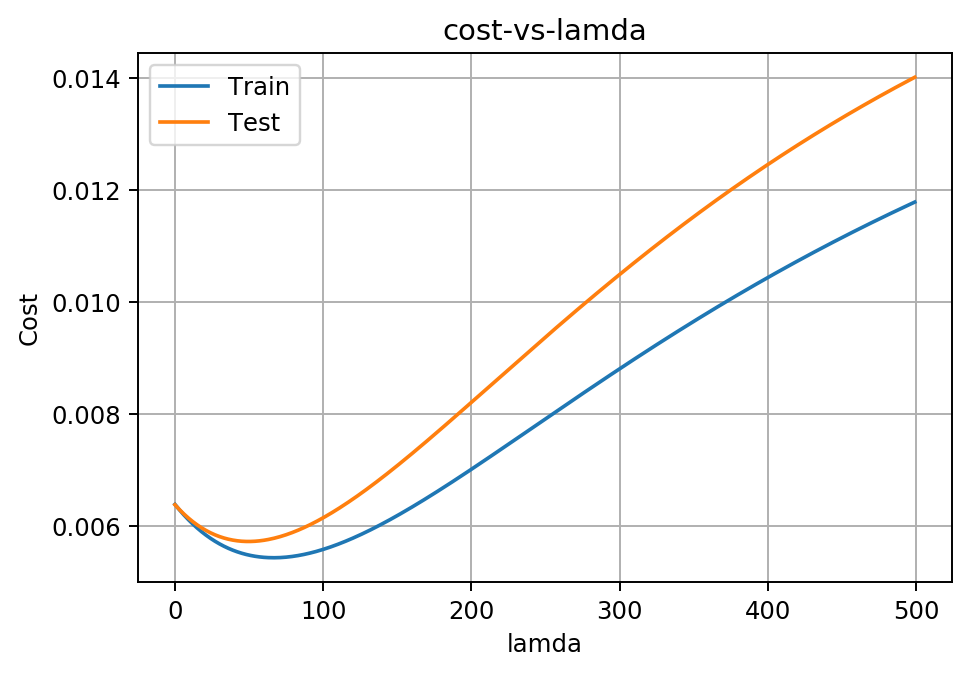

In [24]:
plotter('lamda','Cost','cost-vs-lamda',lamda_values,lamda_mse_train, lamda_mse_validate)
